In [1]:
%load_ext autoreload
%autoreload 2

import os
import sys
import pickle
sys.path.append(os.path.join('..'))
sys.path.append('/home/gpsnest/anaconda3/envs/qa-eval/lib/python3.6/site-packages')
from tqdm import tqdm
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import Image


from retriever import Retriever
from reader import Reader
from qa_system import QASystem

I0707 14:38:09.580180 140447255344960 file_utils.py:39] PyTorch version 1.1.0 available.
I0707 14:38:11.019328 140447255344960 driver.py:124] Generating grammar tables from /usr/lib/python3.6/lib2to3/Grammar.txt
I0707 14:38:11.035746 140447255344960 driver.py:124] Generating grammar tables from /usr/lib/python3.6/lib2to3/PatternGrammar.txt
I0707 14:38:15.163184 140447255344960 configuration_utils.py:265] loading configuration file https://s3.amazonaws.com/models.huggingface.co/bert/twmkn9/distilbert-base-uncased-squad2/config.json from cache at /home/gpsnest/.cache/torch/transformers/a3920afc5879111d09b0c1e74e7e674b82a7cd96109c2094b1abd8e57f50a126.eba6ca264db629858c65c1b534a0393d738537aad02120c2ac4fa8dd94820d0b
I0707 14:38:15.164910 140447255344960 configuration_utils.py:301] Model config DistilBertConfig {
  "activation": "gelu",
  "architectures": [
    "DistilBertForQuestionAnswering"
  ],
  "attention_dropout": 0.1,
  "dim": 768,
  "dropout": 0.1,
  "eos_token_ids": null,
  "hidden

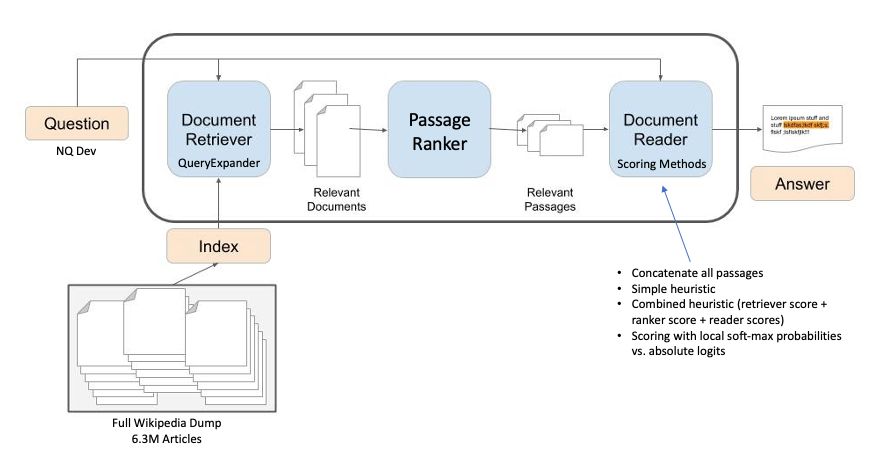

In [2]:
Image('../../qa_diagram_new.png')

## Load NQ Examples 

NQ Dev set (7651) was formatted as SQuAD examples. Preprocessed to drop any mulit-answer annotations, any yes/no answers, any answer that has > 5 tokens.

In [2]:
with open('../data/nq/squad_format_nq_dev.pkl', 'rb') as f:
    nq_dev = pickle.load(f)

In [40]:
ex

In [38]:
for i, ex in enumerate(nq_dev):
    print(ex.question_text)
    print(ex.answers)
    print()
    
    if i == 25: break

what do the 3 dots mean in math
[{'text': 'the therefore sign'}, {'text': 'therefore sign'}]

when was the writ watch invented by who
[]

who wrote the song photograph by ringo starr
[]

who is playing the halftime show at super bowl 2016
[]

star wars the clone wars anakin voice actor
[]

meaning behind the song whiter shade of pale
[]

where is most distortion found on a globe
[]

to aru kagaku no railgun s episode 3
[{'text': 'Project Radio Noise'}]

when do new chapters of owari no seraph come out
[]

where does the last name painter come from
[]

an eastern red cedar is a hardwood or softwood
[]

what are the challenges faced by the cotton textile industry of ahmedabad
[]

who won the 2017 sports personality of the year
[{'text': 'Mo Farah'}, {'text': 'Mo Farah'}, {'text': 'Mo Farah'}, {'text': 'Mo Farah'}, {'text': 'Mo Farah'}]

i got the joy joy joy down in my heart lyrics
[]

who lives in the grounds of windsor castle
[]

list of environmentally critical areas in the philippine

# Experiment 1

- Understand the impact of topN_docs and topM_passages on system recall
- Understand impact of entity and synonym enrichment on system recall

In [16]:
qa_sys = QASystem()

In [ ]:
topNs = [5, 10, 20, 30]
topMs = [10, 20, 30, 40]
entity_toggle = [False, True]
synonym_toggle = [0, 1]

n_exps = (len(topNs)*len(topMs)*len(entity_toggle)*len(synonym_toggle)) \
            - ((len(synonym_toggle)-1)*len(topNs)*len(topMs))

with tqdm(total=n_exps) as pbar:

    for ent_opt in entity_toggle:
        for syn_opt in synonym_toggle:
            for topN in topNs:
                for topM in topMs:

                    # cant do synonyms without entities
                    if ent_opt == False and syn_opt in [1,2]:
                        pbar.update(1)
                        continue

                    exp_name = f'exp1_{topN}_{topM}_{ent_opt}_{syn_opt}'

                    experiment_args = {'examples': nq_dev,
                                       'prediction_function': 'predict_combined',
                                       'index_name': 'wiki-full-stop-stem',
                                       'full_sys': False,
                                       'exp_name': exp_name,
                                       'topN_docs': topN,
                                       'topM_passages': topM,
                                       'topk_answers': 1
                                      }

                    if ent_opt:
                        experiment_args['entity_args'] = {'ner_exp': True}
                    if syn_opt != 0:
                        experiment_args['synonym_args'] = {'exp_type':'static', 'n_syns':syn_opt}
                    
                    # run experiment
                    all_results = qa_sys.evaluate_qa_sys(**experiment_args)
            
                    pbar.update(1)

  0%|          | 0/7651 [00:00<?, ?it/s]I0705 14:37:49.000280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.289s]

  0%|          | 1/7651 [00:00<43:51,  2.91it/s]I0705 14:37:49.223986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

  0%|          | 8/7651 [00:00<31:58,  3.98it/s]I0705 14:37:49.471201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

  0%|          | 13/7651 [00:00<23:51,  5.34it/s]I0705 14:37:49.642746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

  0%|          | 19/7651 [00:00<17:53,  7.11it/s]I0705 14:37:49.811234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]
I0705 14:37:50.026271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop


  2%|▏         | 129/7651 [00:09<11:46, 10.64it/s]I0705 14:37:58.209356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  2%|▏         | 132/7651 [00:09<11:31, 10.88it/s]I0705 14:37:58.487941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

  2%|▏         | 134/7651 [00:09<11:38, 10.76it/s]I0705 14:37:58.639123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

  2%|▏         | 140/7651 [00:10<09:26, 13.25it/s]I0705 14:37:58.837593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]
I0705 14:37:59.012064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

  2%|▏         | 142/7651 [00:10<12:43,  9.83it/s]I0705 14:37:59.169198 140604636419904 base.py:228] POST http://localhost:92


  3%|▎         | 238/7651 [00:16<07:06, 17.38it/s]I0705 14:38:05.756197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

  3%|▎         | 241/7651 [00:17<08:38, 14.29it/s]I0705 14:38:06.062245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

  3%|▎         | 243/7651 [00:17<10:08, 12.17it/s]I0705 14:38:06.174588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  3%|▎         | 245/7651 [00:17<09:19, 13.23it/s]I0705 14:38:06.301681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  3%|▎         | 247/7651 [00:17<09:26, 13.08it/s]I0705 14:38:06.429666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 14:38:06.661607 140604636419904 base.py:228] POST http://localhost:92


  5%|▍         | 354/7651 [00:23<04:39, 26.15it/s]I0705 14:38:12.618549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 14:38:12.675663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  5%|▍         | 361/7651 [00:24<04:07, 29.42it/s]I0705 14:38:12.865284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]
I0705 14:38:13.059008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

  5%|▍         | 365/7651 [00:24<06:16, 19.37it/s]I0705 14:38:13.150137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

  5%|▍         | 369/7651 [00:24<05:35, 21.72it/s]I0705 14:38:13.486351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  6%|▌         | 445/7651 [00:30<12:26,  9.65it/s]I0705 14:38:19.468805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  6%|▌         | 447/7651 [00:30<11:00, 10.91it/s]I0705 14:38:19.571569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

  6%|▌         | 454/7651 [00:30<08:16, 14.50it/s]I0705 14:38:19.689126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:38:19.830279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  6%|▌         | 457/7651 [00:31<08:44, 13.70it/s]I0705 14:38:19.929291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:38:20.082308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  7%|▋         | 569/7651 [00:36<03:26, 34.24it/s]I0705 14:38:25.345192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 14:38:25.395426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 14:38:25.523675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  7%|▋         | 573/7651 [00:37<08:06, 14.54it/s]I0705 14:38:25.958476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 14:38:26.149359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

  8%|▊         | 582/7651 [00:37<06:44, 17.47it/s]I0705 14:38:26.284553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  8%|▊         | 586/7651 [00:37<06:05, 19


  9%|▉         | 675/7651 [00:43<07:47, 14.91it/s]I0705 14:38:31.985850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

  9%|▉         | 677/7651 [00:43<07:34, 15.35it/s]I0705 14:38:32.060338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 14:38:32.133796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

  9%|▉         | 681/7651 [00:43<07:16, 15.97it/s]I0705 14:38:32.281998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 14:38:32.449775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

  9%|▉         | 689/7651 [00:43<06:05, 19.07it/s]I0705 14:38:32.628026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 12%|█▏        | 914/7651 [00:56<06:04, 18.47it/s]I0705 14:38:45.445697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 12%|█▏        | 917/7651 [00:56<06:00, 18.68it/s]I0705 14:38:45.626080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 12%|█▏        | 920/7651 [00:56<05:37, 19.97it/s]I0705 14:38:45.768384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 12%|█▏        | 926/7651 [00:57<04:36, 24.32it/s]I0705 14:38:45.850705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 12%|█▏        | 930/7651 [00:57<04:13, 26.47it/s]I0705 14:38:46.038525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 12%|█▏        | 934/7651 [00:57<04:24, 25.39it/s]I0705 14:38:46.245662 14

I0705 14:38:51.191748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 14%|█▎        | 1046/7651 [01:02<04:54, 22.45it/s]I0705 14:38:51.352780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 14%|█▎        | 1049/7651 [01:02<05:44, 19.16it/s]I0705 14:38:51.531452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 14%|█▎        | 1052/7651 [01:02<05:24, 20.31it/s]I0705 14:38:51.577399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:38:51.668104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 14%|█▍        | 1055/7651 [01:03<05:47, 18.96it/s]I0705 14:38:51.784106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▌        | 1153/7651 [01:08<06:07, 17.67it/s]I0705 14:38:56.839776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 14:38:56.987773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 15%|█▌        | 1156/7651 [01:08<08:04, 13.41it/s]I0705 14:38:57.259173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 14:38:57.462771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 15%|█▌        | 1158/7651 [01:08<11:03,  9.78it/s]I0705 14:38:57.501600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 15%|█▌        | 1160/7651 [01:08<09:52, 10.96it/s]I0705 14:38:57.664372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:39:02.812143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 17%|█▋        | 1264/7651 [01:14<05:04, 20.97it/s]I0705 14:39:02.859483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:39:02.962802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 17%|█▋        | 1268/7651 [01:14<04:45, 22.35it/s]I0705 14:39:03.018921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 14:39:03.113485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 17%|█▋        | 1278/7651 [01:14<03:56, 27.00it/s]I0705 14:39:03.265598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]
I0705 14:39:03.369464 140604636419904 ba

I0705 14:39:14.172357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 20%|█▉        | 1530/7651 [01:25<05:43, 17.83it/s]I0705 14:39:14.367386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 20%|██        | 1534/7651 [01:25<05:30, 18.51it/s]I0705 14:39:14.567032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 20%|██        | 1537/7651 [01:25<04:53, 20.80it/s]I0705 14:39:14.642793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 20%|██        | 1541/7651 [01:26<04:25, 23.00it/s]I0705 14:39:14.760264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 20%|██        | 1544/7651 [01:26<04:35, 22.16it/s]I0705 14:39:14.915154 140604636419904 base.py:228] POST http://localho


 21%|██▏       | 1642/7651 [01:32<10:13,  9.80it/s]I0705 14:39:20.801979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 14:39:20.865576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 22%|██▏       | 1646/7651 [01:32<08:35, 11.64it/s]I0705 14:39:21.030204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 14:39:21.154626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 22%|██▏       | 1656/7651 [01:32<06:43, 14.85it/s]I0705 14:39:21.304104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]
I0705 14:39:21.449158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 22%|██▏       | 1659/7651 [01:32<07:55

 23%|██▎       | 1753/7651 [01:38<06:21, 15.46it/s]I0705 14:39:26.850576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 23%|██▎       | 1756/7651 [01:38<06:03, 16.21it/s]I0705 14:39:26.966041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 14:39:27.047157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 23%|██▎       | 1761/7651 [01:38<05:25, 18.12it/s]I0705 14:39:27.164839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 23%|██▎       | 1764/7651 [01:38<04:48, 20.41it/s]I0705 14:39:27.347642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 23%|██▎       | 1767/7651 [01:38<04:40, 20.97it/s]I0705 14:39:27.403054 140604636419904 base.py:228] POST http://localhos


 24%|██▍       | 1864/7651 [01:44<07:20, 13.13it/s]I0705 14:39:33.391680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 14:39:33.464777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 25%|██▍       | 1875/7651 [01:44<05:37, 17.10it/s]I0705 14:39:33.585562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:39:33.806205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 25%|██▍       | 1879/7651 [01:45<06:00, 16.03it/s]I0705 14:39:33.893614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 14:39:34.000993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 25%|██▍       | 1882/7651 [01:45<06:15


 26%|██▌       | 1987/7651 [01:50<05:03, 18.63it/s]I0705 14:39:39.306339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 14:39:39.466366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 26%|██▌       | 1990/7651 [01:50<05:51, 16.11it/s]I0705 14:39:39.633401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 26%|██▌       | 1993/7651 [01:50<05:43, 16.46it/s]I0705 14:39:39.761576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 26%|██▌       | 1995/7651 [01:51<05:48, 16.24it/s]I0705 14:39:39.818120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 14:39:39.975346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 27%|██▋       | 2097/7651 [01:56<05:52, 15.74it/s]I0705 14:39:45.791918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 14:39:45.844984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 27%|██▋       | 2099/7651 [01:57<06:46, 13.67it/s]I0705 14:39:45.896151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:39:45.996613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 28%|██▊       | 2105/7651 [01:57<05:46, 16.02it/s]I0705 14:39:46.134999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 28%|██▊       | 2110/7651 [01:57<04:42, 19.61it/s]I0705 14:39:46.253129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 29%|██▉       | 2211/7651 [02:03<06:13, 14.56it/s]I0705 14:39:52.284079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]
I0705 14:39:52.448861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 29%|██▉       | 2213/7651 [02:03<07:58, 11.36it/s]I0705 14:39:52.520497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 14:39:52.597231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 29%|██▉       | 2216/7651 [02:03<07:15, 12.48it/s]I0705 14:39:52.774459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 29%|██▉       | 2221/7651 [02:04<05:48, 15.60it/s]I0705 14:39:52.815253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 31%|███       | 2353/7651 [02:09<05:50, 15.11it/s]I0705 14:39:58.256937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 14:39:58.329732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 31%|███       | 2356/7651 [02:09<07:55, 11.13it/s]I0705 14:39:58.716612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 31%|███       | 2362/7651 [02:10<06:07, 14.40it/s]I0705 14:39:58.834980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 31%|███       | 2365/7651 [02:10<05:32, 15.91it/s]I0705 14:39:58.922868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 14:39:59.119882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:40:04.737898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 32%|███▏      | 2468/7651 [02:16<07:06, 12.15it/s]I0705 14:40:04.982802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 32%|███▏      | 2470/7651 [02:16<07:14, 11.92it/s]I0705 14:40:05.027270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 32%|███▏      | 2475/7651 [02:16<05:47, 14.91it/s]I0705 14:40:05.242010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 32%|███▏      | 2478/7651 [02:16<05:06, 16.88it/s]I0705 14:40:05.301487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 14:40:05.402959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 34%|███▎      | 2568/7651 [02:22<05:24, 15.68it/s]I0705 14:40:10.883053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 34%|███▎      | 2570/7651 [02:22<05:26, 15.57it/s]I0705 14:40:10.927046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 34%|███▎      | 2578/7651 [02:22<04:11, 20.18it/s]I0705 14:40:11.053829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 14:40:11.105926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 34%|███▎      | 2582/7651 [02:22<04:20, 19.47it/s]I0705 14:40:11.279711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 34%|███▍      | 2585/7651 [02:22<04:13, 20.02it/s]I0705 14:40:11.452662 140604636419904 base.py:228] POST http://localho


 35%|███▌      | 2685/7651 [02:28<05:52, 14.08it/s]I0705 14:40:17.006094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 35%|███▌      | 2687/7651 [02:28<05:49, 14.21it/s]I0705 14:40:17.170739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 14:40:17.259527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 35%|███▌      | 2689/7651 [02:28<06:45, 12.25it/s]I0705 14:40:17.402190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0705 14:40:17.473819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 35%|███▌      | 2699/7651 [02:28<05:18, 15.56it/s]I0705 14:40:17.600698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 37%|███▋      | 2801/7651 [02:34<08:05,  9.99it/s]I0705 14:40:23.455697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 14:40:23.626365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 37%|███▋      | 2803/7651 [02:34<09:00,  8.97it/s]I0705 14:40:23.741218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 37%|███▋      | 2808/7651 [02:35<06:55, 11.64it/s]I0705 14:40:23.935516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 37%|███▋      | 2814/7651 [02:35<05:25, 14.85it/s]I0705 14:40:24.088953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 37%|███▋      | 2823/7651 [02:35<04:10, 19.28it/s]I0705 14:40:24.196135 140604636419904 base.py:228] POST http://localho

I0705 14:40:29.944249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 38%|███▊      | 2941/7651 [02:41<04:58, 15.80it/s]I0705 14:40:30.021843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 39%|███▊      | 2946/7651 [02:41<04:12, 18.66it/s]I0705 14:40:30.177140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 39%|███▊      | 2949/7651 [02:41<04:12, 18.59it/s]I0705 14:40:30.369999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 39%|███▊      | 2953/7651 [02:41<03:48, 20.53it/s]I0705 14:40:30.461942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:40:30.622605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 40%|███▉      | 3059/7651 [02:47<05:32, 13.83it/s]I0705 14:40:36.315823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 40%|████      | 3061/7651 [02:47<05:20, 14.30it/s]I0705 14:40:36.405063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 14:40:36.500178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 40%|████      | 3066/7651 [02:47<04:26, 17.18it/s]I0705 14:40:36.583046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 14:40:36.730840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 40%|████      | 3072/7651 [02:48<03:54, 19.50it/s]I0705 14:40:36.800343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:40:42.264405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 42%|████▏     | 3190/7651 [02:53<04:37, 16.07it/s]I0705 14:40:42.331902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:40:42.424216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 42%|████▏     | 3192/7651 [02:53<05:40, 13.10it/s]I0705 14:40:42.640028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 42%|████▏     | 3194/7651 [02:53<05:22, 13.80it/s]I0705 14:40:42.735217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 42%|████▏     | 3196/7651 [02:54<05:01, 14.76it/s]I0705 14:40:42.825899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 43%|████▎     | 3297/7651 [02:59<04:49, 15.06it/s]I0705 14:40:48.487425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 14:40:48.581526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 43%|████▎     | 3307/7651 [02:59<03:49, 18.96it/s]I0705 14:40:48.729303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 43%|████▎     | 3310/7651 [03:00<03:49, 18.92it/s]I0705 14:40:48.821005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 43%|████▎     | 3313/7651 [03:00<03:39, 19.76it/s]I0705 14:40:48.975526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 43%|████▎     | 3317/7651 [03:00<03:20, 21.57it/s]I0705 14:40:49.090891 140604636419904 base.py:228] POST http://localho


 45%|████▍     | 3421/7651 [03:06<05:28, 12.88it/s]I0705 14:40:55.032676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 45%|████▍     | 3424/7651 [03:06<04:49, 14.59it/s]I0705 14:40:55.075647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 45%|████▍     | 3429/7651 [03:06<04:03, 17.31it/s]I0705 14:40:55.238944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 14:40:55.417224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 14:40:55.556005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 45%|████▍     | 3432/7651 [03:06<05:19, 13.21it/s]I0705 14:40:55.701421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:41:01.303734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 46%|████▌     | 3531/7651 [03:12<05:53, 11.65it/s]I0705 14:41:01.419677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 14:41:01.480601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 46%|████▌     | 3536/7651 [03:12<04:42, 14.54it/s]I0705 14:41:01.635568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]
I0705 14:41:01.718430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 46%|████▌     | 3538/7651 [03:13<06:12, 11.05it/s]I0705 14:41:01.795727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0705 14:41:01.996246 140604636419904 ba


 48%|████▊     | 3641/7651 [03:18<03:31, 18.93it/s]I0705 14:41:06.953243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 48%|████▊     | 3653/7651 [03:18<02:40, 24.93it/s]I0705 14:41:07.088734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 14:41:07.168911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 14:41:07.382574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 48%|████▊     | 3658/7651 [03:18<03:21, 19.81it/s]I0705 14:41:07.464045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 48%|████▊     | 3667/7651 [03:18<02:38, 25.12it/s]I0705 14:41:07.593660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:41:13.047908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 49%|████▉     | 3782/7651 [03:24<05:23, 11.96it/s]I0705 14:41:13.186615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 49%|████▉     | 3785/7651 [03:24<04:44, 13.57it/s]I0705 14:41:13.333959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 49%|████▉     | 3787/7651 [03:24<04:23, 14.67it/s]I0705 14:41:13.441223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 50%|████▉     | 3790/7651 [03:24<03:48, 16.88it/s]I0705 14:41:13.640744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 50%|████▉     | 3792/7651 [03:25<04:46, 13.47it/s]I0705 14:41:13.780136 140604636419904 base.py:228] POST http://localho


 51%|█████     | 3915/7651 [03:30<02:25, 25.68it/s]I0705 14:41:19.100115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 14:41:19.151884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 51%|█████     | 3918/7651 [03:30<02:50, 21.85it/s]I0705 14:41:19.215865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:41:19.421438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 51%|█████     | 3921/7651 [03:30<03:39, 16.99it/s]I0705 14:41:19.494048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 51%|█████▏    | 3924/7651 [03:30<03:17, 18.84it/s]I0705 14:41:19.611947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 54%|█████▍    | 4125/7651 [03:42<03:13, 18.18it/s]I0705 14:41:30.946260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 54%|█████▍    | 4128/7651 [03:42<02:58, 19.71it/s]I0705 14:41:31.089083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 14:41:31.295218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 14:41:31.429693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 54%|█████▍    | 4131/7651 [03:42<04:47, 12.25it/s]I0705 14:41:31.622483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 54%|█████▍    | 4137/7651 [03:42<03:55, 14.94it/s]I0705 14:41:31.807509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 57%|█████▋    | 4358/7651 [03:54<03:38, 15.04it/s]I0705 14:41:42.992164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 57%|█████▋    | 4360/7651 [03:54<04:23, 12.49it/s]I0705 14:41:43.183396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 57%|█████▋    | 4362/7651 [03:54<04:05, 13.41it/s]I0705 14:41:43.378985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]
I0705 14:41:43.456317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 57%|█████▋    | 4364/7651 [03:54<05:01, 10.91it/s]I0705 14:41:43.627972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 57%|█████▋    | 4366/7651 [03:54<04:39, 11.77it/s]I0705 14:41:43.775032 140604636419904 base.py:228] POST http://localhos

I0705 14:41:49.694091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 58%|█████▊    | 4454/7651 [04:01<03:57, 13.44it/s]I0705 14:41:49.814085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 14:41:50.029042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 58%|█████▊    | 4457/7651 [04:01<05:20,  9.95it/s]I0705 14:41:50.325719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 58%|█████▊    | 4462/7651 [04:01<04:10, 12.74it/s]I0705 14:41:50.416690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 58%|█████▊    | 4465/7651 [04:01<03:56, 13.47it/s]I0705 14:41:50.565080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:41:55.731759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 14:41:55.823123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 60%|█████▉    | 4574/7651 [04:07<03:50, 13.33it/s]I0705 14:41:55.888898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 60%|█████▉    | 4576/7651 [04:07<03:32, 14.46it/s]I0705 14:41:56.030666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 60%|█████▉    | 4578/7651 [04:07<03:27, 14.82it/s]I0705 14:41:56.121730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:41:56.219195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 60%|█████▉    | 4582/7651 [04:07<03:26


 61%|██████    | 4683/7651 [04:13<05:03,  9.78it/s]I0705 14:42:02.239616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 14:42:02.392441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 61%|██████▏   | 4694/7651 [04:13<03:48, 12.94it/s]I0705 14:42:02.456186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 61%|██████▏   | 4698/7651 [04:13<03:17, 14.93it/s]I0705 14:42:02.643101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 14:42:02.818409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 61%|██████▏   | 4701/7651 [04:14<03:38, 13.50it/s]I0705 14:42:02.979437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 63%|██████▎   | 4822/7651 [04:19<02:04, 22.81it/s]I0705 14:42:08.663460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 14:42:08.819014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 63%|██████▎   | 4825/7651 [04:20<02:42, 17.34it/s]I0705 14:42:08.960157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 63%|██████▎   | 4828/7651 [04:20<02:38, 17.83it/s]I0705 14:42:09.120450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 14:42:09.352958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 63%|██████▎   | 4831/7651 [04:20<03:21, 14.02it/s]I0705 14:42:09.512169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 65%|██████▍   | 4937/7651 [04:26<03:11, 14.18it/s]I0705 14:42:15.589794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 65%|██████▍   | 4939/7651 [04:26<03:13, 14.01it/s]I0705 14:42:15.674592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 65%|██████▍   | 4941/7651 [04:27<03:16, 13.83it/s]I0705 14:42:15.822068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 65%|██████▍   | 4945/7651 [04:27<02:43, 16.59it/s]I0705 14:42:15.920207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 14:42:15.992048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 65%|██████▍   | 4950/7651 [04:27<02:23, 18.82it/s]I0705 14:42:16.118404 140604636419904 base.py:228] POST http://localho


 66%|██████▌   | 5045/7651 [04:32<02:22, 18.23it/s]I0705 14:42:21.710658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]
I0705 14:42:21.875569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 66%|██████▌   | 5048/7651 [04:33<03:10, 13.64it/s]I0705 14:42:21.936343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:42:22.003006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 66%|██████▌   | 5060/7651 [04:33<02:26, 17.74it/s]I0705 14:42:22.188502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 66%|██████▌   | 5064/7651 [04:33<02:01, 21.22it/s]I0705 14:42:22.284407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:42:28.374678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 68%|██████▊   | 5195/7651 [04:39<02:19, 17.65it/s]I0705 14:42:28.619775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 68%|██████▊   | 5198/7651 [04:39<02:30, 16.30it/s]I0705 14:42:28.702563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 68%|██████▊   | 5201/7651 [04:40<02:16, 17.91it/s]I0705 14:42:28.935908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 68%|██████▊   | 5204/7651 [04:40<02:15, 18.11it/s]I0705 14:42:29.062629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 68%|██████▊   | 5207/7651 [04:40<02:25, 16.83it/s]I0705 14:42:29.260123 140604636419904 base.py:228] POST http://localho

I0705 14:42:35.244382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 69%|██████▉   | 5290/7651 [04:46<03:44, 10.52it/s]I0705 14:42:35.391891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]
I0705 14:42:35.580967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 69%|██████▉   | 5292/7651 [04:46<04:37,  8.50it/s]I0705 14:42:35.659329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 69%|██████▉   | 5294/7651 [04:47<03:50, 10.23it/s]I0705 14:42:35.807335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 69%|██████▉   | 5297/7651 [04:47<03:06, 12.61it/s]I0705 14:42:35.859921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 71%|███████   | 5417/7651 [04:52<02:32, 14.64it/s]I0705 14:42:41.378678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 14:42:41.420735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 71%|███████   | 5424/7651 [04:52<02:05, 17.76it/s]I0705 14:42:41.596652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:42:41.665225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 71%|███████   | 5432/7651 [04:53<01:41, 21.83it/s]I0705 14:42:41.781100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 14:42:41.836134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0705 14:42:42.073947 140604636419904 ba

I0705 14:42:47.601418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 72%|███████▏  | 5534/7651 [04:58<02:15, 15.63it/s]I0705 14:42:47.810826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 72%|███████▏  | 5538/7651 [04:59<01:57, 18.04it/s]I0705 14:42:47.881984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 72%|███████▏  | 5541/7651 [04:59<01:59, 17.63it/s]I0705 14:42:48.127972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]
I0705 14:42:48.284473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 72%|███████▏  | 5544/7651 [04:59<02:26, 14.34it/s]I0705 14:42:48.429528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:42:54.242165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 74%|███████▍  | 5655/7651 [05:05<03:02, 10.94it/s]I0705 14:42:54.367114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 74%|███████▍  | 5658/7651 [05:05<02:28, 13.39it/s]I0705 14:42:54.505088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 74%|███████▍  | 5661/7651 [05:05<02:18, 14.40it/s]I0705 14:42:54.624344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 14:42:54.767063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 74%|███████▍  | 5664/7651 [05:06<02:22, 13.95it/s]I0705 14:42:54.881209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:43:00.513731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 75%|███████▌  | 5752/7651 [05:11<02:04, 15.29it/s]I0705 14:43:00.575305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:43:00.723763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 75%|███████▌  | 5755/7651 [05:12<02:16, 13.91it/s]I0705 14:43:00.822441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 14:43:00.888396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 75%|███████▌  | 5759/7651 [05:12<01:54, 16.57it/s]I0705 14:43:01.003325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 75%|███████▌  | 5762/7651 [05:12<01:39

 77%|███████▋  | 5884/7651 [05:17<01:52, 15.69it/s]I0705 14:43:06.341835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 77%|███████▋  | 5892/7651 [05:17<01:28, 19.77it/s]I0705 14:43:06.526261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 77%|███████▋  | 5895/7651 [05:17<01:23, 20.91it/s]I0705 14:43:06.638283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 77%|███████▋  | 5898/7651 [05:17<01:24, 20.77it/s]I0705 14:43:06.938910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]
I0705 14:43:06.994578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 77%|███████▋  | 5901/7651 [05:18<01:56, 14.98it/s]I0705 14:43:07.108741 140604636419904 base.py:228] POST http://localhos


 78%|███████▊  | 6002/7651 [05:23<01:18, 21.09it/s]I0705 14:43:12.845978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 78%|███████▊  | 6006/7651 [05:24<01:19, 20.79it/s]I0705 14:43:12.956497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 79%|███████▊  | 6009/7651 [05:24<01:20, 20.42it/s]I0705 14:43:13.104040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 79%|███████▊  | 6012/7651 [05:24<01:33, 17.56it/s]I0705 14:43:13.313908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:43:13.424128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 79%|███████▉  | 6028/7651 [05:24<01:10, 23.03it/s]I0705 14:43:13.512617 140604636419904 base.py:228] POST http://localho


 80%|████████  | 6124/7651 [05:30<02:17, 11.08it/s]I0705 14:43:19.184070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 80%|████████  | 6127/7651 [05:30<02:09, 11.75it/s]I0705 14:43:19.475730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 80%|████████  | 6129/7651 [05:30<02:10, 11.64it/s]I0705 14:43:19.671443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 80%|████████  | 6131/7651 [05:30<02:08, 11.81it/s]I0705 14:43:19.741727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 80%|████████  | 6134/7651 [05:31<01:45, 14.42it/s]I0705 14:43:19.824144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 80%|████████  | 6136/7651 [05:31<01:37, 15.51it/s]I0705 14:43:19.938

I0705 14:43:25.408361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 82%|████████▏ | 6263/7651 [05:36<01:07, 20.69it/s]I0705 14:43:25.560586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 82%|████████▏ | 6267/7651 [05:36<01:02, 22.31it/s]I0705 14:43:25.657743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 14:43:25.729517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 82%|████████▏ | 6271/7651 [05:37<01:00, 22.76it/s]I0705 14:43:25.883195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 14:43:26.005338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0705 14:43:26.109221 140604636419904 ba


 83%|████████▎ | 6371/7651 [05:43<01:04, 19.86it/s]I0705 14:43:32.096703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 83%|████████▎ | 6374/7651 [05:43<01:05, 19.59it/s]I0705 14:43:32.203960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 14:43:32.317493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 83%|████████▎ | 6377/7651 [05:43<01:14, 17.06it/s]I0705 14:43:32.394630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 83%|████████▎ | 6384/7651 [05:43<00:58, 21.63it/s]I0705 14:43:32.510060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 14:43:32.597014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:43:43.963348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 86%|████████▌ | 6584/7651 [05:55<01:30, 11.74it/s]I0705 14:43:44.143664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 86%|████████▌ | 6586/7651 [05:55<01:23, 12.78it/s]I0705 14:43:44.250698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 86%|████████▌ | 6588/7651 [05:55<01:15, 14.07it/s]I0705 14:43:44.353965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 86%|████████▌ | 6592/7651 [05:55<01:01, 17.20it/s]I0705 14:43:44.476090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0705 14:43:44.606224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 88%|████████▊ | 6709/7651 [06:01<00:56, 16.58it/s]I0705 14:43:50.452121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 88%|████████▊ | 6712/7651 [06:01<00:51, 18.21it/s]I0705 14:43:50.566425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 14:43:50.912110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 88%|████████▊ | 6715/7651 [06:02<01:16, 12.28it/s]I0705 14:43:51.056851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 88%|████████▊ | 6718/7651 [06:02<01:10, 13.14it/s]I0705 14:43:51.161015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 14:43:51.324606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 89%|████████▉ | 6803/7651 [06:08<00:58, 14.46it/s]I0705 14:43:57.257081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 89%|████████▉ | 6807/7651 [06:08<00:57, 14.80it/s]I0705 14:43:57.483601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 89%|████████▉ | 6809/7651 [06:08<01:03, 13.20it/s]I0705 14:43:57.595602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 89%|████████▉ | 6812/7651 [06:08<00:55, 15.24it/s]I0705 14:43:57.694334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 14:43:57.770152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 89%|████████▉ | 6817/7651 [06:09<00:49, 16.85it/s]I0705 14:43:57.908005 140604636419904 base.py:228] POST http://localho


 91%|█████████ | 6937/7651 [06:14<00:38, 18.51it/s]I0705 14:44:03.318885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 14:44:03.530491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 91%|█████████ | 6941/7651 [06:14<00:40, 17.43it/s]I0705 14:44:03.657687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 91%|█████████ | 6944/7651 [06:14<00:38, 18.32it/s]I0705 14:44:03.731152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 14:44:03.857389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 91%|█████████ | 6947/7651 [06:15<00:42, 16.58it/s]I0705 14:44:04.011016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 92%|█████████▏| 7033/7651 [06:20<00:44, 13.83it/s]I0705 14:44:09.610684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 14:44:09.724436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 92%|█████████▏| 7042/7651 [06:21<00:35, 17.28it/s]I0705 14:44:09.901481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 14:44:09.961643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 92%|█████████▏| 7045/7651 [06:21<00:42, 14.43it/s]I0705 14:44:10.095984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 14:44:10.191657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 92%|█████████▏| 7054/7651 [06:21<00:33,

I0705 14:44:16.012234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 93%|█████████▎| 7139/7651 [06:27<00:50, 10.14it/s]I0705 14:44:16.142600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 93%|█████████▎| 7141/7651 [06:27<00:45, 11.14it/s]I0705 14:44:16.344983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 93%|█████████▎| 7144/7651 [06:27<00:39, 12.77it/s]I0705 14:44:16.487601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 93%|█████████▎| 7146/7651 [06:27<00:39, 12.79it/s]I0705 14:44:16.561607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 93%|█████████▎| 7148/7651 [06:27<00:37, 13.33it/s]I0705 14:44:16.708382 140604636419904 base.py:228] POST http://localho


 95%|█████████▍| 7258/7651 [06:33<00:18, 21.14it/s]I0705 14:44:22.106396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:44:22.165501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 95%|█████████▍| 7261/7651 [06:33<00:17, 22.51it/s]I0705 14:44:22.251880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 14:44:22.377972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 95%|█████████▍| 7264/7651 [06:33<00:21, 17.90it/s]I0705 14:44:22.495193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 14:44:22.593830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:44:22.879945 140604636419904 ba


 96%|█████████▌| 7352/7651 [06:39<00:31,  9.46it/s]I0705 14:44:28.651794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 96%|█████████▌| 7361/7651 [06:39<00:22, 12.80it/s]I0705 14:44:28.819054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 96%|█████████▋| 7365/7651 [06:40<00:18, 15.18it/s]I0705 14:44:28.850410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 14:44:28.917181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 96%|█████████▋| 7368/7651 [06:40<00:19, 14.60it/s]I0705 14:44:29.128914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 14:44:29.265737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 98%|█████████▊| 7467/7651 [06:45<00:13, 13.71it/s]I0705 14:44:34.671338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 98%|█████████▊| 7470/7651 [06:45<00:11, 15.88it/s]I0705 14:44:34.810665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 98%|█████████▊| 7476/7651 [06:46<00:08, 19.57it/s]I0705 14:44:34.882588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 98%|█████████▊| 7479/7651 [06:46<00:08, 19.98it/s]I0705 14:44:35.072377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 98%|█████████▊| 7482/7651 [06:46<00:08, 20.87it/s]I0705 14:44:35.201177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 14:44:35.269973 140604636419904 base.py:228] POST http://localho

I0705 14:44:40.881785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 99%|█████████▉| 7596/7651 [06:52<00:04, 12.85it/s]I0705 14:44:40.945452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 14:44:41.096031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 99%|█████████▉| 7600/7651 [06:52<00:03, 14.23it/s]I0705 14:44:41.176449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 99%|█████████▉| 7604/7651 [06:52<00:02, 17.26it/s]I0705 14:44:41.281679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 14:44:41.436682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 99%|█████████▉| 7607/7651 [06:52<00:02

  2%|▏         | 185/7651 [00:08<05:33, 22.36it/s]I0705 14:44:52.817780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  2%|▏         | 188/7651 [00:08<05:49, 21.37it/s]I0705 14:44:52.917025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]
I0705 14:44:53.058038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

  2%|▏         | 191/7651 [00:08<07:48, 15.91it/s]I0705 14:44:53.192237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  3%|▎         | 193/7651 [00:08<07:41, 16.18it/s]I0705 14:44:53.320646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

  3%|▎         | 195/7651 [00:08<07:33, 16.43it/s]I0705 14:44:53.409474 140604636419904 base.py:228] POST http://localhost:920


  4%|▍         | 287/7651 [00:14<06:32, 18.78it/s]I0705 14:44:59.011809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 14:44:59.092310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

  4%|▍         | 290/7651 [00:14<06:40, 18.40it/s]I0705 14:44:59.168548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  4%|▍         | 293/7651 [00:14<06:32, 18.73it/s]I0705 14:44:59.366253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

  4%|▍         | 295/7651 [00:14<06:46, 18.11it/s]I0705 14:44:59.477797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

  4%|▍         | 297/7651 [00:15<07:25, 16.49it/s]I0705 14:44:59.580370 140604636419904 base.py:228] POST http://localhost:92


  5%|▌         | 407/7651 [00:21<08:52, 13.60it/s]I0705 14:45:05.773114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  5%|▌         | 409/7651 [00:21<09:11, 13.13it/s]I0705 14:45:05.923415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

  5%|▌         | 411/7651 [00:21<08:44, 13.81it/s]I0705 14:45:06.020311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

  5%|▌         | 413/7651 [00:21<08:18, 14.52it/s]I0705 14:45:06.177090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  5%|▌         | 415/7651 [00:21<08:23, 14.37it/s]I0705 14:45:06.305346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0705 14:45:06.406516 140604636419904 base.py:228] POST http://localhost:92

I0705 14:45:12.156789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

  7%|▋         | 502/7651 [00:27<07:53, 15.08it/s]I0705 14:45:12.233326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  7%|▋         | 506/7651 [00:27<06:50, 17.39it/s]I0705 14:45:12.362551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:45:12.490385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  7%|▋         | 509/7651 [00:28<07:23, 16.09it/s]I0705 14:45:12.627665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  7%|▋         | 514/7651 [00:28<06:11, 19.23it/s]I0705 14:45:12.731253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  8%|▊         | 631/7651 [00:33<06:14, 18.74it/s]I0705 14:45:18.372269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]
I0705 14:45:18.515738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]
I0705 14:45:18.649201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  8%|▊         | 634/7651 [00:34<10:08, 11.53it/s]I0705 14:45:18.847156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

  8%|▊         | 638/7651 [00:34<08:42, 13.43it/s]I0705 14:45:18.943521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

  8%|▊         | 640/7651 [00:34<08:08, 14.36it/s]I0705 14:45:19.104679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 10%|▉         | 737/7651 [00:40<11:02, 10.43it/s]I0705 14:45:25.009630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 14:45:25.101172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 10%|▉         | 741/7651 [00:40<10:31, 10.94it/s]I0705 14:45:25.361007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 10%|▉         | 743/7651 [00:40<09:42, 11.85it/s]I0705 14:45:25.516951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 10%|▉         | 745/7651 [00:41<08:48, 13.07it/s]I0705 14:45:25.568434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 14:45:25.651333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 11%|█         | 859/7651 [00:47<04:38, 24.37it/s]I0705 14:45:31.628433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 11%|█▏        | 865/7651 [00:47<04:00, 28.16it/s]I0705 14:45:31.724227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 14:45:31.825939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 11%|█▏        | 869/7651 [00:47<04:34, 24.67it/s]I0705 14:45:31.930701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 11%|█▏        | 872/7651 [00:47<04:46, 23.66it/s]I0705 14:45:32.276604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]

 11%|█▏        | 875/7651 [00:47<06:18, 17.88it/s]I0705 14:45:32.324347 140604636419904 base.py:228] POST http://localhost:92

I0705 14:45:43.404915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 14%|█▍        | 1102/7651 [00:59<07:43, 14.14it/s]I0705 14:45:43.611452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 14%|█▍        | 1104/7651 [00:59<08:26, 12.92it/s]I0705 14:45:43.691185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:45:43.890559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 14%|█▍        | 1106/7651 [00:59<10:24, 10.47it/s]I0705 14:45:43.973679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 14:45:44.031863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 14%|█▍        | 1108/7651 [00:59<09:13

I0705 14:45:49.948557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 16%|█▌        | 1215/7651 [01:05<05:13, 20.53it/s]I0705 14:45:50.073087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0705 14:45:50.167824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 16%|█▌        | 1218/7651 [01:05<05:52, 18.24it/s]I0705 14:45:50.244793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:45:50.460492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 16%|█▌        | 1221/7651 [01:06<07:57, 13.48it/s]I0705 14:45:50.599211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 14:45:50.699394 140604636419904 ba


 19%|█▉        | 1456/7651 [01:16<07:26, 13.88it/s]I0705 14:46:01.356588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 14:46:01.493748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 19%|█▉        | 1458/7651 [01:17<09:10, 11.26it/s]I0705 14:46:01.597968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 19%|█▉        | 1463/7651 [01:17<07:12, 14.29it/s]I0705 14:46:01.723147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 19%|█▉        | 1466/7651 [01:17<07:00, 14.69it/s]I0705 14:46:01.968265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 19%|█▉        | 1474/7651 [01:17<05:21, 19.22it/s]I0705 14:46:02.016633 140604636419904 base.py:228] POST http://localho

I0705 14:46:07.538201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 21%|██        | 1595/7651 [01:23<04:58, 20.28it/s]I0705 14:46:07.639057 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 14:46:07.673610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 21%|██        | 1610/7651 [01:23<03:48, 26.44it/s]I0705 14:46:07.740803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0705 14:46:07.829785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:46:08.017452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 21%|██        | 1615/7651 [01:23<04:47, 21.02it/s]I0705 14:46:08.204443 140604636419904 ba


 22%|██▏       | 1706/7651 [01:29<07:45, 12.77it/s]I0705 14:46:14.163742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 14:46:14.359268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 22%|██▏       | 1708/7651 [01:29<09:10, 10.80it/s]I0705 14:46:14.445122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 22%|██▏       | 1710/7651 [01:30<08:05, 12.22it/s]I0705 14:46:14.524077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 22%|██▏       | 1713/7651 [01:30<07:02, 14.05it/s]I0705 14:46:14.693288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 22%|██▏       | 1716/7651 [01:30<06:07, 16.15it/s]I0705 14:46:14.779276 140604636419904 base.py:228] POST http://localho

I0705 14:46:20.479065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 14:46:20.643968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 24%|██▍       | 1825/7651 [01:36<07:21, 13.19it/s]I0705 14:46:20.772706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 24%|██▍       | 1827/7651 [01:36<06:53, 14.09it/s]I0705 14:46:20.881097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 14:46:20.970933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 24%|██▍       | 1829/7651 [01:36<08:12, 11.81it/s]I0705 14:46:21.086407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 14:46:21.267266 140604636419904 ba

I0705 14:46:26.692574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 25%|██▌       | 1937/7651 [01:42<05:54, 16.12it/s]I0705 14:46:26.813548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 14:46:26.907925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 25%|██▌       | 1939/7651 [01:42<07:22, 12.90it/s]I0705 14:46:27.005123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:46:27.085338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 25%|██▌       | 1945/7651 [01:42<06:09, 15.44it/s]I0705 14:46:27.259191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 25%|██▌       | 1948/7651 [01:42<05:37

I0705 14:46:32.718445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 27%|██▋       | 2044/7651 [01:48<05:28, 17.07it/s]I0705 14:46:32.866963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 14:46:33.013525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 27%|██▋       | 2046/7651 [01:48<07:22, 12.66it/s]I0705 14:46:33.139238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 27%|██▋       | 2048/7651 [01:48<06:55, 13.47it/s]I0705 14:46:33.232888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 14:46:33.413452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 27%|██▋       | 2051/7651 [01:48<07:04


 28%|██▊       | 2152/7651 [01:54<04:58, 18.40it/s]I0705 14:46:39.087277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 28%|██▊       | 2156/7651 [01:54<05:22, 17.06it/s]I0705 14:46:39.181154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:46:39.292928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 28%|██▊       | 2159/7651 [01:54<05:26, 16.83it/s]I0705 14:46:39.402174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 28%|██▊       | 2161/7651 [01:55<05:36, 16.31it/s]I0705 14:46:39.502305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 14:46:39.649037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:46:45.438744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 14:46:45.633954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 30%|██▉       | 2291/7651 [02:01<05:06, 17.48it/s]I0705 14:46:45.687581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 30%|██▉       | 2294/7651 [02:01<04:50, 18.41it/s]I0705 14:46:45.882963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 30%|███       | 2297/7651 [02:01<04:26, 20.13it/s]I0705 14:46:46.054073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 30%|███       | 2303/7651 [02:01<03:57, 22.56it/s]I0705 14:46:46.206764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 32%|███▏      | 2416/7651 [02:07<05:20, 16.32it/s]I0705 14:46:51.941803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 32%|███▏      | 2422/7651 [02:07<04:21, 20.02it/s]I0705 14:46:52.113825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]
I0705 14:46:52.271924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]
I0705 14:46:52.364262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 32%|███▏      | 2425/7651 [02:07<06:43, 12.94it/s]I0705 14:46:52.527136 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 32%|███▏      | 2428/7651 [02:08<05:51, 14.87it/s]I0705 14:46:52.618305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 34%|███▍      | 2632/7651 [02:19<06:03, 13.83it/s]I0705 14:47:04.242984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 34%|███▍      | 2635/7651 [02:19<05:13, 16.00it/s]I0705 14:47:04.375418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:47:04.480165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 34%|███▍      | 2638/7651 [02:20<05:31, 15.11it/s]I0705 14:47:04.588759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 35%|███▍      | 2640/7651 [02:20<05:44, 14.54it/s]I0705 14:47:04.743129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 35%|███▍      | 2642/7651 [02:20<06:16, 13.31it/s]I0705 14:47:04.977015 140604636419904 base.py:228] POST http://localho


 36%|███▌      | 2765/7651 [02:25<04:11, 19.42it/s]I0705 14:47:10.231115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:47:10.393516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 36%|███▌      | 2769/7651 [02:26<04:23, 18.55it/s]I0705 14:47:10.502696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 14:47:10.597630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 36%|███▌      | 2772/7651 [02:26<04:59, 16.28it/s]I0705 14:47:10.753845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 36%|███▋      | 2776/7651 [02:26<04:16, 19.00it/s]I0705 14:47:10.837970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:47:17.021301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 38%|███▊      | 2889/7651 [02:32<05:00, 15.87it/s]I0705 14:47:17.117196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 14:47:17.251743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 38%|███▊      | 2892/7651 [02:32<05:13, 15.17it/s]I0705 14:47:17.329807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 14:47:17.469228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 38%|███▊      | 2898/7651 [02:33<04:32, 17.44it/s]I0705 14:47:17.573623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 14:47:17.635839 140604636419904 ba


 39%|███▉      | 3000/7651 [02:38<04:55, 15.72it/s]I0705 14:47:23.417512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 14:47:23.538218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 39%|███▉      | 3002/7651 [02:39<05:38, 13.72it/s]I0705 14:47:23.655307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 39%|███▉      | 3008/7651 [02:39<04:20, 17.80it/s]I0705 14:47:23.734685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 14:47:23.786903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 39%|███▉      | 3013/7651 [02:39<03:39, 21.10it/s]I0705 14:47:23.868698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:47:29.737771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 41%|████      | 3127/7651 [02:45<05:31, 13.64it/s]I0705 14:47:29.960160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 41%|████      | 3130/7651 [02:45<05:16, 14.30it/s]I0705 14:47:30.039318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:47:30.222380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 41%|████      | 3139/7651 [02:45<04:14, 17.71it/s]I0705 14:47:30.262810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:47:30.364056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 41%|████      | 3147/7651 [02:46<03:32

 42%|████▏     | 3240/7651 [02:51<06:05, 12.06it/s]I0705 14:47:35.904788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 42%|████▏     | 3242/7651 [02:51<05:57, 12.33it/s]I0705 14:47:36.018913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 14:47:36.119898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 42%|████▏     | 3249/7651 [02:51<04:51, 15.12it/s]I0705 14:47:36.291796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]
I0705 14:47:36.357113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 42%|████▏     | 3251/7651 [02:51<05:58, 12.27it/s]I0705 14:47:36.468351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 44%|████▍     | 3363/7651 [02:57<04:25, 16.16it/s]I0705 14:47:42.457246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 14:47:42.551838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 44%|████▍     | 3367/7651 [02:58<04:16, 16.71it/s]I0705 14:47:42.766024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 44%|████▍     | 3370/7651 [02:58<04:02, 17.68it/s]I0705 14:47:42.816774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 14:47:42.916322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 44%|████▍     | 3378/7651 [02:58<03:23, 21.01it/s]I0705 14:47:43.068554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 46%|████▌     | 3484/7651 [03:04<04:13, 16.46it/s]I0705 14:47:48.949425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 14:47:49.067262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 46%|████▌     | 3487/7651 [03:04<04:23, 15.82it/s]I0705 14:47:49.215420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 46%|████▌     | 3491/7651 [03:04<03:41, 18.80it/s]I0705 14:47:49.291791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 46%|████▌     | 3495/7651 [03:04<03:06, 22.29it/s]I0705 14:47:49.401611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:47:49.521486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:47:54.739758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 47%|████▋     | 3588/7651 [03:10<04:09, 16.29it/s]I0705 14:47:54.797918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:47:54.885139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 47%|████▋     | 3593/7651 [03:10<03:33, 18.98it/s]I0705 14:47:54.969730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 14:47:55.045057 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 14:47:55.095482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 47%|████▋     | 3596/7651 [03:10<04:04, 16.61it/s]I0705 14:47:55.181264 140604636419904 ba

I0705 14:47:59.993787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 49%|████▊     | 3722/7651 [03:15<02:36, 25.16it/s]I0705 14:48:00.105610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 49%|████▊     | 3726/7651 [03:15<02:20, 27.96it/s]I0705 14:48:00.212449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 14:48:00.277245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 49%|████▉     | 3730/7651 [03:15<02:15, 28.99it/s]I0705 14:48:00.318537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 14:48:00.433861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 49%|████▉     | 3734/7651 [03:16<02:32


 52%|█████▏    | 3958/7651 [03:27<03:17, 18.65it/s]I0705 14:48:11.915072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 14:48:12.100960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 52%|█████▏    | 3961/7651 [03:27<04:07, 14.89it/s]I0705 14:48:12.251269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 52%|█████▏    | 3963/7651 [03:27<04:00, 15.32it/s]I0705 14:48:12.338792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 14:48:12.405148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 52%|█████▏    | 3966/7651 [03:28<03:58, 15.45it/s]I0705 14:48:12.533004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:48:18.038026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 14:48:18.208199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 53%|█████▎    | 4062/7651 [03:33<05:12, 11.48it/s]I0705 14:48:18.361852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 53%|█████▎    | 4067/7651 [03:34<04:23, 13.63it/s]I0705 14:48:18.499662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 53%|█████▎    | 4069/7651 [03:34<04:09, 14.33it/s]I0705 14:48:18.692224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 53%|█████▎    | 4072/7651 [03:34<04:22, 13.63it/s]I0705 14:48:18.894174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:48:24.336568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 55%|█████▍    | 4197/7651 [03:39<04:03, 14.19it/s]I0705 14:48:24.519973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 55%|█████▍    | 4200/7651 [03:40<03:35, 15.98it/s]I0705 14:48:24.591684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 14:48:24.729149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 14:48:24.896311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 55%|█████▍    | 4203/7651 [03:40<05:03, 11.34it/s]I0705 14:48:25.027482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 14:48:25.160113 140604636419904 ba

I0705 14:48:30.748554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 56%|█████▋    | 4309/7651 [03:46<02:52, 19.36it/s]I0705 14:48:30.820262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 56%|█████▋    | 4313/7651 [03:46<02:56, 18.89it/s]I0705 14:48:31.049956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:48:31.096128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 56%|█████▋    | 4318/7651 [03:46<02:30, 22.18it/s]I0705 14:48:31.207657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 14:48:31.333724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 57%|█████▋    | 4325/7651 [03:46<02:13


 58%|█████▊    | 4402/7651 [03:52<05:24, 10.00it/s]I0705 14:48:37.316532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 58%|█████▊    | 4404/7651 [03:52<04:55, 11.00it/s]I0705 14:48:37.429198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 14:48:37.587620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 58%|█████▊    | 4406/7651 [03:53<05:41,  9.49it/s]I0705 14:48:37.681886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 58%|█████▊    | 4408/7651 [03:53<04:47, 11.27it/s]I0705 14:48:37.788150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 14:48:37.905928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:48:43.375993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 59%|█████▉    | 4513/7651 [03:58<02:48, 18.60it/s]I0705 14:48:43.473682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 14:48:43.638853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 59%|█████▉    | 4516/7651 [03:59<03:15, 16.07it/s]I0705 14:48:43.757884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 59%|█████▉    | 4518/7651 [03:59<03:17, 15.83it/s]I0705 14:48:43.856513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 14:48:43.940766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 59%|█████▉    | 4525/7651 [03:59<02:41

 61%|██████    | 4634/7651 [04:05<02:47, 17.98it/s]I0705 14:48:49.463143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 61%|██████    | 4637/7651 [04:05<02:37, 19.17it/s]I0705 14:48:49.670565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 61%|██████    | 4640/7651 [04:05<02:33, 19.64it/s]I0705 14:48:49.784896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 61%|██████    | 4645/7651 [04:05<02:12, 22.76it/s]I0705 14:48:49.956544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]
I0705 14:48:50.057006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 61%|██████    | 4648/7651 [04:05<03:07, 16.01it/s]I0705 14:48:50.234633 140604636419904 base.py:228] POST http://localhos


 62%|██████▏   | 4753/7651 [04:11<03:04, 15.73it/s]I0705 14:48:56.067526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 62%|██████▏   | 4763/7651 [04:11<02:23, 20.17it/s]I0705 14:48:56.116178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 62%|██████▏   | 4767/7651 [04:11<02:14, 21.52it/s]I0705 14:48:56.317839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0705 14:48:56.418629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 62%|██████▏   | 4773/7651 [04:12<02:30, 19.17it/s]I0705 14:48:56.817870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]
I0705 14:48:56.894205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 64%|██████▍   | 4879/7651 [04:17<03:24, 13.55it/s]I0705 14:49:02.408662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 64%|██████▍   | 4884/7651 [04:18<02:46, 16.59it/s]I0705 14:49:02.539248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 14:49:02.623617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 64%|██████▍   | 4887/7651 [04:18<02:48, 16.40it/s]I0705 14:49:02.676404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 14:49:02.797282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 64%|██████▍   | 4892/7651 [04:18<02:35, 17.69it/s]I0705 14:49:02.945267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 65%|██████▌   | 4990/7651 [04:24<03:27, 12.81it/s]I0705 14:49:08.741369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 65%|██████▌   | 4992/7651 [04:24<03:13, 13.75it/s]I0705 14:49:08.862380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 65%|██████▌   | 4995/7651 [04:24<02:50, 15.60it/s]I0705 14:49:09.069613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 65%|██████▌   | 4997/7651 [04:24<03:06, 14.26it/s]I0705 14:49:09.101907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 14:49:09.225924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 65%|██████▌   | 5000/7651 [04:24<02:52, 15.33it/s]I0705 14:49:09.283868 140604636419904 base.py:228] POST http://localho


 67%|██████▋   | 5129/7651 [04:30<02:26, 17.23it/s]I0705 14:49:15.068347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 14:49:15.382509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.244s]

 67%|██████▋   | 5132/7651 [04:31<03:32, 11.88it/s]I0705 14:49:15.560851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 67%|██████▋   | 5135/7651 [04:31<03:08, 13.37it/s]I0705 14:49:15.657518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 67%|██████▋   | 5137/7651 [04:31<02:53, 14.49it/s]I0705 14:49:15.739278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:49:15.926802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 69%|██████▊   | 5250/7651 [04:37<02:02, 19.63it/s]I0705 14:49:21.557196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:49:21.698080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 69%|██████▊   | 5253/7651 [04:37<02:45, 14.51it/s]I0705 14:49:21.900600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 14:49:22.230047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 69%|██████▊   | 5255/7651 [04:37<04:33,  8.75it/s]I0705 14:49:22.331904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 69%|██████▊   | 5257/7651 [04:37<03:51, 10.33it/s]I0705 14:49:22.581683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 70%|███████   | 5359/7651 [04:43<01:19, 28.83it/s]I0705 14:49:28.241624 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 70%|███████   | 5363/7651 [04:43<01:17, 29.49it/s]I0705 14:49:28.330359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 70%|███████   | 5367/7651 [04:44<01:21, 27.96it/s]I0705 14:49:28.501121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 70%|███████   | 5371/7651 [04:44<01:17, 29.59it/s]I0705 14:49:28.577187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0705 14:49:28.754162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 70%|███████   | 5375/7651 [04:44<01:39, 22.81it/s]I0705 14:49:29.002384 140604636419904 base.py:228] POST http://localho

I0705 14:49:34.285171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 72%|███████▏  | 5480/7651 [04:49<02:38, 13.72it/s]I0705 14:49:34.408198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 72%|███████▏  | 5482/7651 [04:50<02:43, 13.23it/s]I0705 14:49:34.581346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 72%|███████▏  | 5484/7651 [04:50<02:40, 13.52it/s]I0705 14:49:34.725116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 72%|███████▏  | 5486/7651 [04:50<02:30, 14.38it/s]I0705 14:49:34.831615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 14:49:34.896530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:49:40.785496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 73%|███████▎  | 5598/7651 [04:56<03:07, 10.96it/s]I0705 14:49:40.914190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 14:49:40.988918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 73%|███████▎  | 5601/7651 [04:56<02:42, 12.65it/s]I0705 14:49:41.097625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0705 14:49:41.160865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 73%|███████▎  | 5604/7651 [04:56<02:28, 13.81it/s]I0705 14:49:41.225388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 14:49:41.384914 140604636419904 ba


 75%|███████▍  | 5709/7651 [05:02<02:31, 12.83it/s]I0705 14:49:47.144221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 14:49:47.388773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 75%|███████▍  | 5711/7651 [05:03<03:22,  9.57it/s]I0705 14:49:47.454693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 75%|███████▍  | 5713/7651 [05:03<02:58, 10.86it/s]I0705 14:49:47.702666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 75%|███████▍  | 5715/7651 [05:03<02:48, 11.47it/s]I0705 14:49:47.745053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 14:49:47.810607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:49:53.182493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 76%|███████▌  | 5821/7651 [05:08<01:15, 24.13it/s]I0705 14:49:53.269046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 14:49:53.414547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 76%|███████▌  | 5829/7651 [05:09<01:13, 24.90it/s]I0705 14:49:53.549917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 76%|███████▌  | 5832/7651 [05:09<01:16, 23.87it/s]I0705 14:49:53.682080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 14:49:53.744500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 76%|███████▋  | 5838/7651 [05:09<01:07

I0705 14:49:59.706781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 78%|███████▊  | 5955/7651 [05:15<01:56, 14.58it/s]I0705 14:49:59.807342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]
I0705 14:49:59.874140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 14:49:59.982564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 78%|███████▊  | 5958/7651 [05:15<02:13, 12.65it/s]I0705 14:50:00.213142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]
I0705 14:50:00.394981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 78%|███████▊  | 5960/7651 [05:15<03:11,  8.84it/s]I0705 14:50:00.491427 140604636419904 ba


 81%|████████  | 6194/7651 [05:27<01:07, 21.61it/s]I0705 14:50:11.857963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 81%|████████  | 6200/7651 [05:27<00:57, 25.41it/s]I0705 14:50:11.929665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 14:50:12.025186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 81%|████████  | 6206/7651 [05:27<00:55, 25.97it/s]I0705 14:50:12.181602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 14:50:12.360277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 81%|████████  | 6210/7651 [05:27<01:10, 20.53it/s]I0705 14:50:12.478756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:50:24.222617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 84%|████████▍ | 6432/7651 [05:39<01:21, 14.90it/s]I0705 14:50:24.401277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 84%|████████▍ | 6436/7651 [05:40<01:08, 17.66it/s]I0705 14:50:24.511066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 14:50:24.617086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:50:24.721143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 84%|████████▍ | 6439/7651 [05:40<01:30, 13.40it/s]I0705 14:50:24.866578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 84%|████████▍ | 6441/7651 [05:40<01:22

I0705 14:50:30.104119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 85%|████████▌ | 6537/7651 [05:45<00:33, 33.53it/s]I0705 14:50:30.230816 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]
I0705 14:50:30.333487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 86%|████████▌ | 6542/7651 [05:45<00:39, 28.41it/s]I0705 14:50:30.462853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 14:50:30.648596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]
I0705 14:50:30.805545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 86%|████████▌ | 6546/7651 [05:46<01:05, 16.99it/s]I0705 14:50:30.932551 140604636419904 ba

 88%|████████▊ | 6751/7651 [05:58<01:12, 12.39it/s]I0705 14:50:42.694313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 88%|████████▊ | 6753/7651 [05:58<01:22, 10.94it/s]I0705 14:50:42.951300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 88%|████████▊ | 6756/7651 [05:58<01:11, 12.50it/s]I0705 14:50:43.005247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:50:43.175477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 88%|████████▊ | 6758/7651 [05:58<01:26, 10.32it/s]I0705 14:50:43.313560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 88%|████████▊ | 6760/7651 [05:58<01:17, 11.54it/s]I0705 14:50:43.453213 140604636419904 base.py:228] POST http://localhos


 90%|████████▉ | 6876/7651 [06:04<00:33, 23.24it/s]I0705 14:50:49.141384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 90%|████████▉ | 6880/7651 [06:04<00:30, 25.39it/s]I0705 14:50:49.220857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 14:50:49.285957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 90%|████████▉ | 6885/7651 [06:04<00:32, 23.88it/s]I0705 14:50:49.548433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 90%|█████████ | 6888/7651 [06:05<00:36, 21.09it/s]I0705 14:50:49.771366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 90%|█████████ | 6891/7651 [06:05<00:39, 19.33it/s]I0705 14:50:49.926301 140604636419904 base.py:228] POST http://localho


 91%|█████████▏| 6983/7651 [06:10<01:02, 10.71it/s]I0705 14:50:55.187900 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 91%|█████████▏| 6985/7651 [06:10<00:58, 11.35it/s]I0705 14:50:55.353324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 91%|█████████▏| 6987/7651 [06:10<00:53, 12.46it/s]I0705 14:50:55.518680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 91%|█████████▏| 6989/7651 [06:11<00:51, 12.76it/s]I0705 14:50:55.635840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 91%|█████████▏| 6991/7651 [06:11<00:48, 13.69it/s]I0705 14:50:55.810211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 91%|█████████▏| 6995/7651 [06:11<00:42, 15.51it/s]I0705 14:50:55.909

I0705 14:51:07.847696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 94%|█████████▍| 7185/7651 [06:23<00:48,  9.65it/s]I0705 14:51:08.076449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 94%|█████████▍| 7187/7651 [06:23<00:42, 10.87it/s]I0705 14:51:08.143411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 94%|█████████▍| 7189/7651 [06:23<00:38, 12.12it/s]I0705 14:51:08.261692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 14:51:08.347928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 94%|█████████▍| 7193/7651 [06:24<00:33, 13.60it/s]I0705 14:51:08.490659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 96%|█████████▌| 7310/7651 [06:29<00:23, 14.63it/s]I0705 14:51:14.115770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 14:51:14.187291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 96%|█████████▌| 7316/7651 [06:29<00:18, 17.83it/s]I0705 14:51:14.269540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 14:51:14.450291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]
I0705 14:51:14.559409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 96%|█████████▌| 7319/7651 [06:30<00:27, 12.02it/s]I0705 14:51:14.741800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 96%|█████████▌| 7321/7651 [06:30<00:27

I0705 14:51:19.967832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 97%|█████████▋| 7423/7651 [06:35<00:08, 28.00it/s]I0705 14:51:20.022358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 14:51:20.127878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 14:51:20.206283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 97%|█████████▋| 7427/7651 [06:35<00:10, 20.99it/s]I0705 14:51:20.352617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 97%|█████████▋| 7430/7651 [06:35<00:09, 22.66it/s]I0705 14:51:20.437036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:51:20.530323 140604636419904 ba

I0705 14:51:26.107263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 99%|█████████▊| 7540/7651 [06:41<00:06, 15.90it/s]I0705 14:51:26.247612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 99%|█████████▊| 7543/7651 [06:41<00:05, 18.13it/s]I0705 14:51:26.350650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 14:51:26.396032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 99%|█████████▊| 7546/7651 [06:42<00:05, 18.96it/s]I0705 14:51:26.494627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 14:51:26.627125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 99%|█████████▊| 7549/7651 [06:42<00:06

I0705 14:51:32.312941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

100%|█████████▉| 7643/7651 [06:47<00:00, 13.16it/s]I0705 14:51:32.392379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

100%|█████████▉| 7645/7651 [06:48<00:00, 11.72it/s]I0705 14:51:32.647880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

  0%|          | 0/7651 [00:00<?, ?it/s]I0705 14:51:32.793752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 14:51:32.837034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

  0%|          | 8/7651 [00:00<02:31, 50.48it/s]I0705 14:51:32.972866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 


  2%|▏         | 130/7651 [00:05<06:23, 19.63it/s]I0705 14:51:38.099192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

  2%|▏         | 133/7651 [00:05<07:05, 17.66it/s]I0705 14:51:38.294253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

  2%|▏         | 136/7651 [00:05<06:27, 19.41it/s]I0705 14:51:38.391503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

  2%|▏         | 140/7651 [00:05<06:08, 20.40it/s]I0705 14:51:38.592065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]
I0705 14:51:38.699598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 14:51:38.861714 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  3%|▎         | 241/7651 [00:11<07:47, 15.84it/s]I0705 14:51:44.106087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

  3%|▎         | 244/7651 [00:11<07:41, 16.03it/s]I0705 14:51:44.203314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  3%|▎         | 246/7651 [00:11<07:32, 16.37it/s]I0705 14:51:44.332323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 14:51:44.457458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  3%|▎         | 248/7651 [00:11<10:41, 11.54it/s]I0705 14:51:44.619756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 14:51:44.742928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  5%|▍         | 361/7651 [00:17<04:02, 30.04it/s]I0705 14:51:50.495229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 14:51:50.680579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

  5%|▍         | 365/7651 [00:17<06:12, 19.56it/s]I0705 14:51:50.765064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

  5%|▍         | 369/7651 [00:18<05:33, 21.80it/s]I0705 14:51:51.112857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]

  5%|▍         | 372/7651 [00:18<07:03, 17.19it/s]I0705 14:51:51.148327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 14:51:51.415050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  6%|▌         | 454/7651 [00:24<08:54, 13.46it/s]I0705 14:51:57.180422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 14:51:57.315428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 14:51:57.406060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

  6%|▌         | 458/7651 [00:24<08:59, 13.32it/s]I0705 14:51:57.575823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

  6%|▌         | 461/7651 [00:24<08:07, 14.74it/s]I0705 14:51:57.717267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  6%|▌         | 464/7651 [00:25<07:23, 16.19it/s]I0705 14:51:57.832064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:

  9%|▉         | 676/7651 [00:36<07:31, 15.45it/s]I0705 14:52:09.608311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 14:52:09.682195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

  9%|▉         | 681/7651 [00:37<06:55, 16.78it/s]I0705 14:52:09.850409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  9%|▉         | 685/7651 [00:37<05:55, 19.62it/s]I0705 14:52:10.037651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  9%|▉         | 689/7651 [00:37<05:22, 21.60it/s]I0705 14:52:10.226624 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]
I0705 14:52:10.293576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0


 10%|█         | 785/7651 [00:43<08:02, 14.22it/s]I0705 14:52:16.344591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 10%|█         | 791/7651 [00:43<06:18, 18.11it/s]I0705 14:52:16.415316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 14:52:16.545348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 10%|█         | 794/7651 [00:43<07:01, 16.26it/s]I0705 14:52:16.637747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 14:52:16.847810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 10%|█         | 797/7651 [00:44<08:14, 13.85it/s]I0705 14:52:17.025282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:

I0705 14:52:28.918224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 14%|█▎        | 1046/7651 [00:56<04:48, 22.92it/s]I0705 14:52:29.079503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 14%|█▎        | 1049/7651 [00:56<05:43, 19.19it/s]I0705 14:52:29.259464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 14%|█▎        | 1052/7651 [00:56<05:28, 20.11it/s]I0705 14:52:29.307442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 14:52:29.405384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 14%|█▍        | 1055/7651 [00:56<05:46, 19.01it/s]I0705 14:52:29.534310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▌        | 1151/7651 [01:01<07:09, 15.13it/s]I0705 14:52:34.688352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 15%|█▌        | 1155/7651 [01:02<06:21, 17.03it/s]I0705 14:52:34.833499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0705 14:52:35.083537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]
I0705 14:52:35.302253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 15%|█▌        | 1158/7651 [01:02<09:54, 10.93it/s]I0705 14:52:35.338127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 15%|█▌        | 1160/7651 [01:02<09:02, 11.96it/s]I0705 14:52:35.495713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:52:40.808775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 17%|█▋        | 1264/7651 [01:08<04:52, 21.82it/s]I0705 14:52:40.880116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 14:52:40.992027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 17%|█▋        | 1268/7651 [01:08<04:46, 22.30it/s]I0705 14:52:41.050170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 14:52:41.163559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 17%|█▋        | 1278/7651 [01:08<04:01, 26.36it/s]I0705 14:52:41.314062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 14:52:41.427464 140604636419904 ba

I0705 14:52:46.611442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 18%|█▊        | 1405/7651 [01:13<04:28, 23.26it/s]I0705 14:52:46.721296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:52:46.873853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 18%|█▊        | 1411/7651 [01:14<04:21, 23.85it/s]I0705 14:52:47.009537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 14:52:47.062109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 18%|█▊        | 1414/7651 [01:14<05:03, 20.54it/s]I0705 14:52:47.151885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:52:47.311702 140604636419904 ba


 20%|█▉        | 1528/7651 [01:19<05:10, 19.75it/s]I0705 14:52:52.315799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 20%|██        | 1531/7651 [01:19<05:23, 18.94it/s]I0705 14:52:52.481375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 20%|██        | 1534/7651 [01:19<05:36, 18.15it/s]I0705 14:52:52.691001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 14:52:52.761529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 20%|██        | 1541/7651 [01:20<04:55, 20.68it/s]I0705 14:52:52.893659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 20%|██        | 1544/7651 [01:20<05:02, 20.16it/s]I0705 14:52:53.057302 140604636419904 base.py:228] POST http://localho


 21%|██▏       | 1641/7651 [01:26<11:15,  8.90it/s]I0705 14:52:58.928323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 14:52:58.989467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 22%|██▏       | 1646/7651 [01:26<08:52, 11.28it/s]I0705 14:52:59.132522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 14:52:59.303046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 22%|██▏       | 1656/7651 [01:26<07:02, 14.19it/s]I0705 14:52:59.434328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]
I0705 14:52:59.587307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 22%|██▏       | 1659/7651 [01:26<08:07

 24%|██▍       | 1864/7651 [01:38<06:51, 14.05it/s]I0705 14:53:11.173573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 14:53:11.230717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 25%|██▍       | 1875/7651 [01:38<05:12, 18.46it/s]I0705 14:53:11.334424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 14:53:11.528287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 25%|██▍       | 1879/7651 [01:38<05:28, 17.56it/s]I0705 14:53:11.663423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 14:53:11.743420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 25%|██▍       | 1882/7651 [01:39<05:54,


 26%|██▌       | 1987/7651 [01:44<05:16, 17.91it/s]I0705 14:53:16.891265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 14:53:17.049546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 26%|██▌       | 1990/7651 [01:44<06:03, 15.56it/s]I0705 14:53:17.222067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 26%|██▌       | 1993/7651 [01:44<05:55, 15.90it/s]I0705 14:53:17.339023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 26%|██▌       | 1995/7651 [01:44<05:46, 16.32it/s]I0705 14:53:17.406755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 26%|██▌       | 1997/7651 [01:44<05:36, 16.79it/s]I0705 14:53:17.600519 140604636419904 base.py:228] POST http://localho

I0705 14:53:23.245469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 27%|██▋       | 2097/7651 [01:50<05:38, 16.43it/s]I0705 14:53:23.442945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]
I0705 14:53:23.496716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 27%|██▋       | 2099/7651 [01:50<06:45, 13.70it/s]I0705 14:53:23.534217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 14:53:23.626005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 28%|██▊       | 2105/7651 [01:50<05:43, 16.16it/s]I0705 14:53:23.795889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 28%|██▊       | 2110/7651 [01:51<04:42


 29%|██▉       | 2205/7651 [01:56<07:08, 12.72it/s]I0705 14:53:29.795089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 29%|██▉       | 2211/7651 [01:57<06:15, 14.50it/s]I0705 14:53:30.096684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 14:53:30.255555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 29%|██▉       | 2213/7651 [01:57<08:08, 11.14it/s]I0705 14:53:30.321679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 14:53:30.399483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 29%|██▉       | 2216/7651 [01:57<07:17, 12.43it/s]I0705 14:53:30.578723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 31%|███       | 2351/7651 [02:03<04:09, 21.25it/s]I0705 14:53:36.054889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:53:36.168869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 14:53:36.337218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 31%|███       | 2354/7651 [02:03<06:11, 14.25it/s]I0705 14:53:36.440878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 31%|███       | 2356/7651 [02:03<08:31, 10.35it/s]I0705 14:53:36.832267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 31%|███       | 2362/7651 [02:04<06:30, 13.53it/s]I0705 14:53:36.950002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 32%|███▏      | 2464/7651 [02:09<05:40, 15.24it/s]I0705 14:53:42.729552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 32%|███▏      | 2466/7651 [02:10<06:10, 14.00it/s]I0705 14:53:42.892617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]
I0705 14:53:42.928132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 32%|███▏      | 2468/7651 [02:10<07:43, 11.19it/s]I0705 14:53:43.203194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 32%|███▏      | 2470/7651 [02:10<07:49, 11.04it/s]I0705 14:53:43.246082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 32%|███▏      | 2475/7651 [02:10<06:14, 13.83it/s]I0705 14:53:43.496986 140604636419904 base.py:228] POST http://localho

I0705 14:53:48.757325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 34%|███▎      | 2565/7651 [02:16<06:04, 13.95it/s]I0705 14:53:48.845472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 34%|███▎      | 2568/7651 [02:16<05:28, 15.47it/s]I0705 14:53:49.015959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 34%|███▎      | 2570/7651 [02:16<05:25, 15.59it/s]I0705 14:53:49.071187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 34%|███▎      | 2578/7651 [02:16<04:11, 20.18it/s]I0705 14:53:49.199615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 14:53:49.243731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 35%|███▌      | 2679/7651 [02:22<04:57, 16.73it/s]I0705 14:53:54.876808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 35%|███▌      | 2682/7651 [02:22<04:26, 18.63it/s]I0705 14:53:55.052294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 14:53:55.293241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 35%|███▌      | 2685/7651 [02:22<06:05, 13.58it/s]I0705 14:53:55.353567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 35%|███▌      | 2687/7651 [02:22<05:38, 14.68it/s]I0705 14:53:55.504581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 14:53:55.609103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 37%|███▋      | 2797/7651 [02:28<07:31, 10.75it/s]I0705 14:54:01.455215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]
I0705 14:54:01.495413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 37%|███▋      | 2799/7651 [02:28<08:15,  9.80it/s]I0705 14:54:01.720732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 37%|███▋      | 2801/7651 [02:29<08:09,  9.92it/s]I0705 14:54:01.799187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:54:01.978644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 37%|███▋      | 2803/7651 [02:29<08:57,  9.02it/s]I0705 14:54:02.068263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 38%|███▊      | 2929/7651 [02:35<06:21, 12.38it/s]I0705 14:54:07.798422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 38%|███▊      | 2932/7651 [02:35<05:35, 14.05it/s]I0705 14:54:07.992105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0705 14:54:08.042504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 38%|███▊      | 2940/7651 [02:35<04:28, 17.53it/s]I0705 14:54:08.228275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 38%|███▊      | 2943/7651 [02:35<04:11, 18.75it/s]I0705 14:54:08.294537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 39%|███▊      | 2946/7651 [02:35<04:01, 19.49it/s]I0705 14:54:08.435350 140604636419904 base.py:228] POST http://localho


 40%|███▉      | 3053/7651 [02:41<06:23, 11.99it/s]I0705 14:54:14.443584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 40%|███▉      | 3055/7651 [02:41<05:51, 13.07it/s]I0705 14:54:14.627352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 40%|███▉      | 3057/7651 [02:41<06:06, 12.53it/s]I0705 14:54:14.742755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 40%|███▉      | 3059/7651 [02:42<05:41, 13.43it/s]I0705 14:54:14.876276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 40%|████      | 3061/7651 [02:42<05:53, 12.98it/s]I0705 14:54:14.975591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 14:54:15.070879 140604636419904 base.py:228] POST http://localho


 42%|████▏     | 3183/7651 [02:47<04:02, 18.41it/s]I0705 14:54:20.476661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 14:54:20.594070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 42%|████▏     | 3185/7651 [02:47<05:09, 14.45it/s]I0705 14:54:20.664610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 14:54:20.864132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 42%|████▏     | 3190/7651 [02:48<04:53, 15.22it/s]I0705 14:54:20.929865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 14:54:21.036523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 42%|████▏     | 3192/7651 [02:48<05:47


 43%|████▎     | 3288/7651 [02:54<07:40,  9.48it/s]I0705 14:54:26.927073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 43%|████▎     | 3290/7651 [02:54<06:29, 11.20it/s]I0705 14:54:27.049823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 14:54:27.173086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 43%|████▎     | 3297/7651 [02:54<05:08, 14.12it/s]I0705 14:54:27.313404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 43%|████▎     | 3305/7651 [02:54<03:57, 18.30it/s]I0705 14:54:27.414811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]
I0705 14:54:27.541201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:54:33.305907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 45%|████▍     | 3418/7651 [03:00<03:08, 22.41it/s]I0705 14:54:33.503681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]
I0705 14:54:33.601196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 45%|████▍     | 3421/7651 [03:01<05:13, 13.51it/s]I0705 14:54:33.928821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 45%|████▍     | 3424/7651 [03:01<04:36, 15.28it/s]I0705 14:54:33.972458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 45%|████▍     | 3429/7651 [03:01<03:55, 17.91it/s]I0705 14:54:34.138051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 46%|████▌     | 3526/7651 [03:07<06:07, 11.21it/s]I0705 14:54:39.941637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 14:54:40.086383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 46%|████▌     | 3529/7651 [03:07<05:53, 11.67it/s]I0705 14:54:40.180983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 14:54:40.243818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 46%|████▌     | 3531/7651 [03:07<06:22, 10.78it/s]I0705 14:54:40.406056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 14:54:40.468690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 46%|████▌     | 3536/7651 [03:07<05:04


 47%|████▋     | 3632/7651 [03:12<03:07, 21.41it/s]I0705 14:54:45.392874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 14:54:45.498968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 48%|████▊     | 3635/7651 [03:12<04:09, 16.12it/s]I0705 14:54:45.629085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 48%|████▊     | 3638/7651 [03:12<03:44, 17.89it/s]I0705 14:54:45.722796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 48%|████▊     | 3641/7651 [03:13<03:30, 19.06it/s]I0705 14:54:45.875998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 48%|████▊     | 3653/7651 [03:13<02:38, 25.29it/s]I0705 14:54:46.001173 140604636419904 base.py:228] POST http://localho


 49%|████▉     | 3775/7651 [03:18<04:13, 15.27it/s]I0705 14:54:51.434352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 49%|████▉     | 3778/7651 [03:18<03:51, 16.71it/s]I0705 14:54:51.547055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 49%|████▉     | 3780/7651 [03:18<03:59, 16.14it/s]I0705 14:54:51.701295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 14:54:51.822163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 49%|████▉     | 3782/7651 [03:19<05:25, 11.90it/s]I0705 14:54:51.968215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 49%|████▉     | 3785/7651 [03:19<04:52, 13.20it/s]I0705 14:54:52.137385 140604636419904 base.py:228] POST http://localho

 51%|█████     | 3901/7651 [03:24<02:55, 21.32it/s]I0705 14:54:57.252909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 51%|█████     | 3904/7651 [03:24<02:42, 23.11it/s]I0705 14:54:57.407936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 51%|█████     | 3911/7651 [03:24<02:21, 26.51it/s]I0705 14:54:57.537000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 14:54:57.612129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 51%|█████     | 3915/7651 [03:24<02:16, 27.27it/s]I0705 14:54:57.763940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 14:54:57.814627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 14:55:02.990638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 52%|█████▏    | 4008/7651 [03:30<04:18, 14.08it/s]I0705 14:55:03.125886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 14:55:03.325270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 52%|█████▏    | 4011/7651 [03:30<04:44, 12.79it/s]I0705 14:55:03.377484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 52%|█████▏    | 4013/7651 [03:30<04:21, 13.89it/s]I0705 14:55:03.510246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 52%|█████▏    | 4016/7651 [03:30<04:07, 14.71it/s]I0705 14:55:03.672182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 54%|█████▎    | 4112/7651 [03:36<02:52, 20.55it/s]I0705 14:55:09.209817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0705 14:55:09.382564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 54%|█████▍    | 4121/7651 [03:36<02:29, 23.58it/s]I0705 14:55:09.424517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:55:09.528516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 54%|█████▍    | 4124/7651 [03:37<03:49, 15.39it/s]I0705 14:55:09.773969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 54%|█████▍    | 4127/7651 [03:37<03:22, 17.42it/s]I0705 14:55:09.917560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 55%|█████▌    | 4231/7651 [03:43<04:03, 14.02it/s]I0705 14:55:15.874183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 14:55:15.993868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 55%|█████▌    | 4235/7651 [03:43<03:37, 15.67it/s]I0705 14:55:16.037929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 55%|█████▌    | 4237/7651 [03:43<03:46, 15.05it/s]I0705 14:55:16.224280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 14:55:16.337616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 55%|█████▌    | 4239/7651 [03:43<04:44, 12.01it/s]I0705 14:55:16.456183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:55:21.856073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 57%|█████▋    | 4352/7651 [03:49<05:15, 10.46it/s]I0705 14:55:22.073869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 57%|█████▋    | 4354/7651 [03:49<04:59, 11.00it/s]I0705 14:55:22.164898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 57%|█████▋    | 4358/7651 [03:49<03:56, 13.93it/s]I0705 14:55:22.277967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 57%|█████▋    | 4361/7651 [03:49<03:58, 13.80it/s]I0705 14:55:22.457032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 14:55:22.658275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 58%|█████▊    | 4442/7651 [03:55<03:09, 16.95it/s]I0705 14:55:28.323317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 58%|█████▊    | 4448/7651 [03:55<02:28, 21.50it/s]I0705 14:55:28.523382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 58%|█████▊    | 4452/7651 [03:55<02:19, 22.99it/s]I0705 14:55:28.583857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 14:55:28.892940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]
I0705 14:55:28.999100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 58%|█████▊    | 4456/7651 [03:56<03:42, 14.33it/s]I0705 14:55:29.227339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 60%|█████▉    | 4565/7651 [04:01<03:15, 15.75it/s]I0705 14:55:34.447355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 14:55:34.673478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 60%|█████▉    | 4569/7651 [04:01<03:31, 14.59it/s]I0705 14:55:34.758942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 60%|█████▉    | 4572/7651 [04:02<03:16, 15.63it/s]I0705 14:55:34.910406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 14:55:34.978106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 14:55:35.046752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 60%|█████▉    | 4575/7651 [04:02<03:33


 61%|██████    | 4679/7651 [04:07<04:43, 10.50it/s]I0705 14:55:40.708797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 14:55:40.768604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 61%|██████    | 4682/7651 [04:08<04:30, 10.99it/s]I0705 14:55:40.943909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 61%|██████    | 4684/7651 [04:08<03:56, 12.53it/s]I0705 14:55:41.052545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:55:41.193860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 61%|██████▏   | 4694/7651 [04:08<03:03, 16.08it/s]I0705 14:55:41.280639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:55:46.960254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 63%|██████▎   | 4817/7651 [04:14<02:01, 23.39it/s]I0705 14:55:47.031472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 14:55:47.128396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 63%|██████▎   | 4822/7651 [04:14<01:58, 23.89it/s]I0705 14:55:47.214315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 14:55:47.349743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 14:55:47.484500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 63%|██████▎   | 4826/7651 [04:14<02:49, 16.63it/s]I0705 14:55:47.679489 140604636419904 ba


 64%|██████▍   | 4931/7651 [04:20<02:59, 15.14it/s]I0705 14:55:53.545906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]
I0705 14:55:53.720966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 64%|██████▍   | 4934/7651 [04:21<03:25, 13.20it/s]I0705 14:55:53.759622 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 65%|██████▍   | 4937/7651 [04:21<03:00, 15.05it/s]I0705 14:55:54.002700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0705 14:55:54.074461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 65%|██████▍   | 4940/7651 [04:21<03:22, 13.40it/s]I0705 14:55:54.213676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:55:59.723427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 66%|██████▌   | 5039/7651 [04:27<02:57, 14.69it/s]I0705 14:55:59.806698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 66%|██████▌   | 5045/7651 [04:27<02:25, 17.86it/s]I0705 14:56:00.056522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]
I0705 14:56:00.234119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 66%|██████▌   | 5048/7651 [04:27<03:17, 13.15it/s]I0705 14:56:00.307998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:56:00.363378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 66%|██████▌   | 5060/7651 [04:27<02:32

I0705 14:56:06.406107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 68%|██████▊   | 5191/7651 [04:33<01:46, 23.20it/s]I0705 14:56:06.565244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]
I0705 14:56:06.724836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 68%|██████▊   | 5195/7651 [04:34<02:17, 17.85it/s]I0705 14:56:06.961803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 68%|██████▊   | 5199/7651 [04:34<02:14, 18.20it/s]I0705 14:56:07.036163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 68%|██████▊   | 5202/7651 [04:34<02:02, 19.93it/s]I0705 14:56:07.269419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 69%|██████▉   | 5284/7651 [04:40<04:30,  8.74it/s]I0705 14:56:13.492040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 14:56:13.570284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 69%|██████▉   | 5286/7651 [04:40<04:36,  8.55it/s]I0705 14:56:13.644044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:56:13.792860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 69%|██████▉   | 5290/7651 [04:41<03:49, 10.28it/s]I0705 14:56:13.941716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 14:56:14.134664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 69%|██████▉   | 5292/7651 [04:41<04:42,

I0705 14:56:19.386757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 14:56:19.573505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 71%|███████   | 5414/7651 [04:46<02:56, 12.65it/s]I0705 14:56:19.744511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 71%|███████   | 5417/7651 [04:47<02:40, 13.93it/s]I0705 14:56:19.785222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 14:56:19.825120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 71%|███████   | 5424/7651 [04:47<02:09, 17.16it/s]I0705 14:56:19.991820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 71%|███████   | 5429/7651 [04:47<01:44


 72%|███████▏  | 5527/7651 [04:52<01:24, 25.23it/s]I0705 14:56:25.462270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]
I0705 14:56:25.567460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 72%|███████▏  | 5531/7651 [04:52<01:42, 20.72it/s]I0705 14:56:25.747968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 14:56:25.888421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 72%|███████▏  | 5534/7651 [04:53<02:14, 15.70it/s]I0705 14:56:26.087560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 72%|███████▏  | 5538/7651 [04:53<01:56, 18.08it/s]I0705 14:56:26.163890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 74%|███████▎  | 5638/7651 [04:58<01:37, 20.71it/s]I0705 14:56:31.616177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 74%|███████▍  | 5647/7651 [04:58<01:17, 25.86it/s]I0705 14:56:31.757215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 74%|███████▍  | 5651/7651 [04:59<01:22, 24.13it/s]I0705 14:56:32.050054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]
I0705 14:56:32.516007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]
I0705 14:56:32.603203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 74%|███████▍  | 5655/7651 [04:59<02:58, 11.19it/s]I0705 14:56:32.714148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 14:56:38.239407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 75%|███████▌  | 5741/7651 [05:05<03:04, 10.36it/s]I0705 14:56:38.376711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 75%|███████▌  | 5744/7651 [05:05<02:38, 12.02it/s]I0705 14:56:38.503580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 75%|███████▌  | 5749/7651 [05:05<02:03, 15.44it/s]I0705 14:56:38.626222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 14:56:38.778517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 75%|███████▌  | 5752/7651 [05:06<02:06, 14.96it/s]I0705 14:56:38.836686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 77%|███████▋  | 5875/7651 [05:11<01:27, 20.38it/s]I0705 14:56:44.054761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 77%|███████▋  | 5878/7651 [05:11<01:30, 19.60it/s]I0705 14:56:44.185085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 77%|███████▋  | 5881/7651 [05:11<01:31, 19.30it/s]I0705 14:56:44.479949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]
I0705 14:56:44.536818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 77%|███████▋  | 5884/7651 [05:11<01:57, 15.01it/s]I0705 14:56:44.701164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 77%|███████▋  | 5892/7651 [05:12<01:32, 19.06it/s]I0705 14:56:44.890025 140604636419904 base.py:228] POST http://localho

 78%|███████▊  | 5985/7651 [05:18<01:38, 16.91it/s]I0705 14:56:51.225825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]
I0705 14:56:51.325739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 78%|███████▊  | 5988/7651 [05:18<01:53, 14.67it/s]I0705 14:56:51.450886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 78%|███████▊  | 5993/7651 [05:18<01:33, 17.82it/s]I0705 14:56:51.569328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 78%|███████▊  | 5998/7651 [05:18<01:17, 21.39it/s]I0705 14:56:51.726127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 78%|███████▊  | 6002/7651 [05:19<01:10, 23.51it/s]I0705 14:56:51.892531 140604636419904 base.py:228] POST http://localhos


 80%|███████▉  | 6118/7651 [05:24<01:42, 15.00it/s]I0705 14:56:57.754482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]
I0705 14:56:57.808227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 80%|███████▉  | 6120/7651 [05:25<02:22, 10.71it/s]I0705 14:56:57.978737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 14:56:58.073689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 80%|████████  | 6122/7651 [05:25<02:22, 10.69it/s]I0705 14:56:58.208502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 80%|████████  | 6124/7651 [05:25<02:10, 11.69it/s]I0705 14:56:58.328468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 83%|████████▎ | 6354/7651 [05:38<01:08, 19.05it/s]I0705 14:57:11.143406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 14:57:11.297489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 83%|████████▎ | 6361/7651 [05:38<01:00, 21.27it/s]I0705 14:57:11.432444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 83%|████████▎ | 6364/7651 [05:38<01:01, 20.94it/s]I0705 14:57:11.524798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0705 14:57:11.594480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 83%|████████▎ | 6367/7651 [05:38<01:15, 16.91it/s]I0705 14:57:11.753547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 84%|████████▍ | 6460/7651 [05:44<01:24, 14.16it/s]I0705 14:57:17.010498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 14:57:17.116233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 84%|████████▍ | 6462/7651 [05:44<01:48, 10.99it/s]I0705 14:57:17.328699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]
I0705 14:57:17.406188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 84%|████████▍ | 6464/7651 [05:44<01:57, 10.07it/s]I0705 14:57:17.528804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 85%|████████▍ | 6466/7651 [05:44<01:55, 10.27it/s]I0705 14:57:17.701498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 86%|████████▌ | 6573/7651 [05:50<01:11, 15.04it/s]I0705 14:57:22.941409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 14:57:22.994586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 86%|████████▌ | 6577/7651 [05:50<01:08, 15.76it/s]I0705 14:57:23.243604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 86%|████████▌ | 6579/7651 [05:50<01:20, 13.35it/s]I0705 14:57:23.423352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 86%|████████▌ | 6581/7651 [05:50<01:18, 13.65it/s]I0705 14:57:23.504781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 86%|████████▌ | 6583/7651 [05:50<01:12, 14.83it/s]I0705 14:57:23.601169 140604636419904 base.py:228] POST http://localho


 87%|████████▋ | 6694/7651 [05:56<00:52, 18.24it/s]I0705 14:57:29.221104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 88%|████████▊ | 6697/7651 [05:56<00:47, 19.97it/s]I0705 14:57:29.331329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 88%|████████▊ | 6701/7651 [05:56<00:44, 21.32it/s]I0705 14:57:29.475064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 88%|████████▊ | 6706/7651 [05:56<00:37, 25.07it/s]I0705 14:57:29.601374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 14:57:29.838194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 88%|████████▊ | 6709/7651 [05:57<00:56, 16.73it/s]I0705 14:57:29.937531 140604636419904 base.py:228] POST http://localho


 89%|████████▉ | 6791/7651 [06:03<01:12, 11.85it/s]I0705 14:57:36.109741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 89%|████████▉ | 6795/7651 [06:03<00:58, 14.58it/s]I0705 14:57:36.239134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 89%|████████▉ | 6798/7651 [06:03<00:52, 16.34it/s]I0705 14:57:36.444006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 14:57:36.521129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 89%|████████▉ | 6801/7651 [06:03<00:59, 14.20it/s]I0705 14:57:36.658840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 89%|████████▉ | 6803/7651 [06:03<00:58, 14.55it/s]I0705 14:57:36.880266 140604636419904 base.py:228] POST http://localho


 90%|█████████ | 6916/7651 [06:09<00:39, 18.46it/s]I0705 14:57:42.084295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 14:57:42.136046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 90%|█████████ | 6919/7651 [06:09<00:36, 20.01it/s]I0705 14:57:42.324504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 91%|█████████ | 6925/7651 [06:09<00:33, 21.88it/s]I0705 14:57:42.465183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 91%|█████████ | 6933/7651 [06:09<00:26, 27.22it/s]I0705 14:57:42.588453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 14:57:42.808706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 92%|█████████▏| 7024/7651 [06:15<00:35, 17.76it/s]I0705 14:57:48.289665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 14:57:48.517049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 92%|█████████▏| 7027/7651 [06:15<00:48, 12.86it/s]I0705 14:57:48.576273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 92%|█████████▏| 7030/7651 [06:15<00:41, 14.98it/s]I0705 14:57:48.690298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 14:57:48.867541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 92%|█████████▏| 7033/7651 [06:16<00:42, 14.44it/s]I0705 14:57:48.930695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 93%|█████████▎| 7131/7651 [06:21<00:42, 12.20it/s]I0705 14:57:54.510578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 93%|█████████▎| 7133/7651 [06:21<00:41, 12.40it/s]I0705 14:57:54.637729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 14:57:54.779503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 93%|█████████▎| 7136/7651 [06:22<00:38, 13.27it/s]I0705 14:57:54.881414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 93%|█████████▎| 7138/7651 [06:22<00:35, 14.40it/s]I0705 14:57:55.077399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]
I0705 14:57:55.215698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 95%|█████████▍| 7250/7651 [06:27<00:14, 28.34it/s]I0705 14:58:00.734248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 14:58:00.796291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 95%|█████████▍| 7254/7651 [06:28<00:15, 25.09it/s]I0705 14:58:00.940347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 14:58:01.034475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 95%|█████████▍| 7258/7651 [06:28<00:18, 21.69it/s]I0705 14:58:01.198305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 14:58:01.258378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 95%|█████████▍| 7261/7651 [06:28<00:17

I0705 14:58:07.157782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 96%|█████████▌| 7348/7651 [06:34<00:34,  8.69it/s]I0705 14:58:07.369297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 14:58:07.496308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 96%|█████████▌| 7350/7651 [06:34<00:35,  8.44it/s]I0705 14:58:07.608883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 96%|█████████▌| 7352/7651 [06:34<00:31,  9.50it/s]I0705 14:58:07.788593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 96%|█████████▌| 7361/7651 [06:35<00:22, 12.89it/s]I0705 14:58:07.941953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 14:58:13.092606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 14:58:13.181680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 98%|█████████▊| 7460/7651 [06:40<00:16, 11.41it/s]I0705 14:58:13.255860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 14:58:13.354265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 98%|█████████▊| 7467/7651 [06:40<00:13, 13.31it/s]I0705 14:58:13.632984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 98%|█████████▊| 7470/7651 [06:40<00:11, 15.47it/s]I0705 14:58:13.773832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 98%|█████████▊| 7476/7651 [06:41<00:09

I0705 14:58:19.316034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 99%|█████████▉| 7589/7651 [06:46<00:03, 15.73it/s]I0705 14:58:19.429332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 14:58:19.525717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 99%|█████████▉| 7594/7651 [06:46<00:03, 17.37it/s]I0705 14:58:19.698209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0705 14:58:19.783149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 99%|█████████▉| 7597/7651 [06:47<00:03, 15.37it/s]I0705 14:58:19.866107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 14:58:20.002404 140604636419904 ba

I0705 14:58:31.184663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  2%|▏         | 182/7651 [00:08<05:37, 22.16it/s]I0705 14:58:31.294424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  2%|▏         | 185/7651 [00:08<05:43, 21.72it/s]I0705 14:58:31.487211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  2%|▏         | 188/7651 [00:08<05:53, 21.14it/s]I0705 14:58:31.584656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 14:58:31.716564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

  2%|▏         | 191/7651 [00:08<07:39, 16.24it/s]I0705 14:58:31.840443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  4%|▎         | 281/7651 [00:14<08:23, 14.64it/s]I0705 14:58:37.331425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

  4%|▎         | 284/7651 [00:14<07:09, 17.15it/s]I0705 14:58:37.472933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  4%|▍         | 287/7651 [00:14<06:19, 19.43it/s]I0705 14:58:37.567433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 14:58:37.649409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

  4%|▍         | 290/7651 [00:14<06:38, 18.47it/s]I0705 14:58:37.734308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  4%|▍         | 293/7651 [00:14<06:39, 18.43it/s]I0705 14:58:37.929693 140604636419904 base.py:228] POST http://localhost:92


  5%|▌         | 402/7651 [00:20<11:15, 10.74it/s]I0705 14:58:44.197234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

  5%|▌         | 404/7651 [00:21<09:46, 12.37it/s]I0705 14:58:44.290207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

  5%|▌         | 407/7651 [00:21<08:36, 14.02it/s]I0705 14:58:44.466033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

  5%|▌         | 409/7651 [00:21<09:04, 13.30it/s]I0705 14:58:44.625533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  5%|▌         | 411/7651 [00:21<08:43, 13.83it/s]I0705 14:58:44.712839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

  5%|▌         | 413/7651 [00:21<08:22, 14.42it/s]I0705 14:58:44.869673 14

I0705 14:58:56.633201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

  8%|▊         | 618/7651 [00:33<08:42, 13.45it/s]I0705 14:58:56.728432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  8%|▊         | 624/7651 [00:33<06:45, 17.33it/s]I0705 14:58:56.902685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

  8%|▊         | 628/7651 [00:33<06:10, 18.96it/s]I0705 14:58:57.027795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

  8%|▊         | 631/7651 [00:33<05:42, 20.50it/s]I0705 14:58:57.209400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]
I0705 14:58:57.351583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 11%|█         | 846/7651 [00:47<07:52, 14.40it/s]I0705 14:59:10.411967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 11%|█         | 853/7651 [00:47<06:08, 18.44it/s]I0705 14:59:10.546359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 11%|█         | 856/7651 [00:47<05:34, 20.32it/s]I0705 14:59:10.666316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 14:59:10.792761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 11%|█▏        | 865/7651 [00:47<04:44, 23.89it/s]I0705 14:59:10.885164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:59:10.988007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:

I0705 14:59:16.700347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 13%|█▎        | 975/7651 [00:53<06:47, 16.37it/s]I0705 14:59:16.927700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 13%|█▎        | 979/7651 [00:53<06:10, 18.02it/s]I0705 14:59:17.068202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 13%|█▎        | 985/7651 [00:53<05:29, 20.24it/s]I0705 14:59:17.219464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 14:59:17.360046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 14:59:17.450649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 13%|█▎        | 988/7651 [00:54<07:08, 15


 14%|█▍        | 1096/7651 [00:59<05:47, 18.86it/s]I0705 14:59:22.391168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 14%|█▍        | 1099/7651 [00:59<05:49, 18.75it/s]I0705 14:59:22.583500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 14:59:22.697494 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 14:59:22.838928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 14%|█▍        | 1102/7651 [00:59<08:15, 13.21it/s]I0705 14:59:23.047699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 14%|█▍        | 1104/7651 [00:59<08:55, 12.24it/s]I0705 14:59:23.132325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 16%|█▌        | 1200/7651 [01:05<07:33, 14.23it/s]I0705 14:59:28.976528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 16%|█▌        | 1204/7651 [01:05<06:21, 16.89it/s]I0705 14:59:29.125147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 16%|█▌        | 1207/7651 [01:05<05:43, 18.75it/s]I0705 14:59:29.242290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 16%|█▌        | 1210/7651 [01:06<05:08, 20.88it/s]I0705 14:59:29.320686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 14:59:29.410261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 16%|█▌        | 1217/7651 [01:06<04:33, 23.52it/s]I0705 14:59:29.513722 140604636419904 base.py:228] POST http://localhos


 19%|█▉        | 1450/7651 [01:17<06:29, 15.92it/s]I0705 14:59:40.451719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 19%|█▉        | 1453/7651 [01:17<05:51, 17.63it/s]I0705 14:59:40.537287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 14:59:40.691506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]
I0705 14:59:40.869103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 19%|█▉        | 1456/7651 [01:17<07:48, 13.22it/s]I0705 14:59:40.912732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 14:59:41.016479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 19%|█▉        | 1458/7651 [01:17<08:25


 21%|██        | 1579/7651 [01:23<07:38, 13.24it/s]I0705 14:59:46.502892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 21%|██        | 1581/7651 [01:23<07:47, 12.99it/s]I0705 14:59:46.624483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 21%|██        | 1587/7651 [01:23<05:59, 16.87it/s]I0705 14:59:46.767908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 21%|██        | 1590/7651 [01:23<05:40, 17.78it/s]I0705 14:59:46.835288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 21%|██        | 1593/7651 [01:23<05:15, 19.21it/s]I0705 14:59:46.992077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 14:59:47.077425 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1700/7651 [01:29<05:50, 16.97it/s]I0705 14:59:52.873329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0705 14:59:52.966835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 22%|██▏       | 1702/7651 [01:29<06:55, 14.30it/s]I0705 14:59:53.022851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 22%|██▏       | 1704/7651 [01:29<07:01, 14.10it/s]I0705 14:59:53.166025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 22%|██▏       | 1706/7651 [01:30<07:17, 13.59it/s]I0705 14:59:53.342130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 14:59:53.567667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 24%|██▎       | 1812/7651 [01:35<05:16, 18.42it/s]I0705 14:59:59.257397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 24%|██▎       | 1817/7651 [01:36<04:44, 20.51it/s]I0705 14:59:59.329018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 14:59:59.451439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 24%|██▍       | 1822/7651 [01:36<04:34, 21.20it/s]I0705 14:59:59.634778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]
I0705 14:59:59.725844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 14:59:59.899676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 24%|██▍       | 1825/7651 [01:36<07:12


 25%|██▌       | 1926/7651 [01:42<05:23, 17.67it/s]I0705 15:00:05.290943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 25%|██▌       | 1929/7651 [01:42<04:54, 19.41it/s]I0705 15:00:05.451277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 25%|██▌       | 1932/7651 [01:42<04:39, 20.46it/s]I0705 15:00:05.532320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 25%|██▌       | 1935/7651 [01:42<04:49, 19.75it/s]I0705 15:00:05.691386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 15:00:05.816099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 15:00:05.910418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 27%|██▋       | 2031/7651 [01:48<07:35, 12.33it/s]I0705 15:00:11.318169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 27%|██▋       | 2034/7651 [01:48<06:22, 14.69it/s]I0705 15:00:11.456145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 27%|██▋       | 2037/7651 [01:48<06:10, 15.14it/s]I0705 15:00:11.668573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 27%|██▋       | 2039/7651 [01:48<06:26, 14.50it/s]I0705 15:00:11.789930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 15:00:11.836104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 27%|██▋       | 2044/7651 [01:48<05:31, 16.89it/s]I0705 15:00:11.991613 140604636419904 base.py:228] POST http://localho

I0705 15:00:17.564563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 28%|██▊       | 2145/7651 [01:54<05:47, 15.84it/s]I0705 15:00:17.641349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 28%|██▊       | 2149/7651 [01:54<04:54, 18.66it/s]I0705 15:00:17.735750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 15:00:17.839834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 28%|██▊       | 2152/7651 [01:54<05:05, 18.02it/s]I0705 15:00:18.099929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 28%|██▊       | 2156/7651 [01:54<05:24, 16.95it/s]I0705 15:00:18.204707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 30%|██▉       | 2275/7651 [02:00<03:31, 25.38it/s]I0705 15:00:24.139318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 30%|██▉       | 2282/7651 [02:00<02:58, 30.02it/s]I0705 15:00:24.269808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]
I0705 15:00:24.421820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 30%|██▉       | 2286/7651 [02:01<03:49, 23.36it/s]I0705 15:00:24.481000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:00:24.627392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 30%|██▉       | 2290/7651 [02:01<04:08, 21.56it/s]I0705 15:00:24.833296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 31%|███▏      | 2407/7651 [02:07<04:30, 19.36it/s]I0705 15:00:30.746791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 31%|███▏      | 2410/7651 [02:07<04:11, 20.81it/s]I0705 15:00:30.852847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 32%|███▏      | 2413/7651 [02:07<03:52, 22.54it/s]I0705 15:00:30.944228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 15:00:31.148489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 32%|███▏      | 2416/7651 [02:07<05:14, 16.64it/s]I0705 15:00:31.233112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 32%|███▏      | 2422/7651 [02:08<04:16, 20.35it/s]I0705 15:00:31.407677 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2517/7651 [02:13<04:36, 18.55it/s]I0705 15:00:36.961520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 15:00:37.154731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 33%|███▎      | 2519/7651 [02:13<07:29, 11.41it/s]I0705 15:00:37.213790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 33%|███▎      | 2521/7651 [02:14<07:11, 11.88it/s]I0705 15:00:37.490004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 33%|███▎      | 2525/7651 [02:14<06:12, 13.76it/s]I0705 15:00:37.566917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 33%|███▎      | 2528/7651 [02:14<05:22, 15.86it/s]I0705 15:00:37.700347 140604636419904 base.py:228] POST http://localho


 34%|███▍      | 2620/7651 [02:19<08:25,  9.95it/s]I0705 15:00:43.120563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 34%|███▍      | 2625/7651 [02:20<06:30, 12.86it/s]I0705 15:00:43.296311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 34%|███▍      | 2629/7651 [02:20<05:19, 15.70it/s]I0705 15:00:43.443279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]
I0705 15:00:43.656965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 34%|███▍      | 2632/7651 [02:20<06:37, 12.61it/s]I0705 15:00:43.723821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 34%|███▍      | 2635/7651 [02:20<05:46, 14.46it/s]I0705 15:00:43.865216 140604636419904 base.py:228] POST http://localho


 36%|███▌      | 2745/7651 [02:26<06:14, 13.09it/s]I0705 15:00:49.490094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 15:00:49.532363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 36%|███▌      | 2754/7651 [02:26<04:47, 17.05it/s]I0705 15:00:49.700871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 15:00:49.776947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 36%|███▌      | 2757/7651 [02:26<05:30, 14.81it/s]I0705 15:00:49.950357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 36%|███▌      | 2765/7651 [02:26<04:14, 19.21it/s]I0705 15:00:50.030217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 38%|███▊      | 2877/7651 [02:32<02:46, 28.60it/s]I0705 15:00:56.097932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 38%|███▊      | 2882/7651 [02:33<02:48, 28.30it/s]I0705 15:00:56.261757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 15:00:56.380515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 15:00:56.512143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 38%|███▊      | 2886/7651 [02:33<03:58, 19.96it/s]I0705 15:00:56.689435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]
I0705 15:00:56.765895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]
I0705 15:00:56.871715 140604636419904 ba

 41%|████      | 3113/7651 [02:45<04:02, 18.69it/s]I0705 15:01:09.025121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0705 15:01:09.088372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 41%|████      | 3116/7651 [02:45<03:56, 19.16it/s]I0705 15:01:09.196154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 41%|████      | 3121/7651 [02:46<03:13, 23.42it/s]I0705 15:01:09.351978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 15:01:09.421564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 41%|████      | 3124/7651 [02:46<03:49, 19.69it/s]I0705 15:01:09.499457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:01:15.036213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 42%|████▏     | 3231/7651 [02:51<04:45, 15.45it/s]I0705 15:01:15.149455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 42%|████▏     | 3234/7651 [02:52<04:20, 16.94it/s]I0705 15:01:15.268665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 15:01:15.351594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 42%|████▏     | 3236/7651 [02:52<05:52, 12.53it/s]I0705 15:01:15.528041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 42%|████▏     | 3238/7651 [02:52<06:00, 12.26it/s]I0705 15:01:15.706462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:01:21.495206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 44%|████▎     | 3347/7651 [02:58<04:27, 16.07it/s]I0705 15:01:21.595768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 44%|████▍     | 3349/7651 [02:58<04:25, 16.22it/s]I0705 15:01:21.740942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 44%|████▍     | 3352/7651 [02:58<04:11, 17.10it/s]I0705 15:01:21.924173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 15:01:22.010958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 44%|████▍     | 3354/7651 [02:58<05:56, 12.06it/s]I0705 15:01:22.204581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 45%|████▌     | 3467/7651 [03:04<04:33, 15.31it/s]I0705 15:01:28.054645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 15:01:28.153080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 15:01:28.267105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 45%|████▌     | 3470/7651 [03:05<05:53, 11.84it/s]I0705 15:01:28.400217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 45%|████▌     | 3474/7651 [03:05<04:49, 14.44it/s]I0705 15:01:28.643015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 45%|████▌     | 3477/7651 [03:05<04:28, 15.55it/s]I0705 15:01:28.804005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 47%|████▋     | 3571/7651 [03:11<04:38, 14.66it/s]I0705 15:01:34.264655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 15:01:34.415765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 47%|████▋     | 3575/7651 [03:11<04:20, 15.65it/s]I0705 15:01:34.503887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 47%|████▋     | 3578/7651 [03:11<03:53, 17.46it/s]I0705 15:01:34.583451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 47%|████▋     | 3581/7651 [03:11<03:33, 19.04it/s]I0705 15:01:34.732074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 15:01:34.799649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:01:39.878325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 48%|████▊     | 3698/7651 [03:16<03:50, 17.16it/s]I0705 15:01:40.052115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 15:01:40.115778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 48%|████▊     | 3702/7651 [03:16<03:29, 18.85it/s]I0705 15:01:40.226042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 48%|████▊     | 3705/7651 [03:17<03:44, 17.57it/s]I0705 15:01:40.445656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 15:01:40.568101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 48%|████▊     | 3708/7651 [03:17<03:53


 50%|████▉     | 3819/7651 [03:23<04:42, 13.59it/s]I0705 15:01:46.443310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 50%|████▉     | 3822/7651 [03:23<04:04, 15.66it/s]I0705 15:01:46.516833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 50%|█████     | 3830/7651 [03:23<03:06, 20.52it/s]I0705 15:01:46.634138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 15:01:46.787411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 50%|█████     | 3836/7651 [03:23<02:52, 22.15it/s]I0705 15:01:46.833416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 50%|█████     | 3840/7651 [03:23<02:40, 23.71it/s]I0705 15:01:46.969524 140604636419904 base.py:228] POST http://localho

I0705 15:01:58.139278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 53%|█████▎    | 4047/7651 [03:34<03:39, 16.43it/s]I0705 15:01:58.249620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 53%|█████▎    | 4049/7651 [03:35<03:30, 17.13it/s]I0705 15:01:58.376028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]
I0705 15:01:58.514376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 53%|█████▎    | 4051/7651 [03:35<05:16, 11.37it/s]I0705 15:01:58.665271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0705 15:01:58.749781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 53%|█████▎    | 4053/7651 [03:35<05:20

 55%|█████▍    | 4172/7651 [03:41<03:29, 16.61it/s]I0705 15:02:04.506897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 15:02:04.594036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 55%|█████▍    | 4177/7651 [03:41<02:57, 19.55it/s]I0705 15:02:04.702836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 15:02:04.789311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 55%|█████▍    | 4180/7651 [03:41<03:40, 15.73it/s]I0705 15:02:04.984545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 55%|█████▍    | 4186/7651 [03:41<02:55, 19.71it/s]I0705 15:02:05.089031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:02:10.700511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 15:02:10.779165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 56%|█████▌    | 4283/7651 [03:47<03:32, 15.87it/s]I0705 15:02:10.934730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 56%|█████▌    | 4286/7651 [03:47<03:15, 17.19it/s]I0705 15:02:11.030729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 15:02:11.171104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0705 15:02:11.257106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 56%|█████▌    | 4289/7651 [03:48<04:29, 12.47it/s]I0705 15:02:11.433594 140604636419904 ba


 57%|█████▋    | 4389/7651 [03:53<03:55, 13.86it/s]I0705 15:02:16.982857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 57%|█████▋    | 4391/7651 [03:53<04:05, 13.26it/s]I0705 15:02:17.105573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 15:02:17.250844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 57%|█████▋    | 4393/7651 [03:54<04:57, 10.96it/s]I0705 15:02:17.326712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0705 15:02:17.437446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 57%|█████▋    | 4395/7651 [03:54<06:44,  8.05it/s]I0705 15:02:17.743973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 59%|█████▊    | 4491/7651 [04:00<03:15, 16.20it/s]I0705 15:02:23.741813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 15:02:23.835207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 59%|█████▉    | 4498/7651 [04:00<02:44, 19.21it/s]I0705 15:02:23.950411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 15:02:24.115668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 59%|█████▉    | 4501/7651 [04:00<03:04, 17.06it/s]I0705 15:02:24.168101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:02:24.282503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 59%|█████▉    | 4504/7651 [04:01<02:58,


 62%|██████▏   | 4731/7651 [04:13<02:20, 20.81it/s]I0705 15:02:37.166716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 15:02:37.329665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]
I0705 15:02:37.523547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 62%|██████▏   | 4735/7651 [04:14<03:09, 15.41it/s]I0705 15:02:37.596322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 62%|██████▏   | 4738/7651 [04:14<03:45, 12.94it/s]I0705 15:02:37.932015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 15:02:37.994586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 62%|██████▏   | 4743/7651 [04:14<03:02


 63%|██████▎   | 4856/7651 [04:20<02:40, 17.40it/s]I0705 15:02:43.811815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 15:02:43.915892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 64%|██████▎   | 4859/7651 [04:20<02:45, 16.86it/s]I0705 15:02:44.086923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 64%|██████▎   | 4861/7651 [04:20<03:01, 15.40it/s]I0705 15:02:44.183566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 64%|██████▎   | 4863/7651 [04:21<03:02, 15.31it/s]I0705 15:02:44.339401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 64%|██████▎   | 4866/7651 [04:21<02:44, 16.90it/s]I0705 15:02:44.406212 140604636419904 base.py:228] POST http://localho

I0705 15:02:50.522088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 65%|██████▍   | 4972/7651 [04:27<02:27, 18.10it/s]I0705 15:02:50.765891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 65%|██████▌   | 4975/7651 [04:27<02:38, 16.84it/s]I0705 15:02:50.812615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 15:02:50.883893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 65%|██████▌   | 4979/7651 [04:27<02:27, 18.09it/s]I0705 15:02:51.033866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 15:02:51.089678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 65%|██████▌   | 4982/7651 [04:27<02:24


 67%|██████▋   | 5102/7651 [04:33<01:49, 23.21it/s]I0705 15:02:56.520062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 15:02:56.710854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]
I0705 15:02:56.796270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 67%|██████▋   | 5106/7651 [04:33<02:44, 15.49it/s]I0705 15:02:57.050421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 67%|██████▋   | 5109/7651 [04:33<02:30, 16.93it/s]I0705 15:02:57.102761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 15:02:57.216882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 67%|██████▋   | 5112/7651 [04:34<02:52


 68%|██████▊   | 5220/7651 [04:40<03:31, 11.49it/s]I0705 15:03:03.469554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 68%|██████▊   | 5222/7651 [04:40<03:16, 12.34it/s]I0705 15:03:03.569857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 68%|██████▊   | 5224/7651 [04:40<02:55, 13.81it/s]I0705 15:03:03.694704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 68%|██████▊   | 5228/7651 [04:40<02:27, 16.42it/s]I0705 15:03:03.808203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 68%|██████▊   | 5234/7651 [04:40<01:58, 20.34it/s]I0705 15:03:03.918005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 68%|██████▊   | 5238/7651 [04:40<02:03, 19.52it/s]I0705 15:03:04.215


 70%|██████▉   | 5322/7651 [04:46<01:59, 19.41it/s]I0705 15:03:10.049325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 15:03:10.217510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 70%|██████▉   | 5327/7651 [04:47<01:56, 20.03it/s]I0705 15:03:10.336539 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 70%|██████▉   | 5331/7651 [04:47<01:43, 22.37it/s]I0705 15:03:10.480610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 70%|██████▉   | 5334/7651 [04:47<01:47, 21.51it/s]I0705 15:03:10.626198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 70%|██████▉   | 5337/7651 [04:47<01:47, 21.44it/s]I0705 15:03:10.739104 140604636419904 base.py:228] POST http://localho


 71%|███████▏  | 5463/7651 [04:53<02:05, 17.49it/s]I0705 15:03:16.464863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 71%|███████▏  | 5465/7651 [04:53<02:16, 15.96it/s]I0705 15:03:16.619122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 71%|███████▏  | 5467/7651 [04:53<02:22, 15.30it/s]I0705 15:03:16.665648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 15:03:16.746231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 71%|███████▏  | 5469/7651 [04:53<02:29, 14.56it/s]I0705 15:03:16.828151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 15:03:16.936074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 73%|███████▎  | 5573/7651 [04:59<01:39, 20.81it/s]I0705 15:03:22.527464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 15:03:22.581446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 73%|███████▎  | 5576/7651 [04:59<01:43, 20.11it/s]I0705 15:03:22.680917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 73%|███████▎  | 5579/7651 [04:59<01:37, 21.35it/s]I0705 15:03:22.777662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 15:03:22.955476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]
I0705 15:03:23.042488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 73%|███████▎  | 5582/7651 [04:59<02:24


 74%|███████▍  | 5689/7651 [05:05<01:33, 20.87it/s]I0705 15:03:28.828282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 15:03:29.027370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 74%|███████▍  | 5692/7651 [05:05<02:03, 15.83it/s]I0705 15:03:29.106409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 74%|███████▍  | 5695/7651 [05:05<01:46, 18.32it/s]I0705 15:03:29.338106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]
I0705 15:03:29.424242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 15:03:29.484006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 74%|███████▍  | 5698/7651 [05:06<02:25

 76%|███████▌  | 5785/7651 [05:11<01:28, 21.01it/s]I0705 15:03:34.935480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 76%|███████▌  | 5789/7651 [05:11<01:26, 21.54it/s]I0705 15:03:35.204818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 76%|███████▌  | 5795/7651 [05:12<01:13, 25.14it/s]I0705 15:03:35.250435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 15:03:35.346545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 76%|███████▌  | 5798/7651 [05:12<01:23, 22.22it/s]I0705 15:03:35.498877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 76%|███████▌  | 5801/7651 [05:12<01:22, 22.36it/s]I0705 15:03:35.558909 140604636419904 base.py:228] POST http://localhos

 79%|███████▉  | 6048/7651 [05:23<01:38, 16.23it/s]I0705 15:03:47.205888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 79%|███████▉  | 6051/7651 [05:24<01:26, 18.53it/s]I0705 15:03:47.294656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 79%|███████▉  | 6054/7651 [05:24<01:17, 20.50it/s]I0705 15:03:47.446850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 15:03:47.538682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 79%|███████▉  | 6057/7651 [05:24<01:36, 16.54it/s]I0705 15:03:47.693720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 15:03:47.806064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:03:53.440033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 81%|████████  | 6166/7651 [05:30<01:23, 17.68it/s]I0705 15:03:53.523534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 15:03:53.603846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 81%|████████  | 6172/7651 [05:30<01:10, 20.88it/s]I0705 15:03:53.698641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 81%|████████  | 6175/7651 [05:30<01:05, 22.62it/s]I0705 15:03:53.840829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 15:03:53.957893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 81%|████████  | 6178/7651 [05:30<01:22


 82%|████████▏ | 6298/7651 [05:36<02:20,  9.61it/s]I0705 15:04:00.012886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 15:04:00.177497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 82%|████████▏ | 6300/7651 [05:37<02:30,  8.97it/s]I0705 15:04:00.277982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:04:00.519039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 82%|████████▏ | 6302/7651 [05:37<02:56,  7.66it/s]I0705 15:04:00.710223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 82%|████████▏ | 6304/7651 [05:37<02:30,  8.95it/s]I0705 15:04:00.772620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:04:05.777180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 84%|████████▍ | 6412/7651 [05:42<01:23, 14.83it/s]I0705 15:04:06.023382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 84%|████████▍ | 6414/7651 [05:42<01:21, 15.21it/s]I0705 15:04:06.102712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 84%|████████▍ | 6416/7651 [05:42<01:21, 15.18it/s]I0705 15:04:06.192612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 84%|████████▍ | 6418/7651 [05:43<01:20, 15.35it/s]I0705 15:04:06.356520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 84%|████████▍ | 6420/7651 [05:43<01:16, 16.11it/s]I0705 15:04:06.483612 140604636419904 base.py:228] POST http://localho


 85%|████████▍ | 6502/7651 [05:48<01:03, 18.14it/s]I0705 15:04:11.966797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 85%|████████▌ | 6505/7651 [05:48<00:58, 19.53it/s]I0705 15:04:12.153155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 85%|████████▌ | 6508/7651 [05:48<00:59, 19.29it/s]I0705 15:04:12.207753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 85%|████████▌ | 6511/7651 [05:49<00:55, 20.61it/s]I0705 15:04:12.435225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 85%|████████▌ | 6514/7651 [05:49<00:58, 19.47it/s]I0705 15:04:12.547575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 85%|████████▌ | 6517/7651 [05:49<00:55, 20.57it/s]I0705 15:04:12.654


 87%|████████▋ | 6623/7651 [05:55<01:01, 16.78it/s]I0705 15:04:18.353980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]
I0705 15:04:18.401566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 87%|████████▋ | 6626/7651 [05:55<01:04, 15.79it/s]I0705 15:04:18.589979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 87%|████████▋ | 6629/7651 [05:55<00:59, 17.24it/s]I0705 15:04:18.626322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:04:18.786090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 87%|████████▋ | 6637/7651 [05:55<00:49, 20.53it/s]I0705 15:04:18.857327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 90%|████████▉ | 6849/7651 [06:08<00:35, 22.61it/s]I0705 15:04:31.641478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 90%|████████▉ | 6854/7651 [06:08<00:33, 24.03it/s]I0705 15:04:31.808922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 90%|████████▉ | 6860/7651 [06:08<00:29, 26.38it/s]I0705 15:04:31.928489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 90%|████████▉ | 6863/7651 [06:08<00:29, 26.27it/s]I0705 15:04:32.109634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 90%|████████▉ | 6867/7651 [06:08<00:29, 26.36it/s]I0705 15:04:32.296517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 90%|████████▉ | 6870/7651 [06:09<00:33, 23.26it/s]I0705 15:04:32.343


 91%|█████████ | 6972/7651 [06:14<00:39, 17.14it/s]I0705 15:04:37.590646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 91%|█████████ | 6974/7651 [06:14<00:44, 15.16it/s]I0705 15:04:37.803379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 15:04:37.992875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 91%|█████████ | 6976/7651 [06:14<01:12,  9.36it/s]I0705 15:04:38.161034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 91%|█████████ | 6979/7651 [06:15<00:59, 11.38it/s]I0705 15:04:38.384033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]
I0705 15:04:38.432774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 93%|█████████▎| 7082/7651 [06:20<00:25, 22.40it/s]I0705 15:04:43.989198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]
I0705 15:04:44.110020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 15:04:44.200941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 93%|█████████▎| 7085/7651 [06:21<00:42, 13.28it/s]I0705 15:04:44.529823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 93%|█████████▎| 7087/7651 [06:21<00:55, 10.13it/s]I0705 15:04:44.639898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:04:44.688373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:04:44.726571 140604636419904 ba


 94%|█████████▍| 7174/7651 [06:27<00:24, 19.15it/s]I0705 15:04:50.467914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 15:04:50.575367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 94%|█████████▍| 7177/7651 [06:27<00:30, 15.35it/s]I0705 15:04:50.658112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:04:50.823649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 15:04:51.150244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 94%|█████████▍| 7180/7651 [06:28<00:50,  9.30it/s]I0705 15:04:51.293431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 15:04:51.372099 140604636419904 ba


 95%|█████████▌| 7295/7651 [06:33<00:25, 14.21it/s]I0705 15:04:56.913882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0705 15:04:57.016415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 95%|█████████▌| 7303/7651 [06:33<00:19, 17.76it/s]I0705 15:04:57.161838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 15:04:57.220279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 95%|█████████▌| 7306/7651 [06:34<00:23, 14.97it/s]I0705 15:04:57.397713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 15:04:57.448949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 96%|█████████▌| 7310/7651 [06:34<00:23

I0705 15:05:02.985572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 97%|█████████▋| 7402/7651 [06:39<00:12, 19.21it/s]I0705 15:05:03.023804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 15:05:03.146691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 97%|█████████▋| 7409/7651 [06:39<00:10, 22.57it/s]I0705 15:05:03.242427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 15:05:03.313400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 97%|█████████▋| 7413/7651 [06:40<00:10, 22.22it/s]I0705 15:05:03.411619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:05:03.515288 140604636419904 ba

I0705 15:05:08.990897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 15:05:09.197808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 98%|█████████▊| 7531/7651 [06:46<00:06, 18.72it/s]I0705 15:05:09.356158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 98%|█████████▊| 7535/7651 [06:46<00:05, 20.87it/s]I0705 15:05:09.452929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 15:05:09.514462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 99%|█████████▊| 7538/7651 [06:46<00:05, 20.19it/s]I0705 15:05:09.580821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 15:05:09.693507 140604636419904 ba

I0705 15:05:15.069860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

100%|█████████▉| 7630/7651 [06:51<00:01, 12.81it/s]I0705 15:05:15.183091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

100%|█████████▉| 7632/7651 [06:52<00:01, 11.83it/s]I0705 15:05:15.410676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

100%|█████████▉| 7637/7651 [06:52<00:00, 14.95it/s]I0705 15:05:15.504818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 15:05:15.686377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

100%|█████████▉| 7641/7651 [06:52<00:00, 14.05it/s]I0705 15:05:15.838564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


  1%|▏         | 102/7651 [00:06<10:41, 11.76it/s]I0705 15:05:22.540464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

  1%|▏         | 105/7651 [00:06<08:44, 14.39it/s]I0705 15:05:22.674905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  2%|▏         | 115/7651 [00:06<06:41, 18.77it/s]I0705 15:05:22.818237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  2%|▏         | 119/7651 [00:06<06:17, 19.96it/s]I0705 15:05:23.164814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]
I0705 15:05:23.219785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  2%|▏         | 123/7651 [00:06<07:56, 15.81it/s]I0705 15:05:23.369939 140604636419904 base.py:228] POST http://localhost:92


  3%|▎         | 209/7651 [00:14<17:53,  6.93it/s]I0705 15:05:30.459984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

  3%|▎         | 213/7651 [00:14<13:46,  8.99it/s]I0705 15:05:30.574529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  3%|▎         | 219/7651 [00:14<10:16, 12.05it/s]I0705 15:05:30.733871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  3%|▎         | 225/7651 [00:14<08:30, 14.56it/s]I0705 15:05:30.968745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

  3%|▎         | 228/7651 [00:14<08:36, 14.36it/s]I0705 15:05:31.090910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  3%|▎         | 231/7651 [00:14<08:10, 15.14it/s]I0705 15:05:31.260707 14


  4%|▍         | 320/7651 [00:22<13:54,  8.79it/s]I0705 15:05:39.209744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  4%|▍         | 325/7651 [00:23<12:20,  9.90it/s]I0705 15:05:39.604859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

  4%|▍         | 327/7651 [00:23<13:09,  9.27it/s]I0705 15:05:39.696031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

  4%|▍         | 330/7651 [00:23<11:06, 10.98it/s]I0705 15:05:39.963278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  4%|▍         | 332/7651 [00:23<10:31, 11.58it/s]I0705 15:05:40.125123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

  4%|▍         | 336/7651 [00:23<08:54, 13.68it/s]I0705 15:05:40.191845 14


  6%|▌         | 423/7651 [00:31<16:41,  7.21it/s]I0705 15:05:47.958011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

  6%|▌         | 427/7651 [00:31<13:08,  9.16it/s]I0705 15:05:48.118932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  6%|▌         | 430/7651 [00:31<11:12, 10.74it/s]I0705 15:05:48.345234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]
I0705 15:05:48.468685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

  6%|▌         | 432/7651 [00:32<13:30,  8.91it/s]I0705 15:05:48.712588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]
I0705 15:05:49.005313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  8%|▊         | 638/7651 [00:49<12:48,  9.13it/s]I0705 15:06:05.484839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  8%|▊         | 640/7651 [00:49<11:33, 10.12it/s]I0705 15:06:05.679573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

  8%|▊         | 642/7651 [00:49<10:32, 11.08it/s]I0705 15:06:05.832319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  8%|▊         | 645/7651 [00:49<09:34, 12.21it/s]I0705 15:06:06.022336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

  8%|▊         | 647/7651 [00:49<09:25, 12.38it/s]I0705 15:06:06.114905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

  8%|▊         | 649/7651 [00:49<09:54, 11.79it/s]I0705 15:06:06.290696 14


 10%|▉         | 741/7651 [00:57<14:47,  7.79it/s]I0705 15:06:14.323558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 10%|▉         | 742/7651 [00:58<16:14,  7.09it/s]I0705 15:06:14.523537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 10%|▉         | 745/7651 [00:58<13:06,  8.78it/s]I0705 15:06:14.610415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 15:06:14.756449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 10%|▉         | 747/7651 [00:58<15:32,  7.41it/s]I0705 15:06:14.962939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 10%|▉         | 749/7651 [00:58<14:54,  7.72it/s]I0705 15:06:15.193838 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 979/7651 [01:14<08:14, 13.49it/s]I0705 15:06:31.380831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 13%|█▎        | 985/7651 [01:15<07:32, 14.72it/s]I0705 15:06:31.643324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 15:06:31.802222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 13%|█▎        | 987/7651 [01:15<09:39, 11.50it/s]I0705 15:06:31.999000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 13%|█▎        | 989/7651 [01:15<09:41, 11.46it/s]I0705 15:06:32.061548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 15:06:32.243393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 14%|█▍        | 1093/7651 [01:22<10:51, 10.07it/s]I0705 15:06:39.255083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 14%|█▍        | 1096/7651 [01:23<09:20, 11.70it/s]I0705 15:06:39.415155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 14%|█▍        | 1099/7651 [01:23<08:57, 12.20it/s]I0705 15:06:39.668587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 15:06:39.823724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 14%|█▍        | 1101/7651 [01:23<11:23,  9.58it/s]I0705 15:06:39.989710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 14%|█▍        | 1103/7651 [01:23<10:30, 10.38it/s]I0705 15:06:40.223549 140604636419904 base.py:228] POST http://localho


 17%|█▋        | 1310/7651 [01:39<08:55, 11.85it/s]I0705 15:06:55.611815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 17%|█▋        | 1316/7651 [01:39<06:55, 15.24it/s]I0705 15:06:55.844256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 15:06:55.901155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 17%|█▋        | 1319/7651 [01:39<08:06, 13.01it/s]I0705 15:06:56.045324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 17%|█▋        | 1322/7651 [01:39<06:51, 15.39it/s]I0705 15:06:56.187517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 17%|█▋        | 1326/7651 [01:39<05:47, 18.20it/s]I0705 15:06:56.294425 140604636419904 base.py:228] POST http://localho


 19%|█▉        | 1437/7651 [01:47<10:01, 10.34it/s]I0705 15:07:03.628447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 19%|█▉        | 1439/7651 [01:47<10:28,  9.89it/s]I0705 15:07:03.998229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 19%|█▉        | 1441/7651 [01:47<11:16,  9.18it/s]I0705 15:07:04.077793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:07:04.244269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 19%|█▉        | 1443/7651 [01:47<11:18,  9.14it/s]I0705 15:07:04.374631 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 19%|█▉        | 1445/7651 [01:48<10:44,  9.63it/s]I0705 15:07:04.526660 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1675/7651 [02:03<09:05, 10.95it/s]I0705 15:07:20.201653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 22%|██▏       | 1677/7651 [02:03<09:34, 10.39it/s]I0705 15:07:20.274905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 22%|██▏       | 1679/7651 [02:04<11:47,  8.44it/s]I0705 15:07:20.652426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 22%|██▏       | 1681/7651 [02:04<10:23,  9.57it/s]I0705 15:07:20.822039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 22%|██▏       | 1684/7651 [02:04<08:48, 11.29it/s]I0705 15:07:20.925447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 22%|██▏       | 1686/7651 [02:04<08:09, 12.19it/s]I0705 15:07:21.094

I0705 15:07:28.354996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 23%|██▎       | 1773/7651 [02:12<10:19,  9.48it/s]I0705 15:07:28.445605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 23%|██▎       | 1778/7651 [02:12<08:29, 11.53it/s]I0705 15:07:28.727887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 23%|██▎       | 1781/7651 [02:12<07:44, 12.63it/s]I0705 15:07:28.922812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 23%|██▎       | 1783/7651 [02:12<08:09, 12.00it/s]I0705 15:07:29.143386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 23%|██▎       | 1785/7651 [02:13<13:26,  7.27it/s]I0705 15:07:29.555769 140604636419904 base.py:228] POST http://localho


 25%|██▍       | 1883/7651 [02:21<08:33, 11.24it/s]I0705 15:07:37.542624 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 25%|██▍       | 1885/7651 [02:21<07:35, 12.65it/s]I0705 15:07:37.699272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 25%|██▍       | 1887/7651 [02:21<07:49, 12.28it/s]I0705 15:07:37.859644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 25%|██▍       | 1889/7651 [02:21<07:58, 12.05it/s]I0705 15:07:37.989063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 15:07:38.100511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 25%|██▍       | 1895/7651 [02:21<06:46, 14.15it/s]I0705 15:07:38.245564 140604636419904 base.py:228] POST http://localho


 26%|██▌       | 1993/7651 [02:28<07:22, 12.79it/s]I0705 15:07:44.979157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 26%|██▌       | 1995/7651 [02:28<07:16, 12.96it/s]I0705 15:07:45.084013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 26%|██▌       | 1997/7651 [02:28<06:52, 13.71it/s]I0705 15:07:45.299175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 26%|██▌       | 1999/7651 [02:29<09:25, 10.00it/s]I0705 15:07:45.543660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 26%|██▌       | 2001/7651 [02:29<08:24, 11.21it/s]I0705 15:07:45.755686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 26%|██▌       | 2006/7651 [02:29<07:16, 12.94it/s]I0705 15:07:46.030

I0705 15:07:53.369641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 27%|██▋       | 2098/7651 [02:37<12:04,  7.66it/s]I0705 15:07:53.460386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 15:07:53.512951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 27%|██▋       | 2104/7651 [02:37<10:09,  9.10it/s]I0705 15:07:53.861184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 28%|██▊       | 2106/7651 [02:37<10:05,  9.16it/s]I0705 15:07:54.054758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 28%|██▊       | 2110/7651 [02:37<08:00, 11.52it/s]I0705 15:07:54.219902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:08:02.389377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 29%|██▉       | 2204/7651 [02:46<12:02,  7.54it/s]I0705 15:08:02.580956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 29%|██▉       | 2211/7651 [02:46<09:50,  9.22it/s]I0705 15:08:02.955522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 15:08:03.143447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 29%|██▉       | 2213/7651 [02:46<11:38,  7.79it/s]I0705 15:08:03.271532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 29%|██▉       | 2215/7651 [02:46<10:07,  8.95it/s]I0705 15:08:03.371770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 31%|███       | 2343/7651 [02:54<06:37, 13.35it/s]I0705 15:08:10.542998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 31%|███       | 2347/7651 [02:54<05:38, 15.68it/s]I0705 15:08:10.674149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 31%|███       | 2349/7651 [02:54<06:11, 14.26it/s]I0705 15:08:10.875776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 31%|███       | 2351/7651 [02:54<06:42, 13.16it/s]I0705 15:08:10.924764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 15:08:11.081631 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 31%|███       | 2353/7651 [02:54<08:37, 10.23it/s]I0705 15:08:11.283974 140604636419904 base.py:228] POST http://localho


 32%|███▏      | 2454/7651 [03:02<11:34,  7.48it/s]I0705 15:08:18.860351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 32%|███▏      | 2456/7651 [03:02<10:49,  8.00it/s]I0705 15:08:19.100233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 32%|███▏      | 2459/7651 [03:02<08:48,  9.82it/s]I0705 15:08:19.200146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 15:08:19.327423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 32%|███▏      | 2461/7651 [03:03<10:07,  8.54it/s]I0705 15:08:19.507151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 32%|███▏      | 2464/7651 [03:03<09:03,  9.54it/s]I0705 15:08:19.807251 140604636419904 base.py:228] POST http://localho

I0705 15:08:35.406067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 35%|███▍      | 2659/7651 [03:19<06:08, 13.55it/s]I0705 15:08:35.560147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 35%|███▍      | 2663/7651 [03:19<04:56, 16.82it/s]I0705 15:08:35.638181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 35%|███▍      | 2668/7651 [03:19<04:18, 19.24it/s]I0705 15:08:35.836807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 15:08:36.131300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]
I0705 15:08:36.313648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 35%|███▍      | 2671/7651 [03:20<08:45

I0705 15:08:43.730143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 36%|███▋      | 2783/7651 [03:27<11:44,  6.91it/s]I0705 15:08:43.962400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0705 15:08:44.154251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 36%|███▋      | 2785/7651 [03:27<13:44,  5.90it/s]I0705 15:08:44.361730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 15:08:44.595603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 36%|███▋      | 2787/7651 [03:28<14:10,  5.72it/s]I0705 15:08:44.769486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 36%|███▋      | 2788/7651 [03:28<13:04


 38%|███▊      | 2902/7651 [03:35<05:59, 13.19it/s]I0705 15:08:51.997611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 38%|███▊      | 2904/7651 [03:35<06:48, 11.61it/s]I0705 15:08:52.089292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 38%|███▊      | 2907/7651 [03:35<06:00, 13.15it/s]I0705 15:08:52.233183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 38%|███▊      | 2909/7651 [03:36<07:01, 11.24it/s]I0705 15:08:52.475168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 38%|███▊      | 2911/7651 [03:36<06:37, 11.91it/s]I0705 15:08:52.622478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 38%|███▊      | 2914/7651 [03:36<05:39, 13.97it/s]I0705 15:08:52.803


 39%|███▉      | 3014/7651 [03:44<04:50, 15.94it/s]I0705 15:09:00.625840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 39%|███▉      | 3018/7651 [03:44<04:21, 17.73it/s]I0705 15:09:00.770563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 15:09:00.902825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 15:09:01.066966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 39%|███▉      | 3021/7651 [03:44<07:27, 10.36it/s]I0705 15:09:01.337178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 40%|███▉      | 3023/7651 [03:45<06:50, 11.26it/s]I0705 15:09:01.475449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 41%|████      | 3138/7651 [03:52<06:02, 12.44it/s]I0705 15:09:09.227035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]
I0705 15:09:09.339347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 41%|████      | 3141/7651 [03:53<06:30, 11.54it/s]I0705 15:09:09.477582 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 41%|████      | 3147/7651 [03:53<05:07, 14.66it/s]I0705 15:09:09.574725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 41%|████      | 3150/7651 [03:53<04:30, 16.66it/s]I0705 15:09:09.764939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 41%|████      | 3153/7651 [03:53<04:26, 16.88it/s]I0705 15:09:09.905510 140604636419904 base.py:228] POST http://localho


 42%|████▏     | 3242/7651 [04:00<08:19,  8.83it/s]I0705 15:09:17.125800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 42%|████▏     | 3244/7651 [04:00<07:12, 10.18it/s]I0705 15:09:17.244460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 42%|████▏     | 3249/7651 [04:00<05:39, 12.98it/s]I0705 15:09:17.454008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]
I0705 15:09:17.540441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 42%|████▏     | 3251/7651 [04:01<07:11, 10.20it/s]I0705 15:09:17.677199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 43%|████▎     | 3253/7651 [04:01<06:10, 11.89it/s]I0705 15:09:17.821864 140604636419904 base.py:228] POST http://localho


 44%|████▍     | 3360/7651 [04:09<06:52, 10.40it/s]I0705 15:09:26.019764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 44%|████▍     | 3363/7651 [04:09<06:12, 11.50it/s]I0705 15:09:26.141004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 44%|████▍     | 3365/7651 [04:09<05:50, 12.21it/s]I0705 15:09:26.297033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 44%|████▍     | 3367/7651 [04:10<05:42, 12.50it/s]I0705 15:09:26.523284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 44%|████▍     | 3370/7651 [04:10<05:19, 13.39it/s]I0705 15:09:26.627872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 44%|████▍     | 3375/7651 [04:10<04:23, 16.22it/s]I0705 15:09:26.784


 45%|████▌     | 3474/7651 [04:18<06:41, 10.40it/s]I0705 15:09:34.604512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 45%|████▌     | 3476/7651 [04:18<06:39, 10.45it/s]I0705 15:09:34.784033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 45%|████▌     | 3478/7651 [04:18<07:38,  9.10it/s]I0705 15:09:34.982510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 46%|████▌     | 3484/7651 [04:18<05:51, 11.85it/s]I0705 15:09:35.109018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:09:35.286813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 46%|████▌     | 3487/7651 [04:19<06:10, 11.25it/s]I0705 15:09:35.469176 140604636419904 base.py:228] POST http://localho


 48%|████▊     | 3695/7651 [04:33<04:35, 14.38it/s]I0705 15:09:50.056764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 48%|████▊     | 3697/7651 [04:33<04:39, 14.16it/s]I0705 15:09:50.206686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 48%|████▊     | 3699/7651 [04:34<05:22, 12.26it/s]I0705 15:09:50.414290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 48%|████▊     | 3701/7651 [04:34<05:07, 12.86it/s]I0705 15:09:50.547264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:09:50.702016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 48%|████▊     | 3703/7651 [04:34<08:05,  8.13it/s]I0705 15:09:51.033275 140604636419904 base.py:228] POST http://localho

I0705 15:10:06.205478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 51%|█████▏    | 3933/7651 [04:50<09:05,  6.81it/s]I0705 15:10:06.546325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 51%|█████▏    | 3935/7651 [04:50<07:59,  7.75it/s]I0705 15:10:06.694358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 15:10:06.795216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 51%|█████▏    | 3937/7651 [04:50<08:00,  7.73it/s]I0705 15:10:06.912456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 51%|█████▏    | 3938/7651 [04:50<08:25,  7.34it/s]I0705 15:10:07.069813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 53%|█████▎    | 4030/7651 [04:58<05:39, 10.66it/s]I0705 15:10:14.570573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 53%|█████▎    | 4032/7651 [04:58<05:17, 11.40it/s]I0705 15:10:14.735213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 15:10:14.987330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 53%|█████▎    | 4034/7651 [04:58<06:55,  8.70it/s]I0705 15:10:15.089323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 53%|█████▎    | 4036/7651 [04:58<06:09,  9.79it/s]I0705 15:10:15.277561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 53%|█████▎    | 4039/7651 [04:59<05:37, 10.71it/s]I0705 15:10:15.436730 140604636419904 base.py:228] POST http://localho

I0705 15:10:23.369735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

 54%|█████▍    | 4143/7651 [05:07<07:52,  7.42it/s]I0705 15:10:23.481915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 54%|█████▍    | 4150/7651 [05:07<05:52,  9.93it/s]I0705 15:10:23.602199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 54%|█████▍    | 4153/7651 [05:07<04:43, 12.32it/s]I0705 15:10:23.714896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 54%|█████▍    | 4161/7651 [05:07<03:36, 16.11it/s]I0705 15:10:23.866424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 54%|█████▍    | 4165/7651 [05:07<03:19, 17.45it/s]I0705 15:10:24.035196 140604636419904 base.py:228] POST http://localho


 56%|█████▌    | 4248/7651 [05:14<04:51, 11.68it/s]I0705 15:10:31.198620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 56%|█████▌    | 4253/7651 [05:14<03:51, 14.70it/s]I0705 15:10:31.349739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 56%|█████▌    | 4257/7651 [05:15<04:05, 13.82it/s]I0705 15:10:31.695011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 56%|█████▌    | 4260/7651 [05:15<03:59, 14.18it/s]I0705 15:10:31.895469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 56%|█████▌    | 4262/7651 [05:15<03:57, 14.24it/s]I0705 15:10:31.998009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 56%|█████▌    | 4264/7651 [05:15<04:04, 13.84it/s]I0705 15:10:32.142


 57%|█████▋    | 4362/7651 [05:22<06:00,  9.12it/s]I0705 15:10:39.323551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 15:10:39.425077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 57%|█████▋    | 4364/7651 [05:23<06:43,  8.15it/s]I0705 15:10:39.623550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 57%|█████▋    | 4366/7651 [05:23<06:02,  9.05it/s]I0705 15:10:39.772922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]
I0705 15:10:40.033767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 57%|█████▋    | 4368/7651 [05:23<07:40,  7.14it/s]I0705 15:10:40.129465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 58%|█████▊    | 4453/7651 [05:31<03:36, 14.74it/s]I0705 15:10:48.493250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]
I0705 15:10:48.682921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 58%|█████▊    | 4455/7651 [05:32<06:42,  7.95it/s]I0705 15:10:48.904711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 58%|█████▊    | 4457/7651 [05:33<10:16,  5.18it/s]I0705 15:10:49.569819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 58%|█████▊    | 4462/7651 [05:33<07:40,  6.93it/s]I0705 15:10:49.692037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 58%|█████▊    | 4465/7651 [05:33<07:07,  7.46it/s]I0705 15:10:49.971925 140604636419904 base.py:228] POST http://localho

I0705 15:10:57.095708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 60%|█████▉    | 4569/7651 [05:40<04:38, 11.08it/s]I0705 15:10:57.219513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 60%|█████▉    | 4572/7651 [05:41<04:19, 11.86it/s]I0705 15:10:57.437463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 15:10:57.563324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 15:10:57.669373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 60%|█████▉    | 4575/7651 [05:41<05:11,  9.86it/s]I0705 15:10:57.882347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 60%|█████▉    | 4577/7651 [05:41<04:43


 61%|██████    | 4680/7651 [05:49<05:32,  8.92it/s]I0705 15:11:05.789677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 15:11:05.875795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 61%|██████    | 4682/7651 [05:49<06:27,  7.65it/s]I0705 15:11:06.101119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 61%|██████    | 4684/7651 [05:49<05:32,  8.92it/s]I0705 15:11:06.228579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 15:11:06.396796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 61%|██████▏   | 4694/7651 [05:50<04:18, 11.44it/s]I0705 15:11:06.546539 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 63%|██████▎   | 4809/7651 [05:58<03:00, 15.75it/s]I0705 15:11:14.807092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 63%|██████▎   | 4813/7651 [05:58<02:43, 17.38it/s]I0705 15:11:14.962913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 63%|██████▎   | 4816/7651 [05:58<02:54, 16.22it/s]I0705 15:11:15.150404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 15:11:15.236013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 63%|██████▎   | 4819/7651 [05:58<02:49, 16.72it/s]I0705 15:11:15.370713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 63%|██████▎   | 4822/7651 [05:59<02:53, 16.26it/s]I0705 15:11:15.513571 140604636419904 base.py:228] POST http://localho


 64%|██████▍   | 4920/7651 [06:06<03:38, 12.49it/s]I0705 15:11:23.422984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 64%|██████▍   | 4924/7651 [06:07<03:01, 15.03it/s]I0705 15:11:23.621177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]
I0705 15:11:23.986015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 64%|██████▍   | 4927/7651 [06:07<04:47,  9.46it/s]I0705 15:11:24.121418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 64%|██████▍   | 4931/7651 [06:07<03:48, 11.89it/s]I0705 15:11:24.327338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]
I0705 15:11:24.512738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 66%|██████▌   | 5023/7651 [06:15<03:34, 12.28it/s]I0705 15:11:31.795386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 15:11:32.016743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 66%|██████▌   | 5025/7651 [06:15<04:43,  9.25it/s]I0705 15:11:32.239875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 66%|██████▌   | 5028/7651 [06:15<04:14, 10.29it/s]I0705 15:11:32.422265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0705 15:11:32.661302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 66%|██████▌   | 5030/7651 [06:16<06:24,  6.81it/s]I0705 15:11:32.917376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 67%|██████▋   | 5154/7651 [06:24<04:29,  9.27it/s]I0705 15:11:41.363604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 67%|██████▋   | 5156/7651 [06:25<03:57, 10.49it/s]I0705 15:11:41.503660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 67%|██████▋   | 5160/7651 [06:25<03:26, 12.08it/s]I0705 15:11:41.776340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 67%|██████▋   | 5163/7651 [06:25<03:02, 13.64it/s]I0705 15:11:41.936732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 68%|██████▊   | 5170/7651 [06:25<02:24, 17.19it/s]I0705 15:11:42.057819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 68%|██████▊   | 5173/7651 [06:26<03:31, 11.73it/s]I0705 15:11:42.443


 70%|███████   | 5371/7651 [06:43<01:55, 19.72it/s]I0705 15:11:59.529156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:11:59.720331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 70%|███████   | 5374/7651 [06:43<02:28, 15.32it/s]I0705 15:11:59.983966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 70%|███████   | 5379/7651 [06:43<02:13, 17.03it/s]I0705 15:12:00.078957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 70%|███████   | 5382/7651 [06:43<02:11, 17.28it/s]I0705 15:12:00.343220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 70%|███████   | 5385/7651 [06:44<02:15, 16.72it/s]I0705 15:12:00.432852 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5477/7651 [06:51<04:56,  7.33it/s]I0705 15:12:08.336859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 72%|███████▏  | 5480/7651 [06:52<04:08,  8.75it/s]I0705 15:12:08.526437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 72%|███████▏  | 5482/7651 [06:52<03:56,  9.16it/s]I0705 15:12:08.725574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 72%|███████▏  | 5484/7651 [06:52<03:39,  9.88it/s]I0705 15:12:08.894422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 72%|███████▏  | 5486/7651 [06:52<03:24, 10.59it/s]I0705 15:12:09.025096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 72%|███████▏  | 5488/7651 [06:52<03:11, 11.27it/s]I0705 15:12:09.164

 74%|███████▍  | 5697/7651 [07:09<03:27,  9.42it/s]I0705 15:12:25.588245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 15:12:25.736235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 74%|███████▍  | 5699/7651 [07:09<03:53,  8.37it/s]I0705 15:12:25.941335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 75%|███████▍  | 5701/7651 [07:09<03:25,  9.48it/s]I0705 15:12:26.010436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 75%|███████▍  | 5706/7651 [07:09<02:40, 12.12it/s]I0705 15:12:26.162075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 15:12:26.264204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:12:33.673003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 76%|███████▌  | 5798/7651 [07:17<01:53, 16.37it/s]I0705 15:12:33.863416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 76%|███████▌  | 5801/7651 [07:17<01:50, 16.78it/s]I0705 15:12:33.928280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 76%|███████▌  | 5804/7651 [07:17<01:35, 19.31it/s]I0705 15:12:34.046322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 76%|███████▌  | 5807/7651 [07:17<01:31, 20.20it/s]I0705 15:12:34.331962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]
I0705 15:12:34.421025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 78%|███████▊  | 5932/7651 [07:25<02:24, 11.88it/s]I0705 15:12:41.750290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 15:12:41.996003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]
I0705 15:12:42.156999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 78%|███████▊  | 5935/7651 [07:25<03:24,  8.39it/s]I0705 15:12:42.303329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 78%|███████▊  | 5939/7651 [07:26<02:36, 10.97it/s]I0705 15:12:42.509225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 15:12:42.703824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]
I0705 15:12:42.880200 140604636419904 ba

I0705 15:12:49.965049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 79%|███████▉  | 6048/7651 [07:33<02:29, 10.75it/s]I0705 15:12:50.210259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 15:12:50.328306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 79%|███████▉  | 6054/7651 [07:34<02:06, 12.67it/s]I0705 15:12:50.531328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 79%|███████▉  | 6056/7651 [07:34<02:04, 12.82it/s]I0705 15:12:50.654307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 79%|███████▉  | 6058/7651 [07:34<02:25, 10.95it/s]I0705 15:12:50.875205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 80%|████████  | 6155/7651 [07:42<03:15,  7.65it/s]I0705 15:12:58.625486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 80%|████████  | 6157/7651 [07:42<02:50,  8.77it/s]I0705 15:12:58.844859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 80%|████████  | 6159/7651 [07:42<02:28, 10.02it/s]I0705 15:12:58.886985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 81%|████████  | 6164/7651 [07:42<02:03, 12.03it/s]I0705 15:12:59.160227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 81%|████████  | 6166/7651 [07:42<01:58, 12.58it/s]I0705 15:12:59.294956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 81%|████████  | 6168/7651 [07:43<01:54, 12.92it/s]I0705 15:12:59.415


 82%|████████▏ | 6287/7651 [07:50<02:57,  7.69it/s]I0705 15:13:06.986864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 82%|████████▏ | 6289/7651 [07:50<03:11,  7.12it/s]I0705 15:13:07.251681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 82%|████████▏ | 6291/7651 [07:50<02:35,  8.73it/s]I0705 15:13:07.345500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 82%|████████▏ | 6293/7651 [07:51<02:15, 10.04it/s]I0705 15:13:07.520538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 82%|████████▏ | 6295/7651 [07:51<04:16,  5.29it/s]I0705 15:13:08.356772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]
I0705 15:13:08.524804 140604636419904 base.py:228] POST http://localho


 84%|████████▎ | 6389/7651 [07:58<01:24, 14.86it/s]I0705 15:13:15.169538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 15:13:15.221765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 84%|████████▎ | 6394/7651 [07:58<01:09, 18.16it/s]I0705 15:13:15.301104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 15:13:15.421570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 84%|████████▎ | 6397/7651 [07:59<01:17, 16.09it/s]I0705 15:13:15.529721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:13:15.598488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 84%|████████▎ | 6403/7651 [07:59<01:09


 85%|████████▍ | 6476/7651 [08:07<02:56,  6.68it/s]I0705 15:13:23.394232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 85%|████████▍ | 6478/7651 [08:07<02:27,  7.95it/s]I0705 15:13:23.615481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 85%|████████▍ | 6481/7651 [08:07<02:07,  9.18it/s]I0705 15:13:23.748620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 15:13:23.856729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 85%|████████▍ | 6487/7651 [08:07<01:41, 11.43it/s]I0705 15:13:24.015534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 85%|████████▍ | 6489/7651 [08:07<02:22,  8.14it/s]I0705 15:13:24.393245 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6588/7651 [08:15<01:39, 10.66it/s]I0705 15:13:31.485778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 86%|████████▌ | 6592/7651 [08:15<01:20, 13.09it/s]I0705 15:13:31.650319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 15:13:31.791651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 86%|████████▌ | 6594/7651 [08:15<02:05,  8.41it/s]I0705 15:13:32.106100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 86%|████████▋ | 6601/7651 [08:15<01:36, 10.94it/s]I0705 15:13:32.234573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 15:13:32.607377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 88%|████████▊ | 6712/7651 [08:24<01:17, 12.13it/s]I0705 15:13:40.573637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 88%|████████▊ | 6714/7651 [08:24<01:44,  9.01it/s]I0705 15:13:40.996375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 88%|████████▊ | 6716/7651 [08:24<01:37,  9.58it/s]I0705 15:13:41.176369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 88%|████████▊ | 6718/7651 [08:24<01:38,  9.44it/s]I0705 15:13:41.318193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 15:13:41.526701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 88%|████████▊ | 6720/7651 [08:25<01:49,  8.49it/s]I0705 15:13:41.594535 140604636419904 base.py:228] POST http://localho


 89%|████████▉ | 6804/7651 [08:32<01:07, 12.47it/s]I0705 15:13:49.475628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 89%|████████▉ | 6807/7651 [08:33<01:13, 11.42it/s]I0705 15:13:49.754137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 89%|████████▉ | 6809/7651 [08:33<01:26,  9.76it/s]I0705 15:13:49.959254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 89%|████████▉ | 6812/7651 [08:33<01:14, 11.29it/s]I0705 15:13:50.105489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 89%|████████▉ | 6814/7651 [08:33<01:09, 12.00it/s]I0705 15:13:50.217906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 89%|████████▉ | 6817/7651 [08:33<01:02, 13.39it/s]I0705 15:13:50.398


 91%|█████████ | 6933/7651 [08:41<00:46, 15.38it/s]I0705 15:13:57.683996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]
I0705 15:13:57.945424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 91%|█████████ | 6935/7651 [08:41<01:11, 10.01it/s]I0705 15:13:58.013535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 91%|█████████ | 6940/7651 [08:41<00:59, 11.96it/s]I0705 15:13:58.401649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]
I0705 15:13:58.566171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 91%|█████████ | 6942/7651 [08:42<01:27,  8.10it/s]I0705 15:13:58.664864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 92%|█████████▏| 7028/7651 [08:50<01:06,  9.38it/s]I0705 15:14:06.654107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 92%|█████████▏| 7030/7651 [08:50<01:01, 10.10it/s]I0705 15:14:06.805894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 92%|█████████▏| 7032/7651 [08:50<00:54, 11.30it/s]I0705 15:14:07.038706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 92%|█████████▏| 7034/7651 [08:50<00:54, 11.38it/s]I0705 15:14:07.122345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 92%|█████████▏| 7036/7651 [08:50<00:47, 12.85it/s]I0705 15:14:07.295266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 92%|█████████▏| 7042/7651 [08:50<00:37, 16.03it/s]I0705 15:14:07.473


 93%|█████████▎| 7129/7651 [08:58<01:04,  8.09it/s]I0705 15:14:15.140716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 93%|█████████▎| 7131/7651 [08:58<00:55,  9.29it/s]I0705 15:14:15.225309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 93%|█████████▎| 7133/7651 [08:58<00:51,  9.97it/s]I0705 15:14:15.361144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 93%|█████████▎| 7135/7651 [08:59<00:47, 10.76it/s]I0705 15:14:15.596747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 93%|█████████▎| 7137/7651 [08:59<00:45, 11.35it/s]I0705 15:14:15.768516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 15:14:16.008274 140604636419904 base.py:228] POST http://localho

I0705 15:14:23.589433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 95%|█████████▍| 7241/7651 [09:07<00:25, 16.23it/s]I0705 15:14:23.808008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 95%|█████████▍| 7245/7651 [09:07<00:24, 16.89it/s]I0705 15:14:23.957965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 15:14:24.045945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 95%|█████████▍| 7252/7651 [09:07<00:20, 19.68it/s]I0705 15:14:24.169708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 95%|█████████▍| 7255/7651 [09:07<00:21, 18.52it/s]I0705 15:14:24.354144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 96%|█████████▌| 7337/7651 [09:16<00:43,  7.29it/s]I0705 15:14:32.749278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 96%|█████████▌| 7340/7651 [09:16<00:35,  8.83it/s]I0705 15:14:33.006819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 96%|█████████▌| 7342/7651 [09:16<00:35,  8.61it/s]I0705 15:14:33.220632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]
I0705 15:14:33.326643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 96%|█████████▌| 7344/7651 [09:17<00:37,  8.21it/s]I0705 15:14:33.464315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 96%|█████████▌| 7345/7651 [09:17<00:38,  7.97it/s]I0705 15:14:33.538416 140604636419904 base.py:228] POST http://localho


 97%|█████████▋| 7443/7651 [09:24<00:20, 10.11it/s]I0705 15:14:40.540550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 15:14:40.700556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 97%|█████████▋| 7445/7651 [09:24<00:29,  7.02it/s]I0705 15:14:41.018429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 97%|█████████▋| 7447/7651 [09:24<00:24,  8.45it/s]I0705 15:14:41.269111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 97%|█████████▋| 7449/7651 [09:24<00:24,  8.30it/s]I0705 15:14:41.342400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 15:14:41.451027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 99%|█████████▉| 7564/7651 [09:33<00:06, 12.45it/s]I0705 15:14:49.576541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 99%|█████████▉| 7567/7651 [09:33<00:06, 13.43it/s]I0705 15:14:49.709933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 99%|█████████▉| 7570/7651 [09:33<00:05, 14.88it/s]I0705 15:14:49.794648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 99%|█████████▉| 7572/7651 [09:33<00:05, 14.40it/s]I0705 15:14:50.023487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 99%|█████████▉| 7574/7651 [09:33<00:05, 13.05it/s]I0705 15:14:50.228447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 99%|█████████▉| 7577/7651 [09:34<00:06, 11.36it/s]I0705 15:14:50.528

I0705 15:14:57.821125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

  0%|          | 22/7651 [00:01<10:33, 12.04it/s]I0705 15:14:58.004122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

  0%|          | 26/7651 [00:01<08:46, 14.47it/s]I0705 15:14:58.119100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 15:14:58.352139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  0%|          | 29/7651 [00:01<12:49,  9.91it/s]I0705 15:14:58.684425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

  0%|          | 35/7651 [00:01<10:25, 12.18it/s]I0705 15:14:58.866585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.06


  2%|▏         | 144/7651 [00:08<14:48,  8.45it/s]I0705 15:15:05.782762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

  2%|▏         | 147/7651 [00:08<12:26, 10.05it/s]I0705 15:15:05.910349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

  2%|▏         | 149/7651 [00:09<11:25, 10.94it/s]I0705 15:15:06.044765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

  2%|▏         | 152/7651 [00:09<09:30, 13.15it/s]I0705 15:15:06.150686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  2%|▏         | 157/7651 [00:09<07:27, 16.74it/s]I0705 15:15:06.330287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]
I0705 15:15:06.414494 140604636419904 base.py:228] POST http://localhost:92


  3%|▎         | 251/7651 [00:16<13:10,  9.36it/s]I0705 15:15:13.724368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

  3%|▎         | 253/7651 [00:16<13:00,  9.48it/s]I0705 15:15:13.947095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

  3%|▎         | 255/7651 [00:17<19:25,  6.35it/s]I0705 15:15:14.525254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  3%|▎         | 257/7651 [00:17<16:29,  7.47it/s]I0705 15:15:14.636877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

  3%|▎         | 259/7651 [00:17<14:40,  8.39it/s]I0705 15:15:14.766514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 15:15:14.901941 140604636419904 base.py:228] POST http://localhost:92


  6%|▌         | 457/7651 [00:34<13:20,  8.98it/s]I0705 15:15:31.225194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:15:31.462538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

  6%|▌         | 460/7651 [00:34<13:21,  8.98it/s]I0705 15:15:31.671017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

  6%|▌         | 464/7651 [00:34<11:24, 10.51it/s]I0705 15:15:31.842803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

  6%|▌         | 469/7651 [00:35<08:50, 13.53it/s]I0705 15:15:32.033864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  6%|▌         | 472/7651 [00:35<08:38, 13.85it/s]I0705 15:15:32.110155 140604636419904 base.py:228] POST http://localhost:92


  9%|▉         | 672/7651 [00:50<10:39, 10.91it/s]I0705 15:15:47.352250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  9%|▉         | 675/7651 [00:50<09:02, 12.86it/s]I0705 15:15:47.521154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  9%|▉         | 677/7651 [00:50<08:27, 13.75it/s]I0705 15:15:47.622490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  9%|▉         | 680/7651 [00:50<07:39, 15.18it/s]I0705 15:15:47.772368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

  9%|▉         | 682/7651 [00:51<08:46, 13.25it/s]I0705 15:15:47.973600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

  9%|▉         | 685/7651 [00:51<07:49, 14.83it/s]I0705 15:15:48.168386 14


 10%|█         | 776/7651 [00:59<16:03,  7.14it/s]I0705 15:15:56.026981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 10%|█         | 779/7651 [00:59<12:54,  8.87it/s]I0705 15:15:56.118326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 15:15:56.244598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 10%|█         | 782/7651 [00:59<11:29,  9.96it/s]I0705 15:15:56.464166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 10%|█         | 785/7651 [00:59<10:55, 10.48it/s]I0705 15:15:56.682303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 10%|█         | 791/7651 [00:59<08:26, 13.54it/s]I0705 15:15:56.774117 140604636419904 base.py:228] POST http://localhost:92


 12%|█▏        | 905/7651 [01:08<09:58, 11.27it/s]I0705 15:16:05.094486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 12%|█▏        | 908/7651 [01:08<08:38, 12.99it/s]I0705 15:16:05.231224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 12%|█▏        | 910/7651 [01:08<08:25, 13.33it/s]I0705 15:16:05.368761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 12%|█▏        | 914/7651 [01:08<07:08, 15.71it/s]I0705 15:16:05.497466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 12%|█▏        | 916/7651 [01:08<08:41, 12.90it/s]I0705 15:16:05.725083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 12%|█▏        | 918/7651 [01:08<08:47, 12.75it/s]I0705 15:16:05.916788 14


 13%|█▎        | 1030/7651 [01:15<07:29, 14.74it/s]I0705 15:16:12.601538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 15:16:12.697097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 14%|█▎        | 1033/7651 [01:15<07:53, 13.99it/s]I0705 15:16:12.828799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 14%|█▎        | 1035/7651 [01:16<07:37, 14.45it/s]I0705 15:16:13.002087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 14%|█▎        | 1037/7651 [01:16<09:59, 11.04it/s]I0705 15:16:13.242110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 14%|█▎        | 1042/7651 [01:16<07:49, 14.07it/s]I0705 15:16:13.498944 140604636419904 base.py:228] POST http://localho


 15%|█▍        | 1129/7651 [01:23<07:03, 15.41it/s]I0705 15:16:20.382401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 15%|█▍        | 1132/7651 [01:23<07:35, 14.32it/s]I0705 15:16:20.602750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 15%|█▍        | 1137/7651 [01:23<06:12, 17.50it/s]I0705 15:16:20.780761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]
I0705 15:16:20.849360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 15%|█▍        | 1140/7651 [01:24<09:03, 11.99it/s]I0705 15:16:21.186846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 15%|█▍        | 1147/7651 [01:24<07:02, 15.38it/s]I0705 15:16:21.307415 140604636419904 base.py:228] POST http://localho

I0705 15:16:29.004968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 16%|█▌        | 1238/7651 [01:32<08:14, 12.97it/s]I0705 15:16:29.134306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 16%|█▌        | 1241/7651 [01:32<07:21, 14.52it/s]I0705 15:16:29.310753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 16%|█▋        | 1244/7651 [01:32<07:11, 14.86it/s]I0705 15:16:29.485783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 16%|█▋        | 1246/7651 [01:32<07:44, 13.78it/s]I0705 15:16:29.713647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0705 15:16:29.789058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 18%|█▊        | 1361/7651 [01:39<06:42, 15.62it/s]I0705 15:16:36.833686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:16:37.033290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 18%|█▊        | 1364/7651 [01:40<08:05, 12.94it/s]I0705 15:16:37.159620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 18%|█▊        | 1366/7651 [01:40<07:20, 14.26it/s]I0705 15:16:37.283549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 18%|█▊        | 1368/7651 [01:40<11:12,  9.34it/s]I0705 15:16:37.720428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 18%|█▊        | 1376/7651 [01:40<08:22, 12.49it/s]I0705 15:16:37.885020 140604636419904 base.py:228] POST http://localho

I0705 15:16:44.293989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 20%|█▉        | 1494/7651 [01:47<04:59, 20.56it/s]I0705 15:16:44.474117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 20%|█▉        | 1497/7651 [01:47<05:04, 20.20it/s]I0705 15:16:44.633204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 20%|█▉        | 1500/7651 [01:47<05:01, 20.42it/s]I0705 15:16:44.807157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 20%|█▉        | 1511/7651 [01:48<03:59, 25.67it/s]I0705 15:16:44.976741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 15:16:45.170721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:17:00.922006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 22%|██▏       | 1709/7651 [02:04<13:10,  7.52it/s]I0705 15:17:00.992004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 22%|██▏       | 1713/7651 [02:04<10:26,  9.48it/s]I0705 15:17:01.174601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 22%|██▏       | 1716/7651 [02:04<08:34, 11.54it/s]I0705 15:17:01.287345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 22%|██▏       | 1720/7651 [02:04<07:16, 13.59it/s]I0705 15:17:01.488849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 23%|██▎       | 1722/7651 [02:04<07:13, 13.69it/s]I0705 15:17:01.719041 140604636419904 base.py:228] POST http://localho


 24%|██▍       | 1823/7651 [02:12<07:57, 12.21it/s]I0705 15:17:09.276072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 15:17:09.521519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 24%|██▍       | 1825/7651 [02:12<10:17,  9.44it/s]I0705 15:17:09.654451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 24%|██▍       | 1827/7651 [02:12<09:11, 10.55it/s]I0705 15:17:09.771761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 15:17:09.890440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 24%|██▍       | 1829/7651 [02:13<11:02,  8.78it/s]I0705 15:17:10.089428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 25%|██▌       | 1934/7651 [02:21<06:37, 14.40it/s]I0705 15:17:17.974328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 25%|██▌       | 1936/7651 [02:21<07:00, 13.60it/s]I0705 15:17:18.133718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 15:17:18.233529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 25%|██▌       | 1938/7651 [02:21<08:23, 11.35it/s]I0705 15:17:18.363475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 25%|██▌       | 1940/7651 [02:21<08:19, 11.44it/s]I0705 15:17:18.503102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 25%|██▌       | 1944/7651 [02:21<06:46, 14.05it/s]I0705 15:17:18.659341 140604636419904 base.py:228] POST http://localho


 27%|██▋       | 2034/7651 [02:28<08:03, 11.61it/s]I0705 15:17:25.604144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 27%|██▋       | 2037/7651 [02:28<07:35, 12.33it/s]I0705 15:17:25.825937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 27%|██▋       | 2039/7651 [02:29<07:43, 12.11it/s]I0705 15:17:25.979127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 15:17:26.058719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 27%|██▋       | 2044/7651 [02:29<06:40, 13.98it/s]I0705 15:17:26.216305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 15:17:26.378732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 28%|██▊       | 2144/7651 [02:37<08:25, 10.90it/s]I0705 15:17:34.255977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 28%|██▊       | 2146/7651 [02:37<07:53, 11.63it/s]I0705 15:17:34.374310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 28%|██▊       | 2149/7651 [02:37<06:58, 13.15it/s]I0705 15:17:34.474313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 28%|██▊       | 2151/7651 [02:37<06:45, 13.57it/s]I0705 15:17:34.637387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 28%|██▊       | 2153/7651 [02:37<06:42, 13.66it/s]I0705 15:17:34.973855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 28%|██▊       | 2156/7651 [02:38<07:29, 12.22it/s]I0705 15:17:35.093


 30%|██▉       | 2266/7651 [02:45<05:26, 16.51it/s]I0705 15:17:42.788185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 30%|██▉       | 2271/7651 [02:45<04:45, 18.86it/s]I0705 15:17:42.891951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 30%|██▉       | 2275/7651 [02:46<04:04, 21.95it/s]I0705 15:17:43.052254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 30%|██▉       | 2282/7651 [02:46<03:18, 27.01it/s]I0705 15:17:43.165881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]
I0705 15:17:43.394211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 30%|██▉       | 2286/7651 [02:46<04:45, 18.78it/s]I0705 15:17:43.485229 140604636419904 base.py:228] POST http://localho

I0705 15:17:50.737844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 31%|███▏      | 2396/7651 [02:53<07:40, 11.40it/s]I0705 15:17:50.850010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 31%|███▏      | 2398/7651 [02:54<06:44, 12.98it/s]I0705 15:17:50.975625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 31%|███▏      | 2402/7651 [02:54<05:33, 15.74it/s]I0705 15:17:51.060801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 31%|███▏      | 2407/7651 [02:54<04:43, 18.47it/s]I0705 15:17:51.277395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 31%|███▏      | 2410/7651 [02:54<04:32, 19.23it/s]I0705 15:17:51.463281 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2501/7651 [03:02<08:18, 10.34it/s]I0705 15:17:59.023135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 33%|███▎      | 2507/7651 [03:02<06:34, 13.05it/s]I0705 15:17:59.125705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 33%|███▎      | 2509/7651 [03:02<06:21, 13.49it/s]I0705 15:17:59.222865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 15:17:59.372861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 33%|███▎      | 2513/7651 [03:02<05:48, 14.74it/s]I0705 15:17:59.467495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 33%|███▎      | 2516/7651 [03:02<05:14, 16.32it/s]I0705 15:17:59.607254 140604636419904 base.py:228] POST http://localho

I0705 15:18:15.233276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 36%|███▌      | 2725/7651 [03:18<03:51, 21.31it/s]I0705 15:18:15.356034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 36%|███▌      | 2730/7651 [03:18<03:12, 25.51it/s]I0705 15:18:15.457972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:18:15.676026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 36%|███▌      | 2734/7651 [03:18<04:03, 20.20it/s]I0705 15:18:15.892312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 36%|███▌      | 2737/7651 [03:19<04:30, 18.20it/s]I0705 15:18:15.979899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:18:23.689392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 37%|███▋      | 2840/7651 [03:26<04:52, 16.46it/s]I0705 15:18:23.786463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:18:23.860287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 37%|███▋      | 2844/7651 [03:27<05:35, 14.31it/s]I0705 15:18:24.147118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 37%|███▋      | 2847/7651 [03:27<04:51, 16.46it/s]I0705 15:18:24.353982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 37%|███▋      | 2850/7651 [03:27<06:30, 12.29it/s]I0705 15:18:24.645456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 39%|███▊      | 2957/7651 [03:35<07:40, 10.20it/s]I0705 15:18:32.280252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 39%|███▊      | 2959/7651 [03:35<08:08,  9.60it/s]I0705 15:18:32.462792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 39%|███▊      | 2961/7651 [03:35<07:47, 10.04it/s]I0705 15:18:32.668581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 39%|███▉      | 2965/7651 [03:35<06:22, 12.24it/s]I0705 15:18:32.876326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 39%|███▉      | 2967/7651 [03:36<06:43, 11.60it/s]I0705 15:18:33.079978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 39%|███▉      | 2972/7651 [03:36<06:04, 12.83it/s]I0705 15:18:33.393

 42%|████▏     | 3190/7651 [03:51<06:41, 11.11it/s]I0705 15:18:48.031936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:18:48.203915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 42%|████▏     | 3192/7651 [03:51<08:37,  8.61it/s]I0705 15:18:48.480243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 42%|████▏     | 3194/7651 [03:51<07:53,  9.41it/s]I0705 15:18:48.668828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 42%|████▏     | 3196/7651 [03:51<07:43,  9.60it/s]I0705 15:18:48.822859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 42%|████▏     | 3201/7651 [03:52<07:26,  9.98it/s]I0705 15:18:49.316139 140604636419904 base.py:228] POST http://localhos


 43%|████▎     | 3294/7651 [03:59<06:11, 11.73it/s]I0705 15:18:56.179521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 43%|████▎     | 3297/7651 [03:59<05:16, 13.75it/s]I0705 15:18:56.346048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 43%|████▎     | 3305/7651 [03:59<04:09, 17.41it/s]I0705 15:18:56.473329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 15:18:56.643142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 43%|████▎     | 3308/7651 [03:59<05:44, 12.61it/s]I0705 15:18:56.806235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 43%|████▎     | 3311/7651 [04:00<05:14, 13.81it/s]I0705 15:18:57.000064 140604636419904 base.py:228] POST http://localho


 45%|████▍     | 3413/7651 [04:07<04:47, 14.74it/s]I0705 15:19:04.890154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 45%|████▍     | 3418/7651 [04:08<04:08, 17.01it/s]I0705 15:19:05.106813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 15:19:05.440096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 45%|████▍     | 3421/7651 [04:08<08:10,  8.63it/s]I0705 15:19:05.845680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 45%|████▍     | 3423/7651 [04:09<07:23,  9.53it/s]I0705 15:19:05.907662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 45%|████▍     | 3429/7651 [04:09<06:20, 11.09it/s]I0705 15:19:06.241149 140604636419904 base.py:228] POST http://localho

I0705 15:19:14.033173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 46%|████▌     | 3524/7651 [04:17<09:58,  6.90it/s]I0705 15:19:14.228190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 46%|████▌     | 3526/7651 [04:17<08:34,  8.01it/s]I0705 15:19:14.306068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 46%|████▌     | 3528/7651 [04:17<07:21,  9.34it/s]I0705 15:19:14.517420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]
I0705 15:19:14.638399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 46%|████▌     | 3530/7651 [04:17<08:14,  8.33it/s]I0705 15:19:14.732460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:19:29.403583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 49%|████▉     | 3757/7651 [04:32<07:43,  8.41it/s]I0705 15:19:29.481878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 15:19:29.573484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 49%|████▉     | 3759/7651 [04:32<06:55,  9.38it/s]I0705 15:19:29.666224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 49%|████▉     | 3761/7651 [04:32<05:56, 10.91it/s]I0705 15:19:29.776360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 49%|████▉     | 3765/7651 [04:33<04:52, 13.30it/s]I0705 15:19:29.963859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 51%|█████     | 3873/7651 [04:40<04:21, 14.46it/s]I0705 15:19:37.562945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 51%|█████     | 3875/7651 [04:40<04:24, 14.29it/s]I0705 15:19:37.714671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 51%|█████     | 3880/7651 [04:40<03:34, 17.58it/s]I0705 15:19:37.889472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 51%|█████     | 3884/7651 [04:41<03:44, 16.79it/s]I0705 15:19:38.218343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 51%|█████     | 3887/7651 [04:41<03:55, 15.98it/s]I0705 15:19:38.281415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:19:38.487694 140604636419904 base.py:228] POST http://localho


 52%|█████▏    | 3986/7651 [04:48<03:41, 16.54it/s]I0705 15:19:45.027808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 15:19:45.190095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 52%|█████▏    | 3991/7651 [04:48<03:23, 18.02it/s]I0705 15:19:45.245009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 15:19:45.405463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 52%|█████▏    | 3994/7651 [04:48<03:48, 15.97it/s]I0705 15:19:45.558432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 15:19:45.623144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 15:19:46.330637 140604636419904 ba


 53%|█████▎    | 4077/7651 [04:56<04:53, 12.19it/s]I0705 15:19:53.733021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 53%|█████▎    | 4080/7651 [04:56<04:32, 13.12it/s]I0705 15:19:53.896467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 53%|█████▎    | 4082/7651 [04:57<04:36, 12.92it/s]I0705 15:19:54.076337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 53%|█████▎    | 4085/7651 [04:57<04:23, 13.52it/s]I0705 15:19:54.166207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 53%|█████▎    | 4090/7651 [04:57<03:40, 16.15it/s]I0705 15:19:54.322174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 15:19:54.365509 140604636419904 base.py:228] POST http://localho


 55%|█████▍    | 4203/7651 [05:05<07:48,  7.36it/s]I0705 15:20:02.362892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 55%|█████▍    | 4205/7651 [05:05<06:29,  8.84it/s]I0705 15:20:02.537204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]
I0705 15:20:02.671336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 55%|█████▍    | 4207/7651 [05:05<07:34,  7.58it/s]I0705 15:20:02.918875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 55%|█████▌    | 4209/7651 [05:06<07:28,  7.68it/s]I0705 15:20:03.116790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 55%|█████▌    | 4213/7651 [05:06<06:12,  9.22it/s]I0705 15:20:03.303484 140604636419904 base.py:228] POST http://localho


 58%|█████▊    | 4402/7651 [05:22<08:30,  6.37it/s]I0705 15:20:19.095213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 58%|█████▊    | 4404/7651 [05:22<07:08,  7.59it/s]I0705 15:20:19.225441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 15:20:19.449387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 58%|█████▊    | 4406/7651 [05:22<08:09,  6.63it/s]I0705 15:20:19.583106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 58%|█████▊    | 4408/7651 [05:22<07:22,  7.33it/s]I0705 15:20:19.793690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 58%|█████▊    | 4409/7651 [05:23<07:51,  6.88it/s]I0705 15:20:19.953275 140604636419904 base.py:228] POST http://localho


 59%|█████▉    | 4508/7651 [05:31<03:59, 13.11it/s]I0705 15:20:28.289190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 59%|█████▉    | 4510/7651 [05:31<04:06, 12.75it/s]I0705 15:20:28.342163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 59%|█████▉    | 4512/7651 [05:31<03:40, 14.22it/s]I0705 15:20:28.497110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 59%|█████▉    | 4514/7651 [05:31<03:31, 14.84it/s]I0705 15:20:28.609169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 15:20:28.814109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 59%|█████▉    | 4516/7651 [05:31<04:58, 10.51it/s]I0705 15:20:28.973111 140604636419904 base.py:228] POST http://localho


 60%|██████    | 4627/7651 [05:39<05:24,  9.32it/s]I0705 15:20:36.351395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 61%|██████    | 4631/7651 [05:39<04:55, 10.21it/s]I0705 15:20:36.701781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 61%|██████    | 4633/7651 [05:39<05:15,  9.57it/s]I0705 15:20:36.867968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 61%|██████    | 4635/7651 [05:40<04:40, 10.74it/s]I0705 15:20:37.091754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 61%|██████    | 4638/7651 [05:40<04:14, 11.82it/s]I0705 15:20:37.251226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 61%|██████    | 4645/7651 [05:40<03:18, 15.11it/s]I0705 15:20:37.444


 62%|██████▏   | 4745/7651 [05:48<04:07, 11.75it/s]I0705 15:20:45.057703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]
I0705 15:20:45.221901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 62%|██████▏   | 4747/7651 [05:48<05:38,  8.59it/s]I0705 15:20:45.450870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 62%|██████▏   | 4752/7651 [05:48<04:19, 11.16it/s]I0705 15:20:45.570912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 62%|██████▏   | 4754/7651 [05:48<04:47, 10.09it/s]I0705 15:20:45.887324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 62%|██████▏   | 4763/7651 [05:49<03:39, 13.16it/s]I0705 15:20:45.955798 140604636419904 base.py:228] POST http://localho


 64%|██████▎   | 4863/7651 [05:56<03:17, 14.14it/s]I0705 15:20:53.552711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 64%|██████▎   | 4866/7651 [05:56<03:01, 15.33it/s]I0705 15:20:53.624049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 64%|██████▎   | 4868/7651 [05:57<04:18, 10.77it/s]I0705 15:20:53.942525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 15:20:54.299870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 64%|██████▎   | 4870/7651 [05:57<06:54,  6.70it/s]I0705 15:20:54.555826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 64%|██████▎   | 4872/7651 [05:57<05:41,  8.14it/s]I0705 15:20:54.748472 140604636419904 base.py:228] POST http://localho


 65%|██████▌   | 4974/7651 [06:05<04:03, 11.01it/s]I0705 15:21:02.394836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 15:21:02.489313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 65%|██████▌   | 4979/7651 [06:05<03:26, 12.91it/s]I0705 15:21:02.657750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 65%|██████▌   | 4981/7651 [06:05<03:15, 13.64it/s]I0705 15:21:02.755829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:21:02.982396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 65%|██████▌   | 4983/7651 [06:06<04:32,  9.80it/s]I0705 15:21:03.128873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 67%|██████▋   | 5101/7651 [06:14<03:24, 12.48it/s]I0705 15:21:11.063556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 67%|██████▋   | 5103/7651 [06:14<03:15, 13.02it/s]I0705 15:21:11.285973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]
I0705 15:21:11.397799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 67%|██████▋   | 5105/7651 [06:14<05:42,  7.44it/s]I0705 15:21:11.824279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 67%|██████▋   | 5107/7651 [06:15<05:04,  8.36it/s]I0705 15:21:11.935151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 67%|██████▋   | 5110/7651 [06:15<04:16,  9.89it/s]I0705 15:21:12.093718 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5216/7651 [06:24<05:20,  7.60it/s]I0705 15:21:21.089347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 68%|██████▊   | 5218/7651 [06:24<04:44,  8.54it/s]I0705 15:21:21.233266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 15:21:21.331472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 68%|██████▊   | 5220/7651 [06:24<04:40,  8.67it/s]I0705 15:21:21.516678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 68%|██████▊   | 5222/7651 [06:24<04:08,  9.79it/s]I0705 15:21:21.630678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 68%|██████▊   | 5224/7651 [06:24<03:42, 10.91it/s]I0705 15:21:21.800610 140604636419904 base.py:228] POST http://localho


 69%|██████▉   | 5305/7651 [06:33<03:41, 10.60it/s]I0705 15:21:30.220347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 69%|██████▉   | 5307/7651 [06:33<03:18, 11.79it/s]I0705 15:21:30.334433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 69%|██████▉   | 5309/7651 [06:33<03:05, 12.64it/s]I0705 15:21:30.458711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 69%|██████▉   | 5311/7651 [06:33<04:01,  9.68it/s]I0705 15:21:30.741997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 69%|██████▉   | 5313/7651 [06:33<03:35, 10.86it/s]I0705 15:21:30.947005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 69%|██████▉   | 5316/7651 [06:34<03:05, 12.59it/s]I0705 15:21:31.041


 71%|███████   | 5436/7651 [06:40<02:48, 13.13it/s]I0705 15:21:37.682605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 71%|███████   | 5439/7651 [06:40<02:41, 13.72it/s]I0705 15:21:37.890306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 71%|███████   | 5446/7651 [06:41<02:22, 15.44it/s]I0705 15:21:38.150558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 71%|███████   | 5448/7651 [06:41<02:43, 13.47it/s]I0705 15:21:38.440591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 71%|███████   | 5450/7651 [06:41<03:07, 11.72it/s]I0705 15:21:38.627832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 71%|███████▏  | 5452/7651 [06:41<03:03, 12.00it/s]I0705 15:21:38.697


 74%|███████▍  | 5654/7651 [06:57<05:32,  6.01it/s]I0705 15:21:54.563950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 15:21:54.713004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 74%|███████▍  | 5659/7651 [06:57<04:28,  7.43it/s]I0705 15:21:54.858307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 74%|███████▍  | 5662/7651 [06:58<03:34,  9.29it/s]I0705 15:21:55.063629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 74%|███████▍  | 5664/7651 [06:58<04:20,  7.64it/s]I0705 15:21:55.389163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 15:21:55.509550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 75%|███████▌  | 5749/7651 [07:05<02:53, 10.95it/s]I0705 15:22:02.883994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 15:22:03.022265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 75%|███████▌  | 5752/7651 [07:06<02:49, 11.21it/s]I0705 15:22:03.138805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 75%|███████▌  | 5754/7651 [07:06<02:39, 11.87it/s]I0705 15:22:03.351587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 75%|███████▌  | 5756/7651 [07:06<03:07, 10.09it/s]I0705 15:22:03.517115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:22:03.576021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 78%|███████▊  | 5981/7651 [07:21<02:22, 11.75it/s]I0705 15:22:18.087786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 78%|███████▊  | 5985/7651 [07:21<01:56, 14.28it/s]I0705 15:22:18.336896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 78%|███████▊  | 5987/7651 [07:21<02:04, 13.40it/s]I0705 15:22:18.492712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 78%|███████▊  | 5989/7651 [07:21<02:10, 12.70it/s]I0705 15:22:18.622002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 78%|███████▊  | 5993/7651 [07:21<01:47, 15.40it/s]I0705 15:22:18.738481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 78%|███████▊  | 5998/7651 [07:21<01:29, 18.51it/s]I0705 15:22:18.8964

 81%|████████▏ | 6224/7651 [07:37<01:43, 13.85it/s]I0705 15:22:34.679885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 81%|████████▏ | 6229/7651 [07:37<01:22, 17.19it/s]I0705 15:22:34.820660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 81%|████████▏ | 6232/7651 [07:38<01:27, 16.26it/s]I0705 15:22:35.082887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 81%|████████▏ | 6235/7651 [07:38<01:23, 17.02it/s]I0705 15:22:35.149155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 82%|████████▏ | 6239/7651 [07:38<01:13, 19.21it/s]I0705 15:22:35.376072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 15:22:35.452963 140604636419904 base.py:228] POST http://localhos


 83%|████████▎ | 6335/7651 [07:46<02:14,  9.79it/s]I0705 15:22:43.778309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 83%|████████▎ | 6339/7651 [07:46<01:50, 11.82it/s]I0705 15:22:43.902420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 83%|████████▎ | 6341/7651 [07:47<01:47, 12.19it/s]I0705 15:22:44.057437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 83%|████████▎ | 6343/7651 [07:47<01:47, 12.21it/s]I0705 15:22:44.198535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 83%|████████▎ | 6345/7651 [07:47<01:37, 13.39it/s]I0705 15:22:44.311196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 83%|████████▎ | 6347/7651 [07:47<01:34, 13.78it/s]I0705 15:22:44.457

I0705 15:22:50.868729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 84%|████████▍ | 6442/7651 [07:54<02:25,  8.31it/s]I0705 15:22:50.991093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 84%|████████▍ | 6444/7651 [07:54<02:14,  8.97it/s]I0705 15:22:51.234385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 15:22:51.462122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 84%|████████▍ | 6446/7651 [07:54<03:02,  6.60it/s]I0705 15:22:51.671885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 15:22:51.830029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 84%|████████▍ | 6448/7651 [07:55<02:51

I0705 15:22:59.198833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 86%|████████▌ | 6546/7651 [08:02<01:39, 11.13it/s]I0705 15:22:59.346144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0705 15:22:59.533897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 86%|████████▌ | 6548/7651 [08:02<02:01,  9.11it/s]I0705 15:22:59.626853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 86%|████████▌ | 6550/7651 [08:02<01:42, 10.75it/s]I0705 15:22:59.774108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 86%|████████▌ | 6555/7651 [08:03<01:31, 12.00it/s]I0705 15:23:00.045783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 87%|████████▋ | 6652/7651 [08:10<01:14, 13.48it/s]I0705 15:23:07.601824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 87%|████████▋ | 6654/7651 [08:10<01:09, 14.26it/s]I0705 15:23:07.773778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 15:23:07.936426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 87%|████████▋ | 6656/7651 [08:11<02:10,  7.63it/s]I0705 15:23:08.278988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:23:08.377577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 87%|████████▋ | 6658/7651 [08:11<01:56,  8.56it/s]I0705 15:23:08.564265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 88%|████████▊ | 6753/7651 [08:20<02:03,  7.27it/s]I0705 15:23:17.097695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 88%|████████▊ | 6756/7651 [08:20<01:41,  8.80it/s]I0705 15:23:17.154552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 15:23:17.373317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 88%|████████▊ | 6758/7651 [08:20<01:55,  7.70it/s]I0705 15:23:17.545896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 88%|████████▊ | 6759/7651 [08:20<01:58,  7.51it/s]I0705 15:23:17.695205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 88%|████████▊ | 6762/7651 [08:20<01:38,  9.06it/s]I0705 15:23:17.813634 140604636419904 base.py:228] POST http://localho


 91%|█████████ | 6979/7651 [08:36<01:30,  7.39it/s]I0705 15:23:33.664477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]
I0705 15:23:33.741095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 91%|█████████ | 6981/7651 [08:36<01:25,  7.83it/s]I0705 15:23:33.838762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 15:23:34.033378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 91%|█████████▏| 6983/7651 [08:37<01:27,  7.64it/s]I0705 15:23:34.130995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 91%|█████████▏| 6985/7651 [08:37<01:19,  8.39it/s]I0705 15:23:34.338153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:23:41.918909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 93%|█████████▎| 7085/7651 [08:45<00:51, 10.92it/s]I0705 15:23:42.241913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 93%|█████████▎| 7087/7651 [08:45<01:15,  7.44it/s]I0705 15:23:42.508448 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 93%|█████████▎| 7091/7651 [08:45<00:57,  9.75it/s]I0705 15:23:42.616401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:23:42.673591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 93%|█████████▎| 7094/7651 [08:45<00:52, 10.67it/s]I0705 15:23:42.936774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 94%|█████████▍| 7174/7651 [08:53<00:33, 14.13it/s]I0705 15:23:50.690319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]
I0705 15:23:50.869548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 94%|█████████▍| 7176/7651 [08:54<00:48,  9.76it/s]I0705 15:23:50.948853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 94%|█████████▍| 7178/7651 [08:54<00:54,  8.61it/s]I0705 15:23:51.275808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0705 15:23:51.687497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 94%|█████████▍| 7180/7651 [08:54<01:20,  5.83it/s]I0705 15:23:51.851560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 97%|█████████▋| 7390/7651 [09:10<00:13, 19.29it/s]I0705 15:24:07.823518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:24:08.083179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 97%|█████████▋| 7393/7651 [09:11<00:20, 12.37it/s]I0705 15:24:08.283984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 97%|█████████▋| 7395/7651 [09:11<00:18, 13.83it/s]I0705 15:24:08.412462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 97%|█████████▋| 7397/7651 [09:11<00:19, 12.83it/s]I0705 15:24:08.545164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0705 15:24:08.683427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 98%|█████████▊| 7501/7651 [09:19<00:11, 12.86it/s]I0705 15:24:16.513817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 98%|█████████▊| 7505/7651 [09:19<00:11, 12.60it/s]I0705 15:24:16.800550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 98%|█████████▊| 7508/7651 [09:19<00:10, 13.59it/s]I0705 15:24:16.855064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 98%|█████████▊| 7512/7651 [09:20<00:09, 14.56it/s]I0705 15:24:17.089948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 98%|█████████▊| 7514/7651 [09:20<00:09, 14.33it/s]I0705 15:24:17.260213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 98%|█████████▊| 7524/7651 [09:20<00:06, 18.61it/s]I0705 15:24:17.440


 99%|█████████▉| 7611/7651 [09:28<00:05,  7.36it/s]I0705 15:24:25.189862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

100%|█████████▉| 7613/7651 [09:28<00:04,  8.61it/s]I0705 15:24:25.325258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

100%|█████████▉| 7617/7651 [09:28<00:03, 10.60it/s]I0705 15:24:25.459772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

100%|█████████▉| 7619/7651 [09:28<00:02, 11.91it/s]I0705 15:24:25.627179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 15:24:25.712163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

100%|█████████▉| 7621/7651 [09:28<00:03,  9.57it/s]I0705 15:24:25.950963 140604636419904 base.py:228] POST http://localho


  1%|          | 78/7651 [00:04<10:05, 12.51it/s]I0705 15:24:33.799372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

  1%|          | 85/7651 [00:05<07:49, 16.12it/s]I0705 15:24:34.036165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]
I0705 15:24:34.141821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  1%|          | 88/7651 [00:05<10:27, 12.06it/s]I0705 15:24:34.308815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  1%|          | 90/7651 [00:05<09:17, 13.57it/s]I0705 15:24:34.424118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 15:24:34.501959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.04


  3%|▎         | 195/7651 [00:12<09:30, 13.06it/s]I0705 15:24:41.346874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  3%|▎         | 197/7651 [00:12<15:22,  8.08it/s]I0705 15:24:41.824738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

  3%|▎         | 199/7651 [00:13<13:26,  9.24it/s]I0705 15:24:41.993719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 15:24:42.196938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  3%|▎         | 201/7651 [00:13<15:21,  8.08it/s]I0705 15:24:42.317135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0705 15:24:42.452185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  4%|▍         | 293/7651 [00:20<09:31, 12.88it/s]I0705 15:24:49.815291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

  4%|▍         | 295/7651 [00:21<08:38, 14.18it/s]I0705 15:24:49.964250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

  4%|▍         | 297/7651 [00:21<09:31, 12.86it/s]I0705 15:24:50.072757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  4%|▍         | 305/7651 [00:21<07:07, 17.18it/s]I0705 15:24:50.198307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 15:24:50.390255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

  4%|▍         | 309/7651 [00:21<07:49, 15.65it/s]I0705 15:24:50.560116 140604636419904 base.py:228] POST http://localhost:92


  5%|▌         | 409/7651 [00:30<15:30,  7.78it/s]I0705 15:24:58.998919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

  5%|▌         | 411/7651 [00:30<13:47,  8.75it/s]I0705 15:24:59.126000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

  5%|▌         | 413/7651 [00:30<12:42,  9.49it/s]I0705 15:24:59.336517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

  5%|▌         | 415/7651 [00:30<11:40, 10.33it/s]I0705 15:24:59.492054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 15:24:59.598528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  5%|▌         | 417/7651 [00:30<13:37,  8.85it/s]I0705 15:24:59.714698 140604636419904 base.py:228] POST http://localhost:92

I0705 15:25:15.841715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  8%|▊         | 616/7651 [00:47<14:57,  7.84it/s]I0705 15:25:15.987060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0705 15:25:16.071444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  8%|▊         | 624/7651 [00:47<11:25, 10.26it/s]I0705 15:25:16.268590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

  8%|▊         | 628/7651 [00:47<09:35, 12.20it/s]I0705 15:25:16.403903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

  8%|▊         | 630/7651 [00:47<09:08, 12.81it/s]I0705 15:25:16.616541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 11%|█         | 834/7651 [01:04<11:45,  9.66it/s]I0705 15:25:33.539418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 11%|█         | 838/7651 [01:04<10:12, 11.12it/s]I0705 15:25:33.662029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 11%|█         | 840/7651 [01:05<12:26,  9.13it/s]I0705 15:25:34.032437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 11%|█         | 842/7651 [01:05<11:56,  9.50it/s]I0705 15:25:34.185808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 11%|█         | 844/7651 [01:05<10:22, 10.93it/s]I0705 15:25:34.426138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 11%|█         | 846/7651 [01:05<10:39, 10.64it/s]I0705 15:25:34.475238 14


 13%|█▎        | 961/7651 [01:12<10:02, 11.10it/s]I0705 15:25:41.976657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 13%|█▎        | 963/7651 [01:13<10:24, 10.71it/s]I0705 15:25:42.033135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 13%|█▎        | 966/7651 [01:13<08:32, 13.04it/s]I0705 15:25:42.176301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 13%|█▎        | 968/7651 [01:13<08:25, 13.22it/s]I0705 15:25:42.311417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 15:25:42.426736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 13%|█▎        | 970/7651 [01:13<10:04, 11.06it/s]I0705 15:25:42.582545 140604636419904 base.py:228] POST http://localhost:92


 14%|█▍        | 1079/7651 [01:20<07:36, 14.39it/s]I0705 15:25:49.317219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 14%|█▍        | 1081/7651 [01:20<07:16, 15.05it/s]I0705 15:25:49.441045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 14%|█▍        | 1083/7651 [01:20<07:01, 15.60it/s]I0705 15:25:49.550947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:25:49.700466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 14%|█▍        | 1085/7651 [01:20<08:47, 12.44it/s]I0705 15:25:49.828084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0705 15:25:49.905232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▌        | 1181/7651 [01:29<11:13,  9.60it/s]I0705 15:25:58.144506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 15%|█▌        | 1183/7651 [01:29<12:19,  8.74it/s]I0705 15:25:58.483206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 15%|█▌        | 1185/7651 [01:29<11:35,  9.30it/s]I0705 15:25:58.653601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 16%|█▌        | 1187/7651 [01:29<10:12, 10.55it/s]I0705 15:25:58.819484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]
I0705 15:25:58.918498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 16%|█▌        | 1189/7651 [01:30<12:08,  8.87it/s]I0705 15:25:59.001169 140604636419904 base.py:228] POST http://localho


 17%|█▋        | 1295/7651 [01:36<05:17, 20.01it/s]I0705 15:26:05.591389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 17%|█▋        | 1299/7651 [01:36<05:08, 20.57it/s]I0705 15:26:05.685502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 17%|█▋        | 1302/7651 [01:36<05:33, 19.02it/s]I0705 15:26:05.907342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 17%|█▋        | 1305/7651 [01:37<05:16, 20.04it/s]I0705 15:26:05.984658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 15:26:06.149693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0705 15:26:06.364583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 19%|█▊        | 1421/7651 [01:44<09:26, 11.00it/s]I0705 15:26:13.690091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 19%|█▊        | 1423/7651 [01:44<08:40, 11.96it/s]I0705 15:26:13.799329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 15:26:13.875496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 19%|█▊        | 1432/7651 [01:45<06:43, 15.41it/s]I0705 15:26:14.016690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 15:26:14.216301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]
I0705 15:26:14.252748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 19%|█▉        | 1435/7651 [01:45<09:08


 20%|██        | 1547/7651 [01:52<07:47, 13.06it/s]I0705 15:26:21.470145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 20%|██        | 1549/7651 [01:52<07:46, 13.09it/s]I0705 15:26:21.636437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 20%|██        | 1551/7651 [01:52<09:11, 11.07it/s]I0705 15:26:21.836070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 20%|██        | 1553/7651 [01:53<08:34, 11.85it/s]I0705 15:26:22.057287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]
I0705 15:26:22.270411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 20%|██        | 1555/7651 [01:53<11:21,  8.94it/s]I0705 15:26:22.420328 140604636419904 base.py:228] POST http://localho

I0705 15:26:30.172322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]
I0705 15:26:30.349137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 22%|██▏       | 1658/7651 [02:01<11:55,  8.37it/s]I0705 15:26:30.505871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 22%|██▏       | 1669/7651 [02:01<08:58, 11.11it/s]I0705 15:26:30.697630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 15:26:30.904501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 22%|██▏       | 1672/7651 [02:02<08:47, 11.33it/s]I0705 15:26:30.961834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 15:26:31.104736 140604636419904 ba

 24%|██▍       | 1861/7651 [02:18<12:22,  7.79it/s]I0705 15:26:47.388135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 24%|██▍       | 1864/7651 [02:19<14:03,  6.86it/s]I0705 15:26:47.860057 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:26:47.965561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 25%|██▍       | 1875/7651 [02:19<10:31,  9.14it/s]I0705 15:26:48.139271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 25%|██▍       | 1878/7651 [02:19<08:58, 10.72it/s]I0705 15:26:48.389020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]
I0705 15:26:48.535696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:26:55.091819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 15:26:55.191192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 26%|██▌       | 1982/7651 [02:26<08:11, 11.53it/s]I0705 15:26:55.492605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 26%|██▌       | 1985/7651 [02:26<07:36, 12.42it/s]I0705 15:26:55.601349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 26%|██▌       | 1988/7651 [02:26<06:29, 14.53it/s]I0705 15:26:55.779759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 26%|██▌       | 1990/7651 [02:27<06:50, 13.78it/s]I0705 15:26:55.970574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 27%|██▋       | 2085/7651 [02:34<05:38, 16.46it/s]I0705 15:27:02.936497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 27%|██▋       | 2088/7651 [02:34<05:12, 17.83it/s]I0705 15:27:03.004240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 27%|██▋       | 2091/7651 [02:34<06:29, 14.27it/s]I0705 15:27:03.300839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 27%|██▋       | 2094/7651 [02:34<09:34,  9.67it/s]I0705 15:27:03.868938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 15:27:03.914889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 27%|██▋       | 2097/7651 [02:35<08:58, 10.32it/s]I0705 15:27:04.197606 140604636419904 base.py:228] POST http://localho


 29%|██▊       | 2188/7651 [02:43<07:28, 12.17it/s]I0705 15:27:12.094925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]
I0705 15:27:12.268318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 29%|██▊       | 2190/7651 [02:43<11:10,  8.14it/s]I0705 15:27:12.394983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 29%|██▊       | 2192/7651 [02:43<10:12,  8.91it/s]I0705 15:27:12.549497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 29%|██▉       | 2202/7651 [02:44<08:04, 11.25it/s]I0705 15:27:12.968764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]
I0705 15:27:13.215133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 30%|███       | 2331/7651 [02:51<04:19, 20.47it/s]I0705 15:27:20.529850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 31%|███       | 2334/7651 [02:51<04:16, 20.70it/s]I0705 15:27:20.625497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 31%|███       | 2337/7651 [02:51<04:11, 21.17it/s]I0705 15:27:20.870847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 31%|███       | 2340/7651 [02:52<04:38, 19.08it/s]I0705 15:27:20.959208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 15:27:21.242725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 31%|███       | 2343/7651 [02:52<06:44, 13.11it/s]I0705 15:27:21.427507 140604636419904 base.py:228] POST http://localho


 32%|███▏      | 2446/7651 [02:59<06:08, 14.12it/s]I0705 15:27:28.525367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 15:27:28.707184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 32%|███▏      | 2448/7651 [02:59<08:15, 10.51it/s]I0705 15:27:28.901091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 32%|███▏      | 2452/7651 [03:00<07:55, 10.92it/s]I0705 15:27:29.120744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 15:27:29.403711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 32%|███▏      | 2454/7651 [03:00<10:38,  8.14it/s]I0705 15:27:29.587237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 35%|███▍      | 2643/7651 [03:16<09:05,  9.18it/s]I0705 15:27:45.237150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 35%|███▍      | 2647/7651 [03:16<07:11, 11.60it/s]I0705 15:27:45.362534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 15:27:45.466550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 35%|███▍      | 2651/7651 [03:16<06:07, 13.61it/s]I0705 15:27:45.531677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 35%|███▍      | 2656/7651 [03:16<04:58, 16.71it/s]I0705 15:27:45.673044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 15:27:45.862506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:28:01.415688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 38%|███▊      | 2891/7651 [03:32<08:03,  9.85it/s]I0705 15:28:01.524815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 38%|███▊      | 2893/7651 [03:32<07:33, 10.49it/s]I0705 15:28:01.738235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 38%|███▊      | 2898/7651 [03:32<06:12, 12.76it/s]I0705 15:28:01.884628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 38%|███▊      | 2900/7651 [03:33<05:41, 13.91it/s]I0705 15:28:01.983819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 38%|███▊      | 2902/7651 [03:33<05:50, 13.57it/s]I0705 15:28:02.246709 140604636419904 base.py:228] POST http://localho


 39%|███▉      | 3000/7651 [03:41<07:22, 10.51it/s]I0705 15:28:10.142990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 15:28:10.289394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 39%|███▉      | 3002/7651 [03:41<07:43, 10.03it/s]I0705 15:28:10.431751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 39%|███▉      | 3008/7651 [03:41<06:00, 12.88it/s]I0705 15:28:10.567774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 39%|███▉      | 3011/7651 [03:41<05:08, 15.04it/s]I0705 15:28:10.665322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 39%|███▉      | 3014/7651 [03:41<04:41, 16.47it/s]I0705 15:28:10.827731 140604636419904 base.py:228] POST http://localho

I0705 15:28:18.214969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 41%|████      | 3124/7651 [03:49<04:45, 15.83it/s]I0705 15:28:18.297636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 15:28:18.472190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 41%|████      | 3126/7651 [03:49<06:56, 10.86it/s]I0705 15:28:18.644332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 41%|████      | 3128/7651 [03:49<06:48, 11.08it/s]I0705 15:28:18.886709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 41%|████      | 3130/7651 [03:50<07:32,  9.99it/s]I0705 15:28:19.023896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 42%|████▏     | 3235/7651 [03:57<05:30, 13.36it/s]I0705 15:28:25.946005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 15:28:26.173210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 42%|████▏     | 3237/7651 [03:57<08:36,  8.54it/s]I0705 15:28:26.392780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 42%|████▏     | 3239/7651 [03:57<07:39,  9.61it/s]I0705 15:28:26.561919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 42%|████▏     | 3241/7651 [03:57<07:02, 10.45it/s]I0705 15:28:26.763068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 42%|████▏     | 3243/7651 [03:58<07:09, 10.27it/s]I0705 15:28:26.930618 140604636419904 base.py:228] POST http://localho


 45%|████▌     | 3464/7651 [04:14<05:05, 13.70it/s]I0705 15:28:43.198854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]
I0705 15:28:43.321133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 45%|████▌     | 3467/7651 [04:14<05:42, 12.22it/s]I0705 15:28:43.475901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]
I0705 15:28:43.599115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 45%|████▌     | 3469/7651 [04:14<07:34,  9.20it/s]I0705 15:28:43.742855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 45%|████▌     | 3471/7651 [04:15<07:23,  9.43it/s]I0705 15:28:43.965474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:28:51.210124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 47%|████▋     | 3568/7651 [04:22<03:57, 17.20it/s]I0705 15:28:51.428591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 15:28:51.573074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 47%|████▋     | 3571/7651 [04:22<05:09, 13.19it/s]I0705 15:28:51.709199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 47%|████▋     | 3574/7651 [04:22<04:42, 14.43it/s]I0705 15:28:51.975184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 47%|████▋     | 3576/7651 [04:23<05:17, 12.85it/s]I0705 15:28:52.056471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:29:06.664608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 50%|████▉     | 3798/7651 [04:37<09:15,  6.94it/s]I0705 15:29:06.854825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 50%|████▉     | 3799/7651 [04:38<09:01,  7.12it/s]I0705 15:29:07.096076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 50%|████▉     | 3806/7651 [04:38<06:56,  9.23it/s]I0705 15:29:07.231374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 50%|████▉     | 3810/7651 [04:38<05:33, 11.52it/s]I0705 15:29:07.376496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 50%|████▉     | 3815/7651 [04:38<04:19, 14.76it/s]I0705 15:29:07.473266 140604636419904 base.py:228] POST http://localho


 51%|█████▏    | 3926/7651 [04:45<05:30, 11.28it/s]I0705 15:29:14.542808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 51%|█████▏    | 3929/7651 [04:45<04:35, 13.49it/s]I0705 15:29:14.672266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 15:29:14.747604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 51%|█████▏    | 3931/7651 [04:46<05:28, 11.33it/s]I0705 15:29:15.022435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 15:29:15.107936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 51%|█████▏    | 3933/7651 [04:46<08:25,  7.36it/s]I0705 15:29:15.487350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:29:22.939903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 53%|█████▎    | 4025/7651 [04:54<06:59,  8.64it/s]I0705 15:29:23.077189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 53%|█████▎    | 4027/7651 [04:54<06:32,  9.23it/s]I0705 15:29:23.293954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 53%|█████▎    | 4029/7651 [04:54<05:51, 10.30it/s]I0705 15:29:23.392446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 15:29:23.495003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 53%|█████▎    | 4031/7651 [04:54<06:12,  9.71it/s]I0705 15:29:23.665339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:29:31.138761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 54%|█████▍    | 4131/7651 [05:02<07:40,  7.65it/s]I0705 15:29:31.372112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 54%|█████▍    | 4137/7651 [05:02<06:20,  9.23it/s]I0705 15:29:31.699842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 54%|█████▍    | 4141/7651 [05:02<05:09, 11.33it/s]I0705 15:29:31.800137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 15:29:32.224478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 54%|█████▍    | 4143/7651 [05:03<08:22,  6.98it/s]I0705 15:29:32.389898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 57%|█████▋    | 4354/7651 [05:18<06:45,  8.14it/s]I0705 15:29:47.286858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 57%|█████▋    | 4358/7651 [05:18<05:18, 10.34it/s]I0705 15:29:47.421468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 57%|█████▋    | 4360/7651 [05:18<06:46,  8.09it/s]I0705 15:29:47.753955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 57%|█████▋    | 4362/7651 [05:19<05:59,  9.14it/s]I0705 15:29:47.987020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]
I0705 15:29:48.081719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 57%|█████▋    | 4364/7651 [05:19<06:37,  8.27it/s]I0705 15:29:48.283752 140604636419904 base.py:228] POST http://localho

I0705 15:29:56.371129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 58%|█████▊    | 4448/7651 [05:27<04:14, 12.60it/s]I0705 15:29:56.672364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 58%|█████▊    | 4450/7651 [05:27<04:20, 12.29it/s]I0705 15:29:56.747283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 58%|█████▊    | 4453/7651 [05:28<03:55, 13.57it/s]I0705 15:29:57.145877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.259s]
I0705 15:29:57.326979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 58%|█████▊    | 4455/7651 [05:28<07:00,  7.60it/s]I0705 15:29:57.548771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:30:04.815568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 15:30:04.948920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 60%|█████▉    | 4565/7651 [05:36<04:23, 11.73it/s]I0705 15:30:05.237084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 15:30:05.512950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 60%|█████▉    | 4569/7651 [05:36<04:34, 11.25it/s]I0705 15:30:05.630419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 60%|█████▉    | 4572/7651 [05:36<04:18, 11.89it/s]I0705 15:30:05.854974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 15:30:05.969745 140604636419904 ba


 61%|██████    | 4676/7651 [05:44<04:42, 10.52it/s]I0705 15:30:13.589168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]
I0705 15:30:13.640398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 61%|██████    | 4678/7651 [05:45<06:01,  8.23it/s]I0705 15:30:13.969803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 61%|██████    | 4680/7651 [05:45<05:29,  9.02it/s]I0705 15:30:14.090273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]
I0705 15:30:14.183589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 61%|██████    | 4682/7651 [05:45<06:35,  7.50it/s]I0705 15:30:14.421761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 63%|██████▎   | 4795/7651 [05:53<03:59, 11.94it/s]I0705 15:30:22.436497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 63%|██████▎   | 4797/7651 [05:53<04:14, 11.21it/s]I0705 15:30:22.680656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 63%|██████▎   | 4803/7651 [05:53<03:19, 14.30it/s]I0705 15:30:22.884195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 63%|██████▎   | 4809/7651 [05:54<02:44, 17.29it/s]I0705 15:30:23.048783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 63%|██████▎   | 4813/7651 [05:54<02:33, 18.43it/s]I0705 15:30:23.184072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 63%|██████▎   | 4816/7651 [05:54<02:47, 16.95it/s]I0705 15:30:23.391


 64%|██████▍   | 4910/7651 [06:02<03:02, 15.02it/s]I0705 15:30:30.974188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 64%|██████▍   | 4917/7651 [06:02<02:28, 18.43it/s]I0705 15:30:31.155657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 15:30:31.439048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 64%|██████▍   | 4920/7651 [06:02<03:33, 12.81it/s]I0705 15:30:31.590858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 64%|██████▍   | 4924/7651 [06:02<02:55, 15.53it/s]I0705 15:30:31.758739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 15:30:32.128496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 66%|██████▌   | 5017/7651 [06:10<03:20, 13.16it/s]I0705 15:30:39.240617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 66%|██████▌   | 5019/7651 [06:10<04:30,  9.72it/s]I0705 15:30:39.590303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 66%|██████▌   | 5023/7651 [06:10<03:34, 12.23it/s]I0705 15:30:39.688710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 15:30:39.903315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 66%|██████▌   | 5025/7651 [06:11<04:50,  9.03it/s]I0705 15:30:40.137024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 66%|██████▌   | 5028/7651 [06:11<04:22, 10.00it/s]I0705 15:30:40.329249 140604636419904 base.py:228] POST http://localho


 67%|██████▋   | 5147/7651 [06:19<04:06, 10.18it/s]I0705 15:30:48.677165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 15:30:48.842436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 67%|██████▋   | 5149/7651 [06:20<05:30,  7.57it/s]I0705 15:30:49.235025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 67%|██████▋   | 5154/7651 [06:20<04:25,  9.41it/s]I0705 15:30:49.338227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 67%|██████▋   | 5156/7651 [06:20<03:54, 10.64it/s]I0705 15:30:49.476646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 67%|██████▋   | 5160/7651 [06:20<03:25, 12.11it/s]I0705 15:30:49.741022 140604636419904 base.py:228] POST http://localho


 69%|██████▊   | 5259/7651 [06:29<05:11,  7.68it/s]I0705 15:30:58.416910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 69%|██████▉   | 5261/7651 [06:29<04:14,  9.40it/s]I0705 15:30:58.517612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 69%|██████▉   | 5263/7651 [06:29<03:46, 10.55it/s]I0705 15:30:58.650051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 69%|██████▉   | 5270/7651 [06:30<03:18, 11.99it/s]I0705 15:30:59.139116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]
I0705 15:30:59.335083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 69%|██████▉   | 5272/7651 [06:30<05:59,  6.61it/s]I0705 15:30:59.654905 140604636419904 base.py:228] POST http://localho


 70%|███████   | 5361/7651 [06:37<02:07, 18.00it/s]I0705 15:31:06.692239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 70%|███████   | 5364/7651 [06:38<02:19, 16.35it/s]I0705 15:31:06.917561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 70%|███████   | 5371/7651 [06:38<01:52, 20.21it/s]I0705 15:31:07.039044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:31:07.293180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 70%|███████   | 5374/7651 [06:38<02:39, 14.27it/s]I0705 15:31:07.546764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 70%|███████   | 5379/7651 [06:38<02:20, 16.17it/s]I0705 15:31:07.635645 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5474/7651 [06:46<05:02,  7.18it/s]I0705 15:31:14.867576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 72%|███████▏  | 5476/7651 [06:46<04:13,  8.59it/s]I0705 15:31:14.985606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 72%|███████▏  | 5478/7651 [06:46<03:36, 10.05it/s]I0705 15:31:15.151520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 72%|███████▏  | 5480/7651 [06:46<03:30, 10.33it/s]I0705 15:31:15.323936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 72%|███████▏  | 5482/7651 [06:46<03:33, 10.15it/s]I0705 15:31:15.536827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 72%|███████▏  | 5484/7651 [06:46<03:20, 10.81it/s]I0705 15:31:15.686


 73%|███████▎  | 5583/7651 [06:53<04:37,  7.45it/s]I0705 15:31:22.883002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 73%|███████▎  | 5585/7651 [06:54<04:02,  8.52it/s]I0705 15:31:22.927145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 73%|███████▎  | 5588/7651 [06:54<03:25, 10.05it/s]I0705 15:31:23.153244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 73%|███████▎  | 5595/7651 [06:54<02:40, 12.82it/s]I0705 15:31:23.406871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 15:31:23.569303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 73%|███████▎  | 5597/7651 [06:54<03:44,  9.14it/s]I0705 15:31:23.734037 140604636419904 base.py:228] POST http://localho

I0705 15:31:31.160025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 74%|███████▍  | 5697/7651 [07:02<03:13, 10.09it/s]I0705 15:31:31.270891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 15:31:31.404736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 74%|███████▍  | 5699/7651 [07:02<03:34,  9.12it/s]I0705 15:31:31.589588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 75%|███████▍  | 5701/7651 [07:02<03:10, 10.23it/s]I0705 15:31:31.661747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 75%|███████▍  | 5706/7651 [07:02<02:31, 12.84it/s]I0705 15:31:31.819994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 76%|███████▌  | 5795/7651 [07:10<01:31, 20.17it/s]I0705 15:31:39.176621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 15:31:39.364634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 76%|███████▌  | 5798/7651 [07:10<01:55, 15.98it/s]I0705 15:31:39.564892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 76%|███████▌  | 5801/7651 [07:10<01:52, 16.41it/s]I0705 15:31:39.623332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 15:31:39.720424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 76%|███████▌  | 5806/7651 [07:10<01:40, 18.32it/s]I0705 15:31:39.996356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 78%|███████▊  | 5932/7651 [07:18<02:29, 11.49it/s]I0705 15:31:47.528251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 15:31:47.787805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 78%|███████▊  | 5934/7651 [07:19<03:42,  7.71it/s]I0705 15:31:47.954124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 78%|███████▊  | 5936/7651 [07:19<03:23,  8.42it/s]I0705 15:31:48.130102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 15:31:48.293132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 78%|███████▊  | 5940/7651 [07:19<02:54,  9.83it/s]I0705 15:31:48.485537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:31:55.772683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 79%|███████▉  | 6048/7651 [07:27<02:30, 10.66it/s]I0705 15:31:55.997519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 15:31:56.128216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 79%|███████▉  | 6054/7651 [07:27<02:06, 12.58it/s]I0705 15:31:56.339831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 79%|███████▉  | 6056/7651 [07:27<02:05, 12.68it/s]I0705 15:31:56.452819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 79%|███████▉  | 6058/7651 [07:27<02:28, 10.70it/s]I0705 15:31:56.702929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 80%|████████  | 6155/7651 [07:35<03:13,  7.73it/s]I0705 15:32:04.431430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 80%|████████  | 6157/7651 [07:35<02:49,  8.80it/s]I0705 15:32:04.637090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 80%|████████  | 6159/7651 [07:35<02:29,  9.97it/s]I0705 15:32:04.690956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 81%|████████  | 6164/7651 [07:36<02:05, 11.86it/s]I0705 15:32:04.990992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 81%|████████  | 6166/7651 [07:36<02:00, 12.29it/s]I0705 15:32:05.123783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 81%|████████  | 6168/7651 [07:36<01:58, 12.47it/s]I0705 15:32:05.245


 84%|████████▎ | 6390/7651 [07:52<01:15, 16.69it/s]I0705 15:32:21.041669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 84%|████████▎ | 6393/7651 [07:52<01:05, 19.07it/s]I0705 15:32:21.103912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 15:32:21.175164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 84%|████████▎ | 6396/7651 [07:52<01:03, 19.89it/s]I0705 15:32:21.315204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 15:32:21.400792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 84%|████████▎ | 6399/7651 [07:52<01:19, 15.81it/s]I0705 15:32:21.517008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:32:29.166565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 85%|████████▍ | 6476/7651 [08:00<02:53,  6.77it/s]I0705 15:32:29.305773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 85%|████████▍ | 6478/7651 [08:00<02:26,  8.00it/s]I0705 15:32:29.513173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 85%|████████▍ | 6481/7651 [08:00<02:06,  9.27it/s]I0705 15:32:29.633269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 15:32:29.752691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 85%|████████▍ | 6487/7651 [08:00<01:40, 11.59it/s]I0705 15:32:29.888992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 86%|████████▌ | 6585/7651 [08:08<01:58,  8.99it/s]I0705 15:32:37.240680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 86%|████████▌ | 6588/7651 [08:08<01:37, 10.92it/s]I0705 15:32:37.355556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 86%|████████▌ | 6592/7651 [08:08<01:19, 13.39it/s]I0705 15:32:37.530151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 15:32:37.658798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 86%|████████▌ | 6594/7651 [08:09<02:07,  8.30it/s]I0705 15:32:37.998214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 86%|████████▋ | 6601/7651 [08:09<01:37, 10.77it/s]I0705 15:32:38.133068 140604636419904 base.py:228] POST http://localho


 88%|████████▊ | 6709/7651 [08:17<01:34,  9.97it/s]I0705 15:32:46.294001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 88%|████████▊ | 6712/7651 [08:17<01:20, 11.71it/s]I0705 15:32:46.415649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 88%|████████▊ | 6714/7651 [08:17<01:45,  8.85it/s]I0705 15:32:46.845539 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 88%|████████▊ | 6716/7651 [08:18<01:37,  9.59it/s]I0705 15:32:47.013099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 88%|████████▊ | 6718/7651 [08:18<01:38,  9.48it/s]I0705 15:32:47.159957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 15:32:47.355401 140604636419904 base.py:228] POST http://localho


 89%|████████▉ | 6802/7651 [08:26<01:10, 11.96it/s]I0705 15:32:55.045288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 89%|████████▉ | 6804/7651 [08:26<01:07, 12.50it/s]I0705 15:32:55.295783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 89%|████████▉ | 6807/7651 [08:26<01:15, 11.24it/s]I0705 15:32:55.590337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 89%|████████▉ | 6809/7651 [08:26<01:26,  9.72it/s]I0705 15:32:55.781122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 89%|████████▉ | 6812/7651 [08:27<01:15, 11.17it/s]I0705 15:32:55.926950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 89%|████████▉ | 6814/7651 [08:27<01:08, 12.14it/s]I0705 15:32:56.049

I0705 15:33:12.596452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 92%|█████████▏| 7024/7651 [08:43<00:55, 11.33it/s]I0705 15:33:12.835966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 92%|█████████▏| 7026/7651 [08:44<00:57, 10.78it/s]I0705 15:33:13.098825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 92%|█████████▏| 7028/7651 [08:44<01:05,  9.51it/s]I0705 15:33:13.207694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 92%|█████████▏| 7030/7651 [08:44<01:00, 10.27it/s]I0705 15:33:13.373179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 92%|█████████▏| 7032/7651 [08:44<00:53, 11.58it/s]I0705 15:33:13.594213 140604636419904 base.py:228] POST http://localho


 94%|█████████▍| 7225/7651 [09:00<00:21, 20.11it/s]I0705 15:33:29.249880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 15:33:29.479188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 94%|█████████▍| 7229/7651 [09:00<00:25, 16.53it/s]I0705 15:33:29.593643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 95%|█████████▍| 7238/7651 [09:00<00:20, 19.78it/s]I0705 15:33:29.866785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]
I0705 15:33:29.914006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 95%|█████████▍| 7241/7651 [09:01<00:24, 16.97it/s]I0705 15:33:30.123199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 96%|█████████▌| 7333/7651 [09:09<00:35,  8.93it/s]I0705 15:33:38.262298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 15:33:38.386218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 96%|█████████▌| 7335/7651 [09:09<00:40,  7.83it/s]I0705 15:33:38.567652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 15:33:38.669073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 96%|█████████▌| 7337/7651 [09:09<00:39,  7.95it/s]I0705 15:33:38.824272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 96%|█████████▌| 7340/7651 [09:10<00:32,  9.52it/s]I0705 15:33:39.082421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:33:45.866758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 97%|█████████▋| 7438/7651 [09:17<00:22,  9.52it/s]I0705 15:33:46.126466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]
I0705 15:33:46.246912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 97%|█████████▋| 7440/7651 [09:17<00:27,  7.76it/s]I0705 15:33:46.428944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 97%|█████████▋| 7442/7651 [09:17<00:22,  9.21it/s]I0705 15:33:46.571395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 97%|█████████▋| 7444/7651 [09:17<00:21,  9.77it/s]I0705 15:33:46.739169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


  0%|          | 8/7651 [00:00<10:39, 11.95it/s]I0705 15:34:03.154857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  0%|          | 13/7651 [00:00<08:36, 14.78it/s]I0705 15:34:03.250369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  0%|          | 19/7651 [00:00<07:02, 18.08it/s]I0705 15:34:03.377335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:34:03.632805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]
I0705 15:34:03.737550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

  0%|          | 22/7651 [00:01<10:39, 11.93it/s]I0705 15:34:03.916841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118


  2%|▏         | 140/7651 [00:08<08:39, 14.46it/s]I0705 15:34:11.336733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 15:34:11.460190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  2%|▏         | 142/7651 [00:08<12:18, 10.17it/s]I0705 15:34:11.667079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]
I0705 15:34:11.845824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

  2%|▏         | 144/7651 [00:09<15:28,  8.08it/s]I0705 15:34:12.029396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  2%|▏         | 147/7651 [00:09<12:43,  9.83it/s]I0705 15:34:12.132566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  3%|▎         | 245/7651 [00:16<11:42, 10.54it/s]I0705 15:34:19.266181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

  3%|▎         | 247/7651 [00:16<11:27, 10.77it/s]I0705 15:34:19.427264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 15:34:19.634230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  3%|▎         | 249/7651 [00:16<14:18,  8.62it/s]I0705 15:34:19.773211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  3%|▎         | 251/7651 [00:17<12:50,  9.61it/s]I0705 15:34:19.996323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

  3%|▎         | 253/7651 [00:17<12:52,  9.58it/s]I0705 15:34:20.199985 140604636419904 base.py:228] POST http://localhost:92

I0705 15:34:28.116000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

  5%|▍         | 364/7651 [00:25<09:35, 12.65it/s]I0705 15:34:28.216144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  5%|▍         | 369/7651 [00:25<07:56, 15.29it/s]I0705 15:34:28.616415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

  5%|▍         | 372/7651 [00:25<09:11, 13.20it/s]I0705 15:34:28.669546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 15:34:28.951516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  5%|▍         | 374/7651 [00:26<13:03,  9.29it/s]I0705 15:34:29.118473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  6%|▌         | 447/7651 [00:34<19:07,  6.28it/s]I0705 15:34:37.258290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

  6%|▌         | 454/7651 [00:34<13:57,  8.59it/s]I0705 15:34:37.389826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 15:34:37.556647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  6%|▌         | 457/7651 [00:34<13:24,  8.94it/s]I0705 15:34:37.679211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 15:34:37.919691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

  6%|▌         | 460/7651 [00:35<13:25,  8.92it/s]I0705 15:34:38.112447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  9%|▊         | 668/7651 [00:50<13:35,  8.56it/s]I0705 15:34:53.636307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

  9%|▉         | 670/7651 [00:50<11:50,  9.82it/s]I0705 15:34:53.797556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  9%|▉         | 672/7651 [00:51<10:38, 10.93it/s]I0705 15:34:53.917446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  9%|▉         | 675/7651 [00:51<09:08, 12.73it/s]I0705 15:34:54.106433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  9%|▉         | 677/7651 [00:51<08:31, 13.63it/s]I0705 15:34:54.203667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  9%|▉         | 680/7651 [00:51<07:47, 14.91it/s]I0705 15:34:54.362061 14


 10%|█         | 774/7651 [00:59<16:19,  7.02it/s]I0705 15:35:02.498235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0705 15:35:02.599235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 10%|█         | 776/7651 [00:59<16:24,  6.98it/s]I0705 15:35:02.765413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 10%|█         | 779/7651 [01:00<13:21,  8.57it/s]I0705 15:35:02.846447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 15:35:02.974883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 10%|█         | 782/7651 [01:00<12:18,  9.30it/s]I0705 15:35:03.227037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 13%|█▎        | 1027/7651 [01:16<07:02, 15.67it/s]I0705 15:35:19.317838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 15:35:19.457230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 13%|█▎        | 1030/7651 [01:16<08:25, 13.10it/s]I0705 15:35:19.572535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 13%|█▎        | 1032/7651 [01:16<07:41, 14.34it/s]I0705 15:35:19.671972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:35:19.780722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 14%|█▎        | 1034/7651 [01:17<09:27, 11.67it/s]I0705 15:35:19.941600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▍        | 1126/7651 [01:24<07:05, 15.34it/s]I0705 15:35:27.140138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 15%|█▍        | 1129/7651 [01:24<07:12, 15.09it/s]I0705 15:35:27.353887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 15%|█▍        | 1132/7651 [01:24<07:38, 14.21it/s]I0705 15:35:27.600301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 15%|█▍        | 1137/7651 [01:24<06:17, 17.25it/s]I0705 15:35:27.765074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]
I0705 15:35:27.835898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 15%|█▍        | 1140/7651 [01:25<09:14, 11.75it/s]I0705 15:35:28.197735 140604636419904 base.py:228] POST http://localho


 16%|█▌        | 1235/7651 [01:33<08:54, 12.00it/s]I0705 15:35:36.305360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 15:35:36.377535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 16%|█▌        | 1238/7651 [01:33<08:32, 12.52it/s]I0705 15:35:36.519322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 16%|█▌        | 1241/7651 [01:33<07:32, 14.16it/s]I0705 15:35:36.704696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 16%|█▋        | 1244/7651 [01:34<07:25, 14.38it/s]I0705 15:35:36.903493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 16%|█▋        | 1246/7651 [01:34<07:50, 13.61it/s]I0705 15:35:37.122344 140604636419904 base.py:228] POST http://localho

 18%|█▊        | 1349/7651 [01:41<11:54,  8.82it/s]I0705 15:35:44.329039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 18%|█▊        | 1358/7651 [01:41<08:55, 11.76it/s]I0705 15:35:44.423253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 18%|█▊        | 1361/7651 [01:41<07:20, 14.28it/s]I0705 15:35:44.499130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:35:44.708165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 18%|█▊        | 1364/7651 [01:42<08:24, 12.46it/s]I0705 15:35:44.810636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:35:44.944581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:35:59.753043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 15:35:59.973550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 21%|██        | 1614/7651 [01:57<06:40, 15.08it/s]I0705 15:36:00.167201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 21%|██        | 1617/7651 [01:57<06:12, 16.18it/s]I0705 15:36:00.323531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]
I0705 15:36:00.536798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 21%|██        | 1620/7651 [01:57<09:02, 11.12it/s]I0705 15:36:00.706336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 21%|██        | 1622/7651 [01:57<08:03


 22%|██▏       | 1707/7651 [02:05<12:30,  7.92it/s]I0705 15:36:08.617241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 22%|██▏       | 1708/7651 [02:05<13:46,  7.19it/s]I0705 15:36:08.774669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 22%|██▏       | 1709/7651 [02:06<14:53,  6.65it/s]I0705 15:36:08.862704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 22%|██▏       | 1713/7651 [02:06<11:33,  8.56it/s]I0705 15:36:09.037925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 22%|██▏       | 1716/7651 [02:06<09:22, 10.56it/s]I0705 15:36:09.139049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 22%|██▏       | 1720/7651 [02:06<07:50, 12.62it/s]I0705 15:36:09.340


 24%|██▍       | 1820/7651 [02:13<05:55, 16.40it/s]I0705 15:36:16.855691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 24%|██▍       | 1822/7651 [02:14<06:45, 14.38it/s]I0705 15:36:17.058809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 15:36:17.196461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 24%|██▍       | 1824/7651 [02:14<10:21,  9.38it/s]I0705 15:36:17.437779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]
I0705 15:36:17.562773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 24%|██▍       | 1826/7651 [02:14<11:18,  8.58it/s]I0705 15:36:17.693770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 26%|██▋       | 2026/7651 [02:30<09:11, 10.19it/s]I0705 15:36:33.138184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 27%|██▋       | 2029/7651 [02:30<08:08, 11.50it/s]I0705 15:36:33.302200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 15:36:33.493885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 27%|██▋       | 2031/7651 [02:30<09:30,  9.85it/s]I0705 15:36:33.534085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 27%|██▋       | 2034/7651 [02:30<08:10, 11.45it/s]I0705 15:36:33.732264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 27%|██▋       | 2037/7651 [02:31<07:40, 12.20it/s]I0705 15:36:33.950934 140604636419904 base.py:228] POST http://localho


 28%|██▊       | 2130/7651 [02:38<09:29,  9.69it/s]I0705 15:36:41.721223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 28%|██▊       | 2134/7651 [02:39<07:59, 11.50it/s]I0705 15:36:41.913853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 28%|██▊       | 2139/7651 [02:39<06:24, 14.34it/s]I0705 15:36:42.026293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 28%|██▊       | 2141/7651 [02:39<09:32,  9.63it/s]I0705 15:36:42.442646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 28%|██▊       | 2144/7651 [02:39<08:29, 10.80it/s]I0705 15:36:42.656841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 28%|██▊       | 2146/7651 [02:39<07:59, 11.47it/s]I0705 15:36:42.771


 29%|██▉       | 2251/7651 [02:47<07:16, 12.36it/s]I0705 15:36:50.620341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 15:36:50.743698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 29%|██▉       | 2255/7651 [02:48<06:44, 13.34it/s]I0705 15:36:50.885892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 30%|██▉       | 2262/7651 [02:48<05:10, 17.37it/s]I0705 15:36:50.974566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:36:51.158442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 30%|██▉       | 2266/7651 [02:48<05:37, 15.97it/s]I0705 15:36:51.351608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 31%|███       | 2376/7651 [02:55<12:52,  6.83it/s]I0705 15:36:58.561925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 31%|███       | 2377/7651 [02:55<14:15,  6.16it/s]I0705 15:36:58.837285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 31%|███       | 2383/7651 [02:56<10:38,  8.24it/s]I0705 15:36:58.892578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 31%|███       | 2390/7651 [02:56<08:00, 10.94it/s]I0705 15:36:59.081139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 31%|███▏      | 2393/7651 [02:56<07:05, 12.36it/s]I0705 15:36:59.276490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 15:36:59.501311 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2491/7651 [03:04<06:08, 14.00it/s]I0705 15:37:06.955532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 33%|███▎      | 2493/7651 [03:04<07:30, 11.46it/s]I0705 15:37:07.279535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 33%|███▎      | 2495/7651 [03:04<07:16, 11.80it/s]I0705 15:37:07.426909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 33%|███▎      | 2499/7651 [03:04<06:37, 12.97it/s]I0705 15:37:07.653186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]
I0705 15:37:07.758184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 33%|███▎      | 2501/7651 [03:05<08:25, 10.19it/s]I0705 15:37:07.982839 140604636419904 base.py:228] POST http://localho


 34%|███▍      | 2590/7651 [03:12<08:41,  9.70it/s]I0705 15:37:15.408416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 34%|███▍      | 2594/7651 [03:12<06:57, 12.10it/s]I0705 15:37:15.466953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 34%|███▍      | 2599/7651 [03:12<06:01, 13.99it/s]I0705 15:37:15.757899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 34%|███▍      | 2601/7651 [03:13<05:52, 14.32it/s]I0705 15:37:15.837429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 34%|███▍      | 2603/7651 [03:13<05:51, 14.36it/s]I0705 15:37:15.989822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 34%|███▍      | 2606/7651 [03:13<05:13, 16.09it/s]I0705 15:37:16.155


 35%|███▌      | 2705/7651 [03:21<05:21, 15.37it/s]I0705 15:37:24.050354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 35%|███▌      | 2708/7651 [03:21<05:23, 15.28it/s]I0705 15:37:24.150108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 35%|███▌      | 2715/7651 [03:21<04:22, 18.84it/s]I0705 15:37:24.329463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 36%|███▌      | 2719/7651 [03:21<04:13, 19.45it/s]I0705 15:37:24.490874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 15:37:24.573463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 36%|███▌      | 2725/7651 [03:21<03:39, 22.41it/s]I0705 15:37:24.666304 140604636419904 base.py:228] POST http://localho


 37%|███▋      | 2823/7651 [03:29<05:12, 15.43it/s]I0705 15:37:32.465458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 37%|███▋      | 2827/7651 [03:29<04:27, 18.05it/s]I0705 15:37:32.564076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 37%|███▋      | 2835/7651 [03:29<03:29, 23.02it/s]I0705 15:37:32.774208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]
I0705 15:37:33.000200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]
I0705 15:37:33.097422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 37%|███▋      | 2840/7651 [03:30<04:57, 16.16it/s]I0705 15:37:33.190139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 40%|████      | 3061/7651 [03:46<07:21, 10.39it/s]I0705 15:37:49.340655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 40%|████      | 3063/7651 [03:46<06:38, 11.50it/s]I0705 15:37:49.472354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 40%|████      | 3066/7651 [03:46<05:28, 13.94it/s]I0705 15:37:49.603099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 15:37:49.758796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 40%|████      | 3072/7651 [03:47<04:42, 16.20it/s]I0705 15:37:49.842974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 40%|████      | 3074/7651 [03:47<05:15, 14.52it/s]I0705 15:37:50.089287 140604636419904 base.py:228] POST http://localho

I0705 15:37:56.981657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 42%|████▏     | 3185/7651 [03:54<06:58, 10.67it/s]I0705 15:37:57.056866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 42%|████▏     | 3189/7651 [03:54<05:33, 13.38it/s]I0705 15:37:57.319915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]
I0705 15:37:57.419754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 42%|████▏     | 3191/7651 [03:54<07:51,  9.47it/s]I0705 15:37:57.556431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 15:37:57.835875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 42%|████▏     | 3193/7651 [03:55<09:39


 43%|████▎     | 3287/7651 [04:02<09:59,  7.28it/s]I0705 15:38:05.347827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 43%|████▎     | 3289/7651 [04:02<09:08,  7.96it/s]I0705 15:38:05.424900 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 43%|████▎     | 3291/7651 [04:02<07:47,  9.33it/s]I0705 15:38:05.580427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 43%|████▎     | 3294/7651 [04:02<06:22, 11.38it/s]I0705 15:38:05.753924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 43%|████▎     | 3297/7651 [04:03<05:31, 13.14it/s]I0705 15:38:05.934617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 43%|████▎     | 3305/7651 [04:03<04:20, 16.65it/s]I0705 15:38:06.047


 46%|████▌     | 3517/7651 [04:19<10:36,  6.49it/s]I0705 15:38:22.838769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 46%|████▌     | 3520/7651 [04:20<08:39,  7.96it/s]I0705 15:38:22.957451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 46%|████▌     | 3522/7651 [04:20<07:58,  8.63it/s]I0705 15:38:23.234786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]
I0705 15:38:23.342356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 46%|████▌     | 3524/7651 [04:20<09:10,  7.49it/s]I0705 15:38:23.538589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 46%|████▌     | 3526/7651 [04:20<08:02,  8.55it/s]I0705 15:38:23.619783 140604636419904 base.py:228] POST http://localho

I0705 15:38:30.157595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 47%|████▋     | 3613/7651 [04:27<06:50,  9.84it/s]I0705 15:38:30.279635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 47%|████▋     | 3615/7651 [04:27<05:56, 11.31it/s]I0705 15:38:30.458647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 47%|████▋     | 3618/7651 [04:27<05:05, 13.21it/s]I0705 15:38:30.611055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 47%|████▋     | 3622/7651 [04:28<06:09, 10.90it/s]I0705 15:38:31.141888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 47%|████▋     | 3624/7651 [04:28<05:39, 11.87it/s]I0705 15:38:31.224790 140604636419904 base.py:228] POST http://localho

I0705 15:38:37.929455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 49%|████▉     | 3754/7651 [04:35<04:45, 13.65it/s]I0705 15:38:38.165936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]
I0705 15:38:38.283445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]
I0705 15:38:38.616190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 49%|████▉     | 3757/7651 [04:35<07:35,  8.55it/s]I0705 15:38:38.681222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 15:38:38.766147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 49%|████▉     | 3759/7651 [04:36<06:42,  9.68it/s]I0705 15:38:38.847826 140604636419904 ba

I0705 15:38:46.548410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 51%|█████     | 3870/7651 [04:43<04:26, 14.19it/s]I0705 15:38:46.620517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 15:38:46.774402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 51%|█████     | 3873/7651 [04:44<04:45, 13.22it/s]I0705 15:38:46.897251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 51%|█████     | 3875/7651 [04:44<04:34, 13.75it/s]I0705 15:38:47.065424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 51%|█████     | 3880/7651 [04:44<03:44, 16.78it/s]I0705 15:38:47.259731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 52%|█████▏    | 3967/7651 [04:50<04:31, 13.56it/s]I0705 15:38:53.821327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 52%|█████▏    | 3969/7651 [04:51<04:35, 13.35it/s]I0705 15:38:54.039593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 52%|█████▏    | 3971/7651 [04:51<04:54, 12.50it/s]I0705 15:38:54.149817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 52%|█████▏    | 3986/7651 [04:51<03:48, 16.07it/s]I0705 15:38:54.456521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 15:38:54.621474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 52%|█████▏    | 3991/7651 [04:51<03:28, 17.53it/s]I0705 15:38:54.675534 140604636419904 base.py:228] POST http://localho

I0705 15:39:11.043754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0705 15:39:11.251059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 55%|█████▍    | 4198/7651 [05:08<05:56,  9.69it/s]I0705 15:39:11.350504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 55%|█████▍    | 4201/7651 [05:08<05:16, 10.89it/s]I0705 15:39:11.560109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 15:39:11.728214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 55%|█████▍    | 4203/7651 [05:09<07:47,  7.38it/s]I0705 15:39:12.009178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 55%|█████▍    | 4205/7651 [05:09<06:29


 56%|█████▌    | 4300/7651 [05:16<03:44, 14.92it/s]I0705 15:39:19.447717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 56%|█████▌    | 4303/7651 [05:16<03:57, 14.10it/s]I0705 15:39:19.567968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 56%|█████▋    | 4308/7651 [05:16<03:12, 17.36it/s]I0705 15:39:19.674201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 56%|█████▋    | 4311/7651 [05:16<02:55, 19.06it/s]I0705 15:39:19.802617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 56%|█████▋    | 4314/7651 [05:17<03:45, 14.81it/s]I0705 15:39:20.118039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 56%|█████▋    | 4317/7651 [05:17<03:17, 16.92it/s]I0705 15:39:20.232

 59%|█████▉    | 4498/7651 [05:34<03:36, 14.54it/s]I0705 15:39:37.341795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 15:39:37.481908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 59%|█████▉    | 4500/7651 [05:34<04:14, 12.39it/s]I0705 15:39:37.553742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 59%|█████▉    | 4502/7651 [05:34<03:46, 13.91it/s]I0705 15:39:37.658419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:39:37.726470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 59%|█████▉    | 4506/7651 [05:35<03:22, 15.50it/s]I0705 15:39:37.870291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 15:39:44.644576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 15:39:44.767201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 60%|██████    | 4617/7651 [05:42<03:59, 12.69it/s]I0705 15:39:44.995527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 60%|██████    | 4620/7651 [05:42<03:47, 13.32it/s]I0705 15:39:45.172639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 15:39:45.880990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 60%|██████    | 4623/7651 [05:43<06:52,  7.33it/s]I0705 15:39:46.069273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 60%|██████    | 4627/7651 [05:43<05:28

I0705 15:39:53.657453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]
I0705 15:39:53.901849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 62%|██████▏   | 4734/7651 [05:51<04:45, 10.23it/s]I0705 15:39:53.985757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 62%|██████▏   | 4738/7651 [05:51<05:09,  9.41it/s]I0705 15:39:54.511734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 62%|██████▏   | 4741/7651 [05:51<04:24, 10.98it/s]I0705 15:39:54.676807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 62%|██████▏   | 4743/7651 [05:51<04:00, 12.09it/s]I0705 15:39:54.818089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 63%|██████▎   | 4853/7651 [05:59<02:58, 15.65it/s]I0705 15:40:02.779827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 63%|██████▎   | 4855/7651 [06:00<03:19, 14.03it/s]I0705 15:40:02.893220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 15:40:02.987973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 63%|██████▎   | 4857/7651 [06:00<03:53, 11.98it/s]I0705 15:40:03.104726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 15:40:03.279438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 64%|██████▎   | 4860/7651 [06:00<03:50, 12.08it/s]I0705 15:40:03.412112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 66%|██████▋   | 5083/7651 [06:16<02:14, 19.15it/s]I0705 15:40:19.393990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 15:40:19.517743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 66%|██████▋   | 5086/7651 [06:16<02:38, 16.17it/s]I0705 15:40:19.625936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 67%|██████▋   | 5089/7651 [06:16<02:24, 17.70it/s]I0705 15:40:19.851417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 67%|██████▋   | 5092/7651 [06:17<02:25, 17.56it/s]I0705 15:40:19.944256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 67%|██████▋   | 5098/7651 [06:17<02:24, 17.72it/s]I0705 15:40:20.265628 140604636419904 base.py:228] POST http://localhos


 68%|██████▊   | 5208/7651 [06:26<05:48,  7.01it/s]I0705 15:40:29.385696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 15:40:29.948450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 68%|██████▊   | 5210/7651 [06:27<07:51,  5.18it/s]I0705 15:40:30.089478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 68%|██████▊   | 5211/7651 [06:27<07:45,  5.24it/s]I0705 15:40:30.263020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 68%|██████▊   | 5212/7651 [06:27<07:15,  5.60it/s]I0705 15:40:30.385833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 68%|██████▊   | 5214/7651 [06:27<06:00,  6.77it/s]I0705 15:40:30.523183 140604636419904 base.py:228] POST http://localho


 69%|██████▉   | 5291/7651 [06:36<07:05,  5.55it/s]I0705 15:40:39.316308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 69%|██████▉   | 5292/7651 [06:36<07:11,  5.47it/s]I0705 15:40:39.448132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 69%|██████▉   | 5293/7651 [06:36<07:12,  5.45it/s]I0705 15:40:39.670191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 69%|██████▉   | 5297/7651 [06:36<05:27,  7.19it/s]I0705 15:40:39.749303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 69%|██████▉   | 5299/7651 [06:37<04:57,  7.91it/s]I0705 15:40:39.925517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 69%|██████▉   | 5301/7651 [06:37<04:20,  9.01it/s]I0705 15:40:40.103


 71%|███████   | 5415/7651 [06:44<03:15, 11.45it/s]I0705 15:40:47.122125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 71%|███████   | 5417/7651 [06:44<03:24, 10.93it/s]I0705 15:40:47.199985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 15:40:47.289739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 71%|███████   | 5424/7651 [06:44<02:47, 13.26it/s]I0705 15:40:47.473680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 71%|███████   | 5429/7651 [06:44<02:12, 16.75it/s]I0705 15:40:47.583439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 71%|███████   | 5432/7651 [06:44<02:03, 18.00it/s]I0705 15:40:47.732141 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5527/7651 [06:52<01:43, 20.59it/s]I0705 15:40:54.934518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]
I0705 15:40:55.046373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 72%|███████▏  | 5530/7651 [06:52<02:17, 15.47it/s]I0705 15:40:55.243915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 72%|███████▏  | 5532/7651 [06:52<02:33, 13.82it/s]I0705 15:40:55.424335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 72%|███████▏  | 5534/7651 [06:52<02:45, 12.81it/s]I0705 15:40:55.644770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 72%|███████▏  | 5538/7651 [06:52<02:20, 15.05it/s]I0705 15:40:55.750630 140604636419904 base.py:228] POST http://localho


 74%|███████▎  | 5633/7651 [06:59<02:38, 12.70it/s]I0705 15:41:02.805348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 74%|███████▎  | 5637/7651 [07:00<02:13, 15.13it/s]I0705 15:41:02.916870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 74%|███████▎  | 5639/7651 [07:00<02:26, 13.69it/s]I0705 15:41:03.176360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 74%|███████▍  | 5647/7651 [07:00<01:59, 16.82it/s]I0705 15:41:03.366414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 74%|███████▍  | 5650/7651 [07:00<02:12, 15.08it/s]I0705 15:41:03.693745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 74%|███████▍  | 5652/7651 [07:01<05:27,  6.10it/s]I0705 15:41:04.413


 76%|███████▋  | 5852/7651 [07:16<01:36, 18.60it/s]I0705 15:41:19.110771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 77%|███████▋  | 5857/7651 [07:16<01:29, 19.98it/s]I0705 15:41:19.255361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 77%|███████▋  | 5861/7651 [07:16<01:25, 21.03it/s]I0705 15:41:19.527137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 77%|███████▋  | 5866/7651 [07:16<01:24, 21.02it/s]I0705 15:41:19.687099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 77%|███████▋  | 5869/7651 [07:16<01:28, 20.14it/s]I0705 15:41:19.771208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 15:41:19.942570 140604636419904 base.py:228] POST http://localho

 80%|███████▉  | 6088/7651 [07:32<01:32, 16.91it/s]I0705 15:41:35.412263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 80%|███████▉  | 6090/7651 [07:32<01:40, 15.60it/s]I0705 15:41:35.594947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 80%|███████▉  | 6092/7651 [07:32<01:40, 15.51it/s]I0705 15:41:35.681898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 80%|███████▉  | 6094/7651 [07:33<02:31, 10.31it/s]I0705 15:41:36.087377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 80%|███████▉  | 6098/7651 [07:33<02:02, 12.70it/s]I0705 15:41:36.191204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 80%|███████▉  | 6100/7651 [07:33<01:55, 13.46it/s]I0705 15:41:36.3448


 81%|████████  | 6200/7651 [07:40<01:26, 16.79it/s]I0705 15:41:43.797181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 15:41:43.918153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 81%|████████  | 6206/7651 [07:41<01:21, 17.72it/s]I0705 15:41:44.111868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 81%|████████  | 6209/7651 [07:41<01:24, 17.02it/s]I0705 15:41:44.371631 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 81%|████████  | 6212/7651 [07:41<01:25, 16.83it/s]I0705 15:41:44.487298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 15:41:44.787232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 83%|████████▎ | 6318/7651 [07:50<01:50, 12.02it/s]I0705 15:41:52.946725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 83%|████████▎ | 6323/7651 [07:50<01:29, 14.86it/s]I0705 15:41:53.082332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 83%|████████▎ | 6326/7651 [07:50<01:23, 15.80it/s]I0705 15:41:53.237351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 15:41:53.762207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 83%|████████▎ | 6329/7651 [07:51<02:22,  9.28it/s]I0705 15:41:53.873585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 83%|████████▎ | 6331/7651 [07:51<02:16,  9.64it/s]I0705 15:41:54.087774 140604636419904 base.py:228] POST http://localho

I0705 15:42:00.275854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 84%|████████▍ | 6429/7651 [07:57<01:33, 13.03it/s]I0705 15:42:00.569919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]
I0705 15:42:00.719328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 84%|████████▍ | 6431/7651 [07:58<02:13,  9.12it/s]I0705 15:42:00.880426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 84%|████████▍ | 6436/7651 [07:58<01:45, 11.51it/s]I0705 15:42:01.074884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]
I0705 15:42:01.221401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 84%|████████▍ | 6438/7651 [07:58<02:09


 85%|████████▌ | 6526/7651 [08:06<00:58, 19.09it/s]I0705 15:42:09.018207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 85%|████████▌ | 6530/7651 [08:06<00:52, 21.21it/s]I0705 15:42:09.081091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 85%|████████▌ | 6533/7651 [08:06<00:54, 20.48it/s]I0705 15:42:09.228065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 85%|████████▌ | 6537/7651 [08:06<00:48, 23.04it/s]I0705 15:42:09.429263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 85%|████████▌ | 6540/7651 [08:06<00:48, 22.80it/s]I0705 15:42:09.585102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 15:42:09.714519 140604636419904 base.py:228] POST http://localho


 87%|████████▋ | 6629/7651 [08:14<01:20, 12.70it/s]I0705 15:42:17.208144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 87%|████████▋ | 6634/7651 [08:14<01:02, 16.18it/s]I0705 15:42:17.401379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 87%|████████▋ | 6637/7651 [08:14<01:03, 15.98it/s]I0705 15:42:17.513258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 87%|████████▋ | 6640/7651 [08:14<00:58, 17.17it/s]I0705 15:42:17.716927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 87%|████████▋ | 6643/7651 [08:15<01:14, 13.52it/s]I0705 15:42:18.051924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 87%|████████▋ | 6648/7651 [08:15<01:03, 15.89it/s]I0705 15:42:18.241


 88%|████████▊ | 6743/7651 [08:23<01:17, 11.75it/s]I0705 15:42:26.415100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 15:42:26.533710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 88%|████████▊ | 6745/7651 [08:23<01:33,  9.72it/s]I0705 15:42:26.672017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 88%|████████▊ | 6747/7651 [08:24<01:32,  9.77it/s]I0705 15:42:26.900590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 88%|████████▊ | 6749/7651 [08:24<01:23, 10.76it/s]I0705 15:42:27.105973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]
I0705 15:42:27.282229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 15:42:43.051364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 91%|█████████ | 6967/7651 [08:40<00:57, 11.92it/s]I0705 15:42:43.137071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 91%|█████████ | 6969/7651 [08:40<00:51, 13.33it/s]I0705 15:42:43.406711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 91%|█████████ | 6972/7651 [08:40<00:51, 13.24it/s]I0705 15:42:43.474427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 91%|█████████ | 6974/7651 [08:40<00:55, 12.22it/s]I0705 15:42:43.715694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 15:42:44.258907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 92%|█████████▏| 7068/7651 [08:48<00:37, 15.76it/s]I0705 15:42:51.726189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 92%|█████████▏| 7071/7651 [08:49<00:38, 15.18it/s]I0705 15:42:51.966331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 92%|█████████▏| 7075/7651 [08:49<00:32, 17.58it/s]I0705 15:42:52.183717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]
I0705 15:42:52.233798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 93%|█████████▎| 7078/7651 [08:49<00:38, 14.87it/s]I0705 15:42:52.456360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 93%|█████████▎| 7082/7651 [08:49<00:33, 16.93it/s]I0705 15:42:52.645731 140604636419904 base.py:228] POST http://localho


 94%|█████████▎| 7157/7651 [08:57<00:56,  8.69it/s]I0705 15:43:00.592316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 15:43:00.774304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 94%|█████████▎| 7159/7651 [08:58<01:03,  7.71it/s]I0705 15:43:00.929668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 94%|█████████▎| 7161/7651 [08:58<00:56,  8.71it/s]I0705 15:43:01.020409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 94%|█████████▎| 7163/7651 [08:58<00:52,  9.34it/s]I0705 15:43:01.253713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 94%|█████████▎| 7166/7651 [08:58<00:44, 10.91it/s]I0705 15:43:01.430423 140604636419904 base.py:228] POST http://localho


 96%|█████████▋| 7368/7651 [09:15<00:27, 10.28it/s]I0705 15:43:17.997126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 15:43:18.260575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 96%|█████████▋| 7371/7651 [09:15<00:32,  8.64it/s]I0705 15:43:18.411970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 96%|█████████▋| 7375/7651 [09:15<00:25, 10.93it/s]I0705 15:43:18.562251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 96%|█████████▋| 7378/7651 [09:15<00:21, 12.82it/s]I0705 15:43:18.729788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 15:43:18.859990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 98%|█████████▊| 7476/7651 [09:23<00:13, 13.23it/s]I0705 15:43:25.955146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 98%|█████████▊| 7478/7651 [09:23<00:13, 12.44it/s]I0705 15:43:26.186788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 98%|█████████▊| 7482/7651 [09:23<00:11, 15.22it/s]I0705 15:43:26.328154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0705 15:43:26.394056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 98%|█████████▊| 7485/7651 [09:23<00:13, 12.25it/s]I0705 15:43:26.695592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 98%|█████████▊| 7487/7651 [09:24<00:16,  9.78it/s]I0705 15:43:26.980538 140604636419904 base.py:228] POST http://localho

I0705 15:43:34.143860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 99%|█████████▉| 7596/7651 [09:31<00:04, 11.40it/s]I0705 15:43:34.272649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 15:43:34.474643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 99%|█████████▉| 7600/7651 [09:31<00:04, 12.01it/s]I0705 15:43:34.623402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 99%|█████████▉| 7604/7651 [09:31<00:03, 13.89it/s]I0705 15:43:34.796449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]
I0705 15:43:34.970618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 99%|█████████▉| 7606/7651 [09:32<00:04


  1%|          | 55/7651 [00:05<13:10,  9.61it/s]I0705 15:43:44.136131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

  1%|          | 58/7651 [00:05<12:28, 10.15it/s]I0705 15:43:44.408924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  1%|          | 61/7651 [00:05<10:55, 11.57it/s]I0705 15:43:44.611219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

  1%|          | 63/7651 [00:05<14:09,  8.93it/s]I0705 15:43:45.007141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

  1%|          | 66/7651 [00:06<17:10,  7.36it/s]I0705 15:43:45.529007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

  1%|          | 67/7651 [00:06<18:08,  6.97it/s]I0705 15:43:45.727123 14060463


  2%|▏         | 168/7651 [00:17<21:59,  5.67it/s]I0705 15:43:56.261930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  2%|▏         | 170/7651 [00:17<18:51,  6.61it/s]I0705 15:43:56.552264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

  2%|▏         | 175/7651 [00:17<14:51,  8.39it/s]I0705 15:43:56.664023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

  2%|▏         | 179/7651 [00:17<11:46, 10.57it/s]I0705 15:43:56.916255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

  2%|▏         | 182/7651 [00:18<12:27,  9.99it/s]I0705 15:43:57.210927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

  2%|▏         | 184/7651 [00:18<22:40,  5.49it/s]I0705 15:43:57.999076 14


  3%|▎         | 265/7651 [00:29<16:55,  7.27it/s]I0705 15:44:09.102046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

  4%|▎         | 271/7651 [00:30<13:39,  9.01it/s]I0705 15:44:09.408123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  4%|▎         | 273/7651 [00:30<13:05,  9.40it/s]I0705 15:44:09.622599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

  4%|▎         | 275/7651 [00:30<12:50,  9.57it/s]I0705 15:44:09.737746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 15:44:09.942910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  4%|▎         | 277/7651 [00:30<15:23,  7.99it/s]I0705 15:44:10.096133 140604636419904 base.py:228] POST http://localhost:92


  6%|▌         | 469/7651 [00:57<14:53,  8.04it/s]I0705 15:44:36.438395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

  6%|▌         | 472/7651 [00:57<14:45,  8.11it/s]I0705 15:44:36.670263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 15:44:36.922808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

  6%|▌         | 474/7651 [00:58<19:04,  6.27it/s]I0705 15:44:37.202729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]
I0705 15:44:37.572995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

  6%|▌         | 476/7651 [00:58<23:12,  5.15it/s]I0705 15:44:37.701985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  9%|▉         | 672/7651 [01:21<18:05,  6.43it/s]I0705 15:45:00.386450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  9%|▉         | 675/7651 [01:21<15:22,  7.56it/s]I0705 15:45:00.646512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  9%|▉         | 676/7651 [01:21<16:25,  7.08it/s]I0705 15:45:00.805689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  9%|▉         | 680/7651 [01:21<13:10,  8.82it/s]I0705 15:45:00.984916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  9%|▉         | 682/7651 [01:22<14:35,  7.96it/s]I0705 15:45:01.294396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

  9%|▉         | 685/7651 [01:22<12:32,  9.26it/s]I0705 15:45:01.562804 14


 10%|█         | 775/7651 [01:35<21:07,  5.42it/s]I0705 15:45:14.306003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 10%|█         | 776/7651 [01:35<19:19,  5.93it/s]I0705 15:45:14.532433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 10%|█         | 779/7651 [01:35<17:25,  6.57it/s]I0705 15:45:14.783955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 10%|█         | 781/7651 [01:35<14:54,  7.68it/s]I0705 15:45:14.993616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 10%|█         | 782/7651 [01:36<21:35,  5.30it/s]I0705 15:45:15.398312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 10%|█         | 785/7651 [01:36<21:33,  5.31it/s]I0705 15:45:15.914875 14

I0705 15:45:29.926241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 12%|█▏        | 901/7651 [01:50<16:04,  7.00it/s]I0705 15:45:30.133340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 12%|█▏        | 903/7651 [01:51<15:18,  7.34it/s]I0705 15:45:30.384755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 12%|█▏        | 905/7651 [01:51<15:39,  7.18it/s]I0705 15:45:30.689076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 12%|█▏        | 908/7651 [01:51<12:56,  8.69it/s]I0705 15:45:30.833870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 12%|█▏        | 910/7651 [01:51<11:56,  9.41it/s]I0705 15:45:31.031272 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 1023/7651 [02:02<07:38, 14.46it/s]I0705 15:45:42.007029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 13%|█▎        | 1026/7651 [02:03<07:12, 15.32it/s]I0705 15:45:42.196855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]
I0705 15:45:42.353436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0705 15:45:42.540648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 13%|█▎        | 1029/7651 [02:03<13:11,  8.36it/s]I0705 15:45:42.853641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 13%|█▎        | 1032/7651 [02:03<10:35, 10.41it/s]I0705 15:45:42.970197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 16%|█▌        | 1221/7651 [02:28<17:55,  5.98it/s]I0705 15:46:07.930280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 16%|█▌        | 1223/7651 [02:28<15:08,  7.08it/s]I0705 15:46:08.154546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 16%|█▌        | 1227/7651 [02:29<13:05,  8.18it/s]I0705 15:46:08.472966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 16%|█▌        | 1229/7651 [02:29<17:06,  6.26it/s]I0705 15:46:08.946578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 16%|█▌        | 1231/7651 [02:29<14:45,  7.25it/s]I0705 15:46:09.133844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 16%|█▌        | 1233/7651 [02:30<15:55,  6.72it/s]I0705 15:46:09.4845

I0705 15:46:20.708030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 17%|█▋        | 1336/7651 [02:41<27:40,  3.80it/s]I0705 15:46:20.851464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 17%|█▋        | 1338/7651 [02:41<22:00,  4.78it/s]I0705 15:46:21.096694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 18%|█▊        | 1340/7651 [02:42<21:55,  4.80it/s]I0705 15:46:21.468261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 18%|█▊        | 1341/7651 [02:42<23:17,  4.52it/s]I0705 15:46:21.702268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 18%|█▊        | 1343/7651 [02:43<24:31,  4.29it/s]I0705 15:46:22.171710 140604636419904 base.py:228] POST http://localho


 19%|█▉        | 1452/7651 [02:53<12:16,  8.41it/s]I0705 15:46:32.125006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 19%|█▉        | 1454/7651 [02:53<11:41,  8.84it/s]I0705 15:46:32.416422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]
I0705 15:46:32.642520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 19%|█▉        | 1456/7651 [02:53<15:33,  6.64it/s]I0705 15:46:32.832105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 19%|█▉        | 1457/7651 [02:53<18:06,  5.70it/s]I0705 15:46:33.111564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 19%|█▉        | 1458/7651 [02:54<19:02,  5.42it/s]I0705 15:46:33.275525 140604636419904 base.py:228] POST http://localho


 21%|██        | 1575/7651 [03:05<11:17,  8.96it/s]I0705 15:46:45.015676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]
I0705 15:46:45.543963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 21%|██        | 1577/7651 [03:06<19:23,  5.22it/s]I0705 15:46:45.702648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 21%|██        | 1578/7651 [03:07<35:14,  2.87it/s]I0705 15:46:46.479303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 21%|██        | 1581/7651 [03:07<28:01,  3.61it/s]I0705 15:46:46.757956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 21%|██        | 1587/7651 [03:07<20:40,  4.89it/s]I0705 15:46:47.019404 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1781/7651 [03:33<15:09,  6.45it/s]I0705 15:47:12.675347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 23%|██▎       | 1782/7651 [03:33<19:41,  4.97it/s]I0705 15:47:13.045748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 23%|██▎       | 1785/7651 [03:34<23:12,  4.21it/s]I0705 15:47:13.915662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 23%|██▎       | 1787/7651 [03:35<20:17,  4.81it/s]I0705 15:47:14.235197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 23%|██▎       | 1793/7651 [03:35<15:40,  6.23it/s]I0705 15:47:14.679573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]
I0705 15:47:14.821928 140604636419904 base.py:228] POST http://localho


 26%|██▌       | 1990/7651 [03:59<11:59,  7.86it/s]I0705 15:47:38.682030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 26%|██▌       | 1993/7651 [03:59<12:41,  7.43it/s]I0705 15:47:39.040640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 26%|██▌       | 1994/7651 [04:00<13:24,  7.03it/s]I0705 15:47:39.151537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 26%|██▌       | 1997/7651 [04:00<11:06,  8.49it/s]I0705 15:47:39.431747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 26%|██▌       | 1999/7651 [04:00<16:37,  5.67it/s]I0705 15:47:39.997110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 26%|██▌       | 2000/7651 [04:01<16:09,  5.83it/s]I0705 15:47:40.223


 27%|██▋       | 2094/7651 [04:11<13:22,  6.92it/s]I0705 15:47:50.989605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 27%|██▋       | 2095/7651 [04:11<12:42,  7.29it/s]I0705 15:47:51.049739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 27%|██▋       | 2097/7651 [04:12<12:16,  7.54it/s]I0705 15:47:51.421255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 27%|██▋       | 2098/7651 [04:12<16:20,  5.66it/s]I0705 15:47:51.617473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 27%|██▋       | 2099/7651 [04:12<14:57,  6.19it/s]I0705 15:47:51.690886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 27%|██▋       | 2104/7651 [04:13<12:54,  7.16it/s]I0705 15:47:52.207

 30%|███       | 2326/7651 [04:38<06:53, 12.88it/s]I0705 15:48:18.030191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 30%|███       | 2331/7651 [04:39<05:53, 15.07it/s]I0705 15:48:18.190281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 30%|███       | 2333/7651 [04:39<06:45, 13.10it/s]I0705 15:48:18.389250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 31%|███       | 2335/7651 [04:39<07:55, 11.19it/s]I0705 15:48:18.727704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 31%|███       | 2340/7651 [04:39<06:48, 13.01it/s]I0705 15:48:18.825556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 31%|███       | 2342/7651 [04:40<10:35,  8.35it/s]I0705 15:48:19.2547


 33%|███▎      | 2533/7651 [05:03<14:55,  5.71it/s]I0705 15:48:42.307032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 33%|███▎      | 2534/7651 [05:03<15:17,  5.58it/s]I0705 15:48:42.492412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 33%|███▎      | 2536/7651 [05:03<19:06,  4.46it/s]I0705 15:48:43.092956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 33%|███▎      | 2541/7651 [05:04<14:12,  6.00it/s]I0705 15:48:43.344463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 33%|███▎      | 2544/7651 [05:04<13:59,  6.08it/s]I0705 15:48:43.795937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 33%|███▎      | 2546/7651 [05:04<12:22,  6.87it/s]I0705 15:48:44.023


 34%|███▍      | 2632/7651 [05:16<20:15,  4.13it/s]I0705 15:48:55.964153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 34%|███▍      | 2634/7651 [05:17<16:37,  5.03it/s]I0705 15:48:56.133640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 34%|███▍      | 2637/7651 [05:17<15:37,  5.35it/s]I0705 15:48:56.653514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 34%|███▍      | 2638/7651 [05:17<20:31,  4.07it/s]I0705 15:48:56.992365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 35%|███▍      | 2640/7651 [05:18<18:27,  4.52it/s]I0705 15:48:57.331943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 35%|███▍      | 2641/7651 [05:18<21:07,  3.95it/s]I0705 15:48:57.712


 36%|███▌      | 2751/7651 [05:29<14:33,  5.61it/s]I0705 15:49:09.013751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 36%|███▌      | 2754/7651 [05:30<11:37,  7.02it/s]I0705 15:49:09.296304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 36%|███▌      | 2756/7651 [05:30<10:37,  7.67it/s]I0705 15:49:09.428294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 36%|███▌      | 2758/7651 [05:30<10:09,  8.03it/s]I0705 15:49:09.673957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 36%|███▌      | 2765/7651 [05:30<07:56, 10.25it/s]I0705 15:49:09.866809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 36%|███▌      | 2767/7651 [05:30<08:07, 10.02it/s]I0705 15:49:10.165


 37%|███▋      | 2861/7651 [05:43<07:57, 10.03it/s]I0705 15:49:22.955199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 37%|███▋      | 2866/7651 [05:44<07:28, 10.67it/s]I0705 15:49:23.428040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 37%|███▋      | 2868/7651 [05:44<07:47, 10.22it/s]I0705 15:49:23.637471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 38%|███▊      | 2877/7651 [05:44<05:59, 13.28it/s]I0705 15:49:23.843996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 38%|███▊      | 2880/7651 [05:45<07:13, 11.01it/s]I0705 15:49:24.156412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 38%|███▊      | 2883/7651 [05:45<06:47, 11.71it/s]I0705 15:49:24.390


 39%|███▉      | 2977/7651 [05:57<08:57,  8.69it/s]I0705 15:49:36.981123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 39%|███▉      | 2979/7651 [05:58<08:40,  8.97it/s]I0705 15:49:37.197935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 39%|███▉      | 2980/7651 [05:58<11:18,  6.89it/s]I0705 15:49:37.410110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 39%|███▉      | 2982/7651 [05:58<10:09,  7.65it/s]I0705 15:49:37.560651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 39%|███▉      | 2983/7651 [05:58<15:04,  5.16it/s]I0705 15:49:38.011255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 39%|███▉      | 2986/7651 [05:59<13:21,  5.82it/s]I0705 15:49:38.325


 40%|████      | 3094/7651 [06:11<09:47,  7.76it/s]I0705 15:49:50.610216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]
I0705 15:49:50.669498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 40%|████      | 3096/7651 [06:12<16:30,  4.60it/s]I0705 15:49:51.486920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 41%|████      | 3099/7651 [06:12<15:25,  4.92it/s]I0705 15:49:51.869777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 41%|████      | 3101/7651 [06:12<12:28,  6.08it/s]I0705 15:49:52.125018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 41%|████      | 3104/7651 [06:13<10:41,  7.09it/s]I0705 15:49:52.243794 140604636419904 base.py:228] POST http://localho


 43%|████▎     | 3308/7651 [06:36<12:11,  5.94it/s]I0705 15:50:15.196750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 43%|████▎     | 3311/7651 [06:36<10:01,  7.22it/s]I0705 15:50:15.447292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 43%|████▎     | 3317/7651 [06:36<08:17,  8.72it/s]I0705 15:50:15.758946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 43%|████▎     | 3320/7651 [06:37<08:14,  8.76it/s]I0705 15:50:16.108090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 15:50:16.269558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 43%|████▎     | 3322/7651 [06:37<09:36,  7.51it/s]I0705 15:50:16.579067 140604636419904 base.py:228] POST http://localho


 45%|████▍     | 3421/7651 [06:50<17:26,  4.04it/s]I0705 15:50:29.840526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 45%|████▍     | 3423/7651 [06:50<14:48,  4.76it/s]I0705 15:50:29.988252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 45%|████▍     | 3429/7651 [06:51<11:53,  5.92it/s]I0705 15:50:30.430747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 45%|████▍     | 3430/7651 [06:51<10:48,  6.51it/s]I0705 15:50:30.646264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 45%|████▍     | 3431/7651 [06:51<11:46,  5.97it/s]I0705 15:50:30.899384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 45%|████▍     | 3432/7651 [06:51<12:41,  5.54it/s]I0705 15:50:31.177


 46%|████▌     | 3524/7651 [07:04<17:53,  3.84it/s]I0705 15:50:43.255913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 46%|████▌     | 3525/7651 [07:04<16:16,  4.22it/s]I0705 15:50:43.356943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 46%|████▌     | 3528/7651 [07:04<12:33,  5.47it/s]I0705 15:50:43.598975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 46%|████▌     | 3529/7651 [07:04<12:40,  5.42it/s]I0705 15:50:43.765452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 46%|████▌     | 3530/7651 [07:04<13:27,  5.10it/s]I0705 15:50:43.941763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 46%|████▌     | 3531/7651 [07:05<18:20,  3.74it/s]I0705 15:50:44.388


 49%|████▉     | 3753/7651 [07:27<09:17,  6.99it/s]I0705 15:51:06.443300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]
I0705 15:51:06.726885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 49%|████▉     | 3755/7651 [07:27<11:01,  5.89it/s]I0705 15:51:06.926120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]
I0705 15:51:07.446256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 49%|████▉     | 3757/7651 [07:28<14:39,  4.43it/s]I0705 15:51:07.545034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 49%|████▉     | 3758/7651 [07:28<13:21,  4.86it/s]I0705 15:51:07.714925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 50%|█████     | 3862/7651 [07:41<10:20,  6.11it/s]I0705 15:51:20.649040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 51%|█████     | 3865/7651 [07:41<08:12,  7.69it/s]I0705 15:51:20.741934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 51%|█████     | 3869/7651 [07:41<06:31,  9.65it/s]I0705 15:51:20.943763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 51%|█████     | 3871/7651 [07:41<06:09, 10.22it/s]I0705 15:51:21.056395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 15:51:21.230027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 51%|█████     | 3873/7651 [07:42<08:34,  7.35it/s]I0705 15:51:21.525569 140604636419904 base.py:228] POST http://localho


 52%|█████▏    | 3961/7651 [07:52<08:10,  7.53it/s]I0705 15:51:31.400016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 52%|█████▏    | 3963/7651 [07:52<07:31,  8.16it/s]I0705 15:51:31.568639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 52%|█████▏    | 3965/7651 [07:52<06:40,  9.20it/s]I0705 15:51:31.717645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 52%|█████▏    | 3967/7651 [07:52<07:27,  8.24it/s]I0705 15:51:32.026259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 52%|█████▏    | 3969/7651 [07:53<07:46,  7.89it/s]I0705 15:51:32.364021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 52%|█████▏    | 3970/7651 [07:53<14:46,  4.15it/s]I0705 15:51:32.805


 53%|█████▎    | 4054/7651 [08:04<14:45,  4.06it/s]I0705 15:51:44.011324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 53%|█████▎    | 4059/7651 [08:05<11:00,  5.44it/s]I0705 15:51:44.222297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]
I0705 15:51:44.446188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 53%|█████▎    | 4061/7651 [08:05<12:45,  4.69it/s]I0705 15:51:44.775792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 53%|█████▎    | 4062/7651 [08:05<12:01,  4.98it/s]I0705 15:51:44.963939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 53%|█████▎    | 4067/7651 [08:06<09:53,  6.04it/s]I0705 15:51:45.282227 140604636419904 base.py:228] POST http://localho


 56%|█████▌    | 4280/7651 [08:31<08:19,  6.76it/s]I0705 15:52:10.777241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0705 15:52:11.064838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 56%|█████▌    | 4282/7651 [08:32<09:35,  5.86it/s]I0705 15:52:11.207928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 56%|█████▌    | 4283/7651 [08:32<09:12,  6.10it/s]I0705 15:52:11.473383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 56%|█████▌    | 4286/7651 [08:32<07:33,  7.42it/s]I0705 15:52:11.634762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]
I0705 15:52:12.144606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 58%|█████▊    | 4467/7651 [09:01<20:04,  2.64it/s]I0705 15:52:40.322346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 58%|█████▊    | 4468/7651 [09:01<16:51,  3.15it/s]I0705 15:52:40.669050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 58%|█████▊    | 4470/7651 [09:01<14:33,  3.64it/s]I0705 15:52:40.837074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 58%|█████▊    | 4471/7651 [09:02<24:54,  2.13it/s]I0705 15:52:41.768869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 15:52:41.965880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 58%|█████▊    | 4475/7651 [09:03<18:53,  2.80it/s]I0705 15:52:42.179377 140604636419904 base.py:228] POST http://localho


 60%|█████▉    | 4577/7651 [09:13<10:40,  4.80it/s]I0705 15:52:52.485272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 60%|█████▉    | 4580/7651 [09:13<08:24,  6.08it/s]I0705 15:52:52.674519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 60%|█████▉    | 4582/7651 [09:14<10:08,  5.04it/s]I0705 15:52:53.223459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 60%|█████▉    | 4583/7651 [09:14<09:05,  5.62it/s]I0705 15:52:53.451095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 60%|█████▉    | 4587/7651 [09:14<07:39,  6.66it/s]I0705 15:52:53.767293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 60%|█████▉    | 4588/7651 [09:14<08:40,  5.88it/s]I0705 15:52:53.963

 63%|██████▎   | 4809/7651 [09:40<04:22, 10.84it/s]I0705 15:53:20.016542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 63%|██████▎   | 4813/7651 [09:41<04:08, 11.43it/s]I0705 15:53:20.276075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 63%|██████▎   | 4815/7651 [09:41<05:06,  9.27it/s]I0705 15:53:20.582412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 63%|██████▎   | 4817/7651 [09:41<05:06,  9.26it/s]I0705 15:53:20.797233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 63%|██████▎   | 4819/7651 [09:41<04:37, 10.20it/s]I0705 15:53:20.997032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 63%|██████▎   | 4822/7651 [09:42<04:52,  9.69it/s]I0705 15:53:21.2584


 66%|██████▌   | 5016/7651 [10:08<04:35,  9.56it/s]I0705 15:53:47.170769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 66%|██████▌   | 5018/7651 [10:08<04:47,  9.15it/s]I0705 15:53:47.396473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 66%|██████▌   | 5020/7651 [10:08<06:17,  6.97it/s]I0705 15:53:47.862449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 66%|██████▌   | 5023/7651 [10:08<05:02,  8.67it/s]I0705 15:53:48.004845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 15:53:48.319208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 66%|██████▌   | 5025/7651 [10:09<06:59,  6.26it/s]I0705 15:53:48.605128 140604636419904 base.py:228] POST http://localho


 67%|██████▋   | 5140/7651 [10:22<07:17,  5.74it/s]I0705 15:54:01.212507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 67%|██████▋   | 5144/7651 [10:22<07:49,  5.34it/s]I0705 15:54:02.115610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 67%|██████▋   | 5147/7651 [10:23<06:32,  6.38it/s]I0705 15:54:02.283470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 67%|██████▋   | 5148/7651 [10:23<07:18,  5.71it/s]I0705 15:54:02.560288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 67%|██████▋   | 5149/7651 [10:23<10:54,  3.82it/s]I0705 15:54:03.092354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 67%|██████▋   | 5154/7651 [10:24<08:17,  5.02it/s]I0705 15:54:03.241


 69%|██████▊   | 5253/7651 [10:37<08:21,  4.78it/s]I0705 15:54:17.091896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 69%|██████▊   | 5254/7651 [10:38<14:38,  2.73it/s]I0705 15:54:17.860358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 69%|██████▊   | 5255/7651 [10:39<15:45,  2.53it/s]I0705 15:54:18.258138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 69%|██████▊   | 5256/7651 [10:39<13:26,  2.97it/s]I0705 15:54:18.609677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 69%|██████▊   | 5259/7651 [10:39<10:26,  3.82it/s]I0705 15:54:18.742287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 69%|██████▊   | 5260/7651 [10:39<08:48,  4.53it/s]I0705 15:54:18.879


 70%|██████▉   | 5348/7651 [10:51<02:33, 14.96it/s]I0705 15:54:30.660731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 70%|██████▉   | 5351/7651 [10:51<02:28, 15.51it/s]I0705 15:54:30.874831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 70%|██████▉   | 5355/7651 [10:51<02:10, 17.58it/s]I0705 15:54:31.034538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 70%|███████   | 5358/7651 [10:52<03:36, 10.58it/s]I0705 15:54:31.573221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 70%|███████   | 5361/7651 [10:52<03:27, 11.06it/s]I0705 15:54:31.781867 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 70%|███████   | 5364/7651 [10:53<04:23,  8.67it/s]I0705 15:54:32.304


 71%|███████▏  | 5469/7651 [11:04<07:00,  5.18it/s]I0705 15:54:43.679264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 71%|███████▏  | 5470/7651 [11:05<09:56,  3.66it/s]I0705 15:54:44.153540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 72%|███████▏  | 5471/7651 [11:05<09:14,  3.93it/s]I0705 15:54:44.337454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 72%|███████▏  | 5472/7651 [11:05<08:33,  4.25it/s]I0705 15:54:44.598708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 72%|███████▏  | 5473/7651 [11:05<09:26,  3.85it/s]I0705 15:54:44.929451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 72%|███████▏  | 5474/7651 [11:06<10:14,  3.54it/s]I0705 15:54:45.195


 73%|███████▎  | 5573/7651 [11:18<04:20,  7.97it/s]I0705 15:54:57.530254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 73%|███████▎  | 5575/7651 [11:18<03:53,  8.90it/s]I0705 15:54:57.653504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 73%|███████▎  | 5577/7651 [11:18<03:42,  9.32it/s]I0705 15:54:57.878952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 73%|███████▎  | 5579/7651 [11:19<04:24,  7.85it/s]I0705 15:54:58.177186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 15:54:58.523523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 73%|███████▎  | 5581/7651 [11:19<05:45,  5.99it/s]I0705 15:54:58.750992 140604636419904 base.py:228] POST http://localho


 74%|███████▍  | 5674/7651 [11:32<05:00,  6.57it/s]I0705 15:55:11.224791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 74%|███████▍  | 5678/7651 [11:32<04:08,  7.95it/s]I0705 15:55:11.558534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 74%|███████▍  | 5683/7651 [11:33<04:11,  7.83it/s]I0705 15:55:12.152620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 74%|███████▍  | 5684/7651 [11:33<04:44,  6.91it/s]I0705 15:55:12.360913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 74%|███████▍  | 5685/7651 [11:33<05:23,  6.08it/s]I0705 15:55:12.568633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 74%|███████▍  | 5689/7651 [11:33<04:20,  7.53it/s]I0705 15:55:12.763


 75%|███████▌  | 5764/7651 [11:45<04:01,  7.82it/s]I0705 15:55:24.184882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 75%|███████▌  | 5767/7651 [11:45<03:40,  8.56it/s]I0705 15:55:24.486155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 75%|███████▌  | 5769/7651 [11:45<03:15,  9.61it/s]I0705 15:55:24.602170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 75%|███████▌  | 5771/7651 [11:45<03:58,  7.90it/s]I0705 15:55:24.966818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 75%|███████▌  | 5773/7651 [11:46<03:47,  8.25it/s]I0705 15:55:25.255233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 75%|███████▌  | 5776/7651 [11:46<03:17,  9.47it/s]I0705 15:55:25.384

 78%|███████▊  | 5998/7651 [12:08<02:43, 10.14it/s]I0705 15:55:47.737100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 78%|███████▊  | 6002/7651 [12:08<02:18, 11.90it/s]I0705 15:55:48.054500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 78%|███████▊  | 6006/7651 [12:09<02:52,  9.52it/s]I0705 15:55:48.517730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 79%|███████▊  | 6009/7651 [12:09<02:45,  9.89it/s]I0705 15:55:48.801734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 79%|███████▊  | 6012/7651 [12:11<06:31,  4.19it/s]I0705 15:55:50.433301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 15:55:50.597528 140604636419904 base.py:228] POST http://localhos


 80%|███████▉  | 6119/7651 [12:22<03:26,  7.40it/s]I0705 15:56:01.343514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 80%|███████▉  | 6120/7651 [12:22<05:01,  5.08it/s]I0705 15:56:01.687486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 80%|████████  | 6121/7651 [12:23<08:37,  2.95it/s]I0705 15:56:02.365203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 80%|████████  | 6122/7651 [12:23<07:10,  3.55it/s]I0705 15:56:02.550995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 80%|████████  | 6124/7651 [12:23<06:22,  4.00it/s]I0705 15:56:02.868567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 80%|████████  | 6127/7651 [12:24<05:36,  4.53it/s]I0705 15:56:03.418


 82%|████████▏ | 6241/7651 [12:36<02:19, 10.13it/s]I0705 15:56:15.146426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 82%|████████▏ | 6243/7651 [12:36<02:07, 11.00it/s]I0705 15:56:15.293994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 82%|████████▏ | 6245/7651 [12:36<02:16, 10.30it/s]I0705 15:56:15.534813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 82%|████████▏ | 6247/7651 [12:37<05:32,  4.23it/s]I0705 15:56:16.697854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 82%|████████▏ | 6253/7651 [12:37<04:02,  5.78it/s]I0705 15:56:16.866368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 82%|████████▏ | 6259/7651 [12:38<03:16,  7.10it/s]I0705 15:56:17.266

 84%|████████▍ | 6444/7651 [13:02<04:14,  4.74it/s]I0705 15:56:41.486615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 84%|████████▍ | 6445/7651 [13:02<04:16,  4.70it/s]I0705 15:56:41.754876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 84%|████████▍ | 6446/7651 [13:03<06:25,  3.13it/s]I0705 15:56:42.212536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 84%|████████▍ | 6447/7651 [13:03<05:54,  3.40it/s]I0705 15:56:42.514088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 84%|████████▍ | 6448/7651 [13:03<05:13,  3.84it/s]I0705 15:56:42.692003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 84%|████████▍ | 6452/7651 [13:03<04:01,  4.96it/s]I0705 15:56:42.8871


 86%|████████▌ | 6545/7651 [13:15<02:05,  8.80it/s]I0705 15:56:54.384777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]
I0705 15:56:54.746352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 86%|████████▌ | 6547/7651 [13:15<03:22,  5.45it/s]I0705 15:56:55.027625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 15:56:55.133784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 86%|████████▌ | 6549/7651 [13:16<03:10,  5.79it/s]I0705 15:56:55.319731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 86%|████████▌ | 6555/7651 [13:16<02:41,  6.77it/s]I0705 15:56:55.810187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 88%|████████▊ | 6749/7651 [13:43<02:31,  5.94it/s]I0705 15:57:22.246565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 15:57:22.483928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 88%|████████▊ | 6751/7651 [13:43<02:49,  5.30it/s]I0705 15:57:22.707298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 88%|████████▊ | 6752/7651 [13:44<06:12,  2.42it/s]I0705 15:57:23.662276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 88%|████████▊ | 6756/7651 [13:44<04:32,  3.28it/s]I0705 15:57:23.770150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 15:57:24.159991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 90%|████████▉ | 6867/7651 [13:57<01:05, 11.95it/s]I0705 15:57:36.232634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 90%|████████▉ | 6869/7651 [13:57<01:16, 10.27it/s]I0705 15:57:36.358873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 90%|████████▉ | 6871/7651 [13:57<01:34,  8.29it/s]I0705 15:57:36.819155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 90%|████████▉ | 6874/7651 [13:57<01:24,  9.17it/s]I0705 15:57:37.005303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 90%|████████▉ | 6880/7651 [13:58<01:06, 11.68it/s]I0705 15:57:37.125306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 90%|████████▉ | 6883/7651 [13:58<01:07, 11.36it/s]I0705 15:57:37.418


 92%|█████████▏| 7071/7651 [14:23<00:57, 10.13it/s]I0705 15:58:02.647638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 92%|█████████▏| 7075/7651 [14:23<00:50, 11.30it/s]I0705 15:58:02.932299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 92%|█████████▏| 7077/7651 [14:23<00:49, 11.66it/s]I0705 15:58:02.998535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 93%|█████████▎| 7079/7651 [14:24<00:49, 11.58it/s]I0705 15:58:03.276026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 93%|█████████▎| 7082/7651 [14:24<00:45, 12.40it/s]I0705 15:58:03.484989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]
I0705 15:58:03.705354 140604636419904 base.py:228] POST http://localho


 95%|█████████▍| 7263/7651 [14:49<01:15,  5.12it/s]I0705 15:58:28.499873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 95%|█████████▍| 7265/7651 [14:49<01:09,  5.58it/s]I0705 15:58:28.758464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 95%|█████████▍| 7266/7651 [14:50<01:32,  4.14it/s]I0705 15:58:29.231593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 95%|█████████▍| 7267/7651 [14:50<01:34,  4.06it/s]I0705 15:58:29.486644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 95%|█████████▍| 7268/7651 [14:50<01:25,  4.47it/s]I0705 15:58:29.646003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 95%|█████████▌| 7271/7651 [14:50<01:12,  5.24it/s]I0705 15:58:30.010


 96%|█████████▌| 7349/7651 [15:05<02:01,  2.48it/s]I0705 15:58:44.420271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 96%|█████████▌| 7350/7651 [15:05<01:49,  2.74it/s]I0705 15:58:44.667666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 96%|█████████▌| 7352/7651 [15:05<01:26,  3.46it/s]I0705 15:58:44.941598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 96%|█████████▌| 7361/7651 [15:05<01:00,  4.83it/s]I0705 15:58:45.150468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 96%|█████████▋| 7365/7651 [15:06<00:46,  6.14it/s]I0705 15:58:45.223975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 15:58:45.362715 140604636419904 base.py:228] POST http://localho


 97%|█████████▋| 7452/7651 [15:17<00:31,  6.39it/s]I0705 15:58:56.496933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 97%|█████████▋| 7457/7651 [15:17<00:26,  7.24it/s]I0705 15:58:56.990596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 97%|█████████▋| 7458/7651 [15:18<00:37,  5.16it/s]I0705 15:58:57.272195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 97%|█████████▋| 7459/7651 [15:18<00:51,  3.73it/s]I0705 15:58:57.612708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 98%|█████████▊| 7460/7651 [15:18<00:49,  3.84it/s]I0705 15:58:57.846709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 98%|█████████▊| 7463/7651 [15:19<00:39,  4.77it/s]I0705 15:58:58.171

  0%|          | 26/7651 [00:01<12:36, 10.08it/s]I0705 15:59:24.231323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  0%|          | 28/7651 [00:02<16:46,  7.58it/s]I0705 15:59:24.631096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  0%|          | 30/7651 [00:02<18:34,  6.84it/s]I0705 15:59:25.007825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

  0%|          | 35/7651 [00:03<18:35,  6.83it/s]I0705 15:59:25.720144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  0%|          | 36/7651 [00:03<19:58,  6.36it/s]I0705 15:59:25.953714 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

  0%|          | 37/7651 [00:03<26:05,  4.86it/s]I0705 15:59:26.182932 140604636


  2%|▏         | 144/7651 [00:14<24:44,  5.06it/s]I0705 15:59:37.176123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  2%|▏         | 147/7651 [00:14<19:39,  6.36it/s]I0705 15:59:37.326119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

  2%|▏         | 148/7651 [00:14<21:02,  5.95it/s]I0705 15:59:37.510207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  2%|▏         | 152/7651 [00:15<16:17,  7.67it/s]I0705 15:59:37.662948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  2%|▏         | 157/7651 [00:15<12:36,  9.90it/s]I0705 15:59:37.903367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  2%|▏         | 159/7651 [00:15<12:46,  9.77it/s]I0705 15:59:38.043187 14


  5%|▍         | 361/7651 [00:40<08:39, 14.04it/s]I0705 16:00:02.874941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

  5%|▍         | 363/7651 [00:40<10:47, 11.25it/s]I0705 16:00:03.207220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

  5%|▍         | 365/7651 [00:40<13:51,  8.77it/s]I0705 16:00:03.382873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  5%|▍         | 369/7651 [00:41<11:52, 10.23it/s]I0705 16:00:03.850367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.285s]

  5%|▍         | 372/7651 [00:41<12:04, 10.05it/s]I0705 16:00:03.912524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 16:00:04.292544 140604636419904 base.py:228] POST http://localhost:92


  7%|▋         | 537/7651 [01:06<13:02,  9.09it/s]I0705 16:00:28.728104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

  7%|▋         | 539/7651 [01:06<11:36, 10.22it/s]I0705 16:00:28.883782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  7%|▋         | 544/7651 [01:06<09:19, 12.71it/s]I0705 16:00:29.053876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  7%|▋         | 546/7651 [01:06<09:30, 12.46it/s]I0705 16:00:29.383960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

  7%|▋         | 550/7651 [01:06<08:52, 13.32it/s]I0705 16:00:29.593571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  7%|▋         | 557/7651 [01:07<07:12, 16.42it/s]I0705 16:00:29.681946 14


  9%|▊         | 654/7651 [01:18<15:32,  7.50it/s]I0705 16:00:40.996284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  9%|▊         | 655/7651 [01:18<30:57,  3.77it/s]I0705 16:00:41.546032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

  9%|▊         | 656/7651 [01:19<27:39,  4.21it/s]I0705 16:00:41.789859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

  9%|▊         | 657/7651 [01:19<27:22,  4.26it/s]I0705 16:00:41.912439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

  9%|▊         | 658/7651 [01:19<26:17,  4.43it/s]I0705 16:00:42.164051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

  9%|▊         | 663/7651 [01:19<20:28,  5.69it/s]I0705 16:00:42.433085 14

 11%|█▏        | 870/7651 [01:47<13:25,  8.42it/s]I0705 16:01:09.849627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.304s]

 11%|█▏        | 873/7651 [01:47<16:27,  6.86it/s]I0705 16:01:10.210300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 12%|█▏        | 880/7651 [01:47<12:05,  9.33it/s]I0705 16:01:10.438914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]
I0705 16:01:10.951120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]
I0705 16:01:11.139103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 12%|█▏        | 883/7651 [01:48<20:55,  5.39it/s]I0705 16:01:11.517611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0

 14%|█▍        | 1096/7651 [02:12<15:04,  7.24it/s]I0705 16:01:34.589739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 14%|█▍        | 1099/7651 [02:12<15:24,  7.09it/s]I0705 16:01:35.078619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 14%|█▍        | 1100/7651 [02:12<20:34,  5.31it/s]I0705 16:01:35.375423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 14%|█▍        | 1101/7651 [02:13<24:21,  4.48it/s]I0705 16:01:35.673422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 14%|█▍        | 1102/7651 [02:13<23:59,  4.55it/s]I0705 16:01:35.982142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 14%|█▍        | 1104/7651 [02:13<24:02,  4.54it/s]I0705 16:01:36.2959


 16%|█▌        | 1190/7651 [02:26<22:23,  4.81it/s]I0705 16:01:49.307860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 16%|█▌        | 1194/7651 [02:26<17:14,  6.24it/s]I0705 16:01:49.608755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 16%|█▌        | 1196/7651 [02:27<17:22,  6.19it/s]I0705 16:01:49.935941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 16%|█▌        | 1197/7651 [02:27<18:02,  5.96it/s]I0705 16:01:50.124644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 16%|█▌        | 1199/7651 [02:27<17:48,  6.04it/s]I0705 16:01:50.414737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 16%|█▌        | 1204/7651 [02:28<13:49,  7.77it/s]I0705 16:01:50.659


 17%|█▋        | 1305/7651 [02:38<08:30, 12.42it/s]I0705 16:02:00.700521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 16:02:00.896775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 17%|█▋        | 1307/7651 [02:38<14:02,  7.53it/s]I0705 16:02:01.162747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 16:02:01.395114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 17%|█▋        | 1309/7651 [02:38<15:19,  6.90it/s]I0705 16:02:01.545231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 17%|█▋        | 1316/7651 [02:39<11:57,  8.83it/s]I0705 16:02:01.931131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 19%|█▊        | 1422/7651 [02:51<14:52,  6.98it/s]I0705 16:02:13.655264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 19%|█▊        | 1429/7651 [02:51<10:57,  9.46it/s]I0705 16:02:13.785743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 19%|█▊        | 1432/7651 [02:51<09:26, 10.97it/s]I0705 16:02:13.974599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 16:02:14.298409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]
I0705 16:02:14.357397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 19%|█▉        | 1435/7651 [02:52<14:21,  7.21it/s]I0705 16:02:14.786304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 20%|██        | 1547/7651 [03:03<11:41,  8.70it/s]I0705 16:02:26.040645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 20%|██        | 1549/7651 [03:03<10:52,  9.36it/s]I0705 16:02:26.210733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 20%|██        | 1551/7651 [03:04<15:11,  6.69it/s]I0705 16:02:26.701817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 20%|██        | 1553/7651 [03:04<14:42,  6.91it/s]I0705 16:02:27.029281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 20%|██        | 1554/7651 [03:04<16:00,  6.35it/s]I0705 16:02:27.272780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 20%|██        | 1555/7651 [03:04<18:32,  5.48it/s]I0705 16:02:27.473


 22%|██▏       | 1655/7651 [03:17<13:59,  7.15it/s]I0705 16:02:39.954431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]
I0705 16:02:40.245748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 22%|██▏       | 1657/7651 [03:17<20:24,  4.90it/s]I0705 16:02:40.566907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 22%|██▏       | 1659/7651 [03:18<19:11,  5.20it/s]I0705 16:02:40.882256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 22%|██▏       | 1669/7651 [03:18<14:30,  6.87it/s]I0705 16:02:41.189790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 22%|██▏       | 1671/7651 [03:18<12:26,  8.01it/s]I0705 16:02:41.447911 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1751/7651 [03:30<28:31,  3.45it/s]I0705 16:02:53.424263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 23%|██▎       | 1752/7651 [03:31<24:42,  3.98it/s]I0705 16:02:53.631043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 23%|██▎       | 1756/7651 [03:31<22:07,  4.44it/s]I0705 16:02:54.203432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 23%|██▎       | 1759/7651 [03:31<18:45,  5.24it/s]I0705 16:02:54.540461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 23%|██▎       | 1761/7651 [03:32<15:35,  6.29it/s]I0705 16:02:54.704898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 23%|██▎       | 1764/7651 [03:32<13:04,  7.50it/s]I0705 16:02:55.029


 24%|██▍       | 1851/7651 [03:44<28:00,  3.45it/s]I0705 16:03:07.064046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 24%|██▍       | 1852/7651 [03:46<1:05:14,  1.48it/s]I0705 16:03:08.548841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 24%|██▍       | 1855/7651 [03:46<49:34,  1.95it/s]  I0705 16:03:08.986930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 24%|██▍       | 1857/7651 [03:46<36:26,  2.65it/s]I0705 16:03:09.055281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 24%|██▍       | 1861/7651 [03:46<27:26,  3.52it/s]I0705 16:03:09.418153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 24%|██▍       | 1864/7651 [03:47<27:08,  3.55it/s]I0705 16:03:10

I0705 16:03:19.883924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 26%|██▌       | 1963/7651 [03:57<14:51,  6.38it/s]I0705 16:03:20.222419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 26%|██▌       | 1966/7651 [03:57<11:42,  8.09it/s]I0705 16:03:20.449523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 26%|██▌       | 1968/7651 [03:58<13:00,  7.28it/s]I0705 16:03:20.709829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 26%|██▌       | 1971/7651 [03:58<13:01,  7.27it/s]I0705 16:03:21.149096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 26%|██▌       | 1976/7651 [03:58<10:30,  9.00it/s]I0705 16:03:21.417334 140604636419904 base.py:228] POST http://localho

 28%|██▊       | 2161/7651 [04:22<10:46,  8.50it/s]I0705 16:03:45.204252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 28%|██▊       | 2163/7651 [04:22<09:28,  9.66it/s]I0705 16:03:45.427917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 28%|██▊       | 2166/7651 [04:23<13:27,  6.79it/s]I0705 16:03:46.186429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 28%|██▊       | 2168/7651 [04:23<14:31,  6.29it/s]I0705 16:03:46.505805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 28%|██▊       | 2173/7651 [04:24<13:55,  6.56it/s]I0705 16:03:47.171903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 28%|██▊       | 2176/7651 [04:24<13:14,  6.89it/s]I0705 16:03:47.5827


 30%|██▉       | 2290/7651 [04:37<10:30,  8.51it/s]I0705 16:03:59.765207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 30%|██▉       | 2292/7651 [04:37<15:02,  5.94it/s]I0705 16:04:00.150150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 30%|██▉       | 2294/7651 [04:37<15:10,  5.89it/s]I0705 16:04:00.573808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 30%|███       | 2296/7651 [04:38<12:47,  6.98it/s]I0705 16:04:00.780579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 30%|███       | 2303/7651 [04:38<10:36,  8.40it/s]I0705 16:04:01.179620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 30%|███       | 2306/7651 [04:38<09:18,  9.58it/s]I0705 16:04:01.375


 31%|███▏      | 2409/7651 [04:48<08:01, 10.90it/s]I0705 16:04:10.987329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 32%|███▏      | 2411/7651 [04:48<09:52,  8.84it/s]I0705 16:04:11.286293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 32%|███▏      | 2415/7651 [04:49<10:32,  8.28it/s]I0705 16:04:11.853962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 32%|███▏      | 2417/7651 [04:49<11:49,  7.37it/s]I0705 16:04:12.193999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 32%|███▏      | 2422/7651 [04:49<09:24,  9.27it/s]I0705 16:04:12.414218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 16:04:12.627281 140604636419904 base.py:228] POST http://localho


 34%|███▍      | 2606/7651 [05:14<09:40,  8.69it/s]I0705 16:04:37.174511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 34%|███▍      | 2608/7651 [05:15<14:12,  5.91it/s]I0705 16:04:37.823966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 34%|███▍      | 2609/7651 [05:15<20:44,  4.05it/s]I0705 16:04:38.187869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 34%|███▍      | 2610/7651 [05:15<18:24,  4.56it/s]I0705 16:04:38.297809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 34%|███▍      | 2613/7651 [05:16<20:26,  4.11it/s]I0705 16:04:39.198734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 34%|███▍      | 2614/7651 [05:16<18:37,  4.51it/s]I0705 16:04:39.413


 37%|███▋      | 2823/7651 [05:42<09:22,  8.58it/s]I0705 16:05:05.006637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 37%|███▋      | 2826/7651 [05:42<07:58, 10.09it/s]I0705 16:05:05.139418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 37%|███▋      | 2835/7651 [05:42<06:00, 13.36it/s]I0705 16:05:05.387225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 16:05:05.873083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]
I0705 16:05:06.071890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 37%|███▋      | 2839/7651 [05:43<09:37,  8.34it/s]I0705 16:05:06.181940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 40%|███▉      | 3055/7651 [06:09<12:56,  5.92it/s]I0705 16:05:32.588917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 40%|███▉      | 3057/7651 [06:10<13:55,  5.50it/s]I0705 16:05:32.949009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 40%|███▉      | 3058/7651 [06:10<14:17,  5.35it/s]I0705 16:05:33.190088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 40%|███▉      | 3060/7651 [06:11<16:17,  4.70it/s]I0705 16:05:33.624945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 40%|████      | 3062/7651 [06:11<13:24,  5.70it/s]I0705 16:05:33.801632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 40%|████      | 3066/7651 [06:11<10:25,  7.33it/s]I0705 16:05:34.0119

 43%|████▎     | 3280/7651 [06:33<05:27, 13.35it/s]I0705 16:05:56.456315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 16:05:56.627268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]
I0705 16:05:57.232912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 43%|████▎     | 3283/7651 [06:34<11:40,  6.23it/s]I0705 16:05:57.534614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 16:05:57.858142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 43%|████▎     | 3285/7651 [06:35<13:24,  5.43it/s]I0705 16:05:58.066690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 16:05:58.245352 140604636419904 bas


 44%|████▍     | 3389/7651 [06:48<19:58,  3.56it/s]I0705 16:06:11.275479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 44%|████▍     | 3390/7651 [06:48<17:15,  4.12it/s]I0705 16:06:11.417021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 44%|████▍     | 3392/7651 [06:49<14:44,  4.81it/s]I0705 16:06:11.686145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 44%|████▍     | 3393/7651 [06:49<13:13,  5.37it/s]I0705 16:06:11.937829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 44%|████▍     | 3398/7651 [06:49<10:00,  7.08it/s]I0705 16:06:12.018169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 16:06:12.229481 140604636419904 base.py:228] POST http://localho


 46%|████▌     | 3499/7651 [07:01<07:53,  8.76it/s]I0705 16:06:23.579189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 46%|████▌     | 3502/7651 [07:01<06:34, 10.52it/s]I0705 16:06:23.734861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 46%|████▌     | 3504/7651 [07:01<06:15, 11.05it/s]I0705 16:06:23.878850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 46%|████▌     | 3506/7651 [07:01<09:54,  6.97it/s]I0705 16:06:24.439548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 46%|████▌     | 3508/7651 [07:02<08:46,  7.87it/s]I0705 16:06:24.599164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 46%|████▌     | 3510/7651 [07:02<08:22,  8.23it/s]I0705 16:06:24.844


 47%|████▋     | 3593/7651 [07:13<08:09,  8.29it/s]I0705 16:06:35.752363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 16:06:35.895542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 47%|████▋     | 3595/7651 [07:13<08:25,  8.03it/s]I0705 16:06:36.037415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 47%|████▋     | 3597/7651 [07:13<11:00,  6.14it/s]I0705 16:06:36.547581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 47%|████▋     | 3598/7651 [07:14<10:55,  6.19it/s]I0705 16:06:36.633652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 47%|████▋     | 3603/7651 [07:14<08:10,  8.26it/s]I0705 16:06:36.814491 140604636419904 base.py:228] POST http://localho


 48%|████▊     | 3707/7651 [07:25<14:08,  4.65it/s]I0705 16:06:48.016423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 48%|████▊     | 3710/7651 [07:25<11:10,  5.88it/s]I0705 16:06:48.177372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 49%|████▊     | 3714/7651 [07:25<09:03,  7.24it/s]I0705 16:06:48.441670 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 49%|████▊     | 3722/7651 [07:26<06:59,  9.36it/s]I0705 16:06:48.725688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 49%|████▊     | 3724/7651 [07:26<06:48,  9.61it/s]I0705 16:06:48.908385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 49%|████▊     | 3727/7651 [07:26<05:53, 11.11it/s]I0705 16:06:49.078


 51%|█████▏    | 3937/7651 [07:50<10:55,  5.66it/s]I0705 16:07:13.391861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 51%|█████▏    | 3938/7651 [07:51<11:12,  5.52it/s]I0705 16:07:13.582592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 51%|█████▏    | 3939/7651 [07:51<11:10,  5.54it/s]I0705 16:07:13.743374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 52%|█████▏    | 3941/7651 [07:51<10:31,  5.88it/s]I0705 16:07:14.093858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 52%|█████▏    | 3942/7651 [07:51<10:22,  5.96it/s]I0705 16:07:14.276137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 52%|█████▏    | 3944/7651 [07:51<09:19,  6.63it/s]I0705 16:07:14.546


 54%|█████▍    | 4143/7651 [08:17<15:22,  3.80it/s]I0705 16:07:39.938543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 54%|█████▍    | 4150/7651 [08:17<11:09,  5.23it/s]I0705 16:07:40.052533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 54%|█████▍    | 4152/7651 [08:17<09:05,  6.41it/s]I0705 16:07:40.194162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 54%|█████▍    | 4161/7651 [08:17<06:44,  8.63it/s]I0705 16:07:40.396100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 54%|█████▍    | 4164/7651 [08:18<06:21,  9.15it/s]I0705 16:07:40.668339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 54%|█████▍    | 4167/7651 [08:18<05:10, 11.22it/s]I0705 16:07:40.793


 57%|█████▋    | 4354/7651 [08:41<09:59,  5.50it/s]I0705 16:08:04.325686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 57%|█████▋    | 4358/7651 [08:41<07:45,  7.07it/s]I0705 16:08:04.514680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 57%|█████▋    | 4360/7651 [08:42<09:51,  5.56it/s]I0705 16:08:05.009192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 57%|█████▋    | 4362/7651 [08:42<10:20,  5.30it/s]I0705 16:08:05.485619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 57%|█████▋    | 4363/7651 [08:43<09:58,  5.49it/s]I0705 16:08:05.619272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 57%|█████▋    | 4364/7651 [08:43<10:38,  5.15it/s]I0705 16:08:05.890


 59%|█████▉    | 4545/7651 [09:11<07:51,  6.59it/s]I0705 16:08:33.592980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 60%|█████▉    | 4560/7651 [09:11<05:46,  8.93it/s]I0705 16:08:33.921736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 16:08:34.141098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 60%|█████▉    | 4563/7651 [09:11<06:56,  7.42it/s]I0705 16:08:34.441764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 16:08:34.618239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 60%|█████▉    | 4565/7651 [09:12<09:45,  5.27it/s]I0705 16:08:35.071900 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 62%|██████▏   | 4779/7651 [09:38<06:24,  7.46it/s]I0705 16:09:01.491149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 62%|██████▏   | 4781/7651 [09:39<05:53,  8.11it/s]I0705 16:09:01.616783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 63%|██████▎   | 4783/7651 [09:39<05:14,  9.11it/s]I0705 16:09:01.870019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 63%|██████▎   | 4785/7651 [09:39<05:15,  9.08it/s]I0705 16:09:02.023796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 63%|██████▎   | 4788/7651 [09:39<04:27, 10.72it/s]I0705 16:09:02.293111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 16:09:02.638985 140604636419904 base.py:228] POST http://localho


 64%|██████▍   | 4888/7651 [09:51<05:40,  8.11it/s]I0705 16:09:14.495399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 16:09:14.665267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 64%|██████▍   | 4892/7651 [09:52<05:34,  8.24it/s]I0705 16:09:15.006101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 64%|██████▍   | 4894/7651 [09:52<07:17,  6.31it/s]I0705 16:09:15.505232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 64%|██████▍   | 4895/7651 [09:53<07:16,  6.32it/s]I0705 16:09:15.675171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 64%|██████▍   | 4897/7651 [09:53<08:29,  5.41it/s]I0705 16:09:16.207553 140604636419904 base.py:228] POST http://localho

I0705 16:09:27.223710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 65%|██████▌   | 4989/7651 [10:06<15:36,  2.84it/s]I0705 16:09:28.819079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 65%|██████▌   | 4991/7651 [10:06<12:12,  3.63it/s]I0705 16:09:29.035259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 65%|██████▌   | 4995/7651 [10:06<09:43,  4.55it/s]I0705 16:09:29.462720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 65%|██████▌   | 4997/7651 [10:07<08:26,  5.24it/s]I0705 16:09:29.555820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 65%|██████▌   | 4998/7651 [10:07<08:07,  5.44it/s]I0705 16:09:29.793808 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5221/7651 [10:33<06:22,  6.36it/s]I0705 16:09:56.048893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 68%|██████▊   | 5224/7651 [10:33<05:11,  7.79it/s]I0705 16:09:56.246411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 68%|██████▊   | 5228/7651 [10:33<04:14,  9.52it/s]I0705 16:09:56.447187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 68%|██████▊   | 5234/7651 [10:34<03:29, 11.55it/s]I0705 16:09:56.642546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 68%|██████▊   | 5238/7651 [10:35<07:20,  5.48it/s]I0705 16:09:58.287793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 68%|██████▊   | 5240/7651 [10:35<06:12,  6.48it/s]I0705 16:09:58.492


 69%|██████▉   | 5311/7651 [10:49<07:27,  5.23it/s]I0705 16:10:12.225961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 69%|██████▉   | 5312/7651 [10:49<07:04,  5.52it/s]I0705 16:10:12.464996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 69%|██████▉   | 5316/7651 [10:50<05:37,  6.92it/s]I0705 16:10:12.689798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 70%|██████▉   | 5318/7651 [10:50<04:57,  7.83it/s]I0705 16:10:12.926505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 70%|██████▉   | 5322/7651 [10:50<04:04,  9.53it/s]I0705 16:10:13.043282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 70%|██████▉   | 5326/7651 [10:50<03:31, 11.01it/s]I0705 16:10:13.371


 71%|███████   | 5446/7651 [11:01<04:24,  8.34it/s]I0705 16:10:23.615872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 71%|███████   | 5448/7651 [11:01<05:07,  7.17it/s]I0705 16:10:24.097010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 71%|███████   | 5449/7651 [11:01<06:41,  5.49it/s]I0705 16:10:24.344444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 71%|███████   | 5451/7651 [11:01<05:58,  6.14it/s]I0705 16:10:24.474197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 71%|███████▏  | 5456/7651 [11:03<06:35,  5.55it/s]I0705 16:10:25.574022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 71%|███████▏  | 5458/7651 [11:03<07:10,  5.10it/s]I0705 16:10:26.029


 72%|███████▏  | 5544/7651 [11:15<05:02,  6.96it/s]I0705 16:10:38.124224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 72%|███████▏  | 5546/7651 [11:15<04:36,  7.61it/s]I0705 16:10:38.303869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 16:10:38.674237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 73%|███████▎  | 5548/7651 [11:16<07:13,  4.85it/s]I0705 16:10:39.055788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 73%|███████▎  | 5549/7651 [11:16<07:05,  4.94it/s]I0705 16:10:39.260546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 73%|███████▎  | 5553/7651 [11:17<06:21,  5.50it/s]I0705 16:10:39.692389 140604636419904 base.py:228] POST http://localho


 74%|███████▍  | 5654/7651 [11:29<08:00,  4.15it/s]I0705 16:10:51.753752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 74%|███████▍  | 5657/7651 [11:29<06:06,  5.44it/s]I0705 16:10:51.990695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 74%|███████▍  | 5659/7651 [11:29<05:40,  5.86it/s]I0705 16:10:52.192224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 74%|███████▍  | 5662/7651 [11:29<04:24,  7.51it/s]I0705 16:10:52.402379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 74%|███████▍  | 5664/7651 [11:30<05:37,  5.89it/s]I0705 16:10:52.865563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 16:10:53.028041 140604636419904 base.py:228] POST http://localho


 75%|███████▌  | 5741/7651 [11:41<07:16,  4.38it/s]I0705 16:11:04.406626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 75%|███████▌  | 5744/7651 [11:42<06:54,  4.61it/s]I0705 16:11:04.970046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 75%|███████▌  | 5749/7651 [11:42<05:05,  6.23it/s]I0705 16:11:05.150156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 75%|███████▌  | 5751/7651 [11:42<04:45,  6.67it/s]I0705 16:11:05.427208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 75%|███████▌  | 5753/7651 [11:42<04:06,  7.71it/s]I0705 16:11:05.569807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]
I0705 16:11:05.821240 140604636419904 base.py:228] POST http://localho


 77%|███████▋  | 5871/7651 [11:53<02:36, 11.38it/s]I0705 16:11:15.669810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 77%|███████▋  | 5873/7651 [11:53<02:21, 12.57it/s]I0705 16:11:15.935251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 77%|███████▋  | 5875/7651 [11:53<02:42, 10.92it/s]I0705 16:11:16.067554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 77%|███████▋  | 5877/7651 [11:54<05:07,  5.77it/s]I0705 16:11:16.735094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 77%|███████▋  | 5880/7651 [11:54<04:23,  6.72it/s]I0705 16:11:17.162715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 77%|███████▋  | 5882/7651 [11:54<04:23,  6.71it/s]I0705 16:11:17.324


 80%|███████▉  | 6098/7651 [12:19<03:09,  8.21it/s]I0705 16:11:42.173174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 80%|███████▉  | 6100/7651 [12:19<02:48,  9.21it/s]I0705 16:11:42.346433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 80%|███████▉  | 6103/7651 [12:19<02:26, 10.56it/s]I0705 16:11:42.445198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 16:11:42.708870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 80%|███████▉  | 6105/7651 [12:20<03:11,  8.08it/s]I0705 16:11:42.797479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 80%|███████▉  | 6108/7651 [12:20<02:45,  9.31it/s]I0705 16:11:43.151616 140604636419904 base.py:228] POST http://localho


 83%|████████▎ | 6323/7651 [12:47<02:06, 10.50it/s]I0705 16:12:10.414285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 83%|████████▎ | 6325/7651 [12:48<02:03, 10.70it/s]I0705 16:12:10.573360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 83%|████████▎ | 6327/7651 [12:48<04:10,  5.29it/s]I0705 16:12:11.424608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 83%|████████▎ | 6329/7651 [12:49<03:27,  6.38it/s]I0705 16:12:11.538685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 83%|████████▎ | 6331/7651 [12:49<03:04,  7.17it/s]I0705 16:12:11.794863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 16:12:11.944229 140604636419904 base.py:228] POST http://localho


 84%|████████▍ | 6427/7651 [12:58<02:02, 10.01it/s]I0705 16:12:21.312791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 84%|████████▍ | 6429/7651 [12:59<02:39,  7.67it/s]I0705 16:12:21.727636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]
I0705 16:12:21.937665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 84%|████████▍ | 6431/7651 [12:59<03:24,  5.97it/s]I0705 16:12:22.184580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 84%|████████▍ | 6436/7651 [12:59<02:46,  7.31it/s]I0705 16:12:22.538378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]
I0705 16:12:23.075489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 85%|████████▌ | 6510/7651 [13:12<02:11,  8.68it/s]I0705 16:12:34.950611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 85%|████████▌ | 6512/7651 [13:12<02:40,  7.10it/s]I0705 16:12:35.278487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 85%|████████▌ | 6517/7651 [13:12<02:04,  9.10it/s]I0705 16:12:35.421959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 85%|████████▌ | 6526/7651 [13:13<01:33, 12.06it/s]I0705 16:12:35.672822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 85%|████████▌ | 6529/7651 [13:13<01:25, 13.16it/s]I0705 16:12:35.769818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 85%|████████▌ | 6532/7651 [13:13<01:23, 13.33it/s]I0705 16:12:35.985


 87%|████████▋ | 6623/7651 [13:26<02:19,  7.35it/s]I0705 16:12:48.697827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 87%|████████▋ | 6624/7651 [13:26<03:09,  5.41it/s]I0705 16:12:48.905210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 87%|████████▋ | 6626/7651 [13:26<02:45,  6.20it/s]I0705 16:12:49.249710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 87%|████████▋ | 6629/7651 [13:26<02:13,  7.63it/s]I0705 16:12:49.348542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 87%|████████▋ | 6634/7651 [13:26<01:42,  9.96it/s]I0705 16:12:49.574435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 87%|████████▋ | 6637/7651 [13:27<01:35, 10.66it/s]I0705 16:12:49.716


 88%|████████▊ | 6731/7651 [13:40<04:23,  3.49it/s]I0705 16:13:02.633462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 88%|████████▊ | 6732/7651 [13:40<04:18,  3.56it/s]I0705 16:13:02.973017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 88%|████████▊ | 6736/7651 [13:40<03:14,  4.71it/s]I0705 16:13:03.150196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 88%|████████▊ | 6738/7651 [13:40<02:46,  5.47it/s]I0705 16:13:03.305845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 88%|████████▊ | 6740/7651 [13:40<02:20,  6.49it/s]I0705 16:13:03.604920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 88%|████████▊ | 6743/7651 [13:41<02:11,  6.91it/s]I0705 16:13:03.882


 89%|████████▉ | 6831/7651 [13:53<01:31,  8.96it/s]I0705 16:13:15.717911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 89%|████████▉ | 6834/7651 [13:53<01:32,  8.81it/s]I0705 16:13:16.180633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 89%|████████▉ | 6838/7651 [13:54<01:46,  7.62it/s]I0705 16:13:16.769759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 89%|████████▉ | 6841/7651 [13:54<01:24,  9.55it/s]I0705 16:13:16.930514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 89%|████████▉ | 6846/7651 [13:54<01:09, 11.54it/s]I0705 16:13:17.259500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 90%|████████▉ | 6848/7651 [13:54<01:22,  9.69it/s]I0705 16:13:17.538

 92%|█████████▏| 7046/7651 [14:20<01:06,  9.06it/s]I0705 16:13:42.914773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 92%|█████████▏| 7051/7651 [14:20<00:50, 11.88it/s]I0705 16:13:43.033165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 92%|█████████▏| 7054/7651 [14:21<01:07,  8.87it/s]I0705 16:13:43.598691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 92%|█████████▏| 7056/7651 [14:21<01:12,  8.25it/s]I0705 16:13:43.951811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 92%|█████████▏| 7059/7651 [14:21<01:03,  9.31it/s]I0705 16:13:44.130009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 92%|█████████▏| 7061/7651 [14:21<01:00,  9.78it/s]I0705 16:13:44.3078


 93%|█████████▎| 7138/7651 [14:33<01:20,  6.38it/s]I0705 16:13:55.927460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 93%|█████████▎| 7139/7651 [14:33<01:56,  4.40it/s]I0705 16:13:56.228817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 93%|█████████▎| 7140/7651 [14:33<02:05,  4.09it/s]I0705 16:13:56.606216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 93%|█████████▎| 7144/7651 [14:34<01:42,  4.92it/s]I0705 16:13:56.984046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 93%|█████████▎| 7145/7651 [14:34<02:05,  4.02it/s]I0705 16:13:57.266263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 93%|█████████▎| 7148/7651 [14:35<02:20,  3.58it/s]I0705 16:13:58.302


 95%|█████████▍| 7250/7651 [14:46<00:29, 13.55it/s]I0705 16:14:08.726518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 95%|█████████▍| 7252/7651 [14:46<00:33, 11.80it/s]I0705 16:14:08.958175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 95%|█████████▍| 7254/7651 [14:46<00:42,  9.43it/s]I0705 16:14:09.264232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 95%|█████████▍| 7257/7651 [14:46<00:35, 11.09it/s]I0705 16:14:09.462602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 95%|█████████▍| 7259/7651 [14:47<00:42,  9.16it/s]I0705 16:14:09.728993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 16:14:09.895965 140604636419904 base.py:228] POST http://localho


 97%|█████████▋| 7439/7651 [15:13<00:45,  4.63it/s]I0705 16:14:36.078932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 97%|█████████▋| 7440/7651 [15:13<00:48,  4.31it/s]I0705 16:14:36.361515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 97%|█████████▋| 7442/7651 [15:13<00:38,  5.41it/s]I0705 16:14:36.521607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 97%|█████████▋| 7444/7651 [15:14<00:36,  5.61it/s]I0705 16:14:36.850597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 97%|█████████▋| 7445/7651 [15:14<00:55,  3.73it/s]I0705 16:14:37.338340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 97%|█████████▋| 7446/7651 [15:14<00:47,  4.36it/s]I0705 16:14:37.591


  0%|          | 0/7651 [00:00<?, ?it/s]I0705 16:15:04.160377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  0%|          | 1/7651 [00:00<15:44,  8.10it/s]I0705 16:15:04.258071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

  0%|          | 8/7651 [00:00<11:49, 10.78it/s]I0705 16:15:04.510812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

  0%|          | 13/7651 [00:00<09:32, 13.33it/s]I0705 16:15:04.604307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  0%|          | 19/7651 [00:00<08:34, 14.82it/s]I0705 16:15:04.881837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 16:15:05.166317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-sto


  2%|▏         | 127/7651 [00:12<17:27,  7.18it/s]I0705 16:15:16.528080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  2%|▏         | 129/7651 [00:12<16:23,  7.65it/s]I0705 16:15:16.697564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

  2%|▏         | 132/7651 [00:13<17:46,  7.05it/s]I0705 16:15:17.212823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  2%|▏         | 134/7651 [00:13<15:24,  8.13it/s]I0705 16:15:17.344363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

  2%|▏         | 140/7651 [00:13<12:59,  9.63it/s]I0705 16:15:17.743610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]
I0705 16:15:17.911349 140604636419904 base.py:228] POST http://localhost:92


  3%|▎         | 232/7651 [00:23<11:14, 10.99it/s]I0705 16:15:27.768757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 16:15:28.041745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  3%|▎         | 234/7651 [00:24<15:53,  7.78it/s]I0705 16:15:28.201039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  3%|▎         | 238/7651 [00:24<12:53,  9.58it/s]I0705 16:15:28.507697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

  3%|▎         | 240/7651 [00:24<22:24,  5.51it/s]I0705 16:15:29.212864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

  3%|▎         | 243/7651 [00:25<21:54,  5.64it/s]I0705 16:15:29.631796 140604636419904 base.py:228] POST http://localhost:92

  6%|▌         | 430/7651 [00:50<17:00,  7.07it/s]I0705 16:15:54.940955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  6%|▌         | 431/7651 [00:50<20:55,  5.75it/s]I0705 16:15:55.143804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  6%|▌         | 432/7651 [00:51<26:33,  4.53it/s]I0705 16:15:55.570040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  6%|▌         | 433/7651 [00:51<34:47,  3.46it/s]I0705 16:15:55.893249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

  6%|▌         | 434/7651 [00:52<36:41,  3.28it/s]I0705 16:15:56.346230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

  6%|▌         | 436/7651 [00:52<32:06,  3.75it/s]I0705 16:15:56.747983 140


  7%|▋         | 520/7651 [01:04<25:48,  4.61it/s]I0705 16:16:08.216382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

  7%|▋         | 521/7651 [01:04<30:50,  3.85it/s]I0705 16:16:08.638537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

  7%|▋         | 526/7651 [01:04<22:44,  5.22it/s]I0705 16:16:08.718719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  7%|▋         | 528/7651 [01:04<18:24,  6.45it/s]I0705 16:16:08.916227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

  7%|▋         | 530/7651 [01:04<15:07,  7.85it/s]I0705 16:16:09.068351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  7%|▋         | 533/7651 [01:05<15:17,  7.76it/s]I0705 16:16:09.471593 14


  8%|▊         | 638/7651 [01:16<20:02,  5.83it/s]I0705 16:16:20.172942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  8%|▊         | 639/7651 [01:16<21:10,  5.52it/s]I0705 16:16:20.434515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

  8%|▊         | 641/7651 [01:16<18:03,  6.47it/s]I0705 16:16:20.601932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

  8%|▊         | 645/7651 [01:16<14:51,  7.86it/s]I0705 16:16:20.881779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

  8%|▊         | 647/7651 [01:16<13:21,  8.74it/s]I0705 16:16:20.976829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  8%|▊         | 649/7651 [01:17<13:15,  8.81it/s]I0705 16:16:21.209444 14


 10%|▉         | 736/7651 [01:28<39:42,  2.90it/s]I0705 16:16:32.814983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 10%|▉         | 739/7651 [01:28<30:40,  3.76it/s]I0705 16:16:33.053100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 10%|▉         | 741/7651 [01:29<32:59,  3.49it/s]I0705 16:16:33.735242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 10%|▉         | 742/7651 [01:29<35:24,  3.25it/s]I0705 16:16:34.109659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 10%|▉         | 745/7651 [01:30<26:15,  4.38it/s]I0705 16:16:34.202148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 16:16:34.467418 140604636419904 base.py:228] POST http://localhost:92


 11%|█         | 853/7651 [01:44<13:55,  8.14it/s]I0705 16:16:48.577282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 11%|█         | 855/7651 [01:44<12:01,  9.41it/s]I0705 16:16:48.685879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 11%|█         | 859/7651 [01:44<09:40, 11.69it/s]I0705 16:16:48.918541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 11%|█▏        | 865/7651 [01:44<07:59, 14.16it/s]I0705 16:16:49.062693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 16:16:49.303145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 11%|█▏        | 868/7651 [01:45<12:03,  9.38it/s]I0705 16:16:49.659399 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 970/7651 [01:56<14:01,  7.94it/s]I0705 16:17:00.943533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 13%|█▎        | 973/7651 [01:57<13:23,  8.31it/s]I0705 16:17:01.248814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 13%|█▎        | 975/7651 [01:57<12:50,  8.66it/s]I0705 16:17:01.573194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 13%|█▎        | 979/7651 [01:57<10:58, 10.14it/s]I0705 16:17:01.768868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 13%|█▎        | 985/7651 [01:57<10:05, 11.01it/s]I0705 16:17:02.126449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 16:17:02.387916 140604636419904 base.py:228] POST http://localhost:92

I0705 16:17:12.498524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 14%|█▍        | 1085/7651 [02:08<12:23,  8.83it/s]I0705 16:17:12.663121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]
I0705 16:17:12.741628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 14%|█▍        | 1087/7651 [02:08<15:33,  7.03it/s]I0705 16:17:13.098086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 14%|█▍        | 1090/7651 [02:09<15:57,  6.85it/s]I0705 16:17:13.496184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 14%|█▍        | 1093/7651 [02:09<15:33,  7.02it/s]I0705 16:17:13.878955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▌        | 1183/7651 [02:23<19:29,  5.53it/s]I0705 16:17:27.398505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 15%|█▌        | 1185/7651 [02:23<18:12,  5.92it/s]I0705 16:17:27.680181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 16%|█▌        | 1187/7651 [02:23<15:32,  6.93it/s]I0705 16:17:27.863392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 16%|█▌        | 1188/7651 [02:23<18:08,  5.94it/s]I0705 16:17:27.986296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 16%|█▌        | 1189/7651 [02:24<17:54,  6.01it/s]I0705 16:17:28.131619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 16%|█▌        | 1190/7651 [02:24<19:10,  5.62it/s]I0705 16:17:28.346


 17%|█▋        | 1284/7651 [02:34<15:21,  6.91it/s]I0705 16:17:38.339916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 17%|█▋        | 1290/7651 [02:34<11:54,  8.91it/s]I0705 16:17:38.499662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 17%|█▋        | 1295/7651 [02:34<09:16, 11.43it/s]I0705 16:17:38.769114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 17%|█▋        | 1299/7651 [02:34<08:35, 12.33it/s]I0705 16:17:38.987502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 17%|█▋        | 1302/7651 [02:35<08:41, 12.18it/s]I0705 16:17:39.250864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 17%|█▋        | 1305/7651 [02:35<07:57, 13.28it/s]I0705 16:17:39.374


 18%|█▊        | 1415/7651 [02:47<17:07,  6.07it/s]I0705 16:17:51.512327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 19%|█▊        | 1417/7651 [02:47<14:46,  7.03it/s]I0705 16:17:51.640748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 19%|█▊        | 1418/7651 [02:47<15:31,  6.69it/s]I0705 16:17:51.833338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 19%|█▊        | 1420/7651 [02:47<12:49,  8.10it/s]I0705 16:17:51.921642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 16:17:52.121438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 19%|█▊        | 1422/7651 [02:48<14:46,  7.03it/s]I0705 16:17:52.279651 140604636419904 base.py:228] POST http://localho


 20%|██        | 1534/7651 [02:59<14:44,  6.91it/s]I0705 16:18:03.334556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 20%|██        | 1536/7651 [02:59<18:20,  5.55it/s]I0705 16:18:03.831820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 20%|██        | 1541/7651 [02:59<14:35,  6.98it/s]I0705 16:18:04.098844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 20%|██        | 1543/7651 [03:00<13:54,  7.32it/s]I0705 16:18:04.395031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 20%|██        | 1545/7651 [03:00<12:31,  8.12it/s]I0705 16:18:04.535876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 20%|██        | 1547/7651 [03:00<11:52,  8.57it/s]I0705 16:18:04.742


 21%|██▏       | 1639/7651 [03:13<30:34,  3.28it/s]I0705 16:18:17.200812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 21%|██▏       | 1640/7651 [03:13<27:10,  3.69it/s]I0705 16:18:17.394263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 21%|██▏       | 1641/7651 [03:13<24:58,  4.01it/s]I0705 16:18:17.561706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 21%|██▏       | 1644/7651 [03:13<19:17,  5.19it/s]I0705 16:18:17.738535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 22%|██▏       | 1646/7651 [03:13<18:58,  5.27it/s]I0705 16:18:18.168170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 22%|██▏       | 1655/7651 [03:14<14:07,  7.08it/s]I0705 16:18:18.490


 23%|██▎       | 1740/7651 [03:24<08:46, 11.22it/s]I0705 16:18:28.958329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 23%|██▎       | 1743/7651 [03:24<07:33, 13.03it/s]I0705 16:18:29.078353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 23%|██▎       | 1745/7651 [03:25<08:29, 11.60it/s]I0705 16:18:29.344848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 23%|██▎       | 1747/7651 [03:25<09:32, 10.31it/s]I0705 16:18:29.658969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 23%|██▎       | 1750/7651 [03:27<26:00,  3.78it/s]I0705 16:18:31.595566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 23%|██▎       | 1751/7651 [03:27<28:12,  3.49it/s]I0705 16:18:31.890

 25%|██▌       | 1948/7651 [03:52<10:03,  9.45it/s]I0705 16:18:56.358188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 25%|██▌       | 1950/7651 [03:52<08:29, 11.19it/s]I0705 16:18:56.469959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 26%|██▌       | 1952/7651 [03:52<07:33, 12.56it/s]I0705 16:18:56.617558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 26%|██▌       | 1957/7651 [03:52<06:13, 15.25it/s]I0705 16:18:56.792815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 26%|██▌       | 1959/7651 [03:52<06:58, 13.60it/s]I0705 16:18:56.974817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 26%|██▌       | 1961/7651 [03:52<07:19, 12.94it/s]I0705 16:18:57.1098

I0705 16:19:08.701394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 27%|██▋       | 2046/7651 [04:04<13:41,  6.82it/s]I0705 16:19:08.880924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 27%|██▋       | 2048/7651 [04:04<12:19,  7.58it/s]I0705 16:19:09.056043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 27%|██▋       | 2050/7651 [04:05<11:05,  8.41it/s]I0705 16:19:09.345237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]
I0705 16:19:09.644906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 27%|██▋       | 2052/7651 [04:05<15:05,  6.19it/s]I0705 16:19:09.812440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 28%|██▊       | 2151/7651 [04:17<13:08,  6.97it/s]I0705 16:19:21.598811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 28%|██▊       | 2153/7651 [04:17<12:00,  7.63it/s]I0705 16:19:22.012600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 28%|██▊       | 2156/7651 [04:18<13:02,  7.02it/s]I0705 16:19:22.330224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 28%|██▊       | 2157/7651 [04:18<12:23,  7.39it/s]I0705 16:19:22.510520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 28%|██▊       | 2159/7651 [04:18<11:35,  7.90it/s]I0705 16:19:22.703052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 28%|██▊       | 2161/7651 [04:18<11:00,  8.31it/s]I0705 16:19:22.851

 31%|███▏      | 2392/7651 [04:42<10:20,  8.47it/s]I0705 16:19:47.086041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 31%|███▏      | 2394/7651 [04:43<12:17,  7.13it/s]I0705 16:19:47.495471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 31%|███▏      | 2396/7651 [04:43<10:41,  8.19it/s]I0705 16:19:47.633479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 31%|███▏      | 2398/7651 [04:43<09:30,  9.21it/s]I0705 16:19:47.815999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 31%|███▏      | 2402/7651 [04:43<07:43, 11.33it/s]I0705 16:19:47.918651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 31%|███▏      | 2407/7651 [04:44<06:38, 13.15it/s]I0705 16:19:48.2167


 34%|███▍      | 2589/7651 [05:07<20:21,  4.15it/s]I0705 16:20:12.052975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 34%|███▍      | 2594/7651 [05:08<15:16,  5.52it/s]I0705 16:20:12.189965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 34%|███▍      | 2599/7651 [05:08<12:39,  6.66it/s]I0705 16:20:12.652886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 34%|███▍      | 2601/7651 [05:08<12:02,  6.98it/s]I0705 16:20:12.848997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 34%|███▍      | 2603/7651 [05:08<11:13,  7.49it/s]I0705 16:20:13.073118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 34%|███▍      | 2606/7651 [05:09<09:18,  9.03it/s]I0705 16:20:13.295


 35%|███▌      | 2700/7651 [05:21<13:48,  5.97it/s]I0705 16:20:26.069461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 35%|███▌      | 2705/7651 [05:22<10:41,  7.72it/s]I0705 16:20:26.379769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 35%|███▌      | 2707/7651 [05:22<10:58,  7.51it/s]I0705 16:20:26.557316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 35%|███▌      | 2715/7651 [05:22<08:20,  9.86it/s]I0705 16:20:26.813124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 36%|███▌      | 2719/7651 [05:22<07:51, 10.46it/s]I0705 16:20:27.086785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 36%|███▌      | 2722/7651 [05:23<06:43, 12.22it/s]I0705 16:20:27.229


 37%|███▋      | 2802/7651 [05:35<24:07,  3.35it/s]I0705 16:20:39.984821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 37%|███▋      | 2803/7651 [05:35<21:35,  3.74it/s]I0705 16:20:40.123938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 37%|███▋      | 2808/7651 [05:36<16:12,  4.98it/s]I0705 16:20:40.426415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 37%|███▋      | 2814/7651 [05:36<12:36,  6.40it/s]I0705 16:20:40.755581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 37%|███▋      | 2823/7651 [05:36<09:21,  8.60it/s]I0705 16:20:40.930888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 37%|███▋      | 2826/7651 [05:36<07:55, 10.14it/s]I0705 16:20:41.050

I0705 16:21:06.263587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 40%|███▉      | 3047/7651 [06:02<16:53,  4.54it/s]I0705 16:21:06.923886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 40%|███▉      | 3051/7651 [06:02<13:48,  5.55it/s]I0705 16:21:07.161305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 40%|███▉      | 3053/7651 [06:03<16:07,  4.75it/s]I0705 16:21:07.717089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 40%|███▉      | 3055/7651 [06:03<13:24,  5.71it/s]I0705 16:21:07.979459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 40%|███▉      | 3057/7651 [06:04<14:38,  5.23it/s]I0705 16:21:08.377810 140604636419904 base.py:228] POST http://localho


 43%|████▎     | 3262/7651 [06:27<08:46,  8.34it/s]I0705 16:21:31.312085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 43%|████▎     | 3274/7651 [06:27<06:28, 11.25it/s]I0705 16:21:31.445842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 43%|████▎     | 3277/7651 [06:27<05:53, 12.36it/s]I0705 16:21:31.643760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 43%|████▎     | 3280/7651 [06:27<05:18, 13.72it/s]I0705 16:21:31.811619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 16:21:31.991235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0705 16:21:32.602477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 44%|████▍     | 3384/7651 [06:41<06:53, 10.33it/s]I0705 16:21:45.416626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 44%|████▍     | 3386/7651 [06:41<07:36,  9.34it/s]I0705 16:21:45.645440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 44%|████▍     | 3388/7651 [06:42<12:04,  5.88it/s]I0705 16:21:46.239369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 44%|████▍     | 3389/7651 [06:42<20:30,  3.46it/s]I0705 16:21:46.763072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 44%|████▍     | 3390/7651 [06:42<17:52,  3.97it/s]I0705 16:21:46.912918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 44%|████▍     | 3392/7651 [06:43<15:13,  4.66it/s]I0705 16:21:47.174


 46%|████▌     | 3491/7651 [06:54<08:33,  8.10it/s]I0705 16:21:58.514308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 46%|████▌     | 3495/7651 [06:54<07:09,  9.67it/s]I0705 16:21:58.732004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 46%|████▌     | 3497/7651 [06:54<08:12,  8.44it/s]I0705 16:21:59.041058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 46%|████▌     | 3499/7651 [06:55<08:04,  8.57it/s]I0705 16:21:59.228875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 46%|████▌     | 3502/7651 [06:55<06:40, 10.36it/s]I0705 16:21:59.394531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 46%|████▌     | 3504/7651 [06:55<06:21, 10.87it/s]I0705 16:21:59.544

I0705 16:22:10.500371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 47%|████▋     | 3586/7651 [07:06<09:36,  7.05it/s]I0705 16:22:10.851486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 47%|████▋     | 3587/7651 [07:06<11:55,  5.68it/s]I0705 16:22:11.034527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 47%|████▋     | 3590/7651 [07:07<09:57,  6.80it/s]I0705 16:22:11.281735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 47%|████▋     | 3593/7651 [07:07<07:52,  8.59it/s]I0705 16:22:11.397424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 16:22:11.507772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 48%|████▊     | 3701/7651 [07:18<08:21,  7.88it/s]I0705 16:22:22.168598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 48%|████▊     | 3702/7651 [07:18<10:24,  6.32it/s]I0705 16:22:22.422711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 48%|████▊     | 3703/7651 [07:18<20:19,  3.24it/s]I0705 16:22:23.106601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 48%|████▊     | 3706/7651 [07:19<15:38,  4.20it/s]I0705 16:22:23.273949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 48%|████▊     | 3707/7651 [07:19<13:32,  4.85it/s]I0705 16:22:23.453936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 48%|████▊     | 3710/7651 [07:19<10:38,  6.17it/s]I0705 16:22:23.604

 51%|█████▏    | 3931/7651 [07:43<08:46,  7.07it/s]I0705 16:22:47.802564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]
I0705 16:22:47.927474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 51%|█████▏    | 3933/7651 [07:44<12:57,  4.78it/s]I0705 16:22:48.499632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 51%|█████▏    | 3935/7651 [07:44<11:47,  5.25it/s]I0705 16:22:48.767524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 51%|█████▏    | 3936/7651 [07:44<11:26,  5.41it/s]I0705 16:22:48.888945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 51%|█████▏    | 3937/7651 [07:44<10:56,  5.66it/s]I0705 16:22:49.057666 140604636419904 base.py:228] POST http://localhos

I0705 16:22:59.915713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 53%|█████▎    | 4026/7651 [07:56<12:27,  4.85it/s]I0705 16:23:00.328410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 53%|█████▎    | 4028/7651 [07:56<10:21,  5.83it/s]I0705 16:23:00.449606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 53%|█████▎    | 4030/7651 [07:56<08:36,  7.01it/s]I0705 16:23:00.636422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 53%|█████▎    | 4032/7651 [07:56<08:37,  7.00it/s]I0705 16:23:00.941911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 53%|█████▎    | 4033/7651 [07:56<08:59,  6.71it/s]I0705 16:23:01.200407 140604636419904 base.py:228] POST http://localho


 54%|█████▍    | 4131/7651 [08:09<14:40,  4.00it/s]I0705 16:23:13.632122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 54%|█████▍    | 4137/7651 [08:09<11:52,  4.93it/s]I0705 16:23:14.159945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 54%|█████▍    | 4141/7651 [08:10<09:03,  6.46it/s]I0705 16:23:14.269259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 16:23:15.020652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 54%|█████▍    | 4143/7651 [08:11<14:55,  3.92it/s]I0705 16:23:15.312300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 54%|█████▍    | 4150/7651 [08:11<10:51,  5.38it/s]I0705 16:23:15.413768 140604636419904 base.py:228] POST http://localho


 55%|█████▌    | 4238/7651 [08:21<07:53,  7.21it/s]I0705 16:23:26.172127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 55%|█████▌    | 4239/7651 [08:22<09:26,  6.03it/s]I0705 16:23:26.373323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 55%|█████▌    | 4240/7651 [08:22<09:08,  6.21it/s]I0705 16:23:26.593591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 55%|█████▌    | 4242/7651 [08:22<08:59,  6.32it/s]I0705 16:23:26.860133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 55%|█████▌    | 4243/7651 [08:22<09:14,  6.15it/s]I0705 16:23:27.008237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 56%|█████▌    | 4248/7651 [08:23<06:58,  8.13it/s]I0705 16:23:27.150


 57%|█████▋    | 4349/7651 [08:34<14:57,  3.68it/s]I0705 16:23:39.089871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 57%|█████▋    | 4351/7651 [08:35<12:37,  4.36it/s]I0705 16:23:39.316415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 57%|█████▋    | 4352/7651 [08:35<12:06,  4.54it/s]I0705 16:23:39.627747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 57%|█████▋    | 4354/7651 [08:35<10:21,  5.30it/s]I0705 16:23:39.786054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 57%|█████▋    | 4358/7651 [08:35<08:06,  6.77it/s]I0705 16:23:40.003800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 57%|█████▋    | 4360/7651 [08:36<10:09,  5.40it/s]I0705 16:23:40.481


 59%|█████▉    | 4540/7651 [09:03<05:57,  8.69it/s]I0705 16:24:08.058208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 16:24:08.506259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 59%|█████▉    | 4542/7651 [09:04<08:20,  6.22it/s]I0705 16:24:08.622267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 59%|█████▉    | 4545/7651 [09:04<08:02,  6.43it/s]I0705 16:24:09.046630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 60%|█████▉    | 4560/7651 [09:05<05:53,  8.74it/s]I0705 16:24:09.358789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 16:24:09.579348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 61%|██████    | 4657/7651 [09:17<04:50, 10.29it/s]I0705 16:24:22.016562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 61%|██████    | 4659/7651 [09:18<06:07,  8.14it/s]I0705 16:24:22.395001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 61%|██████    | 4661/7651 [09:18<06:33,  7.59it/s]I0705 16:24:22.686645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 16:24:22.834885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 61%|██████    | 4665/7651 [09:18<05:43,  8.70it/s]I0705 16:24:23.010406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 61%|██████    | 4667/7651 [09:19<05:19,  9.35it/s]I0705 16:24:23.217054 140604636419904 base.py:228] POST http://localho


 62%|██████▏   | 4775/7651 [09:32<08:01,  5.98it/s]I0705 16:24:36.466505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 62%|██████▏   | 4776/7651 [09:32<08:17,  5.78it/s]I0705 16:24:36.658027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 62%|██████▏   | 4779/7651 [09:32<06:28,  7.40it/s]I0705 16:24:36.811115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 62%|██████▏   | 4781/7651 [09:32<05:53,  8.13it/s]I0705 16:24:36.929055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 63%|██████▎   | 4783/7651 [09:32<05:12,  9.16it/s]I0705 16:24:37.159774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 63%|██████▎   | 4785/7651 [09:33<05:09,  9.27it/s]I0705 16:24:37.309


 64%|██████▍   | 4884/7651 [09:45<07:16,  6.34it/s]I0705 16:24:49.383712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 64%|██████▍   | 4886/7651 [09:45<07:50,  5.88it/s]I0705 16:24:49.682372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 64%|██████▍   | 4888/7651 [09:45<06:17,  7.32it/s]I0705 16:24:49.807048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 16:24:49.962129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 64%|██████▍   | 4892/7651 [09:46<05:59,  7.68it/s]I0705 16:24:50.344013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 64%|██████▍   | 4894/7651 [09:46<07:41,  5.97it/s]I0705 16:24:50.830244 140604636419904 base.py:228] POST http://localho


 65%|██████▌   | 4985/7651 [09:58<05:58,  7.43it/s]I0705 16:25:02.431768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 65%|██████▌   | 4987/7651 [09:58<05:08,  8.64it/s]I0705 16:25:02.629171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]
I0705 16:25:02.851030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 65%|██████▌   | 4989/7651 [10:00<15:37,  2.84it/s]I0705 16:25:04.438760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 65%|██████▌   | 4991/7651 [10:00<12:17,  3.60it/s]I0705 16:25:04.646250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 65%|██████▌   | 4995/7651 [10:00<09:47,  4.52it/s]I0705 16:25:05.084470 140604636419904 base.py:228] POST http://localho


 67%|██████▋   | 5107/7651 [10:12<13:11,  3.21it/s]I0705 16:25:16.349822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 67%|██████▋   | 5110/7651 [10:12<10:22,  4.08it/s]I0705 16:25:16.633978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 67%|██████▋   | 5111/7651 [10:12<11:50,  3.57it/s]I0705 16:25:17.009273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 67%|██████▋   | 5113/7651 [10:13<11:19,  3.74it/s]I0705 16:25:17.534233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 67%|██████▋   | 5116/7651 [10:13<09:08,  4.63it/s]I0705 16:25:17.837292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 67%|██████▋   | 5125/7651 [10:13<06:50,  6.16it/s]I0705 16:25:18.084


 68%|██████▊   | 5219/7651 [10:27<06:34,  6.16it/s]I0705 16:25:31.249355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 68%|██████▊   | 5220/7651 [10:27<05:55,  6.83it/s]I0705 16:25:31.483429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 68%|██████▊   | 5221/7651 [10:27<06:28,  6.25it/s]I0705 16:25:31.637977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 68%|██████▊   | 5224/7651 [10:27<05:13,  7.74it/s]I0705 16:25:31.840777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 68%|██████▊   | 5228/7651 [10:27<04:15,  9.47it/s]I0705 16:25:32.036274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 68%|██████▊   | 5234/7651 [10:28<03:29, 11.53it/s]I0705 16:25:32.225


 69%|██████▉   | 5307/7651 [10:42<04:28,  8.72it/s]I0705 16:25:46.754119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 69%|██████▉   | 5309/7651 [10:42<04:28,  8.71it/s]I0705 16:25:46.971453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 69%|██████▉   | 5311/7651 [10:43<07:28,  5.22it/s]I0705 16:25:47.673508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 69%|██████▉   | 5312/7651 [10:43<06:58,  5.58it/s]I0705 16:25:47.902991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 69%|██████▉   | 5316/7651 [10:43<05:37,  6.93it/s]I0705 16:25:48.121464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 69%|██████▉   | 5317/7651 [10:44<05:52,  6.63it/s]I0705 16:25:48.361


 71%|███████   | 5436/7651 [10:53<04:06,  8.98it/s]I0705 16:25:58.205596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 71%|███████   | 5439/7651 [10:54<03:56,  9.34it/s]I0705 16:25:58.489758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 71%|███████   | 5446/7651 [10:54<03:34, 10.29it/s]I0705 16:25:58.949929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 71%|███████   | 5448/7651 [10:55<04:29,  8.17it/s]I0705 16:25:59.411655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 71%|███████   | 5450/7651 [10:55<04:34,  8.01it/s]I0705 16:25:59.646056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 71%|███████   | 5451/7651 [10:55<05:35,  6.55it/s]I0705 16:25:59.782


 72%|███████▏  | 5540/7651 [11:08<06:16,  5.61it/s]I0705 16:26:12.912565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 72%|███████▏  | 5542/7651 [11:08<05:54,  5.94it/s]I0705 16:26:13.187535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 72%|███████▏  | 5544/7651 [11:09<04:59,  7.03it/s]I0705 16:26:13.381557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 72%|███████▏  | 5546/7651 [11:09<04:37,  7.58it/s]I0705 16:26:13.557971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0705 16:26:13.918522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 73%|███████▎  | 5548/7651 [11:10<07:07,  4.92it/s]I0705 16:26:14.274404 140604636419904 base.py:228] POST http://localho


 74%|███████▍  | 5652/7651 [11:22<07:23,  4.50it/s]I0705 16:26:26.487696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 74%|███████▍  | 5653/7651 [11:22<07:43,  4.31it/s]I0705 16:26:26.680816 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 74%|███████▍  | 5654/7651 [11:22<07:48,  4.26it/s]I0705 16:26:26.895619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 74%|███████▍  | 5657/7651 [11:22<05:57,  5.57it/s]I0705 16:26:27.126018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 74%|███████▍  | 5659/7651 [11:23<05:33,  5.98it/s]I0705 16:26:27.324807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 74%|███████▍  | 5662/7651 [11:23<04:21,  7.61it/s]I0705 16:26:27.545


 75%|███████▌  | 5739/7651 [11:35<07:28,  4.26it/s]I0705 16:26:39.241427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 75%|███████▌  | 5740/7651 [11:35<07:40,  4.15it/s]I0705 16:26:39.510314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 75%|███████▌  | 5741/7651 [11:35<07:44,  4.12it/s]I0705 16:26:39.765012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 75%|███████▌  | 5744/7651 [11:36<07:15,  4.38it/s]I0705 16:26:40.318307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 75%|███████▌  | 5749/7651 [11:36<05:22,  5.90it/s]I0705 16:26:40.532803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 75%|███████▌  | 5751/7651 [11:36<05:01,  6.30it/s]I0705 16:26:40.811


 77%|███████▋  | 5866/7651 [11:46<02:17, 12.99it/s]I0705 16:26:50.782290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 77%|███████▋  | 5869/7651 [11:46<02:13, 13.37it/s]I0705 16:26:50.928608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 77%|███████▋  | 5871/7651 [11:47<02:39, 11.13it/s]I0705 16:26:51.172389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 77%|███████▋  | 5873/7651 [11:47<02:25, 12.24it/s]I0705 16:26:51.437573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 77%|███████▋  | 5875/7651 [11:47<02:43, 10.89it/s]I0705 16:26:51.578107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 77%|███████▋  | 5877/7651 [11:48<05:03,  5.85it/s]I0705 16:26:52.229


 80%|███████▉  | 6092/7651 [12:12<02:25, 10.71it/s]I0705 16:27:16.860473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 80%|███████▉  | 6094/7651 [12:13<04:04,  6.38it/s]I0705 16:27:17.536563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 80%|███████▉  | 6098/7651 [12:13<03:10,  8.16it/s]I0705 16:27:17.687249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 80%|███████▉  | 6100/7651 [12:13<02:49,  9.17it/s]I0705 16:27:17.859184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 80%|███████▉  | 6103/7651 [12:13<02:25, 10.62it/s]I0705 16:27:17.951545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 16:27:18.220343 140604636419904 base.py:228] POST http://localho


 83%|████████▎ | 6316/7651 [12:41<02:52,  7.75it/s]I0705 16:27:45.434353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 83%|████████▎ | 6318/7651 [12:41<02:50,  7.83it/s]I0705 16:27:45.696914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 83%|████████▎ | 6323/7651 [12:41<02:14,  9.86it/s]I0705 16:27:45.890079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 83%|████████▎ | 6325/7651 [12:41<02:09, 10.24it/s]I0705 16:27:46.047651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 83%|████████▎ | 6327/7651 [12:42<04:14,  5.21it/s]I0705 16:27:46.905280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 83%|████████▎ | 6329/7651 [12:42<03:33,  6.20it/s]I0705 16:27:47.047


 84%|████████▍ | 6419/7651 [12:52<02:44,  7.49it/s]I0705 16:27:56.693717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 84%|████████▍ | 6422/7651 [12:52<02:39,  7.71it/s]I0705 16:27:56.978041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 84%|████████▍ | 6427/7651 [12:52<02:01, 10.09it/s]I0705 16:27:57.201225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 84%|████████▍ | 6429/7651 [12:53<02:40,  7.61it/s]I0705 16:27:57.617943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 16:27:57.833175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 84%|████████▍ | 6431/7651 [12:53<03:22,  6.01it/s]I0705 16:27:58.066612 140604636419904 base.py:228] POST http://localho


 85%|████████▌ | 6504/7651 [13:06<03:01,  6.32it/s]I0705 16:28:10.535216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 85%|████████▌ | 6508/7651 [13:06<02:31,  7.55it/s]I0705 16:28:10.702044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 85%|████████▌ | 6510/7651 [13:06<02:13,  8.57it/s]I0705 16:28:10.971054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 85%|████████▌ | 6512/7651 [13:07<02:37,  7.21it/s]I0705 16:28:11.309413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 85%|████████▌ | 6517/7651 [13:07<02:02,  9.28it/s]I0705 16:28:11.425839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 85%|████████▌ | 6526/7651 [13:07<01:31, 12.30it/s]I0705 16:28:11.686


 87%|████████▋ | 6619/7651 [13:19<02:15,  7.59it/s]I0705 16:28:24.010408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 87%|████████▋ | 6621/7651 [13:20<02:04,  8.25it/s]I0705 16:28:24.257617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 87%|████████▋ | 6623/7651 [13:20<02:14,  7.62it/s]I0705 16:28:24.562731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 87%|████████▋ | 6624/7651 [13:20<03:13,  5.31it/s]I0705 16:28:24.792856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 87%|████████▋ | 6626/7651 [13:20<02:49,  6.03it/s]I0705 16:28:25.141300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 87%|████████▋ | 6629/7651 [13:21<02:16,  7.48it/s]I0705 16:28:25.227


 88%|████████▊ | 6729/7651 [13:33<03:43,  4.12it/s]I0705 16:28:37.961592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 88%|████████▊ | 6730/7651 [13:34<04:28,  3.43it/s]I0705 16:28:38.302361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 88%|████████▊ | 6731/7651 [13:34<04:23,  3.49it/s]I0705 16:28:38.578907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 88%|████████▊ | 6732/7651 [13:34<04:22,  3.50it/s]I0705 16:28:38.900233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 88%|████████▊ | 6736/7651 [13:34<03:14,  4.72it/s]I0705 16:28:39.055425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 88%|████████▊ | 6738/7651 [13:35<02:46,  5.50it/s]I0705 16:28:39.216


 89%|████████▉ | 6825/7651 [13:47<01:49,  7.54it/s]I0705 16:28:51.273254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 89%|████████▉ | 6827/7651 [13:47<01:43,  7.94it/s]I0705 16:28:51.468024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 89%|████████▉ | 6831/7651 [13:47<01:37,  8.44it/s]I0705 16:28:51.881759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 89%|████████▉ | 6834/7651 [13:48<01:37,  8.35it/s]I0705 16:28:52.365246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 89%|████████▉ | 6838/7651 [13:48<01:54,  7.10it/s]I0705 16:28:53.017780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 89%|████████▉ | 6841/7651 [13:48<01:30,  8.92it/s]I0705 16:28:53.183


 91%|█████████ | 6950/7651 [14:01<01:15,  9.25it/s]I0705 16:29:05.325632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 91%|█████████ | 6952/7651 [14:01<01:11,  9.81it/s]I0705 16:29:05.574490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 91%|█████████ | 6954/7651 [14:01<01:14,  9.37it/s]I0705 16:29:05.746076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 91%|█████████ | 6956/7651 [14:01<01:31,  7.61it/s]I0705 16:29:06.168828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 91%|█████████ | 6957/7651 [14:02<02:06,  5.47it/s]I0705 16:29:06.474837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 91%|█████████ | 6958/7651 [14:02<02:42,  4.26it/s]I0705 16:29:06.815


 92%|█████████▏| 7044/7651 [14:15<01:07,  9.01it/s]I0705 16:29:19.166263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 92%|█████████▏| 7046/7651 [14:15<01:04,  9.45it/s]I0705 16:29:19.367716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 92%|█████████▏| 7051/7651 [14:15<00:48, 12.26it/s]I0705 16:29:19.507751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 92%|█████████▏| 7054/7651 [14:15<01:07,  8.87it/s]I0705 16:29:20.094384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 92%|█████████▏| 7056/7651 [14:16<01:13,  8.12it/s]I0705 16:29:20.438628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 92%|█████████▏| 7059/7651 [14:16<01:04,  9.22it/s]I0705 16:29:20.635


 95%|█████████▍| 7240/7651 [14:40<00:38, 10.60it/s]I0705 16:29:44.564908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 95%|█████████▍| 7245/7651 [14:40<00:32, 12.34it/s]I0705 16:29:44.751738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 95%|█████████▍| 7250/7651 [14:40<00:29, 13.62it/s]I0705 16:29:45.022429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 95%|█████████▍| 7252/7651 [14:41<00:32, 12.28it/s]I0705 16:29:45.237816 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 95%|█████████▍| 7254/7651 [14:41<00:41,  9.64it/s]I0705 16:29:45.545477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 95%|█████████▍| 7257/7651 [14:41<00:34, 11.29it/s]I0705 16:29:45.727

I0705 16:30:11.544015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 97%|█████████▋| 7438/7651 [15:07<00:38,  5.56it/s]I0705 16:30:12.013702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 97%|█████████▋| 7439/7651 [15:08<00:45,  4.66it/s]I0705 16:30:12.258924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 97%|█████████▋| 7440/7651 [15:08<00:49,  4.26it/s]I0705 16:30:12.549199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 97%|█████████▋| 7442/7651 [15:08<00:38,  5.41it/s]I0705 16:30:12.682284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 97%|█████████▋| 7444/7651 [15:08<00:36,  5.64it/s]I0705 16:30:13.006845 140604636419904 base.py:228] POST http://localho


 99%|█████████▊| 7549/7651 [15:21<00:13,  7.56it/s]I0705 16:30:26.072219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 99%|█████████▊| 7551/7651 [15:22<00:15,  6.41it/s]I0705 16:30:26.558512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 99%|█████████▊| 7553/7651 [15:22<00:18,  5.43it/s]I0705 16:30:26.946040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 99%|█████████▊| 7554/7651 [15:23<00:21,  4.57it/s]I0705 16:30:27.223503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 99%|█████████▉| 7560/7651 [15:23<00:14,  6.22it/s]I0705 16:30:27.520843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 99%|█████████▉| 7564/7651 [15:23<00:11,  7.68it/s]I0705 16:30:27.745

  2%|▏         | 123/7651 [00:11<11:16, 11.12it/s]I0705 16:30:52.012380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

  2%|▏         | 125/7651 [00:12<11:21, 11.04it/s]I0705 16:30:52.243720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  2%|▏         | 127/7651 [00:12<17:36,  7.12it/s]I0705 16:30:52.752681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

  2%|▏         | 129/7651 [00:12<15:53,  7.89it/s]I0705 16:30:52.911503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  2%|▏         | 132/7651 [00:13<17:35,  7.12it/s]I0705 16:30:53.439127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  2%|▏         | 134/7651 [00:13<15:25,  8.12it/s]I0705 16:30:53.576814 140


  4%|▍         | 327/7651 [00:38<28:30,  4.28it/s]I0705 16:31:18.332335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

  4%|▍         | 330/7651 [00:38<22:40,  5.38it/s]I0705 16:31:18.665490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  4%|▍         | 332/7651 [00:38<19:13,  6.35it/s]I0705 16:31:18.850602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

  4%|▍         | 336/7651 [00:38<15:35,  7.82it/s]I0705 16:31:18.978382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  4%|▍         | 340/7651 [00:39<15:15,  7.99it/s]I0705 16:31:19.564434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

  4%|▍         | 342/7651 [00:39<15:06,  8.07it/s]I0705 16:31:19.708517 14


  7%|▋         | 517/7651 [01:03<14:13,  8.36it/s]I0705 16:31:44.031782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  7%|▋         | 519/7651 [01:04<22:16,  5.33it/s]I0705 16:31:44.794404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

  7%|▋         | 520/7651 [01:04<25:11,  4.72it/s]I0705 16:31:44.978712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  7%|▋         | 521/7651 [01:05<29:48,  3.99it/s]I0705 16:31:45.399920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

  7%|▋         | 526/7651 [01:05<22:06,  5.37it/s]I0705 16:31:45.495822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  7%|▋         | 528/7651 [01:05<17:57,  6.61it/s]I0705 16:31:45.697206 14

I0705 16:31:55.876752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

  8%|▊         | 634/7651 [01:16<20:09,  5.80it/s]I0705 16:31:56.210723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

  8%|▊         | 638/7651 [01:16<19:48,  5.90it/s]I0705 16:31:56.792632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

  8%|▊         | 639/7651 [01:16<20:53,  5.59it/s]I0705 16:31:57.048133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  8%|▊         | 641/7651 [01:17<17:45,  6.58it/s]I0705 16:31:57.233087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

  8%|▊         | 645/7651 [01:17<14:40,  7.96it/s]I0705 16:31:57.486876 140604636419904 base.py:228] POST http://localhost:92


 11%|█         | 843/7651 [01:44<20:12,  5.61it/s]I0705 16:32:24.827606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 11%|█         | 845/7651 [01:44<17:59,  6.31it/s]I0705 16:32:24.913560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 11%|█         | 853/7651 [01:44<13:20,  8.49it/s]I0705 16:32:25.093648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 11%|█         | 855/7651 [01:45<11:04, 10.22it/s]I0705 16:32:25.187493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 11%|█         | 859/7651 [01:45<08:51, 12.77it/s]I0705 16:32:25.389600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 11%|█▏        | 865/7651 [01:45<07:23, 15.30it/s]I0705 16:32:25.539242 14


 14%|█▍        | 1083/7651 [02:08<09:51, 11.10it/s]I0705 16:32:48.732109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 16:32:48.987929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 14%|█▍        | 1085/7651 [02:08<12:44,  8.59it/s]I0705 16:32:49.127771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 16:32:49.233847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 14%|█▍        | 1087/7651 [02:09<15:59,  6.84it/s]I0705 16:32:49.556176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 14%|█▍        | 1090/7651 [02:09<16:10,  6.76it/s]I0705 16:32:50.016107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▌        | 1181/7651 [02:23<21:36,  4.99it/s]I0705 16:33:03.513760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 15%|█▌        | 1183/7651 [02:23<21:16,  5.07it/s]I0705 16:33:03.958756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 15%|█▌        | 1185/7651 [02:24<19:08,  5.63it/s]I0705 16:33:04.209793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 16%|█▌        | 1187/7651 [02:24<16:10,  6.66it/s]I0705 16:33:04.396641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 16%|█▌        | 1188/7651 [02:24<18:37,  5.78it/s]I0705 16:33:04.524532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 16%|█▌        | 1189/7651 [02:24<17:32,  6.14it/s]I0705 16:33:04.645


 17%|█▋        | 1282/7651 [02:34<18:17,  5.80it/s]I0705 16:33:14.723852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 17%|█▋        | 1284/7651 [02:34<15:35,  6.81it/s]I0705 16:33:14.881717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 17%|█▋        | 1290/7651 [02:34<12:05,  8.77it/s]I0705 16:33:15.046363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 17%|█▋        | 1295/7651 [02:35<09:20, 11.35it/s]I0705 16:33:15.304939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 17%|█▋        | 1299/7651 [02:35<08:43, 12.13it/s]I0705 16:33:15.525799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 17%|█▋        | 1302/7651 [02:35<08:41, 12.18it/s]I0705 16:33:15.783


 18%|█▊        | 1413/7651 [02:47<10:45,  9.66it/s]I0705 16:33:27.501647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 16:33:27.668452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 18%|█▊        | 1415/7651 [02:47<17:14,  6.03it/s]I0705 16:33:28.166862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 19%|█▊        | 1417/7651 [02:48<14:47,  7.03it/s]I0705 16:33:28.286365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 19%|█▊        | 1418/7651 [02:48<15:08,  6.86it/s]I0705 16:33:28.464898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 19%|█▊        | 1420/7651 [02:48<12:19,  8.43it/s]I0705 16:33:28.536103 140604636419904 base.py:228] POST http://localho

I0705 16:33:39.378636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 20%|█▉        | 1529/7651 [02:59<18:28,  5.52it/s]I0705 16:33:39.735202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 20%|██        | 1534/7651 [02:59<14:55,  6.83it/s]I0705 16:33:40.109826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 20%|██        | 1536/7651 [03:00<19:03,  5.35it/s]I0705 16:33:40.617796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 20%|██        | 1541/7651 [03:00<15:05,  6.75it/s]I0705 16:33:40.905665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 20%|██        | 1543/7651 [03:01<14:33,  6.99it/s]I0705 16:33:41.202222 140604636419904 base.py:228] POST http://localho


 21%|██▏       | 1637/7651 [03:13<22:50,  4.39it/s]I0705 16:33:53.484920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 21%|██▏       | 1638/7651 [03:13<25:45,  3.89it/s]I0705 16:33:53.837202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 21%|██▏       | 1639/7651 [03:13<28:42,  3.49it/s]I0705 16:33:54.146365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 21%|██▏       | 1640/7651 [03:14<26:13,  3.82it/s]I0705 16:33:54.340137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 21%|██▏       | 1641/7651 [03:14<23:44,  4.22it/s]I0705 16:33:54.500316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 21%|██▏       | 1644/7651 [03:14<18:22,  5.45it/s]I0705 16:33:54.685


 23%|██▎       | 1736/7651 [03:25<11:49,  8.33it/s]I0705 16:34:05.549449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 23%|██▎       | 1738/7651 [03:25<09:49, 10.03it/s]I0705 16:34:05.631572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 23%|██▎       | 1740/7651 [03:25<08:47, 11.21it/s]I0705 16:34:05.763495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 23%|██▎       | 1743/7651 [03:25<07:30, 13.12it/s]I0705 16:34:05.886993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 23%|██▎       | 1745/7651 [03:25<08:14, 11.95it/s]I0705 16:34:06.119866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 23%|██▎       | 1747/7651 [03:26<09:06, 10.81it/s]I0705 16:34:06.409

 25%|██▌       | 1944/7651 [03:52<12:16,  7.75it/s]I0705 16:34:32.991156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 25%|██▌       | 1946/7651 [03:53<12:32,  7.58it/s]I0705 16:34:33.292071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 25%|██▌       | 1948/7651 [03:53<11:15,  8.44it/s]I0705 16:34:33.413720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 25%|██▌       | 1950/7651 [03:53<09:31,  9.98it/s]I0705 16:34:33.543823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 26%|██▌       | 1952/7651 [03:53<08:22, 11.35it/s]I0705 16:34:33.738527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 26%|██▌       | 1957/7651 [03:53<06:53, 13.77it/s]I0705 16:34:33.9173


 27%|██▋       | 2040/7651 [04:04<12:15,  7.63it/s]I0705 16:34:45.030133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 27%|██▋       | 2044/7651 [04:05<09:45,  9.57it/s]I0705 16:34:45.231495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 16:34:45.523602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 27%|██▋       | 2046/7651 [04:05<13:14,  7.06it/s]I0705 16:34:45.711422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 27%|██▋       | 2048/7651 [04:05<11:46,  7.93it/s]I0705 16:34:45.849690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 27%|██▋       | 2050/7651 [04:05<10:44,  8.69it/s]I0705 16:34:46.153552 140604636419904 base.py:228] POST http://localho


 28%|██▊       | 2145/7651 [04:17<16:28,  5.57it/s]I0705 16:34:58.044637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 28%|██▊       | 2149/7651 [04:18<12:52,  7.12it/s]I0705 16:34:58.156471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 28%|██▊       | 2151/7651 [04:18<13:13,  6.93it/s]I0705 16:34:58.471829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 28%|██▊       | 2153/7651 [04:18<12:01,  7.62it/s]I0705 16:34:58.900172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 28%|██▊       | 2156/7651 [04:19<12:59,  7.05it/s]I0705 16:34:59.216053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 28%|██▊       | 2157/7651 [04:19<12:23,  7.39it/s]I0705 16:34:59.389

I0705 16:35:12.384111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 30%|██▉       | 2265/7651 [04:32<13:10,  6.81it/s]I0705 16:35:12.641074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 30%|██▉       | 2271/7651 [04:32<10:43,  8.36it/s]I0705 16:35:12.920201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 30%|██▉       | 2274/7651 [04:32<09:08,  9.81it/s]I0705 16:35:13.134826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 30%|██▉       | 2282/7651 [04:33<06:58, 12.83it/s]I0705 16:35:13.292014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]
I0705 16:35:13.537474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 33%|███▎      | 2491/7651 [04:56<10:19,  8.33it/s]I0705 16:35:36.417032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 33%|███▎      | 2493/7651 [04:56<15:28,  5.56it/s]I0705 16:35:37.110054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 33%|███▎      | 2495/7651 [04:57<12:57,  6.63it/s]I0705 16:35:37.298552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 33%|███▎      | 2499/7651 [04:57<11:30,  7.46it/s]I0705 16:35:37.661187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 33%|███▎      | 2500/7651 [04:57<14:32,  5.90it/s]I0705 16:35:37.831162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 33%|███▎      | 2501/7651 [04:57<17:36,  4.88it/s]I0705 16:35:38.2223


 35%|███▌      | 2688/7651 [05:22<15:34,  5.31it/s]I0705 16:36:02.615473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 35%|███▌      | 2689/7651 [05:22<15:45,  5.25it/s]I0705 16:36:02.838417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 35%|███▌      | 2698/7651 [05:22<11:33,  7.14it/s]I0705 16:36:03.039593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 35%|███▌      | 2700/7651 [05:23<14:06,  5.85it/s]I0705 16:36:03.461817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 35%|███▌      | 2705/7651 [05:23<10:53,  7.57it/s]I0705 16:36:03.766818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 35%|███▌      | 2707/7651 [05:23<11:03,  7.45it/s]I0705 16:36:03.946


 37%|███▋      | 2798/7651 [05:35<18:03,  4.48it/s]I0705 16:36:15.854689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 37%|███▋      | 2799/7651 [05:36<19:33,  4.14it/s]I0705 16:36:16.262578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 37%|███▋      | 2801/7651 [05:36<17:56,  4.51it/s]I0705 16:36:16.504146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 37%|███▋      | 2802/7651 [05:36<23:38,  3.42it/s]I0705 16:36:16.986312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 37%|███▋      | 2803/7651 [05:36<20:47,  3.89it/s]I0705 16:36:17.138894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 37%|███▋      | 2808/7651 [05:37<15:34,  5.19it/s]I0705 16:36:17.413


 40%|███▉      | 3041/7651 [06:02<08:24,  9.14it/s]I0705 16:36:42.481240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 40%|███▉      | 3043/7651 [06:02<09:29,  8.09it/s]I0705 16:36:42.876692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 40%|███▉      | 3045/7651 [06:02<08:56,  8.59it/s]I0705 16:36:42.991691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 16:36:43.434169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 40%|███▉      | 3047/7651 [06:03<17:11,  4.46it/s]I0705 16:36:44.074147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 40%|███▉      | 3051/7651 [06:04<13:58,  5.49it/s]I0705 16:36:44.303168 140604636419904 base.py:228] POST http://localho


 41%|████▏     | 3159/7651 [06:15<06:42, 11.16it/s]I0705 16:36:55.913287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 41%|████▏     | 3161/7651 [06:16<10:00,  7.47it/s]I0705 16:36:56.437536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 41%|████▏     | 3163/7651 [06:16<10:05,  7.41it/s]I0705 16:36:56.578973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 41%|████▏     | 3165/7651 [06:16<08:13,  9.08it/s]I0705 16:36:56.793841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 41%|████▏     | 3168/7651 [06:16<08:13,  9.08it/s]I0705 16:36:57.046803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 41%|████▏     | 3170/7651 [06:17<07:30,  9.95it/s]I0705 16:36:57.200


 43%|████▎     | 3255/7651 [06:27<08:19,  8.80it/s]I0705 16:37:07.881611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 43%|████▎     | 3257/7651 [06:27<07:36,  9.63it/s]I0705 16:37:08.056038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 43%|████▎     | 3259/7651 [06:28<10:15,  7.14it/s]I0705 16:37:08.604196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 43%|████▎     | 3262/7651 [06:28<08:56,  8.18it/s]I0705 16:37:08.754730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 43%|████▎     | 3274/7651 [06:28<06:35, 11.06it/s]I0705 16:37:08.893897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 43%|████▎     | 3277/7651 [06:28<05:55, 12.31it/s]I0705 16:37:09.093


 44%|████▍     | 3375/7651 [06:41<06:50, 10.42it/s]I0705 16:37:22.040861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 44%|████▍     | 3378/7651 [06:42<05:59, 11.89it/s]I0705 16:37:22.263144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 44%|████▍     | 3382/7651 [06:42<05:10, 13.76it/s]I0705 16:37:22.384015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 44%|████▍     | 3384/7651 [06:42<06:45, 10.52it/s]I0705 16:37:22.793467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 44%|████▍     | 3386/7651 [06:42<07:20,  9.68it/s]I0705 16:37:23.007162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 44%|████▍     | 3388/7651 [06:43<11:51,  5.99it/s]I0705 16:37:23.589


 46%|████▌     | 3484/7651 [06:54<11:23,  6.09it/s]I0705 16:37:35.116962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 46%|████▌     | 3486/7651 [06:55<09:51,  7.04it/s]I0705 16:37:35.323629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 46%|████▌     | 3488/7651 [06:55<10:20,  6.71it/s]I0705 16:37:35.665523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 46%|████▌     | 3491/7651 [06:55<08:17,  8.37it/s]I0705 16:37:35.797226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 46%|████▌     | 3495/7651 [06:55<06:57,  9.96it/s]I0705 16:37:36.020435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 46%|████▌     | 3497/7651 [06:56<08:07,  8.53it/s]I0705 16:37:36.345


 48%|████▊     | 3695/7651 [07:18<06:43,  9.80it/s]I0705 16:37:58.489476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 48%|████▊     | 3697/7651 [07:18<07:35,  8.68it/s]I0705 16:37:58.791945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 48%|████▊     | 3699/7651 [07:19<09:51,  6.68it/s]I0705 16:37:59.230985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 48%|████▊     | 3701/7651 [07:19<08:28,  7.77it/s]I0705 16:37:59.398925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 48%|████▊     | 3702/7651 [07:19<10:26,  6.31it/s]I0705 16:37:59.649955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 48%|████▊     | 3703/7651 [07:20<19:53,  3.31it/s]I0705 16:38:00.323


 50%|████▉     | 3799/7651 [07:31<16:16,  3.95it/s]I0705 16:38:11.957926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 50%|████▉     | 3806/7651 [07:31<12:00,  5.34it/s]I0705 16:38:12.095581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 50%|████▉     | 3810/7651 [07:32<09:51,  6.49it/s]I0705 16:38:12.389801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 50%|████▉     | 3815/7651 [07:32<07:26,  8.59it/s]I0705 16:38:12.524614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 50%|████▉     | 3817/7651 [07:32<08:21,  7.64it/s]I0705 16:38:12.876289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 16:38:13.483840 140604636419904 base.py:228] POST http://localho


 51%|█████▏    | 3929/7651 [07:43<05:14, 11.82it/s]I0705 16:38:24.015987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 16:38:24.212224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 51%|█████▏    | 3931/7651 [07:44<07:50,  7.91it/s]I0705 16:38:24.547919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]
I0705 16:38:24.666263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 51%|█████▏    | 3933/7651 [07:45<12:24,  4.99it/s]I0705 16:38:25.262771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 51%|█████▏    | 3935/7651 [07:45<11:22,  5.44it/s]I0705 16:38:25.542239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 16:38:36.437246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 53%|█████▎    | 4024/7651 [07:56<10:00,  6.04it/s]I0705 16:38:36.574863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 16:38:36.783092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 53%|█████▎    | 4026/7651 [07:56<12:14,  4.94it/s]I0705 16:38:37.184754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 53%|█████▎    | 4028/7651 [07:57<10:07,  5.97it/s]I0705 16:38:37.295517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 53%|█████▎    | 4030/7651 [07:57<08:30,  7.09it/s]I0705 16:38:37.480776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 55%|█████▌    | 4233/7651 [08:22<06:40,  8.53it/s]I0705 16:39:02.617367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 55%|█████▌    | 4235/7651 [08:22<06:31,  8.71it/s]I0705 16:39:02.701001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 55%|█████▌    | 4236/7651 [08:22<09:35,  5.93it/s]I0705 16:39:03.053744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 55%|█████▌    | 4238/7651 [08:23<08:02,  7.08it/s]I0705 16:39:03.195233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 55%|█████▌    | 4239/7651 [08:23<09:36,  5.92it/s]I0705 16:39:03.411253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 55%|█████▌    | 4240/7651 [08:23<09:25,  6.03it/s]I0705 16:39:03.639


 57%|█████▋    | 4345/7651 [08:34<10:12,  5.40it/s]I0705 16:39:14.896172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 57%|█████▋    | 4347/7651 [08:34<08:46,  6.27it/s]I0705 16:39:15.166172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]
I0705 16:39:15.982970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 57%|█████▋    | 4349/7651 [08:36<15:24,  3.57it/s]I0705 16:39:16.198946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 57%|█████▋    | 4351/7651 [08:36<12:53,  4.27it/s]I0705 16:39:16.429486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 57%|█████▋    | 4352/7651 [08:36<12:05,  4.55it/s]I0705 16:39:16.722017 140604636419904 base.py:228] POST http://localho


 58%|█████▊    | 4429/7651 [08:50<13:32,  3.97it/s]I0705 16:39:30.979357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 58%|█████▊    | 4431/7651 [08:50<11:09,  4.81it/s]I0705 16:39:31.211874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 58%|█████▊    | 4433/7651 [08:51<09:28,  5.66it/s]I0705 16:39:31.434139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 58%|█████▊    | 4434/7651 [08:52<20:14,  2.65it/s]I0705 16:39:32.137476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0705 16:39:32.326527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 58%|█████▊    | 4439/7651 [08:52<14:59,  3.57it/s]I0705 16:39:32.421669 140604636419904 base.py:228] POST http://localho


 59%|█████▉    | 4534/7651 [09:04<05:26,  9.55it/s]I0705 16:39:44.886862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 59%|█████▉    | 4538/7651 [09:05<05:14,  9.90it/s]I0705 16:39:45.149923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 59%|█████▉    | 4540/7651 [09:05<06:13,  8.33it/s]I0705 16:39:45.445595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 16:39:45.900460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 59%|█████▉    | 4542/7651 [09:05<08:24,  6.17it/s]I0705 16:39:45.982920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 59%|█████▉    | 4545/7651 [09:06<07:53,  6.56it/s]I0705 16:39:46.377427 140604636419904 base.py:228] POST http://localho


 61%|██████    | 4652/7651 [09:19<05:56,  8.40it/s]I0705 16:39:59.284415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 61%|██████    | 4655/7651 [09:19<05:02,  9.90it/s]I0705 16:39:59.513372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 61%|██████    | 4657/7651 [09:19<04:45, 10.51it/s]I0705 16:39:59.613368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 61%|██████    | 4659/7651 [09:19<06:02,  8.25it/s]I0705 16:39:59.988381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 61%|██████    | 4661/7651 [09:20<06:39,  7.49it/s]I0705 16:40:00.297168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 61%|██████    | 4662/7651 [09:20<06:19,  7.87it/s]I0705 16:40:00.495


 64%|██████▎   | 4871/7651 [09:46<12:49,  3.61it/s]I0705 16:40:26.415160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 64%|██████▍   | 4879/7651 [09:46<09:38,  4.80it/s]I0705 16:40:26.772957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 64%|██████▍   | 4884/7651 [09:46<07:27,  6.19it/s]I0705 16:40:27.041186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 64%|██████▍   | 4886/7651 [09:47<06:58,  6.61it/s]I0705 16:40:27.195052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 64%|██████▍   | 4888/7651 [09:47<05:40,  8.11it/s]I0705 16:40:27.325975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 16:40:27.495171 140604636419904 base.py:228] POST http://localho

I0705 16:40:39.360761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 65%|██████▌   | 4983/7651 [09:59<07:06,  6.26it/s]I0705 16:40:39.634649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 65%|██████▌   | 4985/7651 [09:59<05:52,  7.57it/s]I0705 16:40:39.717330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 65%|██████▌   | 4987/7651 [09:59<04:51,  9.15it/s]I0705 16:40:39.886135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]
I0705 16:40:40.103192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 65%|██████▌   | 4989/7651 [10:01<15:35,  2.84it/s]I0705 16:40:41.726666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 68%|██████▊   | 5216/7651 [10:28<07:03,  5.75it/s]I0705 16:41:08.399004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 68%|██████▊   | 5218/7651 [10:28<06:20,  6.39it/s]I0705 16:41:08.568334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 68%|██████▊   | 5219/7651 [10:28<06:21,  6.38it/s]I0705 16:41:08.693727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 16:41:08.897185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 68%|██████▊   | 5221/7651 [10:28<06:01,  6.72it/s]I0705 16:41:09.044325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 68%|██████▊   | 5224/7651 [10:29<04:54,  8.25it/s]I0705 16:41:09.242736 140604636419904 base.py:228] POST http://localho


 69%|██████▉   | 5303/7651 [10:43<05:20,  7.33it/s]I0705 16:41:23.742857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 69%|██████▉   | 5305/7651 [10:43<04:56,  7.92it/s]I0705 16:41:23.916404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 69%|██████▉   | 5307/7651 [10:43<04:20,  9.01it/s]I0705 16:41:24.043491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 69%|██████▉   | 5309/7651 [10:44<04:23,  8.90it/s]I0705 16:41:24.264802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 69%|██████▉   | 5311/7651 [10:44<07:29,  5.21it/s]I0705 16:41:24.983588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 69%|██████▉   | 5312/7651 [10:45<06:57,  5.60it/s]I0705 16:41:25.216

I0705 16:41:48.955407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 72%|███████▏  | 5533/7651 [11:09<07:17,  4.84it/s]I0705 16:41:49.449454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 72%|███████▏  | 5538/7651 [11:09<05:32,  6.36it/s]I0705 16:41:49.605282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 72%|███████▏  | 5540/7651 [11:09<06:21,  5.53it/s]I0705 16:41:50.134195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 72%|███████▏  | 5542/7651 [11:10<05:59,  5.86it/s]I0705 16:41:50.430194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 72%|███████▏  | 5544/7651 [11:10<05:12,  6.75it/s]I0705 16:41:50.632524 140604636419904 base.py:228] POST http://localho


 74%|███████▎  | 5639/7651 [11:21<04:17,  7.81it/s]I0705 16:42:01.912689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 74%|███████▍  | 5647/7651 [11:21<03:20, 10.00it/s]I0705 16:42:02.148659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 74%|███████▍  | 5649/7651 [11:22<04:21,  7.66it/s]I0705 16:42:02.663147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 74%|███████▍  | 5652/7651 [11:23<07:33,  4.41it/s]I0705 16:42:03.932393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 74%|███████▍  | 5653/7651 [11:23<07:56,  4.19it/s]I0705 16:42:04.137153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 74%|███████▍  | 5654/7651 [11:24<08:02,  4.14it/s]I0705 16:42:04.357


 75%|███████▍  | 5735/7651 [11:35<08:17,  3.85it/s]I0705 16:42:16.017346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 75%|███████▍  | 5737/7651 [11:35<06:37,  4.81it/s]I0705 16:42:16.127397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 75%|███████▍  | 5738/7651 [11:36<06:57,  4.59it/s]I0705 16:42:16.414009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 75%|███████▌  | 5739/7651 [11:36<07:13,  4.41it/s]I0705 16:42:16.610834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 75%|███████▌  | 5740/7651 [11:36<07:18,  4.36it/s]I0705 16:42:16.859714 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 75%|███████▌  | 5741/7651 [11:37<08:57,  3.55it/s]I0705 16:42:17.270


 76%|███████▋  | 5852/7651 [11:46<02:33, 11.71it/s]I0705 16:42:27.163466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 77%|███████▋  | 5857/7651 [11:47<02:28, 12.09it/s]I0705 16:42:27.500274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 77%|███████▋  | 5860/7651 [11:47<02:34, 11.59it/s]I0705 16:42:27.871751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 77%|███████▋  | 5866/7651 [11:47<02:17, 12.96it/s]I0705 16:42:28.118782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 77%|███████▋  | 5869/7651 [11:48<02:12, 13.49it/s]I0705 16:42:28.255069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 77%|███████▋  | 5871/7651 [11:48<02:37, 11.30it/s]I0705 16:42:28.507


 80%|███████▉  | 6085/7651 [12:13<02:15, 11.52it/s]I0705 16:42:53.470765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 80%|███████▉  | 6087/7651 [12:13<02:29, 10.46it/s]I0705 16:42:53.658839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 80%|███████▉  | 6090/7651 [12:13<02:19, 11.21it/s]I0705 16:42:53.916401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 80%|███████▉  | 6092/7651 [12:13<02:27, 10.60it/s]I0705 16:42:54.027616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 80%|███████▉  | 6094/7651 [12:14<04:09,  6.24it/s]I0705 16:42:54.730118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 80%|███████▉  | 6098/7651 [12:14<03:14,  7.98it/s]I0705 16:42:54.886


 82%|████████▏ | 6308/7651 [12:41<04:54,  4.56it/s]I0705 16:43:22.113337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 82%|████████▏ | 6310/7651 [12:42<04:00,  5.56it/s]I0705 16:43:22.184856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 83%|████████▎ | 6314/7651 [12:42<03:09,  7.04it/s]I0705 16:43:22.448619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 83%|████████▎ | 6316/7651 [12:42<02:39,  8.36it/s]I0705 16:43:22.550894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 83%|████████▎ | 6318/7651 [12:42<02:38,  8.42it/s]I0705 16:43:22.813927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 83%|████████▎ | 6323/7651 [12:42<02:05, 10.57it/s]I0705 16:43:23.002


 84%|████████▍ | 6414/7651 [12:52<03:20,  6.18it/s]I0705 16:43:33.111618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 84%|████████▍ | 6416/7651 [12:53<03:05,  6.64it/s]I0705 16:43:33.227485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 84%|████████▍ | 6417/7651 [12:53<03:23,  6.07it/s]I0705 16:43:33.490578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 84%|████████▍ | 6419/7651 [12:53<02:51,  7.17it/s]I0705 16:43:33.668937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 84%|████████▍ | 6422/7651 [12:53<02:45,  7.42it/s]I0705 16:43:33.961741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 84%|████████▍ | 6427/7651 [12:53<02:05,  9.72it/s]I0705 16:43:34.202


 85%|████████▍ | 6496/7651 [13:06<04:15,  4.52it/s]I0705 16:43:46.645563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 85%|████████▍ | 6497/7651 [13:06<04:36,  4.17it/s]I0705 16:43:47.017536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 85%|████████▍ | 6502/7651 [13:06<03:25,  5.59it/s]I0705 16:43:47.145039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 85%|████████▌ | 6504/7651 [13:07<02:57,  6.46it/s]I0705 16:43:47.424431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 85%|████████▌ | 6508/7651 [13:07<02:27,  7.74it/s]I0705 16:43:47.600647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 85%|████████▌ | 6510/7651 [13:07<02:11,  8.65it/s]I0705 16:43:47.888


 86%|████████▋ | 6609/7651 [13:20<03:21,  5.18it/s]I0705 16:44:00.177013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 16:44:00.294113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 86%|████████▋ | 6611/7651 [13:20<03:15,  5.31it/s]I0705 16:44:00.539395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 86%|████████▋ | 6617/7651 [13:20<02:47,  6.19it/s]I0705 16:44:01.127980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 86%|████████▋ | 6618/7651 [13:21<02:49,  6.09it/s]I0705 16:44:01.302316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 87%|████████▋ | 6620/7651 [13:21<02:26,  7.05it/s]I0705 16:44:01.545206 140604636419904 base.py:228] POST http://localho


 89%|████████▉ | 6813/7651 [13:47<02:20,  5.96it/s]I0705 16:44:27.817642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 89%|████████▉ | 6817/7651 [13:47<01:52,  7.45it/s]I0705 16:44:28.054586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 16:44:28.209996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 89%|████████▉ | 6819/7651 [13:48<01:55,  7.19it/s]I0705 16:44:28.335668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 89%|████████▉ | 6823/7651 [13:48<01:31,  9.02it/s]I0705 16:44:28.533915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 89%|████████▉ | 6825/7651 [13:48<01:38,  8.41it/s]I0705 16:44:28.828387 140604636419904 base.py:228] POST http://localho


 91%|█████████ | 6940/7651 [14:01<01:43,  6.90it/s]I0705 16:44:41.672765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]
I0705 16:44:41.877013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 91%|█████████ | 6942/7651 [14:01<02:06,  5.61it/s]I0705 16:44:42.014775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 91%|█████████ | 6946/7651 [14:02<01:35,  7.40it/s]I0705 16:44:42.209536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 91%|█████████ | 6948/7651 [14:02<01:25,  8.22it/s]I0705 16:44:42.408573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 91%|█████████ | 6950/7651 [14:02<01:16,  9.13it/s]I0705 16:44:42.502551 140604636419904 base.py:228] POST http://localho

 93%|█████████▎| 7123/7651 [14:27<02:33,  3.44it/s]I0705 16:45:07.589836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 93%|█████████▎| 7125/7651 [14:27<01:55,  4.57it/s]I0705 16:45:07.790457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 93%|█████████▎| 7127/7651 [14:28<02:01,  4.31it/s]I0705 16:45:08.228192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 93%|█████████▎| 7129/7651 [14:28<01:34,  5.50it/s]I0705 16:45:08.448407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 93%|█████████▎| 7131/7651 [14:28<01:17,  6.73it/s]I0705 16:45:08.517835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 93%|█████████▎| 7133/7651 [14:28<01:21,  6.38it/s]I0705 16:45:08.8432


 94%|█████████▍| 7216/7651 [14:40<00:39, 11.11it/s]I0705 16:45:20.871132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 94%|█████████▍| 7225/7651 [14:40<00:28, 14.71it/s]I0705 16:45:20.952909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 94%|█████████▍| 7228/7651 [14:41<00:34, 12.23it/s]I0705 16:45:21.340810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 95%|█████████▍| 7231/7651 [14:41<00:32, 12.89it/s]I0705 16:45:21.563152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 95%|█████████▍| 7238/7651 [14:41<00:29, 14.02it/s]I0705 16:45:21.930672 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 16:45:21.985467 140604636419904 base.py:228] POST http://localho


 96%|█████████▌| 7328/7651 [14:55<01:25,  3.79it/s]I0705 16:45:35.704855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 96%|█████████▌| 7330/7651 [14:55<01:16,  4.20it/s]I0705 16:45:36.059002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 96%|█████████▌| 7331/7651 [14:56<01:09,  4.63it/s]I0705 16:45:36.198850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 96%|█████████▌| 7332/7651 [14:56<01:18,  4.07it/s]I0705 16:45:36.521272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 96%|█████████▌| 7334/7651 [14:56<01:08,  4.65it/s]I0705 16:45:36.737025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 96%|█████████▌| 7335/7651 [14:56<01:15,  4.20it/s]I0705 16:45:37.059


 97%|█████████▋| 7428/7651 [15:07<00:26,  8.35it/s]I0705 16:45:48.122708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 97%|█████████▋| 7430/7651 [15:08<00:24,  9.12it/s]I0705 16:45:48.240871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 97%|█████████▋| 7432/7651 [15:08<00:22,  9.93it/s]I0705 16:45:48.377682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 16:45:48.590417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 97%|█████████▋| 7434/7651 [15:08<00:26,  8.07it/s]I0705 16:45:48.753556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 97%|█████████▋| 7436/7651 [15:08<00:23,  9.11it/s]I0705 16:45:48.887050 140604636419904 base.py:228] POST http://localho


 99%|█████████▊| 7539/7651 [15:22<00:19,  5.77it/s]I0705 16:46:02.466316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 99%|█████████▊| 7540/7651 [15:22<00:26,  4.25it/s]I0705 16:46:02.822660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 99%|█████████▊| 7542/7651 [15:22<00:21,  5.17it/s]I0705 16:46:03.064365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 99%|█████████▊| 7544/7651 [15:23<00:17,  6.01it/s]I0705 16:46:03.204468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 99%|█████████▊| 7545/7651 [15:23<00:17,  6.05it/s]I0705 16:46:03.376835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 99%|█████████▊| 7547/7651 [15:23<00:14,  7.12it/s]I0705 16:46:03.592


100%|█████████▉| 7632/7651 [15:34<00:03,  5.38it/s]I0705 16:46:14.739409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

100%|█████████▉| 7637/7651 [15:34<00:01,  7.20it/s]I0705 16:46:14.849022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

100%|█████████▉| 7639/7651 [15:34<00:01,  7.85it/s]I0705 16:46:15.114999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

100%|█████████▉| 7641/7651 [15:35<00:01,  5.52it/s]I0705 16:46:15.646710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 16:46:16.119832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

100%|█████████▉| 7643/7651 [15:36<00:01,  4.46it/s]I0705 16:46:16.302692 140604636419904 base.py:228] POST http://localho


  1%|▏         | 99/7651 [00:16<38:26,  3.27it/s]I0705 16:46:34.637969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

  1%|▏         | 102/7651 [00:16<32:01,  3.93it/s]I0705 16:46:34.915783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  1%|▏         | 105/7651 [00:17<24:40,  5.10it/s]I0705 16:46:35.132807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  2%|▏         | 115/7651 [00:17<18:51,  6.66it/s]I0705 16:46:35.552650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

  2%|▏         | 118/7651 [00:18<19:50,  6.33it/s]I0705 16:46:36.273002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

  2%|▏         | 120/7651 [00:18<19:52,  6.31it/s]I0705 16:46:36.376389 140


  3%|▎         | 206/7651 [00:32<26:34,  4.67it/s]I0705 16:46:51.033616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

  3%|▎         | 207/7651 [00:33<36:47,  3.37it/s]I0705 16:46:51.553121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

  3%|▎         | 208/7651 [00:34<51:36,  2.40it/s]I0705 16:46:52.150489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

  3%|▎         | 209/7651 [00:34<46:45,  2.65it/s]I0705 16:46:52.476325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

  3%|▎         | 213/7651 [00:34<34:33,  3.59it/s]I0705 16:46:52.655819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  3%|▎         | 219/7651 [00:34<25:04,  4.94it/s]I0705 16:46:52.878363 14


  4%|▍         | 310/7651 [00:52<22:23,  5.46it/s]I0705 16:47:10.746577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  4%|▍         | 312/7651 [00:53<35:48,  3.42it/s]I0705 16:47:11.825921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

  4%|▍         | 315/7651 [00:54<32:05,  3.81it/s]I0705 16:47:12.410524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  4%|▍         | 316/7651 [00:57<2:07:40,  1.04s/it]I0705 16:47:15.437592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

  4%|▍         | 318/7651 [00:57<1:38:25,  1.24it/s]I0705 16:47:15.832111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

  4%|▍         | 319/7651 [00:57<1:18:00,  1.57it/s]I0705 16:47:16.115


  5%|▌         | 414/7651 [01:15<36:06,  3.34it/s]I0705 16:47:33.985030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  5%|▌         | 416/7651 [01:16<30:29,  3.95it/s]I0705 16:47:34.249720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  5%|▌         | 417/7651 [01:16<29:26,  4.09it/s]I0705 16:47:34.415493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  5%|▌         | 418/7651 [01:16<30:50,  3.91it/s]I0705 16:47:34.767709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

  5%|▌         | 419/7651 [01:16<29:25,  4.10it/s]I0705 16:47:34.968557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  6%|▌         | 421/7651 [01:17<31:58,  3.77it/s]I0705 16:47:35.588460 14


  6%|▋         | 497/7651 [01:35<32:27,  3.67it/s]I0705 16:47:53.751681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

  7%|▋         | 499/7651 [01:35<26:51,  4.44it/s]I0705 16:47:54.018370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  7%|▋         | 500/7651 [01:36<24:37,  4.84it/s]I0705 16:47:54.151700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

  7%|▋         | 502/7651 [01:36<23:30,  5.07it/s]I0705 16:47:54.541306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

  7%|▋         | 506/7651 [01:37<21:38,  5.50it/s]I0705 16:47:55.099137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  7%|▋         | 507/7651 [01:37<26:04,  4.57it/s]I0705 16:47:55.434858 14


  8%|▊         | 612/7651 [01:52<28:03,  4.18it/s]I0705 16:48:10.563925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

  8%|▊         | 613/7651 [01:53<41:34,  2.82it/s]I0705 16:48:11.182157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  8%|▊         | 615/7651 [01:53<38:11,  3.07it/s]I0705 16:48:11.698313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  8%|▊         | 616/7651 [01:53<36:24,  3.22it/s]I0705 16:48:11.998312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

  8%|▊         | 618/7651 [01:54<28:28,  4.12it/s]I0705 16:48:12.189625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

  8%|▊         | 624/7651 [01:54<21:40,  5.40it/s]I0705 16:48:12.522606 14


  9%|▉         | 715/7651 [02:10<23:54,  4.83it/s]I0705 16:48:28.549975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  9%|▉         | 718/7651 [02:10<19:13,  6.01it/s]I0705 16:48:28.769931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

  9%|▉         | 719/7651 [02:10<21:18,  5.42it/s]I0705 16:48:29.004997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

  9%|▉         | 720/7651 [02:12<52:34,  2.20it/s]I0705 16:48:30.093393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  9%|▉         | 723/7651 [02:12<38:38,  2.99it/s]I0705 16:48:30.250204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

  9%|▉         | 725/7651 [02:12<35:05,  3.29it/s]I0705 16:48:30.736095 14


 11%|█         | 810/7651 [02:31<47:22,  2.41it/s]  I0705 16:48:49.790056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 11%|█         | 817/7651 [02:31<33:37,  3.39it/s]I0705 16:48:49.884521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 11%|█         | 822/7651 [02:33<35:15,  3.23it/s]I0705 16:48:51.570143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 11%|█         | 824/7651 [02:33<26:43,  4.26it/s]I0705 16:48:51.797424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 11%|█         | 828/7651 [02:34<26:12,  4.34it/s]I0705 16:48:52.635349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]
I0705 16:48:54.052234 140604636419904 base.py:228] POST http://localhost:

 12%|█▏        | 939/7651 [02:54<33:26,  3.35it/s]I0705 16:49:12.396809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 12%|█▏        | 940/7651 [02:54<30:25,  3.68it/s]I0705 16:49:12.614421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 12%|█▏        | 948/7651 [02:54<22:20,  5.00it/s]I0705 16:49:12.901496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]
I0705 16:49:13.457021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 12%|█▏        | 950/7651 [02:55<34:22,  3.25it/s]I0705 16:49:14.004812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 12%|█▏        | 954/7651 [02:56<27:33,  4.05it/s]I0705 16:49:14.359791 140604636419904 base.py:228] POST http://localhost:920


 14%|█▍        | 1054/7651 [03:10<15:55,  6.90it/s]I0705 16:49:28.109433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 14%|█▍        | 1056/7651 [03:10<20:35,  5.34it/s]I0705 16:49:28.665317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 14%|█▍        | 1059/7651 [03:11<27:49,  3.95it/s]I0705 16:49:29.967766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 14%|█▍        | 1062/7651 [03:12<25:46,  4.26it/s]I0705 16:49:30.493957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 14%|█▍        | 1063/7651 [03:12<25:52,  4.24it/s]I0705 16:49:30.740115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 14%|█▍        | 1065/7651 [03:12<21:10,  5.18it/s]I0705 16:49:30.987


 16%|█▋        | 1247/7651 [03:47<24:23,  4.38it/s]I0705 16:50:05.681093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 16%|█▋        | 1248/7651 [03:47<26:37,  4.01it/s]I0705 16:50:05.968479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 16%|█▋        | 1249/7651 [03:48<39:53,  2.67it/s]I0705 16:50:06.662552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 16%|█▋        | 1250/7651 [03:48<34:32,  3.09it/s]I0705 16:50:06.857156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 16%|█▋        | 1257/7651 [03:48<24:49,  4.29it/s]I0705 16:50:06.988221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 16%|█▋        | 1259/7651 [03:49<20:44,  5.13it/s]I0705 16:50:07.269


 18%|█▊        | 1360/7651 [04:06<26:51,  3.90it/s]I0705 16:50:24.842819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 18%|█▊        | 1362/7651 [04:07<28:30,  3.68it/s]I0705 16:50:25.442911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 18%|█▊        | 1364/7651 [04:07<22:30,  4.65it/s]I0705 16:50:25.630884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 18%|█▊        | 1366/7651 [04:07<18:25,  5.69it/s]I0705 16:50:25.810682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 18%|█▊        | 1368/7651 [04:08<26:43,  3.92it/s]I0705 16:50:26.720217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 18%|█▊        | 1376/7651 [04:08<19:35,  5.34it/s]I0705 16:50:27.003


 19%|█▉        | 1476/7651 [04:23<29:15,  3.52it/s]I0705 16:50:41.218177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 19%|█▉        | 1484/7651 [04:23<22:15,  4.62it/s]I0705 16:50:41.677045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 19%|█▉        | 1486/7651 [04:24<23:03,  4.46it/s]I0705 16:50:42.132055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 19%|█▉        | 1490/7651 [04:24<17:06,  6.00it/s]I0705 16:50:42.272360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 20%|█▉        | 1494/7651 [04:24<15:43,  6.52it/s]I0705 16:50:42.752046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 20%|█▉        | 1496/7651 [04:25<16:24,  6.25it/s]I0705 16:50:43.078

I0705 16:51:01.236462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 21%|██        | 1602/7651 [04:43<31:30,  3.20it/s]I0705 16:51:01.523603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 21%|██        | 1610/7651 [04:44<24:17,  4.15it/s]I0705 16:51:02.106154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 21%|██        | 1612/7651 [04:44<20:31,  4.90it/s]I0705 16:51:02.375720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 16:51:02.827393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 21%|██        | 1614/7651 [04:45<31:28,  3.20it/s]I0705 16:51:03.579281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 23%|██▎       | 1797/7651 [05:22<23:51,  4.09it/s]I0705 16:51:41.004666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 24%|██▎       | 1802/7651 [05:23<18:20,  5.32it/s]I0705 16:51:41.325261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 24%|██▎       | 1804/7651 [05:23<17:30,  5.57it/s]I0705 16:51:41.546686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 24%|██▎       | 1806/7651 [05:23<16:56,  5.75it/s]I0705 16:51:41.896875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 24%|██▎       | 1809/7651 [05:24<15:06,  6.44it/s]I0705 16:51:42.280310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 24%|██▎       | 1810/7651 [05:24<25:30,  3.82it/s]I0705 16:51:42.832


 25%|██▍       | 1900/7651 [05:42<15:21,  6.24it/s]I0705 16:52:00.849621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 25%|██▍       | 1902/7651 [05:43<15:14,  6.29it/s]I0705 16:52:01.267721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 25%|██▍       | 1903/7651 [05:43<19:07,  5.01it/s]I0705 16:52:01.420276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 25%|██▍       | 1904/7651 [05:43<19:26,  4.93it/s]I0705 16:52:01.769949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 25%|██▍       | 1908/7651 [05:44<17:12,  5.56it/s]I0705 16:52:02.256192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 25%|██▍       | 1911/7651 [05:44<14:22,  6.65it/s]I0705 16:52:02.435


 26%|██▌       | 2006/7651 [06:00<21:03,  4.47it/s]I0705 16:52:19.106033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 26%|██▌       | 2007/7651 [06:01<25:11,  3.73it/s]I0705 16:52:19.331449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 26%|██▋       | 2010/7651 [06:01<19:17,  4.87it/s]I0705 16:52:19.677203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 26%|██▋       | 2011/7651 [06:02<33:07,  2.84it/s]I0705 16:52:20.253351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 26%|██▋       | 2012/7651 [06:02<37:45,  2.49it/s]I0705 16:52:20.869735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 26%|██▋       | 2013/7651 [06:03<47:46,  1.97it/s]I0705 16:52:21.471


 27%|██▋       | 2104/7651 [06:18<17:26,  5.30it/s]I0705 16:52:36.157637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 28%|██▊       | 2105/7651 [06:19<38:48,  2.38it/s]I0705 16:52:37.103800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 28%|██▊       | 2110/7651 [06:19<27:59,  3.30it/s]I0705 16:52:37.292759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]
I0705 16:52:37.944327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 28%|██▊       | 2112/7651 [06:20<37:02,  2.49it/s]I0705 16:52:38.489193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 28%|██▊       | 2115/7651 [06:20<27:19,  3.38it/s]I0705 16:52:38.722595 140604636419904 base.py:228] POST http://localho


 29%|██▉       | 2204/7651 [06:39<39:49,  2.28it/s]I0705 16:52:57.170194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 29%|██▉       | 2211/7651 [06:40<32:09,  2.82it/s]I0705 16:52:58.277602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 29%|██▉       | 2212/7651 [06:40<31:22,  2.89it/s]I0705 16:52:58.653223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 29%|██▉       | 2213/7651 [06:40<30:01,  3.02it/s]I0705 16:52:58.881458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 29%|██▉       | 2214/7651 [06:41<26:36,  3.41it/s]I0705 16:52:59.093527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 29%|██▉       | 2216/7651 [06:41<24:38,  3.68it/s]I0705 16:52:59.576


 32%|███▏      | 2448/7651 [07:14<29:08,  2.98it/s]I0705 16:53:32.498862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 32%|███▏      | 2452/7651 [07:15<30:13,  2.87it/s]I0705 16:53:33.906207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 32%|███▏      | 2453/7651 [07:17<53:21,  1.62it/s]I0705 16:53:35.245510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 32%|███▏      | 2454/7651 [07:17<54:01,  1.60it/s]I0705 16:53:35.891192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 32%|███▏      | 2456/7651 [07:18<43:37,  1.98it/s]I0705 16:53:36.290939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 32%|███▏      | 2459/7651 [07:18<32:31,  2.66it/s]I0705 16:53:36.484


 33%|███▎      | 2544/7651 [07:34<24:51,  3.43it/s]I0705 16:53:53.046755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 33%|███▎      | 2546/7651 [07:35<20:34,  4.14it/s]I0705 16:53:53.335106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 33%|███▎      | 2547/7651 [07:35<24:55,  3.41it/s]I0705 16:53:53.749444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 33%|███▎      | 2548/7651 [07:36<31:04,  2.74it/s]I0705 16:53:54.307295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 33%|███▎      | 2549/7651 [07:36<27:22,  3.11it/s]I0705 16:53:54.490646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 33%|███▎      | 2550/7651 [07:36<25:54,  3.28it/s]I0705 16:53:54.719


 35%|███▍      | 2640/7651 [07:56<27:47,  3.00it/s]I0705 16:54:14.108817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 35%|███▍      | 2641/7651 [07:56<30:28,  2.74it/s]I0705 16:54:14.589194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 35%|███▍      | 2643/7651 [07:56<25:25,  3.28it/s]I0705 16:54:14.844128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 35%|███▍      | 2647/7651 [07:57<20:05,  4.15it/s]I0705 16:54:15.201023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 35%|███▍      | 2648/7651 [07:57<18:34,  4.49it/s]I0705 16:54:15.393320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 35%|███▍      | 2651/7651 [07:57<14:32,  5.73it/s]I0705 16:54:15.569


 36%|███▌      | 2758/7651 [08:15<17:10,  4.75it/s]I0705 16:54:33.149261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 36%|███▌      | 2765/7651 [08:15<13:07,  6.21it/s]I0705 16:54:33.434295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 36%|███▌      | 2767/7651 [08:15<13:04,  6.23it/s]I0705 16:54:33.837512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 36%|███▌      | 2769/7651 [08:15<11:34,  7.03it/s]I0705 16:54:33.995072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0705 16:54:34.205913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 36%|███▌      | 2771/7651 [08:16<16:20,  4.98it/s]I0705 16:54:34.682791 140604636419904 base.py:228] POST http://localho


 39%|███▉      | 2980/7651 [08:56<17:20,  4.49it/s]I0705 16:55:14.710294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 39%|███▉      | 2982/7651 [08:56<15:13,  5.11it/s]I0705 16:55:14.936700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 39%|███▉      | 2983/7651 [08:57<23:42,  3.28it/s]I0705 16:55:15.601194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 39%|███▉      | 2986/7651 [08:57<20:08,  3.86it/s]I0705 16:55:16.008460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 39%|███▉      | 2987/7651 [08:58<22:33,  3.45it/s]I0705 16:55:16.287642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 39%|███▉      | 2991/7651 [08:58<16:53,  4.60it/s]I0705 16:55:16.525


 40%|████      | 3095/7651 [09:16<17:29,  4.34it/s]I0705 16:55:34.492927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 40%|████      | 3096/7651 [09:17<46:07,  1.65it/s]I0705 16:55:36.137310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 41%|████      | 3099/7651 [09:18<37:21,  2.03it/s]I0705 16:55:36.696464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 41%|████      | 3101/7651 [09:18<27:46,  2.73it/s]I0705 16:55:36.955579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 41%|████      | 3104/7651 [09:19<21:41,  3.49it/s]I0705 16:55:37.098149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 41%|████      | 3106/7651 [09:19<17:35,  4.31it/s]I0705 16:55:37.382


 42%|████▏     | 3204/7651 [09:36<19:01,  3.90it/s]I0705 16:55:54.192555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 42%|████▏     | 3205/7651 [09:36<26:58,  2.75it/s]I0705 16:55:54.826811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 42%|████▏     | 3207/7651 [09:37<21:56,  3.38it/s]I0705 16:55:55.120921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 42%|████▏     | 3210/7651 [09:37<16:49,  4.40it/s]I0705 16:55:55.291314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 42%|████▏     | 3211/7651 [09:37<23:03,  3.21it/s]I0705 16:55:55.811177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 42%|████▏     | 3212/7651 [09:37<21:38,  3.42it/s]I0705 16:55:56.115


 43%|████▎     | 3307/7651 [09:51<15:58,  4.53it/s]I0705 16:56:09.799981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 43%|████▎     | 3309/7651 [09:52<19:00,  3.81it/s]I0705 16:56:10.480875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 43%|████▎     | 3311/7651 [09:52<16:14,  4.46it/s]I0705 16:56:10.783716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 43%|████▎     | 3317/7651 [09:53<13:18,  5.43it/s]I0705 16:56:11.258809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 43%|████▎     | 3320/7651 [09:53<13:00,  5.55it/s]I0705 16:56:11.795577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 43%|████▎     | 3321/7651 [09:53<12:49,  5.63it/s]I0705 16:56:11.955


 45%|████▍     | 3418/7651 [10:12<11:33,  6.10it/s]I0705 16:56:30.811527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 45%|████▍     | 3420/7651 [10:13<16:46,  4.21it/s]I0705 16:56:31.544878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 45%|████▍     | 3421/7651 [10:14<21:32,  3.27it/s]I0705 16:56:32.102018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 45%|████▍     | 3423/7651 [10:14<18:57,  3.72it/s]I0705 16:56:32.381067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 45%|████▍     | 3429/7651 [10:14<15:20,  4.59it/s]I0705 16:56:32.973203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 45%|████▍     | 3430/7651 [10:15<14:17,  4.92it/s]I0705 16:56:33.232


 46%|████▌     | 3520/7651 [10:32<33:45,  2.04it/s]I0705 16:56:50.624992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 46%|████▌     | 3522/7651 [10:32<27:30,  2.50it/s]I0705 16:56:51.047637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 46%|████▌     | 3523/7651 [10:33<40:08,  1.71it/s]I0705 16:56:51.937288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 46%|████▌     | 3524/7651 [10:34<31:23,  2.19it/s]I0705 16:56:52.171791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 46%|████▌     | 3525/7651 [10:34<26:56,  2.55it/s]I0705 16:56:52.348810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 46%|████▌     | 3528/7651 [10:34<20:51,  3.30it/s]I0705 16:56:52.700


 47%|████▋     | 3610/7651 [10:48<16:52,  3.99it/s]I0705 16:57:06.775222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 47%|████▋     | 3612/7651 [10:49<24:14,  2.78it/s]I0705 16:57:07.953555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 47%|████▋     | 3613/7651 [10:50<23:22,  2.88it/s]I0705 16:57:08.211530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 47%|████▋     | 3614/7651 [10:50<19:21,  3.48it/s]I0705 16:57:08.441713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 47%|████▋     | 3618/7651 [10:50<14:45,  4.55it/s]I0705 16:57:08.665739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 47%|████▋     | 3622/7651 [10:51<16:27,  4.08it/s]I0705 16:57:09.965


 49%|████▉     | 3735/7651 [11:06<14:21,  4.55it/s]I0705 16:57:24.900411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 49%|████▉     | 3747/7651 [11:07<10:43,  6.06it/s]I0705 16:57:25.277437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 49%|████▉     | 3749/7651 [11:08<17:20,  3.75it/s]I0705 16:57:26.311723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 49%|████▉     | 3753/7651 [11:08<13:41,  4.74it/s]I0705 16:57:26.619514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]
I0705 16:57:26.967224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 49%|████▉     | 3755/7651 [11:09<15:44,  4.13it/s]I0705 16:57:27.266445 140604636419904 base.py:228] POST http://localho


 50%|█████     | 3852/7651 [11:28<22:03,  2.87it/s]I0705 16:57:46.452566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 50%|█████     | 3854/7651 [11:28<16:35,  3.82it/s]I0705 16:57:46.569597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 50%|█████     | 3858/7651 [11:28<12:30,  5.06it/s]I0705 16:57:46.794251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 16:57:47.084513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 50%|█████     | 3860/7651 [11:29<12:54,  4.90it/s]I0705 16:57:47.221402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 50%|█████     | 3862/7651 [11:29<14:07,  4.47it/s]I0705 16:57:47.825406 140604636419904 base.py:228] POST http://localho

 53%|█████▎    | 4045/7651 [11:59<11:20,  5.30it/s]I0705 16:58:18.056066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 53%|█████▎    | 4047/7651 [12:00<11:49,  5.08it/s]I0705 16:58:18.434199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 53%|█████▎    | 4048/7651 [12:00<11:06,  5.40it/s]I0705 16:58:18.616327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 53%|█████▎    | 4050/7651 [12:01<19:55,  3.01it/s]I0705 16:58:19.939376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 53%|█████▎    | 4051/7651 [12:02<26:37,  2.25it/s]I0705 16:58:20.648564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 53%|█████▎    | 4052/7651 [12:02<24:15,  2.47it/s]I0705 16:58:20.9420


 54%|█████▍    | 4164/7651 [12:22<11:06,  5.23it/s]I0705 16:58:40.453877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 54%|█████▍    | 4167/7651 [12:22<08:30,  6.83it/s]I0705 16:58:40.579930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 54%|█████▍    | 4169/7651 [12:23<10:12,  5.69it/s]I0705 16:58:41.108124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]
I0705 16:58:41.546167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 55%|█████▍    | 4171/7651 [12:23<13:32,  4.28it/s]I0705 16:58:41.773315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 55%|█████▍    | 4174/7651 [12:23<10:43,  5.40it/s]I0705 16:58:42.056040 140604636419904 base.py:228] POST http://localho


 56%|█████▌    | 4257/7651 [12:40<10:12,  5.54it/s]I0705 16:58:58.588863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 56%|█████▌    | 4259/7651 [12:42<23:21,  2.42it/s]I0705 16:59:00.475051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 56%|█████▌    | 4261/7651 [12:42<17:56,  3.15it/s]I0705 16:59:00.654005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 56%|█████▌    | 4263/7651 [12:42<15:32,  3.63it/s]I0705 16:59:00.990532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 56%|█████▌    | 4265/7651 [12:44<20:43,  2.72it/s]I0705 16:59:02.222083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 56%|█████▌    | 4269/7651 [12:44<17:44,  3.18it/s]I0705 16:59:02.970


 57%|█████▋    | 4362/7651 [13:00<19:28,  2.82it/s]I0705 16:59:18.212555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 57%|█████▋    | 4363/7651 [13:00<17:03,  3.21it/s]I0705 16:59:18.405979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 57%|█████▋    | 4364/7651 [13:00<17:02,  3.22it/s]I0705 16:59:18.743163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 57%|█████▋    | 4366/7651 [13:00<14:07,  3.88it/s]I0705 16:59:19.012733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 57%|█████▋    | 4367/7651 [13:01<17:48,  3.07it/s]I0705 16:59:19.575207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 57%|█████▋    | 4368/7651 [13:01<20:31,  2.67it/s]I0705 16:59:19.908


 58%|█████▊    | 4448/7651 [13:21<11:41,  4.57it/s]I0705 16:59:39.760967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 58%|█████▊    | 4450/7651 [13:21<10:22,  5.14it/s]I0705 16:59:39.957961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 58%|█████▊    | 4453/7651 [13:22<11:12,  4.76it/s]I0705 16:59:40.899118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 58%|█████▊    | 4454/7651 [13:23<20:40,  2.58it/s]I0705 16:59:41.551972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 58%|█████▊    | 4455/7651 [13:23<19:32,  2.72it/s]I0705 16:59:41.944272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 58%|█████▊    | 4457/7651 [13:25<28:33,  1.86it/s]I0705 16:59:43.699


 60%|█████▉    | 4560/7651 [13:42<09:11,  5.60it/s]I0705 17:00:00.072592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 60%|█████▉    | 4562/7651 [13:42<09:51,  5.22it/s]I0705 17:00:00.525733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 17:00:01.043832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 60%|█████▉    | 4564/7651 [13:43<12:47,  4.02it/s]I0705 17:00:01.242472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 60%|█████▉    | 4565/7651 [13:43<17:51,  2.88it/s]I0705 17:00:01.833971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 60%|█████▉    | 4566/7651 [13:44<17:51,  2.88it/s]I0705 17:00:02.306665 140604636419904 base.py:228] POST http://localho


 61%|██████    | 4662/7651 [14:04<10:24,  4.78it/s]I0705 17:00:22.376902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 61%|██████    | 4665/7651 [14:04<09:02,  5.51it/s]I0705 17:00:22.682337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 61%|██████    | 4666/7651 [14:04<09:43,  5.11it/s]I0705 17:00:22.950806 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 61%|██████    | 4668/7651 [14:05<11:36,  4.28it/s]I0705 17:00:23.527885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 61%|██████    | 4669/7651 [14:07<42:15,  1.18it/s]I0705 17:00:25.867823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 61%|██████    | 4674/7651 [14:08<30:13,  1.64it/s]I0705 17:00:26.175


 62%|██████▏   | 4776/7651 [14:26<12:45,  3.76it/s]I0705 17:00:44.422832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 62%|██████▏   | 4779/7651 [14:26<09:41,  4.94it/s]I0705 17:00:44.601897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 62%|██████▏   | 4781/7651 [14:26<08:35,  5.57it/s]I0705 17:00:44.774430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 63%|██████▎   | 4782/7651 [14:26<08:50,  5.41it/s]I0705 17:00:45.067336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 63%|██████▎   | 4784/7651 [14:27<10:13,  4.67it/s]I0705 17:00:45.580619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 63%|██████▎   | 4788/7651 [14:27<07:47,  6.13it/s]I0705 17:00:45.841


 64%|██████▍   | 4886/7651 [14:46<10:07,  4.55it/s]I0705 17:01:04.184914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 64%|██████▍   | 4887/7651 [14:46<08:48,  5.23it/s]I0705 17:01:04.321436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 64%|██████▍   | 4890/7651 [14:46<06:44,  6.82it/s]I0705 17:01:04.531510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 64%|██████▍   | 4892/7651 [14:46<08:33,  5.38it/s]I0705 17:01:05.054044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 64%|██████▍   | 4894/7651 [14:47<11:50,  3.88it/s]I0705 17:01:05.905829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 64%|██████▍   | 4895/7651 [14:48<10:47,  4.26it/s]I0705 17:01:06.090


 65%|██████▌   | 4984/7651 [15:06<11:45,  3.78it/s]I0705 17:01:24.020722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 65%|██████▌   | 4986/7651 [15:06<09:48,  4.53it/s]I0705 17:01:24.329220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 65%|██████▌   | 4988/7651 [15:06<09:17,  4.78it/s]I0705 17:01:24.664275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 65%|██████▌   | 4989/7651 [15:09<46:43,  1.05s/it]I0705 17:01:27.690551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 65%|██████▌   | 4991/7651 [15:09<34:57,  1.27it/s]I0705 17:01:28.059268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 65%|██████▌   | 4995/7651 [15:10<26:34,  1.67it/s]I0705 17:01:28.766


 67%|██████▋   | 5105/7651 [15:28<29:01,  1.46it/s]I0705 17:01:46.196394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 67%|██████▋   | 5107/7651 [15:28<22:19,  1.90it/s]I0705 17:01:46.454665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 67%|██████▋   | 5110/7651 [15:28<17:22,  2.44it/s]I0705 17:01:46.873210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 67%|██████▋   | 5111/7651 [15:29<19:30,  2.17it/s]I0705 17:01:47.465090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 67%|██████▋   | 5113/7651 [15:30<22:33,  1.87it/s]I0705 17:01:48.886975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 67%|██████▋   | 5116/7651 [15:31<17:59,  2.35it/s]I0705 17:01:49.461


 68%|██████▊   | 5218/7651 [15:50<09:24,  4.31it/s]I0705 17:02:08.638455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 68%|██████▊   | 5219/7651 [15:50<09:14,  4.39it/s]I0705 17:02:08.810874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 68%|██████▊   | 5220/7651 [15:50<07:46,  5.21it/s]I0705 17:02:09.039114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 68%|██████▊   | 5221/7651 [15:51<08:30,  4.76it/s]I0705 17:02:09.251780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 68%|██████▊   | 5224/7651 [15:51<06:54,  5.86it/s]I0705 17:02:09.521974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 68%|██████▊   | 5228/7651 [15:51<05:39,  7.13it/s]I0705 17:02:09.784


 69%|██████▉   | 5305/7651 [16:13<10:45,  3.64it/s]I0705 17:02:31.434384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 69%|██████▉   | 5307/7651 [16:13<08:35,  4.55it/s]I0705 17:02:31.599524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 69%|██████▉   | 5309/7651 [16:13<07:56,  4.92it/s]I0705 17:02:31.920123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 69%|██████▉   | 5310/7651 [16:14<18:16,  2.14it/s]I0705 17:02:32.979870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 69%|██████▉   | 5312/7651 [16:15<14:01,  2.78it/s]I0705 17:02:33.256037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 69%|██████▉   | 5316/7651 [16:15<10:40,  3.65it/s]I0705 17:02:33.523


 71%|███████   | 5434/7651 [16:30<05:18,  6.96it/s]I0705 17:02:48.286097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 71%|███████   | 5436/7651 [16:30<05:32,  6.66it/s]I0705 17:02:48.540696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 71%|███████   | 5439/7651 [16:30<05:23,  6.83it/s]I0705 17:02:48.942054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 71%|███████   | 5446/7651 [16:31<04:56,  7.45it/s]I0705 17:02:49.637308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 71%|███████   | 5447/7651 [16:32<14:38,  2.51it/s]I0705 17:02:50.721878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 71%|███████   | 5449/7651 [16:32<12:09,  3.02it/s]I0705 17:02:51.069


 72%|███████▏  | 5538/7651 [16:52<08:52,  3.97it/s]I0705 17:03:10.870999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 72%|███████▏  | 5540/7651 [16:53<09:20,  3.76it/s]I0705 17:03:11.531895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 72%|███████▏  | 5542/7651 [16:53<09:25,  3.73it/s]I0705 17:03:12.054583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 72%|███████▏  | 5544/7651 [16:54<07:31,  4.67it/s]I0705 17:03:12.260964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 72%|███████▏  | 5545/7651 [16:54<07:56,  4.42it/s]I0705 17:03:12.481719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 73%|███████▎  | 5547/7651 [16:55<08:53,  3.95it/s]I0705 17:03:13.034


 74%|███████▍  | 5647/7651 [17:10<05:43,  5.83it/s]I0705 17:03:28.592288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 74%|███████▍  | 5649/7651 [17:11<06:53,  4.84it/s]I0705 17:03:29.294937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 74%|███████▍  | 5652/7651 [17:12<10:55,  3.05it/s]I0705 17:03:31.017709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 74%|███████▍  | 5653/7651 [17:13<11:08,  2.99it/s]I0705 17:03:31.320404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 74%|███████▍  | 5654/7651 [17:13<12:49,  2.59it/s]I0705 17:03:31.799453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 74%|███████▍  | 5657/7651 [17:13<09:42,  3.42it/s]I0705 17:03:32.110


 75%|███████▍  | 5735/7651 [17:31<15:07,  2.11it/s]I0705 17:03:49.866607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 75%|███████▍  | 5737/7651 [17:32<11:38,  2.74it/s]I0705 17:03:50.040238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 75%|███████▍  | 5738/7651 [17:32<11:46,  2.71it/s]I0705 17:03:50.446716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 75%|███████▌  | 5739/7651 [17:32<11:34,  2.75it/s]I0705 17:03:50.746139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 75%|███████▌  | 5740/7651 [17:33<11:24,  2.79it/s]I0705 17:03:51.105403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 75%|███████▌  | 5741/7651 [17:33<11:17,  2.82it/s]I0705 17:03:51.457


 78%|███████▊  | 5958/7651 [18:04<06:19,  4.46it/s]I0705 17:04:22.988492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 78%|███████▊  | 5959/7651 [18:05<09:36,  2.94it/s]I0705 17:04:23.543437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 78%|███████▊  | 5960/7651 [18:05<11:25,  2.47it/s]I0705 17:04:24.024545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 78%|███████▊  | 5962/7651 [18:06<08:43,  3.23it/s]I0705 17:04:24.194613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 78%|███████▊  | 5965/7651 [18:06<06:47,  4.13it/s]I0705 17:04:24.433035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 78%|███████▊  | 5968/7651 [18:07<06:38,  4.22it/s]I0705 17:04:25.122


 79%|███████▉  | 6077/7651 [18:26<04:42,  5.57it/s]I0705 17:04:44.087514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 79%|███████▉  | 6080/7651 [18:26<04:46,  5.48it/s]I0705 17:04:44.637216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 80%|███████▉  | 6085/7651 [18:26<03:53,  6.70it/s]I0705 17:04:45.075129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 80%|███████▉  | 6087/7651 [18:27<03:48,  6.83it/s]I0705 17:04:45.309588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 80%|███████▉  | 6090/7651 [18:27<03:32,  7.35it/s]I0705 17:04:45.691829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 80%|███████▉  | 6092/7651 [18:27<03:34,  7.28it/s]I0705 17:04:45.879


 81%|████████  | 6183/7651 [18:44<03:36,  6.79it/s]I0705 17:05:02.656522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 81%|████████  | 6184/7651 [18:44<04:28,  5.47it/s]I0705 17:05:02.920427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 81%|████████  | 6187/7651 [18:45<05:23,  4.52it/s]I0705 17:05:03.774969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 81%|████████  | 6194/7651 [18:46<04:06,  5.90it/s]I0705 17:05:04.171746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 81%|████████  | 6200/7651 [18:46<03:07,  7.74it/s]I0705 17:05:04.348688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 81%|████████  | 6202/7651 [18:46<03:17,  7.35it/s]I0705 17:05:04.679


 82%|████████▏ | 6302/7651 [19:08<11:01,  2.04it/s]I0705 17:05:26.835925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 82%|████████▏ | 6303/7651 [19:08<09:06,  2.47it/s]I0705 17:05:26.964212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 82%|████████▏ | 6308/7651 [19:09<06:41,  3.35it/s]I0705 17:05:27.312548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 82%|████████▏ | 6309/7651 [19:09<06:18,  3.54it/s]I0705 17:05:27.452648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 83%|████████▎ | 6314/7651 [19:09<04:59,  4.47it/s]I0705 17:05:27.940618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 83%|████████▎ | 6316/7651 [19:10<04:00,  5.56it/s]I0705 17:05:28.053


 84%|████████▍ | 6408/7651 [19:24<07:16,  2.85it/s]I0705 17:05:43.034082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 84%|████████▍ | 6411/7651 [19:25<05:40,  3.64it/s]I0705 17:05:43.281100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 84%|████████▍ | 6412/7651 [19:25<06:52,  3.00it/s]I0705 17:05:43.808972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 84%|████████▍ | 6414/7651 [19:25<05:37,  3.67it/s]I0705 17:05:44.117162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 84%|████████▍ | 6416/7651 [19:26<04:54,  4.19it/s]I0705 17:05:44.308258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 84%|████████▍ | 6417/7651 [19:26<06:10,  3.33it/s]I0705 17:05:44.795

I0705 17:06:02.648373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 85%|████████▍ | 6490/7651 [19:45<07:43,  2.50it/s]I0705 17:06:03.187011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 85%|████████▍ | 6491/7651 [19:45<06:57,  2.78it/s]I0705 17:06:03.551724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 85%|████████▍ | 6492/7651 [19:45<07:03,  2.74it/s]I0705 17:06:03.885378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 85%|████████▍ | 6496/7651 [19:46<06:05,  3.16it/s]I0705 17:06:04.644743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 85%|████████▍ | 6497/7651 [19:47<06:27,  2.98it/s]I0705 17:06:05.073343 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6594/7651 [20:03<05:36,  3.14it/s]I0705 17:06:21.885751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 86%|████████▋ | 6601/7651 [20:04<04:16,  4.10it/s]I0705 17:06:22.322348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 86%|████████▋ | 6602/7651 [20:05<09:13,  1.89it/s]I0705 17:06:23.619572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 86%|████████▋ | 6603/7651 [20:06<10:08,  1.72it/s]I0705 17:06:24.239547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 86%|████████▋ | 6607/7651 [20:06<07:30,  2.32it/s]I0705 17:06:24.625707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 86%|████████▋ | 6609/7651 [20:06<06:02,  2.87it/s]I0705 17:06:24.878


 88%|████████▊ | 6714/7651 [20:25<05:57,  2.62it/s]I0705 17:06:43.816165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 88%|████████▊ | 6715/7651 [20:26<05:33,  2.81it/s]I0705 17:06:44.137380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 88%|████████▊ | 6718/7651 [20:26<04:38,  3.35it/s]I0705 17:06:44.554375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 88%|████████▊ | 6719/7651 [20:27<05:30,  2.82it/s]I0705 17:06:45.111512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 88%|████████▊ | 6720/7651 [20:27<05:37,  2.75it/s]I0705 17:06:45.405916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 88%|████████▊ | 6721/7651 [20:27<05:45,  2.69it/s]I0705 17:06:45.814


 89%|████████▉ | 6801/7651 [20:46<03:12,  4.42it/s]I0705 17:07:04.587377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 89%|████████▉ | 6803/7651 [20:46<02:56,  4.82it/s]I0705 17:07:05.011225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 89%|████████▉ | 6807/7651 [20:47<02:55,  4.80it/s]I0705 17:07:05.819197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 89%|████████▉ | 6808/7651 [20:48<05:34,  2.52it/s]I0705 17:07:06.574645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 89%|████████▉ | 6812/7651 [20:49<04:28,  3.13it/s]I0705 17:07:07.131864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 89%|████████▉ | 6813/7651 [20:49<04:26,  3.14it/s]I0705 17:07:07.398


 90%|█████████ | 6919/7651 [21:04<02:03,  5.92it/s]I0705 17:07:22.841102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 91%|█████████ | 6925/7651 [21:08<03:38,  3.32it/s]I0705 17:07:26.489817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 91%|█████████ | 6933/7651 [21:09<03:00,  3.97it/s]I0705 17:07:27.522578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 91%|█████████ | 6934/7651 [21:09<03:01,  3.94it/s]I0705 17:07:27.968164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.306s]

 91%|█████████ | 6935/7651 [21:10<03:59,  2.99it/s]I0705 17:07:28.253467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 91%|█████████ | 6940/7651 [21:10<03:02,  3.89it/s]I0705 17:07:28.796


 92%|█████████▏| 7016/7651 [21:28<01:56,  5.43it/s]I0705 17:07:46.639925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 92%|█████████▏| 7018/7651 [21:29<02:43,  3.87it/s]I0705 17:07:47.495711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 92%|█████████▏| 7019/7651 [21:29<02:35,  4.06it/s]I0705 17:07:47.752828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 92%|█████████▏| 7024/7651 [21:30<02:11,  4.77it/s]I0705 17:07:48.418109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 92%|█████████▏| 7025/7651 [21:31<04:02,  2.58it/s]I0705 17:07:49.292780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 92%|█████████▏| 7027/7651 [21:31<03:55,  2.65it/s]I0705 17:07:49.872


 93%|█████████▎| 7117/7651 [21:46<02:38,  3.36it/s]I0705 17:08:04.103736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 93%|█████████▎| 7118/7651 [21:46<02:23,  3.71it/s]I0705 17:08:04.305080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 93%|█████████▎| 7119/7651 [21:46<02:17,  3.86it/s]I0705 17:08:04.542808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 93%|█████████▎| 7121/7651 [21:49<05:18,  1.66it/s]I0705 17:08:07.307474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 93%|█████████▎| 7122/7651 [21:49<04:23,  2.00it/s]I0705 17:08:07.559880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 93%|█████████▎| 7123/7651 [21:49<03:48,  2.31it/s]I0705 17:08:07.817


 94%|█████████▍| 7202/7651 [22:08<01:19,  5.62it/s]I0705 17:08:26.247945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 94%|█████████▍| 7204/7651 [22:08<01:08,  6.57it/s]I0705 17:08:26.390713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 94%|█████████▍| 7208/7651 [22:08<00:52,  8.48it/s]I0705 17:08:26.524126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 94%|█████████▍| 7210/7651 [22:08<00:56,  7.81it/s]I0705 17:08:26.795955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 94%|█████████▍| 7213/7651 [22:09<00:58,  7.54it/s]I0705 17:08:27.324222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 94%|█████████▍| 7216/7651 [22:09<00:50,  8.57it/s]I0705 17:08:27.557


 96%|█████████▌| 7317/7651 [22:27<01:07,  4.93it/s]I0705 17:08:45.161170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 96%|█████████▌| 7318/7651 [22:28<02:27,  2.25it/s]I0705 17:08:46.098043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 96%|█████████▌| 7319/7651 [22:28<02:33,  2.17it/s]I0705 17:08:46.656585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 96%|█████████▌| 7321/7651 [22:29<02:28,  2.22it/s]I0705 17:08:47.493567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 96%|█████████▌| 7323/7651 [22:29<02:02,  2.69it/s]I0705 17:08:47.942270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 96%|█████████▌| 7327/7651 [22:30<01:36,  3.37it/s]I0705 17:08:48.342


 97%|█████████▋| 7411/7651 [22:46<00:31,  7.54it/s]I0705 17:09:04.882140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 97%|█████████▋| 7413/7651 [22:47<00:29,  7.96it/s]I0705 17:09:05.068889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 97%|█████████▋| 7420/7651 [22:47<00:21, 10.77it/s]I0705 17:09:05.241495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 97%|█████████▋| 7423/7651 [22:47<00:18, 12.28it/s]I0705 17:09:05.399910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 17:09:05.655911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 97%|█████████▋| 7426/7651 [22:48<00:35,  6.34it/s]I0705 17:09:06.402292 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7527/7651 [23:07<00:18,  6.66it/s]I0705 17:09:25.712892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 98%|█████████▊| 7529/7651 [23:08<00:22,  5.46it/s]I0705 17:09:26.169957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 98%|█████████▊| 7530/7651 [23:08<00:41,  2.90it/s]I0705 17:09:26.984408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 98%|█████████▊| 7531/7651 [23:09<00:41,  2.89it/s]I0705 17:09:27.342947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 98%|█████████▊| 7535/7651 [23:09<00:30,  3.81it/s]I0705 17:09:27.606948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 98%|█████████▊| 7536/7651 [23:09<00:35,  3.26it/s]I0705 17:09:27.982


100%|█████████▉| 7619/7651 [23:28<00:09,  3.27it/s]I0705 17:09:46.977211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

100%|█████████▉| 7620/7651 [23:29<00:09,  3.41it/s]I0705 17:09:47.229305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

100%|█████████▉| 7621/7651 [23:29<00:10,  2.81it/s]I0705 17:09:47.772282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

100%|█████████▉| 7622/7651 [23:30<00:10,  2.66it/s]I0705 17:09:48.225679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

100%|█████████▉| 7623/7651 [23:30<00:10,  2.68it/s]I0705 17:09:48.481392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

100%|█████████▉| 7624/7651 [23:30<00:10,  2.61it/s]I0705 17:09:48.915


  1%|          | 85/7651 [00:17<35:11,  3.58it/s]I0705 17:10:14.536725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]

  1%|          | 87/7651 [00:17<31:14,  4.04it/s]I0705 17:10:14.883611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

  1%|          | 88/7651 [00:18<45:15,  2.79it/s]I0705 17:10:15.446023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

  1%|          | 90/7651 [00:18<41:00,  3.07it/s]I0705 17:10:15.925711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

  1%|          | 91/7651 [00:18<38:23,  3.28it/s]I0705 17:10:16.183946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

  1%|          | 95/7651 [00:19<31:07,  4.05it/s]I0705 17:10:16.643425 14060463


  3%|▎         | 192/7651 [00:38<34:06,  3.64it/s]I0705 17:10:35.466222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

  3%|▎         | 195/7651 [00:38<29:19,  4.24it/s]I0705 17:10:35.941330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

  3%|▎         | 197/7651 [00:39<42:22,  2.93it/s]I0705 17:10:37.068747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

  3%|▎         | 198/7651 [00:40<42:21,  2.93it/s]I0705 17:10:37.461250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

  3%|▎         | 200/7651 [00:40<38:35,  3.22it/s]I0705 17:10:37.966366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

  3%|▎         | 201/7651 [00:40<41:17,  3.01it/s]I0705 17:10:38.323310 14


  4%|▎         | 285/7651 [01:01<40:32,  3.03it/s]I0705 17:10:59.118872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

  4%|▍         | 289/7651 [01:02<35:07,  3.49it/s]I0705 17:10:59.860255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

  4%|▍         | 290/7651 [01:03<48:23,  2.54it/s]I0705 17:11:00.427197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

  4%|▍         | 293/7651 [01:03<44:35,  2.75it/s]I0705 17:11:01.438683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

  4%|▍         | 294/7651 [01:04<43:09,  2.84it/s]I0705 17:11:01.795560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.258s]

  4%|▍         | 296/7651 [01:05<45:11,  2.71it/s]I0705 17:11:02.479178 14


  5%|▌         | 400/7651 [01:28<43:15,  2.79it/s]I0705 17:11:25.775444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

  5%|▌         | 401/7651 [01:29<1:02:37,  1.93it/s]I0705 17:11:26.675809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

  5%|▌         | 402/7651 [01:29<55:10,  2.19it/s]  I0705 17:11:27.041319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

  5%|▌         | 404/7651 [01:30<1:04:37,  1.87it/s]I0705 17:11:28.396189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

  5%|▌         | 407/7651 [01:31<51:56,  2.32it/s]  I0705 17:11:29.006682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

  5%|▌         | 409/7651 [01:32<48:03,  2.51it/s]I0705 17:11:29.6


  6%|▋         | 487/7651 [01:54<35:08,  3.40it/s]I0705 17:11:51.507422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.261s]

  6%|▋         | 488/7651 [01:54<39:26,  3.03it/s]I0705 17:11:51.822638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

  6%|▋         | 489/7651 [01:54<35:54,  3.32it/s]I0705 17:11:52.156640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

  6%|▋         | 491/7651 [01:55<48:44,  2.45it/s]I0705 17:11:53.432130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

  6%|▋         | 493/7651 [01:56<44:16,  2.69it/s]I0705 17:11:53.910718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

  6%|▋         | 494/7651 [01:57<48:44,  2.45it/s]I0705 17:11:54.452160 14


  9%|▉         | 690/7651 [02:36<44:04,  2.63it/s]I0705 17:12:33.913496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

  9%|▉         | 692/7651 [02:37<41:24,  2.80it/s]I0705 17:12:34.515315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

  9%|▉         | 693/7651 [02:37<53:18,  2.18it/s]I0705 17:12:35.297286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

  9%|▉         | 694/7651 [02:38<50:09,  2.31it/s]I0705 17:12:35.580154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

  9%|▉         | 696/7651 [02:38<40:53,  2.83it/s]I0705 17:12:36.047796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.282s]

  9%|▉         | 699/7651 [02:38<33:35,  3.45it/s]I0705 17:12:36.427420 14


 10%|█         | 791/7651 [03:00<28:32,  4.00it/s]I0705 17:12:57.477439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 10%|█         | 793/7651 [03:00<30:01,  3.81it/s]I0705 17:12:58.129312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 10%|█         | 794/7651 [03:01<36:43,  3.11it/s]I0705 17:12:58.542229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 10%|█         | 796/7651 [03:01<31:00,  3.68it/s]I0705 17:12:58.946760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 10%|█         | 797/7651 [03:01<39:58,  2.86it/s]I0705 17:12:59.508709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.286s]

 10%|█         | 798/7651 [03:03<1:11:49,  1.59it/s]I0705 17:13:00.616034 


 12%|█▏        | 908/7651 [03:26<28:57,  3.88it/s]I0705 17:13:23.924286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 12%|█▏        | 909/7651 [03:26<29:38,  3.79it/s]I0705 17:13:24.254607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]

 12%|█▏        | 914/7651 [03:27<23:53,  4.70it/s]I0705 17:13:24.614674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 12%|█▏        | 915/7651 [03:27<32:44,  3.43it/s]I0705 17:13:25.214671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 12%|█▏        | 918/7651 [03:28<31:27,  3.57it/s]I0705 17:13:25.942555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 12%|█▏        | 926/7651 [03:28<23:10,  4.84it/s]I0705 17:13:26.157783 14

I0705 17:13:41.915513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 13%|█▎        | 1028/7651 [03:44<13:44,  8.04it/s]I0705 17:13:42.145304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 13%|█▎        | 1030/7651 [03:45<18:38,  5.92it/s]I0705 17:13:42.592964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 13%|█▎        | 1032/7651 [03:45<15:52,  6.95it/s]I0705 17:13:42.759705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 17:13:43.167747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 14%|█▎        | 1034/7651 [03:46<21:24,  5.15it/s]I0705 17:13:43.418762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▍        | 1117/7651 [04:02<25:03,  4.35it/s]I0705 17:14:00.258572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 15%|█▍        | 1122/7651 [04:03<20:00,  5.44it/s]I0705 17:14:00.630187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 15%|█▍        | 1126/7651 [04:03<16:32,  6.58it/s]I0705 17:14:00.943351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 15%|█▍        | 1129/7651 [04:04<16:59,  6.39it/s]I0705 17:14:01.462491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 15%|█▍        | 1132/7651 [04:04<18:20,  5.92it/s]I0705 17:14:02.044813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 15%|█▍        | 1137/7651 [04:04<14:11,  7.65it/s]I0705 17:14:02.284


 16%|█▌        | 1227/7651 [04:23<18:09,  5.90it/s]I0705 17:14:21.057025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 16%|█▌        | 1228/7651 [04:24<34:36,  3.09it/s]I0705 17:14:21.715744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 16%|█▌        | 1231/7651 [04:24<26:16,  4.07it/s]I0705 17:14:21.926923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 16%|█▌        | 1233/7651 [04:24<24:50,  4.31it/s]I0705 17:14:22.327358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 16%|█▌        | 1234/7651 [04:25<24:21,  4.39it/s]I0705 17:14:22.510902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 16%|█▌        | 1237/7651 [04:25<19:11,  5.57it/s]I0705 17:14:22.698


 17%|█▋        | 1336/7651 [04:42<43:57,  2.39it/s]I0705 17:14:39.367114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 17%|█▋        | 1338/7651 [04:42<33:48,  3.11it/s]I0705 17:14:39.613148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 18%|█▊        | 1339/7651 [04:42<43:49,  2.40it/s]I0705 17:14:40.190055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 18%|█▊        | 1341/7651 [04:43<36:12,  2.90it/s]I0705 17:14:40.545082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 18%|█▊        | 1343/7651 [04:44<38:16,  2.75it/s]I0705 17:14:41.333266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 18%|█▊        | 1345/7651 [04:44<29:23,  3.57it/s]I0705 17:14:41.522


 19%|█▉        | 1450/7651 [04:58<21:39,  4.77it/s]I0705 17:14:56.212159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 19%|█▉        | 1451/7651 [04:59<23:49,  4.34it/s]I0705 17:14:56.394245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 19%|█▉        | 1454/7651 [04:59<19:59,  5.17it/s]I0705 17:14:56.796434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 19%|█▉        | 1455/7651 [04:59<24:12,  4.26it/s]I0705 17:14:57.177903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 19%|█▉        | 1456/7651 [05:00<27:54,  3.70it/s]I0705 17:14:57.461565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 19%|█▉        | 1457/7651 [05:00<30:15,  3.41it/s]I0705 17:14:57.825


 21%|██        | 1570/7651 [05:17<17:52,  5.67it/s]I0705 17:15:14.761111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 21%|██        | 1573/7651 [05:18<21:53,  4.63it/s]I0705 17:15:15.629147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 21%|██        | 1575/7651 [05:18<17:38,  5.74it/s]I0705 17:15:15.887284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 21%|██        | 1576/7651 [05:19<37:29,  2.70it/s]I0705 17:15:16.614801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 21%|██        | 1577/7651 [05:19<30:13,  3.35it/s]I0705 17:15:16.768341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 21%|██        | 1578/7651 [05:20<46:55,  2.16it/s]I0705 17:15:17.667


 23%|██▎       | 1772/7651 [05:57<17:51,  5.48it/s]I0705 17:15:54.911991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 23%|██▎       | 1773/7651 [05:57<25:06,  3.90it/s]I0705 17:15:55.230238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 23%|██▎       | 1778/7651 [05:58<23:43,  4.13it/s]I0705 17:15:56.327052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 23%|██▎       | 1781/7651 [05:59<21:55,  4.46it/s]I0705 17:15:56.885157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 23%|██▎       | 1782/7651 [05:59<26:50,  3.64it/s]I0705 17:15:57.369965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 23%|██▎       | 1785/7651 [06:01<32:24,  3.02it/s]I0705 17:15:58.640


 25%|██▍       | 1877/7651 [06:19<22:57,  4.19it/s]I0705 17:16:17.053667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 25%|██▍       | 1879/7651 [06:20<22:14,  4.33it/s]I0705 17:16:17.413869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 25%|██▍       | 1880/7651 [06:20<33:46,  2.85it/s]I0705 17:16:18.019186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 25%|██▍       | 1882/7651 [06:20<25:59,  3.70it/s]I0705 17:16:18.184652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 25%|██▍       | 1884/7651 [06:21<20:07,  4.78it/s]I0705 17:16:18.386882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 25%|██▍       | 1887/7651 [06:21<19:06,  5.03it/s]I0705 17:16:18.842


 26%|██▌       | 1981/7651 [06:36<22:19,  4.23it/s]I0705 17:16:33.424088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 26%|██▌       | 1982/7651 [06:36<33:00,  2.86it/s]I0705 17:16:34.162182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 26%|██▌       | 1985/7651 [06:37<28:14,  3.34it/s]I0705 17:16:34.620907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 26%|██▌       | 1988/7651 [06:37<21:27,  4.40it/s]I0705 17:16:34.859508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 26%|██▌       | 1989/7651 [06:37<26:02,  3.62it/s]I0705 17:16:35.288471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 26%|██▌       | 1993/7651 [06:38<22:50,  4.13it/s]I0705 17:16:35.851


 27%|██▋       | 2080/7651 [06:53<14:57,  6.21it/s]I0705 17:16:51.254611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 27%|██▋       | 2083/7651 [06:54<12:03,  7.69it/s]I0705 17:16:51.566026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 27%|██▋       | 2085/7651 [06:54<12:06,  7.66it/s]I0705 17:16:51.779660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 27%|██▋       | 2087/7651 [06:54<11:50,  7.83it/s]I0705 17:16:51.966657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 27%|██▋       | 2090/7651 [06:55<15:19,  6.05it/s]I0705 17:16:52.709026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 27%|██▋       | 2094/7651 [06:56<18:32,  4.99it/s]I0705 17:16:53.880


 29%|██▊       | 2182/7651 [07:13<14:39,  6.22it/s]I0705 17:17:11.340629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 29%|██▊       | 2183/7651 [07:14<23:50,  3.82it/s]I0705 17:17:11.854984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 29%|██▊       | 2184/7651 [07:15<33:15,  2.74it/s]I0705 17:17:12.479137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 29%|██▊       | 2186/7651 [07:15<25:51,  3.52it/s]I0705 17:17:12.553972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 29%|██▊       | 2188/7651 [07:15<23:05,  3.94it/s]I0705 17:17:13.090054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 29%|██▊       | 2189/7651 [07:16<39:10,  2.32it/s]I0705 17:17:13.829


 32%|███▏      | 2424/7651 [07:50<18:48,  4.63it/s]I0705 17:17:48.089091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 32%|███▏      | 2425/7651 [07:51<19:48,  4.40it/s]I0705 17:17:48.385204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 32%|███▏      | 2426/7651 [07:51<21:12,  4.11it/s]I0705 17:17:48.612623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 32%|███▏      | 2430/7651 [07:51<15:54,  5.47it/s]I0705 17:17:48.838845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 32%|███▏      | 2432/7651 [07:51<14:46,  5.89it/s]I0705 17:17:49.186433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 32%|███▏      | 2434/7651 [07:52<16:29,  5.27it/s]I0705 17:17:49.533


 33%|███▎      | 2520/7651 [08:10<33:48,  2.53it/s]I0705 17:18:07.538063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 33%|███▎      | 2525/7651 [08:10<24:54,  3.43it/s]I0705 17:18:07.716665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 33%|███▎      | 2528/7651 [08:10<21:02,  4.06it/s]I0705 17:18:08.103105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 33%|███▎      | 2529/7651 [08:11<26:56,  3.17it/s]I0705 17:18:08.557501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 33%|███▎      | 2531/7651 [08:11<22:46,  3.75it/s]I0705 17:18:08.925406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 33%|███▎      | 2532/7651 [08:12<33:27,  2.55it/s]I0705 17:18:09.554


 34%|███▍      | 2618/7651 [08:30<21:11,  3.96it/s]I0705 17:18:27.624181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 34%|███▍      | 2619/7651 [08:30<27:05,  3.10it/s]I0705 17:18:28.064419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 34%|███▍      | 2620/7651 [08:31<26:20,  3.18it/s]I0705 17:18:28.342514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 34%|███▍      | 2625/7651 [08:31<20:46,  4.03it/s]I0705 17:18:28.871252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 34%|███▍      | 2629/7651 [08:31<16:19,  5.12it/s]I0705 17:18:29.201075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 34%|███▍      | 2630/7651 [08:33<47:43,  1.75it/s]I0705 17:18:30.634


 36%|███▌      | 2737/7651 [08:50<17:21,  4.72it/s]I0705 17:18:47.715847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 36%|███▌      | 2738/7651 [08:51<27:33,  2.97it/s]I0705 17:18:48.384807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 36%|███▌      | 2739/7651 [08:52<43:54,  1.86it/s]I0705 17:18:49.397319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 36%|███▌      | 2740/7651 [08:52<37:13,  2.20it/s]I0705 17:18:49.573596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 36%|███▌      | 2742/7651 [08:52<29:53,  2.74it/s]I0705 17:18:49.978913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 36%|███▌      | 2744/7651 [08:52<25:41,  3.18it/s]I0705 17:18:50.384


 39%|███▊      | 2954/7651 [09:32<37:35,  2.08it/s]I0705 17:19:29.402244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 39%|███▊      | 2956/7651 [09:32<29:52,  2.62it/s]I0705 17:19:29.745836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 39%|███▊      | 2958/7651 [09:32<26:24,  2.96it/s]I0705 17:19:30.197587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 39%|███▊      | 2960/7651 [09:33<22:10,  3.53it/s]I0705 17:19:30.491577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 39%|███▉      | 2965/7651 [09:33<16:53,  4.62it/s]I0705 17:19:30.836327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 39%|███▉      | 2967/7651 [09:33<17:28,  4.47it/s]I0705 17:19:31.325


 40%|████      | 3062/7651 [09:51<20:40,  3.70it/s]I0705 17:19:48.822158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 40%|████      | 3066/7651 [09:51<15:39,  4.88it/s]I0705 17:19:49.063140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 40%|████      | 3069/7651 [09:51<12:24,  6.15it/s]I0705 17:19:49.314766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 40%|████      | 3072/7651 [09:52<10:15,  7.43it/s]I0705 17:19:49.461914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 40%|████      | 3074/7651 [09:52<14:00,  5.45it/s]I0705 17:19:50.125149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 40%|████      | 3077/7651 [09:52<11:35,  6.58it/s]I0705 17:19:50.253


 42%|████▏     | 3183/7651 [10:10<12:24,  6.00it/s]I0705 17:20:07.684095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 42%|████▏     | 3184/7651 [10:10<22:14,  3.35it/s]I0705 17:20:08.208394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 42%|████▏     | 3185/7651 [10:11<18:15,  4.08it/s]I0705 17:20:08.353080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 42%|████▏     | 3189/7651 [10:11<14:44,  5.04it/s]I0705 17:20:08.848113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 42%|████▏     | 3190/7651 [10:11<23:00,  3.23it/s]I0705 17:20:09.271277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 42%|████▏     | 3191/7651 [10:12<20:42,  3.59it/s]I0705 17:20:09.537


 43%|████▎     | 3283/7651 [10:26<19:18,  3.77it/s]I0705 17:20:23.973104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 17:20:24.419700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 43%|████▎     | 3285/7651 [10:27<21:43,  3.35it/s]I0705 17:20:24.770504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 43%|████▎     | 3286/7651 [10:27<22:47,  3.19it/s]I0705 17:20:25.050479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 43%|████▎     | 3287/7651 [10:28<33:04,  2.20it/s]I0705 17:20:25.933487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 43%|████▎     | 3288/7651 [10:28<28:11,  2.58it/s]I0705 17:20:26.081697 140604636419904 base.py:228] POST http://localho


 44%|████▍     | 3390/7651 [10:47<26:37,  2.67it/s]I0705 17:20:45.091767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 44%|████▍     | 3392/7651 [10:48<22:36,  3.14it/s]I0705 17:20:45.454013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 44%|████▍     | 3393/7651 [10:48<19:18,  3.68it/s]I0705 17:20:45.739268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 44%|████▍     | 3398/7651 [10:48<14:20,  4.94it/s]I0705 17:20:45.831700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 17:20:46.148801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 44%|████▍     | 3400/7651 [10:49<16:20,  4.33it/s]I0705 17:20:46.501528 140604636419904 base.py:228] POST http://localho


 46%|████▌     | 3498/7651 [11:06<15:40,  4.42it/s]I0705 17:21:03.414105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 46%|████▌     | 3502/7651 [11:06<11:57,  5.78it/s]I0705 17:21:03.627715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 46%|████▌     | 3504/7651 [11:06<10:30,  6.58it/s]I0705 17:21:03.798145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 46%|████▌     | 3506/7651 [11:07<14:26,  4.78it/s]I0705 17:21:04.510328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 46%|████▌     | 3508/7651 [11:07<12:12,  5.66it/s]I0705 17:21:04.739056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 46%|████▌     | 3509/7651 [11:07<16:54,  4.08it/s]I0705 17:21:05.166


 47%|████▋     | 3590/7651 [11:23<18:30,  3.66it/s]I0705 17:21:21.290179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 47%|████▋     | 3593/7651 [11:24<14:12,  4.76it/s]I0705 17:21:21.460779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 47%|████▋     | 3594/7651 [11:24<13:16,  5.10it/s]I0705 17:21:21.637768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 47%|████▋     | 3595/7651 [11:24<12:34,  5.37it/s]I0705 17:21:21.808213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 47%|████▋     | 3596/7651 [11:25<21:36,  3.13it/s]I0705 17:21:22.455959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 47%|████▋     | 3598/7651 [11:25<17:01,  3.97it/s]I0705 17:21:22.582


 48%|████▊     | 3703/7651 [11:41<32:38,  2.02it/s]I0705 17:21:39.235263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 48%|████▊     | 3706/7651 [11:42<26:20,  2.50it/s]I0705 17:21:39.719165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 48%|████▊     | 3707/7651 [11:42<21:57,  2.99it/s]I0705 17:21:39.958626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 48%|████▊     | 3710/7651 [11:42<16:59,  3.87it/s]I0705 17:21:40.174557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 49%|████▊     | 3714/7651 [11:43<13:22,  4.90it/s]I0705 17:21:40.501708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 49%|████▊     | 3722/7651 [11:43<10:08,  6.46it/s]I0705 17:21:40.809

I0705 17:21:58.804197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 50%|████▉     | 3819/7651 [12:01<22:01,  2.90it/s]I0705 17:21:59.319200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 50%|████▉     | 3820/7651 [12:02<20:01,  3.19it/s]I0705 17:21:59.524506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 50%|█████     | 3830/7651 [12:02<14:21,  4.44it/s]I0705 17:21:59.735743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 50%|█████     | 3835/7651 [12:02<10:46,  5.91it/s]I0705 17:22:00.042659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 50%|█████     | 3838/7651 [12:02<09:40,  6.57it/s]I0705 17:22:00.259748 140604636419904 base.py:228] POST http://localho


 51%|█████▏    | 3933/7651 [12:18<23:22,  2.65it/s]I0705 17:22:15.760164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 51%|█████▏    | 3935/7651 [12:18<20:41,  2.99it/s]I0705 17:22:16.207303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 51%|█████▏    | 3936/7651 [12:19<19:14,  3.22it/s]I0705 17:22:16.389794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 51%|█████▏    | 3937/7651 [12:19<16:18,  3.80it/s]I0705 17:22:16.572759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 51%|█████▏    | 3938/7651 [12:19<17:01,  3.63it/s]I0705 17:22:16.870488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 51%|█████▏    | 3939/7651 [12:19<17:00,  3.64it/s]I0705 17:22:17.126


 54%|█████▍    | 4130/7651 [12:57<22:46,  2.58it/s]I0705 17:22:54.393418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 54%|█████▍    | 4131/7651 [12:57<21:11,  2.77it/s]I0705 17:22:54.738567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 54%|█████▍    | 4137/7651 [12:58<17:25,  3.36it/s]I0705 17:22:55.618808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 54%|█████▍    | 4141/7651 [12:58<13:18,  4.40it/s]I0705 17:22:55.809554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 54%|█████▍    | 4142/7651 [12:59<27:32,  2.12it/s]I0705 17:22:56.823195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 54%|█████▍    | 4143/7651 [12:59<26:57,  2.17it/s]I0705 17:22:57.336


 55%|█████▌    | 4235/7651 [13:16<08:44,  6.51it/s]I0705 17:23:13.393330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 55%|█████▌    | 4236/7651 [13:16<12:04,  4.72it/s]I0705 17:23:13.823066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 55%|█████▌    | 4238/7651 [13:16<10:03,  5.66it/s]I0705 17:23:13.990149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 55%|█████▌    | 4239/7651 [13:16<11:55,  4.77it/s]I0705 17:23:14.255573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 55%|█████▌    | 4240/7651 [13:17<11:35,  4.91it/s]I0705 17:23:14.499476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 55%|█████▌    | 4242/7651 [13:17<12:08,  4.68it/s]I0705 17:23:14.949


 57%|█████▋    | 4345/7651 [13:34<17:58,  3.06it/s]I0705 17:23:31.656461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 57%|█████▋    | 4347/7651 [13:34<14:35,  3.77it/s]I0705 17:23:31.966751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 57%|█████▋    | 4348/7651 [13:35<28:23,  1.94it/s]I0705 17:23:33.000421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 57%|█████▋    | 4349/7651 [13:36<27:25,  2.01it/s]I0705 17:23:33.451657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 57%|█████▋    | 4351/7651 [13:36<22:07,  2.49it/s]I0705 17:23:33.754646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 57%|█████▋    | 4352/7651 [13:36<20:40,  2.66it/s]I0705 17:23:34.192


 58%|█████▊    | 4424/7651 [13:56<26:26,  2.03it/s]I0705 17:23:54.041509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 58%|█████▊    | 4429/7651 [13:57<20:08,  2.67it/s]I0705 17:23:54.624708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 58%|█████▊    | 4431/7651 [13:57<16:41,  3.21it/s]I0705 17:23:54.993363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 58%|█████▊    | 4433/7651 [13:57<13:36,  3.94it/s]I0705 17:23:55.258639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 58%|█████▊    | 4434/7651 [13:59<31:50,  1.68it/s]I0705 17:23:56.509499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 17:23:56.687208 140604636419904 base.py:228] POST http://localho


 59%|█████▉    | 4525/7651 [14:16<07:38,  6.81it/s]I0705 17:24:13.993711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 59%|█████▉    | 4527/7651 [14:17<08:26,  6.16it/s]I0705 17:24:14.365864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 59%|█████▉    | 4532/7651 [14:17<07:04,  7.35it/s]I0705 17:24:14.782115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 59%|█████▉    | 4534/7651 [14:17<08:55,  5.82it/s]I0705 17:24:15.335525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 59%|█████▉    | 4538/7651 [14:18<08:21,  6.20it/s]I0705 17:24:15.772258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 59%|█████▉    | 4539/7651 [14:18<13:22,  3.88it/s]I0705 17:24:16.242


 61%|██████    | 4638/7651 [14:39<11:39,  4.31it/s]I0705 17:24:36.677387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 61%|██████    | 4645/7651 [14:39<08:57,  5.59it/s]I0705 17:24:37.064405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 61%|██████    | 4647/7651 [14:40<08:39,  5.78it/s]I0705 17:24:37.420288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 61%|██████    | 4648/7651 [14:40<15:15,  3.28it/s]I0705 17:24:38.005086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 61%|██████    | 4652/7651 [14:40<11:43,  4.27it/s]I0705 17:24:38.240639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 61%|██████    | 4655/7651 [14:41<09:07,  5.47it/s]I0705 17:24:38.460


 62%|██████▏   | 4746/7651 [15:00<11:55,  4.06it/s]I0705 17:24:57.488770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 62%|██████▏   | 4747/7651 [15:00<13:49,  3.50it/s]I0705 17:24:57.866713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 62%|██████▏   | 4752/7651 [15:00<10:18,  4.69it/s]I0705 17:24:58.091497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 62%|██████▏   | 4754/7651 [15:01<13:36,  3.55it/s]I0705 17:24:59.014262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 62%|██████▏   | 4763/7651 [15:02<10:27,  4.60it/s]I0705 17:24:59.491796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 62%|██████▏   | 4767/7651 [15:02<09:05,  5.28it/s]I0705 17:25:00.067


 64%|██████▎   | 4860/7651 [15:20<09:21,  4.97it/s]I0705 17:25:17.849400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 64%|██████▎   | 4863/7651 [15:20<08:19,  5.58it/s]I0705 17:25:18.243486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 64%|██████▎   | 4866/7651 [15:21<06:48,  6.82it/s]I0705 17:25:18.400618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 64%|██████▎   | 4867/7651 [15:21<15:08,  3.07it/s]I0705 17:25:19.138460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 64%|██████▎   | 4869/7651 [15:22<16:13,  2.86it/s]I0705 17:25:19.942835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 64%|██████▎   | 4870/7651 [15:23<18:00,  2.57it/s]I0705 17:25:20.491


 65%|██████▍   | 4966/7651 [15:41<09:08,  4.90it/s]I0705 17:25:38.986205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 65%|██████▍   | 4971/7651 [15:41<07:09,  6.24it/s]I0705 17:25:39.336026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 65%|██████▍   | 4972/7651 [15:42<09:50,  4.54it/s]I0705 17:25:39.835602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 65%|██████▍   | 4973/7651 [15:43<15:47,  2.83it/s]I0705 17:25:40.313184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 65%|██████▌   | 4977/7651 [15:43<11:36,  3.84it/s]I0705 17:25:40.489989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 65%|██████▌   | 4979/7651 [15:43<10:30,  4.24it/s]I0705 17:25:40.899


 66%|██████▋   | 5084/7651 [16:00<07:31,  5.68it/s]I0705 17:25:58.343542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 66%|██████▋   | 5086/7651 [16:01<06:26,  6.64it/s]I0705 17:25:58.473681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 67%|██████▋   | 5088/7651 [16:01<08:07,  5.26it/s]I0705 17:25:59.145370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 67%|██████▋   | 5091/7651 [16:01<06:43,  6.35it/s]I0705 17:25:59.322708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 67%|██████▋   | 5098/7651 [16:02<06:21,  6.70it/s]I0705 17:26:00.209464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 67%|██████▋   | 5100/7651 [16:03<06:46,  6.27it/s]I0705 17:26:00.565


 68%|██████▊   | 5206/7651 [16:26<17:47,  2.29it/s]I0705 17:26:23.428620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 68%|██████▊   | 5208/7651 [16:26<14:29,  2.81it/s]I0705 17:26:23.734156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 68%|██████▊   | 5209/7651 [16:27<20:22,  2.00it/s]I0705 17:26:24.671229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 68%|██████▊   | 5210/7651 [16:27<17:01,  2.39it/s]I0705 17:26:24.878764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 68%|██████▊   | 5211/7651 [16:27<16:35,  2.45it/s]I0705 17:26:25.229676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 68%|██████▊   | 5212/7651 [16:28<14:02,  2.89it/s]I0705 17:26:25.395


 69%|██████▉   | 5287/7651 [16:48<13:09,  2.99it/s]I0705 17:26:45.443328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 69%|██████▉   | 5290/7651 [16:48<11:33,  3.40it/s]I0705 17:26:46.007756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 69%|██████▉   | 5291/7651 [16:49<18:42,  2.10it/s]I0705 17:26:46.863929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 69%|██████▉   | 5292/7651 [16:49<15:21,  2.56it/s]I0705 17:26:47.031933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 69%|██████▉   | 5293/7651 [16:50<16:21,  2.40it/s]I0705 17:26:47.529586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 69%|██████▉   | 5297/7651 [16:50<11:58,  3.28it/s]I0705 17:26:47.682


 71%|███████   | 5411/7651 [17:05<05:04,  7.36it/s]I0705 17:27:02.724850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 17:27:03.041064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 71%|███████   | 5413/7651 [17:06<08:00,  4.66it/s]I0705 17:27:03.513759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 71%|███████   | 5415/7651 [17:06<06:28,  5.76it/s]I0705 17:27:03.748034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 71%|███████   | 5417/7651 [17:06<07:56,  4.69it/s]I0705 17:27:04.229293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 71%|███████   | 5420/7651 [17:07<06:08,  6.05it/s]I0705 17:27:04.377861 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5507/7651 [17:25<05:39,  6.32it/s]I0705 17:27:22.947868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 72%|███████▏  | 5513/7651 [17:26<05:33,  6.42it/s]I0705 17:27:23.881618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 72%|███████▏  | 5514/7651 [17:26<08:27,  4.21it/s]I0705 17:27:24.242243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 72%|███████▏  | 5519/7651 [17:27<06:17,  5.65it/s]I0705 17:27:24.416324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 72%|███████▏  | 5522/7651 [17:28<10:05,  3.51it/s]I0705 17:27:26.000343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 72%|███████▏  | 5527/7651 [17:28<07:25,  4.76it/s]I0705 17:27:26.239


 73%|███████▎  | 5610/7651 [17:44<06:02,  5.62it/s]I0705 17:27:41.637510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 73%|███████▎  | 5617/7651 [17:44<04:39,  7.28it/s]I0705 17:27:41.947529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 73%|███████▎  | 5622/7651 [17:45<04:09,  8.13it/s]I0705 17:27:42.426680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 74%|███████▎  | 5624/7651 [17:46<07:44,  4.37it/s]I0705 17:27:43.344483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 74%|███████▎  | 5626/7651 [17:46<06:36,  5.11it/s]I0705 17:27:43.535679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 74%|███████▎  | 5630/7651 [17:46<06:28,  5.21it/s]I0705 17:27:44.283


 75%|███████▍  | 5712/7651 [18:04<14:13,  2.27it/s]I0705 17:28:01.608296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 75%|███████▍  | 5715/7651 [18:04<11:52,  2.72it/s]I0705 17:28:02.094876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 75%|███████▍  | 5716/7651 [18:05<10:59,  2.94it/s]I0705 17:28:02.387530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 75%|███████▍  | 5721/7651 [18:05<08:04,  3.99it/s]I0705 17:28:02.626152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 75%|███████▍  | 5723/7651 [18:06<10:25,  3.08it/s]I0705 17:28:03.593784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 75%|███████▍  | 5724/7651 [18:06<09:21,  3.43it/s]I0705 17:28:03.759


 76%|███████▌  | 5814/7651 [18:22<05:33,  5.51it/s]I0705 17:28:20.190203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 76%|███████▌  | 5817/7651 [18:23<06:04,  5.03it/s]I0705 17:28:20.964970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 76%|███████▌  | 5821/7651 [18:23<04:43,  6.46it/s]I0705 17:28:21.159807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 76%|███████▌  | 5825/7651 [18:24<03:43,  8.16it/s]I0705 17:28:21.410833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 76%|███████▌  | 5829/7651 [18:24<03:45,  8.08it/s]I0705 17:28:21.874483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 76%|███████▌  | 5831/7651 [18:24<03:42,  8.19it/s]I0705 17:28:22.082


 78%|███████▊  | 5942/7651 [18:40<10:09,  2.80it/s]I0705 17:28:38.071701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 78%|███████▊  | 5943/7651 [18:40<08:34,  3.32it/s]I0705 17:28:38.294041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 78%|███████▊  | 5944/7651 [18:41<10:00,  2.84it/s]I0705 17:28:38.664007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 78%|███████▊  | 5947/7651 [18:41<07:58,  3.56it/s]I0705 17:28:39.128746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 78%|███████▊  | 5950/7651 [18:42<07:05,  3.99it/s]I0705 17:28:39.535377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 78%|███████▊  | 5954/7651 [18:42<05:36,  5.04it/s]I0705 17:28:39.865


 79%|███████▉  | 6056/7651 [19:00<05:28,  4.86it/s]I0705 17:28:58.297839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 79%|███████▉  | 6057/7651 [19:01<08:20,  3.19it/s]I0705 17:28:58.872551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 79%|███████▉  | 6061/7651 [19:01<06:10,  4.30it/s]I0705 17:28:59.121508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 79%|███████▉  | 6063/7651 [19:02<07:33,  3.50it/s]I0705 17:28:59.975623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 79%|███████▉  | 6065/7651 [19:03<08:29,  3.11it/s]I0705 17:29:00.632888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 79%|███████▉  | 6068/7651 [19:03<06:32,  4.04it/s]I0705 17:29:00.856


 80%|████████  | 6158/7651 [19:20<07:53,  3.15it/s]I0705 17:29:18.000196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 81%|████████  | 6164/7651 [19:21<06:02,  4.11it/s]I0705 17:29:18.491635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 81%|████████  | 6166/7651 [19:21<05:38,  4.39it/s]I0705 17:29:18.880495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 81%|████████  | 6168/7651 [19:21<04:58,  4.96it/s]I0705 17:29:19.108326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 81%|████████  | 6172/7651 [19:22<03:51,  6.40it/s]I0705 17:29:19.334801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 81%|████████  | 6175/7651 [19:22<03:20,  7.36it/s]I0705 17:29:19.589


 82%|████████▏ | 6289/7651 [19:41<08:08,  2.79it/s]I0705 17:29:38.415998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 82%|████████▏ | 6291/7651 [19:41<06:25,  3.53it/s]I0705 17:29:38.642639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 82%|████████▏ | 6293/7651 [19:41<06:03,  3.74it/s]I0705 17:29:39.122279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 82%|████████▏ | 6295/7651 [19:44<13:21,  1.69it/s]I0705 17:29:41.796599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 82%|████████▏ | 6296/7651 [19:44<10:39,  2.12it/s]I0705 17:29:42.017167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 82%|████████▏ | 6297/7651 [19:45<11:28,  1.97it/s]I0705 17:29:42.537


 83%|████████▎ | 6388/7651 [20:00<04:33,  4.62it/s]I0705 17:29:57.957599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 84%|████████▎ | 6392/7651 [20:00<03:30,  5.98it/s]I0705 17:29:58.126770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 84%|████████▎ | 6394/7651 [20:00<02:49,  7.43it/s]I0705 17:29:58.266609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 84%|████████▎ | 6396/7651 [20:01<02:34,  8.14it/s]I0705 17:29:58.471433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 84%|████████▎ | 6398/7651 [20:01<02:47,  7.46it/s]I0705 17:29:58.759859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 84%|████████▎ | 6400/7651 [20:01<02:27,  8.47it/s]I0705 17:29:58.910


 85%|████████▍ | 6472/7651 [20:18<06:30,  3.02it/s]I0705 17:30:15.921728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]
I0705 17:30:17.286643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 85%|████████▍ | 6474/7651 [20:20<09:29,  2.07it/s]I0705 17:30:17.512168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 85%|████████▍ | 6475/7651 [20:20<09:42,  2.02it/s]I0705 17:30:18.059010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 85%|████████▍ | 6476/7651 [20:20<08:00,  2.45it/s]I0705 17:30:18.250700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 85%|████████▍ | 6477/7651 [20:21<06:58,  2.80it/s]I0705 17:30:18.581572 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6577/7651 [20:38<04:58,  3.60it/s]I0705 17:30:35.862177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 86%|████████▌ | 6579/7651 [20:39<06:02,  2.96it/s]I0705 17:30:36.781916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 86%|████████▌ | 6581/7651 [20:39<05:11,  3.43it/s]I0705 17:30:37.121520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 86%|████████▌ | 6583/7651 [20:40<04:32,  3.92it/s]I0705 17:30:37.426468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 86%|████████▌ | 6584/7651 [20:40<04:48,  3.70it/s]I0705 17:30:37.779352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 86%|████████▌ | 6585/7651 [20:40<06:03,  2.93it/s]I0705 17:30:38.285


 87%|████████▋ | 6687/7651 [20:58<04:19,  3.71it/s]I0705 17:30:55.950819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 87%|████████▋ | 6691/7651 [20:58<03:23,  4.73it/s]I0705 17:30:56.340324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 87%|████████▋ | 6694/7651 [21:00<04:33,  3.50it/s]I0705 17:30:57.684963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 88%|████████▊ | 6695/7651 [21:00<04:11,  3.80it/s]I0705 17:30:57.893138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 88%|████████▊ | 6701/7651 [21:01<03:17,  4.81it/s]I0705 17:30:58.384608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 88%|████████▊ | 6706/7651 [21:01<02:47,  5.65it/s]I0705 17:30:58.885

I0705 17:31:18.649080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 89%|████████▊ | 6783/7651 [21:21<05:10,  2.79it/s]I0705 17:31:19.325666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 89%|████████▊ | 6785/7651 [21:22<05:18,  2.72it/s]I0705 17:31:20.085009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 89%|████████▊ | 6786/7651 [21:22<04:21,  3.30it/s]I0705 17:31:20.296025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 89%|████████▊ | 6789/7651 [21:23<03:52,  3.71it/s]I0705 17:31:20.986409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

 89%|████████▊ | 6790/7651 [21:23<04:40,  3.07it/s]I0705 17:31:21.292181 140604636419904 base.py:228] POST http://localho


 90%|█████████ | 6901/7651 [21:40<02:37,  4.75it/s]I0705 17:31:38.186667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 90%|█████████ | 6904/7651 [21:41<02:31,  4.93it/s]I0705 17:31:38.683791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 90%|█████████ | 6908/7651 [21:41<02:13,  5.56it/s]I0705 17:31:39.203119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 90%|█████████ | 6910/7651 [21:42<02:02,  6.04it/s]I0705 17:31:39.397699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 90%|█████████ | 6911/7651 [21:42<02:15,  5.47it/s]I0705 17:31:39.700522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 90%|█████████ | 6913/7651 [21:42<02:02,  6.03it/s]I0705 17:31:39.936


 91%|█████████▏| 6998/7651 [22:03<03:05,  3.52it/s]I0705 17:32:01.276416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 91%|█████████▏| 7000/7651 [22:04<02:51,  3.79it/s]I0705 17:32:01.724958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 92%|█████████▏| 7001/7651 [22:05<04:31,  2.39it/s]I0705 17:32:02.545675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 92%|█████████▏| 7003/7651 [22:05<04:01,  2.68it/s]I0705 17:32:03.148510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 92%|█████████▏| 7004/7651 [22:06<04:34,  2.35it/s]I0705 17:32:03.663161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 92%|█████████▏| 7007/7651 [22:06<03:24,  3.14it/s]I0705 17:32:03.775


 93%|█████████▎| 7103/7651 [22:22<01:49,  5.02it/s]I0705 17:32:19.566251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 93%|█████████▎| 7104/7651 [22:22<01:59,  4.59it/s]I0705 17:32:19.813699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 93%|█████████▎| 7106/7651 [22:22<01:39,  5.48it/s]I0705 17:32:20.002969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 93%|█████████▎| 7108/7651 [22:23<01:48,  4.99it/s]I0705 17:32:20.464361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 93%|█████████▎| 7109/7651 [22:23<01:56,  4.66it/s]I0705 17:32:20.731564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 93%|█████████▎| 7110/7651 [22:23<01:54,  4.72it/s]I0705 17:32:20.900


 94%|█████████▍| 7180/7651 [22:44<04:39,  1.69it/s]I0705 17:32:42.260699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 94%|█████████▍| 7181/7651 [22:45<03:55,  1.99it/s]I0705 17:32:42.553418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 94%|█████████▍| 7185/7651 [22:45<03:02,  2.56it/s]I0705 17:32:43.136038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 94%|█████████▍| 7187/7651 [22:45<02:20,  3.30it/s]I0705 17:32:43.264846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 94%|█████████▍| 7188/7651 [22:46<03:01,  2.55it/s]I0705 17:32:43.875320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 94%|█████████▍| 7191/7651 [22:46<02:18,  3.31it/s]I0705 17:32:44.174


 95%|█████████▌| 7295/7651 [23:02<01:38,  3.61it/s]I0705 17:32:59.737156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 95%|█████████▌| 7296/7651 [23:02<01:40,  3.53it/s]I0705 17:33:00.082874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 95%|█████████▌| 7303/7651 [23:03<01:17,  4.48it/s]I0705 17:33:00.696448 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 95%|█████████▌| 7305/7651 [23:04<01:48,  3.20it/s]I0705 17:33:01.695691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 95%|█████████▌| 7306/7651 [23:05<02:21,  2.44it/s]I0705 17:33:02.344130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 96%|█████████▌| 7308/7651 [23:05<01:55,  2.98it/s]I0705 17:33:02.675


 97%|█████████▋| 7390/7651 [23:23<00:32,  8.04it/s]I0705 17:33:20.418021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 97%|█████████▋| 7392/7651 [23:24<01:03,  4.08it/s]I0705 17:33:21.492870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 97%|█████████▋| 7394/7651 [23:24<01:00,  4.24it/s]I0705 17:33:21.920779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 97%|█████████▋| 7395/7651 [23:24<00:57,  4.47it/s]I0705 17:33:22.176858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 97%|█████████▋| 7397/7651 [23:25<00:58,  4.31it/s]I0705 17:33:22.599693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 97%|█████████▋| 7400/7651 [23:25<00:44,  5.69it/s]I0705 17:33:22.822


 98%|█████████▊| 7486/7651 [23:43<01:05,  2.53it/s]I0705 17:33:40.545935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 98%|█████████▊| 7489/7651 [23:43<00:55,  2.90it/s]I0705 17:33:41.150890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 98%|█████████▊| 7497/7651 [23:44<00:38,  4.00it/s]I0705 17:33:41.391238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 98%|█████████▊| 7501/7651 [23:44<00:32,  4.67it/s]I0705 17:33:42.044226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 98%|█████████▊| 7505/7651 [23:45<00:28,  5.12it/s]I0705 17:33:42.629212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 98%|█████████▊| 7508/7651 [23:45<00:24,  5.88it/s]I0705 17:33:42.829


 99%|█████████▉| 7601/7651 [24:02<00:10,  4.84it/s]I0705 17:33:59.951791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 99%|█████████▉| 7604/7651 [24:02<00:08,  5.72it/s]I0705 17:34:00.252009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 99%|█████████▉| 7605/7651 [24:03<00:18,  2.52it/s]I0705 17:34:01.131515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 99%|█████████▉| 7606/7651 [24:03<00:14,  3.09it/s]I0705 17:34:01.234221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 99%|█████████▉| 7609/7651 [24:04<00:10,  3.84it/s]I0705 17:34:01.696110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 99%|█████████▉| 7610/7651 [24:04<00:12,  3.42it/s]I0705 17:34:02.068


  1%|          | 58/7651 [00:07<21:14,  5.96it/s]I0705 17:34:20.729918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

  1%|          | 61/7651 [00:08<17:20,  7.29it/s]I0705 17:34:20.935348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

  1%|          | 63/7651 [00:09<28:11,  4.49it/s]I0705 17:34:21.828330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

  1%|          | 66/7651 [00:09<31:20,  4.03it/s]I0705 17:34:22.684307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  1%|          | 67/7651 [00:10<29:04,  4.35it/s]I0705 17:34:22.901282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  1%|          | 72/7651 [00:12<37:00,  3.41it/s]I0705 17:34:25.013537 14060463


  2%|▏         | 168/7651 [00:26<33:29,  3.72it/s]I0705 17:34:39.264700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

  2%|▏         | 170/7651 [00:26<29:59,  4.16it/s]I0705 17:34:39.686850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  2%|▏         | 175/7651 [00:27<22:52,  5.45it/s]I0705 17:34:39.858666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

  2%|▏         | 179/7651 [00:27<17:38,  7.06it/s]I0705 17:34:40.111358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  2%|▏         | 182/7651 [00:27<20:04,  6.20it/s]I0705 17:34:40.675972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

  2%|▏         | 184/7651 [00:28<32:36,  3.82it/s]I0705 17:34:41.721740 14


  3%|▎         | 265/7651 [00:45<26:35,  4.63it/s]I0705 17:34:58.637260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  4%|▎         | 271/7651 [00:46<21:16,  5.78it/s]I0705 17:34:59.090309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

  4%|▎         | 273/7651 [00:46<19:28,  6.31it/s]I0705 17:34:59.348859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  4%|▎         | 275/7651 [00:46<17:53,  6.87it/s]I0705 17:34:59.503869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  4%|▎         | 276/7651 [00:47<26:51,  4.58it/s]I0705 17:34:59.865089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  4%|▎         | 277/7651 [00:47<23:50,  5.15it/s]I0705 17:35:00.035413 14


  5%|▌         | 386/7651 [01:07<31:07,  3.89it/s]I0705 17:35:20.307913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

  5%|▌         | 388/7651 [01:07<26:26,  4.58it/s]I0705 17:35:20.529406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

  5%|▌         | 389/7651 [01:08<36:57,  3.27it/s]I0705 17:35:21.115313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

  5%|▌         | 392/7651 [01:08<31:43,  3.81it/s]I0705 17:35:21.508835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  5%|▌         | 393/7651 [01:09<34:19,  3.52it/s]I0705 17:35:21.864685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

  5%|▌         | 394/7651 [01:09<32:57,  3.67it/s]I0705 17:35:22.083259 14


  6%|▌         | 469/7651 [01:28<24:20,  4.92it/s]I0705 17:35:41.304082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

  6%|▌         | 472/7651 [01:29<24:15,  4.93it/s]I0705 17:35:41.767025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 17:35:42.272833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  6%|▌         | 474/7651 [01:30<36:30,  3.28it/s]I0705 17:35:42.892445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  6%|▌         | 475/7651 [01:30<43:34,  2.74it/s]I0705 17:35:43.408237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  6%|▌         | 476/7651 [01:30<39:44,  3.01it/s]I0705 17:35:43.605582 140604636419904 base.py:228] POST http://localhost:92

  9%|▊         | 668/7651 [02:02<35:43,  3.26it/s]I0705 17:36:15.243736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  9%|▉         | 670/7651 [02:02<28:52,  4.03it/s]I0705 17:36:15.502224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  9%|▉         | 672/7651 [02:03<25:38,  4.54it/s]I0705 17:36:15.791821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

  9%|▉         | 675/7651 [02:03<24:00,  4.84it/s]I0705 17:36:16.339784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  9%|▉         | 676/7651 [02:03<23:39,  4.91it/s]I0705 17:36:16.531351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

  9%|▉         | 680/7651 [02:04<19:32,  5.95it/s]I0705 17:36:16.842162 140


 10%|█         | 769/7651 [02:21<20:07,  5.70it/s]I0705 17:36:34.571786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.295s]

 10%|█         | 771/7651 [02:22<21:30,  5.33it/s]I0705 17:36:34.818320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 10%|█         | 773/7651 [02:23<32:12,  3.56it/s]I0705 17:36:35.844713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 10%|█         | 775/7651 [02:23<29:05,  3.94it/s]I0705 17:36:36.124935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 10%|█         | 776/7651 [02:23<26:26,  4.33it/s]I0705 17:36:36.387983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 10%|█         | 779/7651 [02:24<24:57,  4.59it/s]I0705 17:36:36.859962 14


 12%|█▏        | 886/7651 [02:44<34:36,  3.26it/s]I0705 17:36:57.376437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 12%|█▏        | 892/7651 [02:45<27:07,  4.15it/s]I0705 17:36:57.849131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 12%|█▏        | 897/7651 [02:45<23:14,  4.84it/s]I0705 17:36:58.508852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 12%|█▏        | 899/7651 [02:46<21:11,  5.31it/s]I0705 17:36:58.744347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 12%|█▏        | 900/7651 [02:46<28:03,  4.01it/s]I0705 17:36:59.141557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 12%|█▏        | 901/7651 [02:46<25:44,  4.37it/s]I0705 17:36:59.338606 14


 14%|█▍        | 1105/7651 [03:20<54:08,  2.01it/s]I0705 17:37:33.517985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 14%|█▍        | 1106/7651 [03:20<42:43,  2.55it/s]I0705 17:37:33.626744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 14%|█▍        | 1107/7651 [03:21<40:12,  2.71it/s]I0705 17:37:33.950520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 14%|█▍        | 1108/7651 [03:21<44:26,  2.45it/s]I0705 17:37:34.519793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 15%|█▍        | 1110/7651 [03:22<36:01,  3.03it/s]I0705 17:37:34.778750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 15%|█▍        | 1112/7651 [03:22<30:00,  3.63it/s]I0705 17:37:35.147


 16%|█▌        | 1207/7651 [03:41<15:57,  6.73it/s]I0705 17:37:53.934633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 16%|█▌        | 1209/7651 [03:41<15:26,  6.96it/s]I0705 17:37:54.210565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 16%|█▌        | 1215/7651 [03:41<12:14,  8.76it/s]I0705 17:37:54.478849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 16%|█▌        | 1217/7651 [03:41<12:34,  8.52it/s]I0705 17:37:54.670629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 17:37:54.840140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 16%|█▌        | 1219/7651 [03:42<25:14,  4.25it/s]I0705 17:37:55.706753 140604636419904 base.py:228] POST http://localho


 17%|█▋        | 1318/7651 [03:56<17:38,  5.98it/s]I0705 17:38:09.532283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 17%|█▋        | 1319/7651 [03:57<18:16,  5.78it/s]I0705 17:38:09.700944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 17%|█▋        | 1322/7651 [03:57<14:10,  7.44it/s]I0705 17:38:09.915161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 17%|█▋        | 1326/7651 [03:57<13:24,  7.86it/s]I0705 17:38:10.332237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 17%|█▋        | 1331/7651 [03:57<10:32,  9.98it/s]I0705 17:38:10.563875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 17%|█▋        | 1333/7651 [04:00<56:12,  1.87it/s]I0705 17:38:13.576


 19%|█▊        | 1434/7651 [04:15<18:06,  5.72it/s]I0705 17:38:28.507527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 19%|█▉        | 1436/7651 [04:16<20:05,  5.15it/s]I0705 17:38:29.048472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 19%|█▉        | 1438/7651 [04:16<18:43,  5.53it/s]I0705 17:38:29.317196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 19%|█▉        | 1439/7651 [04:17<33:12,  3.12it/s]I0705 17:38:30.091107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 19%|█▉        | 1441/7651 [04:17<29:52,  3.46it/s]I0705 17:38:30.361079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 19%|█▉        | 1442/7651 [04:17<28:27,  3.64it/s]I0705 17:38:30.676


 20%|██        | 1550/7651 [04:34<38:23,  2.65it/s]I0705 17:38:46.830730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 20%|██        | 1553/7651 [04:34<30:26,  3.34it/s]I0705 17:38:47.227668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 20%|██        | 1554/7651 [04:34<29:33,  3.44it/s]I0705 17:38:47.552090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 20%|██        | 1555/7651 [04:35<29:50,  3.41it/s]I0705 17:38:47.798094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 20%|██        | 1558/7651 [04:35<24:41,  4.11it/s]I0705 17:38:48.229472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 20%|██        | 1561/7651 [04:35<21:31,  4.71it/s]I0705 17:38:48.567

I0705 17:39:06.968381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 22%|██▏       | 1657/7651 [04:54<30:46,  3.25it/s]I0705 17:39:07.508934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 22%|██▏       | 1658/7651 [04:55<43:29,  2.30it/s]I0705 17:39:08.242845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 22%|██▏       | 1669/7651 [04:56<32:17,  3.09it/s]I0705 17:39:08.891605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 22%|██▏       | 1671/7651 [04:56<25:51,  3.85it/s]I0705 17:39:09.208168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 22%|██▏       | 1672/7651 [04:56<27:41,  3.60it/s]I0705 17:39:09.425104 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1752/7651 [05:14<31:21,  3.13it/s]I0705 17:39:27.193055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 23%|██▎       | 1756/7651 [05:15<30:19,  3.24it/s]I0705 17:39:28.242183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 23%|██▎       | 1759/7651 [05:16<25:59,  3.78it/s]I0705 17:39:28.753649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 23%|██▎       | 1761/7651 [05:16<22:03,  4.45it/s]I0705 17:39:28.994717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 23%|██▎       | 1764/7651 [05:16<20:15,  4.84it/s]I0705 17:39:29.581735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 23%|██▎       | 1767/7651 [05:16<16:21,  5.99it/s]I0705 17:39:29.730


 24%|██▍       | 1851/7651 [05:33<32:37,  2.96it/s]I0705 17:39:46.387180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 24%|██▍       | 1852/7651 [05:35<1:21:03,  1.19it/s]I0705 17:39:48.318005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 24%|██▍       | 1855/7651 [05:37<1:11:46,  1.35it/s]I0705 17:39:49.896354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 17:39:49.952508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 24%|██▍       | 1861/7651 [05:37<52:13,  1.85it/s]  I0705 17:39:50.357668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 24%|██▍       | 1864/7651 [05:38<47:28,  2.03it/s]I0705 17:39:51.442882 140604636419904 base.py:228] POST http://l

I0705 17:40:05.335170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 26%|██▌       | 1963/7651 [05:53<20:02,  4.73it/s]I0705 17:40:05.787391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 26%|██▌       | 1966/7651 [05:53<15:54,  5.96it/s]I0705 17:40:06.034122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 26%|██▌       | 1968/7651 [05:53<18:33,  5.10it/s]I0705 17:40:06.490612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 26%|██▌       | 1971/7651 [05:54<22:08,  4.27it/s]I0705 17:40:07.477236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 26%|██▌       | 1976/7651 [05:55<17:23,  5.44it/s]I0705 17:40:07.838889 140604636419904 base.py:228] POST http://localho


 27%|██▋       | 2052/7651 [06:11<22:47,  4.09it/s]I0705 17:40:24.109650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 27%|██▋       | 2055/7651 [06:11<19:26,  4.80it/s]I0705 17:40:24.455472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 27%|██▋       | 2061/7651 [06:12<17:17,  5.39it/s]I0705 17:40:25.321922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 27%|██▋       | 2063/7651 [06:12<16:17,  5.72it/s]I0705 17:40:25.594392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 27%|██▋       | 2071/7651 [06:13<12:33,  7.40it/s]I0705 17:40:25.922555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 27%|██▋       | 2077/7651 [06:13<11:34,  8.03it/s]I0705 17:40:26.434

 30%|██▉       | 2285/7651 [06:51<12:20,  7.25it/s]I0705 17:41:04.302945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 30%|██▉       | 2288/7651 [06:52<15:29,  5.77it/s]I0705 17:41:05.161086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 30%|██▉       | 2290/7651 [06:52<15:49,  5.64it/s]I0705 17:41:05.625808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

 30%|██▉       | 2292/7651 [06:53<20:46,  4.30it/s]I0705 17:41:06.131207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 30%|██▉       | 2294/7651 [06:53<21:50,  4.09it/s]I0705 17:41:06.755397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 30%|███       | 2296/7651 [06:54<18:15,  4.89it/s]I0705 17:41:07.0311


 31%|███▏      | 2402/7651 [07:08<10:19,  8.47it/s]I0705 17:41:20.811850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 31%|███▏      | 2407/7651 [07:08<08:53,  9.82it/s]I0705 17:41:21.175211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 31%|███▏      | 2409/7651 [07:08<10:40,  8.19it/s]I0705 17:41:21.556392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 32%|███▏      | 2411/7651 [07:09<13:00,  6.72it/s]I0705 17:41:21.940561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 32%|███▏      | 2415/7651 [07:10<15:04,  5.79it/s]I0705 17:41:22.857343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 32%|███▏      | 2416/7651 [07:10<22:47,  3.83it/s]I0705 17:41:23.331


 33%|███▎      | 2507/7651 [07:28<22:43,  3.77it/s]I0705 17:41:40.916908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 33%|███▎      | 2509/7651 [07:28<20:22,  4.21it/s]I0705 17:41:41.220129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 33%|███▎      | 2510/7651 [07:28<18:38,  4.60it/s]I0705 17:41:41.480552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 33%|███▎      | 2513/7651 [07:29<15:40,  5.46it/s]I0705 17:41:41.769329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 33%|███▎      | 2516/7651 [07:29<14:19,  5.98it/s]I0705 17:41:42.120082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 33%|███▎      | 2517/7651 [07:29<18:00,  4.75it/s]I0705 17:41:42.502


 34%|███▍      | 2600/7651 [07:47<23:18,  3.61it/s]I0705 17:41:59.827455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 34%|███▍      | 2603/7651 [07:47<18:45,  4.48it/s]I0705 17:42:00.134109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 34%|███▍      | 2606/7651 [07:47<15:55,  5.28it/s]I0705 17:42:00.499784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 34%|███▍      | 2607/7651 [07:48<27:01,  3.11it/s]I0705 17:42:01.202299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 34%|███▍      | 2609/7651 [07:49<27:12,  3.09it/s]I0705 17:42:01.799105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 34%|███▍      | 2610/7651 [07:49<23:53,  3.52it/s]I0705 17:42:01.932


 35%|███▌      | 2707/7651 [08:08<20:18,  4.06it/s]I0705 17:42:21.059386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 35%|███▌      | 2715/7651 [08:08<15:03,  5.46it/s]I0705 17:42:21.385062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 36%|███▌      | 2719/7651 [08:09<13:19,  6.17it/s]I0705 17:42:21.775842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 36%|███▌      | 2722/7651 [08:09<11:22,  7.22it/s]I0705 17:42:22.016083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 36%|███▌      | 2725/7651 [08:09<09:25,  8.71it/s]I0705 17:42:22.216065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 36%|███▌      | 2730/7651 [08:09<08:04, 10.15it/s]I0705 17:42:22.519


 37%|███▋      | 2803/7651 [08:29<29:53,  2.70it/s]I0705 17:42:42.186269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 37%|███▋      | 2808/7651 [08:29<23:04,  3.50it/s]I0705 17:42:42.673508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 37%|███▋      | 2814/7651 [08:30<17:40,  4.56it/s]I0705 17:42:43.085740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 37%|███▋      | 2823/7651 [08:30<12:57,  6.21it/s]I0705 17:42:43.300660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 37%|███▋      | 2825/7651 [08:30<11:45,  6.84it/s]I0705 17:42:43.467724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 37%|███▋      | 2835/7651 [08:30<08:45,  9.16it/s]I0705 17:42:43.797


 40%|███▉      | 3046/7651 [09:09<16:22,  4.69it/s]I0705 17:43:22.239212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 40%|███▉      | 3047/7651 [09:10<34:33,  2.22it/s]I0705 17:43:23.258905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 40%|███▉      | 3051/7651 [09:10<26:50,  2.86it/s]I0705 17:43:23.626812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 40%|███▉      | 3053/7651 [09:11<26:28,  2.89it/s]I0705 17:43:24.283235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 40%|███▉      | 3055/7651 [09:11<22:19,  3.43it/s]I0705 17:43:24.701804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 40%|███▉      | 3057/7651 [09:12<23:48,  3.22it/s]I0705 17:43:25.341


 41%|████▏     | 3163/7651 [09:29<15:49,  4.73it/s]I0705 17:43:42.352142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 41%|████▏     | 3165/7651 [09:29<12:33,  5.95it/s]I0705 17:43:42.600735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 41%|████▏     | 3168/7651 [09:30<12:09,  6.15it/s]I0705 17:43:42.972633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 41%|████▏     | 3170/7651 [09:30<11:11,  6.67it/s]I0705 17:43:43.207693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 41%|████▏     | 3174/7651 [09:31<11:38,  6.41it/s]I0705 17:43:43.971482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 42%|████▏     | 3176/7651 [09:32<17:26,  4.28it/s]I0705 17:43:44.775


 43%|████▎     | 3256/7651 [09:46<15:57,  4.59it/s]I0705 17:43:59.004436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 43%|████▎     | 3259/7651 [09:46<14:54,  4.91it/s]I0705 17:43:59.586732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 43%|████▎     | 3262/7651 [09:47<12:38,  5.79it/s]I0705 17:43:59.824387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 43%|████▎     | 3274/7651 [09:47<09:22,  7.79it/s]I0705 17:44:00.052288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 43%|████▎     | 3276/7651 [09:47<09:44,  7.48it/s]I0705 17:44:00.377518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 43%|████▎     | 3279/7651 [09:47<08:15,  8.82it/s]I0705 17:44:00.560


 44%|████▍     | 3370/7651 [10:07<11:53,  6.00it/s]I0705 17:44:19.771731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 44%|████▍     | 3375/7651 [10:07<09:18,  7.65it/s]I0705 17:44:20.013845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 44%|████▍     | 3378/7651 [10:07<08:07,  8.77it/s]I0705 17:44:20.266131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 44%|████▍     | 3382/7651 [10:07<06:54, 10.30it/s]I0705 17:44:20.457997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 44%|████▍     | 3384/7651 [10:08<10:02,  7.09it/s]I0705 17:44:21.058668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 44%|████▍     | 3386/7651 [10:08<11:09,  6.37it/s]I0705 17:44:21.409


 45%|████▌     | 3476/7651 [10:25<19:19,  3.60it/s]I0705 17:44:38.662777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 45%|████▌     | 3478/7651 [10:26<22:41,  3.06it/s]I0705 17:44:39.456072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 46%|████▌     | 3484/7651 [10:27<16:58,  4.09it/s]I0705 17:44:39.731664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 46%|████▌     | 3485/7651 [10:27<16:45,  4.14it/s]I0705 17:44:40.028332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 46%|████▌     | 3487/7651 [10:27<19:03,  3.64it/s]I0705 17:44:40.714579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 46%|████▌     | 3491/7651 [10:28<14:17,  4.85it/s]I0705 17:44:40.918


 47%|████▋     | 3574/7651 [10:44<12:49,  5.30it/s]I0705 17:44:56.900974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 47%|████▋     | 3575/7651 [10:44<14:13,  4.77it/s]I0705 17:44:57.091042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 47%|████▋     | 3578/7651 [10:44<12:07,  5.60it/s]I0705 17:44:57.356745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 47%|████▋     | 3581/7651 [10:45<13:14,  5.12it/s]I0705 17:44:58.105759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 47%|████▋     | 3584/7651 [10:45<10:45,  6.30it/s]I0705 17:44:58.286920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 47%|████▋     | 3585/7651 [10:45<13:07,  5.16it/s]I0705 17:44:58.579


 48%|████▊     | 3687/7651 [11:01<11:47,  5.60it/s]I0705 17:45:13.869703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 48%|████▊     | 3688/7651 [11:01<13:40,  4.83it/s]I0705 17:45:14.136909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 48%|████▊     | 3691/7651 [11:01<11:02,  5.98it/s]I0705 17:45:14.415332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 48%|████▊     | 3695/7651 [11:02<10:11,  6.47it/s]I0705 17:45:14.877742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 48%|████▊     | 3697/7651 [11:02<11:59,  5.50it/s]I0705 17:45:15.377916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 48%|████▊     | 3698/7651 [11:03<22:45,  2.90it/s]I0705 17:45:16.073


 50%|████▉     | 3796/7651 [11:20<23:55,  2.69it/s]I0705 17:45:33.733954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 50%|████▉     | 3797/7651 [11:21<23:18,  2.76it/s]I0705 17:45:34.037401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 50%|████▉     | 3798/7651 [11:21<26:39,  2.41it/s]I0705 17:45:34.587729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 50%|████▉     | 3799/7651 [11:22<26:48,  2.39it/s]I0705 17:45:35.118912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 50%|████▉     | 3806/7651 [11:22<19:27,  3.29it/s]I0705 17:45:35.263868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 50%|████▉     | 3810/7651 [11:22<15:19,  4.18it/s]I0705 17:45:35.650


 51%|█████     | 3921/7651 [11:39<09:23,  6.62it/s]I0705 17:45:51.910896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 51%|█████▏    | 3923/7651 [11:39<08:13,  7.56it/s]I0705 17:45:52.058753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 51%|█████▏    | 3925/7651 [11:39<07:15,  8.56it/s]I0705 17:45:52.250330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 51%|█████▏    | 3926/7651 [11:39<09:23,  6.61it/s]I0705 17:45:52.454706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 51%|█████▏    | 3929/7651 [11:39<08:02,  7.72it/s]I0705 17:45:52.735442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 51%|█████▏    | 3930/7651 [11:40<11:18,  5.48it/s]I0705 17:45:53.021


 52%|█████▏    | 4011/7651 [11:55<17:21,  3.50it/s]I0705 17:46:08.406903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 52%|█████▏    | 4012/7651 [11:55<17:11,  3.53it/s]I0705 17:46:08.662806 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 52%|█████▏    | 4016/7651 [11:56<15:53,  3.81it/s]I0705 17:46:09.504275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 53%|█████▎    | 4019/7651 [11:57<13:04,  4.63it/s]I0705 17:46:09.859234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 53%|█████▎    | 4022/7651 [11:57<10:04,  6.00it/s]I0705 17:46:10.100135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]
I0705 17:46:10.749660 140604636419904 base.py:228] POST http://localho


 54%|█████▎    | 4111/7651 [12:15<09:41,  6.09it/s]I0705 17:46:27.862610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 54%|█████▎    | 4112/7651 [12:15<10:03,  5.86it/s]I0705 17:46:28.047200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 54%|█████▍    | 4118/7651 [12:15<07:54,  7.44it/s]I0705 17:46:28.462304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 54%|█████▍    | 4121/7651 [12:15<07:03,  8.34it/s]I0705 17:46:28.604759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 17:46:28.959600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 54%|█████▍    | 4123/7651 [12:17<17:45,  3.31it/s]I0705 17:46:30.037477 140604636419904 base.py:228] POST http://localho


 55%|█████▌    | 4221/7651 [12:37<15:59,  3.58it/s]I0705 17:46:49.891494 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 55%|█████▌    | 4222/7651 [12:37<19:43,  2.90it/s]I0705 17:46:50.389272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 55%|█████▌    | 4224/7651 [12:38<18:56,  3.02it/s]I0705 17:46:50.920566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 55%|█████▌    | 4225/7651 [12:38<17:40,  3.23it/s]I0705 17:46:51.278312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 55%|█████▌    | 4227/7651 [12:38<14:23,  3.96it/s]I0705 17:46:51.430059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 55%|█████▌    | 4229/7651 [12:39<13:03,  4.37it/s]I0705 17:46:51.864


 57%|█████▋    | 4330/7651 [12:55<07:11,  7.70it/s]I0705 17:47:07.961195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 57%|█████▋    | 4332/7651 [12:55<08:03,  6.87it/s]I0705 17:47:08.288211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 57%|█████▋    | 4334/7651 [12:55<08:10,  6.76it/s]I0705 17:47:08.537915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 57%|█████▋    | 4338/7651 [12:56<07:20,  7.53it/s]I0705 17:47:08.915279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 57%|█████▋    | 4340/7651 [12:56<06:04,  9.09it/s]I0705 17:47:09.053949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 57%|█████▋    | 4342/7651 [12:56<08:23,  6.57it/s]I0705 17:47:09.566


 58%|█████▊    | 4406/7651 [13:15<22:58,  2.35it/s]I0705 17:47:28.675412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 58%|█████▊    | 4408/7651 [13:16<20:25,  2.65it/s]I0705 17:47:29.238622 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 58%|█████▊    | 4409/7651 [13:17<24:26,  2.21it/s]I0705 17:47:29.855389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 58%|█████▊    | 4410/7651 [13:17<21:57,  2.46it/s]I0705 17:47:30.142872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 58%|█████▊    | 4414/7651 [13:17<16:51,  3.20it/s]I0705 17:47:30.559019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 58%|█████▊    | 4420/7651 [13:18<13:05,  4.11it/s]I0705 17:47:31.017


 59%|█████▉    | 4507/7651 [13:39<11:53,  4.40it/s]I0705 17:47:52.185787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 59%|█████▉    | 4509/7651 [13:39<11:01,  4.75it/s]I0705 17:47:52.411729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 59%|█████▉    | 4512/7651 [13:39<08:38,  6.05it/s]I0705 17:47:52.664976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 59%|█████▉    | 4513/7651 [13:40<09:31,  5.49it/s]I0705 17:47:52.855232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 59%|█████▉    | 4515/7651 [13:40<08:58,  5.82it/s]I0705 17:47:53.218570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 59%|█████▉    | 4516/7651 [13:40<11:20,  4.61it/s]I0705 17:47:53.521


 60%|██████    | 4616/7651 [13:57<17:08,  2.95it/s]I0705 17:48:10.265154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 60%|██████    | 4618/7651 [13:58<16:38,  3.04it/s]I0705 17:48:10.836703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 60%|██████    | 4621/7651 [14:01<28:38,  1.76it/s]I0705 17:48:14.353204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 60%|██████    | 4622/7651 [14:01<27:09,  1.86it/s]I0705 17:48:14.761538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 60%|██████    | 4627/7651 [14:02<19:45,  2.55it/s]I0705 17:48:14.965146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 61%|██████    | 4631/7651 [14:02<15:58,  3.15it/s]I0705 17:48:15.537


 62%|██████▏   | 4731/7651 [14:20<05:43,  8.51it/s]I0705 17:48:33.675334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]
I0705 17:48:34.057610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 62%|██████▏   | 4733/7651 [14:22<12:19,  3.94it/s]I0705 17:48:34.845883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 62%|██████▏   | 4735/7651 [14:22<11:10,  4.35it/s]I0705 17:48:35.174910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 62%|██████▏   | 4738/7651 [14:23<12:07,  4.00it/s]I0705 17:48:36.060956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 62%|██████▏   | 4741/7651 [14:23<10:52,  4.46it/s]I0705 17:48:36.569166 140604636419904 base.py:228] POST http://localho


 63%|██████▎   | 4841/7651 [14:42<21:27,  2.18it/s]I0705 17:48:55.193693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 63%|██████▎   | 4846/7651 [14:42<16:34,  2.82it/s]I0705 17:48:55.696316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 63%|██████▎   | 4848/7651 [14:43<13:30,  3.46it/s]I0705 17:48:56.072829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 63%|██████▎   | 4853/7651 [14:43<10:23,  4.49it/s]I0705 17:48:56.377137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 63%|██████▎   | 4854/7651 [14:44<13:22,  3.49it/s]I0705 17:48:56.741575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 63%|██████▎   | 4856/7651 [14:44<10:42,  4.35it/s]I0705 17:48:56.946


 65%|██████▍   | 4951/7651 [15:03<13:30,  3.33it/s]I0705 17:49:15.811768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 65%|██████▍   | 4952/7651 [15:03<20:53,  2.15it/s]I0705 17:49:16.699783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 65%|██████▍   | 4953/7651 [15:04<17:30,  2.57it/s]I0705 17:49:16.824786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 65%|██████▍   | 4955/7651 [15:04<15:38,  2.87it/s]I0705 17:49:17.375735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 65%|██████▍   | 4957/7651 [15:05<13:55,  3.23it/s]I0705 17:49:17.841138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 65%|██████▍   | 4960/7651 [15:05<11:10,  4.02it/s]I0705 17:49:18.140


 66%|██████▌   | 5048/7651 [15:22<09:04,  4.78it/s]I0705 17:49:35.595381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 66%|██████▌   | 5055/7651 [15:23<07:01,  6.15it/s]I0705 17:49:35.947593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 66%|██████▌   | 5060/7651 [15:24<07:27,  5.79it/s]I0705 17:49:36.957543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 66%|██████▌   | 5061/7651 [15:24<07:57,  5.42it/s]I0705 17:49:37.195361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 66%|██████▋   | 5070/7651 [15:24<05:55,  7.26it/s]I0705 17:49:37.516214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 66%|██████▋   | 5079/7651 [15:25<04:45,  9.02it/s]I0705 17:49:37.837


 68%|██████▊   | 5177/7651 [15:46<09:02,  4.56it/s]I0705 17:49:58.951359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 68%|██████▊   | 5183/7651 [15:46<06:46,  6.08it/s]I0705 17:49:59.223906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 68%|██████▊   | 5191/7651 [15:46<05:12,  7.88it/s]I0705 17:49:59.552103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 68%|██████▊   | 5193/7651 [15:47<07:24,  5.53it/s]I0705 17:50:00.097856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 68%|██████▊   | 5195/7651 [15:47<06:13,  6.57it/s]I0705 17:50:00.406729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 68%|██████▊   | 5198/7651 [15:48<08:25,  4.86it/s]I0705 17:50:01.258


 69%|██████▉   | 5279/7651 [16:10<16:12,  2.44it/s]I0705 17:50:23.377897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 69%|██████▉   | 5280/7651 [16:10<16:24,  2.41it/s]I0705 17:50:23.690825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 69%|██████▉   | 5281/7651 [16:11<15:36,  2.53it/s]I0705 17:50:24.017634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 69%|██████▉   | 5282/7651 [16:11<15:01,  2.63it/s]I0705 17:50:24.393589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 69%|██████▉   | 5283/7651 [16:12<14:37,  2.70it/s]I0705 17:50:24.767849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 69%|██████▉   | 5284/7651 [16:12<12:41,  3.11it/s]I0705 17:50:25.047


 70%|███████   | 5391/7651 [16:28<04:41,  8.03it/s]I0705 17:50:41.050197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 70%|███████   | 5393/7651 [16:29<07:34,  4.96it/s]I0705 17:50:41.864576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 71%|███████   | 5396/7651 [16:29<06:48,  5.52it/s]I0705 17:50:42.185028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 71%|███████   | 5400/7651 [16:29<05:11,  7.22it/s]I0705 17:50:42.446150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]
I0705 17:50:42.699120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 71%|███████   | 5402/7651 [16:30<07:55,  4.72it/s]I0705 17:50:43.178498 140604636419904 base.py:228] POST http://localho


 73%|███████▎  | 5597/7651 [17:07<10:11,  3.36it/s]I0705 17:51:20.400869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 73%|███████▎  | 5598/7651 [17:08<14:02,  2.44it/s]I0705 17:51:21.066206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 73%|███████▎  | 5599/7651 [17:08<12:02,  2.84it/s]I0705 17:51:21.223558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 73%|███████▎  | 5601/7651 [17:08<09:19,  3.66it/s]I0705 17:51:21.478495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 73%|███████▎  | 5602/7651 [17:09<11:14,  3.04it/s]I0705 17:51:21.843333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 73%|███████▎  | 5603/7651 [17:09<09:02,  3.78it/s]I0705 17:51:21.973


 74%|███████▍  | 5699/7651 [17:26<09:53,  3.29it/s]I0705 17:51:39.715617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 75%|███████▍  | 5701/7651 [17:27<07:56,  4.10it/s]I0705 17:51:39.903683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 75%|███████▍  | 5706/7651 [17:27<05:55,  5.47it/s]I0705 17:51:40.103848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]
I0705 17:51:40.189301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 75%|███████▍  | 5708/7651 [17:27<06:31,  4.96it/s]I0705 17:51:40.638934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 75%|███████▍  | 5709/7651 [17:28<10:42,  3.02it/s]I0705 17:51:41.198941 140604636419904 base.py:228] POST http://localho

I0705 17:51:59.261481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 76%|███████▌  | 5797/7651 [17:46<05:37,  5.50it/s]I0705 17:51:59.576779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 76%|███████▌  | 5801/7651 [17:47<04:55,  6.27it/s]I0705 17:51:59.884632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 76%|███████▌  | 5804/7651 [17:47<03:59,  7.71it/s]I0705 17:52:00.078030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 76%|███████▌  | 5806/7651 [17:47<03:38,  8.46it/s]I0705 17:52:00.435732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 76%|███████▌  | 5808/7651 [17:47<04:16,  7.19it/s]I0705 17:52:00.669811 140604636419904 base.py:228] POST http://localho

I0705 17:52:35.836186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 79%|███████▉  | 6037/7651 [18:23<06:22,  4.22it/s]I0705 17:52:36.081907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 17:52:36.533381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 79%|███████▉  | 6039/7651 [18:24<08:20,  3.22it/s]I0705 17:52:37.100854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 79%|███████▉  | 6040/7651 [18:24<07:33,  3.55it/s]I0705 17:52:37.442108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 79%|███████▉  | 6044/7651 [18:25<06:55,  3.87it/s]I0705 17:52:38.112683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 82%|████████▏ | 6267/7651 [19:01<05:30,  4.19it/s]I0705 17:53:14.650730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 82%|████████▏ | 6270/7651 [19:02<04:32,  5.07it/s]I0705 17:53:14.950803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]
I0705 17:53:15.199859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 82%|████████▏ | 6272/7651 [19:03<06:04,  3.78it/s]I0705 17:53:15.797403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 82%|████████▏ | 6273/7651 [19:03<06:17,  3.65it/s]I0705 17:53:16.072996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 82%|████████▏ | 6274/7651 [19:03<06:32,  3.51it/s]I0705 17:53:16.397557 140604636419904 base.py:228] POST http://localho


 83%|████████▎ | 6364/7651 [19:23<03:18,  6.47it/s]I0705 17:53:36.061732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 83%|████████▎ | 6365/7651 [19:23<04:31,  4.73it/s]I0705 17:53:36.330725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 83%|████████▎ | 6366/7651 [19:23<05:26,  3.93it/s]I0705 17:53:36.712375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 83%|████████▎ | 6371/7651 [19:24<04:02,  5.28it/s]I0705 17:53:37.005983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 83%|████████▎ | 6373/7651 [19:24<04:25,  4.81it/s]I0705 17:53:37.443233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 83%|████████▎ | 6376/7651 [19:25<04:23,  4.84it/s]I0705 17:53:38.030


 84%|████████▍ | 6454/7651 [19:40<05:22,  3.71it/s]I0705 17:53:53.195155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 84%|████████▍ | 6455/7651 [19:40<05:20,  3.74it/s]I0705 17:53:53.413817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 84%|████████▍ | 6458/7651 [19:40<04:06,  4.85it/s]I0705 17:53:53.669469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 84%|████████▍ | 6459/7651 [19:41<05:04,  3.92it/s]I0705 17:53:54.002881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 84%|████████▍ | 6461/7651 [19:41<04:34,  4.33it/s]I0705 17:53:54.355462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 84%|████████▍ | 6462/7651 [19:42<08:13,  2.41it/s]I0705 17:53:55.219


 86%|████████▌ | 6557/7651 [20:00<07:01,  2.59it/s]I0705 17:54:13.615590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 86%|████████▌ | 6559/7651 [20:01<06:07,  2.97it/s]I0705 17:54:14.090978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 86%|████████▌ | 6562/7651 [20:01<05:18,  3.42it/s]I0705 17:54:14.692426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 86%|████████▌ | 6564/7651 [20:02<04:31,  4.01it/s]I0705 17:54:14.937577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 86%|████████▌ | 6567/7651 [20:02<03:25,  5.28it/s]I0705 17:54:15.194286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 86%|████████▌ | 6569/7651 [20:02<03:09,  5.71it/s]I0705 17:54:15.524


 87%|████████▋ | 6657/7651 [20:20<06:35,  2.51it/s]I0705 17:54:32.764640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 87%|████████▋ | 6658/7651 [20:20<05:22,  3.08it/s]I0705 17:54:33.019198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 87%|████████▋ | 6659/7651 [20:20<04:53,  3.38it/s]I0705 17:54:33.171957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 87%|████████▋ | 6663/7651 [20:20<04:02,  4.07it/s]I0705 17:54:33.672523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 87%|████████▋ | 6667/7651 [20:21<03:10,  5.17it/s]I0705 17:54:34.210695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.326s]

 87%|████████▋ | 6668/7651 [20:21<05:55,  2.77it/s]I0705 17:54:34.693


 88%|████████▊ | 6757/7651 [20:42<06:30,  2.29it/s]I0705 17:54:55.629251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 88%|████████▊ | 6758/7651 [20:43<07:12,  2.06it/s]I0705 17:54:56.236079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 88%|████████▊ | 6759/7651 [20:43<05:55,  2.51it/s]I0705 17:54:56.420518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 88%|████████▊ | 6762/7651 [20:44<04:38,  3.20it/s]I0705 17:54:56.748718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 88%|████████▊ | 6765/7651 [20:44<04:27,  3.32it/s]I0705 17:54:57.530330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 88%|████████▊ | 6766/7651 [20:45<04:36,  3.20it/s]I0705 17:54:57.936


 90%|████████▉ | 6880/7651 [21:02<01:33,  8.23it/s]I0705 17:55:15.459287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 90%|████████▉ | 6883/7651 [21:03<01:43,  7.39it/s]I0705 17:55:15.976223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 90%|████████▉ | 6885/7651 [21:03<02:31,  5.06it/s]I0705 17:55:16.793773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 90%|█████████ | 6888/7651 [21:04<02:42,  4.70it/s]I0705 17:55:17.560032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 90%|█████████ | 6890/7651 [21:05<02:44,  4.64it/s]I0705 17:55:17.968762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 90%|█████████ | 6894/7651 [21:05<02:16,  5.54it/s]I0705 17:55:18.257


 91%|█████████ | 6979/7651 [21:26<07:15,  1.54it/s]I0705 17:55:38.794479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 91%|█████████ | 6980/7651 [21:26<05:57,  1.88it/s]I0705 17:55:38.979318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 91%|█████████ | 6981/7651 [21:26<05:04,  2.20it/s]I0705 17:55:39.250987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 91%|█████████▏| 6982/7651 [21:26<04:07,  2.70it/s]I0705 17:55:39.539352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 91%|█████████▏| 6983/7651 [21:27<04:25,  2.52it/s]I0705 17:55:39.933189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 91%|█████████▏| 6985/7651 [21:27<03:57,  2.80it/s]I0705 17:55:40.478


 93%|█████████▎| 7082/7651 [21:44<01:10,  8.03it/s]I0705 17:55:56.940980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 93%|█████████▎| 7083/7651 [21:44<01:47,  5.28it/s]I0705 17:55:57.264160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 93%|█████████▎| 7084/7651 [21:44<02:18,  4.10it/s]I0705 17:55:57.617664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 93%|█████████▎| 7085/7651 [21:45<02:31,  3.74it/s]I0705 17:55:58.086252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

 93%|█████████▎| 7086/7651 [21:46<05:56,  1.59it/s]I0705 17:55:59.333231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 93%|█████████▎| 7091/7651 [21:46<04:11,  2.23it/s]I0705 17:55:59.453


 94%|█████████▎| 7159/7651 [22:05<02:32,  3.22it/s]I0705 17:56:18.135066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 94%|█████████▎| 7161/7651 [22:05<02:21,  3.46it/s]I0705 17:56:18.540086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 94%|█████████▎| 7162/7651 [22:06<03:10,  2.57it/s]I0705 17:56:19.215011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 94%|█████████▎| 7166/7651 [22:07<02:42,  2.98it/s]I0705 17:56:20.063623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 94%|█████████▎| 7167/7651 [22:07<02:19,  3.46it/s]I0705 17:56:20.250068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 94%|█████████▍| 7174/7651 [22:07<01:46,  4.46it/s]I0705 17:56:20.806


 95%|█████████▍| 7268/7651 [22:22<01:56,  3.28it/s]I0705 17:56:35.149158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 95%|█████████▌| 7271/7651 [22:22<01:36,  3.93it/s]I0705 17:56:35.569822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 95%|█████████▌| 7272/7651 [22:23<02:43,  2.32it/s]I0705 17:56:36.475381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 95%|█████████▌| 7273/7651 [22:24<03:25,  1.84it/s]I0705 17:56:37.155519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 95%|█████████▌| 7282/7651 [22:24<02:26,  2.53it/s]I0705 17:56:37.648549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 95%|█████████▌| 7284/7651 [22:26<02:45,  2.22it/s]I0705 17:56:38.787


 96%|█████████▋| 7365/7651 [22:44<01:11,  4.02it/s]I0705 17:56:57.588226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 17:56:57.782307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 96%|█████████▋| 7368/7651 [22:45<01:12,  3.88it/s]I0705 17:56:58.502157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 96%|█████████▋| 7370/7651 [22:46<01:42,  2.74it/s]I0705 17:56:59.706727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 96%|█████████▋| 7372/7651 [22:47<01:40,  2.77it/s]I0705 17:57:00.370495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 96%|█████████▋| 7375/7651 [22:47<01:18,  3.52it/s]I0705 17:57:00.675458 140604636419904 base.py:228] POST http://localho


 99%|█████████▉| 7579/7651 [23:26<00:40,  1.77it/s]I0705 17:57:39.353055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 99%|█████████▉| 7583/7651 [23:26<00:28,  2.39it/s]I0705 17:57:39.689883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 99%|█████████▉| 7586/7651 [23:27<00:20,  3.23it/s]I0705 17:57:39.843897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]
I0705 17:57:40.025411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 99%|█████████▉| 7588/7651 [23:27<00:17,  3.54it/s]I0705 17:57:40.313643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 99%|█████████▉| 7593/7651 [23:27<00:12,  4.56it/s]I0705 17:57:40.679449 140604636419904 base.py:228] POST http://localho


  0%|          | 29/7651 [00:03<41:05,  3.09it/s]I0705 17:57:58.701007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

  0%|          | 35/7651 [00:04<35:40,  3.56it/s]I0705 17:57:59.759639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

  0%|          | 36/7651 [00:05<35:27,  3.58it/s]I0705 17:58:00.105256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

  0%|          | 37/7651 [00:05<42:28,  2.99it/s]I0705 17:58:00.488054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  1%|          | 42/7651 [00:05<31:55,  3.97it/s]I0705 17:58:00.808836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  1%|          | 45/7651 [00:06<26:15,  4.83it/s]I0705 17:58:01.115933 14060463


  2%|▏         | 147/7651 [00:23<36:43,  3.41it/s]I0705 17:58:18.561704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  2%|▏         | 148/7651 [00:23<36:25,  3.43it/s]I0705 17:58:18.844548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  2%|▏         | 152/7651 [00:24<27:28,  4.55it/s]I0705 17:58:19.056176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

  2%|▏         | 157/7651 [00:24<21:29,  5.81it/s]I0705 17:58:19.411086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

  2%|▏         | 159/7651 [00:24<20:21,  6.13it/s]I0705 17:58:19.629595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  2%|▏         | 161/7651 [00:25<21:36,  5.78it/s]I0705 17:58:20.049384 14


  3%|▎         | 248/7651 [00:41<32:12,  3.83it/s]I0705 17:58:36.209269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  3%|▎         | 249/7651 [00:41<39:59,  3.08it/s]I0705 17:58:36.649134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

  3%|▎         | 250/7651 [00:42<44:51,  2.75it/s]I0705 17:58:37.131546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

  3%|▎         | 252/7651 [00:42<46:22,  2.66it/s]I0705 17:58:37.951561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  3%|▎         | 255/7651 [00:44<55:50,  2.21it/s]I0705 17:58:39.838074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  3%|▎         | 257/7651 [00:45<43:51,  2.81it/s]I0705 17:58:40.095004 14


  5%|▍         | 363/7651 [01:03<15:41,  7.74it/s]I0705 17:58:58.647687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]

  5%|▍         | 365/7651 [01:04<20:20,  5.97it/s]I0705 17:58:58.981799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

  5%|▍         | 369/7651 [01:04<16:26,  7.38it/s]I0705 17:58:59.435517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.286s]

  5%|▍         | 372/7651 [01:04<15:26,  7.86it/s]I0705 17:58:59.528079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 17:59:00.008223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

  5%|▍         | 374/7651 [01:05<23:57,  5.06it/s]I0705 17:59:00.315459 140604636419904 base.py:228] POST http://localhost:92


  6%|▌         | 442/7651 [01:24<51:46,  2.32it/s]  I0705 17:59:19.285097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

  6%|▌         | 443/7651 [01:25<1:19:48,  1.51it/s]I0705 17:59:20.481013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

  6%|▌         | 444/7651 [01:25<1:09:49,  1.72it/s]I0705 17:59:20.816159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  6%|▌         | 447/7651 [01:26<53:24,  2.25it/s]  I0705 17:59:21.138830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

  6%|▌         | 454/7651 [01:26<38:59,  3.08it/s]I0705 17:59:21.481320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  6%|▌         | 456/7651 [01:27<36:19,  3.30it/s]I0705 17:59:21.9


  7%|▋         | 537/7651 [01:42<18:42,  6.34it/s]I0705 17:59:37.567569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

  7%|▋         | 538/7651 [01:42<19:45,  6.00it/s]I0705 17:59:37.764464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  7%|▋         | 544/7651 [01:43<15:11,  7.79it/s]I0705 17:59:38.003124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  7%|▋         | 546/7651 [01:43<15:00,  7.89it/s]I0705 17:59:38.405938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

  7%|▋         | 550/7651 [01:43<13:05,  9.04it/s]I0705 17:59:38.659869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

  7%|▋         | 557/7651 [01:43<10:20, 11.44it/s]I0705 17:59:38.759004 14


  8%|▊         | 650/7651 [01:59<26:12,  4.45it/s]I0705 17:59:54.449034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

  9%|▊         | 654/7651 [02:00<22:31,  5.18it/s]I0705 17:59:54.992878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  9%|▊         | 655/7651 [02:00<40:16,  2.90it/s]I0705 17:59:55.671614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

  9%|▊         | 656/7651 [02:01<38:17,  3.04it/s]I0705 17:59:56.012186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  9%|▊         | 657/7651 [02:01<36:38,  3.18it/s]I0705 17:59:56.199442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  9%|▊         | 658/7651 [02:01<35:24,  3.29it/s]I0705 17:59:56.530086 14


 10%|▉         | 747/7651 [02:19<49:55,  2.30it/s]I0705 18:00:14.357617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 10%|▉         | 749/7651 [02:20<47:57,  2.40it/s]I0705 18:00:15.151283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 10%|▉         | 752/7651 [02:20<35:05,  3.28it/s]I0705 18:00:15.253790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 10%|▉         | 756/7651 [02:20<27:22,  4.20it/s]I0705 18:00:15.663010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 10%|▉         | 758/7651 [02:21<28:57,  3.97it/s]I0705 18:00:16.237661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 10%|▉         | 759/7651 [02:21<27:27,  4.18it/s]I0705 18:00:16.451168 14


 13%|█▎        | 979/7651 [03:00<16:47,  6.62it/s]I0705 18:00:55.462316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 13%|█▎        | 985/7651 [03:01<14:58,  7.42it/s]I0705 18:00:55.960193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 13%|█▎        | 986/7651 [03:01<21:51,  5.08it/s]I0705 18:00:56.335882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 13%|█▎        | 987/7651 [03:01<23:41,  4.69it/s]I0705 18:00:56.657699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 13%|█▎        | 988/7651 [03:01<24:44,  4.49it/s]I0705 18:00:56.810270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 13%|█▎        | 990/7651 [03:02<20:18,  5.47it/s]I0705 18:00:57.050589 14


 14%|█▍        | 1087/7651 [03:16<26:07,  4.19it/s]I0705 18:01:11.613314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 14%|█▍        | 1090/7651 [03:17<25:29,  4.29it/s]I0705 18:01:12.275023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 14%|█▍        | 1093/7651 [03:17<23:55,  4.57it/s]I0705 18:01:12.782301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 14%|█▍        | 1096/7651 [03:18<22:48,  4.79it/s]I0705 18:01:13.329656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 14%|█▍        | 1099/7651 [03:19<23:18,  4.69it/s]I0705 18:01:14.060952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 14%|█▍        | 1100/7651 [03:19<31:27,  3.47it/s]I0705 18:01:14.510


 16%|█▌        | 1187/7651 [03:39<30:18,  3.55it/s]I0705 18:01:34.207331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 16%|█▌        | 1188/7651 [03:39<30:45,  3.50it/s]I0705 18:01:34.386820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 16%|█▌        | 1189/7651 [03:39<27:20,  3.94it/s]I0705 18:01:34.576024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 16%|█▌        | 1190/7651 [03:40<29:49,  3.61it/s]I0705 18:01:34.891158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 16%|█▌        | 1194/7651 [03:40<23:27,  4.59it/s]I0705 18:01:35.340743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 16%|█▌        | 1196/7651 [03:40<23:46,  4.52it/s]I0705 18:01:35.760


 17%|█▋        | 1295/7651 [03:54<16:17,  6.50it/s]I0705 18:01:49.625092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 17%|█▋        | 1299/7651 [03:55<16:11,  6.54it/s]I0705 18:01:50.164901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 17%|█▋        | 1302/7651 [03:55<14:38,  7.23it/s]I0705 18:01:50.499856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 17%|█▋        | 1305/7651 [03:55<12:58,  8.15it/s]I0705 18:01:50.717094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 18:01:51.101962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 17%|█▋        | 1307/7651 [03:56<21:35,  4.90it/s]I0705 18:01:51.454656 140604636419904 base.py:228] POST http://localho


 18%|█▊        | 1415/7651 [04:14<38:04,  2.73it/s]I0705 18:02:09.855917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 19%|█▊        | 1417/7651 [04:15<30:50,  3.37it/s]I0705 18:02:10.078949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 19%|█▊        | 1418/7651 [04:15<28:21,  3.66it/s]I0705 18:02:10.329408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 19%|█▊        | 1420/7651 [04:15<21:54,  4.74it/s]I0705 18:02:10.400342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 19%|█▊        | 1421/7651 [04:15<24:38,  4.21it/s]I0705 18:02:10.707120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 19%|█▊        | 1422/7651 [04:15<22:12,  4.68it/s]I0705 18:02:10.855


 20%|█▉        | 1528/7651 [04:31<22:00,  4.64it/s]I0705 18:02:26.081371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 20%|█▉        | 1529/7651 [04:31<31:30,  3.24it/s]I0705 18:02:26.589844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 20%|██        | 1534/7651 [04:32<24:15,  4.20it/s]I0705 18:02:27.009099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 20%|██        | 1536/7651 [04:32<31:20,  3.25it/s]I0705 18:02:27.898519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 20%|██        | 1541/7651 [04:33<24:36,  4.14it/s]I0705 18:02:28.318302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 20%|██        | 1542/7651 [04:33<28:27,  3.58it/s]I0705 18:02:28.717


 21%|██▏       | 1635/7651 [04:51<35:40,  2.81it/s]I0705 18:02:46.438787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 21%|██▏       | 1637/7651 [04:52<36:03,  2.78it/s]I0705 18:02:47.024322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 21%|██▏       | 1638/7651 [04:52<48:26,  2.07it/s]I0705 18:02:47.802196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 21%|██▏       | 1639/7651 [04:53<50:24,  1.99it/s]I0705 18:02:48.341283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 21%|██▏       | 1640/7651 [04:53<42:46,  2.34it/s]I0705 18:02:48.596753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 21%|██▏       | 1641/7651 [04:53<39:02,  2.57it/s]I0705 18:02:48.850


 23%|██▎       | 1734/7651 [05:11<19:22,  5.09it/s]I0705 18:03:06.097799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 23%|██▎       | 1736/7651 [05:11<17:46,  5.55it/s]I0705 18:03:06.343637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 23%|██▎       | 1737/7651 [05:11<16:52,  5.84it/s]I0705 18:03:06.464411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 23%|██▎       | 1739/7651 [05:11<13:46,  7.15it/s]I0705 18:03:06.589821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 23%|██▎       | 1743/7651 [05:11<10:55,  9.02it/s]I0705 18:03:06.742948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 23%|██▎       | 1745/7651 [05:12<15:03,  6.54it/s]I0705 18:03:07.300


 24%|██▍       | 1833/7651 [05:31<30:01,  3.23it/s]I0705 18:03:26.960520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 24%|██▍       | 1835/7651 [05:32<23:48,  4.07it/s]I0705 18:03:27.128128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 24%|██▍       | 1842/7651 [05:32<17:58,  5.39it/s]I0705 18:03:27.384851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 24%|██▍       | 1844/7651 [05:33<19:50,  4.88it/s]I0705 18:03:27.908336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 24%|██▍       | 1845/7651 [05:33<20:47,  4.66it/s]I0705 18:03:28.199918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 24%|██▍       | 1846/7651 [05:33<23:07,  4.18it/s]I0705 18:03:28.455


 25%|██▌       | 1939/7651 [05:52<30:02,  3.17it/s]I0705 18:03:47.033497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 25%|██▌       | 1944/7651 [05:52<22:20,  4.26it/s]I0705 18:03:47.292490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 25%|██▌       | 1945/7651 [05:52<27:06,  3.51it/s]I0705 18:03:47.730612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 25%|██▌       | 1948/7651 [05:53<21:50,  4.35it/s]I0705 18:03:47.967404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 25%|██▌       | 1949/7651 [05:53<19:56,  4.77it/s]I0705 18:03:48.157428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 25%|██▌       | 1951/7651 [05:53<16:18,  5.82it/s]I0705 18:03:48.360


 27%|██▋       | 2037/7651 [06:10<18:07,  5.16it/s]I0705 18:04:05.451758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 27%|██▋       | 2039/7651 [06:10<17:14,  5.43it/s]I0705 18:04:05.762313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 27%|██▋       | 2040/7651 [06:11<17:25,  5.36it/s]I0705 18:04:05.932506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 27%|██▋       | 2044/7651 [06:11<15:13,  6.14it/s]I0705 18:04:06.392075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 27%|██▋       | 2045/7651 [06:11<23:43,  3.94it/s]I0705 18:04:06.846223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 27%|██▋       | 2046/7651 [06:12<22:53,  4.08it/s]I0705 18:04:07.108

I0705 18:04:46.522499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 29%|██▉       | 2253/7651 [06:51<32:21,  2.78it/s]I0705 18:04:46.784425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 30%|██▉       | 2262/7651 [06:52<23:08,  3.88it/s]I0705 18:04:46.929166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0705 18:04:47.247318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 30%|██▉       | 2265/7651 [06:52<21:12,  4.23it/s]I0705 18:04:47.556826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 30%|██▉       | 2271/7651 [06:53<16:55,  5.30it/s]I0705 18:04:47.932735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 32%|███▏      | 2483/7651 [07:26<16:07,  5.34it/s]I0705 18:05:21.563935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 32%|███▏      | 2485/7651 [07:26<15:15,  5.65it/s]I0705 18:05:21.917436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 33%|███▎      | 2489/7651 [07:27<13:11,  6.52it/s]I0705 18:05:22.262418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 33%|███▎      | 2491/7651 [07:27<17:15,  4.98it/s]I0705 18:05:22.862479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 33%|███▎      | 2492/7651 [07:28<35:30,  2.42it/s]I0705 18:05:23.829565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 33%|███▎      | 2495/7651 [07:29<26:50,  3.20it/s]I0705 18:05:24.100


 34%|███▎      | 2580/7651 [07:44<12:39,  6.67it/s]I0705 18:05:39.646860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 34%|███▎      | 2581/7651 [07:45<22:20,  3.78it/s]I0705 18:05:40.169836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 34%|███▍      | 2584/7651 [07:47<33:06,  2.55it/s]I0705 18:05:42.245517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 34%|███▍      | 2586/7651 [07:47<27:16,  3.10it/s]I0705 18:05:42.697268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 34%|███▍      | 2587/7651 [07:47<26:12,  3.22it/s]I0705 18:05:42.922552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 34%|███▍      | 2588/7651 [07:48<29:01,  2.91it/s]I0705 18:05:43.296


 35%|███▌      | 2682/7651 [08:06<16:07,  5.13it/s]I0705 18:06:01.885756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 35%|███▌      | 2683/7651 [08:07<33:09,  2.50it/s]I0705 18:06:02.725384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 35%|███▌      | 2685/7651 [08:08<25:48,  3.21it/s]I0705 18:06:02.930055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 35%|███▌      | 2687/7651 [08:08<24:10,  3.42it/s]I0705 18:06:03.497048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 35%|███▌      | 2688/7651 [08:08<25:26,  3.25it/s]I0705 18:06:03.801725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 35%|███▌      | 2689/7651 [08:09<35:38,  2.32it/s]I0705 18:06:04.563


 36%|███▋      | 2790/7651 [08:28<38:11,  2.12it/s]I0705 18:06:23.418609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 37%|███▋      | 2793/7651 [08:29<33:56,  2.38it/s]I0705 18:06:24.282614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 37%|███▋      | 2795/7651 [08:29<27:21,  2.96it/s]I0705 18:06:24.564641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 37%|███▋      | 2796/7651 [08:30<27:51,  2.90it/s]I0705 18:06:24.976805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 37%|███▋      | 2797/7651 [08:30<24:41,  3.28it/s]I0705 18:06:25.234952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 37%|███▋      | 2798/7651 [08:30<29:20,  2.76it/s]I0705 18:06:25.617


 39%|███▉      | 3020/7651 [09:06<14:31,  5.32it/s]I0705 18:07:01.361367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 39%|███▉      | 3021/7651 [09:07<40:56,  1.88it/s]I0705 18:07:02.659979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 40%|███▉      | 3023/7651 [09:08<34:45,  2.22it/s]I0705 18:07:03.181080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 40%|███▉      | 3025/7651 [09:08<28:13,  2.73it/s]I0705 18:07:03.571437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 40%|███▉      | 3033/7651 [09:09<23:02,  3.34it/s]I0705 18:07:04.708788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 40%|███▉      | 3036/7651 [09:10<17:58,  4.28it/s]I0705 18:07:04.978


 41%|████      | 3138/7651 [09:28<18:56,  3.97it/s]I0705 18:07:23.151520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 41%|████      | 3140/7651 [09:28<15:23,  4.89it/s]I0705 18:07:23.296729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 41%|████      | 3142/7651 [09:28<13:07,  5.73it/s]I0705 18:07:23.480593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 41%|████      | 3147/7651 [09:28<10:18,  7.29it/s]I0705 18:07:23.691484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 41%|████      | 3149/7651 [09:29<11:57,  6.28it/s]I0705 18:07:24.154550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 41%|████      | 3152/7651 [09:29<12:07,  6.18it/s]I0705 18:07:24.658


 42%|████▏     | 3239/7651 [09:45<20:22,  3.61it/s]I0705 18:07:40.374061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 42%|████▏     | 3240/7651 [09:45<22:12,  3.31it/s]I0705 18:07:40.763181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 42%|████▏     | 3242/7651 [09:46<19:39,  3.74it/s]I0705 18:07:41.105723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 42%|████▏     | 3244/7651 [09:46<16:25,  4.47it/s]I0705 18:07:41.358108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 42%|████▏     | 3249/7651 [09:46<13:15,  5.53it/s]I0705 18:07:41.820430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 42%|████▏     | 3250/7651 [09:47<15:04,  4.87it/s]I0705 18:07:41.991


 44%|████▎     | 3347/7651 [10:05<23:32,  3.05it/s]I0705 18:08:00.613881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 44%|████▍     | 3348/7651 [10:06<27:41,  2.59it/s]I0705 18:08:01.181032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 44%|████▍     | 3352/7651 [10:06<21:15,  3.37it/s]I0705 18:08:01.590774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 44%|████▍     | 3353/7651 [10:06<21:09,  3.39it/s]I0705 18:08:01.783901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 44%|████▍     | 3354/7651 [10:07<20:22,  3.52it/s]I0705 18:08:02.090909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 44%|████▍     | 3360/7651 [10:07<15:58,  4.48it/s]I0705 18:08:02.584


 45%|████▌     | 3455/7651 [10:24<17:26,  4.01it/s]I0705 18:08:18.915099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 45%|████▌     | 3458/7651 [10:24<14:59,  4.66it/s]I0705 18:08:19.393320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 45%|████▌     | 3464/7651 [10:24<12:14,  5.70it/s]I0705 18:08:19.929785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 45%|████▌     | 3465/7651 [10:25<13:40,  5.10it/s]I0705 18:08:20.160568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 45%|████▌     | 3466/7651 [10:25<13:57,  4.99it/s]I0705 18:08:20.384046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 45%|████▌     | 3468/7651 [10:26<18:45,  3.72it/s]I0705 18:08:21.199


 46%|████▋     | 3548/7651 [10:43<22:48,  3.00it/s]I0705 18:08:38.566360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 46%|████▋     | 3549/7651 [10:43<22:16,  3.07it/s]I0705 18:08:38.825306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 46%|████▋     | 3553/7651 [10:44<17:08,  3.99it/s]I0705 18:08:39.199465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 47%|████▋     | 3560/7651 [10:44<12:45,  5.35it/s]I0705 18:08:39.437709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 47%|████▋     | 3563/7651 [10:44<11:40,  5.84it/s]I0705 18:08:39.774372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 47%|████▋     | 3565/7651 [10:45<09:40,  7.03it/s]I0705 18:08:40.027


 48%|████▊     | 3658/7651 [11:00<11:53,  5.60it/s]I0705 18:08:55.306450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 48%|████▊     | 3667/7651 [11:00<09:01,  7.35it/s]I0705 18:08:55.639899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 48%|████▊     | 3669/7651 [11:00<08:03,  8.23it/s]I0705 18:08:55.738470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 48%|████▊     | 3671/7651 [11:01<12:44,  5.21it/s]I0705 18:08:56.525595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 48%|████▊     | 3674/7651 [11:01<11:30,  5.76it/s]I0705 18:08:56.841845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 48%|████▊     | 3676/7651 [11:02<09:52,  6.71it/s]I0705 18:08:57.066


 49%|████▉     | 3780/7651 [11:19<17:50,  3.62it/s]I0705 18:09:14.042079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 49%|████▉     | 3781/7651 [11:19<23:03,  2.80it/s]I0705 18:09:14.591051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 49%|████▉     | 3782/7651 [11:20<28:47,  2.24it/s]I0705 18:09:15.229329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 49%|████▉     | 3785/7651 [11:20<23:19,  2.76it/s]I0705 18:09:15.763278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 49%|████▉     | 3786/7651 [11:21<20:15,  3.18it/s]I0705 18:09:15.960964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 50%|████▉     | 3790/7651 [11:21<15:53,  4.05it/s]I0705 18:09:16.376

I0705 18:09:49.120986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 52%|█████▏    | 3996/7651 [11:55<21:37,  2.82it/s]I0705 18:09:50.176097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 52%|█████▏    | 3997/7651 [11:55<18:15,  3.34it/s]I0705 18:09:50.376352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 52%|█████▏    | 3998/7651 [11:55<20:57,  2.91it/s]I0705 18:09:50.825318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 52%|█████▏    | 3999/7651 [11:56<19:38,  3.10it/s]I0705 18:09:51.087635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 52%|█████▏    | 4000/7651 [11:56<17:30,  3.48it/s]I0705 18:09:51.279167 140604636419904 base.py:228] POST http://localho


 55%|█████▍    | 4201/7651 [12:34<19:02,  3.02it/s]I0705 18:10:29.492460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 55%|█████▍    | 4202/7651 [12:34<18:53,  3.04it/s]I0705 18:10:29.863388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 55%|█████▍    | 4203/7651 [12:35<26:20,  2.18it/s]I0705 18:10:30.589260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 55%|█████▍    | 4205/7651 [12:35<20:18,  2.83it/s]I0705 18:10:30.829386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 55%|█████▍    | 4206/7651 [12:36<28:14,  2.03it/s]I0705 18:10:31.603070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 55%|█████▍    | 4207/7651 [12:36<23:57,  2.40it/s]I0705 18:10:31.913


 56%|█████▌    | 4299/7651 [12:54<12:25,  4.50it/s]I0705 18:10:49.749409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 56%|█████▌    | 4301/7651 [12:55<16:50,  3.31it/s]I0705 18:10:50.608349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 56%|█████▋    | 4308/7651 [12:55<12:14,  4.55it/s]I0705 18:10:50.775025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 56%|█████▋    | 4310/7651 [12:56<09:54,  5.62it/s]I0705 18:10:50.944237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 56%|█████▋    | 4312/7651 [12:56<12:01,  4.63it/s]I0705 18:10:51.577410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 56%|█████▋    | 4316/7651 [12:56<09:03,  6.13it/s]I0705 18:10:51.745


 57%|█████▋    | 4392/7651 [13:13<26:38,  2.04it/s]I0705 18:11:08.172869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 57%|█████▋    | 4393/7651 [13:13<23:20,  2.33it/s]I0705 18:11:08.397294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 57%|█████▋    | 4394/7651 [13:13<18:13,  2.98it/s]I0705 18:11:08.617602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 57%|█████▋    | 4395/7651 [13:15<50:52,  1.07it/s]I0705 18:11:10.878307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 57%|█████▋    | 4396/7651 [13:16<38:21,  1.41it/s]I0705 18:11:11.076808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 57%|█████▋    | 4397/7651 [13:16<30:46,  1.76it/s]I0705 18:11:11.353

I0705 18:11:33.882950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 59%|█████▊    | 4487/7651 [13:39<17:26,  3.02it/s]I0705 18:11:34.129805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 59%|█████▊    | 4491/7651 [13:39<13:10,  4.00it/s]I0705 18:11:34.248676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 59%|█████▊    | 4494/7651 [13:39<11:52,  4.43it/s]I0705 18:11:34.786522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 59%|█████▉    | 4498/7651 [13:40<09:58,  5.27it/s]I0705 18:11:35.177810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 59%|█████▉    | 4499/7651 [13:40<09:26,  5.56it/s]I0705 18:11:35.400119 140604636419904 base.py:228] POST http://localho


 60%|█████▉    | 4589/7651 [13:55<11:40,  4.37it/s]I0705 18:11:50.308055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 60%|█████▉    | 4590/7651 [13:55<15:11,  3.36it/s]I0705 18:11:50.830644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 60%|██████    | 4594/7651 [13:56<11:53,  4.29it/s]I0705 18:11:51.090620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 60%|██████    | 4595/7651 [13:56<10:45,  4.74it/s]I0705 18:11:51.239424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 60%|██████    | 4596/7651 [13:56<14:46,  3.44it/s]I0705 18:11:51.678562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 60%|██████    | 4599/7651 [13:57<11:34,  4.40it/s]I0705 18:11:52.017


 61%|██████▏   | 4701/7651 [14:19<14:17,  3.44it/s]I0705 18:12:14.756265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 61%|██████▏   | 4702/7651 [14:19<12:47,  3.84it/s]I0705 18:12:14.887020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 61%|██████▏   | 4703/7651 [14:21<26:33,  1.85it/s]I0705 18:12:16.126419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 62%|██████▏   | 4710/7651 [14:21<19:47,  2.48it/s]I0705 18:12:16.682002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 62%|██████▏   | 4711/7651 [14:22<17:58,  2.73it/s]I0705 18:12:17.061183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 62%|██████▏   | 4712/7651 [14:22<16:53,  2.90it/s]I0705 18:12:17.330


 63%|██████▎   | 4822/7651 [14:38<08:18,  5.67it/s]I0705 18:12:33.544623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 63%|██████▎   | 4823/7651 [14:39<13:56,  3.38it/s]I0705 18:12:34.129501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 63%|██████▎   | 4825/7651 [14:39<10:50,  4.35it/s]I0705 18:12:34.315721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 63%|██████▎   | 4826/7651 [14:40<20:39,  2.28it/s]I0705 18:12:35.251745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 63%|██████▎   | 4829/7651 [14:41<18:20,  2.57it/s]I0705 18:12:36.149573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 63%|██████▎   | 4830/7651 [14:42<34:47,  1.35it/s]I0705 18:12:37.655


 64%|██████▍   | 4927/7651 [15:01<39:10,  1.16it/s]I0705 18:12:56.412835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 64%|██████▍   | 4931/7651 [15:02<29:10,  1.55it/s]I0705 18:12:57.002621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 64%|██████▍   | 4933/7651 [15:02<23:39,  1.92it/s]I0705 18:12:57.484439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 64%|██████▍   | 4934/7651 [15:02<22:24,  2.02it/s]I0705 18:12:57.826114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 65%|██████▍   | 4937/7651 [15:03<17:10,  2.63it/s]I0705 18:12:58.241499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 65%|██████▍   | 4939/7651 [15:03<13:38,  3.31it/s]I0705 18:12:58.457


 66%|██████▌   | 5024/7651 [15:21<11:06,  3.94it/s]I0705 18:13:16.459363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 66%|██████▌   | 5025/7651 [15:21<12:47,  3.42it/s]I0705 18:13:16.823094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 66%|██████▌   | 5028/7651 [15:22<10:44,  4.07it/s]I0705 18:13:17.211079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 66%|██████▌   | 5029/7651 [15:22<10:12,  4.28it/s]I0705 18:13:17.497216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.243s]

 66%|██████▌   | 5030/7651 [15:23<19:51,  2.20it/s]I0705 18:13:18.325370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 66%|██████▌   | 5033/7651 [15:23<15:24,  2.83it/s]I0705 18:13:18.699


 67%|██████▋   | 5148/7651 [15:43<10:21,  4.03it/s]I0705 18:13:38.775076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 67%|██████▋   | 5149/7651 [15:44<15:06,  2.76it/s]I0705 18:13:39.443501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 67%|██████▋   | 5154/7651 [15:44<11:19,  3.67it/s]I0705 18:13:39.651683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 67%|██████▋   | 5156/7651 [15:44<08:51,  4.70it/s]I0705 18:13:39.843920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 67%|██████▋   | 5160/7651 [15:45<07:46,  5.34it/s]I0705 18:13:40.353799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 67%|██████▋   | 5163/7651 [15:45<07:40,  5.41it/s]I0705 18:13:40.936


 69%|██████▊   | 5256/7651 [16:07<19:34,  2.04it/s]I0705 18:14:02.235356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 69%|██████▊   | 5259/7651 [16:07<15:19,  2.60it/s]I0705 18:14:02.529364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 69%|██████▊   | 5260/7651 [16:07<13:18,  2.99it/s]I0705 18:14:02.766608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 69%|██████▉   | 5262/7651 [16:08<10:27,  3.81it/s]I0705 18:14:02.949911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 69%|██████▉   | 5270/7651 [16:09<08:51,  4.48it/s]I0705 18:14:04.097658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 69%|██████▉   | 5271/7651 [16:09<14:43,  2.69it/s]I0705 18:14:04.799


 70%|███████   | 5357/7651 [16:26<08:01,  4.77it/s]I0705 18:14:21.329671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 70%|███████   | 5361/7651 [16:26<07:01,  5.44it/s]I0705 18:14:21.802943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 70%|███████   | 5364/7651 [16:27<07:39,  4.97it/s]I0705 18:14:22.543139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 70%|███████   | 5371/7651 [16:27<05:56,  6.39it/s]I0705 18:14:22.849699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 18:14:23.359178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 70%|███████   | 5373/7651 [16:28<08:36,  4.41it/s]I0705 18:14:23.805495 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5472/7651 [16:45<15:18,  2.37it/s]I0705 18:14:40.927221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 72%|███████▏  | 5473/7651 [16:46<16:43,  2.17it/s]I0705 18:14:41.444917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 72%|███████▏  | 5474/7651 [16:46<16:16,  2.23it/s]I0705 18:14:41.824215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 72%|███████▏  | 5476/7651 [16:47<12:32,  2.89it/s]I0705 18:14:42.028120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 72%|███████▏  | 5477/7651 [16:47<10:23,  3.49it/s]I0705 18:14:42.227231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 72%|███████▏  | 5480/7651 [16:47<09:01,  4.01it/s]I0705 18:14:42.707


 73%|███████▎  | 5578/7651 [17:06<08:50,  3.91it/s]I0705 18:15:00.932965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 73%|███████▎  | 5580/7651 [17:06<07:21,  4.69it/s]I0705 18:15:01.320126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 73%|███████▎  | 5581/7651 [17:06<09:38,  3.58it/s]I0705 18:15:01.648553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 73%|███████▎  | 5582/7651 [17:07<12:20,  2.79it/s]I0705 18:15:02.177793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 73%|███████▎  | 5583/7651 [17:07<14:26,  2.39it/s]I0705 18:15:02.810701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 73%|███████▎  | 5584/7651 [17:08<12:30,  2.75it/s]I0705 18:15:02.953


 74%|███████▍  | 5684/7651 [17:26<07:10,  4.57it/s]I0705 18:15:21.074903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 74%|███████▍  | 5685/7651 [17:26<07:33,  4.34it/s]I0705 18:15:21.336939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 74%|███████▍  | 5689/7651 [17:26<06:08,  5.32it/s]I0705 18:15:21.665934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 74%|███████▍  | 5691/7651 [17:27<07:00,  4.66it/s]I0705 18:15:22.267886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 74%|███████▍  | 5692/7651 [17:27<10:16,  3.18it/s]I0705 18:15:22.728376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 74%|███████▍  | 5695/7651 [17:28<07:48,  4.17it/s]I0705 18:15:23.062


 75%|███████▌  | 5769/7651 [17:45<05:08,  6.11it/s]I0705 18:15:40.039854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 75%|███████▌  | 5771/7651 [17:45<06:49,  4.59it/s]I0705 18:15:40.733528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 75%|███████▌  | 5773/7651 [17:46<06:12,  5.04it/s]I0705 18:15:41.089940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 75%|███████▌  | 5776/7651 [17:46<05:22,  5.82it/s]I0705 18:15:41.373146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 76%|███████▌  | 5778/7651 [17:46<04:39,  6.71it/s]I0705 18:15:41.526343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 76%|███████▌  | 5781/7651 [17:47<04:58,  6.27it/s]I0705 18:15:42.144


 78%|███████▊  | 6002/7651 [18:19<03:17,  8.36it/s]I0705 18:16:14.620397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

 78%|███████▊  | 6006/7651 [18:20<03:55,  6.98it/s]I0705 18:16:15.278898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 79%|███████▊  | 6009/7651 [18:20<04:26,  6.16it/s]I0705 18:16:15.885206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 79%|███████▊  | 6012/7651 [18:24<11:35,  2.36it/s]I0705 18:16:18.934446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 18:16:19.135144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 79%|███████▉  | 6028/7651 [18:24<08:16,  3.27it/s]I0705 18:16:19.461961 140604636419904 base.py:228] POST http://localho


 80%|███████▉  | 6119/7651 [18:40<05:37,  4.54it/s]I0705 18:16:35.258931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 80%|███████▉  | 6120/7651 [18:40<07:22,  3.46it/s]I0705 18:16:35.733144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 80%|████████  | 6121/7651 [18:41<11:37,  2.19it/s]I0705 18:16:36.544945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 80%|████████  | 6122/7651 [18:41<09:18,  2.74it/s]I0705 18:16:36.759472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 80%|████████  | 6124/7651 [18:42<08:01,  3.17it/s]I0705 18:16:37.127684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 80%|████████  | 6127/7651 [18:42<07:10,  3.54it/s]I0705 18:16:37.809


 82%|████████▏ | 6240/7651 [19:00<05:08,  4.57it/s]I0705 18:16:54.928059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 82%|████████▏ | 6242/7651 [19:00<04:15,  5.51it/s]I0705 18:16:55.117257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 82%|████████▏ | 6245/7651 [19:00<03:51,  6.08it/s]I0705 18:16:55.532177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 82%|████████▏ | 6246/7651 [19:02<18:39,  1.25it/s]I0705 18:16:57.795176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 82%|████████▏ | 6253/7651 [19:03<13:08,  1.77it/s]I0705 18:16:57.992370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 82%|████████▏ | 6259/7651 [19:03<09:47,  2.37it/s]I0705 18:16:58.537


 83%|████████▎ | 6343/7651 [19:22<04:08,  5.26it/s]I0705 18:17:17.931178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 83%|████████▎ | 6344/7651 [19:23<04:22,  4.98it/s]I0705 18:17:18.124990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 83%|████████▎ | 6347/7651 [19:23<04:36,  4.71it/s]I0705 18:17:18.832305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 83%|████████▎ | 6348/7651 [19:24<05:01,  4.33it/s]I0705 18:17:19.156869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 83%|████████▎ | 6351/7651 [19:24<04:03,  5.33it/s]I0705 18:17:19.445313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 83%|████████▎ | 6354/7651 [19:24<03:33,  6.08it/s]I0705 18:17:19.740


 84%|████████▍ | 6442/7651 [19:40<07:55,  2.54it/s]I0705 18:17:35.039558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 84%|████████▍ | 6444/7651 [19:40<06:52,  2.93it/s]I0705 18:17:35.522894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 84%|████████▍ | 6445/7651 [19:40<06:36,  3.04it/s]I0705 18:17:35.898534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 84%|████████▍ | 6446/7651 [19:41<08:46,  2.29it/s]I0705 18:17:36.478170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 84%|████████▍ | 6447/7651 [19:42<09:09,  2.19it/s]I0705 18:17:37.032231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 84%|████████▍ | 6448/7651 [19:42<07:38,  2.62it/s]I0705 18:17:37.246


 86%|████████▌ | 6542/7651 [19:58<02:25,  7.62it/s]I0705 18:17:53.773876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 86%|████████▌ | 6544/7651 [19:59<02:54,  6.33it/s]I0705 18:17:54.373059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 86%|████████▌ | 6545/7651 [19:59<04:06,  4.48it/s]I0705 18:17:54.684853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 86%|████████▌ | 6546/7651 [20:00<06:53,  2.67it/s]I0705 18:17:55.333509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 86%|████████▌ | 6547/7651 [20:01<08:11,  2.25it/s]I0705 18:17:55.952138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 86%|████████▌ | 6548/7651 [20:01<07:02,  2.61it/s]I0705 18:17:56.136


 87%|████████▋ | 6640/7651 [20:18<01:58,  8.53it/s]I0705 18:18:13.673947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 87%|████████▋ | 6642/7651 [20:19<03:55,  4.28it/s]I0705 18:18:14.654650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 87%|████████▋ | 6648/7651 [20:19<02:54,  5.75it/s]I0705 18:18:14.894635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 87%|████████▋ | 6650/7651 [20:20<02:55,  5.71it/s]I0705 18:18:15.191478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 87%|████████▋ | 6652/7651 [20:20<03:00,  5.54it/s]I0705 18:18:15.527020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 87%|████████▋ | 6654/7651 [20:20<02:46,  5.98it/s]I0705 18:18:15.855


 88%|████████▊ | 6744/7651 [20:42<04:22,  3.45it/s]I0705 18:18:37.047882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 88%|████████▊ | 6745/7651 [20:42<03:51,  3.92it/s]I0705 18:18:37.204784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 88%|████████▊ | 6746/7651 [20:42<04:57,  3.04it/s]I0705 18:18:37.755185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 88%|████████▊ | 6749/7651 [20:43<03:44,  4.01it/s]I0705 18:18:37.997606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 88%|████████▊ | 6750/7651 [20:43<04:22,  3.44it/s]I0705 18:18:38.405330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 88%|████████▊ | 6751/7651 [20:43<04:36,  3.26it/s]I0705 18:18:38.706


 90%|████████▉ | 6848/7651 [21:02<01:55,  6.94it/s]I0705 18:18:57.494209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 90%|████████▉ | 6854/7651 [21:03<01:42,  7.77it/s]I0705 18:18:57.994796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 90%|████████▉ | 6860/7651 [21:03<01:30,  8.74it/s]I0705 18:18:58.450157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 90%|████████▉ | 6862/7651 [21:03<01:52,  6.99it/s]I0705 18:18:58.911371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 90%|████████▉ | 6867/7651 [21:04<01:32,  8.50it/s]I0705 18:18:59.260537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 90%|████████▉ | 6869/7651 [21:04<01:43,  7.53it/s]I0705 18:18:59.452


 91%|█████████ | 6963/7651 [21:24<04:27,  2.58it/s]I0705 18:19:19.009528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 91%|█████████ | 6965/7651 [21:24<03:19,  3.44it/s]I0705 18:19:19.169958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 91%|█████████ | 6967/7651 [21:24<03:18,  3.44it/s]I0705 18:19:19.683918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 91%|█████████ | 6969/7651 [21:24<02:33,  4.44it/s]I0705 18:19:20.019160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 91%|█████████ | 6972/7651 [21:25<02:10,  5.21it/s]I0705 18:19:20.169961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 91%|█████████ | 6974/7651 [21:25<02:01,  5.57it/s]I0705 18:19:20.525


 92%|█████████▏| 7061/7651 [21:45<01:57,  5.03it/s]I0705 18:19:40.213299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 92%|█████████▏| 7063/7651 [21:45<01:50,  5.31it/s]I0705 18:19:40.477543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 92%|█████████▏| 7067/7651 [21:45<01:23,  6.98it/s]I0705 18:19:40.685864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 92%|█████████▏| 7069/7651 [21:45<01:10,  8.22it/s]I0705 18:19:40.771544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 92%|█████████▏| 7071/7651 [21:46<01:22,  7.03it/s]I0705 18:19:41.216528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 92%|█████████▏| 7075/7651 [21:46<01:20,  7.16it/s]I0705 18:19:41.776


 93%|█████████▎| 7145/7651 [22:04<02:54,  2.89it/s]I0705 18:19:59.039628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 93%|█████████▎| 7148/7651 [22:06<04:01,  2.09it/s]I0705 18:20:01.390226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 93%|█████████▎| 7150/7651 [22:06<03:22,  2.47it/s]I0705 18:20:01.914384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 93%|█████████▎| 7153/7651 [22:07<02:37,  3.16it/s]I0705 18:20:02.337728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 94%|█████████▎| 7154/7651 [22:07<02:27,  3.37it/s]I0705 18:20:02.468016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 94%|█████████▎| 7156/7651 [22:08<02:18,  3.59it/s]I0705 18:20:03.033


 95%|█████████▍| 7259/7651 [22:23<00:59,  6.57it/s]I0705 18:20:18.195661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 95%|█████████▍| 7260/7651 [22:23<01:21,  4.77it/s]I0705 18:20:18.571307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 95%|█████████▍| 7261/7651 [22:23<01:21,  4.81it/s]I0705 18:20:18.770977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 95%|█████████▍| 7262/7651 [22:24<01:27,  4.42it/s]I0705 18:20:19.081043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 95%|█████████▍| 7263/7651 [22:24<02:08,  3.01it/s]I0705 18:20:19.616452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 95%|█████████▍| 7265/7651 [22:25<01:55,  3.34it/s]I0705 18:20:20.066


 96%|█████████▌| 7344/7651 [22:44<01:23,  3.66it/s]I0705 18:20:39.851412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 96%|█████████▌| 7345/7651 [22:45<01:16,  3.98it/s]I0705 18:20:39.982125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 96%|█████████▌| 7347/7651 [22:45<01:06,  4.56it/s]I0705 18:20:40.435712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 96%|█████████▌| 7348/7651 [22:47<03:36,  1.40it/s]I0705 18:20:42.164731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 96%|█████████▌| 7349/7651 [22:47<03:08,  1.60it/s]I0705 18:20:42.613859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 96%|█████████▌| 7350/7651 [22:48<02:57,  1.70it/s]I0705 18:20:43.110


 99%|█████████▉| 7560/7651 [23:25<00:20,  4.51it/s]I0705 18:21:20.390481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 99%|█████████▉| 7564/7651 [23:25<00:16,  5.33it/s]I0705 18:21:20.845069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 99%|█████████▉| 7567/7651 [23:26<00:18,  4.65it/s]I0705 18:21:21.603599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 99%|█████████▉| 7570/7651 [23:26<00:14,  5.52it/s]I0705 18:21:21.834930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 99%|█████████▉| 7572/7651 [23:27<00:15,  5.00it/s]I0705 18:21:22.403642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 99%|█████████▉| 7574/7651 [23:28<00:18,  4.23it/s]I0705 18:21:23.053


  0%|          | 8/7651 [00:00<14:12,  8.97it/s]I0705 18:21:41.487387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.297s]

  0%|          | 13/7651 [00:00<12:35, 10.11it/s]I0705 18:21:41.684392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  0%|          | 19/7651 [00:00<10:09, 12.52it/s]I0705 18:21:41.805932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 18:21:42.012522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

  0%|          | 21/7651 [00:01<13:22,  9.51it/s]I0705 18:21:42.220934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  0%|          | 23/7651 [00:01<12:50,  9.90it/s]I0705 18:21:42.406698 140604636419904 base.py:228] POST http://localhost:9200/wik


  2%|▏         | 134/7651 [00:08<09:12, 13.62it/s]I0705 18:21:49.560405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  2%|▏         | 140/7651 [00:08<07:41, 16.28it/s]I0705 18:21:49.834288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]
I0705 18:21:49.959339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]
I0705 18:21:50.136035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  2%|▏         | 143/7651 [00:09<11:57, 10.47it/s]I0705 18:21:50.346986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

  2%|▏         | 145/7651 [00:09<11:27, 10.92it/s]I0705 18:21:50.534669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  3%|▎         | 243/7651 [00:16<12:21,  9.98it/s]I0705 18:21:57.144873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

  3%|▎         | 245/7651 [00:16<10:47, 11.44it/s]I0705 18:21:57.276513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  3%|▎         | 247/7651 [00:16<10:24, 11.86it/s]I0705 18:21:57.398533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 18:21:57.608443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  3%|▎         | 249/7651 [00:16<13:32,  9.11it/s]I0705 18:21:57.745568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

  3%|▎         | 251/7651 [00:17<12:03, 10.23it/s]I0705 18:21:57.957366 140604636419904 base.py:228] POST http://localhost:92


  5%|▍         | 361/7651 [00:24<05:35, 21.74it/s]I0705 18:22:05.724984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 18:22:05.860483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

  5%|▍         | 364/7651 [00:25<08:03, 15.06it/s]I0705 18:22:06.019902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  5%|▍         | 369/7651 [00:25<06:46, 17.91it/s]I0705 18:22:06.498075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.384s]

  5%|▍         | 372/7651 [00:25<10:00, 12.13it/s]I0705 18:22:06.556563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 18:22:06.908351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  6%|▌         | 447/7651 [00:33<15:06,  7.95it/s]I0705 18:22:14.481705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

  6%|▌         | 454/7651 [00:33<11:14, 10.67it/s]I0705 18:22:14.625658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 18:22:14.842423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  6%|▌         | 457/7651 [00:34<11:32, 10.40it/s]I0705 18:22:14.950435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 18:22:15.205504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

  6%|▌         | 460/7651 [00:34<12:11,  9.83it/s]I0705 18:22:15.313709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  7%|▋         | 564/7651 [00:41<04:46, 24.75it/s]I0705 18:22:22.183676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

  7%|▋         | 569/7651 [00:41<04:12, 28.02it/s]I0705 18:22:22.351804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 18:22:22.427544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 18:22:22.638668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

  7%|▋         | 573/7651 [00:42<09:39, 12.21it/s]I0705 18:22:23.013939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 18:22:23.286584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

  8%|▊         | 582/7651 [00:42<08:06, 14


  9%|▉         | 670/7651 [00:49<13:39,  8.52it/s]I0705 18:22:30.246172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  9%|▉         | 672/7651 [00:49<11:33, 10.06it/s]I0705 18:22:30.391332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

  9%|▉         | 675/7651 [00:49<09:38, 12.05it/s]I0705 18:22:30.597874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  9%|▉         | 677/7651 [00:49<10:22, 11.20it/s]I0705 18:22:30.801960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

  9%|▉         | 680/7651 [00:49<09:24, 12.34it/s]I0705 18:22:30.874353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  9%|▉         | 682/7651 [00:50<09:30, 12.22it/s]I0705 18:22:31.069028 14


 10%|█         | 775/7651 [00:57<12:34,  9.12it/s]I0705 18:22:38.791540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 18:22:38.962306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 10%|█         | 779/7651 [00:58<10:43, 10.68it/s]I0705 18:22:39.020300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:22:39.183689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 10%|█         | 782/7651 [00:58<10:05, 11.34it/s]I0705 18:22:39.411371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 10%|█         | 785/7651 [00:58<09:39, 11.85it/s]I0705 18:22:39.559804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 13%|█▎        | 1028/7651 [01:13<06:33, 16.81it/s]I0705 18:22:54.155364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 13%|█▎        | 1031/7651 [01:13<06:21, 17.36it/s]I0705 18:22:54.236998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:22:54.358493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 18:22:54.488410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 14%|█▎        | 1034/7651 [01:13<08:09, 13.52it/s]I0705 18:22:54.611374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 14%|█▎        | 1037/7651 [01:13<07:06, 15.49it/s]I0705 18:22:54.742352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▍        | 1129/7651 [01:20<06:56, 15.68it/s]I0705 18:23:01.280037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 15%|█▍        | 1132/7651 [01:20<07:27, 14.58it/s]I0705 18:23:01.461552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 15%|█▍        | 1137/7651 [01:20<06:01, 18.00it/s]I0705 18:23:01.634209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0705 18:23:01.706820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 15%|█▍        | 1140/7651 [01:21<07:56, 13.66it/s]I0705 18:23:01.957383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 15%|█▍        | 1147/7651 [01:21<06:13, 17.43it/s]I0705 18:23:02.147897 140604636419904 base.py:228] POST http://localho


 16%|█▌        | 1237/7651 [01:27<07:40, 13.94it/s]I0705 18:23:08.869527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 18:23:08.968060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 16%|█▌        | 1241/7651 [01:28<06:53, 15.49it/s]I0705 18:23:09.088811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 16%|█▋        | 1244/7651 [01:28<06:23, 16.71it/s]I0705 18:23:09.326290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 16%|█▋        | 1246/7651 [01:28<07:24, 14.42it/s]I0705 18:23:09.514203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]
I0705 18:23:09.561589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 18%|█▊        | 1361/7651 [01:34<05:47, 18.09it/s]I0705 18:23:15.531352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 18:23:15.726911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 18%|█▊        | 1364/7651 [01:34<07:18, 14.34it/s]I0705 18:23:15.848358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:23:15.933577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 18%|█▊        | 1367/7651 [01:35<07:44, 13.53it/s]I0705 18:23:16.207210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 18%|█▊        | 1376/7651 [01:35<06:00, 17.43it/s]I0705 18:23:16.323463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 20%|█▉        | 1494/7651 [01:41<04:39, 21.99it/s]I0705 18:23:22.539568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 20%|█▉        | 1498/7651 [01:41<04:14, 24.14it/s]I0705 18:23:22.599529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 20%|█▉        | 1502/7651 [01:41<03:59, 25.66it/s]I0705 18:23:22.748637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 20%|█▉        | 1511/7651 [01:41<03:08, 32.50it/s]I0705 18:23:22.966811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]
I0705 18:23:23.119398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]
I0705 18:23:23.193519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 21%|██        | 1620/7651 [01:48<08:25, 11.94it/s]I0705 18:23:29.770139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 18:23:29.867075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 21%|██        | 1623/7651 [01:49<08:51, 11.33it/s]I0705 18:23:30.072745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 21%|██        | 1625/7651 [01:49<08:05, 12.42it/s]I0705 18:23:30.169447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 21%|██▏       | 1628/7651 [01:49<07:07, 14.09it/s]I0705 18:23:30.520797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]
I0705 18:23:30.699442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 23%|██▎       | 1722/7651 [01:56<06:52, 14.38it/s]I0705 18:23:37.831934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 23%|██▎       | 1724/7651 [01:57<07:21, 13.42it/s]I0705 18:23:37.936602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 23%|██▎       | 1726/7651 [01:57<07:25, 13.31it/s]I0705 18:23:38.057854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 23%|██▎       | 1728/7651 [01:57<07:24, 13.31it/s]I0705 18:23:38.208744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 23%|██▎       | 1730/7651 [01:57<07:03, 13.99it/s]I0705 18:23:38.385492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 23%|██▎       | 1734/7651 [01:57<05:56, 16.62it/s]I0705 18:23:38.505

I0705 18:23:46.268121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 24%|██▍       | 1830/7651 [02:05<11:43,  8.28it/s]I0705 18:23:46.462899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 24%|██▍       | 1832/7651 [02:05<10:25,  9.31it/s]I0705 18:23:46.566678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 24%|██▍       | 1834/7651 [02:05<09:52,  9.81it/s]I0705 18:23:46.735581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 18:23:46.805756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 24%|██▍       | 1842/7651 [02:06<07:47, 12.43it/s]I0705 18:23:46.957807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 27%|██▋       | 2044/7651 [02:20<06:02, 15.48it/s]I0705 18:24:01.423318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0705 18:24:01.619050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 27%|██▋       | 2046/7651 [02:20<08:27, 11.04it/s]I0705 18:24:01.775357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 27%|██▋       | 2048/7651 [02:20<08:10, 11.43it/s]I0705 18:24:01.846685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 18:24:02.096463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 27%|██▋       | 2051/7651 [02:21<08:41, 10.74it/s]I0705 18:24:02.473396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 28%|██▊       | 2156/7651 [02:28<08:18, 11.01it/s]I0705 18:24:09.127586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 18:24:09.312951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 28%|██▊       | 2159/7651 [02:28<08:39, 10.58it/s]I0705 18:24:09.538696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 28%|██▊       | 2161/7651 [02:28<08:42, 10.51it/s]I0705 18:24:09.640977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 28%|██▊       | 2163/7651 [02:28<07:53, 11.59it/s]I0705 18:24:09.842849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 28%|██▊       | 2166/7651 [02:29<07:52, 11.60it/s]I0705 18:24:10.121871 140604636419904 base.py:228] POST http://localho


 30%|██▉       | 2286/7651 [02:36<06:35, 13.55it/s]I0705 18:24:17.443414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 18:24:17.577241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 30%|██▉       | 2290/7651 [02:36<06:14, 14.32it/s]I0705 18:24:18.055321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.424s]

 30%|██▉       | 2293/7651 [02:37<08:28, 10.53it/s]I0705 18:24:18.107002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 30%|██▉       | 2295/7651 [02:37<07:41, 11.60it/s]I0705 18:24:18.281955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 30%|███       | 2297/7651 [02:37<06:51, 13.03it/s]I0705 18:24:18.472415 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2517/7651 [02:51<07:18, 11.71it/s]I0705 18:24:32.453186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]
I0705 18:24:32.659640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 33%|███▎      | 2519/7651 [02:51<10:05,  8.48it/s]I0705 18:24:32.729603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 33%|███▎      | 2521/7651 [02:52<09:14,  9.25it/s]I0705 18:24:33.080590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 33%|███▎      | 2525/7651 [02:52<08:03, 10.61it/s]I0705 18:24:33.249741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 33%|███▎      | 2528/7651 [02:52<07:16, 11.75it/s]I0705 18:24:33.352373 140604636419904 base.py:228] POST http://localho

 36%|███▌      | 2740/7651 [03:07<09:25,  8.68it/s]I0705 18:24:47.887444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 18:24:48.067210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 36%|███▌      | 2744/7651 [03:07<08:04, 10.13it/s]I0705 18:24:48.248912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 36%|███▌      | 2746/7651 [03:07<07:54, 10.34it/s]I0705 18:24:48.331764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 18:24:48.379803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 36%|███▌      | 2754/7651 [03:07<06:07, 13.32it/s]I0705 18:24:48.643656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 37%|███▋      | 2861/7651 [03:15<05:18, 15.03it/s]I0705 18:24:56.194787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 37%|███▋      | 2866/7651 [03:15<04:19, 18.42it/s]I0705 18:24:56.358987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 37%|███▋      | 2869/7651 [03:15<04:08, 19.28it/s]I0705 18:24:56.499270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 38%|███▊      | 2877/7651 [03:15<03:15, 24.39it/s]I0705 18:24:56.616481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 38%|███▊      | 2881/7651 [03:15<03:40, 21.60it/s]I0705 18:24:56.879090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]
I0705 18:24:56.980235 140604636419904 base.py:228] POST http://localho


 39%|███▉      | 2981/7651 [03:22<06:45, 11.51it/s]I0705 18:25:03.865069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]
I0705 18:25:04.038069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 39%|███▉      | 2983/7651 [03:23<08:52,  8.76it/s]I0705 18:25:04.263884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 39%|███▉      | 2986/7651 [03:23<07:40, 10.14it/s]I0705 18:25:04.567616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.259s]

 39%|███▉      | 2988/7651 [03:23<09:02,  8.60it/s]I0705 18:25:04.684585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 39%|███▉      | 2991/7651 [03:23<07:43, 10.06it/s]I0705 18:25:04.881871 140604636419904 base.py:228] POST http://localho


 41%|████      | 3101/7651 [03:30<06:03, 12.52it/s]I0705 18:25:11.802707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 41%|████      | 3104/7651 [03:31<05:17, 14.33it/s]I0705 18:25:11.880963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 18:25:12.071957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 41%|████      | 3108/7651 [03:31<05:15, 14.39it/s]I0705 18:25:12.169246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 41%|████      | 3113/7651 [03:31<04:38, 16.27it/s]I0705 18:25:12.363026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 18:25:12.452167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 42%|████▏     | 3216/7651 [03:38<05:55, 12.46it/s]I0705 18:25:19.160729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 42%|████▏     | 3221/7651 [03:38<04:47, 15.42it/s]I0705 18:25:19.302336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 42%|████▏     | 3225/7651 [03:38<04:09, 17.75it/s]I0705 18:25:19.425428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 18:25:19.579683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 42%|████▏     | 3228/7651 [03:38<04:38, 15.89it/s]I0705 18:25:19.642652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 42%|████▏     | 3230/7651 [03:38<04:41, 15.70it/s]I0705 18:25:19.854890 140604636419904 base.py:228] POST http://localho

 45%|████▌     | 3446/7651 [03:53<04:33, 15.37it/s]I0705 18:25:34.654870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]
I0705 18:25:34.846375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]
I0705 18:25:34.955046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 45%|████▌     | 3449/7651 [03:54<06:28, 10.80it/s]I0705 18:25:35.110414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 45%|████▌     | 3453/7651 [03:54<05:22, 13.00it/s]I0705 18:25:35.288471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 45%|████▌     | 3455/7651 [03:54<05:45, 12.16it/s]I0705 18:25:35.368542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 46%|████▋     | 3546/7651 [04:01<05:57, 11.49it/s]I0705 18:25:42.057863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 18:25:42.223330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 46%|████▋     | 3548/7651 [04:01<07:06,  9.62it/s]I0705 18:25:42.380616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 46%|████▋     | 3550/7651 [04:01<06:08, 11.13it/s]I0705 18:25:42.436467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 18:25:42.533425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 47%|████▋     | 3560/7651 [04:01<04:42, 14.49it/s]I0705 18:25:42.696936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:25:49.178273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 48%|████▊     | 3670/7651 [04:08<04:24, 15.07it/s]I0705 18:25:49.527345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 48%|████▊     | 3674/7651 [04:08<04:26, 14.92it/s]I0705 18:25:49.594200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 18:25:49.662609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 48%|████▊     | 3680/7651 [04:08<03:33, 18.64it/s]I0705 18:25:49.812713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 48%|████▊     | 3683/7651 [04:09<03:40, 17.98it/s]I0705 18:25:50.047958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 50%|████▉     | 3792/7651 [04:16<05:52, 10.96it/s]I0705 18:25:57.228611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 50%|████▉     | 3794/7651 [04:16<05:35, 11.48it/s]I0705 18:25:57.395805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]
I0705 18:25:57.499730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 50%|████▉     | 3796/7651 [04:16<06:28,  9.91it/s]I0705 18:25:57.614938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 18:25:57.791612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 50%|████▉     | 3798/7651 [04:17<07:37,  8.42it/s]I0705 18:25:57.965710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 51%|█████     | 3921/7651 [04:24<05:17, 11.75it/s]I0705 18:26:05.466763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 51%|█████▏    | 3923/7651 [04:24<05:01, 12.34it/s]I0705 18:26:05.548052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 18:26:05.656531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 51%|█████▏    | 3926/7651 [04:24<04:41, 13.22it/s]I0705 18:26:05.822164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 51%|█████▏    | 3929/7651 [04:25<04:09, 14.90it/s]I0705 18:26:05.992530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 18:26:06.114943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 53%|█████▎    | 4019/7651 [04:32<04:55, 12.31it/s]I0705 18:26:13.008531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 53%|█████▎    | 4022/7651 [04:32<04:03, 14.88it/s]I0705 18:26:13.156131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]
I0705 18:26:13.370555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]
I0705 18:26:13.451525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 53%|█████▎    | 4025/7651 [04:32<05:45, 10.50it/s]I0705 18:26:13.754674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 53%|█████▎    | 4027/7651 [04:32<06:24,  9.42it/s]I0705 18:26:13.888566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 54%|█████▍    | 4126/7651 [04:39<04:18, 13.61it/s]I0705 18:26:20.714915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 54%|█████▍    | 4129/7651 [04:40<04:25, 13.25it/s]I0705 18:26:20.916712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:26:21.165312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 54%|█████▍    | 4131/7651 [04:40<05:43, 10.25it/s]I0705 18:26:21.344053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 54%|█████▍    | 4137/7651 [04:40<04:42, 12.43it/s]I0705 18:26:21.537810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 54%|█████▍    | 4141/7651 [04:40<03:53, 15.06it/s]I0705 18:26:21.616499 140604636419904 base.py:228] POST http://localho

I0705 18:26:28.274536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 55%|█████▌    | 4239/7651 [04:47<05:14, 10.84it/s]I0705 18:26:28.399306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 55%|█████▌    | 4241/7651 [04:47<04:45, 11.95it/s]I0705 18:26:28.590829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 18:26:28.743111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 55%|█████▌    | 4243/7651 [04:47<05:58,  9.51it/s]I0705 18:26:28.848960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 56%|█████▌    | 4248/7651 [04:48<04:31, 12.53it/s]I0705 18:26:28.930340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 57%|█████▋    | 4355/7651 [04:54<06:04,  9.05it/s]I0705 18:26:35.987558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 57%|█████▋    | 4358/7651 [04:55<05:24, 10.13it/s]I0705 18:26:36.093081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 57%|█████▋    | 4360/7651 [04:55<05:44,  9.55it/s]I0705 18:26:36.317041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 57%|█████▋    | 4362/7651 [04:55<05:07, 10.68it/s]I0705 18:26:36.533568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 18:26:36.677410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 57%|█████▋    | 4364/7651 [04:55<06:20,  8.65it/s]I0705 18:26:36.839962 140604636419904 base.py:228] POST http://localho


 58%|█████▊    | 4448/7651 [05:02<03:03, 17.50it/s]I0705 18:26:43.714156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 58%|█████▊    | 4451/7651 [05:02<03:13, 16.50it/s]I0705 18:26:43.810891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 18:26:44.280190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.392s]

 58%|█████▊    | 4454/7651 [05:03<05:09, 10.32it/s]I0705 18:26:44.432385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 58%|█████▊    | 4456/7651 [05:03<05:05, 10.44it/s]I0705 18:26:44.810746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.301s]

 58%|█████▊    | 4458/7651 [05:04<07:20,  7.24it/s]I0705 18:26:45.082859 140604636419904 base.py:228] POST http://localho

I0705 18:26:51.648005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 60%|█████▉    | 4566/7651 [05:10<04:06, 12.50it/s]I0705 18:26:51.894451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 60%|█████▉    | 4571/7651 [05:11<03:34, 14.38it/s]I0705 18:26:52.005364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 18:26:52.167337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:26:52.264780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 18:26:52.393164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 60%|█████▉    | 4575/7651 [05:11<04:27, 11.50it/s]I0705 18:26:52.569272 140604636419904 ba


 61%|██████    | 4679/7651 [05:18<05:20,  9.26it/s]I0705 18:26:59.405287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 61%|██████    | 4681/7651 [05:18<05:25,  9.12it/s]I0705 18:26:59.462499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 18:26:59.640153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 61%|██████    | 4683/7651 [05:18<05:57,  8.30it/s]I0705 18:26:59.768044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 18:26:59.935754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 61%|██████▏   | 4694/7651 [05:19<04:31, 10.88it/s]I0705 18:27:00.116527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 63%|██████▎   | 4809/7651 [05:26<02:43, 17.39it/s]I0705 18:27:06.922674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 63%|██████▎   | 4813/7651 [05:26<02:20, 20.18it/s]I0705 18:27:07.060511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 63%|██████▎   | 4816/7651 [05:26<02:28, 19.13it/s]I0705 18:27:07.260520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]
I0705 18:27:07.321811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 63%|██████▎   | 4819/7651 [05:26<02:44, 17.24it/s]I0705 18:27:07.685933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.325s]

 63%|██████▎   | 4822/7651 [05:26<03:40, 12.83it/s]I0705 18:27:07.747118 140604636419904 base.py:228] POST http://localho


 64%|██████▍   | 4924/7651 [05:33<02:51, 15.93it/s]I0705 18:27:14.838280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.375s]
I0705 18:27:15.078429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 64%|██████▍   | 4927/7651 [05:34<05:12,  8.72it/s]I0705 18:27:15.219374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 64%|██████▍   | 4931/7651 [05:34<04:06, 11.02it/s]I0705 18:27:15.568166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]
I0705 18:27:15.912313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.310s]

 64%|██████▍   | 4934/7651 [05:35<05:47,  7.81it/s]I0705 18:27:16.007244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 67%|██████▋   | 5156/7651 [05:49<03:32, 11.76it/s]I0705 18:27:30.610441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 67%|██████▋   | 5160/7651 [05:49<03:19, 12.47it/s]I0705 18:27:30.924648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 67%|██████▋   | 5163/7651 [05:50<02:56, 14.10it/s]I0705 18:27:31.069720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 68%|██████▊   | 5170/7651 [05:50<02:18, 17.87it/s]I0705 18:27:31.291875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 68%|██████▊   | 5173/7651 [05:50<02:45, 14.97it/s]I0705 18:27:31.418808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:27:31.548817 140604636419904 base.py:228] POST http://localhos


 69%|██████▉   | 5272/7651 [05:57<05:34,  7.11it/s]I0705 18:27:38.763904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 69%|██████▉   | 5274/7651 [05:58<04:42,  8.42it/s]I0705 18:27:38.886391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 69%|██████▉   | 5276/7651 [05:58<04:13,  9.37it/s]I0705 18:27:39.176168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 69%|██████▉   | 5278/7651 [05:58<04:05,  9.66it/s]I0705 18:27:39.220514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0705 18:27:39.385625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 69%|██████▉   | 5280/7651 [05:58<04:05,  9.65it/s]I0705 18:27:39.432798 140604636419904 base.py:228] POST http://localho


 70%|███████   | 5385/7651 [06:04<02:00, 18.80it/s]I0705 18:27:45.817634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 70%|███████   | 5388/7651 [06:05<01:55, 19.52it/s]I0705 18:27:45.902951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 70%|███████   | 5391/7651 [06:05<01:58, 19.10it/s]I0705 18:27:46.083678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 71%|███████   | 5394/7651 [06:05<02:01, 18.52it/s]I0705 18:27:46.303967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 71%|███████   | 5396/7651 [06:05<02:27, 15.25it/s]I0705 18:27:46.396781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 18:27:46.624029 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5490/7651 [06:12<04:12,  8.54it/s]I0705 18:27:53.527384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 18:27:53.651249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 72%|███████▏  | 5493/7651 [06:12<03:48,  9.43it/s]I0705 18:27:53.759692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 72%|███████▏  | 5496/7651 [06:12<03:05, 11.59it/s]I0705 18:27:53.889111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 72%|███████▏  | 5501/7651 [06:13<02:41, 13.34it/s]I0705 18:27:54.176878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 72%|███████▏  | 5503/7651 [06:13<02:39, 13.49it/s]I0705 18:27:54.261206 140604636419904 base.py:228] POST http://localho


 73%|███████▎  | 5606/7651 [06:20<03:12, 10.60it/s]I0705 18:28:01.456701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 73%|███████▎  | 5608/7651 [06:20<03:01, 11.28it/s]I0705 18:28:01.601729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 73%|███████▎  | 5610/7651 [06:20<02:49, 12.02it/s]I0705 18:28:01.740009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 73%|███████▎  | 5617/7651 [06:20<02:10, 15.64it/s]I0705 18:28:01.843010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 73%|███████▎  | 5622/7651 [06:21<01:47, 18.82it/s]I0705 18:28:02.013352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 74%|███████▎  | 5625/7651 [06:21<01:55, 17.50it/s]I0705 18:28:02.204

I0705 18:28:08.904036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 75%|███████▍  | 5721/7651 [06:28<02:37, 12.22it/s]I0705 18:28:09.092731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 75%|███████▍  | 5723/7651 [06:28<02:51, 11.26it/s]I0705 18:28:09.255875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 75%|███████▍  | 5725/7651 [06:28<02:34, 12.44it/s]I0705 18:28:09.350439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 18:28:09.626756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 75%|███████▍  | 5728/7651 [06:28<02:55, 10.93it/s]I0705 18:28:09.768809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 76%|███████▌  | 5832/7651 [06:35<01:27, 20.75it/s]I0705 18:28:16.380966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 76%|███████▋  | 5835/7651 [06:35<01:27, 20.83it/s]I0705 18:28:16.504905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 76%|███████▋  | 5838/7651 [06:35<01:19, 22.89it/s]I0705 18:28:16.737479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 76%|███████▋  | 5841/7651 [06:35<01:33, 19.43it/s]I0705 18:28:16.888120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]
I0705 18:28:17.073830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 76%|███████▋  | 5844/7651 [06:36<02:06, 14.29it/s]I0705 18:28:17.155020 140604636419904 base.py:228] POST http://localho


 78%|███████▊  | 5957/7651 [06:43<02:49,  9.98it/s]I0705 18:28:24.391416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 18:28:24.646112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 78%|███████▊  | 5959/7651 [06:43<03:52,  7.27it/s]I0705 18:28:24.803349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 78%|███████▊  | 5961/7651 [06:44<03:28,  8.09it/s]I0705 18:28:25.016936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 78%|███████▊  | 5963/7651 [06:44<03:09,  8.89it/s]I0705 18:28:25.161240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 78%|███████▊  | 5965/7651 [06:44<02:44, 10.24it/s]I0705 18:28:25.251050 140604636419904 base.py:228] POST http://localho


 79%|███████▉  | 6080/7651 [06:51<01:50, 14.22it/s]I0705 18:28:32.624754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 80%|███████▉  | 6085/7651 [06:51<01:30, 17.23it/s]I0705 18:28:32.809301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 80%|███████▉  | 6088/7651 [06:52<01:33, 16.75it/s]I0705 18:28:32.955211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 80%|███████▉  | 6091/7651 [06:52<01:29, 17.45it/s]I0705 18:28:33.134218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 18:28:33.244687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 80%|███████▉  | 6094/7651 [06:52<01:51, 13.90it/s]I0705 18:28:33.531888 140604636419904 base.py:228] POST http://localho


 81%|████████  | 6194/7651 [06:59<01:38, 14.77it/s]I0705 18:28:40.105073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 81%|████████  | 6200/7651 [06:59<01:19, 18.34it/s]I0705 18:28:40.199638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 81%|████████  | 6204/7651 [06:59<01:08, 21.20it/s]I0705 18:28:40.425084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]
I0705 18:28:40.563415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 81%|████████  | 6208/7651 [06:59<01:29, 16.10it/s]I0705 18:28:40.723773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0705 18:28:40.782910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 83%|████████▎ | 6319/7651 [07:06<01:40, 13.32it/s]I0705 18:28:47.552050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 18:28:47.676911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 83%|████████▎ | 6325/7651 [07:06<01:24, 15.69it/s]I0705 18:28:47.834963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 18:28:48.116228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 83%|████████▎ | 6328/7651 [07:07<02:00, 10.99it/s]I0705 18:28:48.239444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 83%|████████▎ | 6330/7651 [07:07<01:51, 11.84it/s]I0705 18:28:48.412086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 85%|████████▌ | 6530/7651 [07:21<00:48, 22.98it/s]I0705 18:29:02.012715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 18:29:02.110641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 85%|████████▌ | 6537/7651 [07:21<00:43, 25.83it/s]I0705 18:29:02.300317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 85%|████████▌ | 6541/7651 [07:21<00:41, 26.53it/s]I0705 18:29:02.463353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]
I0705 18:29:02.605076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 18:29:02.849150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 86%|████████▌ | 6545/7651 [07:22<01:16

I0705 18:29:09.927517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 87%|████████▋ | 6642/7651 [07:29<00:56, 17.80it/s]I0705 18:29:10.093765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 87%|████████▋ | 6648/7651 [07:29<00:47, 21.22it/s]I0705 18:29:10.299382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 87%|████████▋ | 6651/7651 [07:29<00:51, 19.29it/s]I0705 18:29:10.463030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]
I0705 18:29:10.549226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 87%|████████▋ | 6654/7651 [07:29<01:03, 15.74it/s]I0705 18:29:10.634447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 90%|████████▉ | 6867/7651 [07:45<00:44, 17.42it/s]I0705 18:29:26.599687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 90%|████████▉ | 6870/7651 [07:45<00:49, 15.69it/s]I0705 18:29:26.653990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 90%|████████▉ | 6872/7651 [07:45<00:47, 16.24it/s]I0705 18:29:26.866377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 90%|████████▉ | 6874/7651 [07:46<00:51, 15.10it/s]I0705 18:29:26.999854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 90%|████████▉ | 6880/7651 [07:46<00:41, 18.78it/s]I0705 18:29:27.052978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:29:27.164321 140604636419904 base.py:228] POST http://localho

I0705 18:29:34.358121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 91%|█████████ | 6976/7651 [07:53<01:24,  7.97it/s]I0705 18:29:34.506965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 91%|█████████ | 6979/7651 [07:53<01:05, 10.20it/s]I0705 18:29:34.690174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 18:29:34.753308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 91%|█████████ | 6981/7651 [07:53<01:06, 10.01it/s]I0705 18:29:34.832985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 18:29:34.973644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 91%|█████████▏| 6983/7651 [07:54<01:08

I0705 18:29:41.622874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 93%|█████████▎| 7084/7651 [08:00<00:57,  9.94it/s]I0705 18:29:41.807012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 18:29:42.157092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

 93%|█████████▎| 7086/7651 [08:01<01:27,  6.49it/s]I0705 18:29:42.304399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 18:29:42.403132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 93%|█████████▎| 7092/7651 [08:01<01:04,  8.60it/s]I0705 18:29:42.468649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 93%|█████████▎| 7094/7651 [08:01<00:54


 94%|█████████▎| 7168/7651 [08:09<00:42, 11.35it/s]I0705 18:29:50.503989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 94%|█████████▍| 7174/7651 [08:09<00:32, 14.76it/s]I0705 18:29:50.803753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]
I0705 18:29:50.944730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 94%|█████████▍| 7177/7651 [08:10<00:41, 11.30it/s]I0705 18:29:51.107977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0705 18:29:51.415932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 94%|█████████▍| 7179/7651 [08:10<01:16,  6.16it/s]I0705 18:29:51.779181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 95%|█████████▌| 7288/7651 [08:17<00:41,  8.80it/s]I0705 18:29:58.456271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 95%|█████████▌| 7290/7651 [08:17<00:38,  9.48it/s]I0705 18:29:58.619554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 95%|█████████▌| 7292/7651 [08:17<00:34, 10.40it/s]I0705 18:29:58.780661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 95%|█████████▌| 7295/7651 [08:18<00:28, 12.35it/s]I0705 18:29:58.871788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 95%|█████████▌| 7297/7651 [08:18<00:26, 13.11it/s]I0705 18:29:59.034451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 95%|█████████▌| 7303/7651 [08:18<00:20, 16.71it/s]I0705 18:29:59.195


 98%|█████████▊| 7497/7651 [08:32<00:13, 11.51it/s]I0705 18:30:13.550858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 98%|█████████▊| 7501/7651 [08:32<00:11, 13.34it/s]I0705 18:30:13.958681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 98%|█████████▊| 7505/7651 [08:33<00:11, 13.26it/s]I0705 18:30:14.183758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 98%|█████████▊| 7508/7651 [08:33<00:10, 13.77it/s]I0705 18:30:14.237986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 98%|█████████▊| 7512/7651 [08:33<00:09, 15.43it/s]I0705 18:30:14.422474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:30:14.524353 140604636419904 base.py:228] POST http://localho

I0705 18:30:22.118831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 99%|█████████▉| 7611/7651 [08:41<00:04,  8.63it/s]I0705 18:30:22.275018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

100%|█████████▉| 7613/7651 [08:41<00:03, 10.16it/s]I0705 18:30:22.432239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

100%|█████████▉| 7617/7651 [08:41<00:02, 12.17it/s]I0705 18:30:22.621141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

100%|█████████▉| 7619/7651 [08:41<00:02, 12.30it/s]I0705 18:30:22.749325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 18:30:22.841907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


  1%|          | 76/7651 [00:05<08:17, 15.21it/s]I0705 18:30:31.508164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  1%|          | 78/7651 [00:05<09:28, 13.32it/s]I0705 18:30:31.661610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

  1%|          | 85/7651 [00:05<07:27, 16.91it/s]I0705 18:30:32.049326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.336s]
I0705 18:30:32.187712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

  1%|          | 88/7651 [00:06<12:23, 10.18it/s]I0705 18:30:32.313823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

  1%|          | 90/7651 [00:06<10:33, 11.93it/s]I0705 18:30:32.545330 140604636419904 base.py:228] POST http://localhost:9200/wi

  4%|▍         | 291/7651 [00:20<07:35, 16.16it/s]I0705 18:30:46.684689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  4%|▍         | 293/7651 [00:20<09:18, 13.17it/s]I0705 18:30:46.898859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

  4%|▍         | 295/7651 [00:21<08:50, 13.88it/s]I0705 18:30:47.113467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

  4%|▍         | 297/7651 [00:21<10:31, 11.65it/s]I0705 18:30:47.207948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

  4%|▍         | 305/7651 [00:21<07:51, 15.57it/s]I0705 18:30:47.346359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 18:30:47.590371 140604636419904 base.py:228] POST http://localhost:920

I0705 18:31:03.787021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  7%|▋         | 500/7651 [00:38<10:35, 11.25it/s]I0705 18:31:03.859087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:31:03.976281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

  7%|▋         | 506/7651 [00:38<09:02, 13.18it/s]I0705 18:31:04.145335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  7%|▋         | 508/7651 [00:38<08:40, 13.72it/s]I0705 18:31:04.262530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 18:31:04.446691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

  7%|▋         | 514/7651 [00:38<08:01, 14


  8%|▊         | 624/7651 [00:44<08:31, 13.74it/s]I0705 18:31:10.788956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 18:31:10.953335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

  8%|▊         | 630/7651 [00:45<07:20, 15.93it/s]I0705 18:31:11.139961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]
I0705 18:31:11.246062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  8%|▊         | 633/7651 [00:45<09:00, 13.00it/s]I0705 18:31:11.418560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  8%|▊         | 635/7651 [00:45<09:18, 12.55it/s]I0705 18:31:11.606099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 10%|▉         | 733/7651 [00:53<10:22, 11.12it/s]I0705 18:31:18.882601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 18:31:19.121689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 10%|▉         | 735/7651 [00:53<13:03,  8.83it/s]I0705 18:31:19.509455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.340s]

 10%|▉         | 737/7651 [00:53<17:34,  6.55it/s]I0705 18:31:19.700323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 10%|▉         | 739/7651 [00:53<14:09,  8.13it/s]I0705 18:31:19.814590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 10%|▉         | 741/7651 [00:54<12:36,  9.13it/s]I0705 18:31:20.006339 140604636419904 base.py:228] POST http://localhost:92


 11%|█         | 844/7651 [01:01<07:16, 15.58it/s]I0705 18:31:27.160304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 11%|█         | 846/7651 [01:01<09:22, 12.10it/s]I0705 18:31:27.207157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 11%|█         | 853/7651 [01:01<07:09, 15.81it/s]I0705 18:31:27.367790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 11%|█         | 856/7651 [01:01<06:16, 18.06it/s]I0705 18:31:27.450981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 18:31:27.555091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 11%|█▏        | 865/7651 [01:01<05:12, 21.74it/s]I0705 18:31:27.683111 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 970/7651 [01:08<09:55, 11.23it/s]I0705 18:31:34.500847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 13%|█▎        | 973/7651 [01:08<08:55, 12.48it/s]I0705 18:31:34.680925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 13%|█▎        | 975/7651 [01:08<08:30, 13.07it/s]I0705 18:31:34.992748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 13%|█▎        | 979/7651 [01:09<08:10, 13.61it/s]I0705 18:31:35.180312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 13%|█▎        | 985/7651 [01:09<07:05, 15.66it/s]I0705 18:31:35.348934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 18:31:35.492237 140604636419904 base.py:228] POST http://localhost:92

I0705 18:31:41.196526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 14%|█▍        | 1087/7651 [01:15<09:14, 11.85it/s]I0705 18:31:41.312819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 14%|█▍        | 1090/7651 [01:15<07:43, 14.16it/s]I0705 18:31:41.414086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 14%|█▍        | 1093/7651 [01:15<07:15, 15.06it/s]I0705 18:31:41.562221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 14%|█▍        | 1096/7651 [01:15<06:14, 17.50it/s]I0705 18:31:41.664652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 14%|█▍        | 1099/7651 [01:16<06:26, 16.97it/s]I0705 18:31:41.890441 140604636419904 base.py:228] POST http://localho


 16%|█▌        | 1190/7651 [01:22<11:09,  9.65it/s]I0705 18:31:48.657244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 16%|█▌        | 1194/7651 [01:22<08:39, 12.42it/s]I0705 18:31:48.786084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 16%|█▌        | 1196/7651 [01:23<08:29, 12.67it/s]I0705 18:31:48.986498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 16%|█▌        | 1198/7651 [01:23<08:06, 13.25it/s]I0705 18:31:49.178827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 16%|█▌        | 1200/7651 [01:23<09:36, 11.18it/s]I0705 18:31:49.364564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 16%|█▌        | 1204/7651 [01:23<08:17, 12.95it/s]I0705 18:31:49.557


 17%|█▋        | 1309/7651 [01:29<10:09, 10.41it/s]I0705 18:31:55.286915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 18:31:55.439745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 17%|█▋        | 1318/7651 [01:29<07:47, 13.54it/s]I0705 18:31:55.474661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 18:31:55.531743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 17%|█▋        | 1322/7651 [01:29<06:31, 16.17it/s]I0705 18:31:55.724144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 17%|█▋        | 1326/7651 [01:29<05:47, 18.21it/s]I0705 18:31:55.783198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 19%|█▉        | 1438/7651 [01:35<07:54, 13.10it/s]I0705 18:32:01.760966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 19%|█▉        | 1440/7651 [01:36<08:00, 12.93it/s]I0705 18:32:02.104515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]
I0705 18:32:02.155087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 19%|█▉        | 1442/7651 [01:36<10:36,  9.75it/s]I0705 18:32:02.284856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 19%|█▉        | 1444/7651 [01:36<09:22, 11.04it/s]I0705 18:32:02.451063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 19%|█▉        | 1446/7651 [01:36<09:22, 11.03it/s]I0705 18:32:02.527632 140604636419904 base.py:228] POST http://localhos


 20%|██        | 1561/7651 [01:42<07:12, 14.07it/s]I0705 18:32:08.704607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 20%|██        | 1564/7651 [01:43<07:41, 13.20it/s]I0705 18:32:08.926674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 18:32:09.012101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 21%|██        | 1570/7651 [01:43<06:30, 15.58it/s]I0705 18:32:09.219850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 21%|██        | 1573/7651 [01:43<06:34, 15.42it/s]I0705 18:32:09.315830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 18:32:09.503574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 23%|██▎       | 1785/7651 [01:58<11:18,  8.65it/s]I0705 18:32:24.892120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 23%|██▎       | 1787/7651 [01:59<12:36,  7.75it/s]I0705 18:32:25.085485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 23%|██▎       | 1793/7651 [01:59<09:33, 10.22it/s]I0705 18:32:25.597274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.461s]
I0705 18:32:25.689803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 23%|██▎       | 1795/7651 [01:59<15:43,  6.21it/s]I0705 18:32:25.828351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 23%|██▎       | 1797/7651 [02:00<12:44,  7.66it/s]I0705 18:32:25.910044 140604636419904 base.py:228] POST http://localho

I0705 18:32:32.556780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 25%|██▍       | 1898/7651 [02:06<05:18, 18.07it/s]I0705 18:32:32.653755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 25%|██▍       | 1901/7651 [02:06<04:56, 19.36it/s]I0705 18:32:32.788924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 18:32:33.072360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]
I0705 18:32:33.139779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 25%|██▍       | 1904/7651 [02:07<07:41, 12.46it/s]I0705 18:32:33.285476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 25%|██▍       | 1908/7651 [02:07<06:27


 28%|██▊       | 2115/7651 [02:21<06:06, 15.11it/s]I0705 18:32:47.549106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 28%|██▊       | 2117/7651 [02:21<08:13, 11.20it/s]I0705 18:32:47.700447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 18:32:47.913409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 28%|██▊       | 2119/7651 [02:22<10:26,  8.83it/s]I0705 18:32:48.110821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 18:32:48.242428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 28%|██▊       | 2121/7651 [02:22<11:58,  7.69it/s]I0705 18:32:48.335222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:32:55.699373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 29%|██▉       | 2227/7651 [02:29<07:41, 11.76it/s]I0705 18:32:56.008404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 29%|██▉       | 2229/7651 [02:30<08:38, 10.46it/s]I0705 18:32:56.203485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 29%|██▉       | 2231/7651 [02:30<08:38, 10.45it/s]I0705 18:32:56.481391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]

 29%|██▉       | 2236/7651 [02:30<07:32, 11.97it/s]I0705 18:32:56.581197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 29%|██▉       | 2238/7651 [02:30<07:01, 12.84it/s]I0705 18:32:56.763173 140604636419904 base.py:228] POST http://localho


 32%|███▏      | 2475/7651 [02:45<07:23, 11.66it/s]I0705 18:33:11.015453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 32%|███▏      | 2477/7651 [02:45<06:47, 12.71it/s]I0705 18:33:11.088706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 32%|███▏      | 2480/7651 [02:45<05:38, 15.29it/s]I0705 18:33:11.256100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 18:33:11.349065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 32%|███▏      | 2483/7651 [02:45<06:16, 13.73it/s]I0705 18:33:11.473834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 32%|███▏      | 2485/7651 [02:45<06:15, 13.75it/s]I0705 18:33:11.829865 140604636419904 base.py:228] POST http://localho

 35%|███▌      | 2683/7651 [03:00<08:38,  9.58it/s]I0705 18:33:26.218447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:33:26.289947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 35%|███▌      | 2687/7651 [03:00<06:49, 12.11it/s]I0705 18:33:26.362720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 18:33:26.560277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 35%|███▌      | 2690/7651 [03:00<07:13, 11.44it/s]I0705 18:33:26.721544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 35%|███▌      | 2698/7651 [03:00<05:27, 15.14it/s]I0705 18:33:26.865693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 37%|███▋      | 2799/7651 [03:08<09:19,  8.67it/s]I0705 18:33:33.939076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 37%|███▋      | 2801/7651 [03:08<08:56,  9.03it/s]I0705 18:33:34.070006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 18:33:34.564737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.312s]

 37%|███▋      | 2803/7651 [03:08<13:25,  6.02it/s]I0705 18:33:34.651417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 18:33:34.795390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 37%|███▋      | 2814/7651 [03:09<09:55,  8.13it/s]I0705 18:33:35.023541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 38%|███▊      | 2932/7651 [03:15<05:44, 13.71it/s]I0705 18:33:41.836277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 38%|███▊      | 2938/7651 [03:16<04:29, 17.50it/s]I0705 18:33:41.989315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]
I0705 18:33:42.281911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 38%|███▊      | 2941/7651 [03:16<06:36, 11.88it/s]I0705 18:33:42.362312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 39%|███▊      | 2946/7651 [03:16<05:20, 14.67it/s]I0705 18:33:42.536382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 39%|███▊      | 2949/7651 [03:16<05:13, 15.02it/s]I0705 18:33:42.801042 140604636419904 base.py:228] POST http://localho


 40%|███▉      | 3053/7651 [03:23<07:12, 10.62it/s]I0705 18:33:49.590410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 40%|███▉      | 3055/7651 [03:23<06:31, 11.74it/s]I0705 18:33:49.819710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 40%|███▉      | 3057/7651 [03:24<07:28, 10.25it/s]I0705 18:33:49.988502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 40%|███▉      | 3059/7651 [03:24<06:48, 11.24it/s]I0705 18:33:50.353082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.335s]

 40%|████      | 3061/7651 [03:24<09:38,  7.93it/s]I0705 18:33:50.478315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 18:33:50.534595 140604636419904 base.py:228] POST http://localho


 42%|████▏     | 3181/7651 [03:31<04:38, 16.04it/s]I0705 18:33:56.977064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 42%|████▏     | 3183/7651 [03:31<05:13, 14.27it/s]I0705 18:33:57.203133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 18:33:57.437742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 42%|████▏     | 3185/7651 [03:31<07:28,  9.95it/s]I0705 18:33:57.512929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 18:33:57.629887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 42%|████▏     | 3190/7651 [03:31<06:27, 11.52it/s]I0705 18:33:57.771475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 44%|████▍     | 3403/7651 [03:46<05:35, 12.68it/s]I0705 18:34:12.729058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 45%|████▍     | 3407/7651 [03:46<04:36, 15.36it/s]I0705 18:34:12.854116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 45%|████▍     | 3410/7651 [03:47<04:03, 17.39it/s]I0705 18:34:12.990199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 45%|████▍     | 3413/7651 [03:47<03:48, 18.56it/s]I0705 18:34:13.135671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 45%|████▍     | 3418/7651 [03:47<03:25, 20.63it/s]I0705 18:34:13.437516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]
I0705 18:34:13.554447 140604636419904 base.py:228] POST http://localho


 46%|████▌     | 3520/7651 [03:53<04:54, 14.02it/s]I0705 18:34:19.749809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 46%|████▌     | 3522/7651 [03:54<05:05, 13.52it/s]I0705 18:34:20.076868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.253s]
I0705 18:34:20.150402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 46%|████▌     | 3524/7651 [03:54<07:41,  8.93it/s]I0705 18:34:20.314218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 46%|████▌     | 3526/7651 [03:54<06:46, 10.15it/s]I0705 18:34:20.440625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 46%|████▌     | 3528/7651 [03:54<06:06, 11.26it/s]I0705 18:34:20.643155 140604636419904 base.py:228] POST http://localho


 47%|████▋     | 3622/7651 [04:00<04:56, 13.57it/s]I0705 18:34:26.891972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 47%|████▋     | 3624/7651 [04:01<04:50, 13.88it/s]I0705 18:34:26.977268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 18:34:27.046033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 47%|████▋     | 3629/7651 [04:01<04:15, 15.73it/s]I0705 18:34:27.252659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 47%|████▋     | 3631/7651 [04:01<04:50, 13.85it/s]I0705 18:34:27.443048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 47%|████▋     | 3633/7651 [04:01<05:01, 13.34it/s]I0705 18:34:27.649437 140604636419904 base.py:228] POST http://localho


 49%|████▉     | 3759/7651 [04:07<07:26,  8.71it/s]I0705 18:34:33.759823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 49%|████▉     | 3761/7651 [04:08<06:25, 10.10it/s]I0705 18:34:33.924366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 49%|████▉     | 3765/7651 [04:08<05:11, 12.46it/s]I0705 18:34:34.195844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 49%|████▉     | 3767/7651 [04:08<06:38,  9.74it/s]I0705 18:34:34.705763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.388s]

 49%|████▉     | 3772/7651 [04:08<06:33,  9.86it/s]I0705 18:34:34.846017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 18:34:34.921565 140604636419904 base.py:228] POST http://localho


 51%|█████     | 3884/7651 [04:16<03:54, 16.06it/s]I0705 18:34:42.181662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 51%|█████     | 3887/7651 [04:16<03:29, 18.01it/s]I0705 18:34:42.258764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:34:42.578557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.244s]

 51%|█████     | 3890/7651 [04:16<05:02, 12.42it/s]I0705 18:34:42.746744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 51%|█████     | 3893/7651 [04:17<04:39, 13.45it/s]I0705 18:34:42.877212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 18:34:43.063930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:34:49.587724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 52%|█████▏    | 3996/7651 [04:23<05:50, 10.41it/s]I0705 18:34:49.808043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]
I0705 18:34:49.935166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 52%|█████▏    | 3998/7651 [04:24<06:43,  9.05it/s]I0705 18:34:50.090580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 18:34:50.167395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 52%|█████▏    | 4000/7651 [04:24<06:38,  9.15it/s]I0705 18:34:50.232943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:34:50.356174 140604636419904 ba


 53%|█████▎    | 4091/7651 [04:31<03:23, 17.48it/s]I0705 18:34:57.073527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0705 18:34:57.138584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 54%|█████▎    | 4098/7651 [04:31<02:52, 20.58it/s]I0705 18:34:57.347175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 54%|█████▎    | 4101/7651 [04:31<02:54, 20.35it/s]I0705 18:34:57.482759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 54%|█████▎    | 4107/7651 [04:31<02:24, 24.60it/s]I0705 18:34:57.665585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0705 18:34:57.838053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 55%|█████▌    | 4218/7651 [04:38<04:11, 13.67it/s]I0705 18:35:04.812072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 55%|█████▌    | 4221/7651 [04:39<03:57, 14.46it/s]I0705 18:35:05.028379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 55%|█████▌    | 4223/7651 [04:39<03:52, 14.73it/s]I0705 18:35:05.132837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 18:35:05.213841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 55%|█████▌    | 4225/7651 [04:39<04:38, 12.29it/s]I0705 18:35:05.506281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 55%|█████▌    | 4227/7651 [04:39<05:26, 10.49it/s]I0705 18:35:05.569511 140604636419904 base.py:228] POST http://localho

 57%|█████▋    | 4338/7651 [04:46<04:15, 12.95it/s]I0705 18:35:11.984326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 18:35:12.073549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 57%|█████▋    | 4341/7651 [04:46<04:11, 13.16it/s]I0705 18:35:12.227660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 57%|█████▋    | 4343/7651 [04:46<03:47, 14.53it/s]I0705 18:35:12.433104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]
I0705 18:35:12.490718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 57%|█████▋    | 4345/7651 [04:46<05:09, 10.68it/s]I0705 18:35:12.729272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 18:35:19.899299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 58%|█████▊    | 4423/7651 [04:54<04:35, 11.73it/s]I0705 18:35:20.000271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 58%|█████▊    | 4425/7651 [04:54<04:12, 12.76it/s]I0705 18:35:20.104274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 58%|█████▊    | 4429/7651 [04:54<03:36, 14.87it/s]I0705 18:35:20.337545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 58%|█████▊    | 4432/7651 [04:54<03:18, 16.22it/s]I0705 18:35:20.416948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 18:35:20.745311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 59%|█████▉    | 4532/7651 [05:01<02:45, 18.83it/s]I0705 18:35:27.623776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 59%|█████▉    | 4535/7651 [05:01<02:44, 18.95it/s]I0705 18:35:27.805202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 59%|█████▉    | 4538/7651 [05:02<02:48, 18.50it/s]I0705 18:35:27.932234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 59%|█████▉    | 4540/7651 [05:02<03:16, 15.86it/s]I0705 18:35:28.036786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 18:35:28.404254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 59%|█████▉    | 4542/7651 [05:02<05:31,  9.37it/s]I0705 18:35:28.450597 140604636419904 base.py:228] POST http://localho

 62%|██████▏   | 4775/7651 [05:16<04:04, 11.78it/s]I0705 18:35:42.546949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 62%|██████▏   | 4777/7651 [05:16<03:43, 12.83it/s]I0705 18:35:42.696546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 62%|██████▏   | 4779/7651 [05:16<03:24, 14.03it/s]I0705 18:35:42.771774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 18:35:42.814900 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 63%|██████▎   | 4782/7651 [05:17<03:01, 15.81it/s]I0705 18:35:43.001230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 63%|██████▎   | 4784/7651 [05:17<03:32, 13.49it/s]I0705 18:35:43.132940 140604636419904 base.py:228] POST http://localhos

I0705 18:35:50.072808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 64%|██████▍   | 4892/7651 [05:24<03:13, 14.28it/s]I0705 18:35:50.202119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 64%|██████▍   | 4894/7651 [05:24<03:27, 13.26it/s]I0705 18:35:50.343827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 64%|██████▍   | 4896/7651 [05:24<03:11, 14.39it/s]I0705 18:35:50.543336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]
I0705 18:35:50.774461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 64%|██████▍   | 4898/7651 [05:24<04:59,  9.18it/s]I0705 18:35:50.819474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 65%|██████▌   | 4995/7651 [05:32<03:09, 14.05it/s]I0705 18:35:57.980312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 65%|██████▌   | 4997/7651 [05:32<03:22, 13.13it/s]I0705 18:35:58.024636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 18:35:58.185109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 65%|██████▌   | 5000/7651 [05:32<03:17, 13.45it/s]I0705 18:35:58.250192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 18:35:58.356010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 65%|██████▌   | 5008/7651 [05:32<02:37, 16.76it/s]I0705 18:35:58.511796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 67%|██████▋   | 5128/7651 [05:39<03:16, 12.81it/s]I0705 18:36:05.814081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 67%|██████▋   | 5131/7651 [05:40<02:54, 14.45it/s]I0705 18:36:06.165868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]
I0705 18:36:06.342866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 67%|██████▋   | 5133/7651 [05:40<05:10,  8.10it/s]I0705 18:36:06.438464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 67%|██████▋   | 5136/7651 [05:40<04:09, 10.10it/s]I0705 18:36:06.568022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 67%|██████▋   | 5138/7651 [05:40<03:48, 11.00it/s]I0705 18:36:06.847626 140604636419904 base.py:228] POST http://localho


 69%|██████▊   | 5246/7651 [05:47<02:47, 14.38it/s]I0705 18:36:13.625349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 69%|██████▊   | 5248/7651 [05:47<02:45, 14.52it/s]I0705 18:36:13.689821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 69%|██████▊   | 5251/7651 [05:47<02:28, 16.21it/s]I0705 18:36:13.831580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 69%|██████▊   | 5253/7651 [05:48<03:09, 12.68it/s]I0705 18:36:14.090363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 18:36:14.431661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 69%|██████▊   | 5255/7651 [05:48<05:10,  7.72it/s]I0705 18:36:14.546251 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5471/7651 [06:03<03:34, 10.19it/s]I0705 18:36:28.929114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 18:36:29.125625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 72%|███████▏  | 5473/7651 [06:03<03:59,  9.08it/s]I0705 18:36:29.242700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 72%|███████▏  | 5475/7651 [06:03<03:29, 10.39it/s]I0705 18:36:29.354421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:36:29.414252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 72%|███████▏  | 5477/7651 [06:03<03:33, 10.19it/s]I0705 18:36:29.615584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:36:36.801822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.340s]

 73%|███████▎  | 5581/7651 [06:11<03:28,  9.90it/s]I0705 18:36:36.933396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 18:36:37.058676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 73%|███████▎  | 5583/7651 [06:11<04:12,  8.17it/s]I0705 18:36:37.344513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 73%|███████▎  | 5585/7651 [06:11<03:44,  9.19it/s]I0705 18:36:37.380759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0705 18:36:37.568932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 73%|███████▎  | 5595/7651 [06:11<02:53

 74%|███████▍  | 5695/7651 [06:18<02:04, 15.74it/s]I0705 18:36:44.502528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]
I0705 18:36:44.636356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 74%|███████▍  | 5697/7651 [06:18<02:57, 10.98it/s]I0705 18:36:44.722028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 18:36:44.857659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 74%|███████▍  | 5699/7651 [06:19<03:18,  9.84it/s]I0705 18:36:45.030690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 75%|███████▍  | 5701/7651 [06:19<02:58, 10.90it/s]I0705 18:36:45.067513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 18:36:51.948335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 76%|███████▌  | 5798/7651 [06:26<02:11, 14.13it/s]I0705 18:36:52.060648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 76%|███████▌  | 5801/7651 [06:26<01:57, 15.73it/s]I0705 18:36:52.137952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 18:36:52.227696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 76%|███████▌  | 5806/7651 [06:26<01:42, 17.93it/s]I0705 18:36:52.663969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.350s]
I0705 18:36:52.750616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 76%|███████▌  | 5809/7651 [06:27<02:52

I0705 18:36:59.658195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 18:36:59.723478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 78%|███████▊  | 5935/7651 [06:34<03:16,  8.72it/s]I0705 18:36:59.886487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 18:37:00.008078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 78%|███████▊  | 5940/7651 [06:34<02:41, 10.58it/s]I0705 18:37:00.225468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 18:37:00.361853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 78%|███████▊  | 5942/7651 [06:34<03:22,  8.44it/s]I0705 18:37:00.480722 140604636419904 ba


 79%|███████▉  | 6048/7651 [06:41<02:01, 13.21it/s]I0705 18:37:07.179873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 79%|███████▉  | 6050/7651 [06:41<01:55, 13.91it/s]I0705 18:37:07.256931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 79%|███████▉  | 6054/7651 [06:41<01:34, 16.83it/s]I0705 18:37:07.476030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]
I0705 18:37:07.573649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 79%|███████▉  | 6057/7651 [06:41<02:03, 12.96it/s]I0705 18:37:07.743702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 18:37:07.912347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:37:22.319399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 82%|████████▏ | 6295/7651 [06:56<02:21,  9.61it/s]I0705 18:37:22.714851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 18:37:22.885237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 82%|████████▏ | 6297/7651 [06:57<02:45,  8.19it/s]I0705 18:37:22.976187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 82%|████████▏ | 6299/7651 [06:57<02:32,  8.88it/s]I0705 18:37:23.150968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:37:23.273030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 82%|████████▏ | 6301/7651 [06:57<02:49


 84%|████████▎ | 6403/7651 [07:03<01:10, 17.70it/s]I0705 18:37:29.198004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 84%|████████▎ | 6406/7651 [07:03<01:07, 18.51it/s]I0705 18:37:29.504706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]
I0705 18:37:29.616362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 84%|████████▍ | 6409/7651 [07:03<01:35, 12.99it/s]I0705 18:37:29.781819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 84%|████████▍ | 6411/7651 [07:03<01:31, 13.59it/s]I0705 18:37:29.937088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 84%|████████▍ | 6413/7651 [07:04<01:46, 11.58it/s]I0705 18:37:30.235450 140604636419904 base.py:228] POST http://localho

I0705 18:37:36.753788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 85%|████████▍ | 6492/7651 [07:10<01:53, 10.22it/s]I0705 18:37:36.828576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 85%|████████▍ | 6496/7651 [07:11<01:29, 12.85it/s]I0705 18:37:36.941061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 85%|████████▍ | 6499/7651 [07:11<01:18, 14.62it/s]I0705 18:37:37.193443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 85%|████████▍ | 6502/7651 [07:11<01:17, 14.76it/s]I0705 18:37:37.408851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 85%|████████▌ | 6504/7651 [07:11<01:28, 12.98it/s]I0705 18:37:37.536134 140604636419904 base.py:228] POST http://localho

I0705 18:37:44.504767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 86%|████████▋ | 6610/7651 [07:18<01:13, 14.13it/s]I0705 18:37:44.574137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 86%|████████▋ | 6612/7651 [07:18<01:09, 14.94it/s]I0705 18:37:44.739640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 86%|████████▋ | 6617/7651 [07:18<00:56, 18.18it/s]I0705 18:37:44.877695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0705 18:37:45.045088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 87%|████████▋ | 6620/7651 [07:19<01:08, 14.96it/s]I0705 18:37:45.247573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 88%|████████▊ | 6727/7651 [07:26<01:42,  8.99it/s]I0705 18:37:52.196236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 88%|████████▊ | 6729/7651 [07:26<01:36,  9.60it/s]I0705 18:37:52.406953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]
I0705 18:37:52.579812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 88%|████████▊ | 6731/7651 [07:26<02:01,  7.56it/s]I0705 18:37:52.712144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 88%|████████▊ | 6732/7651 [07:26<01:59,  7.71it/s]I0705 18:37:52.926257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 88%|████████▊ | 6736/7651 [07:27<01:36,  9.50it/s]I0705 18:37:53.117276 140604636419904 base.py:228] POST http://localho


 89%|████████▉ | 6825/7651 [07:34<00:59, 13.79it/s]I0705 18:38:00.485427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 89%|████████▉ | 6827/7651 [07:34<01:06, 12.42it/s]I0705 18:38:00.584679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 89%|████████▉ | 6831/7651 [07:34<00:56, 14.56it/s]I0705 18:38:00.794193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 89%|████████▉ | 6834/7651 [07:35<00:54, 14.93it/s]I0705 18:38:01.081796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 89%|████████▉ | 6838/7651 [07:35<00:52, 15.35it/s]I0705 18:38:01.177401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 18:38:01.255236 140604636419904 base.py:228] POST http://localho


 92%|█████████▏| 7057/7651 [07:49<00:33, 17.58it/s]I0705 18:38:15.405949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 92%|█████████▏| 7060/7651 [07:49<00:38, 15.49it/s]I0705 18:38:15.566614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]
I0705 18:38:15.729959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 92%|█████████▏| 7063/7651 [07:49<00:43, 13.38it/s]I0705 18:38:15.795218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:38:15.961082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 92%|█████████▏| 7068/7651 [07:50<00:37, 15.37it/s]I0705 18:38:15.991252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 93%|█████████▎| 7148/7651 [07:57<01:11,  7.00it/s]I0705 18:38:23.678997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 93%|█████████▎| 7150/7651 [07:57<00:59,  8.35it/s]I0705 18:38:23.792422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 93%|█████████▎| 7153/7651 [07:58<00:48, 10.37it/s]I0705 18:38:24.373330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.487s]

 94%|█████████▎| 7155/7651 [07:58<01:13,  6.72it/s]I0705 18:38:24.431762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 18:38:24.667281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 94%|█████████▎| 7157/7651 [07:58<01:15,  6.56it/s]I0705 18:38:24.829924 140604636419904 base.py:228] POST http://localho


 95%|█████████▍| 7264/7651 [08:05<00:25, 15.15it/s]I0705 18:38:31.106758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 18:38:31.276741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 95%|█████████▍| 7266/7651 [08:05<00:33, 11.46it/s]I0705 18:38:31.467531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]
I0705 18:38:31.605341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 95%|█████████▍| 7268/7651 [08:05<00:40,  9.37it/s]I0705 18:38:31.701719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 18:38:32.055202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.324s]

 95%|█████████▌| 7272/7651 [08:06<00:45

 96%|█████████▋| 7365/7651 [08:12<00:20, 13.89it/s]I0705 18:38:38.676887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0705 18:38:38.768252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 96%|█████████▋| 7368/7651 [08:13<00:21, 13.22it/s]I0705 18:38:38.954411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 96%|█████████▋| 7370/7651 [08:13<00:22, 12.32it/s]I0705 18:38:39.140645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 96%|█████████▋| 7372/7651 [08:13<00:21, 13.15it/s]I0705 18:38:39.256410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 18:38:39.348782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 98%|█████████▊| 7470/7651 [08:20<00:14, 12.69it/s]I0705 18:38:46.134393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.280s]

 98%|█████████▊| 7476/7651 [08:20<00:12, 14.23it/s]I0705 18:38:46.184754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 18:38:46.355445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 98%|█████████▊| 7482/7651 [08:20<00:10, 16.58it/s]I0705 18:38:46.507030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]
I0705 18:38:46.559216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 98%|█████████▊| 7485/7651 [08:20<00:12, 13.63it/s]I0705 18:38:47.131552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


  1%|          | 54/7651 [00:03<08:17, 15.28it/s]I0705 18:39:02.465086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

  1%|          | 58/7651 [00:03<06:52, 18.39it/s]I0705 18:39:02.587748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

  1%|          | 61/7651 [00:03<06:13, 20.30it/s]I0705 18:39:02.650902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

  1%|          | 64/7651 [00:03<06:43, 18.79it/s]I0705 18:39:02.908080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]
I0705 18:39:03.074384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  1%|          | 67/7651 [00:04<08:36, 14.67it/s]I0705 18:39:03.323513 140604636419904 base.py:228] POST http://localhost:9200/wi

I0705 18:39:09.845653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

  2%|▏         | 182/7651 [00:11<06:33, 18.96it/s]I0705 18:39:10.018959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

  2%|▏         | 185/7651 [00:11<06:37, 18.77it/s]I0705 18:39:10.218745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

  2%|▏         | 188/7651 [00:11<06:57, 17.85it/s]I0705 18:39:10.342720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]
I0705 18:39:10.490496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  2%|▏         | 191/7651 [00:11<08:45, 14.20it/s]I0705 18:39:10.692552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:

  5%|▌         | 398/7651 [00:27<11:42, 10.33it/s]I0705 18:39:26.264948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

  5%|▌         | 400/7651 [00:27<12:45,  9.47it/s]I0705 18:39:26.569475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]
I0705 18:39:26.666616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

  5%|▌         | 402/7651 [00:27<16:28,  7.34it/s]I0705 18:39:26.974319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

  5%|▌         | 404/7651 [00:28<16:28,  7.33it/s]I0705 18:39:27.172952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

  5%|▌         | 407/7651 [00:28<14:21,  8.41it/s]I0705 18:39:27.339352 140604636419904 base.py:228] POST http://localhost:920

  8%|▊         | 607/7651 [00:43<08:06, 14.47it/s]I0705 18:39:41.985421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]
I0705 18:39:42.177948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  8%|▊         | 609/7651 [00:43<11:23, 10.31it/s]I0705 18:39:42.310053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

  8%|▊         | 612/7651 [00:43<09:39, 12.15it/s]I0705 18:39:42.485266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

  8%|▊         | 614/7651 [00:43<09:39, 12.15it/s]I0705 18:39:42.580158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 18:39:42.743871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0

 11%|█         | 822/7651 [00:59<06:52, 16.54it/s]I0705 18:39:58.162267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:39:58.335320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 11%|█         | 828/7651 [00:59<06:20, 17.91it/s]I0705 18:39:58.517911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]
I0705 18:39:58.743244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 11%|█         | 831/7651 [00:59<08:46, 12.96it/s]I0705 18:39:58.825668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 11%|█         | 834/7651 [01:00<08:18, 13.68it/s]I0705 18:39:59.071749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0

 14%|█▍        | 1069/7651 [01:13<07:01, 15.62it/s]I0705 18:40:12.830534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0705 18:40:12.982627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 14%|█▍        | 1074/7651 [01:14<06:09, 17.80it/s]I0705 18:40:13.241999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]
I0705 18:40:13.270299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 14%|█▍        | 1077/7651 [01:14<07:37, 14.37it/s]I0705 18:40:13.414576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 14%|█▍        | 1079/7651 [01:14<07:39, 14.31it/s]I0705 18:40:13.507700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 15%|█▌        | 1171/7651 [01:21<10:02, 10.76it/s]I0705 18:40:20.189367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]
I0705 18:40:20.350415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 15%|█▌        | 1174/7651 [01:21<11:21,  9.50it/s]I0705 18:40:20.465505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 15%|█▌        | 1178/7651 [01:21<08:49, 12.23it/s]I0705 18:40:20.656485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 15%|█▌        | 1181/7651 [01:21<08:09, 13.22it/s]I0705 18:40:20.832943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 15%|█▌        | 1184/7651 [01:22<08:11, 13.17it/s]I0705 18:40:21.071804 140604636419904 base.py:228] POST http://localho

I0705 18:40:26.710565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 17%|█▋        | 1282/7651 [01:27<06:28, 16.39it/s]I0705 18:40:26.928286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 17%|█▋        | 1285/7651 [01:28<06:03, 17.53it/s]I0705 18:40:27.063277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 17%|█▋        | 1290/7651 [01:28<05:00, 21.17it/s]I0705 18:40:27.115607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:40:27.298594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 17%|█▋        | 1299/7651 [01:28<04:21, 24.34it/s]I0705 18:40:27.433696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 19%|█▊        | 1417/7651 [01:34<06:32, 15.89it/s]I0705 18:40:33.560249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 19%|█▊        | 1419/7651 [01:34<06:20, 16.37it/s]I0705 18:40:33.838526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]
I0705 18:40:33.857378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]

 19%|█▊        | 1421/7651 [01:35<08:41, 11.94it/s]I0705 18:40:33.957728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 19%|█▊        | 1423/7651 [01:35<08:10, 12.69it/s]I0705 18:40:34.060862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 18:40:34.147339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 20%|██        | 1543/7651 [01:41<06:41, 15.23it/s]I0705 18:40:40.534219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 20%|██        | 1545/7651 [01:41<06:43, 15.13it/s]I0705 18:40:40.671602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 20%|██        | 1547/7651 [01:41<06:34, 15.48it/s]I0705 18:40:40.806898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 20%|██        | 1549/7651 [01:42<06:21, 15.98it/s]I0705 18:40:40.989388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 20%|██        | 1551/7651 [01:42<06:55, 14.68it/s]I0705 18:40:41.078630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 18:40:41.210745 140604636419904 base.py:228] POST http://localhos

I0705 18:40:48.656836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]
I0705 18:40:48.826446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 22%|██▏       | 1659/7651 [01:50<11:10,  8.94it/s]I0705 18:40:48.980426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 22%|██▏       | 1669/7651 [01:50<08:20, 11.96it/s]I0705 18:40:49.119984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 18:40:49.287550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]
I0705 18:40:49.338749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 22%|██▏       | 1673/7651 [01:50<08:36, 11.58it/s]I0705 18:40:49.518916 140604636419904 ba


 23%|██▎       | 1764/7651 [01:57<07:01, 13.96it/s]I0705 18:40:56.274854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 23%|██▎       | 1767/7651 [01:57<06:46, 14.47it/s]I0705 18:40:56.341305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 23%|██▎       | 1769/7651 [01:57<06:41, 14.64it/s]I0705 18:40:56.600452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 23%|██▎       | 1771/7651 [01:57<07:37, 12.85it/s]I0705 18:40:56.681270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 18:40:56.890977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 23%|██▎       | 1773/7651 [01:58<09:30, 10.30it/s]I0705 18:40:57.007529 140604636419904 base.py:228] POST http://localho


 25%|██▍       | 1875/7651 [02:05<06:09, 15.64it/s]I0705 18:41:04.399200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 18:41:04.607244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 25%|██▍       | 1879/7651 [02:05<06:27, 14.89it/s]I0705 18:41:04.764086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 18:41:04.950182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 25%|██▍       | 1882/7651 [02:06<07:59, 12.04it/s]I0705 18:41:05.094093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 25%|██▍       | 1885/7651 [02:06<06:44, 14.25it/s]I0705 18:41:05.254389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 26%|██▌       | 1988/7651 [02:12<06:35, 14.32it/s]I0705 18:41:11.611490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 26%|██▌       | 1990/7651 [02:12<07:05, 13.30it/s]I0705 18:41:11.895711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 26%|██▌       | 1993/7651 [02:13<07:28, 12.60it/s]I0705 18:41:12.059393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 26%|██▌       | 1995/7651 [02:13<07:41, 12.26it/s]I0705 18:41:12.140621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 26%|██▌       | 1997/7651 [02:13<06:52, 13.71it/s]I0705 18:41:12.305474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 26%|██▌       | 1999/7651 [02:13<07:20, 12.82it/s]I0705 18:41:12.4272

I0705 18:41:19.112606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 27%|██▋       | 2097/7651 [02:20<06:04, 15.24it/s]I0705 18:41:19.317318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]
I0705 18:41:19.406141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 27%|██▋       | 2099/7651 [02:20<07:42, 12.01it/s]I0705 18:41:19.456910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 18:41:19.563386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 28%|██▊       | 2105/7651 [02:20<06:26, 14.35it/s]I0705 18:41:19.704150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 28%|██▊       | 2110/7651 [02:20<05:08


 29%|██▉       | 2205/7651 [02:28<09:13,  9.84it/s]I0705 18:41:27.119611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 29%|██▉       | 2211/7651 [02:28<07:48, 11.61it/s]I0705 18:41:27.435235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 18:41:27.662529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 29%|██▉       | 2213/7651 [02:28<10:18,  8.79it/s]I0705 18:41:27.737935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 18:41:27.820253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 29%|██▉       | 2216/7651 [02:29<08:51, 10.22it/s]I0705 18:41:27.994737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 31%|███       | 2347/7651 [02:35<04:55, 17.96it/s]I0705 18:41:34.859898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 31%|███       | 2350/7651 [02:36<04:53, 18.08it/s]I0705 18:41:35.038327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]
I0705 18:41:35.094667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 31%|███       | 2352/7651 [02:36<06:54, 12.78it/s]I0705 18:41:35.217334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0705 18:41:35.438275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 31%|███       | 2354/7651 [02:36<09:04,  9.74it/s]I0705 18:41:35.536698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 32%|███▏      | 2459/7651 [02:43<07:14, 11.96it/s]I0705 18:41:42.123525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:41:42.190350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 32%|███▏      | 2461/7651 [02:43<07:36, 11.36it/s]I0705 18:41:42.327470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 32%|███▏      | 2464/7651 [02:43<06:15, 13.81it/s]I0705 18:41:42.492469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 32%|███▏      | 2466/7651 [02:43<06:31, 13.26it/s]I0705 18:41:42.673449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]
I0705 18:41:42.726284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 33%|███▎      | 2558/7651 [02:50<07:30, 11.30it/s]I0705 18:41:49.744970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 33%|███▎      | 2560/7651 [02:50<06:38, 12.78it/s]I0705 18:41:49.848423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 18:41:49.951098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 33%|███▎      | 2562/7651 [02:51<06:52, 12.35it/s]I0705 18:41:50.031762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:41:50.338862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 34%|███▎      | 2565/7651 [02:51<08:05, 10.48it/s]I0705 18:41:50.484695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:41:56.951143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 18:41:57.065593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 18:41:57.270318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 35%|███▍      | 2672/7651 [02:58<06:43, 12.34it/s]I0705 18:41:57.424711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 35%|███▍      | 2676/7651 [02:58<05:49, 14.23it/s]I0705 18:41:57.560106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 35%|███▌      | 2679/7651 [02:58<05:21, 15.48it/s]I0705 18:41:57.699910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 35%|███▌      | 2682/7651 [02:58<04:55


 36%|███▋      | 2788/7651 [03:05<13:07,  6.18it/s]I0705 18:42:04.982148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 36%|███▋      | 2790/7651 [03:06<12:54,  6.28it/s]I0705 18:42:05.182026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 37%|███▋      | 2793/7651 [03:06<10:19,  7.84it/s]I0705 18:42:05.304269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 37%|███▋      | 2795/7651 [03:06<08:48,  9.19it/s]I0705 18:42:05.389382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 18:42:05.502591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 37%|███▋      | 2797/7651 [03:06<08:29,  9.52it/s]I0705 18:42:05.602807 140604636419904 base.py:228] POST http://localho


 40%|███▉      | 3033/7651 [03:21<04:05, 18.83it/s]I0705 18:42:20.118773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 40%|███▉      | 3036/7651 [03:21<04:21, 17.64it/s]I0705 18:42:20.325789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 40%|███▉      | 3041/7651 [03:21<04:01, 19.13it/s]I0705 18:42:20.437741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 18:42:20.656249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 40%|███▉      | 3044/7651 [03:21<05:15, 14.62it/s]I0705 18:42:20.728032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 40%|███▉      | 3046/7651 [03:22<05:52, 13.06it/s]I0705 18:42:21.013296 140604636419904 base.py:228] POST http://localho


 41%|████▏     | 3159/7651 [03:29<04:02, 18.51it/s]I0705 18:42:27.966302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 41%|████▏     | 3162/7651 [03:29<04:11, 17.82it/s]I0705 18:42:28.308892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]

 41%|████▏     | 3164/7651 [03:29<05:54, 12.67it/s]I0705 18:42:28.334751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0705 18:42:28.474735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 41%|████▏     | 3168/7651 [03:29<05:16, 14.16it/s]I0705 18:42:28.557796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:42:28.633779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 43%|████▎     | 3259/7651 [03:36<07:13, 10.14it/s]I0705 18:42:35.550703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 43%|████▎     | 3262/7651 [03:36<06:18, 11.60it/s]I0705 18:42:35.641117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 43%|████▎     | 3274/7651 [03:36<04:39, 15.69it/s]I0705 18:42:35.773853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 43%|████▎     | 3278/7651 [03:37<04:10, 17.43it/s]I0705 18:42:35.940184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 18:42:36.090225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 18:42:36.155807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 46%|████▌     | 3498/7651 [03:51<04:37, 14.97it/s]I0705 18:42:50.817139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:42:50.869968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 46%|████▌     | 3504/7651 [03:52<03:44, 18.47it/s]I0705 18:42:50.960553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 46%|████▌     | 3507/7651 [03:52<03:42, 18.62it/s]I0705 18:42:51.196962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 18:42:51.294317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 46%|████▌     | 3510/7651 [03:52<04:27, 15.50it/s]I0705 18:42:51.442864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 47%|████▋     | 3596/7651 [03:59<05:09, 13.10it/s]I0705 18:42:58.036749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 47%|████▋     | 3598/7651 [03:59<05:12, 12.98it/s]I0705 18:42:58.089682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 18:42:58.185550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 47%|████▋     | 3605/7651 [03:59<04:20, 15.53it/s]I0705 18:42:58.376547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:42:58.558886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 47%|████▋     | 3608/7651 [03:59<04:52, 13.82it/s]I0705 18:42:58.594494 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 49%|████▉     | 3730/7651 [04:05<02:50, 22.93it/s]I0705 18:43:04.507503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 18:43:04.660084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 49%|████▉     | 3734/7651 [04:05<03:08, 20.81it/s]I0705 18:43:04.890526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 49%|████▉     | 3747/7651 [04:06<02:30, 25.90it/s]I0705 18:43:05.113271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 49%|████▉     | 3751/7651 [04:06<02:59, 21.77it/s]I0705 18:43:05.229470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 18:43:05.414008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:43:13.185166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 50%|█████     | 3859/7651 [04:14<05:26, 11.61it/s]I0705 18:43:13.289654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 18:43:13.483877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 50%|█████     | 3862/7651 [04:14<05:42, 11.07it/s]I0705 18:43:13.662992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 51%|█████     | 3865/7651 [04:14<04:59, 12.65it/s]I0705 18:43:13.717563 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 18:43:13.887973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 51%|█████     | 3870/7651 [04:15<04:21


 52%|█████▏    | 3961/7651 [04:21<04:55, 12.50it/s]I0705 18:43:20.360227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 52%|█████▏    | 3963/7651 [04:21<04:26, 13.84it/s]I0705 18:43:20.527296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 52%|█████▏    | 3965/7651 [04:21<04:25, 13.86it/s]I0705 18:43:20.580734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 52%|█████▏    | 3967/7651 [04:21<04:16, 14.38it/s]I0705 18:43:20.727116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 52%|█████▏    | 3969/7651 [04:22<04:29, 13.68it/s]I0705 18:43:21.017488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 52%|█████▏    | 3971/7651 [04:22<05:22, 11.41it/s]I0705 18:43:21.282


 53%|█████▎    | 4061/7651 [04:29<07:30,  7.96it/s]I0705 18:43:28.171061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 53%|█████▎    | 4063/7651 [04:29<06:37,  9.04it/s]I0705 18:43:28.450490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 53%|█████▎    | 4067/7651 [04:29<05:51, 10.19it/s]I0705 18:43:28.609373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 53%|█████▎    | 4069/7651 [04:29<05:43, 10.43it/s]I0705 18:43:28.792029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 53%|█████▎    | 4072/7651 [04:30<05:47, 10.31it/s]I0705 18:43:29.093914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 53%|█████▎    | 4074/7651 [04:30<05:30, 10.83it/s]I0705 18:43:29.234

I0705 18:43:35.867857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 18:43:36.088517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 55%|█████▍    | 4197/7651 [04:37<05:21, 10.74it/s]I0705 18:43:36.264721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 55%|█████▍    | 4199/7651 [04:37<04:53, 11.77it/s]I0705 18:43:36.423181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 55%|█████▍    | 4201/7651 [04:37<05:05, 11.28it/s]I0705 18:43:36.559382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 18:43:36.762929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 55%|█████▍    | 4203/7651 [04:38<06:42

 56%|█████▌    | 4300/7651 [04:44<03:20, 16.68it/s]I0705 18:43:42.976308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 56%|█████▌    | 4303/7651 [04:44<03:25, 16.32it/s]I0705 18:43:43.083101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 56%|█████▋    | 4308/7651 [04:44<02:46, 20.09it/s]I0705 18:43:43.194592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:43:43.279159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 56%|█████▋    | 4312/7651 [04:44<03:22, 16.48it/s]I0705 18:43:43.532851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 18:43:43.586242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 57%|█████▋    | 4396/7651 [04:52<08:26,  6.42it/s]I0705 18:43:51.016048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 57%|█████▋    | 4398/7651 [04:52<06:48,  7.97it/s]I0705 18:43:51.224839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 58%|█████▊    | 4400/7651 [04:52<06:09,  8.81it/s]I0705 18:43:51.293121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 58%|█████▊    | 4402/7651 [04:52<05:52,  9.21it/s]I0705 18:43:51.538325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 58%|█████▊    | 4404/7651 [04:52<05:16, 10.27it/s]I0705 18:43:51.669167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 18:43:51.813416 140604636419904 base.py:228] POST http://localho


 60%|██████    | 4620/7651 [05:07<02:56, 17.19it/s]I0705 18:44:05.979943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 18:44:06.208052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 60%|██████    | 4623/7651 [05:07<04:01, 12.52it/s]I0705 18:44:06.365075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 60%|██████    | 4627/7651 [05:07<03:20, 15.10it/s]I0705 18:44:06.466252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 61%|██████    | 4631/7651 [05:07<02:56, 17.09it/s]I0705 18:44:06.826821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

 61%|██████    | 4634/7651 [05:08<03:49, 13.15it/s]I0705 18:44:06.951641 140604636419904 base.py:228] POST http://localho


 63%|██████▎   | 4858/7651 [05:22<03:48, 12.24it/s]I0705 18:44:21.141775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 64%|██████▎   | 4860/7651 [05:22<03:46, 12.34it/s]I0705 18:44:21.222635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 64%|██████▎   | 4863/7651 [05:22<03:12, 14.47it/s]I0705 18:44:21.407018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 64%|██████▎   | 4866/7651 [05:22<02:56, 15.81it/s]I0705 18:44:21.482752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 64%|██████▎   | 4868/7651 [05:22<03:09, 14.66it/s]I0705 18:44:21.666309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 18:44:21.893732 140604636419904 base.py:228] POST http://localho


 65%|██████▍   | 4972/7651 [05:30<03:23, 13.13it/s]I0705 18:44:29.313594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 65%|██████▌   | 4974/7651 [05:30<03:54, 11.42it/s]I0705 18:44:29.381003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 18:44:29.461030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 65%|██████▌   | 4979/7651 [05:30<03:15, 13.68it/s]I0705 18:44:29.619260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 65%|██████▌   | 4981/7651 [05:30<03:00, 14.76it/s]I0705 18:44:29.679196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:44:29.832085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 67%|██████▋   | 5101/7651 [05:37<02:34, 16.54it/s]I0705 18:44:36.435271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:44:36.689551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 67%|██████▋   | 5104/7651 [05:37<03:14, 13.08it/s]I0705 18:44:36.795973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 67%|██████▋   | 5106/7651 [05:38<03:32, 11.96it/s]I0705 18:44:37.092853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 67%|██████▋   | 5108/7651 [05:38<03:32, 11.98it/s]I0705 18:44:37.137889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 67%|██████▋   | 5110/7651 [05:38<03:14, 13.07it/s]I0705 18:44:37.278459 140604636419904 base.py:228] POST http://localho

 69%|██████▉   | 5309/7651 [05:52<03:03, 12.76it/s]I0705 18:44:51.645384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 69%|██████▉   | 5311/7651 [05:52<03:14, 12.01it/s]I0705 18:44:51.816206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 69%|██████▉   | 5313/7651 [05:53<03:02, 12.83it/s]I0705 18:44:52.026969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 69%|██████▉   | 5316/7651 [05:53<02:41, 14.44it/s]I0705 18:44:52.110995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:44:52.250537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 70%|██████▉   | 5322/7651 [05:53<02:20, 16.59it/s]I0705 18:44:52.332471 140604636419904 base.py:228] POST http://localhos

I0705 18:44:59.087249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 71%|███████   | 5449/7651 [06:00<02:51, 12.87it/s]I0705 18:44:59.338787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 71%|███████   | 5451/7651 [06:00<03:20, 10.98it/s]I0705 18:44:59.484381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 71%|███████▏  | 5456/7651 [06:00<03:02, 12.06it/s]I0705 18:44:59.755070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 71%|███████▏  | 5458/7651 [06:01<02:54, 12.58it/s]I0705 18:44:59.890659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 71%|███████▏  | 5460/7651 [06:01<02:35, 14.06it/s]I0705 18:45:00.049635 140604636419904 base.py:228] POST http://localho


 73%|███████▎  | 5550/7651 [06:07<03:25, 10.21it/s]I0705 18:45:06.859587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 73%|███████▎  | 5553/7651 [06:08<03:10, 11.02it/s]I0705 18:45:06.979846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0705 18:45:07.079053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 73%|███████▎  | 5558/7651 [06:08<02:40, 13.08it/s]I0705 18:45:07.275879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 73%|███████▎  | 5563/7651 [06:08<02:09, 16.16it/s]I0705 18:45:07.432933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 73%|███████▎  | 5566/7651 [06:08<01:59, 17.38it/s]I0705 18:45:07.517605 140604636419904 base.py:228] POST http://localho


 74%|███████▍  | 5668/7651 [06:16<03:32,  9.31it/s]I0705 18:45:15.086978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 74%|███████▍  | 5670/7651 [06:16<03:04, 10.76it/s]I0705 18:45:15.196004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 74%|███████▍  | 5672/7651 [06:16<02:44, 12.06it/s]I0705 18:45:15.298744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 74%|███████▍  | 5674/7651 [06:16<02:35, 12.72it/s]I0705 18:45:15.472264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 74%|███████▍  | 5678/7651 [06:16<02:08, 15.37it/s]I0705 18:45:15.652250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 74%|███████▍  | 5683/7651 [06:16<01:49, 17.93it/s]I0705 18:45:15.773


 75%|███████▌  | 5762/7651 [06:23<02:30, 12.53it/s]I0705 18:45:22.419365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 75%|███████▌  | 5764/7651 [06:23<02:31, 12.42it/s]I0705 18:45:22.670595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 75%|███████▌  | 5767/7651 [06:23<02:28, 12.65it/s]I0705 18:45:22.828334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 75%|███████▌  | 5769/7651 [06:24<02:28, 12.67it/s]I0705 18:45:22.885496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 75%|███████▌  | 5771/7651 [06:24<02:19, 13.47it/s]I0705 18:45:23.111936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 75%|███████▌  | 5773/7651 [06:24<02:26, 12.82it/s]I0705 18:45:23.300

I0705 18:45:30.201042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 77%|███████▋  | 5901/7651 [06:31<02:27, 11.87it/s]I0705 18:45:30.306716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 77%|███████▋  | 5903/7651 [06:31<02:24, 12.13it/s]I0705 18:45:30.426676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 77%|███████▋  | 5905/7651 [06:31<02:07, 13.71it/s]I0705 18:45:30.613215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 77%|███████▋  | 5907/7651 [06:31<02:06, 13.75it/s]I0705 18:45:30.677093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 18:45:30.862648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 80%|████████  | 6124/7651 [06:46<02:42,  9.37it/s]I0705 18:45:45.659574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 80%|████████  | 6127/7651 [06:47<02:33,  9.93it/s]I0705 18:45:46.061197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 80%|████████  | 6129/7651 [06:47<02:52,  8.83it/s]I0705 18:45:46.476697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.323s]

 80%|████████  | 6131/7651 [06:47<03:25,  7.40it/s]I0705 18:45:46.557958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:45:46.614428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 80%|████████  | 6135/7651 [06:47<02:44,  9.22it/s]I0705 18:45:46.726469 140604636419904 base.py:228] POST http://localhos

I0705 18:45:52.941072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 82%|████████▏ | 6262/7651 [06:54<01:25, 16.20it/s]I0705 18:45:53.051609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 82%|████████▏ | 6267/7651 [06:54<01:13, 18.86it/s]I0705 18:45:53.201945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 82%|████████▏ | 6270/7651 [06:54<01:06, 20.84it/s]I0705 18:45:53.300020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 18:45:53.778203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.390s]
I0705 18:45:54.019907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 82%|████████▏ | 6273/7651 [06:55<02:37


 83%|████████▎ | 6366/7651 [07:01<01:50, 11.60it/s]I0705 18:46:00.587906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 83%|████████▎ | 6371/7651 [07:01<01:28, 14.42it/s]I0705 18:46:00.846385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 83%|████████▎ | 6374/7651 [07:02<01:26, 14.81it/s]I0705 18:46:00.983262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 83%|████████▎ | 6376/7651 [07:02<01:30, 14.06it/s]I0705 18:46:01.086529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 18:46:01.154283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 83%|████████▎ | 6384/7651 [07:02<01:12, 17.48it/s]I0705 18:46:01.276612 140604636419904 base.py:228] POST http://localho

 84%|████████▍ | 6463/7651 [07:08<02:20,  8.45it/s]I0705 18:46:07.748705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 18:46:08.000309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 84%|████████▍ | 6465/7651 [07:09<02:41,  7.35it/s]I0705 18:46:08.130972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 85%|████████▍ | 6469/7651 [07:09<02:04,  9.48it/s]I0705 18:46:08.233638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 18:46:08.440124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 85%|████████▍ | 6473/7651 [07:09<01:59,  9.86it/s]I0705 18:46:08.630919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

 87%|████████▋ | 6694/7651 [07:23<00:58, 16.26it/s]I0705 18:46:22.515135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 88%|████████▊ | 6696/7651 [07:23<00:58, 16.24it/s]I0705 18:46:22.692386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 88%|████████▊ | 6701/7651 [07:23<00:52, 17.95it/s]I0705 18:46:22.833231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 88%|████████▊ | 6706/7651 [07:24<00:44, 21.25it/s]I0705 18:46:22.936997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 18:46:23.220954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 88%|████████▊ | 6709/7651 [07:24<01:03, 14.77it/s]I0705 18:46:23.333123 140604636419904 base.py:228] POST http://localhos


 89%|████████▉ | 6791/7651 [07:32<01:36,  8.94it/s]I0705 18:46:30.979702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 89%|████████▉ | 6795/7651 [07:32<01:16, 11.22it/s]I0705 18:46:31.101335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 89%|████████▉ | 6798/7651 [07:32<01:04, 13.18it/s]I0705 18:46:31.370311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 89%|████████▉ | 6800/7651 [07:32<01:11, 11.82it/s]I0705 18:46:31.465582 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 89%|████████▉ | 6802/7651 [07:32<01:08, 12.46it/s]I0705 18:46:31.768933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 89%|████████▉ | 6804/7651 [07:32<01:20, 10.53it/s]I0705 18:46:31.968


 90%|█████████ | 6916/7651 [07:39<00:43, 16.90it/s]I0705 18:46:38.468780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 18:46:38.543374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 90%|█████████ | 6919/7651 [07:39<00:43, 16.67it/s]I0705 18:46:38.819753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 91%|█████████ | 6925/7651 [07:40<00:47, 15.14it/s]I0705 18:46:39.155215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 91%|█████████ | 6933/7651 [07:40<00:38, 18.62it/s]I0705 18:46:39.362089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 18:46:39.734998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 92%|█████████▏| 7018/7651 [07:47<00:48, 13.09it/s]I0705 18:46:46.112128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 92%|█████████▏| 7020/7651 [07:47<00:45, 13.98it/s]I0705 18:46:46.265838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 92%|█████████▏| 7024/7651 [07:47<00:38, 16.27it/s]I0705 18:46:46.448130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 92%|█████████▏| 7026/7651 [07:47<00:40, 15.48it/s]I0705 18:46:46.679800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 92%|█████████▏| 7028/7651 [07:47<00:49, 12.66it/s]I0705 18:46:46.758735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 92%|█████████▏| 7030/7651 [07:48<00:47, 13.16it/s]I0705 18:46:46.887


 94%|█████████▍| 7225/7651 [08:03<00:28, 15.10it/s]I0705 18:47:02.058776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 94%|█████████▍| 7228/7651 [08:03<00:24, 16.95it/s]I0705 18:47:02.231583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 95%|█████████▍| 7231/7651 [08:03<00:22, 18.37it/s]I0705 18:47:02.416354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 95%|█████████▍| 7238/7651 [08:03<00:20, 20.52it/s]I0705 18:47:02.581548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0705 18:47:02.638798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 95%|█████████▍| 7241/7651 [08:03<00:22, 17.88it/s]I0705 18:47:02.837622 140604636419904 base.py:228] POST http://localho

I0705 18:47:09.420999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 96%|█████████▌| 7336/7651 [08:10<00:31, 10.12it/s]I0705 18:47:09.576473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 96%|█████████▌| 7338/7651 [08:10<00:29, 10.59it/s]I0705 18:47:09.662056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 96%|█████████▌| 7340/7651 [08:10<00:26, 11.58it/s]I0705 18:47:09.861657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 96%|█████████▌| 7342/7651 [08:11<00:25, 12.27it/s]I0705 18:47:09.982519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 18:47:10.100067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 99%|█████████▉| 7560/7651 [08:25<00:06, 13.82it/s]I0705 18:47:24.617536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 99%|█████████▉| 7564/7651 [08:25<00:05, 15.46it/s]I0705 18:47:24.901849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 99%|█████████▉| 7567/7651 [08:26<00:07, 11.60it/s]I0705 18:47:25.123324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 99%|█████████▉| 7570/7651 [08:26<00:05, 13.79it/s]I0705 18:47:25.203055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 99%|█████████▉| 7572/7651 [08:26<00:05, 14.46it/s]I0705 18:47:25.343562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 99%|█████████▉| 7574/7651 [08:26<00:05, 14.15it/s]I0705 18:47:25.568

I0705 18:47:32.688440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  0%|          | 21/7651 [00:01<12:41, 10.02it/s]I0705 18:47:32.858481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  0%|          | 23/7651 [00:01<11:30, 11.05it/s]I0705 18:47:33.031045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

  0%|          | 26/7651 [00:01<10:20, 12.29it/s]I0705 18:47:33.188127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  0%|          | 28/7651 [00:01<11:36, 10.94it/s]I0705 18:47:33.473042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

  0%|          | 30/7651 [00:01<12:15, 10.36it/s]I0705 18:47:33.838904 140604636419904 base.py:228] POST http://localhost:9200/wi


  2%|▏         | 145/7651 [00:08<10:50, 11.54it/s]I0705 18:47:40.641223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

  2%|▏         | 147/7651 [00:09<10:26, 11.98it/s]I0705 18:47:40.725743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 18:47:40.860196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

  2%|▏         | 152/7651 [00:09<09:04, 13.78it/s]I0705 18:47:40.938559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 18:47:41.125725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  2%|▏         | 158/7651 [00:09<07:52, 15.86it/s]I0705 18:47:41.232841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  3%|▎         | 253/7651 [00:16<11:18, 10.90it/s]I0705 18:47:47.880256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  3%|▎         | 255/7651 [00:16<12:36,  9.78it/s]I0705 18:47:48.117615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  3%|▎         | 257/7651 [00:16<11:37, 10.60it/s]I0705 18:47:48.215283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

  3%|▎         | 259/7651 [00:16<11:05, 11.10it/s]I0705 18:47:48.350441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 18:47:48.512039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  3%|▎         | 261/7651 [00:16<12:45,  9.65it/s]I0705 18:47:48.630732 140604636419904 base.py:228] POST http://localhost:92


  6%|▌         | 464/7651 [00:32<09:45, 12.27it/s]I0705 18:48:04.465377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  6%|▌         | 469/7651 [00:32<07:32, 15.86it/s]I0705 18:48:04.603413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  6%|▌         | 472/7651 [00:33<07:03, 16.94it/s]I0705 18:48:04.670746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 18:48:05.018933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]
I0705 18:48:05.154304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  6%|▌         | 475/7651 [00:33<12:28,  9.59it/s]I0705 18:48:05.335670 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  8%|▊         | 582/7651 [00:40<07:26, 15.84it/s]I0705 18:48:12.192891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

  8%|▊         | 586/7651 [00:40<06:23, 18.41it/s]I0705 18:48:12.315395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 18:48:12.378165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

  8%|▊         | 589/7651 [00:40<06:54, 17.05it/s]I0705 18:48:12.501842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 18:48:12.676379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  8%|▊         | 592/7651 [00:41<08:17, 14.19it/s]I0705 18:48:12.812650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


  9%|▉         | 685/7651 [00:48<08:57, 12.96it/s]I0705 18:48:19.766351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  9%|▉         | 689/7651 [00:48<07:48, 14.87it/s]I0705 18:48:20.038816 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

  9%|▉         | 691/7651 [00:48<09:48, 11.82it/s]I0705 18:48:20.114369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 18:48:20.339948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

  9%|▉         | 693/7651 [00:48<13:21,  8.69it/s]I0705 18:48:20.636585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

  9%|▉         | 695/7651 [00:49<13:01,  8.90it/s]I0705 18:48:20.688909 140604636419904 base.py:228] POST http://localhost:92

I0705 18:48:27.968101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 10%|█         | 794/7651 [00:56<07:58, 14.33it/s]I0705 18:48:28.061996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 18:48:28.272147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 10%|█         | 797/7651 [00:56<09:04, 12.59it/s]I0705 18:48:28.521112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 10%|█         | 799/7651 [00:57<12:23,  9.21it/s]I0705 18:48:28.758818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 10%|█         | 803/7651 [00:57<09:48, 11.64it/s]I0705 18:48:28.876849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 12%|█▏        | 926/7651 [01:04<06:06, 18.37it/s]I0705 18:48:35.932963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 12%|█▏        | 929/7651 [01:04<05:33, 20.14it/s]I0705 18:48:36.251759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.243s]

 12%|█▏        | 932/7651 [01:04<07:05, 15.78it/s]I0705 18:48:36.463302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 12%|█▏        | 937/7651 [01:04<06:32, 17.10it/s]I0705 18:48:36.706241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]
I0705 18:48:36.790274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 18:48:36.914519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 15%|█▌        | 1150/7651 [01:18<09:36, 11.28it/s]I0705 18:48:50.181590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 15%|█▌        | 1153/7651 [01:18<08:38, 12.53it/s]I0705 18:48:50.247508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 18:48:50.434772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 15%|█▌        | 1156/7651 [01:18<08:50, 12.25it/s]I0705 18:48:50.678589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]
I0705 18:48:50.827275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 15%|█▌        | 1158/7651 [01:19<13:01,  8.31it/s]I0705 18:48:50.936648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 16%|█▋        | 1250/7651 [01:25<10:43,  9.95it/s]I0705 18:48:57.302996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 18:48:57.377690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 16%|█▋        | 1258/7651 [01:25<08:20, 12.77it/s]I0705 18:48:57.602049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 16%|█▋        | 1262/7651 [01:26<06:58, 15.25it/s]I0705 18:48:57.663570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 18:48:57.749661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 17%|█▋        | 1265/7651 [01:26<07:10, 14.84it/s]I0705 18:48:57.855205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:49:04.021833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 18%|█▊        | 1397/7651 [01:32<04:42, 22.13it/s]I0705 18:49:04.214124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 18%|█▊        | 1401/7651 [01:32<04:21, 23.89it/s]I0705 18:49:04.322178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 18:49:04.379710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 18%|█▊        | 1405/7651 [01:32<05:09, 20.15it/s]I0705 18:49:04.554400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 18%|█▊        | 1408/7651 [01:33<04:48, 21.63it/s]I0705 18:49:04.728271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:49:10.734572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 20%|█▉        | 1523/7651 [01:39<07:02, 14.52it/s]I0705 18:49:10.971260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 20%|█▉        | 1526/7651 [01:39<06:29, 15.73it/s]I0705 18:49:11.029881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 18:49:11.092784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 18:49:11.218022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 20%|█▉        | 1529/7651 [01:39<07:57, 12.83it/s]I0705 18:49:11.409847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 20%|██        | 1534/7651 [01:39<06:51


 21%|██▏       | 1636/7651 [01:46<10:01, 10.00it/s]I0705 18:49:19.004641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.632s]
I0705 18:49:19.133106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 21%|██▏       | 1638/7651 [01:47<19:58,  5.02it/s]I0705 18:49:19.343278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 21%|██▏       | 1639/7651 [01:47<18:35,  5.39it/s]I0705 18:49:19.445874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 21%|██▏       | 1640/7651 [01:47<17:18,  5.79it/s]I0705 18:49:19.579387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 21%|██▏       | 1641/7651 [01:48<15:18,  6.54it/s]I0705 18:49:19.665179 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1743/7651 [01:54<04:52, 20.22it/s]I0705 18:49:26.014023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 18:49:26.143025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 23%|██▎       | 1746/7651 [01:54<06:07, 16.08it/s]I0705 18:49:26.371658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 23%|██▎       | 1750/7651 [01:54<06:32, 15.04it/s]I0705 18:49:26.822458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]
I0705 18:49:26.951143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 23%|██▎       | 1752/7651 [01:55<10:42,  9.17it/s]I0705 18:49:27.435982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 24%|██▍       | 1849/7651 [02:02<08:00, 12.07it/s]I0705 18:49:34.786328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]
I0705 18:49:34.897839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 24%|██▍       | 1851/7651 [02:03<12:00,  8.05it/s]I0705 18:49:35.123703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 24%|██▍       | 1853/7651 [02:03<14:33,  6.64it/s]I0705 18:49:35.467002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 24%|██▍       | 1855/7651 [02:03<11:57,  8.08it/s]I0705 18:49:35.620658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 24%|██▍       | 1857/7651 [02:04<10:10,  9.49it/s]I0705 18:49:35.691121 140604636419904 base.py:228] POST http://localho


 26%|██▌       | 1963/7651 [02:10<06:43, 14.08it/s]I0705 18:49:42.292794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 26%|██▌       | 1966/7651 [02:10<05:45, 16.46it/s]I0705 18:49:42.490476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 26%|██▌       | 1969/7651 [02:10<05:34, 17.00it/s]I0705 18:49:42.618524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 26%|██▌       | 1971/7651 [02:11<06:45, 13.99it/s]I0705 18:49:42.772326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 26%|██▌       | 1976/7651 [02:11<05:21, 17.63it/s]I0705 18:49:42.957876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 26%|██▌       | 1979/7651 [02:11<06:03, 15.62it/s]I0705 18:49:43.120

 28%|██▊       | 2176/7651 [02:25<06:02, 15.11it/s]I0705 18:49:57.501836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 28%|██▊       | 2179/7651 [02:25<05:26, 16.74it/s]I0705 18:49:57.589164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:49:57.770059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 29%|██▊       | 2183/7651 [02:26<06:09, 14.80it/s]I0705 18:49:57.920252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 29%|██▊       | 2185/7651 [02:26<05:46, 15.78it/s]I0705 18:49:58.189099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 29%|██▊       | 2187/7651 [02:26<06:59, 13.01it/s]I0705 18:49:58.236221 140604636419904 base.py:228] POST http://localhos

 32%|███▏      | 2427/7651 [02:40<06:54, 12.60it/s]I0705 18:50:12.688964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 32%|███▏      | 2430/7651 [02:41<05:48, 14.97it/s]I0705 18:50:12.841183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 32%|███▏      | 2432/7651 [02:41<05:45, 15.09it/s]I0705 18:50:13.051775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 32%|███▏      | 2434/7651 [02:41<07:03, 12.33it/s]I0705 18:50:13.187968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 32%|███▏      | 2441/7651 [02:41<05:39, 15.35it/s]I0705 18:50:13.415750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 32%|███▏      | 2444/7651 [02:41<05:12, 16.66it/s]I0705 18:50:13.4887

I0705 18:50:20.504060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 33%|███▎      | 2532/7651 [02:48<10:02,  8.50it/s]I0705 18:50:20.611593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 18:50:20.709465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 33%|███▎      | 2534/7651 [02:49<09:11,  9.28it/s]I0705 18:50:20.915894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 33%|███▎      | 2536/7651 [02:49<10:06,  8.44it/s]I0705 18:50:21.086122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 33%|███▎      | 2541/7651 [02:49<07:48, 10.91it/s]I0705 18:50:21.368039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 34%|███▍      | 2634/7651 [02:56<07:15, 11.53it/s]I0705 18:50:28.032771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 34%|███▍      | 2637/7651 [02:56<05:59, 13.95it/s]I0705 18:50:28.272160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]
I0705 18:50:28.372625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 35%|███▍      | 2640/7651 [02:56<07:28, 11.18it/s]I0705 18:50:28.528650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 35%|███▍      | 2642/7651 [02:57<07:40, 10.88it/s]I0705 18:50:28.896357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 35%|███▍      | 2644/7651 [02:57<08:45,  9.53it/s]I0705 18:50:28.984496 140604636419904 base.py:228] POST http://localho


 36%|███▌      | 2765/7651 [03:04<05:16, 15.42it/s]I0705 18:50:35.669804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 18:50:35.790338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 36%|███▌      | 2769/7651 [03:04<05:10, 15.74it/s]I0705 18:50:35.936709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 18:50:36.033142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 36%|███▌      | 2772/7651 [03:04<05:42, 14.25it/s]I0705 18:50:36.210481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 36%|███▋      | 2776/7651 [03:04<04:47, 16.93it/s]I0705 18:50:36.296278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 38%|███▊      | 2888/7651 [03:12<05:10, 15.34it/s]I0705 18:50:43.959571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]
I0705 18:50:44.055568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 18:50:44.321123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 38%|███▊      | 2891/7651 [03:12<07:34, 10.47it/s]I0705 18:50:44.395714 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 38%|███▊      | 2893/7651 [03:12<07:00, 11.31it/s]I0705 18:50:44.606182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 38%|███▊      | 2898/7651 [03:13<05:38, 14.03it/s]I0705 18:50:44.759185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 39%|███▉      | 2997/7651 [03:20<06:57, 11.15it/s]I0705 18:50:51.745751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 18:50:51.825586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 39%|███▉      | 3001/7651 [03:20<06:04, 12.76it/s]I0705 18:50:51.962775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 39%|███▉      | 3003/7651 [03:20<05:32, 13.96it/s]I0705 18:50:52.102621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 39%|███▉      | 3008/7651 [03:20<04:30, 17.16it/s]I0705 18:50:52.280566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 39%|███▉      | 3011/7651 [03:20<04:22, 17.65it/s]I0705 18:50:52.368294 140604636419904 base.py:228] POST http://localho

 42%|████▏     | 3231/7651 [03:34<04:54, 15.00it/s]I0705 18:51:06.049024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 42%|████▏     | 3234/7651 [03:34<04:19, 17.01it/s]I0705 18:51:06.183758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 18:51:06.399410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]
I0705 18:51:06.500961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 42%|████▏     | 3237/7651 [03:34<06:13, 11.82it/s]I0705 18:51:06.746367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 42%|████▏     | 3239/7651 [03:35<06:48, 10.79it/s]I0705 18:51:07.048143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 44%|████▎     | 3345/7651 [03:42<05:18, 13.53it/s]I0705 18:51:14.103462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 44%|████▎     | 3347/7651 [03:42<05:39, 12.68it/s]I0705 18:51:14.236706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 44%|████▍     | 3349/7651 [03:42<05:27, 13.16it/s]I0705 18:51:14.447992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 44%|████▍     | 3352/7651 [03:42<05:05, 14.06it/s]I0705 18:51:14.703825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]
I0705 18:51:14.780850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 44%|████▍     | 3354/7651 [03:43<07:35,  9.44it/s]I0705 18:51:15.036773 140604636419904 base.py:228] POST http://localho

I0705 18:51:21.567247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 45%|████▌     | 3467/7651 [03:49<05:35, 12.49it/s]I0705 18:51:21.701206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]
I0705 18:51:21.790745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 45%|████▌     | 3469/7651 [03:50<06:42, 10.40it/s]I0705 18:51:21.901264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 45%|████▌     | 3471/7651 [03:50<06:18, 11.06it/s]I0705 18:51:22.159546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 45%|████▌     | 3474/7651 [03:50<05:41, 12.24it/s]I0705 18:51:22.357411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:51:28.914636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 47%|████▋     | 3571/7651 [03:57<06:41, 10.16it/s]I0705 18:51:29.014453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 18:51:29.197798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 47%|████▋     | 3575/7651 [03:57<05:56, 11.44it/s]I0705 18:51:29.351398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 47%|████▋     | 3578/7651 [03:57<05:12, 13.05it/s]I0705 18:51:29.416911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 18:51:29.513486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 47%|████▋     | 3584/7651 [03:57<04:13

 48%|████▊     | 3691/7651 [04:03<04:10, 15.82it/s]I0705 18:51:35.504403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 48%|████▊     | 3695/7651 [04:03<03:37, 18.19it/s]I0705 18:51:35.604893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 18:51:35.700364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 48%|████▊     | 3698/7651 [04:04<04:31, 14.57it/s]I0705 18:51:35.891541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 18:51:35.989623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 48%|████▊     | 3702/7651 [04:04<04:22, 15.04it/s]I0705 18:51:36.153896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 50%|████▉     | 3810/7651 [04:11<04:09, 15.42it/s]I0705 18:51:43.171735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 18:51:43.248466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 50%|████▉     | 3816/7651 [04:11<03:33, 17.94it/s]I0705 18:51:43.400520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 18:51:43.572990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 50%|████▉     | 3819/7651 [04:12<04:44, 13.49it/s]I0705 18:51:43.831063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 50%|████▉     | 3821/7651 [04:12<04:57, 12.86it/s]I0705 18:51:43.975373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 51%|█████▏    | 3933/7651 [04:19<07:52,  7.87it/s]I0705 18:51:51.343045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 51%|█████▏    | 3935/7651 [04:19<07:10,  8.63it/s]I0705 18:51:51.436464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 18:51:51.532598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 51%|█████▏    | 3937/7651 [04:19<07:00,  8.84it/s]I0705 18:51:51.654936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 18:51:51.790669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 51%|█████▏    | 3939/7651 [04:20<07:22,  8.39it/s]I0705 18:51:51.938154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 53%|█████▎    | 4035/7651 [04:27<05:47, 10.41it/s]I0705 18:51:58.684144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 53%|█████▎    | 4037/7651 [04:27<05:12, 11.57it/s]I0705 18:51:58.834381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 53%|█████▎    | 4039/7651 [04:27<05:12, 11.57it/s]I0705 18:51:59.008412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 53%|█████▎    | 4041/7651 [04:27<04:56, 12.16it/s]I0705 18:51:59.111982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

 53%|█████▎    | 4045/7651 [04:27<03:56, 15.27it/s]I0705 18:51:59.380354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]
I0705 18:51:59.528113 140604636419904 base.py:228] POST http://localho


 54%|█████▍    | 4161/7651 [04:34<02:49, 20.63it/s]I0705 18:52:06.286567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 54%|█████▍    | 4165/7651 [04:34<02:50, 20.46it/s]I0705 18:52:06.554041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]
I0705 18:52:06.627584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 54%|█████▍    | 4169/7651 [04:35<03:19, 17.47it/s]I0705 18:52:06.770813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 18:52:06.966870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 55%|█████▍    | 4172/7651 [04:35<04:03, 14.28it/s]I0705 18:52:07.026524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 56%|█████▌    | 4266/7651 [04:41<03:39, 15.43it/s]I0705 18:52:13.606767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 56%|█████▌    | 4269/7651 [04:42<03:19, 16.97it/s]I0705 18:52:13.687089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 56%|█████▌    | 4276/7651 [04:42<02:33, 21.93it/s]I0705 18:52:13.798121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 18:52:13.972498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 56%|█████▌    | 4280/7651 [04:42<03:05, 18.22it/s]I0705 18:52:14.168374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]
I0705 18:52:14.338095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:52:21.273409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 57%|█████▋    | 4377/7651 [04:49<05:12, 10.48it/s]I0705 18:52:21.542745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 57%|█████▋    | 4380/7651 [04:49<04:41, 11.62it/s]I0705 18:52:21.707364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 57%|█████▋    | 4383/7651 [04:50<04:12, 12.95it/s]I0705 18:52:21.834789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 18:52:21.925735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 57%|█████▋    | 4385/7651 [04:50<06:24,  8.50it/s]I0705 18:52:22.194832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:52:29.450334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 58%|█████▊    | 4471/7651 [04:58<06:51,  7.72it/s]I0705 18:52:29.662571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0705 18:52:29.819074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 58%|█████▊    | 4475/7651 [04:58<05:39,  9.36it/s]I0705 18:52:29.951892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 59%|█████▊    | 4483/7651 [04:58<04:16, 12.34it/s]I0705 18:52:30.028010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 18:52:30.165843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 59%|█████▊    | 4486/7651 [04:58<04:41


 60%|█████▉    | 4587/7651 [05:05<03:30, 14.53it/s]I0705 18:52:36.913602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]
I0705 18:52:37.104526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 60%|█████▉    | 4589/7651 [05:05<05:36,  9.09it/s]I0705 18:52:37.223096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 60%|██████    | 4591/7651 [05:05<04:59, 10.23it/s]I0705 18:52:37.417225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 60%|██████    | 4594/7651 [05:05<04:24, 11.56it/s]I0705 18:52:37.518167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 18:52:37.588591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 61%|██████▏   | 4704/7651 [05:12<04:55,  9.97it/s]I0705 18:52:44.435461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 62%|██████▏   | 4710/7651 [05:12<03:58, 12.33it/s]I0705 18:52:44.538864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 18:52:44.682315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 62%|██████▏   | 4712/7651 [05:13<04:32, 10.78it/s]I0705 18:52:44.906426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 62%|██████▏   | 4714/7651 [05:13<04:32, 10.77it/s]I0705 18:52:45.043540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 62%|██████▏   | 4717/7651 [05:13<03:53, 12.54it/s]I0705 18:52:45.124998 140604636419904 base.py:228] POST http://localho


 63%|██████▎   | 4831/7651 [05:20<04:55,  9.54it/s]I0705 18:52:52.091279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 63%|██████▎   | 4835/7651 [05:20<04:12, 11.17it/s]I0705 18:52:52.224069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 63%|██████▎   | 4838/7651 [05:20<03:44, 12.54it/s]I0705 18:52:52.394297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 18:52:52.665860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 63%|██████▎   | 4840/7651 [05:21<04:54,  9.54it/s]I0705 18:52:52.812792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 63%|██████▎   | 4842/7651 [05:21<04:42,  9.95it/s]I0705 18:52:52.968581 140604636419904 base.py:228] POST http://localho

I0705 18:52:59.857916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 65%|██████▍   | 4950/7651 [05:28<02:40, 16.83it/s]I0705 18:52:59.921813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 18:53:00.188379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 18:53:00.499295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 65%|██████▍   | 4953/7651 [05:28<04:50,  9.29it/s]I0705 18:53:00.563766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 65%|██████▍   | 4955/7651 [05:29<04:25, 10.14it/s]I0705 18:53:00.738420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 65%|██████▍   | 4957/7651 [05:29<04:24

I0705 18:53:15.261286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 68%|██████▊   | 5195/7651 [05:43<02:25, 16.88it/s]I0705 18:53:15.446491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 68%|██████▊   | 5198/7651 [05:43<02:25, 16.84it/s]I0705 18:53:15.606648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 68%|██████▊   | 5201/7651 [05:44<02:19, 17.52it/s]I0705 18:53:15.787013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 68%|██████▊   | 5204/7651 [05:44<02:17, 17.84it/s]I0705 18:53:15.922619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 68%|██████▊   | 5207/7651 [05:44<02:31, 16.09it/s]I0705 18:53:16.227061 140604636419904 base.py:228] POST http://localho

 71%|███████   | 5411/7651 [05:58<02:55, 12.79it/s]I0705 18:53:30.500170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]
I0705 18:53:30.588630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:53:30.799118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 71%|███████   | 5414/7651 [05:59<03:47,  9.84it/s]I0705 18:53:30.983662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 71%|███████   | 5417/7651 [05:59<03:18, 11.28it/s]I0705 18:53:31.047071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 18:53:31.114518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 71%|███████   | 5424/7651 [05:59<02:38,


 72%|███████▏  | 5519/7651 [06:06<01:44, 20.46it/s]I0705 18:53:37.971377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 72%|███████▏  | 5522/7651 [06:06<02:30, 14.15it/s]I0705 18:53:38.284678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 72%|███████▏  | 5527/7651 [06:06<02:02, 17.30it/s]I0705 18:53:38.486737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]
I0705 18:53:38.690155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 72%|███████▏  | 5530/7651 [06:07<02:39, 13.32it/s]I0705 18:53:38.849517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 72%|███████▏  | 5532/7651 [06:07<02:44, 12.85it/s]I0705 18:53:39.004653 140604636419904 base.py:228] POST http://localho

I0705 18:53:45.593088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 74%|███████▎  | 5634/7651 [06:14<02:01, 16.66it/s]I0705 18:53:45.688426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 18:53:45.837755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 74%|███████▎  | 5638/7651 [06:14<02:03, 16.29it/s]I0705 18:53:46.009060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 74%|███████▍  | 5647/7651 [06:14<01:38, 20.35it/s]I0705 18:53:46.246642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 74%|███████▍  | 5650/7651 [06:14<01:56, 17.21it/s]I0705 18:53:46.734321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 77%|███████▋  | 5860/7651 [06:28<01:30, 19.90it/s]I0705 18:54:00.390179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.327s]

 77%|███████▋  | 5866/7651 [06:28<01:36, 18.54it/s]I0705 18:54:00.564213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 77%|███████▋  | 5869/7651 [06:28<01:38, 18.08it/s]I0705 18:54:00.669063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 18:54:00.901385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 77%|███████▋  | 5872/7651 [06:29<02:05, 14.21it/s]I0705 18:54:01.102657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 77%|███████▋  | 5875/7651 [06:29<02:03, 14.38it/s]I0705 18:54:01.286711 140604636419904 base.py:228] POST http://localhos


 78%|███████▊  | 5973/7651 [06:36<01:44, 16.11it/s]I0705 18:54:08.113239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 78%|███████▊  | 5975/7651 [06:36<02:05, 13.32it/s]I0705 18:54:08.189162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 78%|███████▊  | 5977/7651 [06:36<02:08, 13.04it/s]I0705 18:54:08.378951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 78%|███████▊  | 5979/7651 [06:36<02:07, 13.15it/s]I0705 18:54:08.514982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 78%|███████▊  | 5981/7651 [06:36<02:01, 13.73it/s]I0705 18:54:08.622814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 78%|███████▊  | 5985/7651 [06:37<01:39, 16.74it/s]I0705 18:54:08.975

I0705 18:54:16.042512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 80%|███████▉  | 6105/7651 [06:44<01:55, 13.43it/s]I0705 18:54:16.143410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 80%|███████▉  | 6108/7651 [06:44<01:40, 15.35it/s]I0705 18:54:16.391791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 80%|███████▉  | 6113/7651 [06:44<01:33, 16.47it/s]I0705 18:54:16.555786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 80%|███████▉  | 6115/7651 [06:45<01:38, 15.53it/s]I0705 18:54:16.671882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 80%|███████▉  | 6117/7651 [06:45<01:35, 16.05it/s]I0705 18:54:16.822897 140604636419904 base.py:228] POST http://localho

I0705 18:54:23.692409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 81%|████████▏ | 6229/7651 [06:52<01:11, 19.97it/s]I0705 18:54:23.817618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 81%|████████▏ | 6232/7651 [06:52<01:09, 20.39it/s]I0705 18:54:23.989607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 81%|████████▏ | 6235/7651 [06:52<01:08, 20.56it/s]I0705 18:54:24.069077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 82%|████████▏ | 6239/7651 [06:52<01:02, 22.61it/s]I0705 18:54:24.274463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0705 18:54:24.372665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 83%|████████▎ | 6341/7651 [06:59<01:34, 13.82it/s]I0705 18:54:31.303969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 83%|████████▎ | 6343/7651 [06:59<01:32, 14.16it/s]I0705 18:54:31.404284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:54:31.473761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 83%|████████▎ | 6347/7651 [06:59<01:17, 16.88it/s]I0705 18:54:31.514307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 18:54:31.630159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 83%|████████▎ | 6351/7651 [07:00<01:10, 18.52it/s]I0705 18:54:31.716851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 18:54:38.210006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 84%|████████▍ | 6447/7651 [07:06<02:26,  8.19it/s]I0705 18:54:38.347069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 84%|████████▍ | 6449/7651 [07:06<02:12,  9.10it/s]I0705 18:54:38.508176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 84%|████████▍ | 6452/7651 [07:06<01:51, 10.79it/s]I0705 18:54:38.599384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 18:54:38.760355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 84%|████████▍ | 6454/7651 [07:07<01:59,  9.99it/s]I0705 18:54:38.894642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 86%|████████▌ | 6558/7651 [07:13<01:21, 13.48it/s]I0705 18:54:45.184976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 86%|████████▌ | 6561/7651 [07:13<01:10, 15.38it/s]I0705 18:54:45.334979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 18:54:45.507075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 86%|████████▌ | 6564/7651 [07:13<01:16, 14.15it/s]I0705 18:54:45.605876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 86%|████████▌ | 6567/7651 [07:14<01:04, 16.71it/s]I0705 18:54:45.774275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]
I0705 18:54:45.977150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 87%|████████▋ | 6663/7651 [07:21<01:18, 12.58it/s]I0705 18:54:52.817680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 87%|████████▋ | 6667/7651 [07:21<01:02, 15.68it/s]I0705 18:54:53.184324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.297s]
I0705 18:54:53.250090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 87%|████████▋ | 6670/7651 [07:21<01:25, 11.44it/s]I0705 18:54:53.472687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 87%|████████▋ | 6678/7651 [07:21<01:07, 14.36it/s]I0705 18:54:53.585601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 87%|████████▋ | 6681/7651 [07:22<01:07, 14.31it/s]I0705 18:54:53.801955 140604636419904 base.py:228] POST http://localho


 88%|████████▊ | 6769/7651 [07:29<01:39,  8.87it/s]I0705 18:55:01.098746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 89%|████████▊ | 6773/7651 [07:29<01:16, 11.51it/s]I0705 18:55:01.212530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 89%|████████▊ | 6778/7651 [07:29<00:59, 14.73it/s]I0705 18:55:01.390711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 89%|████████▊ | 6781/7651 [07:29<01:01, 14.26it/s]I0705 18:55:01.668169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 18:55:01.898585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 89%|████████▊ | 6784/7651 [07:30<01:19, 10.89it/s]I0705 18:55:02.060999 140604636419904 base.py:228] POST http://localho


 91%|█████████▏| 7000/7651 [07:45<00:46, 13.94it/s]I0705 18:55:16.695528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 92%|█████████▏| 7002/7651 [07:45<00:46, 13.97it/s]I0705 18:55:16.884174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0705 18:55:17.109048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 92%|█████████▏| 7004/7651 [07:45<01:08,  9.39it/s]I0705 18:55:17.313635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 92%|█████████▏| 7007/7651 [07:45<00:59, 10.83it/s]I0705 18:55:17.384393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 18:55:17.461023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 93%|█████████▎| 7110/7651 [07:52<00:49, 10.92it/s]I0705 18:55:23.772529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 93%|█████████▎| 7112/7651 [07:52<01:03,  8.49it/s]I0705 18:55:24.054527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 93%|█████████▎| 7114/7651 [07:52<00:53,  9.96it/s]I0705 18:55:24.201564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 93%|█████████▎| 7116/7651 [07:52<00:46, 11.40it/s]I0705 18:55:24.302291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 18:55:24.497283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 93%|█████████▎| 7118/7651 [07:52<00:54,  9.73it/s]I0705 18:55:24.564798 140604636419904 base.py:228] POST http://localho

I0705 18:55:32.427365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 94%|█████████▍| 7202/7651 [08:00<00:27, 16.39it/s]I0705 18:55:32.710926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 94%|█████████▍| 7205/7651 [08:01<00:27, 16.41it/s]I0705 18:55:32.822080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 94%|█████████▍| 7208/7651 [08:01<00:24, 18.46it/s]I0705 18:55:32.907296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 94%|█████████▍| 7211/7651 [08:01<00:22, 19.15it/s]I0705 18:55:33.082646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 94%|█████████▍| 7214/7651 [08:01<00:25, 16.84it/s]I0705 18:55:33.494603 140604636419904 base.py:228] POST http://localho


 96%|█████████▌| 7321/7651 [08:08<00:26, 12.34it/s]I0705 18:55:39.837228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 18:55:40.073690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 96%|█████████▌| 7327/7651 [08:08<00:24, 13.36it/s]I0705 18:55:40.181984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 18:55:40.325382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 96%|█████████▌| 7330/7651 [08:08<00:24, 13.19it/s]I0705 18:55:40.535660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]
I0705 18:55:40.614056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 96%|█████████▌| 7332/7651 [08:09<00:41


 97%|█████████▋| 7429/7651 [08:15<00:15, 14.66it/s]I0705 18:55:46.829914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 97%|█████████▋| 7432/7651 [08:15<00:13, 16.43it/s]I0705 18:55:46.943059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 18:55:47.197085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 97%|█████████▋| 7435/7651 [08:15<00:17, 12.63it/s]I0705 18:55:47.335071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 18:55:47.424609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 97%|█████████▋| 7437/7651 [08:15<00:17, 11.97it/s]I0705 18:55:47.522276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 99%|█████████▊| 7544/7651 [08:23<00:09, 10.78it/s]I0705 18:55:55.409977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 18:55:55.482459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 99%|█████████▊| 7547/7651 [08:23<00:08, 12.59it/s]I0705 18:55:55.709902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 99%|█████████▊| 7549/7651 [08:24<00:09, 10.74it/s]I0705 18:55:55.869243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 99%|█████████▊| 7551/7651 [08:24<00:08, 11.11it/s]I0705 18:55:56.080648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 99%|█████████▊| 7553/7651 [08:24<00:09, 10.52it/s]I0705 18:55:56.204263 140604636419904 base.py:228] POST http://localho


100%|█████████▉| 7643/7651 [08:31<00:00, 10.86it/s]I0705 18:56:03.451415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

100%|█████████▉| 7645/7651 [08:31<00:00, 10.00it/s]I0705 18:56:03.737279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

  0%|          | 0/7651 [00:00<?, ?it/s]I0705 18:56:03.983355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

  0%|          | 1/7651 [00:00<25:01,  5.09it/s]I0705 18:56:04.118421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  0%|          | 8/7651 [00:00<18:27,  6.90it/s]I0705 18:56:04.560869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.341s]

  0%|          | 13/7651 [00:00<15:55,  7.99it/s]I0705 18:56:04.776378 140604636419904


  2%|▏         | 124/7651 [00:09<08:57, 14.01it/s]I0705 18:56:13.357489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

  2%|▏         | 126/7651 [00:09<09:16, 13.52it/s]I0705 18:56:13.580746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  2%|▏         | 128/7651 [00:09<11:13, 11.17it/s]I0705 18:56:13.809421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

  2%|▏         | 130/7651 [00:10<10:53, 11.50it/s]I0705 18:56:13.962835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  2%|▏         | 132/7651 [00:10<13:49,  9.06it/s]I0705 18:56:14.241619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  2%|▏         | 134/7651 [00:10<12:02, 10.40it/s]I0705 18:56:14.377477 14

  4%|▍         | 330/7651 [00:28<17:29,  6.98it/s]I0705 18:56:32.804752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

  4%|▍         | 332/7651 [00:29<16:41,  7.31it/s]I0705 18:56:33.087994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

  4%|▍         | 336/7651 [00:29<14:33,  8.37it/s]I0705 18:56:33.199097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

  4%|▍         | 340/7651 [00:29<13:26,  9.07it/s]I0705 18:56:33.625940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

  4%|▍         | 342/7651 [00:29<12:33,  9.70it/s]I0705 18:56:33.723015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  5%|▍         | 350/7651 [00:30<09:36, 12.66it/s]I0705 18:56:33.901106 140


  7%|▋         | 526/7651 [00:49<12:27,  9.54it/s]I0705 18:56:53.196304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  7%|▋         | 528/7651 [00:49<10:58, 10.81it/s]I0705 18:56:53.462421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

  7%|▋         | 530/7651 [00:49<11:24, 10.40it/s]I0705 18:56:53.562827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  7%|▋         | 533/7651 [00:49<09:40, 12.26it/s]I0705 18:56:53.802911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  7%|▋         | 535/7651 [00:50<10:28, 11.33it/s]I0705 18:56:53.918835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  7%|▋         | 537/7651 [00:50<09:43, 12.18it/s]I0705 18:56:54.020141 14


 10%|▉         | 745/7651 [01:08<17:39,  6.52it/s]I0705 18:57:12.459409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 18:57:12.592204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 10%|▉         | 747/7651 [01:08<19:08,  6.01it/s]I0705 18:57:12.760313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 10%|▉         | 749/7651 [01:09<17:39,  6.52it/s]I0705 18:57:13.060479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 10%|▉         | 752/7651 [01:09<13:59,  8.21it/s]I0705 18:57:13.213986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 10%|▉         | 756/7651 [01:09<11:12, 10.26it/s]I0705 18:57:13.386048 140604636419904 base.py:228] POST http://localhost:92

I0705 18:57:22.720956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 11%|█▏        | 868/7651 [01:18<07:50, 14.43it/s]I0705 18:57:22.996877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 11%|█▏        | 871/7651 [01:19<08:37, 13.10it/s]I0705 18:57:23.484946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.349s]

 11%|█▏        | 873/7651 [01:19<13:48,  8.18it/s]I0705 18:57:23.588877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 18:57:23.783201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 12%|█▏        | 881/7651 [01:20<10:59, 10.27it/s]I0705 18:57:23.976737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 14%|█▍        | 1096/7651 [01:37<09:33, 11.42it/s]I0705 18:57:40.900310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 14%|█▍        | 1099/7651 [01:37<09:28, 11.52it/s]I0705 18:57:41.196331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 18:57:41.356351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 14%|█▍        | 1101/7651 [01:37<11:56,  9.14it/s]I0705 18:57:41.488584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 14%|█▍        | 1103/7651 [01:37<10:47, 10.11it/s]I0705 18:57:41.725573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0705 18:57:41.842452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 16%|█▌        | 1196/7651 [01:46<10:34, 10.18it/s]I0705 18:57:50.885449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 16%|█▌        | 1198/7651 [01:47<09:45, 11.01it/s]I0705 18:57:51.108461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 16%|█▌        | 1200/7651 [01:47<11:11,  9.60it/s]I0705 18:57:51.317895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 16%|█▌        | 1204/7651 [01:47<09:29, 11.31it/s]I0705 18:57:51.507173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 16%|█▌        | 1207/7651 [01:47<08:23, 12.80it/s]I0705 18:57:51.725392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 16%|█▌        | 1209/7651 [01:47<09:43, 11.04it/s]I0705 18:57:51.977


 17%|█▋        | 1310/7651 [01:54<09:45, 10.83it/s]I0705 18:57:58.883150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 17%|█▋        | 1316/7651 [01:55<07:36, 13.88it/s]I0705 18:57:59.078691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]
I0705 18:57:59.270165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 17%|█▋        | 1319/7651 [01:55<09:26, 11.18it/s]I0705 18:57:59.389238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 18:57:59.586727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 17%|█▋        | 1326/7651 [01:55<07:50, 13.46it/s]I0705 18:57:59.697283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 19%|█▉        | 1435/7651 [02:03<10:40,  9.71it/s]I0705 18:58:07.858451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 19%|█▉        | 1437/7651 [02:04<11:23,  9.10it/s]I0705 18:58:08.029370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 19%|█▉        | 1439/7651 [02:04<11:51,  8.73it/s]I0705 18:58:08.481859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 19%|█▉        | 1441/7651 [02:04<13:07,  7.89it/s]I0705 18:58:08.566742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 18:58:08.780703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 19%|█▉        | 1443/7651 [02:04<13:28,  7.68it/s]I0705 18:58:08.973932 140604636419904 base.py:228] POST http://localho


 20%|██        | 1555/7651 [02:12<10:27,  9.71it/s]I0705 18:58:16.829585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 20%|██        | 1558/7651 [02:13<09:17, 10.92it/s]I0705 18:58:17.008423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 20%|██        | 1561/7651 [02:13<08:48, 11.52it/s]I0705 18:58:17.187531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 20%|██        | 1564/7651 [02:13<09:21, 10.85it/s]I0705 18:58:17.476223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 20%|██        | 1568/7651 [02:13<07:35, 13.34it/s]I0705 18:58:17.638586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 21%|██        | 1570/7651 [02:13<07:59, 12.68it/s]I0705 18:58:17.871


 22%|██▏       | 1672/7651 [02:22<10:34,  9.42it/s]I0705 18:58:26.856310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 18:58:27.128555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 22%|██▏       | 1675/7651 [02:23<11:10,  8.92it/s]I0705 18:58:27.499393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.288s]

 22%|██▏       | 1677/7651 [02:23<12:47,  7.78it/s]I0705 18:58:27.596663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 22%|██▏       | 1679/7651 [02:23<12:19,  8.08it/s]I0705 18:58:27.875025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 22%|██▏       | 1681/7651 [02:24<10:53,  9.14it/s]I0705 18:58:28.033619 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1769/7651 [02:32<09:07, 10.74it/s]I0705 18:58:36.266964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 23%|██▎       | 1771/7651 [02:32<12:10,  8.04it/s]I0705 18:58:36.551167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 18:58:36.790507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 23%|██▎       | 1773/7651 [02:32<13:36,  7.20it/s]I0705 18:58:36.928766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 23%|██▎       | 1778/7651 [02:33<11:21,  8.62it/s]I0705 18:58:37.250520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 23%|██▎       | 1781/7651 [02:33<11:56,  8.19it/s]I0705 18:58:37.671298 140604636419904 base.py:228] POST http://localho


 25%|██▍       | 1878/7651 [02:43<07:06, 13.54it/s]I0705 18:58:47.156953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]
I0705 18:58:47.346586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 25%|██▍       | 1881/7651 [02:43<09:48,  9.80it/s]I0705 18:58:47.550641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 25%|██▍       | 1883/7651 [02:43<08:33, 11.24it/s]I0705 18:58:47.727076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 25%|██▍       | 1885/7651 [02:43<07:58, 12.05it/s]I0705 18:58:47.953591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 25%|██▍       | 1887/7651 [02:44<09:24, 10.21it/s]I0705 18:58:48.208456 140604636419904 base.py:228] POST http://localho


 26%|██▌       | 1985/7651 [02:52<11:15,  8.39it/s]I0705 18:58:56.215266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 26%|██▌       | 1988/7651 [02:52<09:12, 10.26it/s]I0705 18:58:56.399777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 26%|██▌       | 1990/7651 [02:52<09:09, 10.31it/s]I0705 18:58:56.720396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 26%|██▌       | 1993/7651 [02:52<09:15, 10.18it/s]I0705 18:58:56.906561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 26%|██▌       | 1995/7651 [02:53<09:08, 10.31it/s]I0705 18:58:56.969794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 26%|██▌       | 1997/7651 [02:53<07:54, 11.93it/s]I0705 18:58:57.181


 27%|██▋       | 2090/7651 [03:01<08:10, 11.34it/s]I0705 18:59:05.704514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 27%|██▋       | 2094/7651 [03:02<09:24,  9.84it/s]I0705 18:59:06.265932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0705 18:59:06.325843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 27%|██▋       | 2097/7651 [03:02<09:13, 10.03it/s]I0705 18:59:06.629259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]
I0705 18:59:06.743829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 27%|██▋       | 2099/7651 [03:02<10:37,  8.71it/s]I0705 18:59:06.821869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 29%|██▊       | 2190/7651 [03:12<13:10,  6.91it/s]I0705 18:59:16.101988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 29%|██▊       | 2192/7651 [03:12<11:53,  7.65it/s]I0705 18:59:16.291179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 29%|██▉       | 2202/7651 [03:12<09:20,  9.72it/s]I0705 18:59:16.659724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 18:59:17.094606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.350s]

 29%|██▉       | 2204/7651 [03:13<14:09,  6.41it/s]I0705 18:59:17.250903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 29%|██▉       | 2211/7651 [03:13<11:22,  7.97it/s]I0705 18:59:17.647553 140604636419904 base.py:228] POST http://localho


 31%|███       | 2337/7651 [03:22<05:38, 15.70it/s]I0705 18:59:26.639018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 31%|███       | 2340/7651 [03:22<05:40, 15.59it/s]I0705 18:59:26.725513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 31%|███       | 2342/7651 [03:23<08:15, 10.71it/s]I0705 18:59:27.022218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 31%|███       | 2344/7651 [03:23<07:07, 12.41it/s]I0705 18:59:27.280128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 31%|███       | 2347/7651 [03:23<07:05, 12.47it/s]I0705 18:59:27.461117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 31%|███       | 2349/7651 [03:23<07:25, 11.91it/s]I0705 18:59:27.666

I0705 18:59:35.637747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 32%|███▏      | 2448/7651 [03:31<10:05,  8.59it/s]I0705 18:59:35.986951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]

 32%|███▏      | 2452/7651 [03:32<09:29,  9.12it/s]I0705 18:59:36.130643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 18:59:36.562707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 32%|███▏      | 2454/7651 [03:32<14:02,  6.17it/s]I0705 18:59:36.775801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 32%|███▏      | 2456/7651 [03:33<13:05,  6.61it/s]I0705 18:59:37.069171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 33%|███▎      | 2546/7651 [03:41<11:22,  7.48it/s]I0705 18:59:45.973342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]
I0705 18:59:46.130785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 33%|███▎      | 2548/7651 [03:42<13:06,  6.48it/s]I0705 18:59:46.370047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 33%|███▎      | 2549/7651 [03:42<13:32,  6.28it/s]I0705 18:59:46.590634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 33%|███▎      | 2550/7651 [03:42<15:56,  5.34it/s]I0705 18:59:46.789185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 33%|███▎      | 2552/7651 [03:43<13:33,  6.27it/s]I0705 18:59:46.912314 140604636419904 base.py:228] POST http://localho

I0705 19:00:05.023858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 36%|███▌      | 2771/7651 [04:01<07:33, 10.75it/s]I0705 19:00:05.191968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 36%|███▋      | 2776/7651 [04:01<06:01, 13.47it/s]I0705 19:00:05.314842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 19:00:05.816148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 36%|███▋      | 2779/7651 [04:02<09:26,  8.61it/s]I0705 19:00:06.007779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 36%|███▋      | 2781/7651 [04:02<08:16,  9.80it/s]I0705 19:00:06.184823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 38%|███▊      | 2889/7651 [04:11<07:42, 10.31it/s]I0705 19:00:15.373724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 19:00:15.735718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.251s]

 38%|███▊      | 2891/7651 [04:11<10:33,  7.51it/s]I0705 19:00:15.823730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 38%|███▊      | 2893/7651 [04:12<09:26,  8.40it/s]I0705 19:00:16.060374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 38%|███▊      | 2898/7651 [04:12<07:37, 10.40it/s]I0705 19:00:16.260094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 38%|███▊      | 2900/7651 [04:12<06:52, 11.51it/s]I0705 19:00:16.376571 140604636419904 base.py:228] POST http://localho


 39%|███▉      | 2997/7651 [04:21<11:19,  6.85it/s]I0705 19:00:25.594772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 19:00:25.673725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 39%|███▉      | 3001/7651 [04:21<09:18,  8.33it/s]I0705 19:00:25.881682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 39%|███▉      | 3003/7651 [04:22<08:01,  9.66it/s]I0705 19:00:26.005007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 39%|███▉      | 3008/7651 [04:22<06:21, 12.16it/s]I0705 19:00:26.208864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 39%|███▉      | 3011/7651 [04:22<06:05, 12.71it/s]I0705 19:00:26.386080 140604636419904 base.py:228] POST http://localho


 41%|████      | 3121/7651 [04:31<05:03, 14.93it/s]I0705 19:00:35.450801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]
I0705 19:00:35.561964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 41%|████      | 3124/7651 [04:31<06:17, 11.99it/s]I0705 19:00:35.675809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 19:00:35.910110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 41%|████      | 3126/7651 [04:32<08:25,  8.96it/s]I0705 19:00:36.047268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 41%|████      | 3128/7651 [04:32<08:01,  9.39it/s]I0705 19:00:36.532965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 42%|████▏     | 3231/7651 [04:40<07:30,  9.82it/s]I0705 19:00:44.425760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 42%|████▏     | 3234/7651 [04:40<06:11, 11.90it/s]I0705 19:00:44.570580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 19:00:44.805116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 42%|████▏     | 3236/7651 [04:41<09:19,  7.89it/s]I0705 19:00:45.039055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 42%|████▏     | 3238/7651 [04:41<09:15,  7.94it/s]I0705 19:00:45.384373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]
I0705 19:00:45.692919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 44%|████▎     | 3342/7651 [04:50<10:15,  7.00it/s]I0705 19:00:54.859472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 44%|████▎     | 3345/7651 [04:51<08:05,  8.87it/s]I0705 19:00:55.012460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 44%|████▎     | 3347/7651 [04:51<08:01,  8.95it/s]I0705 19:00:55.161497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 44%|████▍     | 3349/7651 [04:51<07:28,  9.58it/s]I0705 19:00:55.425291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 44%|████▍     | 3352/7651 [04:51<07:17,  9.83it/s]I0705 19:00:55.776218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]
I0705 19:00:55.870252 140604636419904 base.py:228] POST http://localho


 46%|████▋     | 3553/7651 [05:09<06:34, 10.39it/s]I0705 19:01:13.645040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 47%|████▋     | 3560/7651 [05:09<04:54, 13.88it/s]I0705 19:01:13.802295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 47%|████▋     | 3563/7651 [05:10<04:18, 15.84it/s]I0705 19:01:13.868261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 19:01:14.192200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

 47%|████▋     | 3568/7651 [05:10<04:44, 14.34it/s]I0705 19:01:14.515116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]
I0705 19:01:14.808461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 48%|████▊     | 3674/7651 [05:18<04:55, 13.45it/s]I0705 19:01:22.407158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 19:01:22.519976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 48%|████▊     | 3680/7651 [05:18<04:08, 15.99it/s]I0705 19:01:22.676769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 48%|████▊     | 3683/7651 [05:18<04:14, 15.61it/s]I0705 19:01:22.961278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 48%|████▊     | 3685/7651 [05:19<05:12, 12.70it/s]I0705 19:01:23.092835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 48%|████▊     | 3687/7651 [05:19<05:08, 12.83it/s]I0705 19:01:23.300849 140604636419904 base.py:228] POST http://localho


 50%|████▉     | 3792/7651 [05:28<08:31,  7.54it/s]I0705 19:01:32.560241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 50%|████▉     | 3794/7651 [05:28<07:51,  8.18it/s]I0705 19:01:32.769741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]
I0705 19:01:32.941063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 50%|████▉     | 3796/7651 [05:29<09:11,  6.99it/s]I0705 19:01:33.121657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 50%|████▉     | 3797/7651 [05:29<10:12,  6.29it/s]I0705 19:01:33.258495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 50%|████▉     | 3798/7651 [05:29<10:42,  6.00it/s]I0705 19:01:33.515708 140604636419904 base.py:228] POST http://localho


 51%|█████     | 3917/7651 [05:38<05:13, 11.90it/s]I0705 19:01:42.393440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 51%|█████     | 3919/7651 [05:38<05:14, 11.86it/s]I0705 19:01:42.746322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

 51%|█████     | 3921/7651 [05:38<06:18,  9.86it/s]I0705 19:01:42.859951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 51%|█████▏    | 3923/7651 [05:39<05:44, 10.83it/s]I0705 19:01:42.960965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 51%|█████▏    | 3925/7651 [05:39<05:11, 11.96it/s]I0705 19:01:43.154772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 51%|█████▏    | 3927/7651 [05:39<05:05, 12.20it/s]I0705 19:01:43.331


 52%|█████▏    | 4010/7651 [05:47<07:15,  8.35it/s]I0705 19:01:51.659175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.282s]
I0705 19:01:51.746030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 52%|█████▏    | 4012/7651 [05:48<09:41,  6.25it/s]I0705 19:01:51.912303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 52%|█████▏    | 4016/7651 [05:48<08:58,  6.75it/s]I0705 19:01:52.394165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 53%|█████▎    | 4019/7651 [05:48<07:11,  8.41it/s]I0705 19:01:52.568945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 53%|█████▎    | 4022/7651 [05:48<05:44, 10.52it/s]I0705 19:01:52.798137 140604636419904 base.py:228] POST http://localho


 54%|█████▎    | 4112/7651 [05:57<05:28, 10.76it/s]I0705 19:02:01.231570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 54%|█████▍    | 4118/7651 [05:57<04:16, 13.79it/s]I0705 19:02:01.508390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 54%|█████▍    | 4121/7651 [05:57<04:30, 13.04it/s]I0705 19:02:01.701559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]
I0705 19:02:01.907418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 54%|█████▍    | 4123/7651 [05:58<09:13,  6.38it/s]I0705 19:02:02.284696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 54%|█████▍    | 4126/7651 [05:58<07:27,  7.87it/s]I0705 19:02:02.470457 140604636419904 base.py:228] POST http://localho


 55%|█████▌    | 4227/7651 [06:07<07:21,  7.75it/s]I0705 19:02:11.446324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 55%|█████▌    | 4229/7651 [06:07<06:20,  9.00it/s]I0705 19:02:11.789946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 55%|█████▌    | 4231/7651 [06:08<07:06,  8.01it/s]I0705 19:02:11.907503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 55%|█████▌    | 4233/7651 [06:08<05:55,  9.61it/s]I0705 19:02:12.081110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 55%|█████▌    | 4235/7651 [06:08<05:32, 10.28it/s]I0705 19:02:12.157562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 55%|█████▌    | 4237/7651 [06:08<05:43,  9.95it/s]I0705 19:02:12.408

I0705 19:02:30.964284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 58%|█████▊    | 4424/7651 [06:27<07:38,  7.04it/s]I0705 19:02:31.101382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 58%|█████▊    | 4429/7651 [06:27<06:00,  8.95it/s]I0705 19:02:31.371168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 58%|█████▊    | 4431/7651 [06:27<05:42,  9.41it/s]I0705 19:02:31.502644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 58%|█████▊    | 4433/7651 [06:27<04:56, 10.86it/s]I0705 19:02:31.895962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.331s]
I0705 19:02:32.152170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 59%|█████▉    | 4532/7651 [06:37<03:52, 13.43it/s]I0705 19:02:41.159915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 59%|█████▉    | 4534/7651 [06:37<04:26, 11.68it/s]I0705 19:02:41.395932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 59%|█████▉    | 4538/7651 [06:37<03:58, 13.07it/s]I0705 19:02:41.534105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 59%|█████▉    | 4540/7651 [06:37<04:22, 11.83it/s]I0705 19:02:41.699480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 19:02:42.183630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 59%|█████▉    | 4542/7651 [06:38<07:25,  6.98it/s]I0705 19:02:42.283028 140604636419904 base.py:228] POST http://localho


 62%|██████▏   | 4773/7651 [06:57<04:39, 10.29it/s]I0705 19:03:01.156172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 62%|██████▏   | 4775/7651 [06:57<05:28,  8.77it/s]I0705 19:03:01.347498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 62%|██████▏   | 4777/7651 [06:57<04:59,  9.58it/s]I0705 19:03:01.506749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 62%|██████▏   | 4779/7651 [06:57<04:28, 10.68it/s]I0705 19:03:01.635035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 62%|██████▏   | 4781/7651 [06:57<04:06, 11.63it/s]I0705 19:03:01.714047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0705 19:03:01.949787 140604636419904 base.py:228] POST http://localho


 64%|██████▍   | 4886/7651 [07:07<04:57,  9.30it/s]I0705 19:03:10.975469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 19:03:11.127808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 64%|██████▍   | 4890/7651 [07:07<04:13, 10.91it/s]I0705 19:03:11.365178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 64%|██████▍   | 4892/7651 [07:07<05:04,  9.05it/s]I0705 19:03:11.590596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 64%|██████▍   | 4894/7651 [07:08<06:02,  7.60it/s]I0705 19:03:11.917151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 64%|██████▍   | 4896/7651 [07:08<05:05,  9.03it/s]I0705 19:03:12.123465 140604636419904 base.py:228] POST http://localho


 65%|██████▌   | 4988/7651 [07:17<04:29,  9.87it/s]I0705 19:03:21.129466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 65%|██████▌   | 4990/7651 [07:17<06:47,  6.54it/s]I0705 19:03:21.712543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 65%|██████▌   | 4991/7651 [07:17<06:47,  6.52it/s]I0705 19:03:21.878153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 65%|██████▌   | 4995/7651 [07:18<05:28,  8.08it/s]I0705 19:03:22.155621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 65%|██████▌   | 4997/7651 [07:18<05:24,  8.17it/s]I0705 19:03:22.265409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 65%|██████▌   | 4999/7651 [07:18<04:38,  9.51it/s]I0705 19:03:22.447

 68%|██████▊   | 5224/7651 [07:37<04:50,  8.36it/s]I0705 19:03:41.531414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 68%|██████▊   | 5228/7651 [07:37<04:04,  9.93it/s]I0705 19:03:41.693517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 68%|██████▊   | 5234/7651 [07:37<03:13, 12.49it/s]I0705 19:03:41.832603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 68%|██████▊   | 5238/7651 [07:38<03:43, 10.79it/s]I0705 19:03:42.406795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 68%|██████▊   | 5240/7651 [07:38<03:50, 10.44it/s]I0705 19:03:42.587347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 69%|██████▊   | 5243/7651 [07:38<03:51, 10.39it/s]I0705 19:03:42.7943


 69%|██████▉   | 5313/7651 [07:47<04:02,  9.64it/s]I0705 19:03:51.914703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 69%|██████▉   | 5316/7651 [07:48<03:42, 10.50it/s]I0705 19:03:52.068882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 70%|██████▉   | 5318/7651 [07:48<03:18, 11.76it/s]I0705 19:03:52.260439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 70%|██████▉   | 5322/7651 [07:48<03:03, 12.72it/s]I0705 19:03:52.437936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 70%|██████▉   | 5326/7651 [07:48<02:38, 14.71it/s]I0705 19:03:52.712765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 70%|██████▉   | 5328/7651 [07:48<03:04, 12.59it/s]I0705 19:03:53.000

 72%|███████▏  | 5546/7651 [08:07<03:49,  9.16it/s]I0705 19:04:11.056214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]
I0705 19:04:11.233715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 73%|███████▎  | 5548/7651 [08:07<05:29,  6.38it/s]I0705 19:04:11.496367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 73%|███████▎  | 5549/7651 [08:07<05:09,  6.79it/s]I0705 19:04:11.681958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 73%|███████▎  | 5553/7651 [08:08<04:34,  7.63it/s]I0705 19:04:11.940502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 73%|███████▎  | 5554/7651 [08:08<04:25,  7.89it/s]I0705 19:04:12.116134 140604636419904 base.py:228] POST http://localhos


 75%|███████▌  | 5751/7651 [08:26<02:59, 10.60it/s]I0705 19:04:30.630430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 75%|███████▌  | 5753/7651 [08:26<02:45, 11.49it/s]I0705 19:04:30.710646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 19:04:30.984501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 75%|███████▌  | 5755/7651 [08:27<03:50,  8.24it/s]I0705 19:04:31.111392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 19:04:31.188901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 75%|███████▌  | 5759/7651 [08:27<03:12,  9.81it/s]I0705 19:04:31.531303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 77%|███████▋  | 5880/7651 [08:35<03:00,  9.82it/s]I0705 19:04:39.995684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 77%|███████▋  | 5882/7651 [08:36<03:03,  9.63it/s]I0705 19:04:40.099687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 77%|███████▋  | 5884/7651 [08:36<02:46, 10.62it/s]I0705 19:04:40.290999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 77%|███████▋  | 5892/7651 [08:36<02:17, 12.80it/s]I0705 19:04:40.627992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 77%|███████▋  | 5895/7651 [08:36<02:16, 12.88it/s]I0705 19:04:40.892346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 77%|███████▋  | 5898/7651 [08:37<02:16, 12.84it/s]I0705 19:04:41.219


 78%|███████▊  | 5985/7651 [08:45<02:11, 12.66it/s]I0705 19:04:49.479942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]

 78%|███████▊  | 5987/7651 [08:45<02:46, 10.02it/s]I0705 19:04:49.671772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 78%|███████▊  | 5989/7651 [08:45<02:47,  9.93it/s]I0705 19:04:49.790427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 78%|███████▊  | 5993/7651 [08:46<02:13, 12.43it/s]I0705 19:04:49.916030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 78%|███████▊  | 5998/7651 [08:46<01:46, 15.46it/s]I0705 19:04:50.117350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 78%|███████▊  | 6002/7651 [08:46<01:40, 16.44it/s]I0705 19:04:50.574

 81%|████████▏ | 6224/7651 [09:05<01:43, 13.73it/s]I0705 19:05:09.183292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 81%|████████▏ | 6229/7651 [09:05<01:25, 16.60it/s]I0705 19:05:09.323719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 81%|████████▏ | 6232/7651 [09:05<01:28, 15.99it/s]I0705 19:05:09.578488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 81%|████████▏ | 6234/7651 [09:05<01:32, 15.24it/s]I0705 19:05:09.661694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 82%|████████▏ | 6239/7651 [09:05<01:17, 18.32it/s]I0705 19:05:09.872977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 19:05:09.963033 140604636419904 base.py:228] POST http://localhos


 83%|████████▎ | 6335/7651 [09:15<02:26,  8.99it/s]I0705 19:05:19.828116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 83%|████████▎ | 6339/7651 [09:16<02:00, 10.91it/s]I0705 19:05:20.017534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 83%|████████▎ | 6341/7651 [09:16<02:00, 10.91it/s]I0705 19:05:20.165620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 83%|████████▎ | 6343/7651 [09:16<01:58, 11.05it/s]I0705 19:05:20.330507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 83%|████████▎ | 6345/7651 [09:16<01:49, 11.91it/s]I0705 19:05:20.455595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 83%|████████▎ | 6347/7651 [09:16<01:42, 12.75it/s]I0705 19:05:20.599

I0705 19:05:28.439959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 84%|████████▍ | 6442/7651 [09:24<03:00,  6.71it/s]I0705 19:05:28.579599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 84%|████████▍ | 6444/7651 [09:24<02:41,  7.48it/s]I0705 19:05:28.947505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 84%|████████▍ | 6445/7651 [09:25<03:28,  5.79it/s]I0705 19:05:29.150551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 84%|████████▍ | 6446/7651 [09:25<04:33,  4.41it/s]I0705 19:05:29.391291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 19:05:29.564796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 86%|████████▌ | 6543/7651 [09:33<01:25, 13.01it/s]I0705 19:05:37.481215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 86%|████████▌ | 6545/7651 [09:33<01:46, 10.43it/s]I0705 19:05:37.760610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]
I0705 19:05:37.941703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 86%|████████▌ | 6547/7651 [09:34<02:36,  7.08it/s]I0705 19:05:38.159694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]
I0705 19:05:38.279964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 86%|████████▌ | 6549/7651 [09:34<02:40,  6.88it/s]I0705 19:05:38.454587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 87%|████████▋ | 6651/7651 [09:43<01:11, 13.90it/s]I0705 19:05:47.866003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 87%|████████▋ | 6653/7651 [09:44<01:26, 11.54it/s]I0705 19:05:47.992518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 19:05:48.146631 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 87%|████████▋ | 6655/7651 [09:44<01:45,  9.47it/s]I0705 19:05:48.327215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 19:05:48.601761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 87%|████████▋ | 6657/7651 [09:44<02:20,  7.07it/s]I0705 19:05:48.788246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 19:05:58.214792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 88%|████████▊ | 6751/7651 [09:54<02:25,  6.19it/s]I0705 19:05:58.438793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 88%|████████▊ | 6752/7651 [09:54<03:16,  4.58it/s]I0705 19:05:58.798012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 88%|████████▊ | 6756/7651 [09:54<02:32,  5.88it/s]I0705 19:05:58.893869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 19:05:59.197638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 88%|████████▊ | 6758/7651 [09:55<02:46,  5.37it/s]I0705 19:05:59.461966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 90%|████████▉ | 6869/7651 [10:05<01:06, 11.81it/s]I0705 19:06:09.478071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 90%|████████▉ | 6871/7651 [10:05<01:10, 11.03it/s]I0705 19:06:09.778427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 90%|████████▉ | 6874/7651 [10:05<01:02, 12.41it/s]I0705 19:06:09.936524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 90%|████████▉ | 6880/7651 [10:06<00:50, 15.38it/s]I0705 19:06:10.029031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 90%|████████▉ | 6883/7651 [10:06<00:45, 16.89it/s]I0705 19:06:10.173182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 90%|█████████ | 6886/7651 [10:06<00:51, 14.93it/s]I0705 19:06:10.506


 91%|█████████ | 6976/7651 [10:16<02:10,  5.16it/s]I0705 19:06:20.114414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 91%|█████████ | 6979/7651 [10:16<01:40,  6.70it/s]I0705 19:06:20.311507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]
I0705 19:06:20.403432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 91%|█████████ | 6981/7651 [10:16<01:36,  6.94it/s]I0705 19:06:20.520758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 19:06:20.725626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 91%|█████████▏| 6983/7651 [10:16<01:36,  6.95it/s]I0705 19:06:20.908007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 94%|█████████▎| 7161/7651 [10:36<01:31,  5.35it/s]I0705 19:06:40.825387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 94%|█████████▎| 7162/7651 [10:37<01:32,  5.29it/s]I0705 19:06:41.100287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 94%|█████████▎| 7166/7651 [10:37<01:10,  6.86it/s]I0705 19:06:41.255293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 94%|█████████▎| 7168/7651 [10:37<01:01,  7.91it/s]I0705 19:06:41.401251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 94%|█████████▍| 7174/7651 [10:37<00:47, 10.00it/s]I0705 19:06:41.742015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]
I0705 19:06:41.906184 140604636419904 base.py:228] POST http://localho


 95%|█████████▌| 7273/7651 [10:46<01:40,  3.78it/s]I0705 19:06:50.680294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 95%|█████████▌| 7282/7651 [10:46<01:09,  5.28it/s]I0705 19:06:50.891653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 95%|█████████▌| 7285/7651 [10:47<01:00,  6.08it/s]I0705 19:06:51.207116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 19:06:51.414694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 95%|█████████▌| 7288/7651 [10:47<00:59,  6.08it/s]I0705 19:06:51.668705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 95%|█████████▌| 7290/7651 [10:48<00:56,  6.34it/s]I0705 19:06:51.921375 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7478/7651 [11:05<00:15, 10.85it/s]I0705 19:07:09.792925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 98%|█████████▊| 7482/7651 [11:05<00:12, 13.42it/s]I0705 19:07:10.007749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 98%|█████████▊| 7484/7651 [11:06<00:14, 11.56it/s]I0705 19:07:10.097443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 19:07:10.754498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.492s]

 98%|█████████▊| 7486/7651 [11:07<00:29,  5.52it/s]I0705 19:07:11.025883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 98%|█████████▊| 7489/7651 [11:07<00:27,  5.98it/s]I0705 19:07:11.338206 140604636419904 base.py:228] POST http://localho


 99%|█████████▉| 7597/7651 [11:16<00:07,  7.05it/s]I0705 19:07:20.494359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 99%|█████████▉| 7599/7651 [11:16<00:06,  8.45it/s]I0705 19:07:20.760238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 99%|█████████▉| 7601/7651 [11:16<00:06,  7.97it/s]I0705 19:07:20.878873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 99%|█████████▉| 7604/7651 [11:17<00:04,  9.55it/s]I0705 19:07:21.153272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]
I0705 19:07:21.309256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 99%|█████████▉| 7606/7651 [11:17<00:05,  7.67it/s]I0705 19:07:21.395201 140604636419904 base.py:228] POST http://localho


  1%|          | 55/7651 [00:04<10:09, 12.45it/s]I0705 19:07:31.002521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

  1%|          | 58/7651 [00:04<10:10, 12.44it/s]I0705 19:07:31.250283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

  1%|          | 61/7651 [00:04<08:41, 14.55it/s]I0705 19:07:31.340256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

  1%|          | 63/7651 [00:05<10:44, 11.78it/s]I0705 19:07:31.649673 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  1%|          | 66/7651 [00:05<10:48, 11.70it/s]I0705 19:07:31.893700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  1%|          | 68/7651 [00:05<10:07, 12.49it/s]I0705 19:07:32.154365 14060463


  2%|▏         | 170/7651 [00:13<12:02, 10.36it/s]I0705 19:07:39.894213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  2%|▏         | 175/7651 [00:13<09:43, 12.81it/s]I0705 19:07:39.984314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 19:07:40.164779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  2%|▏         | 182/7651 [00:13<08:17, 15.00it/s]I0705 19:07:40.343259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  2%|▏         | 184/7651 [00:14<11:30, 10.81it/s]I0705 19:07:40.689939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  2%|▏         | 186/7651 [00:14<11:52, 10.47it/s]I0705 19:07:40.833144 140604636419904 base.py:228] POST http://localhost:92


  5%|▌         | 392/7651 [00:33<12:25,  9.74it/s]I0705 19:07:59.895745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 19:08:00.111035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

  5%|▌         | 394/7651 [00:33<14:16,  8.47it/s]I0705 19:08:00.277023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

  5%|▌         | 396/7651 [00:34<12:51,  9.40it/s]I0705 19:08:00.357349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 19:08:00.476166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

  5%|▌         | 398/7651 [00:34<13:32,  8.93it/s]I0705 19:08:00.766280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:

I0705 19:08:19.061259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  8%|▊         | 592/7651 [00:52<10:57, 10.74it/s]I0705 19:08:19.320552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 19:08:19.491454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  8%|▊         | 594/7651 [00:53<14:17,  8.23it/s]I0705 19:08:19.783242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

  8%|▊         | 596/7651 [00:53<13:40,  8.59it/s]I0705 19:08:19.875478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

  8%|▊         | 598/7651 [00:53<12:48,  9.18it/s]I0705 19:08:20.125660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 10%|█         | 795/7651 [01:12<10:32, 10.83it/s]I0705 19:08:38.591081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 19:08:38.873928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 10%|█         | 797/7651 [01:12<14:00,  8.15it/s]I0705 19:08:39.142159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 10%|█         | 799/7651 [01:13<18:02,  6.33it/s]I0705 19:08:39.505917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 10%|█         | 803/7651 [01:13<14:20,  7.96it/s]I0705 19:08:39.686331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 19:08:40.109205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 12%|█▏        | 926/7651 [01:22<07:42, 14.53it/s]I0705 19:08:48.771512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 12%|█▏        | 929/7651 [01:22<08:27, 13.25it/s]I0705 19:08:49.190103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.261s]

 12%|█▏        | 932/7651 [01:22<09:37, 11.63it/s]I0705 19:08:49.429272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 12%|█▏        | 937/7651 [01:23<08:46, 12.76it/s]I0705 19:08:49.758664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]
I0705 19:08:49.908561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 12%|█▏        | 939/7651 [01:23<13:25,  8.33it/s]I0705 19:08:50.094127 140604636419904 base.py:228] POST http://localhost:92


 14%|█▎        | 1046/7651 [01:31<08:08, 13.52it/s]I0705 19:08:57.860548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 14%|█▎        | 1049/7651 [01:31<09:27, 11.63it/s]I0705 19:08:58.131756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 14%|█▎        | 1051/7651 [01:31<09:29, 11.60it/s]I0705 19:08:58.200840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 19:08:58.401980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 14%|█▍        | 1055/7651 [01:32<09:18, 11.80it/s]I0705 19:08:58.631303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 14%|█▍        | 1059/7651 [01:32<09:42, 11.31it/s]I0705 19:08:59.291273 140604636419904 base.py:228] POST http://localho

I0705 19:09:07.255195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 15%|█▌        | 1150/7651 [01:41<11:24,  9.50it/s]I0705 19:09:07.513045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 15%|█▌        | 1152/7651 [01:41<12:25,  8.71it/s]I0705 19:09:07.647139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 15%|█▌        | 1155/7651 [01:41<11:18,  9.58it/s]I0705 19:09:07.864916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 19:09:08.191755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.283s]

 15%|█▌        | 1157/7651 [01:41<14:36,  7.41it/s]I0705 19:09:08.398566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 16%|█▋        | 1248/7651 [01:50<12:18,  8.67it/s]I0705 19:09:16.499166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 19:09:16.638552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 16%|█▋        | 1250/7651 [01:50<12:06,  8.82it/s]I0705 19:09:16.751490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 16%|█▋        | 1257/7651 [01:50<09:04, 11.75it/s]I0705 19:09:16.876319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 16%|█▋        | 1260/7651 [01:50<08:03, 13.22it/s]I0705 19:09:17.116056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 17%|█▋        | 1263/7651 [01:50<07:31, 14.15it/s]I0705 19:09:17.182849 140604636419904 base.py:228] POST http://localho


 18%|█▊        | 1368/7651 [01:58<12:31,  8.36it/s]I0705 19:09:25.105944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 18%|█▊        | 1376/7651 [01:58<09:27, 11.06it/s]I0705 19:09:25.267954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 18%|█▊        | 1386/7651 [01:59<07:11, 14.54it/s]I0705 19:09:25.442430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 18%|█▊        | 1392/7651 [01:59<05:49, 17.93it/s]I0705 19:09:25.644650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]
I0705 19:09:25.762991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 18%|█▊        | 1396/7651 [01:59<07:20, 14.19it/s]I0705 19:09:26.017427 140604636419904 base.py:228] POST http://localho


 20%|█▉        | 1500/7651 [02:07<05:31, 18.56it/s]I0705 19:09:33.653527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 20%|█▉        | 1511/7651 [02:07<04:08, 24.70it/s]I0705 19:09:33.873962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 19:09:34.049203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]
I0705 19:09:34.112226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 19:09:34.297240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 20%|█▉        | 1516/7651 [02:08<06:52, 14.89it/s]I0705 19:09:34.598887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 20%|█▉        | 1520/7651 [02:08<06:58


 21%|██        | 1622/7651 [02:16<09:34, 10.49it/s]I0705 19:09:42.662284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 21%|██        | 1624/7651 [02:16<10:28,  9.58it/s]I0705 19:09:42.903228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 21%|██▏       | 1626/7651 [02:16<09:08, 10.98it/s]I0705 19:09:42.985122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 21%|██▏       | 1628/7651 [02:16<08:48, 11.40it/s]I0705 19:09:43.361763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]
I0705 19:09:43.571118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 21%|██▏       | 1630/7651 [02:17<13:40,  7.34it/s]I0705 19:09:43.715193 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1720/7651 [02:26<08:37, 11.46it/s]I0705 19:09:52.505486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 23%|██▎       | 1722/7651 [02:26<08:07, 12.15it/s]I0705 19:09:52.706801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 23%|██▎       | 1724/7651 [02:26<08:37, 11.46it/s]I0705 19:09:52.847942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 23%|██▎       | 1726/7651 [02:26<08:50, 11.16it/s]I0705 19:09:52.977258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 23%|██▎       | 1728/7651 [02:26<08:40, 11.39it/s]I0705 19:09:53.143016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 23%|██▎       | 1730/7651 [02:26<08:15, 11.94it/s]I0705 19:09:53.378


 24%|██▍       | 1826/7651 [02:37<16:56,  5.73it/s]I0705 19:10:03.630807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 24%|██▍       | 1828/7651 [02:37<15:05,  6.43it/s]I0705 19:10:03.794476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 24%|██▍       | 1829/7651 [02:37<15:24,  6.30it/s]I0705 19:10:04.024509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 24%|██▍       | 1830/7651 [02:37<16:49,  5.77it/s]I0705 19:10:04.221614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 24%|██▍       | 1831/7651 [02:37<17:25,  5.57it/s]I0705 19:10:04.362838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 24%|██▍       | 1833/7651 [02:38<17:19,  5.60it/s]I0705 19:10:04.754


 25%|██▌       | 1934/7651 [02:47<09:16, 10.27it/s]I0705 19:10:13.591385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 25%|██▌       | 1936/7651 [02:47<08:48, 10.82it/s]I0705 19:10:13.813021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]
I0705 19:10:13.907863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 25%|██▌       | 1938/7651 [02:47<10:55,  8.72it/s]I0705 19:10:14.086304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 25%|██▌       | 1940/7651 [02:47<10:10,  9.36it/s]I0705 19:10:14.290666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 25%|██▌       | 1944/7651 [02:48<08:05, 11.77it/s]I0705 19:10:14.403321 140604636419904 base.py:228] POST http://localho


 27%|██▋       | 2031/7651 [02:56<11:02,  8.48it/s]I0705 19:10:22.959866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 27%|██▋       | 2034/7651 [02:56<09:17, 10.08it/s]I0705 19:10:23.170321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 27%|██▋       | 2037/7651 [02:57<08:38, 10.83it/s]I0705 19:10:23.416926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 27%|██▋       | 2039/7651 [02:57<09:00, 10.39it/s]I0705 19:10:23.651217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 27%|██▋       | 2041/7651 [02:57<08:23, 11.15it/s]I0705 19:10:23.744337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 27%|██▋       | 2044/7651 [02:57<07:20, 12.72it/s]I0705 19:10:23.930


 28%|██▊       | 2139/7651 [03:05<07:14, 12.69it/s]I0705 19:10:32.353468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 28%|██▊       | 2141/7651 [03:06<10:19,  8.90it/s]I0705 19:10:33.023644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.348s]

 28%|██▊       | 2144/7651 [03:06<12:28,  7.36it/s]I0705 19:10:33.337506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 28%|██▊       | 2146/7651 [03:07<10:41,  8.59it/s]I0705 19:10:33.458218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 28%|██▊       | 2149/7651 [03:07<08:59, 10.20it/s]I0705 19:10:33.577590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 28%|██▊       | 2151/7651 [03:07<08:16, 11.09it/s]I0705 19:10:33.750


 31%|███       | 2383/7651 [03:26<11:21,  7.73it/s]I0705 19:10:52.618366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 31%|███       | 2390/7651 [03:26<08:32, 10.26it/s]I0705 19:10:52.810879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 31%|███▏      | 2393/7651 [03:26<07:25, 11.81it/s]I0705 19:10:52.981528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 19:10:53.245950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 31%|███▏      | 2396/7651 [03:26<08:37, 10.15it/s]I0705 19:10:53.414522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 31%|███▏      | 2398/7651 [03:27<07:51, 11.14it/s]I0705 19:10:53.555345 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2495/7651 [03:35<07:09, 12.01it/s]I0705 19:11:02.212303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 33%|███▎      | 2499/7651 [03:36<06:35, 13.01it/s]I0705 19:11:02.559720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]
I0705 19:11:02.653710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 33%|███▎      | 2501/7651 [03:36<09:55,  8.64it/s]I0705 19:11:02.970710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 33%|███▎      | 2507/7651 [03:36<08:11, 10.47it/s]I0705 19:11:03.122135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 33%|███▎      | 2509/7651 [03:36<07:51, 10.91it/s]I0705 19:11:03.227017 140604636419904 base.py:228] POST http://localho


 34%|███▍      | 2594/7651 [03:45<08:10, 10.31it/s]I0705 19:11:12.136705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 34%|███▍      | 2599/7651 [03:46<07:01, 11.98it/s]I0705 19:11:12.474803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 34%|███▍      | 2601/7651 [03:46<06:47, 12.39it/s]I0705 19:11:12.549647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 34%|███▍      | 2603/7651 [03:46<06:30, 12.93it/s]I0705 19:11:12.714568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 34%|███▍      | 2606/7651 [03:46<05:44, 14.65it/s]I0705 19:11:12.844785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 34%|███▍      | 2608/7651 [03:46<07:14, 11.60it/s]I0705 19:11:13.182


 35%|███▌      | 2708/7651 [03:55<05:59, 13.77it/s]I0705 19:11:21.861419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 35%|███▌      | 2715/7651 [03:55<04:32, 18.10it/s]I0705 19:11:21.964107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 36%|███▌      | 2719/7651 [03:55<04:34, 17.99it/s]I0705 19:11:22.180905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 36%|███▌      | 2722/7651 [03:55<04:14, 19.38it/s]I0705 19:11:22.286333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 36%|███▌      | 2725/7651 [03:56<04:12, 19.55it/s]I0705 19:11:22.453813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 36%|███▌      | 2730/7651 [03:56<03:34, 22.98it/s]I0705 19:11:22.575


 38%|███▊      | 2941/7651 [04:15<09:51,  7.97it/s]I0705 19:11:41.861552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 39%|███▊      | 2946/7651 [04:15<07:51,  9.98it/s]I0705 19:11:42.065908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 39%|███▊      | 2949/7651 [04:15<07:25, 10.56it/s]I0705 19:11:42.390947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 39%|███▊      | 2953/7651 [04:16<06:44, 11.60it/s]I0705 19:11:42.571975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 39%|███▊      | 2955/7651 [04:16<07:00, 11.17it/s]I0705 19:11:42.782680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 39%|███▊      | 2957/7651 [04:16<07:17, 10.72it/s]I0705 19:11:43.008


 40%|███▉      | 3057/7651 [04:25<08:55,  8.58it/s]I0705 19:11:51.589951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 40%|███▉      | 3058/7651 [04:25<09:49,  7.80it/s]I0705 19:11:52.039517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.387s]

 40%|███▉      | 3060/7651 [04:25<13:45,  5.56it/s]I0705 19:11:52.292335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 40%|████      | 3062/7651 [04:26<10:52,  7.03it/s]I0705 19:11:52.390029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 40%|████      | 3066/7651 [04:26<08:16,  9.23it/s]I0705 19:11:52.540337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 40%|████      | 3069/7651 [04:26<06:39, 11.47it/s]I0705 19:11:52.743


 42%|████▏     | 3181/7651 [04:34<05:22, 13.84it/s]I0705 19:12:00.727665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 42%|████▏     | 3183/7651 [04:34<06:11, 12.02it/s]I0705 19:12:01.000905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]
I0705 19:12:01.287976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 42%|████▏     | 3185/7651 [04:35<09:01,  8.25it/s]I0705 19:12:01.361665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 42%|████▏     | 3189/7651 [04:35<07:03, 10.54it/s]I0705 19:12:01.546531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 19:12:01.680605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 19:12:10.592181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 43%|████▎     | 3286/7651 [04:44<11:11,  6.50it/s]I0705 19:12:10.700718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 19:12:11.065805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 43%|████▎     | 3288/7651 [04:44<12:25,  5.85it/s]I0705 19:12:11.123085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 43%|████▎     | 3290/7651 [04:44<10:07,  7.18it/s]I0705 19:12:11.349238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 43%|████▎     | 3294/7651 [04:45<07:59,  9.08it/s]I0705 19:12:11.601777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 19:12:20.368990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 44%|████▍     | 3400/7651 [04:54<09:12,  7.69it/s]I0705 19:12:20.623697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 44%|████▍     | 3402/7651 [04:54<08:39,  8.18it/s]I0705 19:12:20.798544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 45%|████▍     | 3407/7651 [04:54<06:42, 10.54it/s]I0705 19:12:20.930899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 45%|████▍     | 3410/7651 [04:54<05:37, 12.56it/s]I0705 19:12:21.072506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 45%|████▍     | 3412/7651 [04:54<05:36, 12.61it/s]I0705 19:12:21.255120 140604636419904 base.py:228] POST http://localho


 46%|████▌     | 3515/7651 [05:03<05:01, 13.71it/s]I0705 19:12:29.782117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]
I0705 19:12:30.259470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 46%|████▌     | 3517/7651 [05:04<10:25,  6.61it/s]I0705 19:12:30.469949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 46%|████▌     | 3520/7651 [05:04<08:32,  8.06it/s]I0705 19:12:30.607628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 46%|████▌     | 3522/7651 [05:04<08:02,  8.56it/s]I0705 19:12:30.991273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]
I0705 19:12:31.133276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 47%|████▋     | 3609/7651 [05:12<05:46, 11.68it/s]I0705 19:12:38.769206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 47%|████▋     | 3611/7651 [05:12<05:50, 11.51it/s]I0705 19:12:39.184360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]
I0705 19:12:39.326073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 47%|████▋     | 3613/7651 [05:13<09:07,  7.37it/s]I0705 19:12:39.434544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

 47%|████▋     | 3614/7651 [05:13<08:24,  8.00it/s]I0705 19:12:39.551848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 47%|████▋     | 3618/7651 [05:13<06:31, 10.29it/s]I0705 19:12:39.712162 140604636419904 base.py:228] POST http://localho


 50%|█████     | 3859/7651 [05:32<08:17,  7.62it/s]I0705 19:12:58.750962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 50%|█████     | 3861/7651 [05:32<07:06,  8.88it/s]I0705 19:12:58.978324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 50%|█████     | 3863/7651 [05:32<07:21,  8.57it/s]I0705 19:12:59.183253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 51%|█████     | 3865/7651 [05:32<06:41,  9.44it/s]I0705 19:12:59.269620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 51%|█████     | 3869/7651 [05:33<05:19, 11.82it/s]I0705 19:12:59.492293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 51%|█████     | 3871/7651 [05:33<05:24, 11.67it/s]I0705 19:12:59.565


 52%|█████▏    | 3957/7651 [05:40<05:47, 10.63it/s]I0705 19:13:07.232790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 52%|█████▏    | 3959/7651 [05:41<06:35,  9.34it/s]I0705 19:13:07.537919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 52%|█████▏    | 3961/7651 [05:41<06:01, 10.22it/s]I0705 19:13:07.685410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 52%|█████▏    | 3963/7651 [05:41<05:43, 10.73it/s]I0705 19:13:07.880654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 52%|█████▏    | 3965/7651 [05:41<05:19, 11.52it/s]I0705 19:13:07.999067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 52%|█████▏    | 3967/7651 [05:41<05:25, 11.33it/s]I0705 19:13:08.146


 53%|█████▎    | 4053/7651 [05:50<09:43,  6.16it/s]I0705 19:13:17.160733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 53%|█████▎    | 4054/7651 [05:50<10:21,  5.79it/s]I0705 19:13:17.419290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 53%|█████▎    | 4059/7651 [05:51<07:47,  7.68it/s]I0705 19:13:17.619727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]
I0705 19:13:17.778848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 53%|█████▎    | 4061/7651 [05:51<09:00,  6.64it/s]I0705 19:13:17.994820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 53%|█████▎    | 4063/7651 [05:51<07:49,  7.65it/s]I0705 19:13:18.360233 140604636419904 base.py:228] POST http://localho


 55%|█████▍    | 4181/7651 [06:00<05:19, 10.86it/s]I0705 19:13:27.177794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 55%|█████▍    | 4186/7651 [06:00<04:13, 13.68it/s]I0705 19:13:27.327798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 55%|█████▍    | 4189/7651 [06:01<04:04, 14.15it/s]I0705 19:13:27.467340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 55%|█████▍    | 4191/7651 [06:01<04:05, 14.08it/s]I0705 19:13:28.049330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.468s]

 55%|█████▍    | 4194/7651 [06:01<06:03,  9.50it/s]I0705 19:13:28.141082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 19:13:28.276398 140604636419904 base.py:228] POST http://localho


 56%|█████▌    | 4282/7651 [06:10<06:17,  8.92it/s]I0705 19:13:36.773210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 19:13:37.043019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 56%|█████▌    | 4286/7651 [06:10<05:53,  9.53it/s]I0705 19:13:37.215183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]
I0705 19:13:37.383140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 56%|█████▌    | 4288/7651 [06:11<07:15,  7.72it/s]I0705 19:13:37.501985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 56%|█████▌    | 4290/7651 [06:11<06:25,  8.71it/s]I0705 19:13:37.728049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 58%|█████▊    | 4474/7651 [06:31<07:55,  6.68it/s]I0705 19:13:57.865908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 59%|█████▊    | 4476/7651 [06:31<06:58,  7.58it/s]I0705 19:13:58.069268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 59%|█████▊    | 4483/7651 [06:31<05:24,  9.76it/s]I0705 19:13:58.187855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 59%|█████▊    | 4485/7651 [06:31<04:43, 11.17it/s]I0705 19:13:58.330926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 19:13:58.600589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 59%|█████▊    | 4487/7651 [06:32<06:20,  8.32it/s]I0705 19:13:59.094821 140604636419904 base.py:228] POST http://localho

I0705 19:14:07.104328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 60%|█████▉    | 4589/7651 [06:40<06:53,  7.40it/s]I0705 19:14:07.244491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 60%|██████    | 4591/7651 [06:41<06:02,  8.45it/s]I0705 19:14:07.438167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 60%|██████    | 4594/7651 [06:41<05:11,  9.83it/s]I0705 19:14:07.584181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]
I0705 19:14:07.697355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 60%|██████    | 4596/7651 [06:41<06:02,  8.44it/s]I0705 19:14:07.874059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 61%|██████▏   | 4704/7651 [06:50<07:33,  6.50it/s]I0705 19:14:16.931529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 62%|██████▏   | 4710/7651 [06:50<05:56,  8.26it/s]I0705 19:14:17.081275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 19:14:17.268887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 62%|██████▏   | 4712/7651 [06:51<06:24,  7.65it/s]I0705 19:14:17.543503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 62%|██████▏   | 4714/7651 [06:51<06:07,  8.00it/s]I0705 19:14:17.702643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 62%|██████▏   | 4717/7651 [06:51<05:04,  9.62it/s]I0705 19:14:17.789065 140604636419904 base.py:228] POST http://localho


 63%|██████▎   | 4829/7651 [07:00<06:32,  7.19it/s]I0705 19:14:27.235492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 63%|██████▎   | 4831/7651 [07:01<07:07,  6.60it/s]I0705 19:14:27.474852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 63%|██████▎   | 4835/7651 [07:01<05:56,  7.91it/s]I0705 19:14:27.646849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 63%|██████▎   | 4838/7651 [07:01<05:00,  9.36it/s]I0705 19:14:27.840032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 19:14:28.143662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 63%|██████▎   | 4840/7651 [07:01<06:15,  7.48it/s]I0705 19:14:28.354861 140604636419904 base.py:228] POST http://localho


 66%|██████▌   | 5039/7651 [07:20<04:44,  9.19it/s]I0705 19:14:46.562102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 66%|██████▌   | 5045/7651 [07:20<03:52, 11.19it/s]I0705 19:14:46.920413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 66%|██████▌   | 5047/7651 [07:20<04:44,  9.15it/s]I0705 19:14:47.184679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 66%|██████▌   | 5049/7651 [07:20<04:30,  9.61it/s]I0705 19:14:47.289596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 66%|██████▌   | 5055/7651 [07:21<03:26, 12.56it/s]I0705 19:14:47.419630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 66%|██████▌   | 5060/7651 [07:21<02:55, 14.74it/s]I0705 19:14:47.661

I0705 19:14:57.010651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 68%|██████▊   | 5175/7651 [07:30<04:18,  9.58it/s]I0705 19:14:57.135965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 68%|██████▊   | 5177/7651 [07:30<03:58, 10.35it/s]I0705 19:14:57.271101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 68%|██████▊   | 5183/7651 [07:31<03:03, 13.48it/s]I0705 19:14:57.434630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 68%|██████▊   | 5191/7651 [07:31<02:22, 17.27it/s]I0705 19:14:57.730024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]
I0705 19:14:57.989672 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 69%|██████▉   | 5277/7651 [07:41<09:49,  4.03it/s]I0705 19:15:08.246986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 69%|██████▉   | 5279/7651 [07:42<07:46,  5.08it/s]I0705 19:15:08.500467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 69%|██████▉   | 5280/7651 [07:42<07:40,  5.15it/s]I0705 19:15:08.597651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 69%|██████▉   | 5281/7651 [07:42<07:32,  5.23it/s]I0705 19:15:08.748229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 69%|██████▉   | 5282/7651 [07:42<06:48,  5.80it/s]I0705 19:15:08.885699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 69%|██████▉   | 5283/7651 [07:42<06:59,  5.64it/s]I0705 19:15:09.142


 70%|███████   | 5388/7651 [07:50<02:43, 13.81it/s]I0705 19:15:16.896246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 70%|███████   | 5391/7651 [07:50<02:33, 14.68it/s]I0705 19:15:17.119066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 70%|███████   | 5393/7651 [07:51<03:50,  9.80it/s]I0705 19:15:17.489049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 71%|███████   | 5396/7651 [07:51<03:36, 10.44it/s]I0705 19:15:17.649463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 19:15:17.881756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 71%|███████   | 5401/7651 [07:51<03:16, 11.48it/s]I0705 19:15:18.101695 140604636419904 base.py:228] POST http://localho

I0705 19:15:26.252358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 72%|███████▏  | 5490/7651 [08:00<05:11,  6.93it/s]I0705 19:15:26.426005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 72%|███████▏  | 5492/7651 [08:00<04:12,  8.54it/s]I0705 19:15:26.589321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 72%|███████▏  | 5494/7651 [08:00<03:49,  9.42it/s]I0705 19:15:26.687984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 72%|███████▏  | 5496/7651 [08:00<03:30, 10.25it/s]I0705 19:15:26.860903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 72%|███████▏  | 5501/7651 [08:00<03:20, 10.74it/s]I0705 19:15:27.308569 140604636419904 base.py:228] POST http://localho


 73%|███████▎  | 5602/7651 [08:10<05:37,  6.07it/s]I0705 19:15:36.350428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 19:15:36.435212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 73%|███████▎  | 5606/7651 [08:10<04:25,  7.71it/s]I0705 19:15:36.640709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 73%|███████▎  | 5608/7651 [08:10<03:58,  8.57it/s]I0705 19:15:36.830577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 73%|███████▎  | 5610/7651 [08:10<03:42,  9.18it/s]I0705 19:15:36.977014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 73%|███████▎  | 5617/7651 [08:10<02:48, 12.10it/s]I0705 19:15:37.093760 140604636419904 base.py:228] POST http://localho


 75%|███████▍  | 5710/7651 [08:19<04:57,  6.52it/s]I0705 19:15:46.035557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]
I0705 19:15:46.100098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 75%|███████▍  | 5712/7651 [08:19<05:12,  6.21it/s]I0705 19:15:46.440261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 75%|███████▍  | 5715/7651 [08:20<04:20,  7.43it/s]I0705 19:15:46.573091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 75%|███████▍  | 5717/7651 [08:20<03:44,  8.62it/s]I0705 19:15:46.711397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 75%|███████▍  | 5721/7651 [08:20<03:00, 10.72it/s]I0705 19:15:46.960864 140604636419904 base.py:228] POST http://localho


 76%|███████▌  | 5814/7651 [08:28<02:58, 10.30it/s]I0705 19:15:55.152783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 76%|███████▌  | 5817/7651 [08:28<02:38, 11.59it/s]I0705 19:15:55.344038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 76%|███████▌  | 5821/7651 [08:29<02:06, 14.51it/s]I0705 19:15:55.543493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 76%|███████▌  | 5825/7651 [08:29<01:52, 16.20it/s]I0705 19:15:55.722982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 76%|███████▌  | 5829/7651 [08:29<01:59, 15.22it/s]I0705 19:15:55.923481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 76%|███████▌  | 5831/7651 [08:29<01:59, 15.19it/s]I0705 19:15:56.095


 78%|███████▊  | 5943/7651 [08:38<04:09,  6.84it/s]I0705 19:16:05.202693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 78%|███████▊  | 5945/7651 [08:38<04:04,  6.99it/s]I0705 19:16:05.319501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 78%|███████▊  | 5947/7651 [08:39<03:23,  8.36it/s]I0705 19:16:05.554008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 78%|███████▊  | 5950/7651 [08:39<03:00,  9.43it/s]I0705 19:16:05.676809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 78%|███████▊  | 5954/7651 [08:39<02:19, 12.19it/s]I0705 19:16:05.791131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 19:16:06.050035 140604636419904 base.py:228] POST http://localho


 79%|███████▉  | 6061/7651 [08:48<01:52, 14.12it/s]I0705 19:16:14.809667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 79%|███████▉  | 6063/7651 [08:48<02:21, 11.24it/s]I0705 19:16:15.467816 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.565s]

 79%|███████▉  | 6065/7651 [08:49<05:00,  5.28it/s]I0705 19:16:15.817086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 79%|███████▉  | 6068/7651 [08:49<03:52,  6.80it/s]I0705 19:16:15.926337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 79%|███████▉  | 6070/7651 [08:49<03:13,  8.18it/s]I0705 19:16:16.067128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 79%|███████▉  | 6072/7651 [08:49<02:48,  9.35it/s]I0705 19:16:16.515

 82%|████████▏ | 6295/7651 [09:08<03:34,  6.32it/s]I0705 19:16:35.222012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 19:16:35.421893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 82%|████████▏ | 6297/7651 [09:09<03:54,  5.77it/s]I0705 19:16:35.567462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 82%|████████▏ | 6299/7651 [09:09<03:25,  6.57it/s]I0705 19:16:35.780310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 82%|████████▏ | 6300/7651 [09:09<03:25,  6.58it/s]I0705 19:16:35.980223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 82%|████████▏ | 6301/7651 [09:10<05:53,  3.82it/s]I0705 19:16:36.467456 140604636419904 base.py:228] POST http://localhos

I0705 19:16:43.407368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 84%|████████▎ | 6399/7651 [09:17<01:34, 13.24it/s]I0705 19:16:43.497406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 84%|████████▎ | 6403/7651 [09:17<01:23, 14.87it/s]I0705 19:16:43.726311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 84%|████████▎ | 6406/7651 [09:17<01:18, 15.80it/s]I0705 19:16:44.044870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]
I0705 19:16:44.181850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 84%|████████▍ | 6408/7651 [09:17<02:18,  8.98it/s]I0705 19:16:44.385565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 85%|████████▍ | 6486/7651 [09:26<01:55, 10.06it/s]I0705 19:16:53.043878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 85%|████████▍ | 6488/7651 [09:26<01:43, 11.23it/s]I0705 19:16:53.193053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 19:16:53.583313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 85%|████████▍ | 6490/7651 [09:27<02:53,  6.70it/s]I0705 19:16:53.757097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 19:16:53.944199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 85%|████████▍ | 6492/7651 [09:27<02:46,  6.94it/s]I0705 19:16:54.092803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 86%|████████▌ | 6594/7651 [09:36<02:39,  6.62it/s]I0705 19:17:03.369114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 86%|████████▋ | 6601/7651 [09:37<02:01,  8.63it/s]I0705 19:17:03.534616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 19:17:03.911373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 86%|████████▋ | 6603/7651 [09:37<03:21,  5.19it/s]I0705 19:17:04.280754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 86%|████████▋ | 6607/7651 [09:38<02:30,  6.95it/s]I0705 19:17:04.441589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 86%|████████▋ | 6609/7651 [09:38<02:08,  8.12it/s]I0705 19:17:04.534571 140604636419904 base.py:228] POST http://localho


 89%|████████▉ | 6807/7651 [09:57<01:43,  8.19it/s]I0705 19:17:23.861995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 89%|████████▉ | 6808/7651 [09:58<04:08,  3.39it/s]I0705 19:17:24.408963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 89%|████████▉ | 6812/7651 [09:58<03:03,  4.56it/s]I0705 19:17:24.558727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 89%|████████▉ | 6814/7651 [09:58<02:24,  5.78it/s]I0705 19:17:24.682321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 89%|████████▉ | 6817/7651 [09:58<01:55,  7.23it/s]I0705 19:17:24.844209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 19:17:25.109214 140604636419904 base.py:228] POST http://localho

 92%|█████████▏| 7026/7651 [10:17<01:00, 10.38it/s]I0705 19:17:44.040744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 92%|█████████▏| 7028/7651 [10:17<01:08,  9.16it/s]I0705 19:17:44.157620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 92%|█████████▏| 7030/7651 [10:17<01:01, 10.16it/s]I0705 19:17:44.343572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 92%|█████████▏| 7032/7651 [10:18<00:55, 11.18it/s]I0705 19:17:44.603364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 92%|█████████▏| 7034/7651 [10:18<01:00, 10.26it/s]I0705 19:17:44.734180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 92%|█████████▏| 7036/7651 [10:18<00:54, 11.27it/s]I0705 19:17:44.9063

 94%|█████████▍| 7225/7651 [10:37<00:32, 12.98it/s]I0705 19:18:04.082916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 94%|█████████▍| 7228/7651 [10:37<00:29, 14.50it/s]I0705 19:18:04.285405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 95%|█████████▍| 7231/7651 [10:38<00:27, 15.51it/s]I0705 19:18:04.503905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 95%|█████████▍| 7238/7651 [10:38<00:24, 16.70it/s]I0705 19:18:04.776534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]
I0705 19:18:04.851521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 95%|█████████▍| 7241/7651 [10:38<00:28, 14.20it/s]I0705 19:18:05.091184 140604636419904 base.py:228] POST http://localhos


 96%|█████████▌| 7332/7651 [10:47<00:50,  6.26it/s]I0705 19:18:14.124418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 96%|█████████▌| 7334/7651 [10:47<00:43,  7.24it/s]I0705 19:18:14.269637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 96%|█████████▌| 7335/7651 [10:48<00:47,  6.59it/s]I0705 19:18:14.460263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 96%|█████████▌| 7336/7651 [10:48<00:44,  7.14it/s]I0705 19:18:14.660750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 96%|█████████▌| 7337/7651 [10:48<00:50,  6.28it/s]I0705 19:18:14.800947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 96%|█████████▌| 7340/7651 [10:48<00:39,  7.80it/s]I0705 19:18:15.040

I0705 19:18:22.480959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 97%|█████████▋| 7437/7651 [10:56<00:23,  9.13it/s]I0705 19:18:22.678976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]
I0705 19:18:22.906767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 97%|█████████▋| 7439/7651 [10:56<00:29,  7.25it/s]I0705 19:18:23.183795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 97%|█████████▋| 7441/7651 [10:56<00:28,  7.29it/s]I0705 19:18:23.367745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 97%|█████████▋| 7442/7651 [10:57<00:29,  7.05it/s]I0705 19:18:23.518588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 99%|█████████▊| 7549/7651 [11:07<00:12,  8.15it/s]I0705 19:18:33.508518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 99%|█████████▊| 7551/7651 [11:07<00:11,  8.99it/s]I0705 19:18:33.727876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 99%|█████████▊| 7553/7651 [11:07<00:11,  8.38it/s]I0705 19:18:33.928653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 99%|█████████▊| 7554/7651 [11:07<00:14,  6.64it/s]I0705 19:18:34.082176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 99%|█████████▉| 7560/7651 [11:07<00:10,  8.92it/s]I0705 19:18:34.376141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 99%|█████████▉| 7564/7651 [11:08<00:08, 10.26it/s]I0705 19:18:34.710


  0%|          | 0/7651 [00:00<?, ?it/s]I0705 19:18:44.006030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

  0%|          | 1/7651 [00:00<24:33,  5.19it/s]I0705 19:18:44.138771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

  0%|          | 8/7651 [00:00<18:05,  7.04it/s]I0705 19:18:44.546043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.322s]

  0%|          | 13/7651 [00:00<15:29,  8.22it/s]I0705 19:18:44.755434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

  0%|          | 19/7651 [00:00<12:22, 10.28it/s]I0705 19:18:44.878216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 19:18:45.094223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-sto


  2%|▏         | 127/7651 [00:09<10:42, 11.72it/s]I0705 19:18:53.605924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  2%|▏         | 129/7651 [00:09<10:01, 12.50it/s]I0705 19:18:53.756540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

  2%|▏         | 132/7651 [00:10<11:16, 11.11it/s]I0705 19:18:54.046527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

  2%|▏         | 134/7651 [00:10<10:17, 12.18it/s]I0705 19:18:54.197852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

  2%|▏         | 140/7651 [00:10<08:35, 14.56it/s]I0705 19:18:54.493459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]
I0705 19:18:54.613668 140604636419904 base.py:228] POST http://localhost:92

I0705 19:19:02.185073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

  3%|▎         | 234/7651 [00:18<11:38, 10.62it/s]I0705 19:19:02.361654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  3%|▎         | 238/7651 [00:18<09:48, 12.59it/s]I0705 19:19:02.618364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

  3%|▎         | 240/7651 [00:19<16:07,  7.66it/s]I0705 19:19:03.316257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.378s]

  3%|▎         | 243/7651 [00:19<17:02,  7.24it/s]I0705 19:19:03.456898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  3%|▎         | 245/7651 [00:19<14:35,  8.46it/s]I0705 19:19:03.614454 140604636419904 base.py:228] POST http://localhost:92


  4%|▍         | 342/7651 [00:29<12:44,  9.56it/s]I0705 19:19:13.183266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

  5%|▍         | 350/7651 [00:29<09:40, 12.57it/s]I0705 19:19:13.356957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

  5%|▍         | 354/7651 [00:29<08:09, 14.91it/s]I0705 19:19:13.695208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

  5%|▍         | 358/7651 [00:29<08:06, 14.98it/s]I0705 19:19:13.757961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

  5%|▍         | 361/7651 [00:30<07:40, 15.82it/s]I0705 19:19:14.029837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]
I0705 19:19:14.182031 140604636419904 base.py:228] POST http://localhost:92


  6%|▌         | 436/7651 [00:39<22:20,  5.38it/s]I0705 19:19:23.525307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

  6%|▌         | 437/7651 [00:39<25:20,  4.75it/s]I0705 19:19:23.629164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

  6%|▌         | 438/7651 [00:39<26:07,  4.60it/s]I0705 19:19:23.916276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

  6%|▌         | 442/7651 [00:40<19:45,  6.08it/s]I0705 19:19:24.199718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]
I0705 19:19:24.582779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  6%|▌         | 444/7651 [00:40<25:11,  4.77it/s]I0705 19:19:24.796128 140604636419904 base.py:228] POST http://localhost:92


  7%|▋         | 537/7651 [00:49<09:57, 11.90it/s]I0705 19:19:33.022149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

  7%|▋         | 539/7651 [00:49<09:46, 12.12it/s]I0705 19:19:33.180104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

  7%|▋         | 544/7651 [00:49<08:03, 14.71it/s]I0705 19:19:33.421730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  7%|▋         | 546/7651 [00:49<08:12, 14.44it/s]I0705 19:19:33.638089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

  7%|▋         | 550/7651 [00:49<07:42, 15.35it/s]I0705 19:19:33.841949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  7%|▋         | 557/7651 [00:50<06:18, 18.72it/s]I0705 19:19:33.936667 14

I0705 19:19:42.244086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

  9%|▊         | 656/7651 [00:58<15:11,  7.67it/s]I0705 19:19:42.459048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 19:19:42.553100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

  9%|▊         | 658/7651 [00:58<16:16,  7.16it/s]I0705 19:19:42.787235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

  9%|▊         | 663/7651 [00:59<13:25,  8.67it/s]I0705 19:19:42.990935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

  9%|▊         | 666/7651 [00:59<11:37, 10.02it/s]I0705 19:19:43.191338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 10%|▉         | 758/7651 [01:08<12:30,  9.19it/s]I0705 19:19:52.409248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 10%|▉         | 760/7651 [01:08<11:15, 10.20it/s]I0705 19:19:52.644934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 10%|▉         | 763/7651 [01:08<10:47, 10.64it/s]I0705 19:19:52.863167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 10%|█         | 767/7651 [01:09<09:20, 12.29it/s]I0705 19:19:52.944045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 19:19:53.191262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 10%|█         | 769/7651 [01:09<12:08,  9.45it/s]I0705 19:19:53.603876 140604636419904 base.py:228] POST http://localhost:92


 12%|█▏        | 883/7651 [01:18<13:25,  8.40it/s]I0705 19:20:02.749251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0705 19:20:03.127756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.289s]

 12%|█▏        | 885/7651 [01:19<18:15,  6.18it/s]I0705 19:20:03.236662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 12%|█▏        | 887/7651 [01:19<14:46,  7.63it/s]I0705 19:20:03.415094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 12%|█▏        | 892/7651 [01:19<11:56,  9.43it/s]I0705 19:20:03.633782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 12%|█▏        | 897/7651 [01:19<09:50, 11.44it/s]I0705 19:20:03.805395 140604636419904 base.py:228] POST http://localhost:92


 14%|█▍        | 1105/7651 [01:36<18:26,  5.92it/s]I0705 19:20:20.710783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 14%|█▍        | 1106/7651 [01:36<16:38,  6.55it/s]I0705 19:20:20.751343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0705 19:20:20.882336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 14%|█▍        | 1108/7651 [01:37<15:57,  6.83it/s]I0705 19:20:21.220569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 15%|█▍        | 1110/7651 [01:37<15:12,  7.17it/s]I0705 19:20:21.296858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 15%|█▍        | 1112/7651 [01:37<12:54,  8.44it/s]I0705 19:20:21.501791 140604636419904 base.py:228] POST http://localho


 16%|█▌        | 1215/7651 [01:46<07:48, 13.73it/s]I0705 19:20:30.398689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 16%|█▌        | 1217/7651 [01:46<08:21, 12.82it/s]I0705 19:20:30.547385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 19:20:30.674855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 16%|█▌        | 1219/7651 [01:47<12:10,  8.80it/s]I0705 19:20:30.943940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 16%|█▌        | 1221/7651 [01:47<11:46,  9.10it/s]I0705 19:20:31.201781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 16%|█▌        | 1223/7651 [01:47<10:45,  9.96it/s]I0705 19:20:31.325755 140604636419904 base.py:228] POST http://localho


 19%|█▉        | 1445/7651 [02:03<12:25,  8.33it/s]I0705 19:20:47.249106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 19%|█▉        | 1450/7651 [02:03<09:30, 10.87it/s]I0705 19:20:47.378110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 19%|█▉        | 1452/7651 [02:03<09:04, 11.38it/s]I0705 19:20:47.514499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 19%|█▉        | 1454/7651 [02:03<08:01, 12.88it/s]I0705 19:20:47.763681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]
I0705 19:20:48.014694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 19%|█▉        | 1456/7651 [02:04<12:35,  8.20it/s]I0705 19:20:48.150529 140604636419904 base.py:228] POST http://localho


 21%|██        | 1573/7651 [02:12<07:59, 12.68it/s]I0705 19:20:56.002173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 21%|██        | 1575/7651 [02:12<07:28, 13.55it/s]I0705 19:20:56.236762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]
I0705 19:20:56.511096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 21%|██        | 1577/7651 [02:12<11:59,  8.44it/s]I0705 19:20:56.623488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 21%|██        | 1579/7651 [02:12<11:30,  8.79it/s]I0705 19:20:56.956503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 21%|██        | 1581/7651 [02:13<13:10,  7.68it/s]I0705 19:20:57.171503 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1684/7651 [02:22<08:59, 11.05it/s]I0705 19:21:05.905445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 22%|██▏       | 1686/7651 [02:22<08:14, 12.06it/s]I0705 19:21:06.046123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 22%|██▏       | 1689/7651 [02:22<07:09, 13.88it/s]I0705 19:21:06.231441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 22%|██▏       | 1691/7651 [02:22<08:36, 11.54it/s]I0705 19:21:06.456729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 22%|██▏       | 1693/7651 [02:22<08:18, 11.95it/s]I0705 19:21:06.610851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 22%|██▏       | 1695/7651 [02:22<07:50, 12.66it/s]I0705 19:21:06.725


 23%|██▎       | 1783/7651 [02:31<10:28,  9.34it/s]I0705 19:21:15.366431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 23%|██▎       | 1785/7651 [02:31<16:52,  5.80it/s]I0705 19:21:16.050375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 23%|██▎       | 1787/7651 [02:32<16:36,  5.88it/s]I0705 19:21:16.269602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 23%|██▎       | 1793/7651 [02:32<12:26,  7.85it/s]I0705 19:21:16.851958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.526s]
I0705 19:21:16.974574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 23%|██▎       | 1795/7651 [02:33<19:21,  5.04it/s]I0705 19:21:17.148664 140604636419904 base.py:228] POST http://localho


 25%|██▍       | 1889/7651 [02:41<09:52,  9.72it/s]I0705 19:21:25.609383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 25%|██▍       | 1893/7651 [02:41<07:47, 12.31it/s]I0705 19:21:25.726039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 25%|██▍       | 1895/7651 [02:41<07:46, 12.33it/s]I0705 19:21:25.866454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 25%|██▍       | 1898/7651 [02:42<06:46, 14.15it/s]I0705 19:21:25.990360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 25%|██▍       | 1900/7651 [02:42<06:53, 13.91it/s]I0705 19:21:26.141660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 25%|██▍       | 1902/7651 [02:42<06:39, 14.39it/s]I0705 19:21:26.441


 26%|██▌       | 1999/7651 [02:50<09:22, 10.04it/s]I0705 19:21:34.386679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 26%|██▌       | 2001/7651 [02:50<08:49, 10.68it/s]I0705 19:21:34.673363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 26%|██▌       | 2006/7651 [02:50<07:40, 12.25it/s]I0705 19:21:34.931797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 26%|██▌       | 2008/7651 [02:51<08:54, 10.56it/s]I0705 19:21:35.041589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 26%|██▋       | 2010/7651 [02:51<07:41, 12.23it/s]I0705 19:21:35.279295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]
I0705 19:21:35.700659 140604636419904 base.py:228] POST http://localho

I0705 19:21:54.566915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 29%|██▉       | 2213/7651 [03:10<13:47,  6.57it/s]I0705 19:21:54.713365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 29%|██▉       | 2215/7651 [03:10<11:41,  7.75it/s]I0705 19:21:54.831166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 29%|██▉       | 2217/7651 [03:11<12:05,  7.49it/s]I0705 19:21:55.197025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 29%|██▉       | 2221/7651 [03:11<09:26,  9.58it/s]I0705 19:21:55.389755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 29%|██▉       | 2223/7651 [03:11<09:25,  9.60it/s]I0705 19:21:55.484917 140604636419904 base.py:228] POST http://localho


 32%|███▏      | 2459/7651 [03:29<10:42,  8.08it/s]I0705 19:22:13.870987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0705 19:22:14.026069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 32%|███▏      | 2461/7651 [03:30<11:51,  7.30it/s]I0705 19:22:14.226735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 32%|███▏      | 2464/7651 [03:30<10:21,  8.35it/s]I0705 19:22:14.520642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 32%|███▏      | 2466/7651 [03:30<10:00,  8.63it/s]I0705 19:22:14.718640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]
I0705 19:22:14.793798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 33%|███▎      | 2556/7651 [03:39<10:30,  8.08it/s]I0705 19:22:23.863452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 33%|███▎      | 2558/7651 [03:40<12:21,  6.87it/s]I0705 19:22:24.153067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 33%|███▎      | 2560/7651 [03:40<10:21,  8.19it/s]I0705 19:22:24.279817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0705 19:22:24.463159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 33%|███▎      | 2562/7651 [03:40<11:19,  7.49it/s]I0705 19:22:24.618096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 34%|███▎      | 2564/7651 [03:40<09:36,  8.82it/s]I0705 19:22:25.024659 140604636419904 base.py:228] POST http://localho


 36%|███▋      | 2783/7651 [03:59<11:39,  6.96it/s]I0705 19:22:43.206564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]
I0705 19:22:43.502915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 36%|███▋      | 2785/7651 [03:59<14:12,  5.71it/s]I0705 19:22:43.676551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 36%|███▋      | 2786/7651 [03:59<14:41,  5.52it/s]I0705 19:22:44.031808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 36%|███▋      | 2787/7651 [04:00<18:03,  4.49it/s]I0705 19:22:44.192834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 36%|███▋      | 2788/7651 [04:00<15:49,  5.12it/s]I0705 19:22:44.485153 140604636419904 base.py:228] POST http://localho


 38%|███▊      | 2902/7651 [04:09<08:09,  9.70it/s]I0705 19:22:53.145644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 38%|███▊      | 2904/7651 [04:09<08:24,  9.41it/s]I0705 19:22:53.309741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 38%|███▊      | 2907/7651 [04:09<07:23, 10.70it/s]I0705 19:22:53.440582 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 38%|███▊      | 2909/7651 [04:09<08:18,  9.52it/s]I0705 19:22:53.687299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 38%|███▊      | 2911/7651 [04:09<07:25, 10.63it/s]I0705 19:22:53.865944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 38%|███▊      | 2914/7651 [04:10<06:19, 12.47it/s]I0705 19:22:54.060


 39%|███▉      | 3013/7651 [04:18<05:49, 13.26it/s]I0705 19:23:02.713114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 39%|███▉      | 3018/7651 [04:18<04:55, 15.67it/s]I0705 19:23:02.935576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]
I0705 19:23:03.033609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 19:23:03.293858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 39%|███▉      | 3021/7651 [04:19<10:02,  7.68it/s]I0705 19:23:03.727373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 40%|███▉      | 3023/7651 [04:19<08:43,  8.84it/s]I0705 19:23:03.867771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 41%|████      | 3130/7651 [04:29<11:06,  6.78it/s]I0705 19:23:13.215979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 41%|████      | 3138/7651 [04:29<08:11,  9.18it/s]I0705 19:23:13.441687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]
I0705 19:23:13.541352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 41%|████      | 3141/7651 [04:29<08:01,  9.36it/s]I0705 19:23:13.665015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 41%|████      | 3147/7651 [04:29<06:12, 12.09it/s]I0705 19:23:13.807373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 41%|████      | 3150/7651 [04:30<05:44, 13.06it/s]I0705 19:23:14.062528 140604636419904 base.py:228] POST http://localho


 42%|████▏     | 3240/7651 [04:38<12:47,  5.74it/s]I0705 19:23:22.560591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 42%|████▏     | 3242/7651 [04:38<12:38,  5.81it/s]I0705 19:23:22.704269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 42%|████▏     | 3244/7651 [04:38<10:06,  7.26it/s]I0705 19:23:22.833842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 42%|████▏     | 3249/7651 [04:39<07:44,  9.48it/s]I0705 19:23:23.037601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0705 19:23:23.200088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 42%|████▏     | 3251/7651 [04:39<09:22,  7.83it/s]I0705 19:23:23.501068 140604636419904 base.py:228] POST http://localho

I0705 19:23:32.327809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 44%|████▍     | 3354/7651 [04:48<09:32,  7.50it/s]I0705 19:23:32.615727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 44%|████▍     | 3360/7651 [04:48<07:31,  9.50it/s]I0705 19:23:32.938226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 44%|████▍     | 3363/7651 [04:49<07:59,  8.94it/s]I0705 19:23:33.123825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 44%|████▍     | 3365/7651 [04:49<07:05, 10.07it/s]I0705 19:23:33.317299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 44%|████▍     | 3367/7651 [04:49<06:49, 10.47it/s]I0705 19:23:33.518918 140604636419904 base.py:228] POST http://localho

 47%|████▋     | 3570/7651 [05:07<06:39, 10.21it/s]I0705 19:23:51.271424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 47%|████▋     | 3572/7651 [05:07<08:25,  8.08it/s]I0705 19:23:51.456779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 47%|████▋     | 3574/7651 [05:07<07:06,  9.55it/s]I0705 19:23:51.713014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 47%|████▋     | 3576/7651 [05:07<07:11,  9.44it/s]I0705 19:23:51.880191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 47%|████▋     | 3578/7651 [05:08<06:50,  9.92it/s]I0705 19:23:51.972026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 47%|████▋     | 3581/7651 [05:08<05:40, 11.94it/s]I0705 19:23:52.1466

I0705 19:23:59.771977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 48%|████▊     | 3688/7651 [05:15<06:16, 10.52it/s]I0705 19:23:59.869284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 48%|████▊     | 3691/7651 [05:16<05:13, 12.62it/s]I0705 19:24:00.038669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 48%|████▊     | 3695/7651 [05:16<04:49, 13.68it/s]I0705 19:24:00.239174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 48%|████▊     | 3697/7651 [05:16<04:41, 14.04it/s]I0705 19:24:00.372887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 48%|████▊     | 3699/7651 [05:16<05:36, 11.73it/s]I0705 19:24:00.608214 140604636419904 base.py:228] POST http://localho


 50%|████▉     | 3798/7651 [05:25<10:16,  6.25it/s]I0705 19:24:09.592340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 50%|████▉     | 3799/7651 [05:25<10:41,  6.01it/s]I0705 19:24:09.892463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 50%|████▉     | 3806/7651 [05:26<08:12,  7.81it/s]I0705 19:24:10.034168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 50%|████▉     | 3810/7651 [05:26<06:40,  9.58it/s]I0705 19:24:10.181401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 50%|████▉     | 3815/7651 [05:26<05:08, 12.42it/s]I0705 19:24:10.295627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 19:24:10.486496 140604636419904 base.py:228] POST http://localho


 53%|█████▎    | 4022/7651 [05:44<05:44, 10.53it/s]I0705 19:24:28.530001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]
I0705 19:24:28.843224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 53%|█████▎    | 4024/7651 [05:45<08:41,  6.95it/s]I0705 19:24:28.947596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 19:24:29.265429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 53%|█████▎    | 4026/7651 [05:45<09:54,  6.09it/s]I0705 19:24:29.422055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 53%|█████▎    | 4028/7651 [05:45<08:26,  7.16it/s]I0705 19:24:29.576014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 54%|█████▍    | 4126/7651 [05:54<07:20,  8.01it/s]I0705 19:24:38.195827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 54%|█████▍    | 4129/7651 [05:54<08:44,  6.72it/s]I0705 19:24:38.771335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 19:24:39.033255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 54%|█████▍    | 4131/7651 [05:55<08:56,  6.57it/s]I0705 19:24:39.226170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 54%|█████▍    | 4137/7651 [05:55<07:11,  8.14it/s]I0705 19:24:39.510128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 54%|█████▍    | 4141/7651 [05:55<05:46, 10.14it/s]I0705 19:24:39.610305 140604636419904 base.py:228] POST http://localho


 55%|█████▌    | 4235/7651 [06:03<05:17, 10.75it/s]I0705 19:24:47.734452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 55%|█████▌    | 4237/7651 [06:04<06:56,  8.20it/s]I0705 19:24:48.160687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 19:24:48.294020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 55%|█████▌    | 4239/7651 [06:04<07:29,  7.59it/s]I0705 19:24:48.413872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 55%|█████▌    | 4240/7651 [06:04<06:59,  8.14it/s]I0705 19:24:48.587096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 55%|█████▌    | 4242/7651 [06:04<06:46,  8.39it/s]I0705 19:24:48.769331 140604636419904 base.py:228] POST http://localho

I0705 19:24:57.084360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 57%|█████▋    | 4349/7651 [06:13<10:09,  5.42it/s]I0705 19:24:57.250542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 57%|█████▋    | 4351/7651 [06:13<08:24,  6.54it/s]I0705 19:24:57.409092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 57%|█████▋    | 4352/7651 [06:13<08:16,  6.64it/s]I0705 19:24:57.755542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 57%|█████▋    | 4354/7651 [06:13<08:14,  6.67it/s]I0705 19:24:57.984332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 57%|█████▋    | 4358/7651 [06:14<06:46,  8.11it/s]I0705 19:24:58.123858 140604636419904 base.py:228] POST http://localho

I0705 19:25:07.775997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 58%|█████▊    | 4435/7651 [06:23<08:59,  5.97it/s]I0705 19:25:07.932636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 58%|█████▊    | 4439/7651 [06:24<06:56,  7.71it/s]I0705 19:25:08.009534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 58%|█████▊    | 4441/7651 [06:24<06:18,  8.47it/s]I0705 19:25:08.188623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 19:25:08.264104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 58%|█████▊    | 4448/7651 [06:24<05:01, 10.63it/s]I0705 19:25:08.590464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 59%|█████▉    | 4542/7651 [06:33<07:02,  7.36it/s]I0705 19:25:17.735655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 59%|█████▉    | 4545/7651 [06:34<05:49,  8.89it/s]I0705 19:25:17.929153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 60%|█████▉    | 4560/7651 [06:34<04:11, 12.27it/s]I0705 19:25:18.102223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]
I0705 19:25:18.246397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 19:25:18.422595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 19:25:18.554744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 60%|█████▉    | 4565/7651 [06:34<05:28


 61%|██████    | 4665/7651 [06:43<04:10, 11.94it/s]I0705 19:25:27.289035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 61%|██████    | 4667/7651 [06:43<04:03, 12.26it/s]I0705 19:25:27.470512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 19:25:27.674584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 61%|██████    | 4669/7651 [06:44<06:59,  7.11it/s]I0705 19:25:28.044585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 61%|██████    | 4674/7651 [06:44<05:18,  9.36it/s]I0705 19:25:28.210376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 61%|██████    | 4676/7651 [06:44<05:15,  9.43it/s]I0705 19:25:28.402051 140604636419904 base.py:228] POST http://localho

I0705 19:25:37.092206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 63%|██████▎   | 4784/7651 [06:53<04:35, 10.42it/s]I0705 19:25:37.240962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 63%|██████▎   | 4788/7651 [06:53<03:37, 13.14it/s]I0705 19:25:37.431328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0705 19:25:37.743989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 63%|██████▎   | 4790/7651 [06:53<06:03,  7.88it/s]I0705 19:25:37.822396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0705 19:25:38.144649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.270s]

 63%|██████▎   | 4795/7651 [06:54<05:30

I0705 19:25:47.334460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 64%|██████▍   | 4898/7651 [07:03<07:01,  6.52it/s]I0705 19:25:47.429655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 64%|██████▍   | 4901/7651 [07:03<05:26,  8.41it/s]I0705 19:25:47.588639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 64%|██████▍   | 4903/7651 [07:03<04:58,  9.20it/s]I0705 19:25:47.863096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 64%|██████▍   | 4907/7651 [07:04<04:23, 10.40it/s]I0705 19:25:48.034077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 64%|██████▍   | 4910/7651 [07:04<03:46, 12.11it/s]I0705 19:25:48.151773 140604636419904 base.py:228] POST http://localho


 65%|██████▌   | 5001/7651 [07:12<03:56, 11.20it/s]I0705 19:25:56.832035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 19:25:56.949579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 65%|██████▌   | 5008/7651 [07:13<03:19, 13.28it/s]I0705 19:25:57.158595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 66%|██████▌   | 5012/7651 [07:13<02:43, 16.10it/s]I0705 19:25:57.259953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 19:25:57.606564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 66%|██████▌   | 5015/7651 [07:13<03:45, 11.68it/s]I0705 19:25:57.811961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 19:26:07.011185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 67%|██████▋   | 5133/7651 [07:23<06:34,  6.38it/s]I0705 19:26:07.184257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 67%|██████▋   | 5136/7651 [07:23<05:40,  7.39it/s]I0705 19:26:07.467507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 67%|██████▋   | 5138/7651 [07:23<05:01,  8.33it/s]I0705 19:26:07.742960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 67%|██████▋   | 5140/7651 [07:23<05:19,  7.85it/s]I0705 19:26:07.977334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 67%|██████▋   | 5144/7651 [07:24<05:22,  7.77it/s]I0705 19:26:08.483437 140604636419904 base.py:228] POST http://localho


 69%|██████▊   | 5249/7651 [07:33<04:00,  9.99it/s]I0705 19:26:17.371628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 69%|██████▊   | 5251/7651 [07:33<03:37, 11.02it/s]I0705 19:26:17.534993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 69%|██████▊   | 5253/7651 [07:34<04:54,  8.15it/s]I0705 19:26:17.938050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]
I0705 19:26:18.422868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 69%|██████▊   | 5255/7651 [07:34<07:26,  5.37it/s]I0705 19:26:18.565031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 69%|██████▊   | 5256/7651 [07:34<06:52,  5.80it/s]I0705 19:26:18.895132 140604636419904 base.py:228] POST http://localho


 70%|██████▉   | 5341/7651 [07:43<02:24, 16.03it/s]I0705 19:26:27.316870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 70%|██████▉   | 5348/7651 [07:43<01:56, 19.82it/s]I0705 19:26:27.421908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 70%|██████▉   | 5351/7651 [07:43<01:57, 19.59it/s]I0705 19:26:27.604995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 70%|██████▉   | 5355/7651 [07:43<01:45, 21.80it/s]I0705 19:26:27.835212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 70%|███████   | 5358/7651 [07:44<02:29, 15.31it/s]I0705 19:26:28.068718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 70%|███████   | 5361/7651 [07:44<02:19, 16.46it/s]I0705 19:26:28.252


 71%|███████▏  | 5469/7651 [07:52<04:04,  8.91it/s]I0705 19:26:36.716561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 71%|███████▏  | 5470/7651 [07:53<06:01,  6.03it/s]I0705 19:26:36.983089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 72%|███████▏  | 5471/7651 [07:53<06:00,  6.05it/s]I0705 19:26:37.128225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 72%|███████▏  | 5472/7651 [07:53<05:40,  6.39it/s]I0705 19:26:37.350956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 72%|███████▏  | 5473/7651 [07:53<05:53,  6.16it/s]I0705 19:26:37.502887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 72%|███████▏  | 5474/7651 [07:53<06:07,  5.93it/s]I0705 19:26:37.659


 73%|███████▎  | 5575/7651 [08:02<02:46, 12.47it/s]I0705 19:26:46.476836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 73%|███████▎  | 5577/7651 [08:02<02:31, 13.72it/s]I0705 19:26:46.762995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 73%|███████▎  | 5579/7651 [08:02<03:02, 11.32it/s]I0705 19:26:46.847149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 19:26:47.303838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.354s]

 73%|███████▎  | 5581/7651 [08:03<05:13,  6.60it/s]I0705 19:26:47.460098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 19:26:47.620405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 19:26:56.517033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 74%|███████▍  | 5685/7651 [08:12<02:55, 11.22it/s]I0705 19:26:56.712587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 74%|███████▍  | 5689/7651 [08:12<02:30, 13.05it/s]I0705 19:26:56.850229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 74%|███████▍  | 5691/7651 [08:13<02:36, 12.52it/s]I0705 19:26:57.061369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 74%|███████▍  | 5693/7651 [08:13<02:44, 11.91it/s]I0705 19:26:57.171987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 74%|███████▍  | 5695/7651 [08:13<02:33, 12.76it/s]I0705 19:26:57.406469 140604636419904 base.py:228] POST http://localho


 75%|███████▌  | 5773/7651 [08:21<03:00, 10.39it/s]I0705 19:27:05.610926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 75%|███████▌  | 5776/7651 [08:21<02:47, 11.19it/s]I0705 19:27:05.693434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 19:27:05.799519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 76%|███████▌  | 5781/7651 [08:22<02:30, 12.45it/s]I0705 19:27:06.158659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 76%|███████▌  | 5785/7651 [08:22<02:26, 12.74it/s]I0705 19:27:06.272902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 76%|███████▌  | 5789/7651 [08:22<02:13, 13.90it/s]I0705 19:27:06.618071 140604636419904 base.py:228] POST http://localho


 77%|███████▋  | 5909/7651 [08:30<02:39, 10.93it/s]I0705 19:27:14.932265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 77%|███████▋  | 5913/7651 [08:31<02:15, 12.81it/s]I0705 19:27:15.377771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.402s]

 77%|███████▋  | 5916/7651 [08:31<02:53, 10.01it/s]I0705 19:27:15.462002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 77%|███████▋  | 5920/7651 [08:31<02:17, 12.56it/s]I0705 19:27:15.609836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 19:27:15.736045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 77%|███████▋  | 5922/7651 [08:32<03:30,  8.21it/s]I0705 19:27:16.158676 140604636419904 base.py:228] POST http://localho


 79%|███████▉  | 6033/7651 [08:40<01:54, 14.10it/s]I0705 19:27:24.579104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 19:27:25.043326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.387s]
I0705 19:27:25.126470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 19:27:25.395084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 79%|███████▉  | 6037/7651 [08:41<03:11,  8.42it/s]I0705 19:27:25.490134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0705 19:27:25.606465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 19:27:25.862974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop


 80%|████████  | 6130/7651 [08:50<05:18,  4.78it/s]I0705 19:27:34.877887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 80%|████████  | 6134/7651 [08:51<03:57,  6.38it/s]I0705 19:27:34.977526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 80%|████████  | 6136/7651 [08:51<03:38,  6.93it/s]I0705 19:27:35.224793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 80%|████████  | 6140/7651 [08:51<02:50,  8.89it/s]I0705 19:27:35.363409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 80%|████████  | 6144/7651 [08:51<02:15, 11.09it/s]I0705 19:27:35.723744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 80%|████████  | 6146/7651 [08:51<02:35,  9.65it/s]I0705 19:27:35.861


 82%|████████▏ | 6262/7651 [09:00<02:02, 11.37it/s]I0705 19:27:44.028482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 82%|████████▏ | 6267/7651 [09:00<01:42, 13.53it/s]I0705 19:27:44.225061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 82%|████████▏ | 6270/7651 [09:00<01:31, 15.07it/s]I0705 19:27:44.335271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 19:27:44.808454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.402s]
I0705 19:27:45.136360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 82%|████████▏ | 6273/7651 [09:01<03:12,  7.17it/s]I0705 19:27:45.277374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 83%|████████▎ | 6364/7651 [09:10<01:28, 14.58it/s]I0705 19:27:54.129346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 19:27:54.249616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 83%|████████▎ | 6366/7651 [09:10<02:20,  9.13it/s]I0705 19:27:54.457859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 83%|████████▎ | 6371/7651 [09:10<01:50, 11.59it/s]I0705 19:27:54.736278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 83%|████████▎ | 6373/7651 [09:10<01:58, 10.78it/s]I0705 19:27:54.887848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 83%|████████▎ | 6376/7651 [09:11<01:48, 11.78it/s]I0705 19:27:55.038352 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6567/7651 [09:28<01:24, 12.79it/s]I0705 19:28:12.335264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 86%|████████▌ | 6569/7651 [09:28<01:31, 11.84it/s]I0705 19:28:12.551555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]
I0705 19:28:13.285072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.695s]

 86%|████████▌ | 6571/7651 [09:29<03:43,  4.84it/s]I0705 19:28:13.572052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 86%|████████▌ | 6573/7651 [09:29<03:18,  5.42it/s]I0705 19:28:13.710429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 86%|████████▌ | 6575/7651 [09:29<02:52,  6.23it/s]I0705 19:28:13.862651 140604636419904 base.py:228] POST http://localho


 87%|████████▋ | 6669/7651 [09:38<02:18,  7.11it/s]I0705 19:28:22.683009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 87%|████████▋ | 6678/7651 [09:38<01:43,  9.41it/s]I0705 19:28:22.810896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 87%|████████▋ | 6681/7651 [09:39<01:42,  9.45it/s]I0705 19:28:23.132954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 87%|████████▋ | 6685/7651 [09:39<01:28, 10.97it/s]I0705 19:28:23.374870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 87%|████████▋ | 6687/7651 [09:39<01:30, 10.63it/s]I0705 19:28:23.528353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 87%|████████▋ | 6691/7651 [09:39<01:16, 12.54it/s]I0705 19:28:23.760


 89%|████████▊ | 6773/7651 [09:49<02:04,  7.07it/s]I0705 19:28:33.133643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 89%|████████▊ | 6778/7651 [09:49<01:33,  9.35it/s]I0705 19:28:33.325513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 89%|████████▊ | 6781/7651 [09:49<01:27,  9.99it/s]I0705 19:28:33.627826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]
I0705 19:28:33.914368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 89%|████████▊ | 6783/7651 [09:50<02:15,  6.43it/s]I0705 19:28:34.157956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 89%|████████▊ | 6785/7651 [09:50<02:14,  6.45it/s]I0705 19:28:34.508616 140604636419904 base.py:228] POST http://localho


 91%|█████████▏| 6995/7651 [10:09<01:09,  9.41it/s]I0705 19:28:53.626378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 91%|█████████▏| 6998/7651 [10:10<01:38,  6.60it/s]I0705 19:28:54.360037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 91%|█████████▏| 7000/7651 [10:10<01:24,  7.73it/s]I0705 19:28:54.510227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 92%|█████████▏| 7002/7651 [10:10<01:32,  7.00it/s]I0705 19:28:54.921741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 92%|█████████▏| 7003/7651 [10:11<01:41,  6.38it/s]I0705 19:28:55.214806 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 92%|█████████▏| 7004/7651 [10:11<02:12,  4.88it/s]I0705 19:28:55.478


 93%|█████████▎| 7101/7651 [10:19<00:45, 11.97it/s]I0705 19:29:03.509719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 93%|█████████▎| 7103/7651 [10:19<00:51, 10.60it/s]I0705 19:29:03.784269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 93%|█████████▎| 7105/7651 [10:19<00:50, 10.79it/s]I0705 19:29:03.931943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 93%|█████████▎| 7107/7651 [10:20<00:47, 11.51it/s]I0705 19:29:04.081886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 19:29:04.380645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 93%|█████████▎| 7109/7651 [10:20<01:11,  7.56it/s]I0705 19:29:04.531124 140604636419904 base.py:228] POST http://localho


 94%|█████████▍| 7181/7651 [10:31<01:40,  4.67it/s]I0705 19:29:15.242345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 94%|█████████▍| 7185/7651 [10:31<01:18,  5.95it/s]I0705 19:29:15.490732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 94%|█████████▍| 7187/7651 [10:31<01:05,  7.08it/s]I0705 19:29:15.642066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 94%|█████████▍| 7189/7651 [10:31<00:58,  7.85it/s]I0705 19:29:15.768173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 94%|█████████▍| 7191/7651 [10:31<00:48,  9.40it/s]I0705 19:29:15.906754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 94%|█████████▍| 7193/7651 [10:32<00:45, 10.14it/s]I0705 19:29:16.115

I0705 19:29:24.757683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 95%|█████████▌| 7306/7651 [10:41<00:40,  8.57it/s]I0705 19:29:25.031325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 96%|█████████▌| 7308/7651 [10:41<00:36,  9.46it/s]I0705 19:29:25.181926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 96%|█████████▌| 7310/7651 [10:41<00:40,  8.37it/s]I0705 19:29:25.486314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 96%|█████████▌| 7312/7651 [10:41<00:35,  9.62it/s]I0705 19:29:25.599523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 96%|█████████▌| 7316/7651 [10:41<00:28, 11.89it/s]I0705 19:29:25.768603 140604636419904 base.py:228] POST http://localho


 97%|█████████▋| 7398/7651 [10:49<00:22, 11.18it/s]I0705 19:29:33.833468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0705 19:29:33.994544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 97%|█████████▋| 7402/7651 [10:50<00:20, 12.35it/s]I0705 19:29:34.103882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 97%|█████████▋| 7405/7651 [10:50<00:17, 14.02it/s]I0705 19:29:34.384385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 97%|█████████▋| 7409/7651 [10:50<00:17, 14.00it/s]I0705 19:29:34.551903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 97%|█████████▋| 7411/7651 [10:50<00:18, 12.72it/s]I0705 19:29:34.731341 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7512/7651 [11:00<00:11, 12.37it/s]I0705 19:29:43.973235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 98%|█████████▊| 7514/7651 [11:00<00:10, 13.26it/s]I0705 19:29:44.110514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 98%|█████████▊| 7524/7651 [11:00<00:07, 17.43it/s]I0705 19:29:44.364203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 98%|█████████▊| 7528/7651 [11:00<00:07, 17.17it/s]I0705 19:29:44.507361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 19:29:44.657362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0705 19:29:44.927929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


100%|█████████▉| 7619/7651 [11:09<00:03, 10.09it/s]I0705 19:29:53.701281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]
I0705 19:29:53.797001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

100%|█████████▉| 7621/7651 [11:10<00:03,  8.62it/s]I0705 19:29:54.018448 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0705 19:29:54.277812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

100%|█████████▉| 7623/7651 [11:10<00:03,  7.05it/s]I0705 19:29:54.350162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

100%|█████████▉| 7624/7651 [11:10<00:03,  6.89it/s]I0705 19:29:54.536068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 19:30:04.193722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  1%|          | 88/7651 [00:07<13:28,  9.36it/s]I0705 19:30:04.342219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  1%|          | 90/7651 [00:07<11:20, 11.11it/s]I0705 19:30:04.587232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

  1%|          | 92/7651 [00:07<11:55, 10.56it/s]I0705 19:30:04.664147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  1%|          | 95/7651 [00:07<09:55, 12.70it/s]I0705 19:30:05.045419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.304s]

  1%|▏         | 97/7651 [00:07<13:53,  9.06it/s]I0705 19:30:05.138051 140604636419904 base.py:228] POST http://localhost:9200/wi


  3%|▎         | 199/7651 [00:15<14:30,  8.57it/s]I0705 19:30:12.874464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]
I0705 19:30:13.200167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

  3%|▎         | 201/7651 [00:15<19:20,  6.42it/s]I0705 19:30:13.355619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  3%|▎         | 202/7651 [00:16<18:35,  6.68it/s]I0705 19:30:13.531908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  3%|▎         | 203/7651 [00:16<19:50,  6.26it/s]I0705 19:30:13.671791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  3%|▎         | 206/7651 [00:16<16:35,  7.48it/s]I0705 19:30:13.873237 140604636419904 base.py:228] POST http://localhost:92


  4%|▍         | 297/7651 [00:24<12:09, 10.08it/s]I0705 19:30:21.872686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  4%|▍         | 305/7651 [00:24<09:04, 13.48it/s]I0705 19:30:22.029482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  4%|▍         | 308/7651 [00:24<08:09, 15.01it/s]I0705 19:30:22.310513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

  4%|▍         | 311/7651 [00:25<08:53, 13.75it/s]I0705 19:30:22.528791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  4%|▍         | 314/7651 [00:25<09:25, 12.98it/s]I0705 19:30:22.800279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]
I0705 19:30:22.986141 140604636419904 base.py:228] POST http://localhost:92


  7%|▋         | 499/7651 [00:46<15:32,  7.67it/s]I0705 19:30:43.473803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

  7%|▋         | 500/7651 [00:46<15:23,  7.74it/s]I0705 19:30:43.575202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

  7%|▋         | 502/7651 [00:46<13:02,  9.14it/s]I0705 19:30:43.734187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  7%|▋         | 506/7651 [00:46<11:04, 10.74it/s]I0705 19:30:43.922225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  7%|▋         | 508/7651 [00:46<10:26, 11.40it/s]I0705 19:30:44.062418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  7%|▋         | 510/7651 [00:46<09:15, 12.85it/s]I0705 19:30:44.267095 14

I0705 19:30:52.258858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  8%|▊         | 616/7651 [00:55<16:03,  7.30it/s]I0705 19:30:52.401322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  8%|▊         | 618/7651 [00:55<13:25,  8.73it/s]I0705 19:30:52.603418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

  8%|▊         | 624/7651 [00:55<10:27, 11.19it/s]I0705 19:30:52.690129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 19:30:52.859578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  8%|▊         | 630/7651 [00:55<08:56, 13.09it/s]I0705 19:30:53.071696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 11%|█         | 831/7651 [01:15<12:56,  8.79it/s]I0705 19:31:12.843751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 11%|█         | 834/7651 [01:15<11:33,  9.84it/s]I0705 19:31:13.155850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 11%|█         | 838/7651 [01:16<10:16, 11.05it/s]I0705 19:31:13.293024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 11%|█         | 840/7651 [01:16<12:46,  8.88it/s]I0705 19:31:13.647674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 11%|█         | 842/7651 [01:16<12:05,  9.39it/s]I0705 19:31:13.820695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 11%|█         | 844/7651 [01:16<10:28, 10.84it/s]I0705 19:31:14.139992 14


 13%|█▎        | 959/7651 [01:24<08:22, 13.32it/s]I0705 19:31:21.999797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 19:31:22.219982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 13%|█▎        | 961/7651 [01:25<11:13,  9.93it/s]I0705 19:31:22.475967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 13%|█▎        | 963/7651 [01:25<12:21,  9.02it/s]I0705 19:31:22.621972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 13%|█▎        | 966/7651 [01:25<10:15, 10.86it/s]I0705 19:31:22.719374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 13%|█▎        | 968/7651 [01:25<09:27, 11.78it/s]I0705 19:31:22.867750 140604636419904 base.py:228] POST http://localhost:92

 15%|█▌        | 1171/7651 [01:42<14:57,  7.22it/s]I0705 19:31:40.195006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]
I0705 19:31:40.454743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 15%|█▌        | 1174/7651 [01:43<15:56,  6.77it/s]I0705 19:31:40.587472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 15%|█▌        | 1178/7651 [01:43<12:39,  8.52it/s]I0705 19:31:40.888974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 15%|█▌        | 1181/7651 [01:43<12:13,  8.82it/s]I0705 19:31:41.164104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 15%|█▌        | 1183/7651 [01:44<14:17,  7.54it/s]I0705 19:31:41.521548 140604636419904 base.py:228] POST http://localhos

I0705 19:31:48.461979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 17%|█▋        | 1281/7651 [01:51<08:00, 13.27it/s]I0705 19:31:48.569868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 17%|█▋        | 1283/7651 [01:51<08:42, 12.18it/s]I0705 19:31:48.832117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 17%|█▋        | 1285/7651 [01:51<08:30, 12.47it/s]I0705 19:31:48.972760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 17%|█▋        | 1290/7651 [01:51<06:48, 15.56it/s]I0705 19:31:49.052279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 17%|█▋        | 1295/7651 [01:51<05:28, 19.34it/s]I0705 19:31:49.290796 140604636419904 base.py:228] POST http://localho


 18%|█▊        | 1412/7651 [01:59<06:47, 15.31it/s]I0705 19:31:57.197094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]
I0705 19:31:57.288332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 18%|█▊        | 1414/7651 [02:00<09:33, 10.87it/s]I0705 19:31:57.461966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 19%|█▊        | 1416/7651 [02:00<09:53, 10.51it/s]I0705 19:31:57.701230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]
I0705 19:31:57.785514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 19%|█▊        | 1418/7651 [02:00<11:04,  9.37it/s]I0705 19:31:58.087833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 20%|█▉        | 1528/7651 [02:08<09:39, 10.56it/s]I0705 19:32:05.798771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 20%|█▉        | 1530/7651 [02:08<10:48,  9.44it/s]I0705 19:32:06.057372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 20%|██        | 1534/7651 [02:09<09:35, 10.63it/s]I0705 19:32:06.400499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 20%|██        | 1536/7651 [02:09<10:11, 10.00it/s]I0705 19:32:06.592234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 20%|██        | 1541/7651 [02:09<08:27, 12.04it/s]I0705 19:32:06.750723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 20%|██        | 1543/7651 [02:09<08:44, 11.65it/s]I0705 19:32:06.943

 23%|██▎       | 1738/7651 [02:26<06:43, 14.65it/s]I0705 19:32:24.072287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 23%|██▎       | 1740/7651 [02:26<06:37, 14.86it/s]I0705 19:32:24.168578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 23%|██▎       | 1743/7651 [02:27<05:49, 16.91it/s]I0705 19:32:24.278677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 23%|██▎       | 1745/7651 [02:27<06:42, 14.69it/s]I0705 19:32:24.480096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 23%|██▎       | 1747/7651 [02:27<07:17, 13.50it/s]I0705 19:32:24.706708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 23%|██▎       | 1750/7651 [02:27<09:49, 10.01it/s]I0705 19:32:25.3474

I0705 19:32:34.791561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 24%|██▍       | 1845/7651 [02:37<09:22, 10.33it/s]I0705 19:32:34.911058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0705 19:32:35.015932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 24%|██▍       | 1847/7651 [02:37<10:56,  8.85it/s]I0705 19:32:35.259752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 24%|██▍       | 1849/7651 [02:38<10:09,  9.52it/s]I0705 19:32:35.617075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]
I0705 19:32:35.748247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 24%|██▍       | 1851/7651 [02:38<14:25


 25%|██▌       | 1951/7651 [02:46<07:30, 12.64it/s]I0705 19:32:43.996198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 26%|██▌       | 1957/7651 [02:46<06:02, 15.72it/s]I0705 19:32:44.112571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 19:32:44.242680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 26%|██▌       | 1960/7651 [02:47<06:47, 13.97it/s]I0705 19:32:44.336530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 26%|██▌       | 1962/7651 [02:47<06:49, 13.89it/s]I0705 19:32:44.479015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 26%|██▌       | 1964/7651 [02:47<07:44, 12.24it/s]I0705 19:32:44.687156 140604636419904 base.py:228] POST http://localho


 27%|██▋       | 2050/7651 [02:56<08:32, 10.92it/s]I0705 19:32:53.587917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]
I0705 19:32:54.001134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.357s]

 27%|██▋       | 2052/7651 [02:56<16:53,  5.52it/s]I0705 19:32:54.243480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 27%|██▋       | 2055/7651 [02:57<13:51,  6.73it/s]I0705 19:32:54.476668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 27%|██▋       | 2061/7651 [02:57<11:10,  8.34it/s]I0705 19:32:54.851307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 27%|██▋       | 2063/7651 [02:57<10:58,  8.48it/s]I0705 19:32:55.094552 140604636419904 base.py:228] POST http://localho


 30%|██▉       | 2289/7651 [03:17<08:02, 11.11it/s]I0705 19:33:15.191967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]
I0705 19:33:15.690984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.420s]

 30%|██▉       | 2292/7651 [03:18<12:40,  7.05it/s]I0705 19:33:15.863944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 30%|██▉       | 2294/7651 [03:18<11:12,  7.97it/s]I0705 19:33:16.120660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 30%|███       | 2296/7651 [03:18<09:54,  9.01it/s]I0705 19:33:16.323514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 30%|███       | 2303/7651 [03:19<08:01, 11.12it/s]I0705 19:33:16.591149 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2516/7651 [03:36<07:13, 11.83it/s]I0705 19:33:34.156206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]
I0705 19:33:34.419214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 33%|███▎      | 2518/7651 [03:37<10:43,  7.97it/s]I0705 19:33:34.662619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]
I0705 19:33:34.749785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 33%|███▎      | 2520/7651 [03:37<13:59,  6.11it/s]I0705 19:33:35.212312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 33%|███▎      | 2525/7651 [03:37<11:06,  7.69it/s]I0705 19:33:35.386984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 34%|███▍      | 2613/7651 [03:47<11:43,  7.16it/s]I0705 19:33:44.671664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 34%|███▍      | 2614/7651 [03:47<11:59,  7.00it/s]I0705 19:33:44.931237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 34%|███▍      | 2618/7651 [03:47<10:06,  8.29it/s]I0705 19:33:45.127329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 19:33:45.358037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 34%|███▍      | 2620/7651 [03:48<12:13,  6.86it/s]I0705 19:33:45.509657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 34%|███▍      | 2625/7651 [03:48<09:44,  8.60it/s]I0705 19:33:45.808040 140604636419904 base.py:228] POST http://localho


 37%|███▋      | 2842/7651 [04:06<08:34,  9.35it/s]I0705 19:34:04.222866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 37%|███▋      | 2846/7651 [04:07<06:55, 11.56it/s]I0705 19:34:04.416983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 37%|███▋      | 2849/7651 [04:07<08:17,  9.66it/s]I0705 19:34:04.775482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 37%|███▋      | 2853/7651 [04:07<06:34, 12.16it/s]I0705 19:34:04.976082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 19:34:05.209190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 37%|███▋      | 2856/7651 [04:08<07:48, 10.23it/s]I0705 19:34:05.354306 140604636419904 base.py:228] POST http://localho

 40%|████      | 3074/7651 [04:26<08:01,  9.51it/s]I0705 19:34:24.021525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 40%|████      | 3077/7651 [04:26<07:17, 10.45it/s]I0705 19:34:24.090810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 40%|████      | 3083/7651 [04:27<06:29, 11.74it/s]I0705 19:34:24.580835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 40%|████      | 3092/7651 [04:27<05:00, 15.19it/s]I0705 19:34:24.693454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 19:34:25.047977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]
I0705 19:34:25.216966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque

I0705 19:34:32.963856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 42%|████▏     | 3193/7651 [04:35<10:25,  7.13it/s]I0705 19:34:33.142011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 42%|████▏     | 3196/7651 [04:35<08:55,  8.33it/s]I0705 19:34:33.285801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 42%|████▏     | 3201/7651 [04:36<08:19,  8.91it/s]I0705 19:34:33.821956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 42%|████▏     | 3204/7651 [04:36<07:06, 10.42it/s]I0705 19:34:33.919217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 42%|████▏     | 3206/7651 [04:36<08:08,  9.10it/s]I0705 19:34:34.271434 140604636419904 base.py:228] POST http://localho


 45%|████▍     | 3418/7651 [04:54<04:36, 15.29it/s]I0705 19:34:52.285039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]
I0705 19:34:52.633105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 45%|████▍     | 3421/7651 [04:55<08:01,  8.78it/s]I0705 19:34:52.865350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 45%|████▍     | 3423/7651 [04:55<07:27,  9.46it/s]I0705 19:34:52.947163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 45%|████▍     | 3429/7651 [04:56<06:30, 10.81it/s]I0705 19:34:53.314574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 19:34:53.512522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 46%|████▌     | 3524/7651 [05:04<10:38,  6.46it/s]I0705 19:35:01.989069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 46%|████▌     | 3525/7651 [05:04<10:52,  6.33it/s]I0705 19:35:02.123358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 46%|████▌     | 3528/7651 [05:04<08:56,  7.69it/s]I0705 19:35:02.403175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]
I0705 19:35:02.626396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 46%|████▌     | 3530/7651 [05:05<10:44,  6.39it/s]I0705 19:35:02.742215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 46%|████▌     | 3531/7651 [05:05<12:25,  5.53it/s]I0705 19:35:02.969303 140604636419904 base.py:228] POST http://localho


 47%|████▋     | 3622/7651 [05:13<07:42,  8.71it/s]I0705 19:35:10.784342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 47%|████▋     | 3624/7651 [05:13<06:57,  9.64it/s]I0705 19:35:10.937289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 47%|████▋     | 3626/7651 [05:13<06:26, 10.42it/s]I0705 19:35:11.029025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 47%|████▋     | 3629/7651 [05:13<05:28, 12.26it/s]I0705 19:35:11.253033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 47%|████▋     | 3631/7651 [05:14<06:05, 11.00it/s]I0705 19:35:11.477191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 47%|████▋     | 3633/7651 [05:14<06:12, 10.79it/s]I0705 19:35:11.713

I0705 19:35:19.536639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 49%|████▉     | 3758/7651 [05:22<09:56,  6.53it/s]I0705 19:35:19.729144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]
I0705 19:35:19.833895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 49%|████▉     | 3760/7651 [05:22<09:24,  6.90it/s]I0705 19:35:20.018813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 49%|████▉     | 3765/7651 [05:22<07:24,  8.73it/s]I0705 19:35:20.351574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 49%|████▉     | 3767/7651 [05:23<09:18,  6.96it/s]I0705 19:35:20.978812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 52%|█████▏    | 3969/7651 [05:41<05:19, 11.52it/s]I0705 19:35:38.432987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 52%|█████▏    | 3971/7651 [05:41<06:42,  9.14it/s]I0705 19:35:38.781984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 52%|█████▏    | 3986/7651 [05:41<05:12, 11.73it/s]I0705 19:35:39.214287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 52%|█████▏    | 3990/7651 [05:41<04:44, 12.89it/s]I0705 19:35:39.495671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.243s]

 52%|█████▏    | 3992/7651 [05:42<05:51, 10.40it/s]I0705 19:35:39.559108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 19:35:39.729014 140604636419904 base.py:228] POST http://localho

I0705 19:35:58.047725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 55%|█████▍    | 4197/7651 [06:00<07:41,  7.48it/s]I0705 19:35:58.245831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 55%|█████▍    | 4199/7651 [06:01<06:35,  8.72it/s]I0705 19:35:58.412398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 55%|█████▍    | 4201/7651 [06:01<06:23,  9.00it/s]I0705 19:35:58.535276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 19:35:58.774779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 55%|█████▍    | 4203/7651 [06:01<08:44,  6.57it/s]I0705 19:35:59.036477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 57%|█████▋    | 4392/7651 [06:19<08:09,  6.66it/s]I0705 19:36:16.901483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0705 19:36:17.000256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 57%|█████▋    | 4394/7651 [06:19<07:34,  7.17it/s]I0705 19:36:17.166942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]
I0705 19:36:18.000248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 57%|█████▋    | 4396/7651 [06:20<13:36,  3.98it/s]I0705 19:36:18.112160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 57%|█████▋    | 4397/7651 [06:20<11:19,  4.79it/s]I0705 19:36:18.329882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 59%|█████▊    | 4491/7651 [06:31<07:09,  7.36it/s]I0705 19:36:28.698639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 59%|█████▊    | 4494/7651 [06:31<06:40,  7.88it/s]I0705 19:36:29.026435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 59%|█████▉    | 4498/7651 [06:31<05:39,  9.30it/s]I0705 19:36:29.122590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 19:36:29.322125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 59%|█████▉    | 4500/7651 [06:32<06:05,  8.61it/s]I0705 19:36:29.407571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 59%|█████▉    | 4502/7651 [06:32<05:23,  9.73it/s]I0705 19:36:29.538373 140604636419904 base.py:228] POST http://localho


 60%|██████    | 4599/7651 [06:40<04:59, 10.18it/s]I0705 19:36:37.476290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 60%|██████    | 4601/7651 [06:40<04:38, 10.94it/s]I0705 19:36:37.557842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 60%|██████    | 4613/7651 [06:40<03:24, 14.88it/s]I0705 19:36:37.778511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]
I0705 19:36:37.890478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 19:36:38.006420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 60%|██████    | 4617/7651 [06:40<04:11, 12.09it/s]I0705 19:36:38.205251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 63%|██████▎   | 4840/7651 [07:00<06:09,  7.61it/s]I0705 19:36:57.589508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 63%|██████▎   | 4842/7651 [07:00<05:59,  7.81it/s]I0705 19:36:57.763415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 63%|██████▎   | 4846/7651 [07:00<04:53,  9.55it/s]I0705 19:36:57.903005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 63%|██████▎   | 4848/7651 [07:00<04:19, 10.82it/s]I0705 19:36:58.142234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 63%|██████▎   | 4853/7651 [07:00<03:36, 12.94it/s]I0705 19:36:58.342241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 63%|██████▎   | 4855/7651 [07:01<04:00, 11.64it/s]I0705 19:36:58.445


 65%|██████▍   | 4951/7651 [07:10<05:46,  7.80it/s]I0705 19:37:07.358096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0705 19:37:07.807386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 65%|██████▍   | 4953/7651 [07:10<07:53,  5.70it/s]I0705 19:37:07.875631 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 65%|██████▍   | 4955/7651 [07:10<06:31,  6.89it/s]I0705 19:37:08.059925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 65%|██████▍   | 4957/7651 [07:10<05:52,  7.64it/s]I0705 19:37:08.287311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 65%|██████▍   | 4960/7651 [07:11<04:42,  9.51it/s]I0705 19:37:08.397390 140604636419904 base.py:228] POST http://localho


 66%|██████▌   | 5060/7651 [07:19<03:02, 14.18it/s]I0705 19:37:17.064736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 66%|██████▌   | 5063/7651 [07:19<02:44, 15.75it/s]I0705 19:37:17.206174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 66%|██████▋   | 5070/7651 [07:20<02:14, 19.18it/s]I0705 19:37:17.496951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 66%|██████▋   | 5079/7651 [07:20<01:56, 22.14it/s]I0705 19:37:17.663559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 66%|██████▋   | 5082/7651 [07:20<02:01, 21.20it/s]I0705 19:37:17.747497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0705 19:37:18.010685 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5195/7651 [07:29<03:12, 12.74it/s]I0705 19:37:27.385023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 68%|██████▊   | 5198/7651 [07:30<03:31, 11.62it/s]I0705 19:37:27.664367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 68%|██████▊   | 5201/7651 [07:30<03:15, 12.55it/s]I0705 19:37:27.897609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 68%|██████▊   | 5204/7651 [07:30<03:03, 13.36it/s]I0705 19:37:28.070094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 68%|██████▊   | 5206/7651 [07:31<06:37,  6.15it/s]I0705 19:37:28.846745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 68%|██████▊   | 5208/7651 [07:31<06:32,  6.23it/s]I0705 19:37:29.029


 69%|██████▉   | 5285/7651 [07:40<07:53,  5.00it/s]I0705 19:37:38.257894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 69%|██████▉   | 5286/7651 [07:41<07:01,  5.61it/s]I0705 19:37:38.367039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 69%|██████▉   | 5287/7651 [07:41<06:13,  6.33it/s]I0705 19:37:38.591764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 69%|██████▉   | 5290/7651 [07:41<05:15,  7.49it/s]I0705 19:37:38.798447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 69%|██████▉   | 5291/7651 [07:41<07:17,  5.40it/s]I0705 19:37:39.366185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.378s]

 69%|██████▉   | 5292/7651 [07:42<10:18,  3.81it/s]I0705 19:37:39.480


 72%|███████▏  | 5503/7651 [07:59<03:25, 10.46it/s]I0705 19:37:56.447757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 72%|███████▏  | 5507/7651 [07:59<02:41, 13.28it/s]I0705 19:37:56.649061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 72%|███████▏  | 5513/7651 [07:59<02:24, 14.82it/s]I0705 19:37:56.972761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 72%|███████▏  | 5515/7651 [07:59<02:53, 12.31it/s]I0705 19:37:57.111724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 72%|███████▏  | 5519/7651 [07:59<02:22, 14.98it/s]I0705 19:37:57.259274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 72%|███████▏  | 5522/7651 [08:00<03:24, 10.40it/s]I0705 19:37:57.695


 75%|███████▍  | 5721/7651 [08:18<02:59, 10.75it/s]I0705 19:38:15.829180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 75%|███████▍  | 5723/7651 [08:18<03:37,  8.88it/s]I0705 19:38:16.056756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 75%|███████▍  | 5725/7651 [08:18<03:07, 10.25it/s]I0705 19:38:16.142050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 75%|███████▍  | 5727/7651 [08:18<02:43, 11.75it/s]I0705 19:38:16.436603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]
I0705 19:38:16.596932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 75%|███████▍  | 5729/7651 [08:19<04:39,  6.87it/s]I0705 19:38:16.918891 140604636419904 base.py:228] POST http://localho


 76%|███████▌  | 5831/7651 [08:27<02:03, 14.76it/s]I0705 19:38:25.008183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 76%|███████▋  | 5835/7651 [08:27<01:53, 16.04it/s]I0705 19:38:25.140885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 19:38:25.376735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 76%|███████▋  | 5841/7651 [08:28<01:46, 17.00it/s]I0705 19:38:25.537606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0705 19:38:25.714063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 76%|███████▋  | 5843/7651 [08:28<02:55, 10.28it/s]I0705 19:38:25.826972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 19:38:34.668478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]
I0705 19:38:34.769060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 78%|███████▊  | 5957/7651 [08:37<03:04,  9.18it/s]I0705 19:38:34.982167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]
I0705 19:38:35.276240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 78%|███████▊  | 5959/7651 [08:38<04:11,  6.72it/s]I0705 19:38:35.441030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 78%|███████▊  | 5961/7651 [08:38<03:53,  7.24it/s]I0705 19:38:35.698273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 78%|███████▊  | 5963/7651 [08:38<03:30


 79%|███████▉  | 6072/7651 [08:47<02:54,  9.05it/s]I0705 19:38:45.017553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.363s]

 79%|███████▉  | 6074/7651 [08:47<03:36,  7.30it/s]I0705 19:38:45.178538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 79%|███████▉  | 6077/7651 [08:47<02:58,  8.83it/s]I0705 19:38:45.284409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 79%|███████▉  | 6080/7651 [08:48<02:31, 10.34it/s]I0705 19:38:45.499108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 80%|███████▉  | 6085/7651 [08:48<02:08, 12.23it/s]I0705 19:38:45.783764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 80%|███████▉  | 6087/7651 [08:48<02:18, 11.27it/s]I0705 19:38:45.945


 81%|████████  | 6179/7651 [08:57<02:23, 10.22it/s]I0705 19:38:54.620497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 81%|████████  | 6183/7651 [08:57<02:04, 11.77it/s]I0705 19:38:54.905080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 81%|████████  | 6185/7651 [08:57<02:20, 10.45it/s]I0705 19:38:55.086810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 81%|████████  | 6187/7651 [08:58<02:43,  8.95it/s]I0705 19:38:55.293310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 81%|████████  | 6194/7651 [08:58<02:04, 11.71it/s]I0705 19:38:55.534995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 81%|████████  | 6200/7651 [08:58<01:39, 14.60it/s]I0705 19:38:55.675


 82%|████████▏ | 6302/7651 [09:07<05:09,  4.35it/s]I0705 19:39:05.100924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 82%|████████▏ | 6303/7651 [09:07<04:38,  4.85it/s]I0705 19:39:05.196285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 82%|████████▏ | 6308/7651 [09:08<03:25,  6.53it/s]I0705 19:39:05.402097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 82%|████████▏ | 6310/7651 [09:08<02:53,  7.74it/s]I0705 19:39:05.476686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 83%|████████▎ | 6314/7651 [09:08<02:18,  9.68it/s]I0705 19:39:05.663729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 83%|████████▎ | 6316/7651 [09:08<02:01, 11.02it/s]I0705 19:39:05.902


 84%|████████▍ | 6413/7651 [09:15<02:10,  9.47it/s]I0705 19:39:13.156615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 84%|████████▍ | 6415/7651 [09:15<02:18,  8.92it/s]I0705 19:39:13.337628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 19:39:13.443166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 84%|████████▍ | 6417/7651 [09:16<02:44,  7.51it/s]I0705 19:39:13.636592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 84%|████████▍ | 6419/7651 [09:16<02:18,  8.90it/s]I0705 19:39:13.770898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 84%|████████▍ | 6422/7651 [09:16<02:00, 10.24it/s]I0705 19:39:13.922611 140604636419904 base.py:228] POST http://localho

I0705 19:39:32.625877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 86%|████████▋ | 6611/7651 [09:35<02:07,  8.18it/s]I0705 19:39:32.850953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 86%|████████▋ | 6617/7651 [09:35<01:48,  9.51it/s]I0705 19:39:33.243138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 87%|████████▋ | 6619/7651 [09:36<01:37, 10.56it/s]I0705 19:39:33.419769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 87%|████████▋ | 6621/7651 [09:36<01:34, 10.90it/s]I0705 19:39:33.649621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 87%|████████▋ | 6623/7651 [09:36<01:51,  9.20it/s]I0705 19:39:33.916299 140604636419904 base.py:228] POST http://localho


 89%|████████▉ | 6819/7651 [09:56<02:05,  6.63it/s]I0705 19:39:53.315850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 89%|████████▉ | 6823/7651 [09:56<01:36,  8.54it/s]I0705 19:39:53.469558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 89%|████████▉ | 6825/7651 [09:56<01:28,  9.29it/s]I0705 19:39:53.726276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 89%|████████▉ | 6827/7651 [09:56<01:28,  9.34it/s]I0705 19:39:53.848326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 89%|████████▉ | 6831/7651 [09:56<01:18, 10.50it/s]I0705 19:39:54.154679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 89%|████████▉ | 6834/7651 [09:57<01:15, 10.84it/s]I0705 19:39:54.547


 91%|█████████ | 6948/7651 [10:06<01:18,  8.94it/s]I0705 19:40:03.849615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 91%|█████████ | 6950/7651 [10:06<01:19,  8.81it/s]I0705 19:40:03.929429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 91%|█████████ | 6952/7651 [10:06<01:09, 10.00it/s]I0705 19:40:04.184892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 91%|█████████ | 6954/7651 [10:07<01:14,  9.34it/s]I0705 19:40:04.341666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 91%|█████████ | 6956/7651 [10:07<01:17,  8.93it/s]I0705 19:40:04.652753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]
I0705 19:40:04.825607 140604636419904 base.py:228] POST http://localho


 92%|█████████▏| 7042/7651 [10:16<00:43, 14.10it/s]I0705 19:40:13.676622 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 92%|█████████▏| 7044/7651 [10:16<00:49, 12.15it/s]I0705 19:40:13.784389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 92%|█████████▏| 7046/7651 [10:16<00:49, 12.15it/s]I0705 19:40:13.963917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 92%|█████████▏| 7051/7651 [10:16<00:39, 15.23it/s]I0705 19:40:14.131028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 92%|█████████▏| 7054/7651 [10:17<00:43, 13.71it/s]I0705 19:40:14.439218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 92%|█████████▏| 7056/7651 [10:17<01:00,  9.78it/s]I0705 19:40:14.883


 93%|█████████▎| 7137/7651 [10:25<00:46, 11.11it/s]I0705 19:40:23.289229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]
I0705 19:40:24.027981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.656s]

 93%|█████████▎| 7139/7651 [10:26<01:53,  4.51it/s]I0705 19:40:24.356989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 93%|█████████▎| 7140/7651 [10:27<01:56,  4.39it/s]I0705 19:40:24.942010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.528s]

 93%|█████████▎| 7144/7651 [10:27<01:44,  4.83it/s]I0705 19:40:25.230990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 93%|█████████▎| 7145/7651 [10:28<02:03,  4.08it/s]I0705 19:40:25.455185 140604636419904 base.py:228] POST http://localho

I0705 19:40:34.048488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 95%|█████████▍| 7252/7651 [10:36<00:19, 20.37it/s]I0705 19:40:34.243224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 95%|█████████▍| 7255/7651 [10:37<00:22, 17.27it/s]I0705 19:40:34.380208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0705 19:40:34.530203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 95%|█████████▍| 7258/7651 [10:37<00:27, 14.34it/s]I0705 19:40:34.693533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 95%|█████████▍| 7260/7651 [10:37<00:25, 15.25it/s]I0705 19:40:34.803210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 97%|█████████▋| 7444/7651 [10:55<00:25,  8.25it/s]I0705 19:40:52.416350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 19:40:52.782620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 97%|█████████▋| 7446/7651 [10:55<00:33,  6.18it/s]I0705 19:40:53.185640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.366s]

 97%|█████████▋| 7448/7651 [10:55<00:35,  5.67it/s]I0705 19:40:53.264841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 97%|█████████▋| 7450/7651 [10:56<00:28,  6.97it/s]I0705 19:40:53.431005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 97%|█████████▋| 7452/7651 [10:56<00:23,  8.36it/s]I0705 19:40:53.646081 140604636419904 base.py:228] POST http://localho


 99%|█████████▉| 7567/7651 [11:06<00:10,  8.31it/s]I0705 19:41:03.563551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 99%|█████████▉| 7570/7651 [11:06<00:08, 10.05it/s]I0705 19:41:03.662604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 99%|█████████▉| 7572/7651 [11:06<00:07, 10.93it/s]I0705 19:41:03.851090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 99%|█████████▉| 7574/7651 [11:06<00:06, 11.03it/s]I0705 19:41:04.086523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 99%|█████████▉| 7577/7651 [11:07<00:07,  9.78it/s]I0705 19:41:04.416369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 19:41:04.590114 140604636419904 base.py:228] POST http://localho

I0705 19:41:14.262078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

  0%|          | 21/7651 [00:02<23:48,  5.34it/s]I0705 19:41:14.609015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

  0%|          | 22/7651 [00:02<25:44,  4.94it/s]I0705 19:41:14.889131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

  0%|          | 26/7651 [00:02<20:23,  6.23it/s]I0705 19:41:15.104465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  0%|          | 28/7651 [00:02<22:40,  5.60it/s]I0705 19:41:15.688387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

  0%|          | 29/7651 [00:03<37:52,  3.35it/s]I0705 19:41:16.356597 140604636419904 base.py:228] POST http://localhost:9200/wi

I0705 19:41:29.011675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  2%|▏         | 142/7651 [00:16<18:11,  6.88it/s]I0705 19:41:29.323568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  2%|▏         | 143/7651 [00:17<27:16,  4.59it/s]I0705 19:41:29.726550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

  2%|▏         | 144/7651 [00:17<26:59,  4.64it/s]I0705 19:41:29.942667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

  2%|▏         | 147/7651 [00:17<22:01,  5.68it/s]I0705 19:41:30.191915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

  2%|▏         | 148/7651 [00:17<23:53,  5.23it/s]I0705 19:41:30.395624 140604636419904 base.py:228] POST http://localhost:92


  3%|▎         | 243/7651 [00:29<28:10,  4.38it/s]I0705 19:41:42.269817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  3%|▎         | 245/7651 [00:29<23:21,  5.29it/s]I0705 19:41:42.472303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

  3%|▎         | 247/7651 [00:30<20:59,  5.88it/s]I0705 19:41:42.679212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  3%|▎         | 248/7651 [00:30<23:33,  5.24it/s]I0705 19:41:42.977435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  3%|▎         | 249/7651 [00:30<26:39,  4.63it/s]I0705 19:41:43.221658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

  3%|▎         | 250/7651 [00:30<29:13,  4.22it/s]I0705 19:41:43.542218 14


  5%|▍         | 354/7651 [00:45<14:54,  8.16it/s]I0705 19:41:58.638818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.271s]

  5%|▍         | 358/7651 [00:46<14:09,  8.59it/s]I0705 19:41:58.804794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  5%|▍         | 361/7651 [00:46<12:40,  9.58it/s]I0705 19:41:59.154987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

  5%|▍         | 363/7651 [00:46<13:47,  8.81it/s]I0705 19:41:59.404641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  5%|▍         | 365/7651 [00:47<15:22,  7.89it/s]I0705 19:41:59.671934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

  5%|▍         | 369/7651 [00:47<14:29,  8.37it/s]I0705 19:42:00.442187 14


  6%|▌         | 436/7651 [01:00<41:59,  2.86it/s]I0705 19:42:13.371655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

  6%|▌         | 437/7651 [01:01<44:04,  2.73it/s]I0705 19:42:13.621610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

  6%|▌         | 438/7651 [01:01<44:24,  2.71it/s]I0705 19:42:14.061846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

  6%|▌         | 442/7651 [01:01<33:47,  3.56it/s]I0705 19:42:14.467175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

  6%|▌         | 443/7651 [01:02<49:58,  2.40it/s]I0705 19:42:15.161327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

  6%|▌         | 444/7651 [01:02<44:28,  2.70it/s]I0705 19:42:15.452950 14


  7%|▋         | 533/7651 [01:15<15:56,  7.44it/s]I0705 19:42:28.293342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

  7%|▋         | 535/7651 [01:15<15:46,  7.52it/s]I0705 19:42:28.502693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  7%|▋         | 537/7651 [01:16<14:23,  8.23it/s]I0705 19:42:28.606307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  7%|▋         | 538/7651 [01:16<16:02,  7.39it/s]I0705 19:42:28.767063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  7%|▋         | 544/7651 [01:16<12:21,  9.58it/s]I0705 19:42:29.041610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

  7%|▋         | 546/7651 [01:16<12:16,  9.65it/s]I0705 19:42:29.338619 14


  8%|▊         | 647/7651 [01:28<18:10,  6.42it/s]I0705 19:42:41.083461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

  8%|▊         | 649/7651 [01:28<17:04,  6.83it/s]I0705 19:42:41.329730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  8%|▊         | 650/7651 [01:29<20:21,  5.73it/s]I0705 19:42:41.669197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

  9%|▊         | 654/7651 [01:29<16:34,  7.04it/s]I0705 19:42:41.912995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

  9%|▊         | 655/7651 [01:29<32:36,  3.58it/s]I0705 19:42:42.571621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  9%|▊         | 656/7651 [01:30<33:38,  3.47it/s]I0705 19:42:42.848916 14


 10%|▉         | 745/7651 [01:44<30:02,  3.83it/s]I0705 19:42:56.674886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 10%|▉         | 746/7651 [01:44<34:12,  3.36it/s]I0705 19:42:56.965872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 10%|▉         | 747/7651 [01:44<31:04,  3.70it/s]I0705 19:42:57.165536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 10%|▉         | 749/7651 [01:45<32:55,  3.49it/s]I0705 19:42:57.838625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 10%|▉         | 752/7651 [01:45<24:28,  4.70it/s]I0705 19:42:58.010284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 10%|▉         | 756/7651 [01:45<19:22,  5.93it/s]I0705 19:42:58.275482 14


 11%|█▏        | 865/7651 [02:00<08:30, 13.30it/s]I0705 19:43:12.998213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 19:43:13.282333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 11%|█▏        | 868/7651 [02:00<11:06, 10.18it/s]I0705 19:43:13.625195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 11%|█▏        | 870/7651 [02:01<15:56,  7.09it/s]I0705 19:43:14.276037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.375s]

 11%|█▏        | 873/7651 [02:02<19:22,  5.83it/s]I0705 19:43:14.665671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 12%|█▏        | 880/7651 [02:02<14:09,  7.97it/s]I0705 19:43:14.896392 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 979/7651 [02:14<13:26,  8.28it/s]I0705 19:43:26.874674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 13%|█▎        | 985/7651 [02:14<11:33,  9.61it/s]I0705 19:43:27.178770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 19:43:27.508091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 13%|█▎        | 987/7651 [02:15<16:32,  6.71it/s]I0705 19:43:27.760969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 13%|█▎        | 988/7651 [02:15<18:34,  5.98it/s]I0705 19:43:27.870118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 13%|█▎        | 990/7651 [02:15<15:17,  7.26it/s]I0705 19:43:28.086382 140604636419904 base.py:228] POST http://localhost:92


 14%|█▍        | 1090/7651 [02:27<18:04,  6.05it/s]I0705 19:43:39.736175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 14%|█▍        | 1093/7651 [02:27<16:57,  6.44it/s]I0705 19:43:40.140707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 14%|█▍        | 1096/7651 [02:28<16:02,  6.81it/s]I0705 19:43:40.493528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 14%|█▍        | 1099/7651 [02:28<16:18,  6.69it/s]I0705 19:43:41.014034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 14%|█▍        | 1100/7651 [02:28<22:08,  4.93it/s]I0705 19:43:41.336484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 14%|█▍        | 1101/7651 [02:29<26:04,  4.19it/s]I0705 19:43:41.620


 16%|█▌        | 1188/7651 [02:43<23:47,  4.53it/s]I0705 19:43:55.771356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 16%|█▌        | 1189/7651 [02:43<22:00,  4.90it/s]I0705 19:43:55.867110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 16%|█▌        | 1190/7651 [02:43<20:39,  5.21it/s]I0705 19:43:56.043923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 16%|█▌        | 1194/7651 [02:43<15:58,  6.74it/s]I0705 19:43:56.304760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 16%|█▌        | 1196/7651 [02:44<16:36,  6.48it/s]I0705 19:43:56.636453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 16%|█▌        | 1197/7651 [02:44<16:50,  6.39it/s]I0705 19:43:56.871


 17%|█▋        | 1299/7651 [02:54<08:06, 13.07it/s]I0705 19:44:07.160348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 17%|█▋        | 1302/7651 [02:54<07:59, 13.24it/s]I0705 19:44:07.416577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 17%|█▋        | 1305/7651 [02:55<08:19, 12.71it/s]I0705 19:44:07.585461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 19:44:07.867847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 17%|█▋        | 1307/7651 [02:55<15:07,  6.99it/s]I0705 19:44:08.171679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 19:44:08.377478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 19%|█▊        | 1418/7651 [03:10<23:03,  4.50it/s]I0705 19:44:23.244460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.268s]

 19%|█▊        | 1420/7651 [03:10<21:04,  4.93it/s]I0705 19:44:23.323779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 19%|█▊        | 1421/7651 [03:11<21:38,  4.80it/s]I0705 19:44:23.602056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 19%|█▊        | 1422/7651 [03:11<21:19,  4.87it/s]I0705 19:44:23.794836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 19%|█▊        | 1429/7651 [03:11<15:39,  6.62it/s]I0705 19:44:23.989310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 19%|█▊        | 1432/7651 [03:11<13:21,  7.76it/s]I0705 19:44:24.213

 21%|██▏       | 1638/7651 [03:39<33:37,  2.98it/s]I0705 19:44:52.310735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 21%|██▏       | 1639/7651 [03:40<35:05,  2.86it/s]I0705 19:44:52.676857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 21%|██▏       | 1640/7651 [03:40<30:45,  3.26it/s]I0705 19:44:52.871339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 21%|██▏       | 1641/7651 [03:40<27:32,  3.64it/s]I0705 19:44:53.040064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 21%|██▏       | 1644/7651 [03:40<21:09,  4.73it/s]I0705 19:44:53.239161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 22%|██▏       | 1646/7651 [03:41<20:30,  4.88it/s]I0705 19:44:53.6733


 23%|██▎       | 1738/7651 [03:52<10:13,  9.64it/s]I0705 19:45:05.340975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 23%|██▎       | 1740/7651 [03:52<09:04, 10.86it/s]I0705 19:45:05.455806 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 23%|██▎       | 1743/7651 [03:53<07:42, 12.77it/s]I0705 19:45:05.583650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 23%|██▎       | 1745/7651 [03:53<08:55, 11.02it/s]I0705 19:45:05.872467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 23%|██▎       | 1747/7651 [03:53<09:55,  9.91it/s]I0705 19:45:06.147485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 23%|██▎       | 1750/7651 [03:54<14:22,  6.84it/s]I0705 19:45:07.085


 25%|██▌       | 1944/7651 [04:22<16:04,  5.92it/s]I0705 19:45:34.931585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 25%|██▌       | 1946/7651 [04:22<16:07,  5.90it/s]I0705 19:45:35.385334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 25%|██▌       | 1948/7651 [04:23<14:51,  6.40it/s]I0705 19:45:35.508689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 25%|██▌       | 1950/7651 [04:23<12:03,  7.88it/s]I0705 19:45:35.651449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 26%|██▌       | 1952/7651 [04:23<10:22,  9.15it/s]I0705 19:45:35.864000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 26%|██▌       | 1957/7651 [04:23<08:23, 11.31it/s]I0705 19:45:36.034


 27%|██▋       | 2039/7651 [04:36<13:47,  6.78it/s]I0705 19:45:49.280634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 27%|██▋       | 2040/7651 [04:36<14:14,  6.56it/s]I0705 19:45:49.401009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 27%|██▋       | 2044/7651 [04:37<11:17,  8.27it/s]I0705 19:45:49.637747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]
I0705 19:45:49.918878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 27%|██▋       | 2046/7651 [04:37<13:55,  6.71it/s]I0705 19:45:50.104854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 27%|██▋       | 2047/7651 [04:37<15:02,  6.21it/s]I0705 19:45:50.211331 140604636419904 base.py:228] POST http://localho


 28%|██▊       | 2144/7651 [04:52<23:06,  3.97it/s]I0705 19:46:04.677798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 28%|██▊       | 2145/7651 [04:52<20:46,  4.42it/s]I0705 19:46:04.836125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 28%|██▊       | 2149/7651 [04:52<15:57,  5.75it/s]I0705 19:46:04.967497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 28%|██▊       | 2151/7651 [04:52<15:51,  5.78it/s]I0705 19:46:05.344644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 28%|██▊       | 2152/7651 [04:53<16:56,  5.41it/s]I0705 19:46:05.899707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.399s]

 28%|██▊       | 2156/7651 [04:53<16:28,  5.56it/s]I0705 19:46:06.217


 30%|██▉       | 2262/7651 [05:07<14:47,  6.07it/s]I0705 19:46:19.806792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0705 19:46:20.060470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 30%|██▉       | 2265/7651 [05:07<13:55,  6.45it/s]I0705 19:46:20.351282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 30%|██▉       | 2271/7651 [05:08<11:47,  7.60it/s]I0705 19:46:20.683715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 30%|██▉       | 2273/7651 [05:08<10:10,  8.80it/s]I0705 19:46:20.883746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 30%|██▉       | 2282/7651 [05:08<07:40, 11.66it/s]I0705 19:46:21.043559 140604636419904 base.py:228] POST http://localho


 31%|███       | 2377/7651 [05:21<22:01,  3.99it/s]I0705 19:46:34.272386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 31%|███       | 2383/7651 [05:21<16:31,  5.31it/s]I0705 19:46:34.439091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 31%|███       | 2390/7651 [05:22<12:31,  7.00it/s]I0705 19:46:34.728544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 31%|███▏      | 2392/7651 [05:22<11:44,  7.46it/s]I0705 19:46:34.955384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 31%|███▏      | 2394/7651 [05:22<15:15,  5.74it/s]I0705 19:46:35.508137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 31%|███▏      | 2396/7651 [05:23<12:54,  6.79it/s]I0705 19:46:35.684


 33%|███▎      | 2489/7651 [05:36<11:14,  7.66it/s]I0705 19:46:49.253187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 33%|███▎      | 2491/7651 [05:37<12:56,  6.65it/s]I0705 19:46:49.664541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 33%|███▎      | 2492/7651 [05:37<18:52,  4.56it/s]I0705 19:46:50.056026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 33%|███▎      | 2495/7651 [05:37<14:46,  5.81it/s]I0705 19:46:50.279200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 33%|███▎      | 2499/7651 [05:38<12:46,  6.72it/s]I0705 19:46:50.753590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]

 33%|███▎      | 2500/7651 [05:38<18:49,  4.56it/s]I0705 19:46:50.942


 34%|███▍      | 2584/7651 [05:51<17:25,  4.84it/s]I0705 19:47:03.850229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 34%|███▍      | 2586/7651 [05:51<14:40,  5.75it/s]I0705 19:47:04.260975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.267s]

 34%|███▍      | 2587/7651 [05:51<19:43,  4.28it/s]I0705 19:47:04.573833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 34%|███▍      | 2588/7651 [05:52<24:53,  3.39it/s]I0705 19:47:04.816993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 34%|███▍      | 2589/7651 [05:52<24:26,  3.45it/s]I0705 19:47:05.147432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 34%|███▍      | 2594/7651 [05:52<17:59,  4.69it/s]I0705 19:47:05.279


 37%|███▋      | 2795/7651 [06:20<17:32,  4.62it/s]I0705 19:47:33.397832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 37%|███▋      | 2796/7651 [06:21<16:46,  4.82it/s]I0705 19:47:33.591854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 37%|███▋      | 2797/7651 [06:21<15:38,  5.17it/s]I0705 19:47:33.780423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 37%|███▋      | 2798/7651 [06:21<18:04,  4.47it/s]I0705 19:47:34.053617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 37%|███▋      | 2799/7651 [06:21<20:21,  3.97it/s]I0705 19:47:34.454239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 37%|███▋      | 2801/7651 [06:22<19:09,  4.22it/s]I0705 19:47:34.770


 38%|███▊      | 2920/7651 [06:35<22:55,  3.44it/s]I0705 19:47:48.311376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 38%|███▊      | 2922/7651 [06:36<18:57,  4.16it/s]I0705 19:47:48.571317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 38%|███▊      | 2923/7651 [06:36<16:51,  4.68it/s]I0705 19:47:48.712429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 38%|███▊      | 2924/7651 [06:36<16:33,  4.76it/s]I0705 19:47:48.882239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 38%|███▊      | 2925/7651 [06:36<20:54,  3.77it/s]I0705 19:47:49.324320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 38%|███▊      | 2926/7651 [06:37<25:14,  3.12it/s]I0705 19:47:49.749


 40%|███▉      | 3025/7651 [06:50<18:06,  4.26it/s]I0705 19:48:03.066073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 40%|███▉      | 3033/7651 [06:51<14:07,  5.45it/s]I0705 19:48:03.641017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 40%|███▉      | 3036/7651 [06:51<11:52,  6.48it/s]I0705 19:48:03.913538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 40%|███▉      | 3041/7651 [06:51<09:36,  7.99it/s]I0705 19:48:04.123480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 40%|███▉      | 3043/7651 [06:51<09:08,  8.41it/s]I0705 19:48:04.384655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 40%|███▉      | 3045/7651 [06:52<08:49,  8.71it/s]I0705 19:48:04.520


 41%|████      | 3149/7651 [07:05<08:40,  8.65it/s]I0705 19:48:17.864711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 41%|████      | 3152/7651 [07:05<08:47,  8.53it/s]I0705 19:48:18.246531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 41%|████      | 3155/7651 [07:06<10:05,  7.43it/s]I0705 19:48:18.738740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 41%|████▏     | 3159/7651 [07:06<08:22,  8.93it/s]I0705 19:48:18.983605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 41%|████▏     | 3161/7651 [07:06<11:11,  6.69it/s]I0705 19:48:19.635199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.268s]

 41%|████▏     | 3163/7651 [07:07<11:34,  6.46it/s]I0705 19:48:19.723


 44%|████▍     | 3363/7651 [07:35<15:37,  4.57it/s]I0705 19:48:48.108558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 44%|████▍     | 3365/7651 [07:35<12:25,  5.75it/s]I0705 19:48:48.313153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 44%|████▍     | 3367/7651 [07:35<11:02,  6.47it/s]I0705 19:48:48.561447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 44%|████▍     | 3370/7651 [07:36<10:22,  6.88it/s]I0705 19:48:48.855624 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 44%|████▍     | 3375/7651 [07:36<08:15,  8.63it/s]I0705 19:48:49.118436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 44%|████▍     | 3378/7651 [07:36<06:40, 10.66it/s]I0705 19:48:49.261


 45%|████▌     | 3469/7651 [07:49<15:29,  4.50it/s]I0705 19:49:01.833221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 45%|████▌     | 3470/7651 [07:49<19:06,  3.65it/s]I0705 19:49:02.350799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 45%|████▌     | 3474/7651 [07:50<15:18,  4.55it/s]I0705 19:49:02.712705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 45%|████▌     | 3476/7651 [07:50<13:54,  5.00it/s]I0705 19:49:03.079766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 45%|████▌     | 3478/7651 [07:51<16:08,  4.31it/s]I0705 19:49:03.546129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 46%|████▌     | 3484/7651 [07:51<11:50,  5.86it/s]I0705 19:49:03.666


 47%|████▋     | 3568/7651 [08:02<07:57,  8.55it/s]I0705 19:49:15.126420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.278s]

 47%|████▋     | 3570/7651 [08:02<09:47,  6.94it/s]I0705 19:49:15.496157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 47%|████▋     | 3572/7651 [08:03<11:22,  5.97it/s]I0705 19:49:15.762608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 47%|████▋     | 3574/7651 [08:03<10:05,  6.73it/s]I0705 19:49:16.102990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 47%|████▋     | 3575/7651 [08:03<12:30,  5.43it/s]I0705 19:49:16.301559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 47%|████▋     | 3578/7651 [08:03<10:07,  6.70it/s]I0705 19:49:16.430


 48%|████▊     | 3682/7651 [08:14<07:18,  9.04it/s]I0705 19:49:27.185183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 48%|████▊     | 3684/7651 [08:14<07:38,  8.66it/s]I0705 19:49:27.354475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 48%|████▊     | 3687/7651 [08:15<06:37,  9.98it/s]I0705 19:49:27.620956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 48%|████▊     | 3689/7651 [08:15<07:08,  9.25it/s]I0705 19:49:27.761999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 48%|████▊     | 3691/7651 [08:15<06:33, 10.07it/s]I0705 19:49:27.962079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 48%|████▊     | 3695/7651 [08:15<06:17, 10.49it/s]I0705 19:49:28.271


 50%|████▉     | 3793/7651 [08:28<14:42,  4.37it/s]I0705 19:49:41.236602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 50%|████▉     | 3795/7651 [08:29<13:24,  4.79it/s]I0705 19:49:41.541589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 50%|████▉     | 3796/7651 [08:29<15:58,  4.02it/s]I0705 19:49:41.865976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 50%|████▉     | 3797/7651 [08:29<16:54,  3.80it/s]I0705 19:49:42.128885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 50%|████▉     | 3798/7651 [08:29<18:39,  3.44it/s]I0705 19:49:42.539098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 50%|████▉     | 3799/7651 [08:30<17:02,  3.77it/s]I0705 19:49:42.886


 51%|█████     | 3919/7651 [08:44<07:35,  8.19it/s]I0705 19:49:56.707718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.245s]

 51%|█████     | 3921/7651 [08:44<09:39,  6.44it/s]I0705 19:49:56.993214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 51%|█████▏    | 3923/7651 [08:44<08:07,  7.64it/s]I0705 19:49:57.113199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 51%|█████▏    | 3925/7651 [08:44<07:07,  8.71it/s]I0705 19:49:57.331896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 51%|█████▏    | 3927/7651 [08:44<06:43,  9.24it/s]I0705 19:49:57.531606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 51%|█████▏    | 3929/7651 [08:45<06:22,  9.73it/s]I0705 19:49:57.758


 52%|█████▏    | 4010/7651 [08:57<11:44,  5.17it/s]I0705 19:50:10.657808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.295s]

 52%|█████▏    | 4011/7651 [08:58<16:52,  3.59it/s]I0705 19:50:10.866070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 52%|█████▏    | 4012/7651 [08:58<15:37,  3.88it/s]I0705 19:50:11.078713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 52%|█████▏    | 4016/7651 [08:59<13:57,  4.34it/s]I0705 19:50:11.744443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 53%|█████▎    | 4019/7651 [08:59<10:44,  5.64it/s]I0705 19:50:11.940179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 53%|█████▎    | 4022/7651 [08:59<08:20,  7.25it/s]I0705 19:50:12.191


 54%|█████▎    | 4111/7651 [09:11<07:25,  7.95it/s]I0705 19:50:23.969615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 54%|█████▍    | 4113/7651 [09:11<06:38,  8.87it/s]I0705 19:50:24.168190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 54%|█████▍    | 4118/7651 [09:11<05:11, 11.34it/s]I0705 19:50:24.475519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 54%|█████▍    | 4121/7651 [09:12<05:22, 10.95it/s]I0705 19:50:24.710506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 19:50:24.965210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 54%|█████▍    | 4123/7651 [09:13<12:05,  4.87it/s]I0705 19:50:25.539192 140604636419904 base.py:228] POST http://localho


 55%|█████▌    | 4222/7651 [09:26<12:12,  4.68it/s]I0705 19:50:39.241147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 55%|█████▌    | 4224/7651 [09:26<11:02,  5.17it/s]I0705 19:50:39.474244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 55%|█████▌    | 4225/7651 [09:27<11:34,  4.93it/s]I0705 19:50:39.933444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 55%|█████▌    | 4227/7651 [09:27<11:00,  5.19it/s]I0705 19:50:40.039328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 55%|█████▌    | 4229/7651 [09:27<09:10,  6.21it/s]I0705 19:50:40.435674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.271s]

 55%|█████▌    | 4231/7651 [09:28<09:28,  6.02it/s]I0705 19:50:40.599


 57%|█████▋    | 4332/7651 [09:40<10:04,  5.49it/s]I0705 19:50:53.408808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 57%|█████▋    | 4333/7651 [09:41<10:21,  5.33it/s]I0705 19:50:53.669179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 57%|█████▋    | 4338/7651 [09:41<08:35,  6.43it/s]I0705 19:50:53.943431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 57%|█████▋    | 4340/7651 [09:41<06:51,  8.04it/s]I0705 19:50:54.063286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 57%|█████▋    | 4342/7651 [09:41<07:23,  7.46it/s]I0705 19:50:54.383282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0705 19:50:54.642807 140604636419904 base.py:228] POST http://localho


 58%|█████▊    | 4409/7651 [09:56<16:37,  3.25it/s]I0705 19:51:09.192326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 58%|█████▊    | 4410/7651 [09:56<15:26,  3.50it/s]I0705 19:51:09.408211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 58%|█████▊    | 4414/7651 [09:57<11:47,  4.58it/s]I0705 19:51:09.731310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 58%|█████▊    | 4420/7651 [09:57<09:18,  5.79it/s]I0705 19:51:10.057048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 58%|█████▊    | 4421/7651 [09:58<20:50,  2.58it/s]I0705 19:51:11.051988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 58%|█████▊    | 4423/7651 [09:58<17:00,  3.16it/s]I0705 19:51:11.316


 59%|█████▉    | 4512/7651 [10:13<05:31,  9.47it/s]I0705 19:51:26.419707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 59%|█████▉    | 4514/7651 [10:14<05:11, 10.06it/s]I0705 19:51:26.540080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 19:51:26.859185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 59%|█████▉    | 4516/7651 [10:14<07:20,  7.11it/s]I0705 19:51:27.108688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 59%|█████▉    | 4518/7651 [10:14<07:53,  6.61it/s]I0705 19:51:27.393899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 59%|█████▉    | 4523/7651 [10:15<06:01,  8.66it/s]I0705 19:51:27.548168 140604636419904 base.py:228] POST http://localho


 62%|██████▏   | 4738/7651 [10:42<09:39,  5.03it/s]I0705 19:51:55.206992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 62%|██████▏   | 4741/7651 [10:42<08:14,  5.89it/s]I0705 19:51:55.469259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 62%|██████▏   | 4743/7651 [10:43<06:51,  7.07it/s]I0705 19:51:55.613717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 62%|██████▏   | 4745/7651 [10:43<07:12,  6.71it/s]I0705 19:51:55.954279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 62%|██████▏   | 4746/7651 [10:43<08:17,  5.84it/s]I0705 19:51:56.286186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 62%|██████▏   | 4747/7651 [10:44<11:40,  4.15it/s]I0705 19:51:56.583


 63%|██████▎   | 4854/7651 [10:58<11:26,  4.07it/s]I0705 19:52:10.934645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 63%|██████▎   | 4856/7651 [10:58<09:04,  5.13it/s]I0705 19:52:11.086375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 63%|██████▎   | 4857/7651 [10:58<08:48,  5.29it/s]I0705 19:52:11.251110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 63%|██████▎   | 4858/7651 [10:58<08:30,  5.47it/s]I0705 19:52:11.509980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 64%|██████▎   | 4860/7651 [10:59<07:39,  6.08it/s]I0705 19:52:11.711062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 64%|██████▎   | 4863/7651 [10:59<06:16,  7.41it/s]I0705 19:52:11.942


 65%|██████▍   | 4957/7651 [11:13<09:25,  4.77it/s]I0705 19:52:26.133478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 65%|██████▍   | 4960/7651 [11:13<07:30,  5.97it/s]I0705 19:52:26.336875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 65%|██████▍   | 4961/7651 [11:13<07:35,  5.91it/s]I0705 19:52:26.489937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 65%|██████▍   | 4963/7651 [11:14<06:57,  6.43it/s]I0705 19:52:26.859335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 65%|██████▍   | 4966/7651 [11:14<06:50,  6.54it/s]I0705 19:52:27.128366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 65%|██████▍   | 4971/7651 [11:14<05:12,  8.57it/s]I0705 19:52:27.583


 68%|██████▊   | 5196/7651 [11:42<04:08,  9.87it/s]I0705 19:52:54.957024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 68%|██████▊   | 5198/7651 [11:42<06:11,  6.59it/s]I0705 19:52:55.447819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 68%|██████▊   | 5201/7651 [11:43<05:25,  7.52it/s]I0705 19:52:55.759638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 68%|██████▊   | 5204/7651 [11:43<04:46,  8.54it/s]I0705 19:52:56.001510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 68%|██████▊   | 5206/7651 [11:44<11:49,  3.45it/s]I0705 19:52:57.404685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 68%|██████▊   | 5208/7651 [11:45<10:55,  3.73it/s]I0705 19:52:57.700


 69%|██████▉   | 5283/7651 [12:01<11:27,  3.45it/s]I0705 19:53:13.566437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 69%|██████▉   | 5284/7651 [12:01<10:48,  3.65it/s]I0705 19:53:13.833176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 69%|██████▉   | 5285/7651 [12:01<12:24,  3.18it/s]I0705 19:53:14.194496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 69%|██████▉   | 5286/7651 [12:01<10:51,  3.63it/s]I0705 19:53:14.341165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 69%|██████▉   | 5287/7651 [12:02<09:45,  4.04it/s]I0705 19:53:14.646255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 69%|██████▉   | 5290/7651 [12:02<08:14,  4.77it/s]I0705 19:53:14.964

I0705 19:53:27.311566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 71%|███████   | 5402/7651 [12:15<06:34,  5.71it/s]I0705 19:53:27.645286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 71%|███████   | 5404/7651 [12:15<05:34,  6.71it/s]I0705 19:53:27.808905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 71%|███████   | 5409/7651 [12:15<04:13,  8.86it/s]I0705 19:53:27.927995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 71%|███████   | 5411/7651 [12:15<03:57,  9.45it/s]I0705 19:53:28.208763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]
I0705 19:53:28.514344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 73%|███████▎  | 5603/7651 [12:44<07:48,  4.37it/s]I0705 19:53:56.989645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 73%|███████▎  | 5606/7651 [12:44<05:56,  5.73it/s]I0705 19:53:57.214584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 73%|███████▎  | 5608/7651 [12:44<05:17,  6.43it/s]I0705 19:53:57.480369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 73%|███████▎  | 5610/7651 [12:45<04:53,  6.96it/s]I0705 19:53:57.633364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 73%|███████▎  | 5617/7651 [12:45<03:40,  9.23it/s]I0705 19:53:57.817299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 73%|███████▎  | 5622/7651 [12:45<03:04, 10.98it/s]I0705 19:53:58.112


 75%|███████▍  | 5710/7651 [12:58<07:40,  4.21it/s]I0705 19:54:11.361925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 75%|███████▍  | 5711/7651 [12:59<07:16,  4.44it/s]I0705 19:54:11.489202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 75%|███████▍  | 5712/7651 [12:59<08:54,  3.63it/s]I0705 19:54:12.009905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 75%|███████▍  | 5715/7651 [12:59<07:41,  4.20it/s]I0705 19:54:12.357186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 75%|███████▍  | 5716/7651 [13:00<07:36,  4.24it/s]I0705 19:54:12.605576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 75%|███████▍  | 5721/7651 [13:00<05:39,  5.68it/s]I0705 19:54:12.865


 76%|███████▌  | 5810/7651 [13:12<04:31,  6.77it/s]I0705 19:54:25.330701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 76%|███████▌  | 5814/7651 [13:13<03:52,  7.89it/s]I0705 19:54:25.601738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 76%|███████▌  | 5817/7651 [13:13<03:42,  8.25it/s]I0705 19:54:25.995235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 76%|███████▌  | 5821/7651 [13:13<03:01, 10.08it/s]I0705 19:54:26.244769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 76%|███████▌  | 5825/7651 [13:13<02:39, 11.47it/s]I0705 19:54:26.476533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 76%|███████▌  | 5829/7651 [13:14<02:46, 10.94it/s]I0705 19:54:26.797


 78%|███████▊  | 5941/7651 [13:27<05:39,  5.04it/s]I0705 19:54:39.731498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 19:54:40.052945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 78%|███████▊  | 5943/7651 [13:27<06:14,  4.56it/s]I0705 19:54:40.366604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 78%|███████▊  | 5944/7651 [13:28<07:27,  3.81it/s]I0705 19:54:40.537003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 78%|███████▊  | 5947/7651 [13:28<05:45,  4.94it/s]I0705 19:54:40.837690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 78%|███████▊  | 5950/7651 [13:28<04:59,  5.69it/s]I0705 19:54:41.077340 140604636419904 base.py:228] POST http://localho


 79%|███████▉  | 6056/7651 [13:41<04:04,  6.53it/s]I0705 19:54:54.199938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 79%|███████▉  | 6057/7651 [13:41<04:59,  5.33it/s]I0705 19:54:54.510258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 79%|███████▉  | 6061/7651 [13:42<03:47,  6.99it/s]I0705 19:54:54.730889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 79%|███████▉  | 6063/7651 [13:42<03:56,  6.72it/s]I0705 19:54:55.436166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.559s]

 79%|███████▉  | 6065/7651 [13:43<08:23,  3.15it/s]I0705 19:54:56.346716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 79%|███████▉  | 6068/7651 [13:43<06:08,  4.29it/s]I0705 19:54:56.453


 80%|████████  | 6158/7651 [13:57<06:37,  3.75it/s]I0705 19:55:10.147493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 81%|████████  | 6164/7651 [13:57<05:01,  4.93it/s]I0705 19:55:10.532751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 81%|████████  | 6166/7651 [13:58<04:53,  5.05it/s]I0705 19:55:10.895643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 81%|████████  | 6168/7651 [13:58<04:17,  5.75it/s]I0705 19:55:11.092509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 81%|████████  | 6172/7651 [13:58<03:19,  7.43it/s]I0705 19:55:11.290953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 81%|████████  | 6175/7651 [13:58<02:46,  8.86it/s]I0705 19:55:11.508


 82%|████████▏ | 6289/7651 [14:13<06:31,  3.48it/s]I0705 19:55:25.657192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 82%|████████▏ | 6291/7651 [14:13<05:05,  4.45it/s]I0705 19:55:25.768244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 82%|████████▏ | 6293/7651 [14:13<04:00,  5.64it/s]I0705 19:55:25.985869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 82%|████████▏ | 6295/7651 [14:14<07:18,  3.09it/s]I0705 19:55:27.315104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 82%|████████▏ | 6296/7651 [14:14<06:20,  3.56it/s]I0705 19:55:27.539612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 82%|████████▏ | 6297/7651 [14:15<06:54,  3.27it/s]I0705 19:55:27.777


 83%|████████▎ | 6388/7651 [14:26<03:15,  6.45it/s]I0705 19:55:38.779894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 84%|████████▎ | 6392/7651 [14:26<02:29,  8.40it/s]I0705 19:55:38.922794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 84%|████████▎ | 6394/7651 [14:26<02:07,  9.85it/s]I0705 19:55:38.991755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 84%|████████▎ | 6396/7651 [14:26<01:48, 11.61it/s]I0705 19:55:39.261461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 84%|████████▎ | 6398/7651 [14:26<02:07,  9.84it/s]I0705 19:55:39.384683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 84%|████████▎ | 6400/7651 [14:27<01:55, 10.83it/s]I0705 19:55:39.520


 86%|████████▌ | 6579/7651 [14:54<04:58,  3.59it/s]I0705 19:56:06.906862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 86%|████████▌ | 6581/7651 [14:54<04:29,  3.96it/s]I0705 19:56:07.177956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 86%|████████▌ | 6583/7651 [14:54<03:34,  4.98it/s]I0705 19:56:07.309982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 86%|████████▌ | 6584/7651 [14:55<03:46,  4.72it/s]I0705 19:56:07.710748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 86%|████████▌ | 6585/7651 [14:55<04:43,  3.76it/s]I0705 19:56:07.991908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 86%|████████▌ | 6588/7651 [14:55<03:34,  4.96it/s]I0705 19:56:08.127


 87%|████████▋ | 6694/7651 [15:09<02:37,  6.06it/s]I0705 19:56:21.786120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 88%|████████▊ | 6695/7651 [15:09<02:33,  6.24it/s]I0705 19:56:22.019989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 88%|████████▊ | 6701/7651 [15:09<02:06,  7.53it/s]I0705 19:56:22.380178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 88%|████████▊ | 6706/7651 [15:10<01:51,  8.50it/s]I0705 19:56:22.727050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 88%|████████▊ | 6708/7651 [15:10<02:24,  6.53it/s]I0705 19:56:23.308202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 88%|████████▊ | 6709/7651 [15:11<03:38,  4.31it/s]I0705 19:56:23.676


 89%|████████▊ | 6785/7651 [15:26<04:02,  3.57it/s]I0705 19:56:38.801934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 89%|████████▊ | 6786/7651 [15:26<03:44,  3.85it/s]I0705 19:56:39.051653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 89%|████████▊ | 6789/7651 [15:26<03:14,  4.43it/s]I0705 19:56:39.553874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.248s]

 89%|████████▊ | 6790/7651 [15:27<03:47,  3.78it/s]I0705 19:56:39.768643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 89%|████████▉ | 6795/7651 [15:27<02:48,  5.07it/s]I0705 19:56:39.924975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 89%|████████▉ | 6798/7651 [15:27<02:17,  6.19it/s]I0705 19:56:40.284


 90%|█████████ | 6908/7651 [15:40<01:36,  7.70it/s]I0705 19:56:53.423814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 90%|█████████ | 6910/7651 [15:41<01:30,  8.21it/s]I0705 19:56:53.552417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 90%|█████████ | 6911/7651 [15:41<01:38,  7.53it/s]I0705 19:56:53.796742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 90%|█████████ | 6913/7651 [15:41<01:29,  8.26it/s]I0705 19:56:53.941031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 90%|█████████ | 6914/7651 [15:41<01:52,  6.53it/s]I0705 19:56:54.166132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 90%|█████████ | 6916/7651 [15:41<01:36,  7.62it/s]I0705 19:56:54.300


 92%|█████████▏| 7001/7651 [15:57<02:42,  4.00it/s]I0705 19:57:10.492826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 92%|█████████▏| 7003/7651 [15:58<02:19,  4.64it/s]I0705 19:57:10.880845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 92%|█████████▏| 7004/7651 [15:58<03:08,  3.43it/s]I0705 19:57:11.278530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 92%|█████████▏| 7007/7651 [15:58<02:24,  4.47it/s]I0705 19:57:11.371708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 92%|█████████▏| 7009/7651 [15:59<02:00,  5.33it/s]I0705 19:57:11.580688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 92%|█████████▏| 7012/7651 [15:59<01:34,  6.76it/s]I0705 19:57:11.813


 93%|█████████▎| 7107/7651 [16:11<01:08,  7.98it/s]I0705 19:57:23.815568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]
I0705 19:57:24.208938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 93%|█████████▎| 7109/7651 [16:11<01:35,  5.65it/s]I0705 19:57:24.383772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 93%|█████████▎| 7110/7651 [16:12<01:33,  5.81it/s]I0705 19:57:24.525763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 93%|█████████▎| 7111/7651 [16:13<03:47,  2.37it/s]I0705 19:57:25.522696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 93%|█████████▎| 7114/7651 [16:13<02:53,  3.10it/s]I0705 19:57:25.823458 140604636419904 base.py:228] POST http://localho


 94%|█████████▍| 7185/7651 [16:28<02:12,  3.52it/s]I0705 19:57:41.343363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 94%|█████████▍| 7187/7651 [16:28<01:45,  4.42it/s]I0705 19:57:41.544041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 94%|█████████▍| 7188/7651 [16:29<02:05,  3.69it/s]I0705 19:57:41.836768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 94%|█████████▍| 7191/7651 [16:29<01:34,  4.88it/s]I0705 19:57:42.051159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 94%|█████████▍| 7193/7651 [16:29<01:18,  5.83it/s]I0705 19:57:42.257310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 94%|█████████▍| 7198/7651 [16:29<00:58,  7.68it/s]I0705 19:57:42.335


 95%|█████████▌| 7305/7651 [16:42<01:08,  5.05it/s]I0705 19:57:55.077241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 95%|█████████▌| 7306/7651 [16:43<01:36,  3.57it/s]I0705 19:57:55.561393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 96%|█████████▌| 7308/7651 [16:43<01:19,  4.33it/s]I0705 19:57:55.809002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 96%|█████████▌| 7310/7651 [16:43<01:26,  3.96it/s]I0705 19:57:56.389558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 96%|█████████▌| 7312/7651 [16:44<01:06,  5.09it/s]I0705 19:57:56.495429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 96%|█████████▌| 7316/7651 [16:44<00:50,  6.69it/s]I0705 19:57:56.689


 97%|█████████▋| 7396/7651 [16:58<00:39,  6.45it/s]I0705 19:58:10.534708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 97%|█████████▋| 7398/7651 [16:58<00:42,  5.91it/s]I0705 19:58:10.881643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 97%|█████████▋| 7400/7651 [16:58<00:34,  7.32it/s]I0705 19:58:11.060533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 97%|█████████▋| 7402/7651 [16:58<00:32,  7.73it/s]I0705 19:58:11.252406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 97%|█████████▋| 7405/7651 [16:58<00:26,  9.24it/s]I0705 19:58:11.553195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 97%|█████████▋| 7409/7651 [16:59<00:25,  9.43it/s]I0705 19:58:11.848


 98%|█████████▊| 7505/7651 [17:12<00:19,  7.53it/s]I0705 19:58:25.614075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 98%|█████████▊| 7508/7651 [17:13<00:17,  8.38it/s]I0705 19:58:25.732796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 98%|█████████▊| 7512/7651 [17:13<00:17,  8.10it/s]I0705 19:58:26.259157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 98%|█████████▊| 7514/7651 [17:13<00:15,  8.86it/s]I0705 19:58:26.443961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 98%|█████████▊| 7524/7651 [17:14<00:12, 10.39it/s]I0705 19:58:27.090930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 98%|█████████▊| 7527/7651 [17:14<00:12, 10.05it/s]I0705 19:58:27.342


  1%|          | 67/7651 [00:08<21:59,  5.75it/s]I0705 19:58:57.300951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

  1%|          | 72/7651 [00:09<24:33,  5.14it/s]I0705 19:58:58.318565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

  1%|          | 73/7651 [00:09<25:42,  4.91it/s]I0705 19:58:58.634770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  1%|          | 76/7651 [00:09<20:39,  6.11it/s]I0705 19:58:58.870106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

  1%|          | 77/7651 [00:10<26:34,  4.75it/s]I0705 19:58:59.124536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  1%|          | 85/7651 [00:10<19:56,  6.32it/s]I0705 19:58:59.689776 14060463

I0705 19:59:23.877283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  4%|▎         | 277/7651 [00:35<16:02,  7.66it/s]I0705 19:59:24.003266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

  4%|▎         | 279/7651 [00:35<14:50,  8.28it/s]I0705 19:59:24.274833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  4%|▎         | 281/7651 [00:35<18:01,  6.82it/s]I0705 19:59:24.611282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

  4%|▎         | 284/7651 [00:36<15:04,  8.15it/s]I0705 19:59:24.885765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  4%|▎         | 286/7651 [00:36<16:28,  7.45it/s]I0705 19:59:25.205712 140604636419904 base.py:228] POST http://localhost:92


  5%|▌         | 393/7651 [00:51<23:08,  5.23it/s]I0705 19:59:40.530956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  5%|▌         | 394/7651 [00:51<22:05,  5.48it/s]I0705 19:59:40.704510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  5%|▌         | 396/7651 [00:52<19:31,  6.19it/s]I0705 19:59:40.865685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

  5%|▌         | 397/7651 [00:52<19:12,  6.29it/s]I0705 19:59:41.015708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

  5%|▌         | 398/7651 [00:52<20:16,  5.96it/s]I0705 19:59:41.359600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

  5%|▌         | 400/7651 [00:52<24:25,  4.95it/s]I0705 19:59:42.052712 14


  6%|▌         | 476/7651 [01:07<27:43,  4.31it/s]I0705 19:59:56.096734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  6%|▌         | 477/7651 [01:07<25:17,  4.73it/s]I0705 19:59:56.794857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.570s]

  6%|▌         | 478/7651 [01:08<50:28,  2.37it/s]I0705 19:59:57.264607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

  6%|▋         | 485/7651 [01:08<36:23,  3.28it/s]I0705 19:59:57.556143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  6%|▋         | 487/7651 [01:08<31:25,  3.80it/s]I0705 19:59:57.872760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]
I0705 19:59:58.142045 140604636419904 base.py:228] POST http://localhost:92


  8%|▊         | 588/7651 [01:20<15:30,  7.59it/s]I0705 20:00:08.914127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

  8%|▊         | 590/7651 [01:20<13:35,  8.66it/s]I0705 20:00:09.146866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  8%|▊         | 592/7651 [01:20<19:17,  6.10it/s]I0705 20:00:09.668790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0705 20:00:10.035155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  8%|▊         | 594/7651 [01:21<23:55,  4.92it/s]I0705 20:00:10.352177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

  8%|▊         | 595/7651 [01:21<24:29,  4.80it/s]I0705 20:00:10.460205 140604636419904 base.py:228] POST http://localhost:92


  9%|▉         | 685/7651 [01:33<18:02,  6.43it/s]I0705 20:00:22.147359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  9%|▉         | 689/7651 [01:33<15:53,  7.30it/s]I0705 20:00:22.621234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

  9%|▉         | 691/7651 [01:34<19:57,  5.81it/s]I0705 20:00:22.960501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

  9%|▉         | 692/7651 [01:34<28:24,  4.08it/s]I0705 20:00:23.348090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

  9%|▉         | 693/7651 [01:35<35:33,  3.26it/s]I0705 20:00:23.942378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

  9%|▉         | 694/7651 [01:35<33:55,  3.42it/s]I0705 20:00:24.063112 14


 12%|█▏        | 908/7651 [02:05<13:57,  8.05it/s]I0705 20:00:53.856207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 12%|█▏        | 910/7651 [02:05<12:47,  8.79it/s]I0705 20:00:54.031260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 12%|█▏        | 914/7651 [02:05<10:33, 10.64it/s]I0705 20:00:54.243527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 12%|█▏        | 916/7651 [02:05<12:33,  8.94it/s]I0705 20:00:54.564508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 12%|█▏        | 918/7651 [02:06<15:02,  7.46it/s]I0705 20:00:54.964894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 12%|█▏        | 926/7651 [02:06<11:23,  9.83it/s]I0705 20:00:55.101045 14

I0705 20:01:06.286337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 13%|█▎        | 1029/7651 [02:17<14:44,  7.49it/s]I0705 20:01:06.613197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 13%|█▎        | 1032/7651 [02:17<11:46,  9.37it/s]I0705 20:01:06.739589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 20:01:07.009336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 14%|█▎        | 1034/7651 [02:18<15:14,  7.24it/s]I0705 20:01:07.194396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 14%|█▎        | 1037/7651 [02:19<18:37,  5.92it/s]I0705 20:01:07.904848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▍        | 1122/7651 [02:31<14:18,  7.61it/s]I0705 20:01:20.130798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 15%|█▍        | 1126/7651 [02:31<12:47,  8.50it/s]I0705 20:01:20.438937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 15%|█▍        | 1129/7651 [02:31<12:33,  8.66it/s]I0705 20:01:20.829428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 15%|█▍        | 1132/7651 [02:32<13:27,  8.07it/s]I0705 20:01:21.197328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 15%|█▍        | 1137/7651 [02:32<10:36, 10.24it/s]I0705 20:01:21.413408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 15%|█▍        | 1139/7651 [02:32<12:25,  8.74it/s]I0705 20:01:21.634


 16%|█▌        | 1229/7651 [02:46<17:16,  6.20it/s]I0705 20:01:35.429945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 16%|█▌        | 1231/7651 [02:46<15:34,  6.87it/s]I0705 20:01:35.594257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 16%|█▌        | 1233/7651 [02:47<17:02,  6.27it/s]I0705 20:01:35.995417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 16%|█▌        | 1234/7651 [02:47<17:52,  5.98it/s]I0705 20:01:36.190644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 16%|█▌        | 1237/7651 [02:47<14:15,  7.50it/s]I0705 20:01:36.295347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 16%|█▌        | 1239/7651 [02:47<12:31,  8.54it/s]I0705 20:01:36.468


 18%|█▊        | 1339/7651 [02:59<26:30,  3.97it/s]I0705 20:01:47.959584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 18%|█▊        | 1341/7651 [02:59<23:05,  4.55it/s]I0705 20:01:48.218111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 18%|█▊        | 1343/7651 [02:59<24:12,  4.34it/s]I0705 20:01:48.752841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 18%|█▊        | 1345/7651 [03:00<19:33,  5.37it/s]I0705 20:01:48.879024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 18%|█▊        | 1346/7651 [03:00<18:34,  5.66it/s]I0705 20:01:49.042522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 18%|█▊        | 1347/7651 [03:00<34:06,  3.08it/s]I0705 20:01:49.725


 19%|█▉        | 1454/7651 [03:11<14:10,  7.29it/s]I0705 20:02:00.478305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 19%|█▉        | 1455/7651 [03:11<19:16,  5.36it/s]I0705 20:02:00.814349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 19%|█▉        | 1456/7651 [03:12<24:22,  4.24it/s]I0705 20:02:01.034448 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 19%|█▉        | 1457/7651 [03:12<33:22,  3.09it/s]I0705 20:02:01.585440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 19%|█▉        | 1458/7651 [03:13<32:27,  3.18it/s]I0705 20:02:01.892392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 19%|█▉        | 1463/7651 [03:13<25:48,  4.00it/s]I0705 20:02:02.357

I0705 20:02:14.506449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 21%|██        | 1577/7651 [03:25<18:12,  5.56it/s]I0705 20:02:14.659365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 21%|██        | 1578/7651 [03:26<35:12,  2.87it/s]I0705 20:02:15.485243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 21%|██        | 1581/7651 [03:26<28:31,  3.55it/s]I0705 20:02:15.768220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 21%|██        | 1587/7651 [03:27<21:06,  4.79it/s]I0705 20:02:16.076463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 21%|██        | 1590/7651 [03:27<18:03,  5.59it/s]I0705 20:02:16.279353 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1782/7651 [03:55<22:59,  4.25it/s]I0705 20:02:44.482803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 23%|██▎       | 1785/7651 [03:56<24:44,  3.95it/s]I0705 20:02:45.439185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.267s]

 23%|██▎       | 1787/7651 [03:56<24:15,  4.03it/s]I0705 20:02:45.783334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 23%|██▎       | 1793/7651 [03:57<18:36,  5.25it/s]I0705 20:02:46.540981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.557s]

 23%|██▎       | 1794/7651 [03:57<32:29,  3.00it/s]I0705 20:02:46.740085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 23%|██▎       | 1795/7651 [03:58<28:23,  3.44it/s]I0705 20:02:46.958


 25%|██▍       | 1884/7651 [04:11<16:41,  5.76it/s]I0705 20:03:00.082210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 25%|██▍       | 1887/7651 [04:11<15:35,  6.16it/s]I0705 20:03:00.468832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 25%|██▍       | 1889/7651 [04:11<15:03,  6.38it/s]I0705 20:03:00.655424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 25%|██▍       | 1893/7651 [04:11<11:28,  8.36it/s]I0705 20:03:00.784370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 25%|██▍       | 1895/7651 [04:12<11:15,  8.53it/s]I0705 20:03:00.979608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 25%|██▍       | 1898/7651 [04:12<09:36,  9.98it/s]I0705 20:03:01.143


 26%|██▌       | 1989/7651 [04:23<17:44,  5.32it/s]I0705 20:03:12.970121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]

 26%|██▌       | 1993/7651 [04:24<15:02,  6.27it/s]I0705 20:03:13.223353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 26%|██▌       | 1994/7651 [04:24<16:03,  5.87it/s]I0705 20:03:13.313375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 26%|██▌       | 1997/7651 [04:24<13:16,  7.10it/s]I0705 20:03:13.619096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 26%|██▌       | 1999/7651 [04:25<18:25,  5.11it/s]I0705 20:03:14.214178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 26%|██▌       | 2000/7651 [04:25<17:41,  5.33it/s]I0705 20:03:14.516

 29%|██▊       | 2188/7651 [04:53<13:59,  6.50it/s]I0705 20:03:42.862889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 29%|██▊       | 2189/7651 [04:54<25:34,  3.56it/s]I0705 20:03:43.245262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 29%|██▊       | 2190/7651 [04:54<24:16,  3.75it/s]I0705 20:03:43.496100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 29%|██▊       | 2192/7651 [04:54<20:17,  4.48it/s]I0705 20:03:43.740819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 29%|██▉       | 2202/7651 [04:55<15:56,  5.70it/s]I0705 20:03:44.373322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 29%|██▉       | 2203/7651 [04:55<17:48,  5.10it/s]I0705 20:03:44.8912


 32%|███▏      | 2432/7651 [05:22<12:35,  6.91it/s]I0705 20:04:11.794703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 32%|███▏      | 2434/7651 [05:23<13:03,  6.66it/s]I0705 20:04:12.022226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 32%|███▏      | 2441/7651 [05:23<10:18,  8.42it/s]I0705 20:04:12.390797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 32%|███▏      | 2444/7651 [05:23<09:07,  9.52it/s]I0705 20:04:12.543123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 32%|███▏      | 2446/7651 [05:23<09:33,  9.07it/s]I0705 20:04:12.801784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]
I0705 20:04:13.472394 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2531/7651 [05:38<16:07,  5.29it/s]I0705 20:04:27.059625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 33%|███▎      | 2532/7651 [05:38<21:27,  3.98it/s]I0705 20:04:27.326092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 33%|███▎      | 2533/7651 [05:38<18:24,  4.63it/s]I0705 20:04:27.480552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 33%|███▎      | 2534/7651 [05:38<16:23,  5.20it/s]I0705 20:04:27.748373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 33%|███▎      | 2536/7651 [05:39<21:03,  4.05it/s]I0705 20:04:28.380647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 33%|███▎      | 2541/7651 [05:39<15:39,  5.44it/s]I0705 20:04:28.686


 34%|███▍      | 2629/7651 [05:53<14:24,  5.81it/s]I0705 20:04:42.907193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 34%|███▍      | 2630/7651 [05:54<25:51,  3.24it/s]I0705 20:04:43.577809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.270s]

 34%|███▍      | 2632/7651 [05:54<23:11,  3.61it/s]I0705 20:04:43.837274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 34%|███▍      | 2634/7651 [05:55<19:06,  4.38it/s]I0705 20:04:44.051851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 34%|███▍      | 2637/7651 [05:55<16:28,  5.07it/s]I0705 20:04:44.528758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 34%|███▍      | 2638/7651 [05:56<24:16,  3.44it/s]I0705 20:04:44.950

 37%|███▋      | 2848/7651 [06:26<17:47,  4.50it/s]I0705 20:05:14.973734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 37%|███▋      | 2853/7651 [06:26<13:04,  6.12it/s]I0705 20:05:15.179934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 37%|███▋      | 2855/7651 [06:26<11:15,  7.10it/s]I0705 20:05:15.454788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 37%|███▋      | 2857/7651 [06:26<11:29,  6.96it/s]I0705 20:05:15.658581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 37%|███▋      | 2861/7651 [06:27<10:03,  7.94it/s]I0705 20:05:15.946087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 37%|███▋      | 2866/7651 [06:27<10:12,  7.82it/s]I0705 20:05:16.6617


 39%|███▉      | 2965/7651 [06:40<10:18,  7.58it/s]I0705 20:05:29.379484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 39%|███▉      | 2967/7651 [06:40<10:47,  7.23it/s]I0705 20:05:29.698861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 39%|███▉      | 2972/7651 [06:41<11:02,  7.06it/s]I0705 20:05:30.480425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 39%|███▉      | 2975/7651 [06:41<09:37,  8.10it/s]I0705 20:05:30.686351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 39%|███▉      | 2977/7651 [06:42<10:10,  7.66it/s]I0705 20:05:30.989761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 39%|███▉      | 2979/7651 [06:42<09:56,  7.83it/s]I0705 20:05:31.306


 42%|████▏     | 3191/7651 [07:09<14:01,  5.30it/s]I0705 20:05:58.573208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 42%|████▏     | 3192/7651 [07:10<19:49,  3.75it/s]I0705 20:05:59.062069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 42%|████▏     | 3193/7651 [07:10<18:07,  4.10it/s]I0705 20:05:59.255646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 42%|████▏     | 3196/7651 [07:10<14:29,  5.12it/s]I0705 20:05:59.459969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 42%|████▏     | 3201/7651 [07:11<13:32,  5.48it/s]I0705 20:06:00.254478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 42%|████▏     | 3204/7651 [07:11<12:13,  6.06it/s]I0705 20:06:00.561


 43%|████▎     | 3294/7651 [07:23<12:14,  5.94it/s]I0705 20:06:12.424017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 43%|████▎     | 3297/7651 [07:23<10:30,  6.90it/s]I0705 20:06:12.686549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 43%|████▎     | 3305/7651 [07:24<08:33,  8.47it/s]I0705 20:06:13.026839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 43%|████▎     | 3307/7651 [07:24<12:20,  5.87it/s]I0705 20:06:13.597237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 43%|████▎     | 3309/7651 [07:25<13:32,  5.34it/s]I0705 20:06:13.987390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 43%|████▎     | 3311/7651 [07:25<11:42,  6.18it/s]I0705 20:06:14.238


 46%|████▌     | 3515/7651 [07:53<07:35,  9.08it/s]I0705 20:06:42.279097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0705 20:06:43.344102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 46%|████▌     | 3517/7651 [07:54<18:22,  3.75it/s]I0705 20:06:43.577571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 46%|████▌     | 3520/7651 [07:54<14:34,  4.72it/s]I0705 20:06:43.784666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 46%|████▌     | 3522/7651 [07:55<13:14,  5.20it/s]I0705 20:06:44.243594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.287s]

 46%|████▌     | 3523/7651 [07:55<19:34,  3.51it/s]I0705 20:06:44.542885 140604636419904 base.py:228] POST http://localho


 47%|████▋     | 3607/7651 [08:06<09:28,  7.12it/s]I0705 20:06:55.329614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 47%|████▋     | 3609/7651 [08:06<09:03,  7.44it/s]I0705 20:06:55.440242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 47%|████▋     | 3611/7651 [08:06<08:59,  7.49it/s]I0705 20:06:55.969744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.312s]

 47%|████▋     | 3612/7651 [08:07<18:18,  3.68it/s]I0705 20:06:56.344228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 47%|████▋     | 3613/7651 [08:07<16:39,  4.04it/s]I0705 20:06:56.471211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 47%|████▋     | 3614/7651 [08:07<14:38,  4.59it/s]I0705 20:06:56.662


 49%|████▊     | 3729/7651 [08:18<06:02, 10.83it/s]I0705 20:07:07.078104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 49%|████▉     | 3733/7651 [08:18<05:15, 12.43it/s]I0705 20:07:07.360768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 49%|████▉     | 3735/7651 [08:19<10:12,  6.40it/s]I0705 20:07:08.072416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 49%|████▉     | 3747/7651 [08:19<07:33,  8.60it/s]I0705 20:07:08.388086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 49%|████▉     | 3750/7651 [08:20<10:16,  6.33it/s]I0705 20:07:09.037273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 49%|████▉     | 3753/7651 [08:20<08:28,  7.66it/s]I0705 20:07:09.265


 52%|█████▏    | 3944/7651 [08:47<11:34,  5.34it/s]I0705 20:07:36.953098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 52%|█████▏    | 3945/7651 [08:48<21:05,  2.93it/s]I0705 20:07:37.518364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 52%|█████▏    | 3948/7651 [08:48<16:02,  3.85it/s]I0705 20:07:37.743127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 52%|█████▏    | 3949/7651 [08:49<16:05,  3.83it/s]I0705 20:07:38.074475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 52%|█████▏    | 3955/7651 [08:49<12:04,  5.10it/s]I0705 20:07:38.262059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 52%|█████▏    | 3957/7651 [08:49<10:29,  5.87it/s]I0705 20:07:38.470


 53%|█████▎    | 4040/7651 [09:02<11:49,  5.09it/s]I0705 20:07:51.594931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 53%|█████▎    | 4045/7651 [09:03<08:54,  6.75it/s]I0705 20:07:51.926715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 53%|█████▎    | 4047/7651 [09:03<08:53,  6.75it/s]I0705 20:07:52.169158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 53%|█████▎    | 4049/7651 [09:03<07:50,  7.66it/s]I0705 20:07:52.365095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]
I0705 20:07:52.783039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 53%|█████▎    | 4051/7651 [09:04<13:32,  4.43it/s]I0705 20:07:53.355694 140604636419904 base.py:228] POST http://localho


 54%|█████▍    | 4164/7651 [09:17<06:13,  9.33it/s]I0705 20:08:06.500759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 54%|█████▍    | 4167/7651 [09:17<05:32, 10.47it/s]I0705 20:08:06.617285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 54%|█████▍    | 4169/7651 [09:18<06:56,  8.37it/s]I0705 20:08:06.985281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 20:08:07.252113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 55%|█████▍    | 4171/7651 [09:18<08:37,  6.73it/s]I0705 20:08:07.371731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 55%|█████▍    | 4174/7651 [09:18<07:00,  8.27it/s]I0705 20:08:07.613257 140604636419904 base.py:228] POST http://localho


 56%|█████▌    | 4257/7651 [09:31<07:27,  7.59it/s]I0705 20:08:20.011654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 56%|█████▌    | 4259/7651 [09:32<12:53,  4.39it/s]I0705 20:08:20.885634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 56%|█████▌    | 4261/7651 [09:32<10:16,  5.50it/s]I0705 20:08:21.004661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 56%|█████▌    | 4263/7651 [09:32<09:22,  6.02it/s]I0705 20:08:21.259281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 56%|█████▌    | 4265/7651 [09:33<13:03,  4.32it/s]I0705 20:08:22.083114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 56%|█████▌    | 4269/7651 [09:33<11:13,  5.02it/s]I0705 20:08:22.558


 57%|█████▋    | 4362/7651 [09:46<12:51,  4.26it/s]I0705 20:08:35.398948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 57%|█████▋    | 4363/7651 [09:46<12:38,  4.33it/s]I0705 20:08:35.586143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 57%|█████▋    | 4364/7651 [09:47<13:28,  4.07it/s]I0705 20:08:35.877823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 57%|█████▋    | 4366/7651 [09:47<11:09,  4.91it/s]I0705 20:08:36.236053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 57%|█████▋    | 4367/7651 [09:47<16:09,  3.39it/s]I0705 20:08:36.690875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 57%|█████▋    | 4368/7651 [09:48<17:25,  3.14it/s]I0705 20:08:36.929


 58%|█████▊    | 4448/7651 [10:02<09:28,  5.63it/s]I0705 20:08:51.495424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 58%|█████▊    | 4450/7651 [10:02<08:40,  6.16it/s]I0705 20:08:51.624848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 58%|█████▊    | 4453/7651 [10:03<08:37,  6.18it/s]I0705 20:08:52.481536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.397s]

 58%|█████▊    | 4454/7651 [10:04<18:33,  2.87it/s]I0705 20:08:52.985116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 58%|█████▊    | 4455/7651 [10:04<17:37,  3.02it/s]I0705 20:08:53.462731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.315s]

 58%|█████▊    | 4457/7651 [10:05<23:16,  2.29it/s]I0705 20:08:54.609


 60%|█████▉    | 4560/7651 [10:18<08:32,  6.03it/s]I0705 20:09:07.799463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 60%|█████▉    | 4562/7651 [10:19<07:56,  6.48it/s]I0705 20:09:08.051177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]
I0705 20:09:08.356544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 60%|█████▉    | 4564/7651 [10:19<09:33,  5.38it/s]I0705 20:09:08.511583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 20:09:08.969370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 60%|█████▉    | 4566/7651 [10:20<11:59,  4.29it/s]I0705 20:09:09.319493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 61%|██████    | 4665/7651 [10:33<07:23,  6.74it/s]I0705 20:09:22.612188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 61%|██████    | 4666/7651 [10:34<08:06,  6.14it/s]I0705 20:09:22.837606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 61%|██████    | 4668/7651 [10:34<08:03,  6.17it/s]I0705 20:09:23.115808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 61%|██████    | 4669/7651 [10:35<18:10,  2.73it/s]I0705 20:09:24.006762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 61%|██████    | 4674/7651 [10:35<13:11,  3.76it/s]I0705 20:09:24.217558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 61%|██████    | 4676/7651 [10:35<11:35,  4.28it/s]I0705 20:09:24.512


 64%|██████▍   | 4887/7651 [11:02<07:00,  6.57it/s]I0705 20:09:51.506056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 64%|██████▍   | 4890/7651 [11:02<05:28,  8.40it/s]I0705 20:09:51.767296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 64%|██████▍   | 4892/7651 [11:03<06:54,  6.66it/s]I0705 20:09:52.124545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 64%|██████▍   | 4894/7651 [11:03<08:10,  5.62it/s]I0705 20:09:52.579258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 64%|██████▍   | 4895/7651 [11:03<07:59,  5.75it/s]I0705 20:09:52.825954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 64%|██████▍   | 4897/7651 [11:04<08:59,  5.11it/s]I0705 20:09:53.292

I0705 20:10:06.065538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 65%|██████▌   | 4989/7651 [11:18<16:42,  2.66it/s]I0705 20:10:07.653839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 65%|██████▌   | 4991/7651 [11:19<12:52,  3.44it/s]I0705 20:10:07.843590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 65%|██████▌   | 4995/7651 [11:19<10:14,  4.32it/s]I0705 20:10:08.294829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 65%|██████▌   | 4996/7651 [11:19<10:42,  4.13it/s]I0705 20:10:08.416902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 65%|██████▌   | 4998/7651 [11:19<08:38,  5.12it/s]I0705 20:10:08.663449 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5220/7651 [11:48<06:50,  5.92it/s]I0705 20:10:36.929751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 68%|██████▊   | 5221/7651 [11:48<07:33,  5.35it/s]I0705 20:10:37.112879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 68%|██████▊   | 5224/7651 [11:48<05:59,  6.75it/s]I0705 20:10:37.394517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 68%|██████▊   | 5228/7651 [11:48<05:06,  7.90it/s]I0705 20:10:37.591228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 68%|██████▊   | 5234/7651 [11:49<04:06,  9.80it/s]I0705 20:10:37.832062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 68%|██████▊   | 5238/7651 [11:50<07:49,  5.13it/s]I0705 20:10:39.482


 69%|██████▉   | 5309/7651 [12:05<05:21,  7.28it/s]I0705 20:10:54.071979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 69%|██████▉   | 5310/7651 [12:06<12:48,  3.05it/s]I0705 20:10:54.830455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 69%|██████▉   | 5312/7651 [12:06<09:52,  3.95it/s]I0705 20:10:55.059038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 69%|██████▉   | 5316/7651 [12:06<07:55,  4.91it/s]I0705 20:10:55.357508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 69%|██████▉   | 5317/7651 [12:06<07:39,  5.08it/s]I0705 20:10:55.605316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 70%|██████▉   | 5322/7651 [12:07<06:40,  5.82it/s]I0705 20:10:56.085


 71%|███████   | 5439/7651 [12:18<05:17,  6.96it/s]I0705 20:11:07.719665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 71%|███████   | 5446/7651 [12:19<04:40,  7.87it/s]I0705 20:11:08.198112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 71%|███████   | 5448/7651 [12:19<05:31,  6.65it/s]I0705 20:11:08.699990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 71%|███████   | 5449/7651 [12:20<07:05,  5.17it/s]I0705 20:11:09.019351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 71%|███████   | 5451/7651 [12:20<07:28,  4.90it/s]I0705 20:11:09.372045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 71%|███████▏  | 5456/7651 [12:21<07:50,  4.67it/s]I0705 20:11:10.513


 72%|███████▏  | 5542/7651 [12:35<07:04,  4.97it/s]I0705 20:11:24.452166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 72%|███████▏  | 5544/7651 [12:35<06:10,  5.68it/s]I0705 20:11:24.648545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 72%|███████▏  | 5545/7651 [12:36<07:20,  4.78it/s]I0705 20:11:24.958238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 73%|███████▎  | 5547/7651 [12:36<07:31,  4.66it/s]I0705 20:11:25.293154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 73%|███████▎  | 5548/7651 [12:36<08:58,  3.91it/s]I0705 20:11:25.686417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 73%|███████▎  | 5549/7651 [12:37<08:20,  4.20it/s]I0705 20:11:25.938


 74%|███████▍  | 5653/7651 [12:51<10:30,  3.17it/s]I0705 20:11:40.466158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 74%|███████▍  | 5654/7651 [12:51<10:20,  3.22it/s]I0705 20:11:40.719897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 74%|███████▍  | 5657/7651 [12:52<07:43,  4.31it/s]I0705 20:11:40.927673 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 74%|███████▍  | 5659/7651 [12:52<07:00,  4.74it/s]I0705 20:11:41.210000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 74%|███████▍  | 5662/7651 [12:52<05:26,  6.09it/s]I0705 20:11:41.615951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.319s]

 74%|███████▍  | 5664/7651 [12:53<07:01,  4.72it/s]I0705 20:11:42.041


 75%|███████▌  | 5740/7651 [13:06<08:25,  3.78it/s]I0705 20:11:55.403611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 75%|███████▌  | 5741/7651 [13:06<08:37,  3.69it/s]I0705 20:11:55.690977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 75%|███████▌  | 5744/7651 [13:07<06:56,  4.58it/s]I0705 20:11:55.925807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 75%|███████▌  | 5749/7651 [13:07<05:10,  6.12it/s]I0705 20:11:56.162642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 75%|███████▌  | 5751/7651 [13:07<05:01,  6.31it/s]I0705 20:11:56.458668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 75%|███████▌  | 5753/7651 [13:07<04:24,  7.18it/s]I0705 20:11:56.606


 77%|███████▋  | 5869/7651 [13:18<02:35, 11.47it/s]I0705 20:12:07.765503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 77%|███████▋  | 5871/7651 [13:19<02:37, 11.27it/s]I0705 20:12:08.054508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 77%|███████▋  | 5873/7651 [13:19<02:55, 10.16it/s]I0705 20:12:08.387528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 77%|███████▋  | 5875/7651 [13:19<03:24,  8.68it/s]I0705 20:12:08.595335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 77%|███████▋  | 5877/7651 [13:20<05:58,  4.95it/s]I0705 20:12:09.307124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 77%|███████▋  | 5880/7651 [13:20<05:05,  5.80it/s]I0705 20:12:09.748


 80%|███████▉  | 6094/7651 [13:48<04:27,  5.81it/s]I0705 20:12:37.754468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 80%|███████▉  | 6098/7651 [13:49<03:38,  7.12it/s]I0705 20:12:37.917086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 80%|███████▉  | 6100/7651 [13:49<03:07,  8.25it/s]I0705 20:12:38.111428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 80%|███████▉  | 6103/7651 [13:49<02:40,  9.62it/s]I0705 20:12:38.221387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0705 20:12:38.495431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 80%|███████▉  | 6105/7651 [13:49<03:29,  7.39it/s]I0705 20:12:38.607476 140604636419904 base.py:228] POST http://localho


 83%|████████▎ | 6318/7651 [14:19<03:00,  7.39it/s]I0705 20:13:08.534260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 83%|████████▎ | 6323/7651 [14:19<02:24,  9.20it/s]I0705 20:13:08.808444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 83%|████████▎ | 6325/7651 [14:20<02:47,  7.94it/s]I0705 20:13:09.139680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 83%|████████▎ | 6327/7651 [14:21<04:59,  4.42it/s]I0705 20:13:10.027752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 83%|████████▎ | 6328/7651 [14:21<04:31,  4.86it/s]I0705 20:13:10.151947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 83%|████████▎ | 6330/7651 [14:21<04:01,  5.48it/s]I0705 20:13:10.458


 85%|████████▌ | 6504/7651 [14:45<03:07,  6.11it/s]I0705 20:13:34.418785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 85%|████████▌ | 6508/7651 [14:45<02:35,  7.35it/s]I0705 20:13:34.691327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 85%|████████▌ | 6510/7651 [14:46<02:21,  8.09it/s]I0705 20:13:34.942270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 85%|████████▌ | 6512/7651 [14:46<02:34,  7.38it/s]I0705 20:13:35.203294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 85%|████████▌ | 6517/7651 [14:46<02:01,  9.36it/s]I0705 20:13:35.396833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 85%|████████▌ | 6526/7651 [14:46<01:32, 12.22it/s]I0705 20:13:35.634


 86%|████████▋ | 6617/7651 [15:01<03:01,  5.69it/s]I0705 20:13:49.927982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 86%|████████▋ | 6618/7651 [15:01<03:06,  5.54it/s]I0705 20:13:50.156176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 87%|████████▋ | 6620/7651 [15:01<02:43,  6.32it/s]I0705 20:13:50.428573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 87%|████████▋ | 6623/7651 [15:02<03:09,  5.44it/s]I0705 20:13:51.168299 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 87%|████████▋ | 6624/7651 [15:02<03:49,  4.47it/s]I0705 20:13:51.313999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 87%|████████▋ | 6626/7651 [15:02<03:17,  5.18it/s]I0705 20:13:51.687


 88%|████████▊ | 6727/7651 [15:16<04:35,  3.35it/s]I0705 20:14:05.230428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 88%|████████▊ | 6729/7651 [15:16<04:24,  3.49it/s]I0705 20:14:05.818488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 88%|████████▊ | 6730/7651 [15:17<05:13,  2.93it/s]I0705 20:14:06.180495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 88%|████████▊ | 6731/7651 [15:17<05:18,  2.89it/s]I0705 20:14:06.512257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 88%|████████▊ | 6732/7651 [15:17<05:03,  3.03it/s]I0705 20:14:06.905345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 88%|████████▊ | 6736/7651 [15:18<04:01,  3.78it/s]I0705 20:14:07.321


 89%|████████▉ | 6819/7651 [15:32<02:50,  4.89it/s]I0705 20:14:20.825783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 89%|████████▉ | 6823/7651 [15:32<02:13,  6.19it/s]I0705 20:14:21.081716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 89%|████████▉ | 6825/7651 [15:32<02:09,  6.40it/s]I0705 20:14:21.439002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 89%|████████▉ | 6827/7651 [15:32<02:04,  6.64it/s]I0705 20:14:21.619064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 89%|████████▉ | 6831/7651 [15:33<01:50,  7.44it/s]I0705 20:14:22.049410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 89%|████████▉ | 6834/7651 [15:33<01:57,  6.93it/s]I0705 20:14:22.679


 91%|█████████ | 6946/7651 [15:48<02:46,  4.23it/s]I0705 20:14:37.514158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 91%|█████████ | 6947/7651 [15:48<02:40,  4.39it/s]I0705 20:14:37.842657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 91%|█████████ | 6949/7651 [15:49<02:24,  4.87it/s]I0705 20:14:37.943599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 91%|█████████ | 6952/7651 [15:49<01:52,  6.23it/s]I0705 20:14:38.233562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 91%|█████████ | 6954/7651 [15:49<01:46,  6.52it/s]I0705 20:14:38.432509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 91%|█████████ | 6955/7651 [15:49<02:35,  4.47it/s]I0705 20:14:38.876


 92%|█████████▏| 7033/7651 [16:03<01:47,  5.75it/s]I0705 20:14:51.900430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 92%|█████████▏| 7035/7651 [16:03<01:34,  6.49it/s]I0705 20:14:52.149474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 92%|█████████▏| 7042/7651 [16:03<01:12,  8.44it/s]I0705 20:14:52.394218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 92%|█████████▏| 7044/7651 [16:03<01:13,  8.21it/s]I0705 20:14:52.539541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 92%|█████████▏| 7046/7651 [16:03<01:07,  8.92it/s]I0705 20:14:52.735367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 92%|█████████▏| 7051/7651 [16:04<00:52, 11.48it/s]I0705 20:14:52.889


 93%|█████████▎| 7129/7651 [16:17<01:46,  4.91it/s]I0705 20:15:06.532570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 93%|█████████▎| 7131/7651 [16:17<01:26,  6.00it/s]I0705 20:15:06.691881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 93%|█████████▎| 7133/7651 [16:18<01:31,  5.68it/s]I0705 20:15:06.998091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 93%|█████████▎| 7134/7651 [16:18<02:12,  3.91it/s]I0705 20:15:07.506683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 93%|█████████▎| 7136/7651 [16:18<01:44,  4.93it/s]I0705 20:15:07.773952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 93%|█████████▎| 7138/7651 [16:19<01:41,  5.06it/s]I0705 20:15:08.640


 94%|█████████▍| 7230/7651 [16:33<00:40, 10.43it/s]I0705 20:15:22.375634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 95%|█████████▍| 7238/7651 [16:33<00:34, 11.80it/s]I0705 20:15:22.799382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]
I0705 20:15:22.869625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 95%|█████████▍| 7240/7651 [16:34<00:45,  9.10it/s]I0705 20:15:23.158471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 95%|█████████▍| 7245/7651 [16:34<00:38, 10.50it/s]I0705 20:15:23.374103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 95%|█████████▍| 7250/7651 [16:34<00:33, 11.81it/s]I0705 20:15:23.673453 140604636419904 base.py:228] POST http://localho


 96%|█████████▌| 7332/7651 [16:49<01:27,  3.63it/s]I0705 20:15:38.310069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 96%|█████████▌| 7334/7651 [16:49<01:18,  4.05it/s]I0705 20:15:38.604836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 96%|█████████▌| 7335/7651 [16:50<01:16,  4.12it/s]I0705 20:15:38.884211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 96%|█████████▌| 7336/7651 [16:50<01:11,  4.42it/s]I0705 20:15:39.119239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 96%|█████████▌| 7337/7651 [16:50<01:17,  4.03it/s]I0705 20:15:39.364373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 96%|█████████▌| 7340/7651 [16:50<01:05,  4.77it/s]I0705 20:15:39.786

I0705 20:15:52.148414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 97%|█████████▋| 7434/7651 [17:03<00:33,  6.46it/s]I0705 20:15:52.324232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 97%|█████████▋| 7436/7651 [17:03<00:29,  7.25it/s]I0705 20:15:52.507574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 97%|█████████▋| 7437/7651 [17:03<00:38,  5.61it/s]I0705 20:15:52.841047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 97%|█████████▋| 7438/7651 [17:04<00:51,  4.11it/s]I0705 20:15:53.259242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 97%|█████████▋| 7439/7651 [17:04<00:58,  3.62it/s]I0705 20:15:53.682739 140604636419904 base.py:228] POST http://localho


 99%|█████████▊| 7542/7651 [17:20<00:32,  3.33it/s]I0705 20:16:09.758655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 99%|█████████▊| 7544/7651 [17:21<00:26,  4.09it/s]I0705 20:16:09.938281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 99%|█████████▊| 7545/7651 [17:21<00:23,  4.57it/s]I0705 20:16:10.113278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 99%|█████████▊| 7547/7651 [17:21<00:18,  5.48it/s]I0705 20:16:10.440515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 99%|█████████▊| 7549/7651 [17:21<00:19,  5.22it/s]I0705 20:16:10.754474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 99%|█████████▊| 7551/7651 [17:22<00:16,  6.07it/s]I0705 20:16:11.037


  1%|▏         | 102/7651 [00:13<24:38,  5.11it/s]I0705 20:16:39.785220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

  1%|▏         | 105/7651 [00:13<19:00,  6.62it/s]I0705 20:16:39.961658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  2%|▏         | 115/7651 [00:13<14:19,  8.76it/s]I0705 20:16:40.236018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  2%|▏         | 118/7651 [00:13<13:54,  9.03it/s]I0705 20:16:40.769962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.302s]

  2%|▏         | 120/7651 [00:14<16:39,  7.53it/s]I0705 20:16:40.929793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  2%|▏         | 123/7651 [00:14<15:11,  8.26it/s]I0705 20:16:41.205670 14

  4%|▍         | 313/7651 [00:39<25:59,  4.70it/s]I0705 20:17:06.277010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

  4%|▍         | 315/7651 [00:39<24:57,  4.90it/s]I0705 20:17:06.606814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  4%|▍         | 317/7651 [00:40<37:29,  3.26it/s]I0705 20:17:08.165095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.605s]

  4%|▍         | 318/7651 [00:42<1:10:41,  1.73it/s]I0705 20:17:08.996467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

  4%|▍         | 319/7651 [00:42<59:55,  2.04it/s]  I0705 20:17:09.201899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

  4%|▍         | 325/7651 [00:43<46:08,  2.65it/s]I0705 20:17:10.134654


  5%|▌         | 416/7651 [00:56<23:04,  5.22it/s]I0705 20:17:23.674207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

  5%|▌         | 417/7651 [00:57<24:54,  4.84it/s]I0705 20:17:23.806090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

  5%|▌         | 418/7651 [00:57<24:45,  4.87it/s]I0705 20:17:24.085613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  5%|▌         | 419/7651 [00:57<24:56,  4.83it/s]I0705 20:17:24.260913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

  6%|▌         | 421/7651 [00:57<25:44,  4.68it/s]I0705 20:17:24.722124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

  6%|▌         | 422/7651 [00:58<27:49,  4.33it/s]I0705 20:17:25.137025 14


  7%|▋         | 500/7651 [01:11<19:46,  6.03it/s]I0705 20:17:38.405786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

  7%|▋         | 502/7651 [01:11<16:32,  7.20it/s]I0705 20:17:38.585464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  7%|▋         | 506/7651 [01:12<14:22,  8.28it/s]I0705 20:17:38.874665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  7%|▋         | 507/7651 [01:12<17:20,  6.86it/s]I0705 20:17:39.077510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

  7%|▋         | 509/7651 [01:12<14:47,  8.04it/s]I0705 20:17:39.303817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  7%|▋         | 514/7651 [01:12<13:28,  8.83it/s]I0705 20:17:39.661674 14

  9%|▉         | 719/7651 [01:38<21:09,  5.46it/s]I0705 20:18:05.127450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

  9%|▉         | 720/7651 [01:38<35:27,  3.26it/s]I0705 20:18:05.667758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  9%|▉         | 723/7651 [01:39<26:51,  4.30it/s]I0705 20:18:05.828584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

  9%|▉         | 725/7651 [01:39<23:15,  4.96it/s]I0705 20:18:06.133442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 10%|▉         | 728/7651 [01:39<22:31,  5.12it/s]I0705 20:18:06.787030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

 10%|▉         | 731/7651 [01:40<19:43,  5.85it/s]I0705 20:18:07.064723 140

I0705 20:18:37.392996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 12%|█▏        | 950/7651 [02:11<23:43,  4.71it/s]I0705 20:18:37.825182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 12%|█▏        | 954/7651 [02:11<18:44,  5.95it/s]I0705 20:18:38.027283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 13%|█▎        | 957/7651 [02:11<16:32,  6.75it/s]I0705 20:18:38.355210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 13%|█▎        | 959/7651 [02:11<14:38,  7.61it/s]I0705 20:18:38.494702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 20:18:38.770990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 15%|█▌        | 1157/7651 [02:38<29:03,  3.72it/s]I0705 20:19:04.830855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 15%|█▌        | 1158/7651 [02:38<30:36,  3.54it/s]I0705 20:19:05.007605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 15%|█▌        | 1159/7651 [02:38<32:26,  3.33it/s]I0705 20:19:05.403633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 15%|█▌        | 1162/7651 [02:38<24:34,  4.40it/s]I0705 20:19:05.525728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 15%|█▌        | 1163/7651 [02:39<29:59,  3.61it/s]I0705 20:19:05.994916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 15%|█▌        | 1164/7651 [02:40<54:26,  1.99it/s]I0705 20:19:06.968


 16%|█▋        | 1257/7651 [02:51<15:43,  6.78it/s]I0705 20:19:18.301354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 16%|█▋        | 1259/7651 [02:51<13:27,  7.91it/s]I0705 20:19:18.551225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 16%|█▋        | 1262/7651 [02:51<11:32,  9.22it/s]I0705 20:19:18.670841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 17%|█▋        | 1264/7651 [02:52<11:14,  9.47it/s]I0705 20:19:18.875065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 17%|█▋        | 1266/7651 [02:52<15:31,  6.85it/s]I0705 20:19:19.331693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 17%|█▋        | 1268/7651 [02:52<13:15,  8.02it/s]I0705 20:19:19.482

 20%|█▉        | 1496/7651 [03:17<11:20,  9.04it/s]I0705 20:19:44.188407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 20%|█▉        | 1499/7651 [03:17<10:27,  9.81it/s]I0705 20:19:44.474310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 20%|█▉        | 1511/7651 [03:17<07:41, 13.29it/s]I0705 20:19:44.706580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]
I0705 20:19:44.940653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]
I0705 20:19:45.108879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 20%|█▉        | 1515/7651 [03:18<12:10,  8.39it/s]I0705 20:19:45.485388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 21%|██        | 1617/7651 [03:31<14:36,  6.88it/s]I0705 20:19:58.365694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 21%|██        | 1619/7651 [03:31<14:39,  6.86it/s]I0705 20:19:58.673098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.243s]
I0705 20:19:59.106033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 21%|██        | 1621/7651 [03:32<21:26,  4.69it/s]I0705 20:19:59.282074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 21%|██        | 1623/7651 [03:32<20:35,  4.88it/s]I0705 20:19:59.619674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 21%|██        | 1625/7651 [03:33<16:41,  6.01it/s]I0705 20:19:59.739383 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1708/7651 [03:46<21:13,  4.67it/s]I0705 20:20:13.290089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 22%|██▏       | 1709/7651 [03:46<23:48,  4.16it/s]I0705 20:20:13.604693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 22%|██▏       | 1713/7651 [03:47<18:37,  5.31it/s]I0705 20:20:13.884001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 22%|██▏       | 1716/7651 [03:47<17:24,  5.68it/s]I0705 20:20:14.216343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 22%|██▏       | 1720/7651 [03:47<14:19,  6.90it/s]I0705 20:20:14.554207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 23%|██▎       | 1722/7651 [03:47<12:53,  7.67it/s]I0705 20:20:14.797


 24%|██▍       | 1820/7651 [04:01<10:47,  9.01it/s]I0705 20:20:27.889261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 24%|██▍       | 1822/7651 [04:01<14:15,  6.81it/s]I0705 20:20:28.389163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 24%|██▍       | 1823/7651 [04:02<26:27,  3.67it/s]I0705 20:20:28.891301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 24%|██▍       | 1824/7651 [04:02<31:05,  3.12it/s]I0705 20:20:29.413289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 24%|██▍       | 1825/7651 [04:02<31:06,  3.12it/s]I0705 20:20:29.693284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 24%|██▍       | 1826/7651 [04:03<27:03,  3.59it/s]I0705 20:20:29.864


 25%|██▌       | 1919/7651 [04:15<11:28,  8.32it/s]I0705 20:20:42.452957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.454s]

 25%|██▌       | 1922/7651 [04:16<17:23,  5.49it/s]I0705 20:20:43.040878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 25%|██▌       | 1923/7651 [04:16<17:55,  5.33it/s]I0705 20:20:43.523405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.348s]

 25%|██▌       | 1926/7651 [04:16<16:46,  5.69it/s]I0705 20:20:43.730668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 25%|██▌       | 1928/7651 [04:17<14:31,  6.57it/s]I0705 20:20:44.050064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

 25%|██▌       | 1931/7651 [04:17<13:08,  7.25it/s]I0705 20:20:44.314


 26%|██▋       | 2016/7651 [04:29<27:24,  3.43it/s]I0705 20:20:56.559633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 26%|██▋       | 2020/7651 [04:29<20:21,  4.61it/s]I0705 20:20:56.723191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]
I0705 20:20:57.135726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 26%|██▋       | 2022/7651 [04:30<25:30,  3.68it/s]I0705 20:20:57.536224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 26%|██▋       | 2024/7651 [04:31<21:16,  4.41it/s]I0705 20:20:57.764298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 26%|██▋       | 2025/7651 [04:31<21:25,  4.38it/s]I0705 20:20:58.001114 140604636419904 base.py:228] POST http://localho


 28%|██▊       | 2119/7651 [04:44<28:13,  3.27it/s]I0705 20:21:11.213205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 28%|██▊       | 2120/7651 [04:44<27:18,  3.38it/s]I0705 20:21:11.450992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 28%|██▊       | 2121/7651 [04:44<25:55,  3.56it/s]I0705 20:21:11.601638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 28%|██▊       | 2123/7651 [04:45<20:07,  4.58it/s]I0705 20:21:11.754787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 28%|██▊       | 2124/7651 [04:45<19:32,  4.71it/s]I0705 20:21:12.019394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 28%|██▊       | 2125/7651 [04:45<24:13,  3.80it/s]I0705 20:21:12.375


 29%|██▉       | 2225/7651 [04:59<14:13,  6.36it/s]I0705 20:21:26.181163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 29%|██▉       | 2226/7651 [05:00<28:42,  3.15it/s]I0705 20:21:26.976348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 29%|██▉       | 2229/7651 [05:00<23:53,  3.78it/s]I0705 20:21:27.368643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 29%|██▉       | 2230/7651 [05:00<24:12,  3.73it/s]I0705 20:21:27.689867 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 29%|██▉       | 2236/7651 [05:01<18:16,  4.94it/s]I0705 20:21:27.829687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 29%|██▉       | 2238/7651 [05:01<20:11,  4.47it/s]I0705 20:21:28.429


 32%|███▏      | 2464/7651 [05:29<19:38,  4.40it/s]I0705 20:21:56.417526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 32%|███▏      | 2466/7651 [05:29<17:16,  5.00it/s]I0705 20:21:56.650065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 32%|███▏      | 2467/7651 [05:30<18:51,  4.58it/s]I0705 20:21:56.838885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 32%|███▏      | 2468/7651 [05:30<19:55,  4.33it/s]I0705 20:21:57.317598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 32%|███▏      | 2470/7651 [05:31<21:54,  3.94it/s]I0705 20:21:57.740058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 32%|███▏      | 2475/7651 [05:31<18:48,  4.59it/s]I0705 20:21:58.451


 33%|███▎      | 2558/7651 [05:43<17:31,  4.85it/s]I0705 20:22:10.599325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 33%|███▎      | 2559/7651 [05:44<16:41,  5.09it/s]I0705 20:22:10.763548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 33%|███▎      | 2561/7651 [05:44<16:02,  5.29it/s]I0705 20:22:11.167329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 33%|███▎      | 2562/7651 [05:44<16:53,  5.02it/s]I0705 20:22:11.357008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 34%|███▎      | 2564/7651 [05:44<13:44,  6.17it/s]I0705 20:22:11.754125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.309s]

 34%|███▎      | 2565/7651 [05:45<21:18,  3.98it/s]I0705 20:22:12.049


 35%|███▍      | 2658/7651 [05:58<13:08,  6.33it/s]I0705 20:22:25.315722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 35%|███▍      | 2663/7651 [05:58<10:09,  8.18it/s]I0705 20:22:25.446485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 35%|███▍      | 2668/7651 [05:58<08:07, 10.22it/s]I0705 20:22:25.756899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]
I0705 20:22:26.158224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 35%|███▍      | 2670/7651 [06:00<20:59,  3.95it/s]I0705 20:22:26.910191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 20:22:27.182969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 36%|███▋      | 2781/7651 [06:13<16:38,  4.88it/s]I0705 20:22:39.808209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 36%|███▋      | 2782/7651 [06:13<20:11,  4.02it/s]I0705 20:22:40.243554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 36%|███▋      | 2783/7651 [06:13<23:17,  3.48it/s]I0705 20:22:40.537018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 36%|███▋      | 2784/7651 [06:14<22:28,  3.61it/s]I0705 20:22:40.901605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 36%|███▋      | 2785/7651 [06:14<25:29,  3.18it/s]I0705 20:22:41.164076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 36%|███▋      | 2786/7651 [06:14<25:15,  3.21it/s]I0705 20:22:41.640


 38%|███▊      | 2893/7651 [06:27<12:26,  6.37it/s]I0705 20:22:54.437643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 38%|███▊      | 2898/7651 [06:28<10:37,  7.45it/s]I0705 20:22:54.819310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 38%|███▊      | 2899/7651 [06:28<10:39,  7.44it/s]I0705 20:22:54.964013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 38%|███▊      | 2902/7651 [06:28<12:12,  6.48it/s]I0705 20:22:55.632661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 38%|███▊      | 2904/7651 [06:29<11:55,  6.63it/s]I0705 20:22:55.845239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 38%|███▊      | 2907/7651 [06:29<10:19,  7.66it/s]I0705 20:22:56.037

I0705 20:23:09.990145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 39%|███▉      | 3002/7651 [06:43<14:15,  5.43it/s]I0705 20:23:10.150920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 39%|███▉      | 3008/7651 [06:43<10:45,  7.20it/s]I0705 20:23:10.432689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 39%|███▉      | 3011/7651 [06:43<09:34,  8.07it/s]I0705 20:23:10.725350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 39%|███▉      | 3013/7651 [06:44<09:38,  8.02it/s]I0705 20:23:10.894648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 39%|███▉      | 3018/7651 [06:44<08:20,  9.25it/s]I0705 20:23:11.270209 140604636419904 base.py:228] POST http://localho


 41%|████      | 3123/7651 [06:58<08:35,  8.78it/s]I0705 20:23:25.413160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 20:23:25.542111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 41%|████      | 3125/7651 [06:59<09:12,  8.19it/s]I0705 20:23:25.852487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 41%|████      | 3126/7651 [06:59<16:20,  4.61it/s]I0705 20:23:26.152194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 41%|████      | 3127/7651 [06:59<17:23,  4.34it/s]I0705 20:23:26.786912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.423s]

 41%|████      | 3130/7651 [07:00<19:25,  3.88it/s]I0705 20:23:27.365322 140604636419904 base.py:228] POST http://localho

I0705 20:23:39.165301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 42%|████▏     | 3231/7651 [07:12<11:06,  6.63it/s]I0705 20:23:39.281936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 42%|████▏     | 3234/7651 [07:12<08:57,  8.22it/s]I0705 20:23:39.432906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0705 20:23:39.746058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 42%|████▏     | 3236/7651 [07:13<13:25,  5.48it/s]I0705 20:23:40.092496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 42%|████▏     | 3237/7651 [07:13<16:05,  4.57it/s]I0705 20:23:40.507633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 44%|████▎     | 3338/7651 [07:27<14:09,  5.08it/s]I0705 20:23:53.969471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 44%|████▎     | 3340/7651 [07:28<27:27,  2.62it/s]I0705 20:23:55.603615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 44%|████▎     | 3342/7651 [07:29<22:46,  3.15it/s]I0705 20:23:55.911085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 44%|████▎     | 3345/7651 [07:29<17:02,  4.21it/s]I0705 20:23:56.085164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 44%|████▎     | 3347/7651 [07:29<15:47,  4.54it/s]I0705 20:23:56.377644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 44%|████▍     | 3348/7651 [07:30<18:44,  3.83it/s]I0705 20:23:56.828


 45%|████▌     | 3447/7651 [07:42<17:57,  3.90it/s]I0705 20:24:09.204826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 45%|████▌     | 3448/7651 [07:42<19:41,  3.56it/s]I0705 20:24:09.611837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 45%|████▌     | 3449/7651 [07:43<18:52,  3.71it/s]I0705 20:24:09.844916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 45%|████▌     | 3453/7651 [07:43<14:28,  4.83it/s]I0705 20:24:10.090588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 45%|████▌     | 3455/7651 [07:43<15:39,  4.47it/s]I0705 20:24:10.487476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 45%|████▌     | 3458/7651 [07:44<12:57,  5.39it/s]I0705 20:24:10.838


 46%|████▋     | 3541/7651 [07:56<13:18,  5.14it/s]I0705 20:24:23.561118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 46%|████▋     | 3542/7651 [07:57<16:26,  4.17it/s]I0705 20:24:23.764445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 46%|████▋     | 3546/7651 [07:57<13:09,  5.20it/s]I0705 20:24:24.052877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 46%|████▋     | 3547/7651 [07:57<15:05,  4.53it/s]I0705 20:24:24.441906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 46%|████▋     | 3548/7651 [07:57<16:50,  4.06it/s]I0705 20:24:24.688959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 46%|████▋     | 3549/7651 [07:58<15:38,  4.37it/s]I0705 20:24:24.836


 48%|████▊     | 3641/7651 [08:08<09:36,  6.95it/s]I0705 20:24:35.554585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 48%|████▊     | 3653/7651 [08:09<07:03,  9.44it/s]I0705 20:24:35.872884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 48%|████▊     | 3656/7651 [08:09<06:56,  9.60it/s]I0705 20:24:36.026703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 20:24:36.424343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 48%|████▊     | 3659/7651 [08:09<08:05,  8.22it/s]I0705 20:24:36.632226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 48%|████▊     | 3667/7651 [08:10<06:16, 10.58it/s]I0705 20:24:36.784469 140604636419904 base.py:228] POST http://localho


 49%|████▉     | 3773/7651 [08:22<12:10,  5.31it/s]I0705 20:24:49.448758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 49%|████▉     | 3774/7651 [08:23<16:27,  3.93it/s]I0705 20:24:49.953887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 49%|████▉     | 3778/7651 [08:23<12:55,  5.00it/s]I0705 20:24:50.148731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 49%|████▉     | 3780/7651 [08:23<14:19,  4.50it/s]I0705 20:24:50.773997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 49%|████▉     | 3781/7651 [08:24<13:50,  4.66it/s]I0705 20:24:50.918052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 49%|████▉     | 3782/7651 [08:24<19:07,  3.37it/s]I0705 20:24:51.381


 51%|█████     | 3888/7651 [08:38<07:33,  8.29it/s]I0705 20:25:05.795849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.351s]

 51%|█████     | 3890/7651 [08:39<12:47,  4.90it/s]I0705 20:25:06.345957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 51%|█████     | 3893/7651 [08:39<11:27,  5.47it/s]I0705 20:25:06.741413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 51%|█████     | 3894/7651 [08:40<11:31,  5.43it/s]I0705 20:25:06.996786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 51%|█████     | 3901/7651 [08:40<08:57,  6.98it/s]I0705 20:25:07.232964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 51%|█████     | 3903/7651 [08:40<08:55,  7.00it/s]I0705 20:25:07.550


 52%|█████▏    | 3993/7651 [08:52<14:58,  4.07it/s]I0705 20:25:19.514675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 52%|█████▏    | 3994/7651 [08:52<12:39,  4.81it/s]I0705 20:25:19.808652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 52%|█████▏    | 3995/7651 [08:53<14:30,  4.20it/s]I0705 20:25:19.927223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 52%|█████▏    | 3996/7651 [08:54<25:53,  2.35it/s]I0705 20:25:20.864145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 52%|█████▏    | 3997/7651 [08:54<21:59,  2.77it/s]I0705 20:25:21.070119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 52%|█████▏    | 3998/7651 [08:54<21:12,  2.87it/s]I0705 20:25:21.382


 53%|█████▎    | 4077/7651 [09:07<10:20,  5.76it/s]I0705 20:25:33.850357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 53%|█████▎    | 4080/7651 [09:07<08:41,  6.84it/s]I0705 20:25:34.067463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 53%|█████▎    | 4082/7651 [09:07<07:50,  7.59it/s]I0705 20:25:34.345898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 53%|█████▎    | 4085/7651 [09:07<07:28,  7.94it/s]I0705 20:25:34.521874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 53%|█████▎    | 4090/7651 [09:08<06:07,  9.68it/s]I0705 20:25:34.764654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 53%|█████▎    | 4092/7651 [09:08<05:34, 10.64it/s]I0705 20:25:34.891


 56%|█████▌    | 4297/7651 [09:35<11:34,  4.83it/s]I0705 20:26:02.494265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 56%|█████▌    | 4299/7651 [09:35<09:28,  5.89it/s]I0705 20:26:02.776727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 56%|█████▌    | 4301/7651 [09:36<12:10,  4.58it/s]I0705 20:26:03.303121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 56%|█████▋    | 4308/7651 [09:36<08:53,  6.27it/s]I0705 20:26:03.462240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 56%|█████▋    | 4311/7651 [09:36<07:10,  7.77it/s]I0705 20:26:03.624529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 56%|█████▋    | 4314/7651 [09:37<08:07,  6.85it/s]I0705 20:26:04.175


 57%|█████▋    | 4390/7651 [09:50<15:25,  3.53it/s]I0705 20:26:17.096255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 57%|█████▋    | 4392/7651 [09:50<15:08,  3.59it/s]I0705 20:26:17.609555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 57%|█████▋    | 4393/7651 [09:51<14:19,  3.79it/s]I0705 20:26:17.780377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0705 20:26:17.955420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 57%|█████▋    | 4395/7651 [09:52<22:48,  2.38it/s]I0705 20:26:19.369531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 57%|█████▋    | 4396/7651 [09:52<18:32,  2.93it/s]I0705 20:26:19.546058 140604636419904 base.py:228] POST http://localho


 60%|█████▉    | 4589/7651 [10:22<12:04,  4.23it/s]I0705 20:26:49.008194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 60%|█████▉    | 4590/7651 [10:22<13:08,  3.88it/s]I0705 20:26:49.356899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 60%|██████    | 4594/7651 [10:22<10:12,  4.99it/s]I0705 20:26:49.552908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 60%|██████    | 4595/7651 [10:22<09:16,  5.49it/s]I0705 20:26:49.703267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 60%|██████    | 4596/7651 [10:23<10:22,  4.91it/s]I0705 20:26:49.936578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 60%|██████    | 4599/7651 [10:23<08:42,  5.84it/s]I0705 20:26:50.267


 61%|██████▏   | 4702/7651 [10:36<07:42,  6.37it/s]I0705 20:27:03.494581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 61%|██████▏   | 4703/7651 [10:37<16:49,  2.92it/s]I0705 20:27:04.355068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 62%|██████▏   | 4710/7651 [10:37<12:35,  3.89it/s]I0705 20:27:04.670102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0705 20:27:04.951951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 62%|██████▏   | 4712/7651 [10:38<12:01,  4.07it/s]I0705 20:27:05.221292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 62%|██████▏   | 4714/7651 [10:38<10:26,  4.69it/s]I0705 20:27:05.474726 140604636419904 base.py:228] POST http://localho


 64%|██████▍   | 4931/7651 [11:06<14:06,  3.21it/s]I0705 20:27:33.850409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.335s]

 64%|██████▍   | 4933/7651 [11:07<12:41,  3.57it/s]I0705 20:27:34.259273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.336s]

 64%|██████▍   | 4934/7651 [11:07<15:28,  2.93it/s]I0705 20:27:34.460483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 65%|██████▍   | 4937/7651 [11:08<12:10,  3.72it/s]I0705 20:27:34.840922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 65%|██████▍   | 4939/7651 [11:08<09:47,  4.62it/s]I0705 20:27:35.051039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 65%|██████▍   | 4940/7651 [11:08<11:06,  4.07it/s]I0705 20:27:35.321


 66%|██████▌   | 5028/7651 [11:21<09:20,  4.68it/s]I0705 20:27:47.832420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 66%|██████▌   | 5029/7651 [11:21<08:52,  4.93it/s]I0705 20:27:48.117973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 66%|██████▌   | 5030/7651 [11:21<12:48,  3.41it/s]I0705 20:27:48.486429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 66%|██████▌   | 5033/7651 [11:21<10:06,  4.32it/s]I0705 20:27:48.897636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 66%|██████▌   | 5034/7651 [11:22<11:32,  3.78it/s]I0705 20:27:49.102387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 66%|██████▌   | 5039/7651 [11:22<08:36,  5.06it/s]I0705 20:27:49.282


 67%|██████▋   | 5154/7651 [11:36<10:09,  4.09it/s]I0705 20:28:03.615054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 67%|██████▋   | 5156/7651 [11:37<08:09,  5.10it/s]I0705 20:28:03.832294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 67%|██████▋   | 5160/7651 [11:37<07:13,  5.74it/s]I0705 20:28:04.311658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 67%|██████▋   | 5163/7651 [11:37<06:24,  6.47it/s]I0705 20:28:04.659474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 68%|██████▊   | 5170/7651 [11:38<04:49,  8.57it/s]I0705 20:28:04.926706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 68%|██████▊   | 5172/7651 [11:38<07:29,  5.52it/s]I0705 20:28:05.417


 69%|██████▊   | 5260/7651 [11:53<09:49,  4.06it/s]I0705 20:28:20.676797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.304s]

 69%|██████▉   | 5262/7651 [11:54<09:11,  4.33it/s]I0705 20:28:20.813691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 69%|██████▉   | 5270/7651 [11:55<07:45,  5.11it/s]I0705 20:28:21.818190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 69%|██████▉   | 5271/7651 [11:55<10:39,  3.72it/s]I0705 20:28:22.212317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 69%|██████▉   | 5272/7651 [11:56<15:38,  2.53it/s]I0705 20:28:22.853013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 69%|██████▉   | 5274/7651 [11:56<12:35,  3.14it/s]I0705 20:28:23.154


 70%|███████   | 5364/7651 [12:08<04:59,  7.64it/s]I0705 20:28:35.630307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 70%|███████   | 5371/7651 [12:09<03:54,  9.74it/s]I0705 20:28:35.873067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0705 20:28:36.326250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 70%|███████   | 5373/7651 [12:09<06:02,  6.29it/s]I0705 20:28:36.588990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 70%|███████   | 5379/7651 [12:10<04:47,  7.91it/s]I0705 20:28:36.824229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 70%|███████   | 5382/7651 [12:10<04:29,  8.42it/s]I0705 20:28:37.164086 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5474/7651 [12:23<10:30,  3.45it/s]I0705 20:28:50.034173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 72%|███████▏  | 5476/7651 [12:23<09:30,  3.81it/s]I0705 20:28:50.397537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 72%|███████▏  | 5477/7651 [12:23<08:01,  4.51it/s]I0705 20:28:50.623932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 72%|███████▏  | 5480/7651 [12:24<07:12,  5.01it/s]I0705 20:28:51.014586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 72%|███████▏  | 5482/7651 [12:24<06:28,  5.59it/s]I0705 20:28:51.369692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 72%|███████▏  | 5484/7651 [12:25<07:20,  4.92it/s]I0705 20:28:51.980


 73%|███████▎  | 5581/7651 [12:38<07:04,  4.88it/s]I0705 20:29:05.295957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 73%|███████▎  | 5582/7651 [12:38<08:28,  4.07it/s]I0705 20:29:05.618745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 73%|███████▎  | 5583/7651 [12:39<10:12,  3.37it/s]I0705 20:29:06.123617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 73%|███████▎  | 5584/7651 [12:39<09:32,  3.61it/s]I0705 20:29:06.266288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 73%|███████▎  | 5588/7651 [12:39<06:57,  4.94it/s]I0705 20:29:06.508562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 73%|███████▎  | 5595/7651 [12:40<05:19,  6.44it/s]I0705 20:29:06.811


 74%|███████▍  | 5691/7651 [12:53<04:12,  7.75it/s]I0705 20:29:20.672904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 74%|███████▍  | 5692/7651 [12:54<05:49,  5.60it/s]I0705 20:29:20.885011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 74%|███████▍  | 5695/7651 [12:54<04:34,  7.13it/s]I0705 20:29:21.153869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]
I0705 20:29:21.324085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 74%|███████▍  | 5697/7651 [12:54<05:22,  6.06it/s]I0705 20:29:21.502841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 74%|███████▍  | 5698/7651 [12:54<05:49,  5.60it/s]I0705 20:29:21.699868 140604636419904 base.py:228] POST http://localho


 76%|███████▌  | 5778/7651 [13:07<03:30,  8.91it/s]I0705 20:29:33.930546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 76%|███████▌  | 5781/7651 [13:07<03:32,  8.82it/s]I0705 20:29:34.467786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 76%|███████▌  | 5785/7651 [13:08<03:39,  8.48it/s]I0705 20:29:34.796864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 76%|███████▌  | 5789/7651 [13:08<03:16,  9.47it/s]I0705 20:29:35.223194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 76%|███████▌  | 5795/7651 [13:08<02:39, 11.62it/s]I0705 20:29:35.372370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 20:29:35.729222 140604636419904 base.py:228] POST http://localho


 79%|███████▉  | 6033/7651 [13:35<03:48,  7.08it/s]I0705 20:30:02.362478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 20:30:02.865238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.389s]
I0705 20:30:03.015806 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 79%|███████▉  | 6036/7651 [13:36<04:46,  5.65it/s]I0705 20:30:03.333957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.245s]
I0705 20:30:03.515612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 79%|███████▉  | 6038/7651 [13:36<05:30,  4.88it/s]I0705 20:30:03.731105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]
I0705 20:30:04.210674 140604636419904 ba


 82%|████████▏ | 6261/7651 [14:05<03:26,  6.72it/s]I0705 20:30:32.398497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 82%|████████▏ | 6263/7651 [14:05<03:11,  7.26it/s]I0705 20:30:32.566644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 82%|████████▏ | 6267/7651 [14:06<02:48,  8.19it/s]I0705 20:30:32.907407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 82%|████████▏ | 6270/7651 [14:06<02:25,  9.50it/s]I0705 20:30:33.109443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 20:30:33.640550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.464s]

 82%|████████▏ | 6272/7651 [14:07<05:24,  4.26it/s]I0705 20:30:34.317876 140604636419904 base.py:228] POST http://localho


 83%|████████▎ | 6357/7651 [14:20<02:06, 10.25it/s]I0705 20:30:47.188071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 83%|████████▎ | 6361/7651 [14:20<01:48, 11.85it/s]I0705 20:30:47.488612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 83%|████████▎ | 6364/7651 [14:21<02:34,  8.33it/s]I0705 20:30:48.009741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 20:30:48.190998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 83%|████████▎ | 6366/7651 [14:21<03:38,  5.89it/s]I0705 20:30:48.487180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 83%|████████▎ | 6371/7651 [14:21<02:45,  7.75it/s]I0705 20:30:48.802948 140604636419904 base.py:228] POST http://localho


 84%|████████▍ | 6453/7651 [14:33<04:09,  4.80it/s]I0705 20:31:00.201975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 84%|████████▍ | 6454/7651 [14:33<04:03,  4.91it/s]I0705 20:31:00.415123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 84%|████████▍ | 6455/7651 [14:33<03:57,  5.03it/s]I0705 20:31:00.545077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 84%|████████▍ | 6458/7651 [14:33<03:05,  6.42it/s]I0705 20:31:00.753127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 84%|████████▍ | 6459/7651 [14:34<03:52,  5.13it/s]I0705 20:31:01.015606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 84%|████████▍ | 6461/7651 [14:34<03:26,  5.76it/s]I0705 20:31:01.219


 87%|████████▋ | 6657/7651 [15:02<02:54,  5.70it/s]I0705 20:31:29.211747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 87%|████████▋ | 6658/7651 [15:02<02:43,  6.08it/s]I0705 20:31:29.437675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 87%|████████▋ | 6659/7651 [15:02<03:00,  5.49it/s]I0705 20:31:29.575995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 87%|████████▋ | 6663/7651 [15:03<02:34,  6.39it/s]I0705 20:31:29.935937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 87%|████████▋ | 6667/7651 [15:03<02:01,  8.13it/s]I0705 20:31:30.415015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.353s]
I0705 20:31:30.712871 140604636419904 base.py:228] POST http://localho


 88%|████████▊ | 6757/7651 [15:18<04:43,  3.16it/s]I0705 20:31:45.495902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 88%|████████▊ | 6758/7651 [15:18<04:38,  3.21it/s]I0705 20:31:45.818016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 88%|████████▊ | 6759/7651 [15:19<04:24,  3.38it/s]I0705 20:31:46.003748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 88%|████████▊ | 6762/7651 [15:19<03:25,  4.33it/s]I0705 20:31:46.335332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 88%|████████▊ | 6765/7651 [15:20<03:27,  4.26it/s]I0705 20:31:46.909958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 88%|████████▊ | 6766/7651 [15:20<03:48,  3.87it/s]I0705 20:31:47.390


 90%|████████▉ | 6880/7651 [15:34<01:13, 10.56it/s]I0705 20:32:01.081692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 90%|████████▉ | 6883/7651 [15:34<01:14, 10.29it/s]I0705 20:32:01.402790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 90%|████████▉ | 6885/7651 [15:35<01:41,  7.58it/s]I0705 20:32:01.925371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 90%|█████████ | 6888/7651 [15:35<02:02,  6.25it/s]I0705 20:32:02.675767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 90%|█████████ | 6890/7651 [15:36<01:59,  6.38it/s]I0705 20:32:02.910196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 90%|█████████ | 6894/7651 [15:36<01:41,  7.45it/s]I0705 20:32:03.135


 91%|█████████ | 6979/7651 [15:50<03:22,  3.32it/s]I0705 20:32:17.470334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 91%|█████████ | 6980/7651 [15:50<03:07,  3.58it/s]I0705 20:32:17.623327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 91%|█████████ | 6981/7651 [15:51<02:45,  4.05it/s]I0705 20:32:17.798375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 91%|█████████▏| 6982/7651 [15:51<02:17,  4.85it/s]I0705 20:32:18.015877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 91%|█████████▏| 6983/7651 [15:51<02:29,  4.48it/s]I0705 20:32:18.275162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 91%|█████████▏| 6985/7651 [15:51<02:27,  4.52it/s]I0705 20:32:18.756


 93%|█████████▎| 7082/7651 [16:04<01:10,  8.04it/s]I0705 20:32:31.174700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 93%|█████████▎| 7083/7651 [16:04<01:24,  6.72it/s]I0705 20:32:31.445373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 93%|█████████▎| 7084/7651 [16:05<02:16,  4.15it/s]I0705 20:32:31.877792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 93%|█████████▎| 7085/7651 [16:05<02:26,  3.87it/s]I0705 20:32:32.333486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.299s]

 93%|█████████▎| 7086/7651 [16:06<04:42,  2.00it/s]I0705 20:32:33.158490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 93%|█████████▎| 7091/7651 [16:06<03:20,  2.80it/s]I0705 20:32:33.251


 94%|█████████▎| 7159/7651 [16:21<02:41,  3.05it/s]I0705 20:32:48.093345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 94%|█████████▎| 7161/7651 [16:21<02:15,  3.62it/s]I0705 20:32:48.350183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 94%|█████████▎| 7162/7651 [16:21<02:24,  3.38it/s]I0705 20:32:48.777647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 94%|█████████▎| 7166/7651 [16:22<01:47,  4.50it/s]I0705 20:32:48.959465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 94%|█████████▎| 7167/7651 [16:22<01:40,  4.80it/s]I0705 20:32:49.129810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 94%|█████████▍| 7174/7651 [16:22<01:17,  6.14it/s]I0705 20:32:49.652


 95%|█████████▌| 7271/7651 [16:33<01:05,  5.80it/s]I0705 20:33:00.993314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.399s]

 95%|█████████▌| 7272/7651 [16:35<02:49,  2.24it/s]I0705 20:33:01.916215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 95%|█████████▌| 7273/7651 [16:35<03:21,  1.87it/s]I0705 20:33:02.436144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 95%|█████████▌| 7282/7651 [16:35<02:20,  2.63it/s]I0705 20:33:02.740462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 95%|█████████▌| 7284/7651 [16:36<02:13,  2.74it/s]I0705 20:33:03.372395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 95%|█████████▌| 7286/7651 [16:37<02:05,  2.90it/s]I0705 20:33:03.932


 96%|█████████▋| 7367/7651 [16:50<00:41,  6.83it/s]I0705 20:33:17.603855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 96%|█████████▋| 7369/7651 [16:51<00:41,  6.80it/s]I0705 20:33:17.921502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0705 20:33:19.530763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 96%|█████████▋| 7371/7651 [16:53<01:53,  2.48it/s]I0705 20:33:19.867158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 96%|█████████▋| 7375/7651 [16:53<01:22,  3.34it/s]I0705 20:33:20.105934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 96%|█████████▋| 7377/7651 [16:53<01:04,  4.23it/s]I0705 20:33:20.346089 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7463/7651 [17:05<00:48,  3.86it/s]I0705 20:33:32.056085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 98%|█████████▊| 7467/7651 [17:07<00:58,  3.17it/s]I0705 20:33:33.844213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 98%|█████████▊| 7470/7651 [17:07<00:42,  4.28it/s]I0705 20:33:34.200997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.318s]

 98%|█████████▊| 7476/7651 [17:07<00:32,  5.45it/s]I0705 20:33:34.352086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 98%|█████████▊| 7478/7651 [17:07<00:27,  6.33it/s]I0705 20:33:34.603854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 98%|█████████▊| 7482/7651 [17:08<00:20,  8.12it/s]I0705 20:33:34.853


 99%|█████████▉| 7586/7651 [17:22<00:11,  5.46it/s]I0705 20:33:49.602260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.524s]
I0705 20:33:49.717095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 99%|█████████▉| 7588/7651 [17:23<00:15,  4.17it/s]I0705 20:33:49.992160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 99%|█████████▉| 7593/7651 [17:23<00:10,  5.32it/s]I0705 20:33:50.399012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]
I0705 20:33:50.670243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 99%|█████████▉| 7595/7651 [17:24<00:12,  4.48it/s]I0705 20:33:50.943995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


  2%|▏         | 157/7651 [00:18<13:46,  9.06it/s]I0705 20:34:18.676436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  2%|▏         | 159/7651 [00:18<13:55,  8.97it/s]I0705 20:34:18.849827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  2%|▏         | 161/7651 [00:18<13:39,  9.14it/s]I0705 20:34:19.042835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]
I0705 20:34:19.156275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  2%|▏         | 163/7651 [00:18<16:10,  7.71it/s]I0705 20:34:19.395852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  2%|▏         | 165/7651 [00:19<15:23,  8.11it/s]I0705 20:34:19.569587 140604636419904 base.py:228] POST http://localhost:92


  5%|▍         | 372/7651 [00:48<16:25,  7.39it/s]I0705 20:34:48.988876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  5%|▍         | 373/7651 [00:48<24:17,  4.99it/s]I0705 20:34:49.554381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

  5%|▍         | 374/7651 [00:49<29:52,  4.06it/s]I0705 20:34:49.813437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

  5%|▍         | 375/7651 [00:49<40:41,  2.98it/s]I0705 20:34:50.264292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  5%|▍         | 378/7651 [00:50<32:06,  3.78it/s]I0705 20:34:50.557470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

  5%|▍         | 380/7651 [00:50<26:28,  4.58it/s]I0705 20:34:51.054219 14


  6%|▌         | 447/7651 [01:04<37:44,  3.18it/s]I0705 20:35:04.989507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  6%|▌         | 454/7651 [01:04<27:22,  4.38it/s]I0705 20:35:05.193226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  6%|▌         | 456/7651 [01:04<24:03,  4.98it/s]I0705 20:35:05.527094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]
I0705 20:35:05.725525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

  6%|▌         | 458/7651 [01:05<25:52,  4.63it/s]I0705 20:35:06.139505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

  6%|▌         | 460/7651 [01:05<25:16,  4.74it/s]I0705 20:35:06.431000 140604636419904 base.py:228] POST http://localhost:92


  7%|▋         | 550/7651 [01:17<10:41, 11.06it/s]I0705 20:35:18.152189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

  7%|▋         | 557/7651 [01:17<08:33, 13.83it/s]I0705 20:35:18.290573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

  7%|▋         | 559/7651 [01:17<09:19, 12.68it/s]I0705 20:35:18.460744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

  7%|▋         | 564/7651 [01:18<07:58, 14.83it/s]I0705 20:35:18.694568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  7%|▋         | 569/7651 [01:18<07:03, 16.71it/s]I0705 20:35:18.950805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]
I0705 20:35:19.131540 140604636419904 base.py:228] POST http://localhost:92


  9%|▊         | 658/7651 [01:30<24:52,  4.68it/s]I0705 20:35:31.377002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  9%|▊         | 663/7651 [01:31<20:21,  5.72it/s]I0705 20:35:31.710378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  9%|▊         | 666/7651 [01:31<17:41,  6.58it/s]I0705 20:35:32.051916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

  9%|▊         | 667/7651 [01:31<19:06,  6.09it/s]I0705 20:35:32.577423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.420s]

  9%|▊         | 668/7651 [01:32<37:30,  3.10it/s]I0705 20:35:32.880869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  9%|▉         | 670/7651 [01:32<28:38,  4.06it/s]I0705 20:35:33.034510 14


 10%|▉         | 759/7651 [01:46<21:14,  5.41it/s]I0705 20:35:47.142343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 10%|▉         | 763/7651 [01:46<17:30,  6.56it/s]I0705 20:35:47.390966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 10%|█         | 767/7651 [01:47<14:23,  7.97it/s]I0705 20:35:47.520554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0705 20:35:47.866736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 10%|█         | 769/7651 [01:47<18:02,  6.36it/s]I0705 20:35:48.337054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.375s]

 10%|█         | 771/7651 [01:47<20:26,  5.61it/s]I0705 20:35:48.480151 140604636419904 base.py:228] POST http://localhost:92


 12%|█▏        | 883/7651 [02:03<22:19,  5.05it/s]I0705 20:36:03.729218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]
I0705 20:36:04.177197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.295s]

 12%|█▏        | 885/7651 [02:03<27:02,  4.17it/s]I0705 20:36:04.370018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 12%|█▏        | 887/7651 [02:03<21:41,  5.20it/s]I0705 20:36:04.582046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 12%|█▏        | 892/7651 [02:04<17:35,  6.40it/s]I0705 20:36:04.944611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 12%|█▏        | 897/7651 [02:04<15:42,  7.17it/s]I0705 20:36:05.367081 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 993/7651 [02:16<22:56,  4.84it/s]I0705 20:36:16.689979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 13%|█▎        | 995/7651 [02:16<20:04,  5.53it/s]I0705 20:36:16.958785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 13%|█▎        | 998/7651 [02:16<16:56,  6.55it/s]I0705 20:36:17.243919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 13%|█▎        | 1002/7651 [02:17<18:43,  5.92it/s]I0705 20:36:18.013611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 13%|█▎        | 1009/7651 [02:17<13:44,  8.06it/s]I0705 20:36:18.167452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 13%|█▎        | 1014/7651 [02:17<10:28, 10.56it/s]I0705 20:36:18.325978


 16%|█▌        | 1204/7651 [02:45<14:58,  7.17it/s]I0705 20:36:46.213071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 16%|█▌        | 1207/7651 [02:45<12:47,  8.40it/s]I0705 20:36:46.522564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 16%|█▌        | 1209/7651 [02:46<14:29,  7.41it/s]I0705 20:36:46.826263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 16%|█▌        | 1215/7651 [02:46<11:44,  9.14it/s]I0705 20:36:47.057602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 16%|█▌        | 1217/7651 [02:46<12:02,  8.91it/s]I0705 20:36:47.237473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 20:36:47.382455 140604636419904 base.py:228] POST http://localho


 17%|█▋        | 1318/7651 [02:57<15:27,  6.83it/s]I0705 20:36:58.169058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 17%|█▋        | 1320/7651 [02:57<13:03,  8.08it/s]I0705 20:36:58.270737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0705 20:36:58.474031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 17%|█▋        | 1326/7651 [02:58<11:08,  9.46it/s]I0705 20:36:58.705323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 17%|█▋        | 1331/7651 [02:58<08:48, 11.97it/s]I0705 20:36:58.866410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 17%|█▋        | 1333/7651 [03:00<32:42,  3.22it/s]I0705 20:37:00.522740 140604636419904 base.py:228] POST http://localho


 19%|█▉        | 1436/7651 [03:10<15:59,  6.47it/s]I0705 20:37:11.444617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 19%|█▉        | 1438/7651 [03:11<18:07,  5.71it/s]I0705 20:37:11.831940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 19%|█▉        | 1439/7651 [03:11<27:18,  3.79it/s]I0705 20:37:12.482566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

 19%|█▉        | 1441/7651 [03:12<24:52,  4.16it/s]I0705 20:37:12.628753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 19%|█▉        | 1442/7651 [03:12<24:24,  4.24it/s]I0705 20:37:12.951529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 19%|█▉        | 1443/7651 [03:12<24:02,  4.30it/s]I0705 20:37:13.195


 20%|██        | 1554/7651 [03:24<18:09,  5.59it/s]I0705 20:37:25.627502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 20%|██        | 1555/7651 [03:25<21:04,  4.82it/s]I0705 20:37:25.892626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 20%|██        | 1558/7651 [03:25<17:32,  5.79it/s]I0705 20:37:26.140341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 20%|██        | 1561/7651 [03:25<16:15,  6.24it/s]I0705 20:37:26.489953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 20%|██        | 1564/7651 [03:26<17:06,  5.93it/s]I0705 20:37:27.043973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 20%|██        | 1568/7651 [03:26<14:23,  7.05it/s]I0705 20:37:27.383


 22%|██▏       | 1669/7651 [03:41<17:38,  5.65it/s]I0705 20:37:41.821028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 22%|██▏       | 1671/7651 [03:41<14:26,  6.90it/s]I0705 20:37:42.071815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]
I0705 20:37:42.200221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 22%|██▏       | 1673/7651 [03:42<19:48,  5.03it/s]I0705 20:37:42.609271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 22%|██▏       | 1675/7651 [03:42<15:50,  6.29it/s]I0705 20:37:43.030919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.316s]

 22%|██▏       | 1677/7651 [03:42<17:36,  5.65it/s]I0705 20:37:43.215515 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1761/7651 [03:55<16:49,  5.83it/s]I0705 20:37:55.815343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 23%|██▎       | 1764/7651 [03:55<13:43,  7.15it/s]I0705 20:37:56.149709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 23%|██▎       | 1767/7651 [03:55<12:09,  8.07it/s]I0705 20:37:56.285547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 23%|██▎       | 1769/7651 [03:55<11:39,  8.40it/s]I0705 20:37:56.630987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 23%|██▎       | 1771/7651 [03:56<12:08,  8.08it/s]I0705 20:37:56.800633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 23%|██▎       | 1772/7651 [03:56<13:23,  7.32it/s]I0705 20:37:57.055


 24%|██▍       | 1857/7651 [04:10<30:05,  3.21it/s]I0705 20:38:11.446412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 24%|██▍       | 1861/7651 [04:11<23:06,  4.17it/s]I0705 20:38:11.872984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 24%|██▍       | 1864/7651 [04:12<24:20,  3.96it/s]I0705 20:38:12.593662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 24%|██▍       | 1871/7651 [04:12<18:16,  5.27it/s]I0705 20:38:12.918242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 25%|██▍       | 1875/7651 [04:12<15:39,  6.15it/s]I0705 20:38:13.310423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 25%|██▍       | 1877/7651 [04:13<14:19,  6.72it/s]I0705 20:38:13.655


 26%|██▌       | 1968/7651 [04:23<13:09,  7.20it/s]I0705 20:38:24.459817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 26%|██▌       | 1971/7651 [04:24<14:38,  6.46it/s]I0705 20:38:24.977854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 26%|██▌       | 1976/7651 [04:24<11:45,  8.05it/s]I0705 20:38:25.350033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 26%|██▌       | 1978/7651 [04:25<19:19,  4.89it/s]I0705 20:38:26.020053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 26%|██▌       | 1980/7651 [04:25<18:06,  5.22it/s]I0705 20:38:26.465530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 26%|██▌       | 1981/7651 [04:26<20:11,  4.68it/s]I0705 20:38:26.594


 27%|██▋       | 2063/7651 [04:39<16:52,  5.52it/s]I0705 20:38:39.906709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 27%|██▋       | 2071/7651 [04:39<12:44,  7.30it/s]I0705 20:38:40.125253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 27%|██▋       | 2077/7651 [04:40<11:10,  8.31it/s]I0705 20:38:40.525538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 20:38:40.762201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 27%|██▋       | 2079/7651 [04:40<12:39,  7.33it/s]I0705 20:38:40.916202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 27%|██▋       | 2081/7651 [04:40<11:13,  8.27it/s]I0705 20:38:41.052329 140604636419904 base.py:228] POST http://localho


 30%|██▉       | 2294/7651 [05:11<21:09,  4.22it/s]I0705 20:39:11.633844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 30%|███       | 2296/7651 [05:11<17:17,  5.16it/s]I0705 20:39:11.875708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 30%|███       | 2303/7651 [05:11<14:22,  6.20it/s]I0705 20:39:12.437612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 30%|███       | 2306/7651 [05:12<15:06,  5.89it/s]I0705 20:39:12.974134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 30%|███       | 2308/7651 [05:12<12:38,  7.04it/s]I0705 20:39:13.296525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.264s]

 30%|███       | 2312/7651 [05:12<11:31,  7.72it/s]I0705 20:39:13.484


 32%|███▏      | 2415/7651 [05:24<12:47,  6.82it/s]I0705 20:39:25.069708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 32%|███▏      | 2416/7651 [05:24<18:07,  4.81it/s]I0705 20:39:25.616852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.320s]

 32%|███▏      | 2422/7651 [05:25<14:30,  6.01it/s]I0705 20:39:25.841982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 32%|███▏      | 2423/7651 [05:25<15:04,  5.78it/s]I0705 20:39:26.056835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 32%|███▏      | 2424/7651 [05:25<16:25,  5.30it/s]I0705 20:39:26.223423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 32%|███▏      | 2425/7651 [05:25<18:09,  4.80it/s]I0705 20:39:26.504


 33%|███▎      | 2516/7651 [05:39<12:53,  6.64it/s]I0705 20:39:40.326291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 33%|███▎      | 2517/7651 [05:40<16:23,  5.22it/s]I0705 20:39:40.663114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 33%|███▎      | 2518/7651 [05:40<18:07,  4.72it/s]I0705 20:39:40.961572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 33%|███▎      | 2519/7651 [05:40<19:26,  4.40it/s]I0705 20:39:41.077660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 33%|███▎      | 2520/7651 [05:41<25:36,  3.34it/s]I0705 20:39:41.734929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

 33%|███▎      | 2525/7651 [05:41<19:25,  4.40it/s]I0705 20:39:41.938


 34%|███▍      | 2609/7651 [05:54<20:04,  4.19it/s]I0705 20:39:54.625198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 34%|███▍      | 2610/7651 [05:54<19:32,  4.30it/s]I0705 20:39:54.763452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 34%|███▍      | 2613/7651 [05:55<21:08,  3.97it/s]I0705 20:39:55.635940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 34%|███▍      | 2614/7651 [05:55<19:13,  4.37it/s]I0705 20:39:55.881147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 34%|███▍      | 2618/7651 [05:55<16:11,  5.18it/s]I0705 20:39:56.291100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 34%|███▍      | 2619/7651 [05:56<19:38,  4.27it/s]I0705 20:39:56.613


 37%|███▋      | 2825/7651 [06:23<13:06,  6.14it/s]I0705 20:40:24.224856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 37%|███▋      | 2835/7651 [06:23<09:32,  8.42it/s]I0705 20:40:24.681586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.366s]
I0705 20:40:25.158679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]
I0705 20:40:25.410666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 37%|███▋      | 2838/7651 [06:25<15:51,  5.06it/s]I0705 20:40:25.524282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 37%|███▋      | 2841/7651 [06:25<13:20,  6.01it/s]I0705 20:40:25.803221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 39%|███▊      | 2946/7651 [06:38<12:17,  6.38it/s]I0705 20:40:39.474071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 39%|███▊      | 2949/7651 [06:39<12:06,  6.47it/s]I0705 20:40:39.988314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 39%|███▊      | 2953/7651 [06:39<11:30,  6.80it/s]I0705 20:40:40.430860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 39%|███▊      | 2954/7651 [06:40<18:36,  4.21it/s]I0705 20:40:40.884267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 39%|███▊      | 2956/7651 [06:40<16:03,  4.87it/s]I0705 20:40:41.161068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 39%|███▊      | 2958/7651 [06:40<14:29,  5.40it/s]I0705 20:40:41.427

 42%|████▏     | 3176/7651 [07:09<10:36,  7.03it/s]I0705 20:41:09.643854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 42%|████▏     | 3179/7651 [07:09<09:05,  8.19it/s]I0705 20:41:09.843985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 42%|████▏     | 3180/7651 [07:09<10:01,  7.43it/s]I0705 20:41:09.997923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 42%|████▏     | 3183/7651 [07:09<09:16,  8.02it/s]I0705 20:41:10.344806 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 42%|████▏     | 3184/7651 [07:10<18:03,  4.12it/s]I0705 20:41:10.894488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 42%|████▏     | 3185/7651 [07:10<16:24,  4.53it/s]I0705 20:41:11.0003

I0705 20:41:22.864072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 20:41:23.535815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.301s]

 43%|████▎     | 3283/7651 [07:23<12:35,  5.78it/s]I0705 20:41:23.851129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0705 20:41:24.149202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 43%|████▎     | 3285/7651 [07:23<14:27,  5.03it/s]I0705 20:41:24.517847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]
I0705 20:41:24.675213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 43%|████▎     | 3287/7651 [07:24<18:55,  3.84it/s]I0705 20:41:25.315831 140604636419904 ba


 46%|████▌     | 3497/7651 [07:53<09:07,  7.59it/s]I0705 20:41:53.726660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 46%|████▌     | 3499/7651 [07:53<08:34,  8.07it/s]I0705 20:41:53.894201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 46%|████▌     | 3502/7651 [07:53<06:54, 10.02it/s]I0705 20:41:54.011750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 46%|████▌     | 3504/7651 [07:53<06:29, 10.65it/s]I0705 20:41:54.195836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 46%|████▌     | 3506/7651 [07:54<09:54,  6.97it/s]I0705 20:41:54.748575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 46%|████▌     | 3508/7651 [07:54<08:47,  7.85it/s]I0705 20:41:54.932


 47%|████▋     | 3587/7651 [08:05<13:49,  4.90it/s]I0705 20:42:06.478942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 47%|████▋     | 3590/7651 [08:06<11:11,  6.05it/s]I0705 20:42:06.648746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 47%|████▋     | 3593/7651 [08:06<08:52,  7.62it/s]I0705 20:42:06.785048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0705 20:42:06.945344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 47%|████▋     | 3595/7651 [08:06<08:59,  7.52it/s]I0705 20:42:07.099486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 47%|████▋     | 3597/7651 [08:06<10:08,  6.66it/s]I0705 20:42:07.539401 140604636419904 base.py:228] POST http://localho


 50%|████▉     | 3817/7651 [08:32<08:49,  7.25it/s]I0705 20:42:32.889168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]
I0705 20:42:33.526704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 50%|████▉     | 3819/7651 [08:33<15:58,  4.00it/s]I0705 20:42:33.964260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 50%|████▉     | 3821/7651 [08:33<13:39,  4.67it/s]I0705 20:42:34.193484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 50%|█████     | 3830/7651 [08:33<09:54,  6.42it/s]I0705 20:42:34.361817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 50%|█████     | 3835/7651 [08:33<07:33,  8.41it/s]I0705 20:42:34.595135 140604636419904 base.py:228] POST http://localho


 51%|█████▏    | 3933/7651 [08:47<15:18,  4.05it/s]I0705 20:42:48.117763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 51%|█████▏    | 3935/7651 [08:47<14:15,  4.34it/s]I0705 20:42:48.428371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 51%|█████▏    | 3936/7651 [08:48<13:28,  4.59it/s]I0705 20:42:48.565556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 51%|█████▏    | 3937/7651 [08:48<12:11,  5.07it/s]I0705 20:42:48.790511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 51%|█████▏    | 3938/7651 [08:48<12:47,  4.84it/s]I0705 20:42:48.951405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 51%|█████▏    | 3939/7651 [08:48<12:18,  5.03it/s]I0705 20:42:49.163


 53%|█████▎    | 4026/7651 [09:01<13:55,  4.34it/s]I0705 20:43:02.536780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 53%|█████▎    | 4028/7651 [09:02<11:31,  5.24it/s]I0705 20:43:02.760934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 53%|█████▎    | 4030/7651 [09:02<09:49,  6.14it/s]I0705 20:43:02.902602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 53%|█████▎    | 4031/7651 [09:02<11:30,  5.25it/s]I0705 20:43:03.174769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 53%|█████▎    | 4033/7651 [09:02<09:50,  6.12it/s]I0705 20:43:03.471706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 53%|█████▎    | 4034/7651 [09:03<11:45,  5.13it/s]I0705 20:43:03.597

 55%|█████▌    | 4235/7651 [09:29<07:17,  7.81it/s]I0705 20:43:30.456297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 55%|█████▌    | 4236/7651 [09:30<10:21,  5.49it/s]I0705 20:43:30.811534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 55%|█████▌    | 4238/7651 [09:30<08:44,  6.51it/s]I0705 20:43:30.970427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 55%|█████▌    | 4239/7651 [09:30<08:54,  6.39it/s]I0705 20:43:31.097320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 55%|█████▌    | 4240/7651 [09:30<08:38,  6.58it/s]I0705 20:43:31.303304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 55%|█████▌    | 4242/7651 [09:31<08:59,  6.32it/s]I0705 20:43:31.6097


 57%|█████▋    | 4345/7651 [09:44<13:06,  4.20it/s]I0705 20:43:45.393278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 57%|█████▋    | 4347/7651 [09:45<11:34,  4.76it/s]I0705 20:43:45.717725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 57%|█████▋    | 4348/7651 [09:45<23:41,  2.32it/s]I0705 20:43:46.546313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 57%|█████▋    | 4349/7651 [09:46<21:16,  2.59it/s]I0705 20:43:46.822471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 57%|█████▋    | 4351/7651 [09:46<16:45,  3.28it/s]I0705 20:43:47.019427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 57%|█████▋    | 4352/7651 [09:46<14:49,  3.71it/s]I0705 20:43:47.425


 58%|█████▊    | 4424/7651 [10:01<14:22,  3.74it/s]I0705 20:44:01.928442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 58%|█████▊    | 4429/7651 [10:01<11:36,  4.63it/s]I0705 20:44:02.466332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 58%|█████▊    | 4431/7651 [10:02<10:03,  5.34it/s]I0705 20:44:02.673843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 58%|█████▊    | 4433/7651 [10:02<08:22,  6.41it/s]I0705 20:44:03.132548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.357s]

 58%|█████▊    | 4434/7651 [10:03<19:32,  2.74it/s]I0705 20:44:03.654409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 20:44:03.836048 140604636419904 base.py:228] POST http://localho


 59%|█████▉    | 4527/7651 [10:17<06:36,  7.88it/s]I0705 20:44:17.869548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 59%|█████▉    | 4532/7651 [10:17<05:26,  9.56it/s]I0705 20:44:18.219084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 59%|█████▉    | 4534/7651 [10:17<06:43,  7.72it/s]I0705 20:44:18.596767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 59%|█████▉    | 4538/7651 [10:18<06:06,  8.49it/s]I0705 20:44:18.877543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 59%|█████▉    | 4540/7651 [10:18<06:36,  7.85it/s]I0705 20:44:19.144239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 59%|█████▉    | 4541/7651 [10:19<13:08,  3.94it/s]I0705 20:44:19.903


 61%|██████    | 4647/7651 [10:32<06:19,  7.92it/s]I0705 20:44:33.417639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 61%|██████    | 4649/7651 [10:33<07:38,  6.54it/s]I0705 20:44:33.842172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 61%|██████    | 4652/7651 [10:33<06:41,  7.46it/s]I0705 20:44:34.078757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 61%|██████    | 4655/7651 [10:33<05:35,  8.92it/s]I0705 20:44:34.341506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 61%|██████    | 4657/7651 [10:33<05:56,  8.40it/s]I0705 20:44:34.496192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 61%|██████    | 4659/7651 [10:34<07:05,  7.04it/s]I0705 20:44:34.897


 64%|██████▎   | 4866/7651 [11:01<04:43,  9.82it/s]I0705 20:45:01.775483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 64%|██████▎   | 4868/7651 [11:01<07:06,  6.53it/s]I0705 20:45:02.357113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 64%|██████▎   | 4869/7651 [11:02<12:28,  3.71it/s]I0705 20:45:02.855157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 64%|██████▎   | 4870/7651 [11:02<14:20,  3.23it/s]I0705 20:45:03.332592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 64%|██████▎   | 4871/7651 [11:02<12:36,  3.67it/s]I0705 20:45:03.500071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 64%|██████▍   | 4879/7651 [11:03<09:37,  4.80it/s]I0705 20:45:03.954

I0705 20:45:17.407847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 65%|██████▍   | 4973/7651 [11:17<10:12,  4.37it/s]I0705 20:45:17.667922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 65%|██████▌   | 4977/7651 [11:17<07:36,  5.86it/s]I0705 20:45:17.799325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 65%|██████▌   | 4979/7651 [11:17<07:05,  6.28it/s]I0705 20:45:18.118409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 65%|██████▌   | 4981/7651 [11:17<06:13,  7.15it/s]I0705 20:45:18.256400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 20:45:18.530637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 67%|██████▋   | 5091/7651 [11:30<05:00,  8.52it/s]I0705 20:45:31.108257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 67%|██████▋   | 5098/7651 [11:31<04:21,  9.75it/s]I0705 20:45:31.542757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 67%|██████▋   | 5100/7651 [11:31<05:07,  8.29it/s]I0705 20:45:31.855715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 67%|██████▋   | 5102/7651 [11:31<07:30,  5.66it/s]I0705 20:45:32.489930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 67%|██████▋   | 5103/7651 [11:32<07:35,  5.59it/s]I0705 20:45:32.757805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 67%|██████▋   | 5104/7651 [11:32<11:42,  3.63it/s]I0705 20:45:33.145


 68%|██████▊   | 5210/7651 [11:48<13:14,  3.07it/s]I0705 20:45:48.700943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 68%|██████▊   | 5211/7651 [11:48<13:35,  2.99it/s]I0705 20:45:48.998226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 68%|██████▊   | 5212/7651 [11:48<11:38,  3.49it/s]I0705 20:45:49.147962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 68%|██████▊   | 5214/7651 [11:48<09:16,  4.38it/s]I0705 20:45:49.314932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 68%|██████▊   | 5215/7651 [11:48<08:04,  5.03it/s]I0705 20:45:49.517837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 68%|██████▊   | 5216/7651 [11:49<07:58,  5.09it/s]I0705 20:45:49.801


 69%|██████▉   | 5292/7651 [12:05<15:29,  2.54it/s]I0705 20:46:06.066843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 69%|██████▉   | 5293/7651 [12:05<13:19,  2.95it/s]I0705 20:46:06.296215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 69%|██████▉   | 5297/7651 [12:05<09:50,  3.99it/s]I0705 20:46:06.390300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 69%|██████▉   | 5298/7651 [12:06<08:42,  4.50it/s]I0705 20:46:06.582619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 69%|██████▉   | 5301/7651 [12:06<06:43,  5.82it/s]I0705 20:46:06.818859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 69%|██████▉   | 5303/7651 [12:06<07:08,  5.48it/s]I0705 20:46:07.250


 72%|███████▏  | 5519/7651 [12:34<03:36,  9.85it/s]I0705 20:46:34.646769 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 72%|███████▏  | 5522/7651 [12:34<05:27,  6.50it/s]I0705 20:46:35.424705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 72%|███████▏  | 5527/7651 [12:35<04:11,  8.45it/s]I0705 20:46:35.650300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 72%|███████▏  | 5529/7651 [12:35<03:58,  8.89it/s]I0705 20:46:35.958073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 72%|███████▏  | 5531/7651 [12:35<04:40,  7.55it/s]I0705 20:46:36.261546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]
I0705 20:46:36.602181 140604636419904 base.py:228] POST http://localho


 74%|███████▎  | 5626/7651 [12:49<05:16,  6.40it/s]I0705 20:46:49.629697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 74%|███████▎  | 5630/7651 [12:49<05:23,  6.24it/s]I0705 20:46:50.260865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 74%|███████▎  | 5632/7651 [12:49<04:45,  7.08it/s]I0705 20:46:50.401529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 74%|███████▎  | 5634/7651 [12:50<04:09,  8.09it/s]I0705 20:46:50.636512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 74%|███████▎  | 5637/7651 [12:50<03:28,  9.64it/s]I0705 20:46:50.856433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 74%|███████▎  | 5639/7651 [12:50<04:58,  6.73it/s]I0705 20:46:51.442


 75%|███████▍  | 5723/7651 [13:04<07:23,  4.34it/s]I0705 20:47:05.441932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 75%|███████▍  | 5724/7651 [13:05<06:44,  4.77it/s]I0705 20:47:05.550578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 75%|███████▍  | 5727/7651 [13:05<05:19,  6.02it/s]I0705 20:47:05.927671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]
I0705 20:47:06.412995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 75%|███████▍  | 5729/7651 [13:06<09:43,  3.30it/s]I0705 20:47:07.089709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 75%|███████▍  | 5733/7651 [13:07<08:15,  3.87it/s]I0705 20:47:07.881308 140604636419904 base.py:228] POST http://localho


 76%|███████▌  | 5831/7651 [13:18<02:47, 10.86it/s]I0705 20:47:19.150178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 76%|███████▋  | 5835/7651 [13:18<02:37, 11.52it/s]I0705 20:47:19.426957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 20:47:19.740800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 76%|███████▋  | 5841/7651 [13:19<02:25, 12.40it/s]I0705 20:47:19.929240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]
I0705 20:47:20.158282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 76%|███████▋  | 5843/7651 [13:19<03:50,  7.84it/s]I0705 20:47:20.311492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 78%|███████▊  | 5954/7651 [13:33<04:02,  7.00it/s]I0705 20:47:33.663987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0705 20:47:33.976052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 78%|███████▊  | 5956/7651 [13:33<04:52,  5.79it/s]I0705 20:47:34.126720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0705 20:47:34.385328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 78%|███████▊  | 5958/7651 [13:34<05:01,  5.62it/s]I0705 20:47:34.723795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 78%|███████▊  | 5959/7651 [13:34<07:10,  3.93it/s]I0705 20:47:35.004869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 79%|███████▉  | 6070/7651 [13:48<05:11,  5.07it/s]I0705 20:47:49.484728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 79%|███████▉  | 6072/7651 [13:49<04:47,  5.50it/s]I0705 20:47:50.098163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.384s]

 79%|███████▉  | 6074/7651 [13:49<05:06,  5.14it/s]I0705 20:47:50.318893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 79%|███████▉  | 6077/7651 [13:49<04:09,  6.31it/s]I0705 20:47:50.481372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 79%|███████▉  | 6080/7651 [13:50<03:56,  6.64it/s]I0705 20:47:50.889580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 80%|███████▉  | 6085/7651 [13:50<03:32,  7.38it/s]I0705 20:47:51.439


 81%|████████  | 6177/7651 [14:04<03:12,  7.67it/s]I0705 20:48:04.761468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 20:48:04.993439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 81%|████████  | 6179/7651 [14:04<03:35,  6.84it/s]I0705 20:48:05.219288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 81%|████████  | 6183/7651 [14:04<03:09,  7.74it/s]I0705 20:48:05.651997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 81%|████████  | 6184/7651 [14:05<04:18,  5.67it/s]I0705 20:48:05.862887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 81%|████████  | 6187/7651 [14:05<04:31,  5.39it/s]I0705 20:48:06.394668 140604636419904 base.py:228] POST http://localho


 82%|████████▏ | 6299/7651 [14:20<06:47,  3.32it/s]I0705 20:48:21.377801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 82%|████████▏ | 6300/7651 [14:21<05:55,  3.80it/s]I0705 20:48:21.595063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 82%|████████▏ | 6301/7651 [14:21<08:21,  2.69it/s]I0705 20:48:22.161482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 82%|████████▏ | 6302/7651 [14:21<07:22,  3.05it/s]I0705 20:48:22.471304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 82%|████████▏ | 6303/7651 [14:22<06:24,  3.51it/s]I0705 20:48:22.610909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 82%|████████▏ | 6308/7651 [14:22<04:42,  4.76it/s]I0705 20:48:22.849


 84%|████████▎ | 6403/7651 [14:32<02:22,  8.76it/s]I0705 20:48:33.119864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 84%|████████▎ | 6406/7651 [14:32<02:01, 10.22it/s]I0705 20:48:33.484389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]
I0705 20:48:33.792136 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 84%|████████▍ | 6408/7651 [14:33<03:52,  5.34it/s]I0705 20:48:34.144095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 84%|████████▍ | 6411/7651 [14:33<03:10,  6.52it/s]I0705 20:48:34.382043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 84%|████████▍ | 6413/7651 [14:34<03:26,  6.00it/s]I0705 20:48:34.884893 140604636419904 base.py:228] POST http://localho


 85%|████████▍ | 6486/7651 [14:47<02:44,  7.08it/s]I0705 20:48:47.552320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 85%|████████▍ | 6488/7651 [14:47<02:22,  8.18it/s]I0705 20:48:47.699922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 20:48:48.470638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 85%|████████▍ | 6490/7651 [14:48<04:55,  3.93it/s]I0705 20:48:48.808158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 85%|████████▍ | 6491/7651 [14:48<04:18,  4.48it/s]I0705 20:48:49.036663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 85%|████████▍ | 6492/7651 [14:48<04:06,  4.70it/s]I0705 20:48:49.218020 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6592/7651 [15:01<02:59,  5.89it/s]I0705 20:49:02.014987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 20:49:02.190960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 86%|████████▌ | 6594/7651 [15:02<03:45,  4.70it/s]I0705 20:49:02.669990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 86%|████████▋ | 6601/7651 [15:02<02:53,  6.05it/s]I0705 20:49:02.968195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 20:49:03.977802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 86%|████████▋ | 6603/7651 [15:04<06:08,  2.84it/s]I0705 20:49:04.571544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 88%|████████▊ | 6712/7651 [15:16<02:45,  5.67it/s]I0705 20:49:17.168154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 88%|████████▊ | 6714/7651 [15:17<03:37,  4.31it/s]I0705 20:49:17.935863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 88%|████████▊ | 6715/7651 [15:17<03:44,  4.17it/s]I0705 20:49:18.205413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 88%|████████▊ | 6718/7651 [15:17<03:04,  5.05it/s]I0705 20:49:18.477403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 88%|████████▊ | 6719/7651 [15:18<04:00,  3.87it/s]I0705 20:49:18.908779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 88%|████████▊ | 6720/7651 [15:18<04:28,  3.47it/s]I0705 20:49:19.206


 89%|████████▉ | 6800/7651 [15:33<02:15,  6.29it/s]I0705 20:49:34.140304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 89%|████████▉ | 6802/7651 [15:33<02:06,  6.72it/s]I0705 20:49:34.516739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 89%|████████▉ | 6803/7651 [15:34<03:07,  4.53it/s]I0705 20:49:34.861057 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 89%|████████▉ | 6807/7651 [15:34<02:41,  5.21it/s]I0705 20:49:35.373132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 89%|████████▉ | 6808/7651 [15:35<05:14,  2.68it/s]I0705 20:49:36.045108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 89%|████████▉ | 6812/7651 [15:35<03:59,  3.50it/s]I0705 20:49:36.364


 90%|█████████ | 6918/7651 [15:47<01:20,  9.10it/s]I0705 20:49:47.988613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 90%|█████████ | 6920/7651 [15:47<01:14,  9.77it/s]I0705 20:49:48.361681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 91%|█████████ | 6925/7651 [15:50<02:54,  4.16it/s]I0705 20:49:50.955550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 91%|█████████ | 6933/7651 [15:51<02:16,  5.26it/s]I0705 20:49:51.612791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 91%|█████████ | 6934/7651 [15:51<02:15,  5.27it/s]I0705 20:49:52.156744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.446s]

 91%|█████████ | 6935/7651 [15:51<03:21,  3.55it/s]I0705 20:49:52.267


 92%|█████████▏| 7014/7651 [16:04<01:20,  7.91it/s]I0705 20:50:05.092829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 92%|█████████▏| 7016/7651 [16:04<01:25,  7.43it/s]I0705 20:50:05.382928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 92%|█████████▏| 7018/7651 [16:05<01:48,  5.84it/s]I0705 20:50:05.901847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 92%|█████████▏| 7019/7651 [16:05<01:50,  5.72it/s]I0705 20:50:06.125349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 92%|█████████▏| 7024/7651 [16:05<01:30,  6.90it/s]I0705 20:50:06.545143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 92%|█████████▏| 7025/7651 [16:06<02:42,  3.85it/s]I0705 20:50:07.146


 93%|█████████▎| 7116/7651 [16:18<02:19,  3.84it/s]I0705 20:50:19.269929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 93%|█████████▎| 7117/7651 [16:19<02:17,  3.87it/s]I0705 20:50:19.572119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 93%|█████████▎| 7118/7651 [16:19<02:07,  4.20it/s]I0705 20:50:19.691334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 93%|█████████▎| 7119/7651 [16:19<01:59,  4.45it/s]I0705 20:50:19.972184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 93%|█████████▎| 7121/7651 [16:20<03:19,  2.65it/s]I0705 20:50:21.384501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 93%|█████████▎| 7122/7651 [16:21<03:06,  2.83it/s]I0705 20:50:21.697


 94%|█████████▍| 7200/7651 [16:36<00:54,  8.24it/s]I0705 20:50:36.629511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 94%|█████████▍| 7202/7651 [16:36<01:01,  7.29it/s]I0705 20:50:37.107330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 94%|█████████▍| 7204/7651 [16:36<01:00,  7.36it/s]I0705 20:50:37.298129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 94%|█████████▍| 7208/7651 [16:36<00:48,  9.20it/s]I0705 20:50:37.457098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 94%|█████████▍| 7210/7651 [16:37<00:48,  9.06it/s]I0705 20:50:37.703826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 94%|█████████▍| 7213/7651 [16:37<00:51,  8.45it/s]I0705 20:50:38.306


 96%|█████████▌| 7316/7651 [16:50<00:52,  6.43it/s]I0705 20:50:51.359727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0705 20:50:51.555457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 96%|█████████▌| 7318/7651 [16:51<01:24,  3.93it/s]I0705 20:50:52.329667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 96%|█████████▌| 7319/7651 [16:52<01:35,  3.48it/s]I0705 20:50:52.736964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 96%|█████████▌| 7321/7651 [16:52<01:38,  3.35it/s]I0705 20:50:53.372681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 96%|█████████▌| 7323/7651 [16:53<01:19,  4.10it/s]I0705 20:50:53.727157 140604636419904 base.py:228] POST http://localho


 97%|█████████▋| 7409/7651 [17:06<00:26,  9.15it/s]I0705 20:51:06.721998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 97%|█████████▋| 7411/7651 [17:06<00:32,  7.35it/s]I0705 20:51:07.098662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 97%|█████████▋| 7413/7651 [17:06<00:28,  8.30it/s]I0705 20:51:07.240894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 20:51:07.430762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 97%|█████████▋| 7423/7651 [17:07<00:21, 10.75it/s]I0705 20:51:07.549077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 97%|█████████▋| 7425/7651 [17:07<00:20, 11.28it/s]I0705 20:51:07.765225 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7527/7651 [17:21<00:12,  9.73it/s]I0705 20:51:22.502634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 98%|█████████▊| 7529/7651 [17:22<00:17,  6.99it/s]I0705 20:51:22.937223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 98%|█████████▊| 7530/7651 [17:22<00:29,  4.06it/s]I0705 20:51:23.492240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 98%|█████████▊| 7531/7651 [17:23<00:33,  3.63it/s]I0705 20:51:23.958540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 98%|█████████▊| 7535/7651 [17:23<00:25,  4.52it/s]I0705 20:51:24.274721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 98%|█████████▊| 7536/7651 [17:24<00:40,  2.86it/s]I0705 20:51:24.894

  1%|          | 77/7651 [00:15<36:31,  3.46it/s]I0705 20:51:58.695911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  1%|          | 85/7651 [00:15<27:50,  4.53it/s]I0705 20:51:59.488182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.402s]

  1%|          | 87/7651 [00:16<29:44,  4.24it/s]I0705 20:51:59.770173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

  1%|          | 88/7651 [00:16<37:38,  3.35it/s]I0705 20:52:00.143998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

  1%|          | 90/7651 [00:16<33:41,  3.74it/s]I0705 20:52:00.735112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

  1%|          | 91/7651 [00:17<37:01,  3.40it/s]I0705 20:52:00.885375 140604636


  2%|▏         | 191/7651 [00:32<21:30,  5.78it/s]I0705 20:52:16.503350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

  3%|▎         | 192/7651 [00:33<27:18,  4.55it/s]I0705 20:52:16.838593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  3%|▎         | 195/7651 [00:33<22:42,  5.47it/s]I0705 20:52:17.050570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  3%|▎         | 197/7651 [00:34<35:44,  3.48it/s]I0705 20:52:18.134082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

  3%|▎         | 198/7651 [00:34<35:32,  3.50it/s]I0705 20:52:18.473831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  3%|▎         | 200/7651 [00:35<32:55,  3.77it/s]I0705 20:52:19.004357 14


  4%|▎         | 284/7651 [00:52<20:19,  6.04it/s]I0705 20:52:36.316884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  4%|▎         | 285/7651 [00:53<28:08,  4.36it/s]I0705 20:52:36.709715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  4%|▍         | 289/7651 [00:53<23:57,  5.12it/s]I0705 20:52:37.124550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  4%|▍         | 290/7651 [00:54<36:40,  3.34it/s]I0705 20:52:37.712609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

  4%|▍         | 293/7651 [00:55<38:31,  3.18it/s]I0705 20:52:38.747399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

  4%|▍         | 294/7651 [00:55<33:08,  3.70it/s]I0705 20:52:39.029261 14


  5%|▌         | 398/7651 [01:16<29:51,  4.05it/s]I0705 20:52:59.915621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

  5%|▌         | 400/7651 [01:17<37:07,  3.25it/s]I0705 20:53:00.948715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.336s]

  5%|▌         | 401/7651 [01:18<1:03:44,  1.90it/s]I0705 20:53:01.733837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  5%|▌         | 402/7651 [01:18<50:35,  2.39it/s]  I0705 20:53:02.097948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.274s]

  5%|▌         | 404/7651 [01:19<58:53,  2.05it/s]I0705 20:53:03.276328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

  5%|▌         | 407/7651 [01:20<48:55,  2.47it/s]I0705 20:53:03.85810


  6%|▋         | 485/7651 [01:40<51:54,  2.30it/s]  I0705 20:53:24.236308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

  6%|▋         | 487/7651 [01:40<43:28,  2.75it/s]I0705 20:53:24.631319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

  6%|▋         | 488/7651 [01:41<42:11,  2.83it/s]I0705 20:53:24.951719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

  6%|▋         | 489/7651 [01:41<38:32,  3.10it/s]I0705 20:53:25.238713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

  6%|▋         | 491/7651 [01:42<49:42,  2.40it/s]I0705 20:53:26.378798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

  6%|▋         | 493/7651 [01:43<39:47,  3.00it/s]I0705 20:53:26.656242 


  9%|▉         | 689/7651 [02:15<21:40,  5.35it/s]I0705 20:53:59.470957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

  9%|▉         | 690/7651 [02:16<40:25,  2.87it/s]I0705 20:54:00.014962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

  9%|▉         | 692/7651 [02:16<36:56,  3.14it/s]I0705 20:54:00.494017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  9%|▉         | 693/7651 [02:17<48:16,  2.40it/s]I0705 20:54:01.286390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

  9%|▉         | 694/7651 [02:17<43:21,  2.67it/s]I0705 20:54:01.418589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  9%|▉         | 696/7651 [02:18<35:21,  3.28it/s]I0705 20:54:01.817715 14


 10%|█         | 785/7651 [02:38<29:03,  3.94it/s]I0705 20:54:21.778666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 10%|█         | 791/7651 [02:38<21:26,  5.33it/s]I0705 20:54:21.947925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 10%|█         | 793/7651 [02:38<24:44,  4.62it/s]I0705 20:54:22.555670 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 10%|█         | 795/7651 [02:39<24:37,  4.64it/s]I0705 20:54:22.885143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 10%|█         | 796/7651 [02:39<25:45,  4.44it/s]I0705 20:54:23.234979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 10%|█         | 797/7651 [02:40<32:09,  3.55it/s]I0705 20:54:23.743482 14


 12%|█▏        | 908/7651 [03:00<22:33,  4.98it/s]I0705 20:54:44.201367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 12%|█▏        | 909/7651 [03:00<23:14,  4.84it/s]I0705 20:54:44.420551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 12%|█▏        | 914/7651 [03:01<18:45,  5.99it/s]I0705 20:54:44.804470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 12%|█▏        | 915/7651 [03:01<27:31,  4.08it/s]I0705 20:54:45.258095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 12%|█▏        | 918/7651 [03:02<27:05,  4.14it/s]I0705 20:54:46.000680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 12%|█▏        | 926/7651 [03:02<19:56,  5.62it/s]I0705 20:54:46.147634 14

I0705 20:55:01.860536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 13%|█▎        | 1028/7651 [03:18<17:50,  6.19it/s]I0705 20:55:02.153438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 13%|█▎        | 1030/7651 [03:19<21:57,  5.03it/s]I0705 20:55:02.632568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 13%|█▎        | 1032/7651 [03:19<17:50,  6.18it/s]I0705 20:55:02.792959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 20:55:03.318462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 14%|█▎        | 1034/7651 [03:19<25:14,  4.37it/s]I0705 20:55:03.591631 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 15%|█▍        | 1114/7651 [03:38<37:29,  2.91it/s]I0705 20:55:21.904461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 15%|█▍        | 1117/7651 [03:38<30:23,  3.58it/s]I0705 20:55:22.236168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 15%|█▍        | 1122/7651 [03:38<23:16,  4.67it/s]I0705 20:55:22.583053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 15%|█▍        | 1126/7651 [03:39<19:33,  5.56it/s]I0705 20:55:22.949364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 15%|█▍        | 1129/7651 [03:39<19:26,  5.59it/s]I0705 20:55:23.539094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 15%|█▍        | 1132/7651 [03:40<22:28,  4.83it/s]I0705 20:55:24.300


 16%|█▌        | 1223/7651 [03:59<26:59,  3.97it/s]I0705 20:55:43.549731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 16%|█▌        | 1227/7651 [04:00<22:47,  4.70it/s]I0705 20:55:44.045221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 16%|█▌        | 1228/7651 [04:01<39:00,  2.74it/s]I0705 20:55:44.788597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 16%|█▌        | 1231/7651 [04:01<30:26,  3.51it/s]I0705 20:55:45.012748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 16%|█▌        | 1233/7651 [04:01<29:25,  3.64it/s]I0705 20:55:45.518857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 16%|█▌        | 1234/7651 [04:02<26:14,  4.08it/s]I0705 20:55:45.747


 17%|█▋        | 1335/7651 [04:18<54:56,  1.92it/s]I0705 20:56:02.535027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 17%|█▋        | 1336/7651 [04:19<44:30,  2.36it/s]I0705 20:56:02.735186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 17%|█▋        | 1338/7651 [04:19<34:52,  3.02it/s]I0705 20:56:02.993459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 18%|█▊        | 1339/7651 [04:19<42:55,  2.45it/s]I0705 20:56:03.546404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 18%|█▊        | 1341/7651 [04:20<36:25,  2.89it/s]I0705 20:56:03.926446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 18%|█▊        | 1343/7651 [04:21<37:57,  2.77it/s]I0705 20:56:04.716


 19%|█▉        | 1445/7651 [04:36<26:27,  3.91it/s]I0705 20:56:20.404577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 19%|█▉        | 1450/7651 [04:37<19:45,  5.23it/s]I0705 20:56:20.594447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 19%|█▉        | 1452/7651 [04:37<17:43,  5.83it/s]I0705 20:56:20.818716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 19%|█▉        | 1454/7651 [04:37<17:15,  5.98it/s]I0705 20:56:21.277830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 19%|█▉        | 1455/7651 [04:37<22:31,  4.59it/s]I0705 20:56:21.656962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 19%|█▉        | 1456/7651 [04:38<31:24,  3.29it/s]I0705 20:56:22.035


 20%|██        | 1568/7651 [04:56<18:53,  5.36it/s]I0705 20:56:40.383144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 21%|██        | 1570/7651 [04:57<18:09,  5.58it/s]I0705 20:56:40.730474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 21%|██        | 1573/7651 [04:57<16:20,  6.20it/s]I0705 20:56:40.998221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 21%|██        | 1575/7651 [04:57<14:13,  7.12it/s]I0705 20:56:41.317903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 21%|██        | 1576/7651 [04:58<37:24,  2.71it/s]I0705 20:56:42.137955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 21%|██        | 1577/7651 [04:58<30:38,  3.30it/s]I0705 20:56:42.298


 23%|██▎       | 1770/7651 [05:39<22:04,  4.44it/s]I0705 20:57:22.698293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 23%|██▎       | 1772/7651 [05:39<18:05,  5.42it/s]I0705 20:57:22.984192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 23%|██▎       | 1773/7651 [05:39<27:00,  3.63it/s]I0705 20:57:23.398641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 23%|██▎       | 1778/7651 [05:40<24:17,  4.03it/s]I0705 20:57:24.315081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 23%|██▎       | 1781/7651 [05:41<26:22,  3.71it/s]I0705 20:57:25.266544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 23%|██▎       | 1782/7651 [05:42<30:09,  3.24it/s]I0705 20:57:25.765


 25%|██▍       | 1875/7651 [06:02<22:16,  4.32it/s]I0705 20:57:45.864657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 25%|██▍       | 1876/7651 [06:02<26:34,  3.62it/s]I0705 20:57:46.352857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 25%|██▍       | 1879/7651 [06:03<22:58,  4.19it/s]I0705 20:57:46.780705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 25%|██▍       | 1880/7651 [06:03<40:07,  2.40it/s]I0705 20:57:47.524928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 25%|██▍       | 1882/7651 [06:04<30:29,  3.15it/s]I0705 20:57:47.743346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 25%|██▍       | 1884/7651 [06:04<23:48,  4.04it/s]I0705 20:57:47.999


 26%|██▌       | 1980/7651 [06:21<25:46,  3.67it/s]I0705 20:58:04.767730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 26%|██▌       | 1981/7651 [06:21<28:36,  3.30it/s]I0705 20:58:05.014859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 26%|██▌       | 1982/7651 [06:22<37:54,  2.49it/s]I0705 20:58:05.763363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 26%|██▌       | 1985/7651 [06:22<31:54,  2.96it/s]I0705 20:58:06.292192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 26%|██▌       | 1988/7651 [06:22<24:30,  3.85it/s]I0705 20:58:06.564471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 26%|██▌       | 1989/7651 [06:23<27:13,  3.47it/s]I0705 20:58:07.053


 27%|██▋       | 2079/7651 [06:41<14:52,  6.25it/s]I0705 20:58:24.647887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 27%|██▋       | 2080/7651 [06:41<17:23,  5.34it/s]I0705 20:58:24.854811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 27%|██▋       | 2083/7651 [06:41<13:43,  6.76it/s]I0705 20:58:25.104270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 27%|██▋       | 2085/7651 [06:41<12:37,  7.35it/s]I0705 20:58:25.321341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 27%|██▋       | 2087/7651 [06:41<12:23,  7.49it/s]I0705 20:58:25.507286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 27%|██▋       | 2090/7651 [06:42<15:06,  6.13it/s]I0705 20:58:26.214


 28%|██▊       | 2179/7651 [07:02<14:59,  6.08it/s]I0705 20:58:45.597373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 29%|██▊       | 2182/7651 [07:02<12:35,  7.24it/s]I0705 20:58:45.884845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 29%|██▊       | 2183/7651 [07:02<23:36,  3.86it/s]I0705 20:58:46.377640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 29%|██▊       | 2184/7651 [07:03<30:25,  2.99it/s]I0705 20:58:46.981217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 29%|██▊       | 2186/7651 [07:03<24:32,  3.71it/s]I0705 20:58:47.085950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 29%|██▊       | 2188/7651 [07:03<23:09,  3.93it/s]I0705 20:58:47.763


 30%|███       | 2306/7651 [07:27<25:39,  3.47it/s]I0705 20:59:10.738310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 30%|███       | 2308/7651 [07:27<20:34,  4.33it/s]I0705 20:59:11.138807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.317s]

 30%|███       | 2312/7651 [07:27<17:51,  4.98it/s]I0705 20:59:11.405195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 30%|███       | 2313/7651 [07:28<23:34,  3.77it/s]I0705 20:59:11.853469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 30%|███       | 2315/7651 [07:28<21:04,  4.22it/s]I0705 20:59:12.197540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 30%|███       | 2324/7651 [07:29<16:10,  5.49it/s]I0705 20:59:12.659


 32%|███▏      | 2423/7651 [07:44<19:02,  4.58it/s]I0705 20:59:28.524888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 32%|███▏      | 2424/7651 [07:45<19:52,  4.38it/s]I0705 20:59:28.729826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 32%|███▏      | 2425/7651 [07:45<24:13,  3.60it/s]I0705 20:59:29.154515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 32%|███▏      | 2426/7651 [07:45<25:02,  3.48it/s]I0705 20:59:29.441462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 32%|███▏      | 2430/7651 [07:46<18:44,  4.64it/s]I0705 20:59:29.658743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 32%|███▏      | 2431/7651 [07:46<21:00,  4.14it/s]I0705 20:59:30.071


 33%|███▎      | 2519/7651 [08:05<23:04,  3.71it/s]I0705 20:59:49.336400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 33%|███▎      | 2520/7651 [08:06<36:17,  2.36it/s]I0705 20:59:50.313714 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.270s]

 33%|███▎      | 2525/7651 [08:06<27:02,  3.16it/s]I0705 20:59:50.541281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 33%|███▎      | 2528/7651 [08:07<23:00,  3.71it/s]I0705 20:59:50.934928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 33%|███▎      | 2529/7651 [08:07<29:03,  2.94it/s]I0705 20:59:51.443872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 33%|███▎      | 2531/7651 [08:08<25:14,  3.38it/s]I0705 20:59:51.889


 34%|███▍      | 2614/7651 [08:27<26:46,  3.14it/s]I0705 21:00:11.118612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 34%|███▍      | 2618/7651 [08:28<22:50,  3.67it/s]I0705 21:00:11.743122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 34%|███▍      | 2619/7651 [08:28<29:34,  2.84it/s]I0705 21:00:12.268265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 34%|███▍      | 2620/7651 [08:29<29:32,  2.84it/s]I0705 21:00:12.592034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 34%|███▍      | 2625/7651 [08:29<23:24,  3.58it/s]I0705 21:00:13.161477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 34%|███▍      | 2629/7651 [08:29<18:17,  4.58it/s]I0705 21:00:13.560


 36%|███▌      | 2734/7651 [08:48<17:08,  4.78it/s]I0705 21:00:32.533115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.340s]

 36%|███▌      | 2737/7651 [08:50<27:04,  3.03it/s]I0705 21:00:34.097310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 36%|███▌      | 2738/7651 [08:51<33:17,  2.46it/s]I0705 21:00:34.744757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 36%|███▌      | 2739/7651 [08:52<58:42,  1.39it/s]I0705 21:00:36.185106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 36%|███▌      | 2740/7651 [08:52<47:56,  1.71it/s]I0705 21:00:36.391381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 36%|███▌      | 2742/7651 [08:53<37:03,  2.21it/s]I0705 21:00:36.814


 37%|███▋      | 2837/7651 [09:13<29:48,  2.69it/s]I0705 21:00:57.347381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 37%|███▋      | 2839/7651 [09:13<22:58,  3.49it/s]I0705 21:00:57.487466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 37%|███▋      | 2841/7651 [09:14<20:27,  3.92it/s]I0705 21:00:57.845684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 37%|███▋      | 2843/7651 [09:15<25:48,  3.11it/s]I0705 21:00:58.845817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 37%|███▋      | 2846/7651 [09:15<19:28,  4.11it/s]I0705 21:00:59.072954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 37%|███▋      | 2848/7651 [09:16<25:42,  3.11it/s]I0705 21:01:00.001


 39%|███▊      | 2953/7651 [09:35<17:07,  4.57it/s]I0705 21:01:18.840666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 39%|███▊      | 2954/7651 [09:35<27:21,  2.86it/s]I0705 21:01:19.510613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 39%|███▊      | 2956/7651 [09:36<23:07,  3.38it/s]I0705 21:01:19.884433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 39%|███▊      | 2958/7651 [09:36<21:51,  3.58it/s]I0705 21:01:20.343912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 39%|███▊      | 2960/7651 [09:37<19:12,  4.07it/s]I0705 21:01:20.691594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 39%|███▉      | 2965/7651 [09:37<15:01,  5.20it/s]I0705 21:01:21.043


 40%|███▉      | 3060/7651 [09:57<33:49,  2.26it/s]I0705 21:01:41.104505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 40%|████      | 3062/7651 [09:57<27:16,  2.80it/s]I0705 21:01:41.398152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 40%|████      | 3066/7651 [09:58<20:05,  3.80it/s]I0705 21:01:41.622022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 40%|████      | 3069/7651 [09:58<15:36,  4.89it/s]I0705 21:01:41.901261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 40%|████      | 3072/7651 [09:58<13:06,  5.82it/s]I0705 21:01:42.207393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 40%|████      | 3074/7651 [09:59<16:32,  4.61it/s]I0705 21:01:42.847


 42%|████▏     | 3180/7651 [10:16<13:00,  5.73it/s]I0705 21:02:00.209959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 42%|████▏     | 3183/7651 [10:16<11:35,  6.43it/s]I0705 21:02:00.584881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 42%|████▏     | 3184/7651 [10:17<22:09,  3.36it/s]I0705 21:02:01.241150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 42%|████▏     | 3185/7651 [10:17<19:43,  3.77it/s]I0705 21:02:01.368472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 42%|████▏     | 3189/7651 [10:18<15:16,  4.87it/s]I0705 21:02:01.692598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 42%|████▏     | 3190/7651 [10:18<21:30,  3.46it/s]I0705 21:02:02.105

I0705 21:02:17.898065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.285s]

 43%|████▎     | 3283/7651 [10:34<20:02,  3.63it/s]I0705 21:02:18.453289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 43%|████▎     | 3284/7651 [10:35<29:59,  2.43it/s]I0705 21:02:19.159580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 43%|████▎     | 3285/7651 [10:35<28:14,  2.58it/s]I0705 21:02:19.664532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 43%|████▎     | 3286/7651 [10:36<29:49,  2.44it/s]I0705 21:02:19.928463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 43%|████▎     | 3287/7651 [10:37<39:17,  1.85it/s]I0705 21:02:20.951593 140604636419904 base.py:228] POST http://localho


 44%|████▍     | 3389/7651 [10:58<28:20,  2.51it/s]I0705 21:02:41.796804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 44%|████▍     | 3390/7651 [10:58<23:32,  3.02it/s]I0705 21:02:41.902513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 44%|████▍     | 3392/7651 [10:58<20:36,  3.44it/s]I0705 21:02:42.321932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 44%|████▍     | 3393/7651 [10:58<17:53,  3.96it/s]I0705 21:02:42.575033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 44%|████▍     | 3398/7651 [10:59<13:29,  5.26it/s]I0705 21:02:42.751830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]
I0705 21:02:43.073431 140604636419904 base.py:228] POST http://localho


 46%|████▌     | 3497/7651 [11:18<14:10,  4.88it/s]I0705 21:03:02.008539 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 46%|████▌     | 3498/7651 [11:18<15:04,  4.59it/s]I0705 21:03:02.208935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 46%|████▌     | 3502/7651 [11:18<11:23,  6.07it/s]I0705 21:03:02.391354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 46%|████▌     | 3504/7651 [11:19<10:08,  6.82it/s]I0705 21:03:02.583389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 46%|████▌     | 3506/7651 [11:19<14:08,  4.88it/s]I0705 21:03:03.307964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 46%|████▌     | 3508/7651 [11:20<13:16,  5.20it/s]I0705 21:03:03.633


 47%|████▋     | 3587/7651 [11:36<25:48,  2.63it/s]I0705 21:03:20.393400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 47%|████▋     | 3590/7651 [11:37<20:54,  3.24it/s]I0705 21:03:20.780353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 47%|████▋     | 3593/7651 [11:37<15:58,  4.23it/s]I0705 21:03:20.968055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 47%|████▋     | 3594/7651 [11:37<14:43,  4.59it/s]I0705 21:03:21.173580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 47%|████▋     | 3595/7651 [11:37<13:44,  4.92it/s]I0705 21:03:21.351837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 47%|████▋     | 3596/7651 [11:38<24:39,  2.74it/s]I0705 21:03:22.147


 48%|████▊     | 3702/7651 [11:54<16:51,  3.90it/s]I0705 21:03:38.189163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 48%|████▊     | 3703/7651 [11:55<31:59,  2.06it/s]I0705 21:03:39.236782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 48%|████▊     | 3706/7651 [11:56<26:06,  2.52it/s]I0705 21:03:39.765979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 48%|████▊     | 3707/7651 [11:56<21:45,  3.02it/s]I0705 21:03:39.974045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 48%|████▊     | 3710/7651 [11:56<16:48,  3.91it/s]I0705 21:03:40.196750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 49%|████▊     | 3714/7651 [11:56<13:12,  4.97it/s]I0705 21:03:40.532


 50%|████▉     | 3817/7651 [12:15<12:58,  4.92it/s]I0705 21:03:59.246488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 50%|████▉     | 3818/7651 [12:16<25:54,  2.47it/s]I0705 21:04:00.134389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 50%|████▉     | 3819/7651 [12:17<28:23,  2.25it/s]I0705 21:04:00.722504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 50%|████▉     | 3820/7651 [12:17<25:50,  2.47it/s]I0705 21:04:01.002840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 50%|█████     | 3830/7651 [12:17<19:00,  3.35it/s]I0705 21:04:01.486122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 50%|█████     | 3835/7651 [12:18<13:59,  4.54it/s]I0705 21:04:01.747


 53%|█████▎    | 4024/7651 [12:59<20:41,  2.92it/s]I0705 21:04:43.366205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 53%|█████▎    | 4025/7651 [13:00<24:39,  2.45it/s]I0705 21:04:44.077213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.258s]

 53%|█████▎    | 4026/7651 [13:00<24:53,  2.43it/s]I0705 21:04:44.381551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 53%|█████▎    | 4028/7651 [13:01<20:26,  2.95it/s]I0705 21:04:44.736790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 53%|█████▎    | 4030/7651 [13:01<16:26,  3.67it/s]I0705 21:04:44.875735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 53%|█████▎    | 4031/7651 [13:01<18:12,  3.31it/s]I0705 21:04:45.308


 54%|█████▍    | 4126/7651 [13:19<17:26,  3.37it/s]I0705 21:05:02.629369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 54%|█████▍    | 4129/7651 [13:21<29:12,  2.01it/s]I0705 21:05:05.540333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 54%|█████▍    | 4130/7651 [13:22<25:55,  2.26it/s]I0705 21:05:05.954870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 54%|█████▍    | 4131/7651 [13:22<23:46,  2.47it/s]I0705 21:05:06.281075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 54%|█████▍    | 4137/7651 [13:23<18:36,  3.15it/s]I0705 21:05:06.898530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 54%|█████▍    | 4141/7651 [13:23<14:15,  4.10it/s]I0705 21:05:07.146


 55%|█████▌    | 4231/7651 [13:42<13:58,  4.08it/s]I0705 21:05:26.316478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 55%|█████▌    | 4233/7651 [13:42<11:26,  4.98it/s]I0705 21:05:26.564428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 55%|█████▌    | 4235/7651 [13:43<10:00,  5.69it/s]I0705 21:05:26.705724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 55%|█████▌    | 4236/7651 [13:43<13:12,  4.31it/s]I0705 21:05:27.107896 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 55%|█████▌    | 4238/7651 [13:43<10:46,  5.28it/s]I0705 21:05:27.277709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 55%|█████▌    | 4239/7651 [13:43<10:27,  5.44it/s]I0705 21:05:27.418


 57%|█████▋    | 4343/7651 [14:02<09:52,  5.58it/s]I0705 21:05:46.272364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 57%|█████▋    | 4344/7651 [14:03<22:52,  2.41it/s]I0705 21:05:47.074395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 57%|█████▋    | 4345/7651 [14:03<19:34,  2.81it/s]I0705 21:05:47.441188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 57%|█████▋    | 4347/7651 [14:04<16:29,  3.34it/s]I0705 21:05:47.825650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 57%|█████▋    | 4348/7651 [14:05<29:28,  1.87it/s]I0705 21:05:48.770413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 57%|█████▋    | 4349/7651 [14:05<28:15,  1.95it/s]I0705 21:05:49.233


 58%|█████▊    | 4421/7651 [14:26<33:51,  1.59it/s]I0705 21:06:10.258275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 58%|█████▊    | 4423/7651 [14:26<26:29,  2.03it/s]I0705 21:06:10.581739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 58%|█████▊    | 4424/7651 [14:27<26:22,  2.04it/s]I0705 21:06:11.024888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 58%|█████▊    | 4429/7651 [14:28<20:41,  2.59it/s]I0705 21:06:11.774177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 58%|█████▊    | 4431/7651 [14:28<17:18,  3.10it/s]I0705 21:06:12.117440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 58%|█████▊    | 4433/7651 [14:28<13:51,  3.87it/s]I0705 21:06:12.613


 59%|█████▉    | 4518/7651 [14:49<11:49,  4.42it/s]I0705 21:06:33.320688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 59%|█████▉    | 4523/7651 [14:49<08:50,  5.90it/s]I0705 21:06:33.489316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 59%|█████▉    | 4525/7651 [14:50<08:37,  6.04it/s]I0705 21:06:33.946101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 59%|█████▉    | 4527/7651 [14:50<10:03,  5.17it/s]I0705 21:06:34.336038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 59%|█████▉    | 4532/7651 [14:51<08:19,  6.25it/s]I0705 21:06:34.816704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 59%|█████▉    | 4534/7651 [14:51<10:03,  5.16it/s]I0705 21:06:35.361


 62%|██████▏   | 4743/7651 [15:31<09:55,  4.88it/s]I0705 21:07:14.880855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 62%|██████▏   | 4745/7651 [15:31<10:18,  4.70it/s]I0705 21:07:15.346000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 62%|██████▏   | 4746/7651 [15:32<12:52,  3.76it/s]I0705 21:07:15.838710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 62%|██████▏   | 4747/7651 [15:32<15:52,  3.05it/s]I0705 21:07:16.217111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 62%|██████▏   | 4752/7651 [15:32<11:47,  4.10it/s]I0705 21:07:16.430570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 62%|██████▏   | 4753/7651 [15:33<20:53,  2.31it/s]I0705 21:07:17.351


 63%|██████▎   | 4857/7651 [15:53<13:19,  3.49it/s]I0705 21:07:36.647586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 63%|██████▎   | 4858/7651 [15:53<12:35,  3.70it/s]I0705 21:07:36.961760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 64%|██████▎   | 4860/7651 [15:53<11:01,  4.22it/s]I0705 21:07:37.238110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 64%|██████▎   | 4863/7651 [15:53<09:06,  5.10it/s]I0705 21:07:37.573060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 64%|██████▎   | 4866/7651 [15:54<07:30,  6.18it/s]I0705 21:07:37.748656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 64%|██████▎   | 4867/7651 [15:54<15:35,  2.98it/s]I0705 21:07:38.510


 65%|██████▍   | 4961/7651 [16:15<11:46,  3.81it/s]I0705 21:07:59.097322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 65%|██████▍   | 4963/7651 [16:15<10:43,  4.18it/s]I0705 21:07:59.595824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 65%|██████▍   | 4966/7651 [16:16<09:49,  4.55it/s]I0705 21:07:59.931401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 65%|██████▍   | 4971/7651 [16:16<07:38,  5.84it/s]I0705 21:08:00.580793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.401s]

 65%|██████▍   | 4972/7651 [16:17<14:42,  3.04it/s]I0705 21:08:01.131193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 65%|██████▍   | 4973/7651 [16:18<19:21,  2.31it/s]I0705 21:08:01.633


 66%|██████▋   | 5082/7651 [16:36<04:55,  8.69it/s]I0705 21:08:19.742688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0705 21:08:20.338435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 66%|██████▋   | 5084/7651 [16:36<08:10,  5.23it/s]I0705 21:08:20.543231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 66%|██████▋   | 5086/7651 [16:37<06:59,  6.12it/s]I0705 21:08:20.765898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 67%|██████▋   | 5088/7651 [16:37<08:37,  4.95it/s]I0705 21:08:21.388165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 67%|██████▋   | 5091/7651 [16:37<07:12,  5.91it/s]I0705 21:08:21.605243 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5201/7651 [16:59<07:25,  5.49it/s]I0705 21:08:42.950453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 68%|██████▊   | 5204/7651 [16:59<06:20,  6.43it/s]I0705 21:08:43.247470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 68%|██████▊   | 5206/7651 [17:01<17:58,  2.27it/s]I0705 21:08:45.452763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 68%|██████▊   | 5208/7651 [17:02<16:58,  2.40it/s]I0705 21:08:46.061440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 68%|██████▊   | 5209/7651 [17:03<20:47,  1.96it/s]I0705 21:08:46.884191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 68%|██████▊   | 5210/7651 [17:03<17:29,  2.33it/s]I0705 21:08:47.144


 69%|██████▉   | 5285/7651 [17:25<18:43,  2.11it/s]I0705 21:09:08.679559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 69%|██████▉   | 5286/7651 [17:25<16:56,  2.33it/s]I0705 21:09:08.986557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 69%|██████▉   | 5287/7651 [17:25<14:52,  2.65it/s]I0705 21:09:09.361766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 69%|██████▉   | 5290/7651 [17:26<13:05,  3.01it/s]I0705 21:09:09.995667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 69%|██████▉   | 5291/7651 [17:27<20:42,  1.90it/s]I0705 21:09:11.228225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.395s]

 69%|██████▉   | 5292/7651 [17:28<25:28,  1.54it/s]I0705 21:09:11.853


 71%|███████   | 5403/7651 [17:44<08:51,  4.23it/s]I0705 21:09:28.334871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 71%|███████   | 5409/7651 [17:44<06:33,  5.69it/s]I0705 21:09:28.497626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 71%|███████   | 5411/7651 [17:45<05:43,  6.52it/s]I0705 21:09:28.812980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]
I0705 21:09:29.276058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 71%|███████   | 5413/7651 [17:46<09:40,  3.85it/s]I0705 21:09:29.749785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 71%|███████   | 5414/7651 [17:46<08:42,  4.29it/s]I0705 21:09:29.999981 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5501/7651 [18:07<08:59,  3.99it/s]I0705 21:09:50.811003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 72%|███████▏  | 5503/7651 [18:07<07:45,  4.61it/s]I0705 21:09:51.042834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 72%|███████▏  | 5507/7651 [18:07<06:00,  5.95it/s]I0705 21:09:51.315288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 72%|███████▏  | 5513/7651 [18:08<05:49,  6.12it/s]I0705 21:09:52.257197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 72%|███████▏  | 5514/7651 [18:09<09:14,  3.85it/s]I0705 21:09:52.664218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 72%|███████▏  | 5519/7651 [18:09<06:49,  5.21it/s]I0705 21:09:52.845


 73%|███████▎  | 5606/7651 [18:27<08:06,  4.20it/s]I0705 21:10:11.385885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 73%|███████▎  | 5608/7651 [18:28<07:39,  4.44it/s]I0705 21:10:11.795836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 73%|███████▎  | 5610/7651 [18:28<06:46,  5.03it/s]I0705 21:10:11.984488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 73%|███████▎  | 5617/7651 [18:28<05:11,  6.52it/s]I0705 21:10:12.311220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 73%|███████▎  | 5622/7651 [18:29<04:33,  7.41it/s]I0705 21:10:12.799573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 74%|███████▎  | 5624/7651 [18:30<08:05,  4.17it/s]I0705 21:10:13.740


 75%|███████▍  | 5710/7651 [18:48<16:08,  2.00it/s]I0705 21:10:32.239773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 75%|███████▍  | 5711/7651 [18:48<13:49,  2.34it/s]I0705 21:10:32.441555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 75%|███████▍  | 5712/7651 [18:49<15:16,  2.12it/s]I0705 21:10:33.142868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 75%|███████▍  | 5715/7651 [18:50<12:42,  2.54it/s]I0705 21:10:33.650506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 75%|███████▍  | 5716/7651 [18:50<11:40,  2.76it/s]I0705 21:10:33.957010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 75%|███████▍  | 5721/7651 [18:50<08:33,  3.76it/s]I0705 21:10:34.256


 76%|███████▌  | 5809/7651 [19:08<07:02,  4.36it/s]I0705 21:10:52.140343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 76%|███████▌  | 5810/7651 [19:08<06:24,  4.79it/s]I0705 21:10:52.341338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 76%|███████▌  | 5814/7651 [19:09<05:45,  5.31it/s]I0705 21:10:52.875041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 76%|███████▌  | 5817/7651 [19:09<05:45,  5.31it/s]I0705 21:10:53.486471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 76%|███████▌  | 5821/7651 [19:10<04:30,  6.78it/s]I0705 21:10:53.769325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 76%|███████▌  | 5825/7651 [19:10<03:50,  7.93it/s]I0705 21:10:54.071


 78%|███████▊  | 5939/7651 [19:27<06:55,  4.12it/s]I0705 21:11:11.233868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 78%|███████▊  | 5940/7651 [19:27<07:41,  3.71it/s]I0705 21:11:11.632548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 78%|███████▊  | 5941/7651 [19:28<09:12,  3.09it/s]I0705 21:11:12.048660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 78%|███████▊  | 5942/7651 [19:28<10:59,  2.59it/s]I0705 21:11:12.532688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 78%|███████▊  | 5943/7651 [19:29<09:13,  3.08it/s]I0705 21:11:12.878623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 78%|███████▊  | 5944/7651 [19:29<10:50,  2.63it/s]I0705 21:11:13.205


 80%|████████  | 6150/7651 [20:09<06:17,  3.98it/s]I0705 21:11:52.589178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 80%|████████  | 6153/7651 [20:10<07:15,  3.44it/s]I0705 21:11:53.744198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 80%|████████  | 6154/7651 [20:11<13:11,  1.89it/s]I0705 21:11:54.809132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 80%|████████  | 6156/7651 [20:11<11:20,  2.20it/s]I0705 21:11:55.509327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 80%|████████  | 6158/7651 [20:12<09:33,  2.61it/s]I0705 21:11:55.771808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 81%|████████  | 6164/7651 [20:12<07:10,  3.46it/s]I0705 21:11:56.249


 82%|████████▏ | 6276/7651 [20:30<07:39,  3.00it/s]I0705 21:12:14.263701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 82%|████████▏ | 6282/7651 [20:30<05:31,  4.12it/s]I0705 21:12:14.448965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 82%|████████▏ | 6285/7651 [20:31<06:12,  3.67it/s]I0705 21:12:15.619536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 82%|████████▏ | 6287/7651 [20:33<08:54,  2.55it/s]I0705 21:12:16.876169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 82%|████████▏ | 6289/7651 [20:34<08:55,  2.54it/s]I0705 21:12:17.608497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 82%|████████▏ | 6291/7651 [20:34<07:02,  3.22it/s]I0705 21:12:17.812


 83%|████████▎ | 6377/7651 [20:51<04:22,  4.86it/s]I0705 21:12:34.592665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 83%|████████▎ | 6384/7651 [20:51<03:25,  6.17it/s]I0705 21:12:34.996686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 83%|████████▎ | 6386/7651 [20:51<03:11,  6.59it/s]I0705 21:12:35.433283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 83%|████████▎ | 6387/7651 [20:52<06:34,  3.20it/s]I0705 21:12:35.968973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 83%|████████▎ | 6388/7651 [20:52<05:48,  3.62it/s]I0705 21:12:36.169660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 84%|████████▎ | 6392/7651 [20:52<04:23,  4.78it/s]I0705 21:12:36.388


 84%|████████▍ | 6463/7651 [21:09<10:39,  1.86it/s]I0705 21:12:52.908070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 84%|████████▍ | 6464/7651 [21:09<09:27,  2.09it/s]I0705 21:12:53.441683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 84%|████████▍ | 6465/7651 [21:10<11:52,  1.66it/s]I0705 21:12:54.151749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 85%|████████▍ | 6469/7651 [21:10<08:35,  2.29it/s]I0705 21:12:54.352261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 85%|████████▍ | 6472/7651 [21:10<06:21,  3.09it/s]I0705 21:12:54.637037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]
I0705 21:12:56.001053 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6570/7651 [21:29<04:08,  4.36it/s]I0705 21:13:14.218177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.783s]

 86%|████████▌ | 6571/7651 [21:30<08:17,  2.17it/s]I0705 21:13:14.711890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.283s]

 86%|████████▌ | 6572/7651 [21:31<07:52,  2.28it/s]I0705 21:13:14.919073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 86%|████████▌ | 6575/7651 [21:32<06:46,  2.65it/s]I0705 21:13:15.587773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 86%|████████▌ | 6577/7651 [21:32<06:37,  2.70it/s]I0705 21:13:16.396123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 86%|████████▌ | 6579/7651 [21:33<07:10,  2.49it/s]I0705 21:13:17.373


 87%|████████▋ | 6669/7651 [21:50<05:04,  3.22it/s]I0705 21:13:34.306853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 87%|████████▋ | 6678/7651 [21:51<03:49,  4.24it/s]I0705 21:13:34.753219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 87%|████████▋ | 6681/7651 [21:52<04:30,  3.59it/s]I0705 21:13:35.875424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 87%|████████▋ | 6685/7651 [21:52<03:43,  4.31it/s]I0705 21:13:36.381678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 87%|████████▋ | 6687/7651 [21:53<03:33,  4.51it/s]I0705 21:13:36.724509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 87%|████████▋ | 6691/7651 [21:53<02:52,  5.58it/s]I0705 21:13:37.127


 88%|████████▊ | 6768/7651 [22:16<06:06,  2.41it/s]I0705 21:14:00.254671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 89%|████████▊ | 6773/7651 [22:16<04:29,  3.26it/s]I0705 21:14:00.548447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 89%|████████▊ | 6778/7651 [22:17<03:27,  4.21it/s]I0705 21:14:00.968572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 89%|████████▊ | 6781/7651 [22:17<03:01,  4.80it/s]I0705 21:14:01.426754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 89%|████████▊ | 6782/7651 [22:18<06:42,  2.16it/s]I0705 21:14:02.453236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 89%|████████▊ | 6783/7651 [22:19<08:43,  1.66it/s]I0705 21:14:03.372


 90%|█████████ | 6895/7651 [22:38<02:46,  4.54it/s]I0705 21:14:22.439432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]

 90%|█████████ | 6897/7651 [22:39<03:05,  4.07it/s]I0705 21:14:22.832778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 90%|█████████ | 6899/7651 [22:39<02:48,  4.45it/s]I0705 21:14:23.189422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 90%|█████████ | 6900/7651 [22:39<02:36,  4.81it/s]I0705 21:14:23.361818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 90%|█████████ | 6901/7651 [22:39<02:28,  5.06it/s]I0705 21:14:23.609684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 90%|█████████ | 6904/7651 [22:40<02:22,  5.24it/s]I0705 21:14:24.101


 91%|█████████▏| 6987/7651 [23:01<03:17,  3.36it/s]I0705 21:14:44.905273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 91%|█████████▏| 6989/7651 [23:01<02:55,  3.77it/s]I0705 21:14:45.258203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 91%|█████████▏| 6990/7651 [23:01<02:51,  3.85it/s]I0705 21:14:45.572700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 91%|█████████▏| 6995/7651 [23:02<02:18,  4.73it/s]I0705 21:14:45.980817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 91%|█████████▏| 6998/7651 [23:03<03:17,  3.30it/s]I0705 21:14:47.486049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 91%|█████████▏| 7000/7651 [23:04<03:07,  3.46it/s]I0705 21:14:47.985


 93%|█████████▎| 7093/7651 [23:22<03:38,  2.56it/s]I0705 21:15:05.691456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 93%|█████████▎| 7095/7651 [23:22<03:01,  3.06it/s]I0705 21:15:06.091972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 93%|█████████▎| 7097/7651 [23:22<02:24,  3.83it/s]I0705 21:15:06.297664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 93%|█████████▎| 7101/7651 [23:23<01:57,  4.67it/s]I0705 21:15:06.703000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 93%|█████████▎| 7103/7651 [23:23<01:55,  4.74it/s]I0705 21:15:07.148199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 93%|█████████▎| 7104/7651 [23:23<02:03,  4.43it/s]I0705 21:15:07.397


 94%|█████████▍| 7175/7651 [23:44<02:09,  3.68it/s]I0705 21:15:28.619141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 94%|█████████▍| 7176/7651 [23:45<02:14,  3.54it/s]I0705 21:15:28.899648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 94%|█████████▍| 7178/7651 [23:45<02:10,  3.62it/s]I0705 21:15:29.596078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.287s]

 94%|█████████▍| 7179/7651 [23:46<04:10,  1.89it/s]I0705 21:15:30.553205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 94%|█████████▍| 7180/7651 [23:47<04:47,  1.64it/s]I0705 21:15:31.317798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 94%|█████████▍| 7181/7651 [23:48<04:15,  1.84it/s]I0705 21:15:31.726


 95%|█████████▌| 7286/7651 [24:05<03:26,  1.77it/s]I0705 21:15:48.697026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 95%|█████████▌| 7288/7651 [24:05<02:50,  2.13it/s]I0705 21:15:49.222830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 95%|█████████▌| 7289/7651 [24:06<03:04,  1.96it/s]I0705 21:15:49.804822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 95%|█████████▌| 7292/7651 [24:06<02:16,  2.62it/s]I0705 21:15:50.050232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 95%|█████████▌| 7295/7651 [24:06<01:46,  3.33it/s]I0705 21:15:50.331649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 95%|█████████▌| 7296/7651 [24:07<01:43,  3.42it/s]I0705 21:15:50.654


 96%|█████████▋| 7377/7651 [24:28<01:51,  2.46it/s]I0705 21:16:12.335323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 96%|█████████▋| 7380/7651 [24:28<01:22,  3.27it/s]I0705 21:16:12.566407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 96%|█████████▋| 7382/7651 [24:29<01:11,  3.78it/s]I0705 21:16:12.892604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 97%|█████████▋| 7386/7651 [24:29<00:53,  4.96it/s]I0705 21:16:13.148702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 97%|█████████▋| 7390/7651 [24:29<00:41,  6.34it/s]I0705 21:16:13.294517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 97%|█████████▋| 7392/7651 [24:30<01:11,  3.65it/s]I0705 21:16:14.373


 98%|█████████▊| 7478/7651 [24:49<00:43,  4.00it/s]I0705 21:16:33.095880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 98%|█████████▊| 7482/7651 [24:49<00:32,  5.16it/s]I0705 21:16:33.416485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 98%|█████████▊| 7484/7651 [24:50<00:29,  5.57it/s]I0705 21:16:33.587203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 98%|█████████▊| 7485/7651 [24:50<00:43,  3.78it/s]I0705 21:16:34.443451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.473s]

 98%|█████████▊| 7486/7651 [24:51<01:31,  1.80it/s]I0705 21:16:35.380120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 98%|█████████▊| 7489/7651 [24:52<01:14,  2.17it/s]I0705 21:16:36.018


 99%|█████████▉| 7594/7651 [25:13<00:17,  3.24it/s]I0705 21:16:57.464182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 99%|█████████▉| 7595/7651 [25:14<00:17,  3.19it/s]I0705 21:16:57.738799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 99%|█████████▉| 7596/7651 [25:14<00:17,  3.13it/s]I0705 21:16:57.991733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 99%|█████████▉| 7599/7651 [25:14<00:12,  4.19it/s]I0705 21:16:58.277251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 99%|█████████▉| 7600/7651 [25:15<00:15,  3.31it/s]I0705 21:16:58.589391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 99%|█████████▉| 7604/7651 [25:15<00:10,  4.33it/s]I0705 21:16:58.950


  1%|          | 45/7651 [00:07<29:39,  4.27it/s]I0705 21:17:19.649503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

  1%|          | 47/7651 [00:07<26:37,  4.76it/s]I0705 21:17:19.903850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

  1%|          | 51/7651 [00:08<25:03,  5.06it/s]I0705 21:17:20.534034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  1%|          | 52/7651 [00:08<25:03,  5.05it/s]I0705 21:17:20.723572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

  1%|          | 54/7651 [00:08<24:56,  5.08it/s]I0705 21:17:21.121134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

  1%|          | 58/7651 [00:09<25:59,  4.87it/s]I0705 21:17:22.008636 14060463


  2%|▏         | 161/7651 [00:27<19:01,  6.56it/s]I0705 21:17:40.274173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  2%|▏         | 162/7651 [00:28<20:42,  6.03it/s]I0705 21:17:40.406304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  2%|▏         | 163/7651 [00:28<29:17,  4.26it/s]I0705 21:17:40.840895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

  2%|▏         | 165/7651 [00:28<25:06,  4.97it/s]I0705 21:17:41.045175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  2%|▏         | 166/7651 [00:29<41:19,  3.02it/s]I0705 21:17:41.766193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

  2%|▏         | 168/7651 [00:29<36:56,  3.38it/s]I0705 21:17:42.122283 14


  3%|▎         | 257/7651 [00:48<39:14,  3.14it/s]I0705 21:18:01.068307 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  3%|▎         | 259/7651 [00:49<32:43,  3.76it/s]I0705 21:18:01.312757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  3%|▎         | 260/7651 [00:49<31:58,  3.85it/s]I0705 21:18:01.558125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

  3%|▎         | 261/7651 [00:49<41:10,  2.99it/s]I0705 21:18:02.112957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

  3%|▎         | 263/7651 [00:50<36:27,  3.38it/s]I0705 21:18:02.524953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

  3%|▎         | 265/7651 [00:50<33:00,  3.73it/s]I0705 21:18:03.076288 14


  5%|▍         | 374/7651 [01:11<38:37,  3.14it/s]I0705 21:18:24.215117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

  5%|▍         | 375/7651 [01:12<1:03:27,  1.91it/s]I0705 21:18:25.130337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  5%|▍         | 378/7651 [01:13<48:11,  2.52it/s]  I0705 21:18:25.419219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

  5%|▍         | 380/7651 [01:13<40:05,  3.02it/s]I0705 21:18:26.064069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.323s]

  5%|▌         | 384/7651 [01:14<33:06,  3.66it/s]I0705 21:18:26.342014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  5%|▌         | 386/7651 [01:14<33:01,  3.67it/s]I0705 21:18:26.98519


  6%|▌         | 456/7651 [01:35<38:05,  3.15it/s]I0705 21:18:47.753067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

  6%|▌         | 457/7651 [01:35<44:24,  2.70it/s]I0705 21:18:48.177894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

  6%|▌         | 458/7651 [01:36<41:58,  2.86it/s]I0705 21:18:48.662386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

  6%|▌         | 460/7651 [01:36<39:00,  3.07it/s]I0705 21:18:49.088227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  6%|▌         | 464/7651 [01:37<32:06,  3.73it/s]I0705 21:18:49.592955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  6%|▌         | 469/7651 [01:37<23:27,  5.10it/s]I0705 21:18:49.816025 14


  7%|▋         | 557/7651 [01:53<11:17, 10.46it/s]I0705 21:19:06.185373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

  7%|▋         | 559/7651 [01:54<13:23,  8.83it/s]I0705 21:19:06.479075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

  7%|▋         | 564/7651 [01:54<11:17, 10.46it/s]I0705 21:19:06.759024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

  7%|▋         | 569/7651 [01:54<10:18, 11.46it/s]I0705 21:19:07.138866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]
I0705 21:19:07.489411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

  7%|▋         | 571/7651 [01:55<20:55,  5.64it/s]I0705 21:19:07.890316 140604636419904 base.py:228] POST http://localhost:92


 10%|▉         | 758/7651 [02:35<28:17,  4.06it/s]I0705 21:19:47.793455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 10%|▉         | 759/7651 [02:35<27:28,  4.18it/s]I0705 21:19:48.107026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 10%|▉         | 763/7651 [02:36<22:41,  5.06it/s]I0705 21:19:48.467162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 10%|█         | 767/7651 [02:36<19:01,  6.03it/s]I0705 21:19:48.701763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 10%|█         | 768/7651 [02:36<22:46,  5.04it/s]I0705 21:19:49.148163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 10%|█         | 769/7651 [02:37<27:10,  4.22it/s]I0705 21:19:49.660879 14


 12%|█▏        | 880/7651 [02:57<23:44,  4.75it/s]I0705 21:20:09.607600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]
I0705 21:20:10.357773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 12%|█▏        | 882/7651 [02:58<35:11,  3.21it/s]I0705 21:20:10.623228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]
I0705 21:20:11.130217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 12%|█▏        | 884/7651 [02:59<38:10,  2.95it/s]I0705 21:20:11.642021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.316s]

 12%|█▏        | 885/7651 [02:59<45:03,  2.50it/s]I0705 21:20:11.953071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:


 13%|█▎        | 988/7651 [03:17<28:38,  3.88it/s]I0705 21:20:29.303189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 13%|█▎        | 990/7651 [03:17<23:14,  4.78it/s]I0705 21:20:29.558376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 13%|█▎        | 991/7651 [03:17<24:58,  4.45it/s]I0705 21:20:29.870038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 13%|█▎        | 992/7651 [03:17<26:35,  4.17it/s]I0705 21:20:30.059604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 13%|█▎        | 993/7651 [03:18<30:32,  3.63it/s]I0705 21:20:30.362834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 13%|█▎        | 995/7651 [03:18<27:25,  4.05it/s]I0705 21:20:30.767878 14


 16%|█▌        | 1190/7651 [03:58<31:49,  3.38it/s]I0705 21:21:10.998989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 16%|█▌        | 1194/7651 [03:59<26:15,  4.10it/s]I0705 21:21:11.561091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 16%|█▌        | 1196/7651 [03:59<25:22,  4.24it/s]I0705 21:21:11.981948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 16%|█▌        | 1197/7651 [03:59<24:15,  4.43it/s]I0705 21:21:12.257948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 16%|█▌        | 1199/7651 [04:00<24:06,  4.46it/s]I0705 21:21:12.647545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 16%|█▌        | 1204/7651 [04:00<19:26,  5.53it/s]I0705 21:21:13.029


 17%|█▋        | 1305/7651 [04:15<11:42,  9.03it/s]I0705 21:21:27.547075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]
I0705 21:21:27.996989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 17%|█▋        | 1307/7651 [04:16<21:25,  4.93it/s]I0705 21:21:28.379662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 17%|█▋        | 1308/7651 [04:16<27:30,  3.84it/s]I0705 21:21:28.788099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 17%|█▋        | 1309/7651 [04:16<26:48,  3.94it/s]I0705 21:21:28.993803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 17%|█▋        | 1316/7651 [04:17<21:09,  4.99it/s]I0705 21:21:29.615860 140604636419904 base.py:228] POST http://localho


 19%|█▊        | 1420/7651 [04:36<26:01,  3.99it/s]I0705 21:21:48.684487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 19%|█▊        | 1421/7651 [04:36<27:26,  3.78it/s]I0705 21:21:49.005168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 19%|█▊        | 1422/7651 [04:36<24:54,  4.17it/s]I0705 21:21:49.183066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 19%|█▊        | 1429/7651 [04:37<18:07,  5.72it/s]I0705 21:21:49.362579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 19%|█▊        | 1432/7651 [04:37<15:13,  6.81it/s]I0705 21:21:49.612282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]
I0705 21:21:50.061005 140604636419904 base.py:228] POST http://localho


 20%|██        | 1536/7651 [04:55<33:28,  3.04it/s]I0705 21:22:07.934720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 20%|██        | 1541/7651 [04:56<26:45,  3.81it/s]I0705 21:22:08.417905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 20%|██        | 1542/7651 [04:56<30:20,  3.36it/s]I0705 21:22:08.799176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 20%|██        | 1545/7651 [04:57<26:03,  3.91it/s]I0705 21:22:09.277985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 20%|██        | 1546/7651 [04:57<31:31,  3.23it/s]I0705 21:22:09.730145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 20%|██        | 1549/7651 [04:57<24:22,  4.17it/s]I0705 21:22:09.997


 21%|██▏       | 1639/7651 [05:18<1:00:19,  1.66it/s]I0705 21:22:30.620825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 21%|██▏       | 1640/7651 [05:18<50:17,  1.99it/s]  I0705 21:22:30.896516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 21%|██▏       | 1641/7651 [05:18<44:36,  2.25it/s]I0705 21:22:31.185355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 21%|██▏       | 1644/7651 [05:19<34:19,  2.92it/s]I0705 21:22:31.499052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 22%|██▏       | 1646/7651 [05:19<33:03,  3.03it/s]I0705 21:22:32.143879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 22%|██▏       | 1655/7651 [05:20<24:18,  4.11it/s]I0705 21:22:32


 23%|██▎       | 1739/7651 [05:37<14:05,  6.99it/s]I0705 21:22:49.813139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 23%|██▎       | 1743/7651 [05:37<11:08,  8.84it/s]I0705 21:22:49.970205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 23%|██▎       | 1745/7651 [05:38<15:22,  6.40it/s]I0705 21:22:50.533751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 23%|██▎       | 1747/7651 [05:38<15:48,  6.22it/s]I0705 21:22:50.901760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 23%|██▎       | 1750/7651 [05:39<19:25,  5.06it/s]I0705 21:22:51.941793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.301s]

 23%|██▎       | 1751/7651 [05:40<33:00,  2.98it/s]I0705 21:22:52.383


 24%|██▍       | 1844/7651 [05:59<20:53,  4.63it/s]I0705 21:23:11.697227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 24%|██▍       | 1845/7651 [05:59<21:46,  4.44it/s]I0705 21:23:11.986247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 24%|██▍       | 1846/7651 [06:00<24:09,  4.00it/s]I0705 21:23:12.277403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 24%|██▍       | 1847/7651 [06:00<31:04,  3.11it/s]I0705 21:23:12.804249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 24%|██▍       | 1849/7651 [06:00<27:19,  3.54it/s]I0705 21:23:13.377294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.302s]

 24%|██▍       | 1850/7651 [06:01<34:12,  2.83it/s]I0705 21:23:13.695


 25%|██▌       | 1948/7651 [06:20<24:03,  3.95it/s]I0705 21:23:33.080187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 25%|██▌       | 1949/7651 [06:20<21:14,  4.47it/s]I0705 21:23:33.237969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 25%|██▌       | 1951/7651 [06:21<17:08,  5.54it/s]I0705 21:23:33.457519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 26%|██▌       | 1957/7651 [06:21<12:59,  7.30it/s]I0705 21:23:33.645614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 26%|██▌       | 1959/7651 [06:21<13:15,  7.16it/s]I0705 21:23:33.930052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 26%|██▌       | 1961/7651 [06:21<12:05,  7.84it/s]I0705 21:23:34.086


 27%|██▋       | 2044/7651 [06:40<15:16,  6.12it/s]I0705 21:23:53.147363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 27%|██▋       | 2045/7651 [06:41<26:33,  3.52it/s]I0705 21:23:53.722400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 27%|██▋       | 2046/7651 [06:41<23:48,  3.92it/s]I0705 21:23:53.943117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 27%|██▋       | 2047/7651 [06:41<24:54,  3.75it/s]I0705 21:23:54.167410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 27%|██▋       | 2049/7651 [06:42<21:54,  4.26it/s]I0705 21:23:54.648225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 27%|██▋       | 2051/7651 [06:42<24:14,  3.85it/s]I0705 21:23:55.417


 28%|██▊       | 2145/7651 [07:01<26:00,  3.53it/s]I0705 21:24:13.362047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 28%|██▊       | 2149/7651 [07:01<19:53,  4.61it/s]I0705 21:24:13.527106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 28%|██▊       | 2151/7651 [07:01<20:10,  4.54it/s]I0705 21:24:14.013308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 28%|██▊       | 2152/7651 [07:02<21:43,  4.22it/s]I0705 21:24:14.658493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.432s]

 28%|██▊       | 2156/7651 [07:02<20:37,  4.44it/s]I0705 21:24:15.090244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 28%|██▊       | 2157/7651 [07:03<19:22,  4.72it/s]I0705 21:24:15.390

I0705 21:24:36.164045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 30%|██▉       | 2265/7651 [07:24<24:25,  3.67it/s]I0705 21:24:36.547783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 30%|██▉       | 2271/7651 [07:24<20:15,  4.42it/s]I0705 21:24:37.126640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 30%|██▉       | 2273/7651 [07:25<17:10,  5.22it/s]I0705 21:24:37.398839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 30%|██▉       | 2282/7651 [07:25<12:50,  6.97it/s]I0705 21:24:37.677792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 30%|██▉       | 2284/7651 [07:25<11:30,  7.77it/s]I0705 21:24:38.276204 140604636419904 base.py:228] POST http://localho


 31%|███       | 2383/7651 [07:43<20:13,  4.34it/s]I0705 21:24:55.900106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 31%|███       | 2390/7651 [07:43<15:19,  5.72it/s]I0705 21:24:56.262823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 31%|███▏      | 2392/7651 [07:44<16:07,  5.43it/s]I0705 21:24:56.676972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 31%|███▏      | 2394/7651 [07:45<20:07,  4.35it/s]I0705 21:24:57.382754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 31%|███▏      | 2396/7651 [07:45<17:10,  5.10it/s]I0705 21:24:57.614685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 31%|███▏      | 2398/7651 [07:45<14:25,  6.07it/s]I0705 21:24:57.808


 33%|███▎      | 2491/7651 [08:04<17:45,  4.84it/s]I0705 21:25:16.937680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 33%|███▎      | 2492/7651 [08:05<25:20,  3.39it/s]I0705 21:25:17.462568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 33%|███▎      | 2495/7651 [08:05<19:13,  4.47it/s]I0705 21:25:17.709357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 33%|███▎      | 2499/7651 [08:05<16:47,  5.11it/s]I0705 21:25:18.312379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 33%|███▎      | 2500/7651 [08:06<22:54,  3.75it/s]I0705 21:25:18.582598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 33%|███▎      | 2501/7651 [08:06<29:27,  2.91it/s]I0705 21:25:19.255


 34%|███▍      | 2586/7651 [08:25<26:59,  3.13it/s]I0705 21:25:37.691876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.290s]

 34%|███▍      | 2587/7651 [08:25<31:46,  2.66it/s]I0705 21:25:38.147036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 34%|███▍      | 2588/7651 [08:26<36:07,  2.34it/s]I0705 21:25:38.506874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 34%|███▍      | 2589/7651 [08:26<37:02,  2.28it/s]I0705 21:25:38.998676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 34%|███▍      | 2594/7651 [08:27<27:15,  3.09it/s]I0705 21:25:39.235018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 34%|███▍      | 2599/7651 [08:27<23:04,  3.65it/s]I0705 21:25:40.083


 35%|███▌      | 2687/7651 [08:47<24:24,  3.39it/s]I0705 21:25:59.456740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 35%|███▌      | 2688/7651 [08:47<26:11,  3.16it/s]I0705 21:25:59.925166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 35%|███▌      | 2689/7651 [08:48<36:07,  2.29it/s]I0705 21:26:00.584501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 35%|███▌      | 2698/7651 [08:48<26:00,  3.17it/s]I0705 21:26:00.897532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 35%|███▌      | 2700/7651 [08:49<28:59,  2.85it/s]I0705 21:26:01.803922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 35%|███▌      | 2705/7651 [08:49<22:38,  3.64it/s]I0705 21:26:02.251


 37%|███▋      | 2796/7651 [09:11<28:09,  2.87it/s]I0705 21:26:23.351213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 37%|███▋      | 2797/7651 [09:11<24:58,  3.24it/s]I0705 21:26:23.608795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 37%|███▋      | 2798/7651 [09:11<27:27,  2.95it/s]I0705 21:26:23.991217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 37%|███▋      | 2799/7651 [09:12<28:13,  2.87it/s]I0705 21:26:24.441947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 37%|███▋      | 2801/7651 [09:12<26:56,  3.00it/s]I0705 21:26:24.952802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 37%|███▋      | 2802/7651 [09:13<34:50,  2.32it/s]I0705 21:26:25.972


 38%|███▊      | 2920/7651 [09:32<31:10,  2.53it/s]I0705 21:26:44.444665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 38%|███▊      | 2922/7651 [09:32<26:23,  2.99it/s]I0705 21:26:44.836116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 38%|███▊      | 2923/7651 [09:32<22:54,  3.44it/s]I0705 21:26:45.018365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 38%|███▊      | 2924/7651 [09:33<27:35,  2.86it/s]I0705 21:26:45.481798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 38%|███▊      | 2925/7651 [09:33<34:09,  2.31it/s]I0705 21:26:46.131500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 38%|███▊      | 2926/7651 [09:34<40:53,  1.93it/s]I0705 21:26:46.864


 40%|███▉      | 3025/7651 [09:53<29:52,  2.58it/s]I0705 21:27:05.330648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 40%|███▉      | 3033/7651 [09:54<24:09,  3.19it/s]I0705 21:27:06.535004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 40%|███▉      | 3036/7651 [09:54<19:41,  3.91it/s]I0705 21:27:06.919008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 40%|███▉      | 3041/7651 [09:54<15:41,  4.90it/s]I0705 21:27:07.264703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 40%|███▉      | 3043/7651 [09:55<16:40,  4.60it/s]I0705 21:27:07.796495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 40%|███▉      | 3044/7651 [09:55<16:44,  4.58it/s]I0705 21:27:07.940


 41%|████      | 3147/7651 [10:14<10:41,  7.02it/s]I0705 21:27:26.953392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 41%|████      | 3149/7651 [10:15<11:27,  6.54it/s]I0705 21:27:27.362727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 41%|████      | 3152/7651 [10:15<11:54,  6.30it/s]I0705 21:27:27.906362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 41%|████      | 3155/7651 [10:16<14:06,  5.31it/s]I0705 21:27:28.658671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 41%|████▏     | 3159/7651 [10:16<12:06,  6.18it/s]I0705 21:27:29.056112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 41%|████▏     | 3161/7651 [10:17<16:24,  4.56it/s]I0705 21:27:29.944


 42%|████▏     | 3244/7651 [10:33<21:24,  3.43it/s]I0705 21:27:45.524161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 42%|████▏     | 3249/7651 [10:33<16:52,  4.35it/s]I0705 21:27:46.014163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 42%|████▏     | 3250/7651 [10:33<17:47,  4.12it/s]I0705 21:27:46.250906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 42%|████▏     | 3251/7651 [10:34<24:25,  3.00it/s]I0705 21:27:46.923954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.251s]

 43%|████▎     | 3253/7651 [10:34<20:42,  3.54it/s]I0705 21:27:47.299467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.305s]

 43%|████▎     | 3254/7651 [10:35<26:12,  2.80it/s]I0705 21:27:47.612


 44%|████▍     | 3353/7651 [10:55<23:59,  2.99it/s]I0705 21:28:07.540897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 44%|████▍     | 3354/7651 [10:55<25:18,  2.83it/s]I0705 21:28:08.022967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 44%|████▍     | 3360/7651 [10:56<20:48,  3.44it/s]I0705 21:28:08.974678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.253s]

 44%|████▍     | 3363/7651 [10:57<19:40,  3.63it/s]I0705 21:28:09.526053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 44%|████▍     | 3365/7651 [10:57<15:58,  4.47it/s]I0705 21:28:09.772932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 44%|████▍     | 3367/7651 [10:58<18:09,  3.93it/s]I0705 21:28:10.446


 45%|████▌     | 3465/7651 [11:15<19:59,  3.49it/s]I0705 21:28:28.329447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 45%|████▌     | 3466/7651 [11:16<20:25,  3.41it/s]I0705 21:28:28.600546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 45%|████▌     | 3468/7651 [11:17<23:21,  2.99it/s]I0705 21:28:29.429268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 45%|████▌     | 3469/7651 [11:17<22:47,  3.06it/s]I0705 21:28:29.727002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 45%|████▌     | 3470/7651 [11:18<28:05,  2.48it/s]I0705 21:28:30.392558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 45%|████▌     | 3474/7651 [11:18<22:22,  3.11it/s]I0705 21:28:30.912


 47%|████▋     | 3560/7651 [11:35<13:01,  5.23it/s]I0705 21:28:47.890536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 47%|████▋     | 3563/7651 [11:36<11:54,  5.72it/s]I0705 21:28:48.232826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 47%|████▋     | 3565/7651 [11:36<09:49,  6.93it/s]I0705 21:28:48.673602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.327s]

 47%|████▋     | 3568/7651 [11:36<10:46,  6.32it/s]I0705 21:28:49.198005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

 47%|████▋     | 3570/7651 [11:37<12:03,  5.64it/s]I0705 21:28:49.605819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

 47%|████▋     | 3571/7651 [11:37<18:29,  3.68it/s]I0705 21:28:49.921


 48%|████▊     | 3671/7651 [11:53<13:55,  4.76it/s]I0705 21:29:05.827434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.248s]

 48%|████▊     | 3674/7651 [11:54<14:16,  4.64it/s]I0705 21:29:06.304655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 48%|████▊     | 3676/7651 [11:54<11:32,  5.74it/s]I0705 21:29:06.500310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 48%|████▊     | 3680/7651 [11:54<09:28,  6.98it/s]I0705 21:29:06.813736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 48%|████▊     | 3682/7651 [11:54<10:52,  6.08it/s]I0705 21:29:07.303428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 48%|████▊     | 3684/7651 [11:55<11:58,  5.52it/s]I0705 21:29:07.658


 49%|████▉     | 3785/7651 [12:13<20:55,  3.08it/s]I0705 21:29:26.096882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 49%|████▉     | 3786/7651 [12:14<18:42,  3.44it/s]I0705 21:29:26.301341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 50%|████▉     | 3790/7651 [12:14<14:47,  4.35it/s]I0705 21:29:26.732778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 50%|████▉     | 3792/7651 [12:15<20:02,  3.21it/s]I0705 21:29:27.671159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 50%|████▉     | 3793/7651 [12:16<25:57,  2.48it/s]I0705 21:29:28.315956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 50%|████▉     | 3795/7651 [12:16<23:27,  2.74it/s]I0705 21:29:28.845


 51%|█████     | 3903/7651 [12:35<12:52,  4.85it/s]I0705 21:29:47.981287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 51%|█████     | 3911/7651 [12:36<10:49,  5.76it/s]I0705 21:29:48.710639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 51%|█████     | 3914/7651 [12:36<08:47,  7.09it/s]I0705 21:29:49.020604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 21:29:49.255980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 51%|█████     | 3916/7651 [12:37<10:51,  5.74it/s]I0705 21:29:49.398565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 51%|█████     | 3917/7651 [12:37<10:12,  6.10it/s]I0705 21:29:49.584275 140604636419904 base.py:228] POST http://localho


 52%|█████▏    | 3998/7651 [12:54<26:27,  2.30it/s]I0705 21:30:06.983317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 52%|█████▏    | 3999/7651 [12:55<24:36,  2.47it/s]I0705 21:30:07.316501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 52%|█████▏    | 4000/7651 [12:55<21:03,  2.89it/s]I0705 21:30:07.515950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 52%|█████▏    | 4001/7651 [12:55<25:06,  2.42it/s]I0705 21:30:08.048085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 52%|█████▏    | 4002/7651 [12:56<28:29,  2.13it/s]I0705 21:30:08.886153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.302s]

 52%|█████▏    | 4008/7651 [12:56<21:33,  2.82it/s]I0705 21:30:09.233


 53%|█████▎    | 4090/7651 [13:14<08:56,  6.64it/s]I0705 21:30:26.667660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 53%|█████▎    | 4091/7651 [13:14<10:17,  5.76it/s]I0705 21:30:26.886149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 53%|█████▎    | 4093/7651 [13:14<08:50,  6.70it/s]I0705 21:30:27.100245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 54%|█████▎    | 4098/7651 [13:15<07:39,  7.72it/s]I0705 21:30:27.544331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 54%|█████▎    | 4101/7651 [13:15<07:29,  7.90it/s]I0705 21:30:27.897302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 54%|█████▎    | 4107/7651 [13:16<06:22,  9.26it/s]I0705 21:30:28.362


 55%|█████▍    | 4205/7651 [13:36<25:15,  2.27it/s]I0705 21:30:48.423025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 55%|█████▍    | 4206/7651 [13:37<44:36,  1.29it/s]I0705 21:30:49.882186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 55%|█████▍    | 4207/7651 [13:37<35:13,  1.63it/s]I0705 21:30:50.161996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 55%|█████▍    | 4208/7651 [13:38<38:21,  1.50it/s]I0705 21:30:50.956150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 55%|█████▌    | 4213/7651 [13:39<29:01,  1.97it/s]I0705 21:30:51.583681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 55%|█████▌    | 4215/7651 [13:39<22:10,  2.58it/s]I0705 21:30:51.840


 56%|█████▋    | 4310/7651 [13:58<11:16,  4.94it/s]I0705 21:31:10.357132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 56%|█████▋    | 4312/7651 [13:58<13:35,  4.09it/s]I0705 21:31:11.045619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 56%|█████▋    | 4316/7651 [13:58<10:12,  5.44it/s]I0705 21:31:11.232969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 56%|█████▋    | 4318/7651 [13:59<09:21,  5.93it/s]I0705 21:31:11.503293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 57%|█████▋    | 4323/7651 [13:59<07:05,  7.81it/s]I0705 21:31:12.034793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.460s]

 57%|█████▋    | 4325/7651 [14:00<15:51,  3.50it/s]I0705 21:31:12.983


 57%|█████▋    | 4395/7651 [14:20<45:33,  1.19it/s]I0705 21:31:32.650960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 57%|█████▋    | 4396/7651 [14:20<35:04,  1.55it/s]I0705 21:31:32.879917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 57%|█████▋    | 4397/7651 [14:20<29:05,  1.86it/s]I0705 21:31:33.229200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 57%|█████▋    | 4399/7651 [14:21<26:18,  2.06it/s]I0705 21:31:33.864284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 58%|█████▊    | 4402/7651 [14:22<25:03,  2.16it/s]I0705 21:31:35.116260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 58%|█████▊    | 4404/7651 [14:23<19:28,  2.78it/s]I0705 21:31:35.373


 59%|█████▊    | 4494/7651 [14:46<16:47,  3.13it/s]I0705 21:31:59.143907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 59%|█████▉    | 4498/7651 [14:47<14:09,  3.71it/s]I0705 21:31:59.632721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 59%|█████▉    | 4499/7651 [14:47<12:31,  4.20it/s]I0705 21:31:59.898303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 59%|█████▉    | 4500/7651 [14:47<13:49,  3.80it/s]I0705 21:32:00.119997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 59%|█████▉    | 4502/7651 [14:48<11:31,  4.55it/s]I0705 21:32:00.355862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 59%|█████▉    | 4503/7651 [14:48<12:33,  4.18it/s]I0705 21:32:00.659


 60%|██████    | 4595/7651 [15:04<12:26,  4.09it/s]I0705 21:32:17.131817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 60%|██████    | 4596/7651 [15:05<14:20,  3.55it/s]I0705 21:32:17.470392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 60%|██████    | 4599/7651 [15:05<12:38,  4.02it/s]I0705 21:32:18.024188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 60%|██████    | 4601/7651 [15:05<10:36,  4.80it/s]I0705 21:32:18.205654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 60%|██████    | 4613/7651 [15:06<07:35,  6.67it/s]I0705 21:32:18.613248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.313s]
I0705 21:32:19.246022 140604636419904 base.py:228] POST http://localho


 62%|██████▏   | 4710/7651 [15:26<18:45,  2.61it/s]I0705 21:32:39.171934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 62%|██████▏   | 4711/7651 [15:27<18:31,  2.65it/s]I0705 21:32:39.587529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 62%|██████▏   | 4712/7651 [15:27<16:45,  2.92it/s]I0705 21:32:39.911814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 62%|██████▏   | 4714/7651 [15:27<14:04,  3.48it/s]I0705 21:32:40.214343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 62%|██████▏   | 4717/7651 [15:28<11:02,  4.43it/s]I0705 21:32:40.391128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 62%|██████▏   | 4725/7651 [15:28<08:10,  5.96it/s]I0705 21:32:40.639


 63%|██████▎   | 4826/7651 [15:46<20:49,  2.26it/s]I0705 21:32:58.844890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 63%|██████▎   | 4829/7651 [15:47<18:24,  2.56it/s]I0705 21:32:59.840553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

 63%|██████▎   | 4830/7651 [15:48<29:20,  1.60it/s]I0705 21:33:00.864207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 63%|██████▎   | 4835/7651 [15:49<22:14,  2.11it/s]I0705 21:33:01.420642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 63%|██████▎   | 4838/7651 [15:49<18:00,  2.60it/s]I0705 21:33:01.938050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 63%|██████▎   | 4839/7651 [15:50<16:46,  2.79it/s]I0705 21:33:02.373


 64%|██████▍   | 4934/7651 [16:10<25:37,  1.77it/s]I0705 21:33:23.157238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 65%|██████▍   | 4937/7651 [16:11<19:27,  2.33it/s]I0705 21:33:23.596688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 65%|██████▍   | 4939/7651 [16:11<15:23,  2.94it/s]I0705 21:33:23.882956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 65%|██████▍   | 4940/7651 [16:11<16:33,  2.73it/s]I0705 21:33:24.270463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 65%|██████▍   | 4945/7651 [16:12<12:35,  3.58it/s]I0705 21:33:24.613668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 65%|██████▍   | 4949/7651 [16:12<09:26,  4.77it/s]I0705 21:33:24.766


 66%|██████▌   | 5029/7651 [16:31<12:00,  3.64it/s]I0705 21:33:43.731949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 66%|██████▌   | 5030/7651 [16:32<21:18,  2.05it/s]I0705 21:33:44.566602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 66%|██████▌   | 5033/7651 [16:32<16:34,  2.63it/s]I0705 21:33:45.147113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.281s]

 66%|██████▌   | 5034/7651 [16:33<16:39,  2.62it/s]I0705 21:33:45.383985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 66%|██████▌   | 5039/7651 [16:33<12:21,  3.52it/s]I0705 21:33:45.632464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 66%|██████▌   | 5045/7651 [16:34<10:20,  4.20it/s]I0705 21:33:46.484


 67%|██████▋   | 5156/7651 [16:54<10:35,  3.92it/s]I0705 21:34:06.550393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 67%|██████▋   | 5160/7651 [16:54<09:16,  4.48it/s]I0705 21:34:07.139038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 67%|██████▋   | 5163/7651 [16:55<08:20,  4.97it/s]I0705 21:34:07.623060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 68%|██████▊   | 5170/7651 [16:55<06:15,  6.60it/s]I0705 21:34:07.946449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]

 68%|██████▊   | 5172/7651 [16:56<10:28,  3.94it/s]I0705 21:34:08.742137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 68%|██████▊   | 5174/7651 [16:57<12:58,  3.18it/s]I0705 21:34:09.668


 69%|██████▉   | 5262/7651 [17:18<13:19,  2.99it/s]I0705 21:34:31.090873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 69%|██████▉   | 5270/7651 [17:19<10:55,  3.63it/s]I0705 21:34:32.296943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 69%|██████▉   | 5271/7651 [17:20<16:41,  2.38it/s]I0705 21:34:32.988256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 69%|██████▉   | 5272/7651 [17:21<22:00,  1.80it/s]I0705 21:34:33.808930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 69%|██████▉   | 5274/7651 [17:22<18:09,  2.18it/s]I0705 21:34:34.304466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 69%|██████▉   | 5275/7651 [17:23<24:41,  1.60it/s]I0705 21:34:35.373


 70%|███████   | 5371/7651 [17:40<06:04,  6.26it/s]I0705 21:34:52.919315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 21:34:53.524717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 70%|███████   | 5373/7651 [17:41<09:21,  4.06it/s]I0705 21:34:53.924168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 70%|███████   | 5379/7651 [17:41<07:11,  5.27it/s]I0705 21:34:54.213271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 70%|███████   | 5382/7651 [17:42<06:27,  5.86it/s]I0705 21:34:54.622107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 70%|███████   | 5384/7651 [17:42<07:37,  4.96it/s]I0705 21:34:55.102980 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5476/7651 [18:02<14:29,  2.50it/s]I0705 21:35:14.449333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 72%|███████▏  | 5477/7651 [18:02<11:23,  3.18it/s]I0705 21:35:14.674202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 72%|███████▏  | 5480/7651 [18:03<10:28,  3.45it/s]I0705 21:35:15.300747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 72%|███████▏  | 5482/7651 [18:03<09:01,  4.00it/s]I0705 21:35:15.720476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 72%|███████▏  | 5484/7651 [18:04<10:45,  3.35it/s]I0705 21:35:16.610455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.251s]

 72%|███████▏  | 5485/7651 [18:05<21:59,  1.64it/s]I0705 21:35:17.765


 73%|███████▎  | 5582/7651 [18:24<14:49,  2.33it/s]I0705 21:35:36.614368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 73%|███████▎  | 5583/7651 [18:24<15:25,  2.23it/s]I0705 21:35:37.206523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 73%|███████▎  | 5584/7651 [18:25<13:31,  2.55it/s]I0705 21:35:37.367468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 73%|███████▎  | 5588/7651 [18:25<10:01,  3.43it/s]I0705 21:35:37.733359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 73%|███████▎  | 5595/7651 [18:25<07:29,  4.57it/s]I0705 21:35:38.053541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]
I0705 21:35:38.739847 140604636419904 base.py:228] POST http://localho


 74%|███████▍  | 5691/7651 [18:45<06:15,  5.22it/s]I0705 21:35:57.635570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 74%|███████▍  | 5692/7651 [18:45<10:08,  3.22it/s]I0705 21:35:58.147617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 74%|███████▍  | 5695/7651 [18:46<07:52,  4.14it/s]I0705 21:35:58.509037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 74%|███████▍  | 5696/7651 [18:46<08:39,  3.77it/s]I0705 21:35:58.767678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 74%|███████▍  | 5697/7651 [18:46<10:01,  3.25it/s]I0705 21:35:59.121377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 74%|███████▍  | 5698/7651 [18:47<09:23,  3.46it/s]I0705 21:35:59.383


 75%|███████▌  | 5776/7651 [19:05<06:40,  4.68it/s]I0705 21:36:17.299664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 76%|███████▌  | 5778/7651 [19:05<05:31,  5.65it/s]I0705 21:36:17.459919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 76%|███████▌  | 5781/7651 [19:05<05:26,  5.72it/s]I0705 21:36:18.153974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.245s]

 76%|███████▌  | 5785/7651 [19:06<05:39,  5.50it/s]I0705 21:36:18.738893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 76%|███████▌  | 5789/7651 [19:06<04:46,  6.50it/s]I0705 21:36:19.219502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 76%|███████▌  | 5795/7651 [19:07<03:47,  8.17it/s]I0705 21:36:19.430


 77%|███████▋  | 5907/7651 [19:23<05:44,  5.06it/s]I0705 21:36:35.562661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 77%|███████▋  | 5909/7651 [19:23<06:24,  4.54it/s]I0705 21:36:36.219889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 77%|███████▋  | 5913/7651 [19:24<05:05,  5.69it/s]I0705 21:36:36.798624 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.430s]

 77%|███████▋  | 5916/7651 [19:24<05:15,  5.50it/s]I0705 21:36:37.011190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 77%|███████▋  | 5920/7651 [19:25<04:22,  6.59it/s]I0705 21:36:37.370324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 77%|███████▋  | 5921/7651 [19:25<05:49,  4.96it/s]I0705 21:36:37.680


 79%|███████▊  | 6012/7651 [19:44<11:51,  2.30it/s]I0705 21:36:57.132125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 79%|███████▊  | 6015/7651 [19:45<08:34,  3.18it/s]I0705 21:36:57.343664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 79%|███████▉  | 6028/7651 [19:45<06:12,  4.35it/s]I0705 21:36:57.708519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 79%|███████▉  | 6033/7651 [19:45<04:39,  5.78it/s]I0705 21:36:57.897873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]
I0705 21:36:58.454981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.429s]
I0705 21:36:58.645469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 80%|████████  | 6122/7651 [20:04<10:55,  2.33it/s]I0705 21:37:16.405785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 80%|████████  | 6124/7651 [20:04<09:49,  2.59it/s]I0705 21:37:16.982474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 80%|████████  | 6127/7651 [20:05<08:19,  3.05it/s]I0705 21:37:17.701961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 80%|████████  | 6128/7651 [20:05<10:02,  2.53it/s]I0705 21:37:18.433965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.424s]

 80%|████████  | 6130/7651 [20:06<10:19,  2.46it/s]I0705 21:37:18.943565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 80%|████████  | 6134/7651 [20:07<07:55,  3.19it/s]I0705 21:37:19.301


 82%|████████▏ | 6246/7651 [20:27<20:18,  1.15it/s]I0705 21:37:39.671474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 82%|████████▏ | 6253/7651 [20:27<14:26,  1.61it/s]I0705 21:37:39.964851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 82%|████████▏ | 6259/7651 [20:27<10:29,  2.21it/s]I0705 21:37:40.309088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 82%|████████▏ | 6261/7651 [20:28<09:01,  2.56it/s]I0705 21:37:40.872562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 82%|████████▏ | 6263/7651 [20:28<07:37,  3.04it/s]I0705 21:37:41.163247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 82%|████████▏ | 6267/7651 [20:29<06:15,  3.68it/s]I0705 21:37:41.676


 83%|████████▎ | 6348/7651 [20:49<05:01,  4.32it/s]I0705 21:38:01.376662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 83%|████████▎ | 6351/7651 [20:49<04:08,  5.22it/s]I0705 21:38:01.691797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 83%|████████▎ | 6354/7651 [20:49<03:39,  5.90it/s]I0705 21:38:02.070823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 83%|████████▎ | 6357/7651 [20:50<03:07,  6.88it/s]I0705 21:38:02.323758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 83%|████████▎ | 6361/7651 [20:50<02:35,  8.28it/s]I0705 21:38:02.696733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

 83%|████████▎ | 6364/7651 [20:51<03:29,  6.14it/s]I0705 21:38:03.339


 84%|████████▍ | 6446/7651 [21:06<09:05,  2.21it/s]I0705 21:38:19.187256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 84%|████████▍ | 6447/7651 [21:07<08:36,  2.33it/s]I0705 21:38:19.641579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 84%|████████▍ | 6448/7651 [21:07<07:48,  2.57it/s]I0705 21:38:19.921196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 84%|████████▍ | 6452/7651 [21:08<06:00,  3.32it/s]I0705 21:38:20.236845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 84%|████████▍ | 6453/7651 [21:08<05:42,  3.49it/s]I0705 21:38:20.552346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 84%|████████▍ | 6454/7651 [21:08<05:17,  3.77it/s]I0705 21:38:20.801


 86%|████████▌ | 6546/7651 [21:26<09:31,  1.93it/s]I0705 21:38:38.347803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 86%|████████▌ | 6547/7651 [21:26<09:58,  1.85it/s]I0705 21:38:38.966188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 86%|████████▌ | 6548/7651 [21:26<08:17,  2.22it/s]I0705 21:38:39.183591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 86%|████████▌ | 6549/7651 [21:27<07:11,  2.55it/s]I0705 21:38:39.475300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 86%|████████▌ | 6555/7651 [21:27<05:40,  3.22it/s]I0705 21:38:40.207264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 86%|████████▌ | 6557/7651 [21:29<06:59,  2.61it/s]I0705 21:38:41.249


 87%|████████▋ | 6650/7651 [21:47<03:13,  5.17it/s]I0705 21:39:00.150360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 87%|████████▋ | 6652/7651 [21:48<03:22,  4.92it/s]I0705 21:39:00.474386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 87%|████████▋ | 6654/7651 [21:48<03:08,  5.29it/s]I0705 21:39:00.820499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 87%|████████▋ | 6655/7651 [21:48<03:39,  4.55it/s]I0705 21:39:01.134225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 87%|████████▋ | 6656/7651 [21:49<05:03,  3.28it/s]I0705 21:39:01.612534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 87%|████████▋ | 6657/7651 [21:49<04:26,  3.73it/s]I0705 21:39:01.821


 88%|████████▊ | 6749/7651 [22:11<04:17,  3.50it/s]I0705 21:39:23.991863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 88%|████████▊ | 6750/7651 [22:12<04:55,  3.05it/s]I0705 21:39:24.416266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 88%|████████▊ | 6751/7651 [22:12<05:03,  2.96it/s]I0705 21:39:24.745099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 88%|████████▊ | 6752/7651 [22:13<07:54,  1.89it/s]I0705 21:39:25.717571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 88%|████████▊ | 6756/7651 [22:13<05:50,  2.55it/s]I0705 21:39:25.875013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 88%|████████▊ | 6757/7651 [22:14<06:16,  2.37it/s]I0705 21:39:26.478


 90%|████████▉ | 6862/7651 [22:35<02:11,  6.00it/s]I0705 21:39:47.572564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 90%|████████▉ | 6867/7651 [22:35<01:48,  7.19it/s]I0705 21:39:48.019336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 90%|████████▉ | 6869/7651 [22:36<02:02,  6.38it/s]I0705 21:39:48.231427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 90%|████████▉ | 6871/7651 [22:36<02:32,  5.12it/s]I0705 21:39:48.890985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 90%|████████▉ | 6874/7651 [22:36<02:05,  6.18it/s]I0705 21:39:49.126249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 90%|████████▉ | 6880/7651 [22:37<01:38,  7.85it/s]I0705 21:39:49.321


 91%|█████████ | 6969/7651 [22:56<02:51,  3.97it/s]I0705 21:40:09.505992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.580s]

 91%|█████████ | 6972/7651 [22:57<03:03,  3.69it/s]I0705 21:40:09.939802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 91%|█████████ | 6974/7651 [22:57<02:37,  4.29it/s]I0705 21:40:10.265962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 91%|█████████ | 6975/7651 [22:59<06:28,  1.74it/s]I0705 21:40:11.581963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 91%|█████████ | 6976/7651 [22:59<06:24,  1.76it/s]I0705 21:40:12.123685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 91%|█████████ | 6979/7651 [23:00<04:42,  2.38it/s]I0705 21:40:12.447


 92%|█████████▏| 7069/7651 [23:17<01:26,  6.72it/s]I0705 21:40:30.062806 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 92%|█████████▏| 7071/7651 [23:18<01:33,  6.20it/s]I0705 21:40:30.558286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 92%|█████████▏| 7075/7651 [23:18<01:31,  6.30it/s]I0705 21:40:31.314455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.310s]

 92%|█████████▏| 7076/7651 [23:19<02:03,  4.65it/s]I0705 21:40:31.406961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 93%|█████████▎| 7078/7651 [23:19<02:18,  4.13it/s]I0705 21:40:32.161545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 93%|█████████▎| 7082/7651 [23:20<01:49,  5.19it/s]I0705 21:40:32.394


 93%|█████████▎| 7153/7651 [23:41<02:55,  2.83it/s]I0705 21:40:54.211948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.620s]

 94%|█████████▎| 7154/7651 [23:42<03:51,  2.15it/s]I0705 21:40:54.416120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 94%|█████████▎| 7156/7651 [23:42<03:18,  2.49it/s]I0705 21:40:55.053776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 94%|█████████▎| 7157/7651 [23:43<03:37,  2.27it/s]I0705 21:40:55.492297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 94%|█████████▎| 7158/7651 [23:43<03:58,  2.07it/s]I0705 21:40:56.215356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.270s]

 94%|█████████▎| 7159/7651 [23:44<03:49,  2.14it/s]I0705 21:40:56.521


 95%|█████████▍| 7262/7651 [23:59<01:30,  4.30it/s]I0705 21:41:12.138013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 95%|█████████▍| 7263/7651 [24:00<02:11,  2.94it/s]I0705 21:41:12.657907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 95%|█████████▍| 7265/7651 [24:00<01:59,  3.24it/s]I0705 21:41:13.145034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 95%|█████████▍| 7266/7651 [24:01<02:31,  2.54it/s]I0705 21:41:13.789746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 95%|█████████▍| 7267/7651 [24:01<02:16,  2.81it/s]I0705 21:41:14.041514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 95%|█████████▍| 7268/7651 [24:01<02:01,  3.14it/s]I0705 21:41:14.255


 96%|█████████▌| 7348/7651 [24:24<03:09,  1.60it/s]I0705 21:41:36.462753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 96%|█████████▌| 7349/7651 [24:24<03:01,  1.66it/s]I0705 21:41:37.069098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 96%|█████████▌| 7350/7651 [24:25<03:03,  1.64it/s]I0705 21:41:37.766970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 96%|█████████▌| 7352/7651 [24:25<02:26,  2.05it/s]I0705 21:41:38.137058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 96%|█████████▌| 7361/7651 [24:26<01:41,  2.86it/s]I0705 21:41:38.365752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 96%|█████████▋| 7365/7651 [24:26<01:16,  3.75it/s]I0705 21:41:38.495


 99%|█████████▉| 7570/7651 [25:10<00:17,  4.63it/s]I0705 21:42:23.208577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 99%|█████████▉| 7572/7651 [25:11<00:17,  4.41it/s]I0705 21:42:23.764958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 99%|█████████▉| 7574/7651 [25:12<00:20,  3.72it/s]I0705 21:42:24.521131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 99%|█████████▉| 7577/7651 [25:12<00:19,  3.78it/s]I0705 21:42:25.235558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 99%|█████████▉| 7578/7651 [25:13<00:17,  4.22it/s]I0705 21:42:25.496967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 99%|█████████▉| 7579/7651 [25:14<00:42,  1.71it/s]I0705 21:42:26.770


  0%|          | 19/7651 [00:01<18:39,  6.82it/s]I0705 21:42:45.457462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  0%|          | 20/7651 [00:01<23:15,  5.47it/s]I0705 21:42:45.804681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

  0%|          | 21/7651 [00:02<31:59,  3.97it/s]I0705 21:42:46.201184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  0%|          | 22/7651 [00:02<36:15,  3.51it/s]I0705 21:42:46.607393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

  0%|          | 26/7651 [00:02<28:29,  4.46it/s]I0705 21:42:46.896218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  0%|          | 28/7651 [00:03<32:13,  3.94it/s]I0705 21:42:47.684235 14060463


  2%|▏         | 134/7651 [00:23<22:08,  5.66it/s]I0705 21:43:07.869820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  2%|▏         | 140/7651 [00:24<18:41,  6.70it/s]I0705 21:43:08.433976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

  2%|▏         | 141/7651 [00:24<22:16,  5.62it/s]I0705 21:43:08.644227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

  2%|▏         | 142/7651 [00:25<33:35,  3.72it/s]I0705 21:43:09.119345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

  2%|▏         | 143/7651 [00:25<51:29,  2.43it/s]I0705 21:43:09.882517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  2%|▏         | 144/7651 [00:26<45:20,  2.76it/s]I0705 21:43:10.147863 14


  3%|▎         | 234/7651 [00:41<27:58,  4.42it/s]I0705 21:43:25.260152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

  3%|▎         | 238/7651 [00:41<22:10,  5.57it/s]I0705 21:43:25.640572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

  3%|▎         | 240/7651 [00:43<43:55,  2.81it/s]I0705 21:43:27.380830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.433s]

  3%|▎         | 243/7651 [00:44<43:20,  2.85it/s]I0705 21:43:28.058010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

  3%|▎         | 245/7651 [00:44<35:32,  3.47it/s]I0705 21:43:28.352739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

  3%|▎         | 247/7651 [00:44<29:40,  4.16it/s]I0705 21:43:28.577057 14


  4%|▍         | 340/7651 [01:06<30:07,  4.04it/s]I0705 21:43:50.689036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

  4%|▍         | 341/7651 [01:07<33:40,  3.62it/s]I0705 21:43:50.953464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  5%|▍         | 350/7651 [01:07<25:12,  4.83it/s]I0705 21:43:51.357884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

  5%|▍         | 354/7651 [01:07<19:38,  6.19it/s]I0705 21:43:51.850517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.332s]

  5%|▍         | 358/7651 [01:08<18:46,  6.48it/s]I0705 21:43:52.123009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

  5%|▍         | 361/7651 [01:08<17:02,  7.13it/s]I0705 21:43:52.543697 14


  6%|▌         | 432/7651 [01:27<42:47,  2.81it/s]I0705 21:44:11.509450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.489s]

  6%|▌         | 433/7651 [01:28<1:13:53,  1.63it/s]I0705 21:44:12.304611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  6%|▌         | 434/7651 [01:29<1:31:39,  1.31it/s]I0705 21:44:13.518366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

  6%|▌         | 436/7651 [01:30<1:13:41,  1.63it/s]I0705 21:44:14.062230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

  6%|▌         | 437/7651 [01:30<1:10:31,  1.70it/s]I0705 21:44:14.433091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  6%|▌         | 438/7651 [01:31<1:11:00,  1.69it/s]I0705 21:44:15


  7%|▋         | 521/7651 [01:49<45:56,  2.59it/s]I0705 21:44:33.418747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

  7%|▋         | 526/7651 [01:49<34:17,  3.46it/s]I0705 21:44:33.579394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  7%|▋         | 528/7651 [01:50<31:09,  3.81it/s]I0705 21:44:34.062819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

  7%|▋         | 529/7651 [01:50<29:37,  4.01it/s]I0705 21:44:34.223271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

  7%|▋         | 533/7651 [01:50<25:20,  4.68it/s]I0705 21:44:34.830305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

  7%|▋         | 535/7651 [01:51<23:28,  5.05it/s]I0705 21:44:35.075366 14


 10%|▉         | 735/7651 [02:28<58:50,  1.96it/s]I0705 21:45:12.232179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.448s]

 10%|▉         | 736/7651 [02:29<1:31:33,  1.26it/s]I0705 21:45:13.318752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 10%|▉         | 739/7651 [02:29<1:07:42,  1.70it/s]I0705 21:45:13.650290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 10%|▉         | 741/7651 [02:30<58:16,  1.98it/s]  I0705 21:45:14.290354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 10%|▉         | 742/7651 [02:31<1:02:33,  1.84it/s]I0705 21:45:15.000434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 10%|▉         | 745/7651 [02:31<46:49,  2.46it/s]  I0705 21:45:15


 11%|█         | 842/7651 [02:51<35:50,  3.17it/s]I0705 21:45:35.682794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 11%|█         | 843/7651 [02:52<32:39,  3.47it/s]I0705 21:45:36.128942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.281s]

 11%|█         | 845/7651 [02:52<30:12,  3.76it/s]I0705 21:45:36.344700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 11%|█         | 853/7651 [02:52<22:37,  5.01it/s]I0705 21:45:36.748775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 11%|█         | 855/7651 [02:53<18:56,  5.98it/s]I0705 21:45:36.898453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 11%|█         | 859/7651 [02:53<15:03,  7.51it/s]I0705 21:45:37.137791 14


 13%|█▎        | 963/7651 [03:11<28:06,  3.96it/s]I0705 21:45:55.424261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 13%|█▎        | 966/7651 [03:11<24:06,  4.62it/s]I0705 21:45:55.726026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 13%|█▎        | 967/7651 [03:12<24:41,  4.51it/s]I0705 21:45:55.994352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 13%|█▎        | 969/7651 [03:12<20:21,  5.47it/s]I0705 21:45:56.210857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 13%|█▎        | 970/7651 [03:12<25:43,  4.33it/s]I0705 21:45:56.525083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 13%|█▎        | 973/7651 [03:13<22:21,  4.98it/s]I0705 21:45:56.928849 14


 14%|█▍        | 1076/7651 [03:29<22:31,  4.87it/s]I0705 21:46:13.117842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 14%|█▍        | 1078/7651 [03:29<19:04,  5.74it/s]I0705 21:46:13.288354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 14%|█▍        | 1080/7651 [03:29<21:14,  5.16it/s]I0705 21:46:13.782833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 14%|█▍        | 1083/7651 [03:30<16:55,  6.47it/s]I0705 21:46:13.960282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 14%|█▍        | 1084/7651 [03:30<24:34,  4.45it/s]I0705 21:46:14.352892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 14%|█▍        | 1085/7651 [03:30<22:58,  4.76it/s]I0705 21:46:14.577


 15%|█▌        | 1171/7651 [03:50<55:25,  1.95it/s]  I0705 21:46:34.774363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 15%|█▌        | 1173/7651 [03:52<57:56,  1.86it/s]I0705 21:46:35.849959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 15%|█▌        | 1174/7651 [03:52<49:54,  2.16it/s]I0705 21:46:36.128610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 15%|█▌        | 1178/7651 [03:53<41:01,  2.63it/s]I0705 21:46:37.012315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 15%|█▌        | 1181/7651 [03:53<34:43,  3.11it/s]I0705 21:46:37.501917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 15%|█▌        | 1182/7651 [03:54<53:19,  2.02it/s]I0705 21:46:38.4


 17%|█▋        | 1272/7651 [04:08<14:50,  7.16it/s]I0705 21:46:52.579720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 17%|█▋        | 1278/7651 [04:09<14:25,  7.37it/s]I0705 21:46:53.383965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 17%|█▋        | 1280/7651 [04:09<17:20,  6.13it/s]I0705 21:46:53.842445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 17%|█▋        | 1281/7651 [04:10<19:42,  5.38it/s]I0705 21:46:54.024632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 17%|█▋        | 1282/7651 [04:10<30:02,  3.53it/s]I0705 21:46:54.595572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 17%|█▋        | 1284/7651 [04:10<24:17,  4.37it/s]I0705 21:46:54.798


 18%|█▊        | 1400/7651 [04:29<13:53,  7.50it/s]I0705 21:47:13.024727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 18%|█▊        | 1402/7651 [04:29<21:45,  4.79it/s]I0705 21:47:13.732019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 18%|█▊        | 1405/7651 [04:30<20:41,  5.03it/s]I0705 21:47:14.237479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 18%|█▊        | 1407/7651 [04:30<20:58,  4.96it/s]I0705 21:47:14.694136 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 18%|█▊        | 1411/7651 [04:31<18:06,  5.74it/s]I0705 21:47:15.123479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 18%|█▊        | 1413/7651 [04:31<17:59,  5.78it/s]I0705 21:47:15.439


 20%|█▉        | 1515/7651 [04:47<25:18,  4.04it/s]I0705 21:47:31.662099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 20%|█▉        | 1517/7651 [04:48<21:06,  4.84it/s]I0705 21:47:32.065337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.264s]

 20%|█▉        | 1519/7651 [04:48<20:08,  5.07it/s]I0705 21:47:32.198838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 20%|█▉        | 1521/7651 [04:48<23:06,  4.42it/s]I0705 21:47:32.834982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 20%|█▉        | 1523/7651 [04:49<27:06,  3.77it/s]I0705 21:47:33.549818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 20%|█▉        | 1524/7651 [04:50<35:18,  2.89it/s]I0705 21:47:34.037


 21%|██        | 1623/7651 [05:09<40:19,  2.49it/s]I0705 21:47:53.121151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 21%|██        | 1625/7651 [05:09<31:12,  3.22it/s]I0705 21:47:53.294730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 21%|██▏       | 1628/7651 [05:09<23:55,  4.19it/s]I0705 21:47:53.719573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 21%|██▏       | 1629/7651 [05:10<31:49,  3.15it/s]I0705 21:47:54.055238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 21%|██▏       | 1630/7651 [05:10<29:01,  3.46it/s]I0705 21:47:54.296801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 21%|██▏       | 1631/7651 [05:11<46:50,  2.14it/s]I0705 21:47:55.144


 22%|██▏       | 1716/7651 [05:31<26:09,  3.78it/s]I0705 21:48:14.881927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 22%|██▏       | 1720/7651 [05:31<21:01,  4.70it/s]I0705 21:48:15.278267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 23%|██▎       | 1722/7651 [05:31<17:57,  5.50it/s]I0705 21:48:15.554479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 23%|██▎       | 1724/7651 [05:31<16:29,  5.99it/s]I0705 21:48:15.767817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 23%|██▎       | 1726/7651 [05:32<15:33,  6.35it/s]I0705 21:48:15.969777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 23%|██▎       | 1728/7651 [05:32<18:14,  5.41it/s]I0705 21:48:16.463


 24%|██▍       | 1824/7651 [05:52<44:12,  2.20it/s]I0705 21:48:36.347024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 24%|██▍       | 1825/7651 [05:52<43:44,  2.22it/s]I0705 21:48:36.714255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 24%|██▍       | 1826/7651 [05:53<37:00,  2.62it/s]I0705 21:48:36.936656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 24%|██▍       | 1828/7651 [05:53<34:16,  2.83it/s]I0705 21:48:37.472849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 24%|██▍       | 1829/7651 [05:53<33:03,  2.94it/s]I0705 21:48:37.831715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 24%|██▍       | 1830/7651 [05:54<32:08,  3.02it/s]I0705 21:48:38.138


 25%|██▌       | 1926/7651 [06:13<26:36,  3.59it/s]I0705 21:48:57.742852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 25%|██▌       | 1928/7651 [06:14<23:46,  4.01it/s]I0705 21:48:58.254982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.268s]

 25%|██▌       | 1931/7651 [06:14<20:28,  4.65it/s]I0705 21:48:58.581718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 25%|██▌       | 1934/7651 [06:15<18:15,  5.22it/s]I0705 21:48:58.866500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 25%|██▌       | 1936/7651 [06:15<17:08,  5.56it/s]I0705 21:48:59.219889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 25%|██▌       | 1937/7651 [06:15<16:50,  5.66it/s]I0705 21:48:59.356


 26%|██▋       | 2022/7651 [06:34<37:58,  2.47it/s]I0705 21:49:17.963537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 26%|██▋       | 2024/7651 [06:34<32:37,  2.88it/s]I0705 21:49:18.377798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 26%|██▋       | 2025/7651 [06:34<31:43,  2.96it/s]I0705 21:49:18.701957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 27%|██▋       | 2029/7651 [06:35<29:51,  3.14it/s]I0705 21:49:19.786263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 27%|██▋       | 2030/7651 [06:36<26:51,  3.49it/s]I0705 21:49:20.050123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 27%|██▋       | 2031/7651 [06:36<25:25,  3.68it/s]I0705 21:49:20.195


 28%|██▊       | 2121/7651 [06:53<38:25,  2.40it/s]I0705 21:49:37.336933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 28%|██▊       | 2123/7651 [06:53<28:57,  3.18it/s]I0705 21:49:37.485581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 28%|██▊       | 2124/7651 [06:53<26:52,  3.43it/s]I0705 21:49:37.808011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 28%|██▊       | 2125/7651 [06:54<33:56,  2.71it/s]I0705 21:49:38.325124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 28%|██▊       | 2128/7651 [06:54<27:25,  3.36it/s]I0705 21:49:38.865062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 28%|██▊       | 2129/7651 [06:55<31:17,  2.94it/s]I0705 21:49:39.203


 29%|██▉       | 2229/7651 [07:15<34:51,  2.59it/s]I0705 21:49:59.336105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 29%|██▉       | 2230/7651 [07:15<32:48,  2.75it/s]I0705 21:49:59.676922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

 29%|██▉       | 2236/7651 [07:15<24:24,  3.70it/s]I0705 21:49:59.866883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 29%|██▉       | 2237/7651 [07:16<37:39,  2.40it/s]I0705 21:50:00.671020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 29%|██▉       | 2239/7651 [07:16<29:26,  3.06it/s]I0705 21:50:00.818970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 29%|██▉       | 2241/7651 [07:19<57:39,  1.56it/s]I0705 21:50:03.703


 31%|███       | 2365/7651 [07:37<18:27,  4.77it/s]I0705 21:50:20.970579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 31%|███       | 2366/7651 [07:37<31:33,  2.79it/s]I0705 21:50:21.789963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 31%|███       | 2368/7651 [07:38<30:29,  2.89it/s]I0705 21:50:22.283311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 31%|███       | 2370/7651 [07:38<25:09,  3.50it/s]I0705 21:50:22.813767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.297s]

 31%|███       | 2372/7651 [07:39<25:37,  3.43it/s]I0705 21:50:23.177833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 31%|███       | 2373/7651 [07:39<26:46,  3.28it/s]I0705 21:50:23.524


 32%|███▏      | 2467/7651 [07:57<30:37,  2.82it/s]I0705 21:50:41.446061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 32%|███▏      | 2468/7651 [07:58<31:25,  2.75it/s]I0705 21:50:42.037952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 32%|███▏      | 2470/7651 [07:58<32:34,  2.65it/s]I0705 21:50:42.671257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 32%|███▏      | 2475/7651 [07:59<27:55,  3.09it/s]I0705 21:50:43.701060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 32%|███▏      | 2476/7651 [08:00<25:15,  3.41it/s]I0705 21:50:43.881113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 32%|███▏      | 2480/7651 [08:00<19:54,  4.33it/s]I0705 21:50:44.277


 33%|███▎      | 2561/7651 [08:17<19:58,  4.25it/s]I0705 21:51:01.418846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 33%|███▎      | 2562/7651 [08:17<22:21,  3.79it/s]I0705 21:51:01.729339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 34%|███▎      | 2564/7651 [08:18<17:55,  4.73it/s]I0705 21:51:02.164710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.323s]

 34%|███▎      | 2565/7651 [08:18<27:34,  3.07it/s]I0705 21:51:02.594089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 34%|███▎      | 2568/7651 [08:19<22:19,  3.79it/s]I0705 21:51:03.046904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.245s]

 34%|███▎      | 2570/7651 [08:19<23:25,  3.62it/s]I0705 21:51:03.448


 35%|███▍      | 2668/7651 [08:39<12:58,  6.40it/s]I0705 21:51:23.826922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]
I0705 21:51:24.300387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 35%|███▍      | 2670/7651 [08:41<29:19,  2.83it/s]I0705 21:51:25.360031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 35%|███▍      | 2671/7651 [08:41<29:16,  2.84it/s]I0705 21:51:25.790687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 35%|███▍      | 2672/7651 [08:42<29:44,  2.79it/s]I0705 21:51:26.211165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]

 35%|███▍      | 2676/7651 [08:42<23:06,  3.59it/s]I0705 21:51:26.509217 140604636419904 base.py:228] POST http://localho


 36%|███▋      | 2782/7651 [09:03<34:00,  2.39it/s]I0705 21:51:47.273391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 36%|███▋      | 2783/7651 [09:03<36:58,  2.19it/s]I0705 21:51:47.749254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 36%|███▋      | 2784/7651 [09:04<36:30,  2.22it/s]I0705 21:51:48.275847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.276s]

 36%|███▋      | 2785/7651 [09:05<55:47,  1.45it/s]I0705 21:51:49.350137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 36%|███▋      | 2786/7651 [09:05<49:03,  1.65it/s]I0705 21:51:49.976850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.329s]

 36%|███▋      | 2787/7651 [09:06<57:17,  1.41it/s]I0705 21:51:50.696


 38%|███▊      | 2893/7651 [09:24<19:32,  4.06it/s]I0705 21:52:08.236925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 38%|███▊      | 2898/7651 [09:25<17:19,  4.57it/s]I0705 21:52:08.967730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 38%|███▊      | 2899/7651 [09:25<15:40,  5.05it/s]I0705 21:52:09.139285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 38%|███▊      | 2902/7651 [09:26<18:59,  4.17it/s]I0705 21:52:10.219678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 38%|███▊      | 2904/7651 [09:26<17:12,  4.60it/s]I0705 21:52:10.471551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 38%|███▊      | 2907/7651 [09:27<15:35,  5.07it/s]I0705 21:52:10.857


 39%|███▉      | 3001/7651 [09:47<21:02,  3.68it/s]I0705 21:52:30.991963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 39%|███▉      | 3002/7651 [09:47<18:52,  4.10it/s]I0705 21:52:31.187955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 39%|███▉      | 3008/7651 [09:47<14:13,  5.44it/s]I0705 21:52:31.493732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 39%|███▉      | 3011/7651 [09:47<12:12,  6.33it/s]I0705 21:52:31.824622 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 39%|███▉      | 3013/7651 [09:48<12:48,  6.04it/s]I0705 21:52:32.115340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 39%|███▉      | 3018/7651 [09:48<11:30,  6.71it/s]I0705 21:52:32.677


 41%|████      | 3121/7651 [10:09<14:09,  5.33it/s]I0705 21:52:53.396874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 41%|████      | 3123/7651 [10:09<14:54,  5.06it/s]I0705 21:52:53.671730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 41%|████      | 3124/7651 [10:09<13:41,  5.51it/s]I0705 21:52:53.819001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 41%|████      | 3125/7651 [10:10<16:56,  4.45it/s]I0705 21:52:54.289397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 41%|████      | 3126/7651 [10:10<26:00,  2.90it/s]I0705 21:52:54.812960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 41%|████      | 3127/7651 [10:11<26:00,  2.90it/s]I0705 21:52:55.509


 42%|████▏     | 3228/7651 [10:28<14:27,  5.10it/s]I0705 21:53:12.609142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 42%|████▏     | 3230/7651 [10:29<15:11,  4.85it/s]I0705 21:53:13.132418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 42%|████▏     | 3231/7651 [10:29<15:12,  4.85it/s]I0705 21:53:13.268942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 42%|████▏     | 3234/7651 [10:29<12:05,  6.08it/s]I0705 21:53:13.471323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 42%|████▏     | 3235/7651 [10:29<15:26,  4.77it/s]I0705 21:53:13.835126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 42%|████▏     | 3236/7651 [10:30<24:34,  2.99it/s]I0705 21:53:14.414


 44%|████▎     | 3330/7651 [10:48<33:33,  2.15it/s]I0705 21:53:32.144273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 44%|████▎     | 3331/7651 [10:49<42:12,  1.71it/s]I0705 21:53:32.969671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 44%|████▎     | 3336/7651 [10:49<30:45,  2.34it/s]I0705 21:53:33.300770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 44%|████▎     | 3338/7651 [10:49<24:16,  2.96it/s]I0705 21:53:33.568475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 44%|████▎     | 3340/7651 [10:52<47:40,  1.51it/s]I0705 21:53:36.419932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 44%|████▎     | 3342/7651 [10:52<38:16,  1.88it/s]I0705 21:53:36.845


 45%|████▌     | 3443/7651 [11:09<11:07,  6.31it/s]I0705 21:53:53.610187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 45%|████▌     | 3444/7651 [11:09<11:54,  5.88it/s]I0705 21:53:53.819216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 45%|████▌     | 3446/7651 [11:10<15:41,  4.46it/s]I0705 21:53:54.598853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 45%|████▌     | 3447/7651 [11:11<35:07,  1.99it/s]I0705 21:53:55.709655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 45%|████▌     | 3448/7651 [11:12<37:59,  1.84it/s]I0705 21:53:56.443117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 45%|████▌     | 3449/7651 [11:12<32:56,  2.13it/s]I0705 21:53:56.706


 46%|████▌     | 3536/7651 [11:31<21:31,  3.19it/s]I0705 21:54:15.296121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 46%|████▌     | 3537/7651 [11:31<27:37,  2.48it/s]I0705 21:54:15.752618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 46%|████▌     | 3538/7651 [11:32<24:52,  2.76it/s]I0705 21:54:15.961397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 46%|████▋     | 3541/7651 [11:32<20:05,  3.41it/s]I0705 21:54:16.545314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 46%|████▋     | 3542/7651 [11:33<24:37,  2.78it/s]I0705 21:54:16.923586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 46%|████▋     | 3546/7651 [11:33<19:15,  3.55it/s]I0705 21:54:17.283


 47%|████▋     | 3633/7651 [11:48<11:35,  5.77it/s]I0705 21:54:32.883293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 47%|████▋     | 3634/7651 [11:49<26:38,  2.51it/s]I0705 21:54:33.707330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 48%|████▊     | 3638/7651 [11:50<19:33,  3.42it/s]I0705 21:54:33.891031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 48%|████▊     | 3641/7651 [11:50<16:40,  4.01it/s]I0705 21:54:34.351497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 48%|████▊     | 3653/7651 [11:50<12:06,  5.50it/s]I0705 21:54:34.750075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 48%|████▊     | 3656/7651 [11:51<10:49,  6.15it/s]I0705 21:54:34.936


 51%|█████     | 3873/7651 [12:30<21:19,  2.95it/s]I0705 21:55:14.486495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 51%|█████     | 3874/7651 [12:31<21:46,  2.89it/s]I0705 21:55:14.890444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 51%|█████     | 3880/7651 [12:31<16:05,  3.91it/s]I0705 21:55:15.152584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 51%|█████     | 3884/7651 [12:31<13:11,  4.76it/s]I0705 21:55:15.601289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 51%|█████     | 3886/7651 [12:32<12:33,  5.00it/s]I0705 21:55:15.890295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 51%|█████     | 3888/7651 [12:32<10:50,  5.78it/s]I0705 21:55:16.403


 52%|█████▏    | 3969/7651 [12:47<14:34,  4.21it/s]I0705 21:55:31.583611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 52%|█████▏    | 3970/7651 [12:48<28:38,  2.14it/s]I0705 21:55:32.597019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 52%|█████▏    | 3986/7651 [12:49<21:29,  2.84it/s]I0705 21:55:34.001772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.300s]

 52%|█████▏    | 3990/7651 [12:50<17:01,  3.58it/s]I0705 21:55:34.429502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.287s]

 52%|█████▏    | 3991/7651 [12:50<21:36,  2.82it/s]I0705 21:55:34.718043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 52%|█████▏    | 3993/7651 [12:51<20:44,  2.94it/s]I0705 21:55:35.379


 53%|█████▎    | 4061/7651 [13:08<22:20,  2.68it/s]I0705 21:55:51.967339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 53%|█████▎    | 4062/7651 [13:08<19:05,  3.13it/s]I0705 21:55:52.421925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.380s]

 53%|█████▎    | 4067/7651 [13:09<16:14,  3.68it/s]I0705 21:55:52.987206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 53%|█████▎    | 4068/7651 [13:09<20:17,  2.94it/s]I0705 21:55:53.488068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 53%|█████▎    | 4072/7651 [13:10<20:25,  2.92it/s]I0705 21:55:54.877613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 53%|█████▎    | 4073/7651 [13:11<18:27,  3.23it/s]I0705 21:55:55.089


 55%|█████▍    | 4189/7651 [13:29<14:57,  3.86it/s]I0705 21:56:13.659882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 55%|█████▍    | 4191/7651 [13:30<13:36,  4.24it/s]I0705 21:56:14.578904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.615s]

 55%|█████▍    | 4194/7651 [13:30<13:52,  4.15it/s]I0705 21:56:14.790150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 55%|█████▍    | 4195/7651 [13:31<16:52,  3.41it/s]I0705 21:56:15.172776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 55%|█████▍    | 4196/7651 [13:31<22:28,  2.56it/s]I0705 21:56:15.845923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 55%|█████▍    | 4197/7651 [13:32<30:49,  1.87it/s]I0705 21:56:16.730


 56%|█████▌    | 4282/7651 [13:52<18:23,  3.05it/s]I0705 21:56:36.327590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 56%|█████▌    | 4283/7651 [13:52<15:51,  3.54it/s]I0705 21:56:36.702456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

 56%|█████▌    | 4286/7651 [13:53<13:44,  4.08it/s]I0705 21:56:37.055531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 56%|█████▌    | 4287/7651 [13:54<29:52,  1.88it/s]I0705 21:56:38.191941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 56%|█████▌    | 4288/7651 [13:54<28:00,  2.00it/s]I0705 21:56:38.586357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 56%|█████▌    | 4289/7651 [13:55<25:07,  2.23it/s]I0705 21:56:38.982


 57%|█████▋    | 4380/7651 [14:12<13:28,  4.05it/s]I0705 21:56:56.721223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 57%|█████▋    | 4383/7651 [14:13<11:29,  4.74it/s]I0705 21:56:57.095630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 57%|█████▋    | 4384/7651 [14:13<13:53,  3.92it/s]I0705 21:56:57.402996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 57%|█████▋    | 4385/7651 [14:13<14:27,  3.76it/s]I0705 21:56:57.673848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 57%|█████▋    | 4388/7651 [14:14<11:33,  4.71it/s]I0705 21:56:57.965565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 57%|█████▋    | 4389/7651 [14:15<28:23,  1.91it/s]I0705 21:56:59.405


 58%|█████▊    | 4468/7651 [14:39<28:32,  1.86it/s]I0705 21:57:23.696704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 58%|█████▊    | 4470/7651 [14:40<23:40,  2.24it/s]I0705 21:57:24.007678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 58%|█████▊    | 4471/7651 [14:41<42:46,  1.24it/s]I0705 21:57:25.630455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 58%|█████▊    | 4474/7651 [14:41<30:32,  1.73it/s]I0705 21:57:25.857509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 58%|█████▊    | 4475/7651 [14:42<25:35,  2.07it/s]I0705 21:57:26.164493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 59%|█████▊    | 4483/7651 [14:42<18:40,  2.83it/s]I0705 21:57:26.446


 60%|█████▉    | 4575/7651 [14:59<20:16,  2.53it/s]I0705 21:57:43.534642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 60%|█████▉    | 4577/7651 [15:00<20:29,  2.50it/s]I0705 21:57:44.314157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 60%|█████▉    | 4580/7651 [15:00<15:30,  3.30it/s]I0705 21:57:44.550285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 60%|█████▉    | 4582/7651 [15:01<18:07,  2.82it/s]I0705 21:57:45.529669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 60%|█████▉    | 4583/7651 [15:01<16:14,  3.15it/s]I0705 21:57:45.800216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 60%|█████▉    | 4587/7651 [15:02<13:23,  3.81it/s]I0705 21:57:46.398


 61%|██████    | 4681/7651 [15:21<18:42,  2.65it/s]I0705 21:58:04.938749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 61%|██████    | 4682/7651 [15:21<22:49,  2.17it/s]I0705 21:58:05.638721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 61%|██████    | 4683/7651 [15:22<22:55,  2.16it/s]I0705 21:58:06.066205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 61%|██████    | 4685/7651 [15:22<17:37,  2.80it/s]I0705 21:58:06.371005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 61%|██████▏   | 4694/7651 [15:23<13:23,  3.68it/s]I0705 21:58:07.032326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 61%|██████▏   | 4698/7651 [15:23<11:01,  4.46it/s]I0705 21:58:07.448


 63%|██████▎   | 4797/7651 [15:41<12:25,  3.83it/s]I0705 21:58:25.517298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 63%|██████▎   | 4803/7651 [15:41<09:23,  5.05it/s]I0705 21:58:25.777122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 63%|██████▎   | 4809/7651 [15:42<07:23,  6.40it/s]I0705 21:58:26.074491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 63%|██████▎   | 4813/7651 [15:42<06:02,  7.84it/s]I0705 21:58:26.330705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 63%|██████▎   | 4815/7651 [15:42<07:37,  6.19it/s]I0705 21:58:26.822288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 63%|██████▎   | 4817/7651 [15:43<08:34,  5.51it/s]I0705 21:58:27.247


 64%|██████▍   | 4907/7651 [16:02<09:12,  4.97it/s]I0705 21:58:46.255230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 64%|██████▍   | 4910/7651 [16:02<07:57,  5.74it/s]I0705 21:58:46.526388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 64%|██████▍   | 4917/7651 [16:03<06:26,  7.07it/s]I0705 21:58:46.942231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 64%|██████▍   | 4918/7651 [16:03<10:55,  4.17it/s]I0705 21:58:47.516006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 64%|██████▍   | 4920/7651 [16:04<11:07,  4.09it/s]I0705 21:58:47.974532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 64%|██████▍   | 4924/7651 [16:04<09:51,  4.61it/s]I0705 21:58:48.891


 65%|██████▌   | 5008/7651 [16:26<08:20,  5.28it/s]I0705 21:59:10.321001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 66%|██████▌   | 5012/7651 [16:26<06:19,  6.95it/s]I0705 21:59:10.472597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 66%|██████▌   | 5014/7651 [16:27<07:43,  5.69it/s]I0705 21:59:11.107052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 66%|██████▌   | 5016/7651 [16:27<07:47,  5.64it/s]I0705 21:59:11.433783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 66%|██████▌   | 5018/7651 [16:28<09:11,  4.78it/s]I0705 21:59:11.927100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 66%|██████▌   | 5019/7651 [16:28<16:52,  2.60it/s]I0705 21:59:12.684


 67%|██████▋   | 5132/7651 [16:48<18:16,  2.30it/s]I0705 21:59:32.430104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 67%|██████▋   | 5133/7651 [16:48<18:20,  2.29it/s]I0705 21:59:32.812026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 67%|██████▋   | 5136/7651 [16:49<15:23,  2.72it/s]I0705 21:59:33.413200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 67%|██████▋   | 5138/7651 [16:49<12:06,  3.46it/s]I0705 21:59:33.757649 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 67%|██████▋   | 5140/7651 [16:50<11:54,  3.52it/s]I0705 21:59:34.290557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 67%|██████▋   | 5144/7651 [16:51<11:44,  3.56it/s]I0705 21:59:35.336


 69%|██████▊   | 5244/7651 [17:11<11:26,  3.51it/s]I0705 21:59:55.673757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 69%|██████▊   | 5246/7651 [17:13<17:04,  2.35it/s]I0705 21:59:57.179927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 69%|██████▊   | 5248/7651 [17:13<12:59,  3.08it/s]I0705 21:59:57.343235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 69%|██████▊   | 5251/7651 [17:13<10:19,  3.87it/s]I0705 21:59:57.646413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 69%|██████▊   | 5253/7651 [17:14<11:51,  3.37it/s]I0705 21:59:58.428313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 69%|██████▊   | 5254/7651 [17:15<18:30,  2.16it/s]I0705 21:59:59.380


 70%|██████▉   | 5331/7651 [17:35<08:03,  4.79it/s]I0705 22:00:19.264838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 70%|██████▉   | 5332/7651 [17:36<13:08,  2.94it/s]I0705 22:00:19.932865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 70%|██████▉   | 5337/7651 [17:36<10:02,  3.84it/s]I0705 22:00:20.272082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 70%|██████▉   | 5341/7651 [17:36<08:03,  4.78it/s]I0705 22:00:20.676018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 70%|██████▉   | 5348/7651 [17:37<06:02,  6.35it/s]I0705 22:00:20.876793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 70%|██████▉   | 5350/7651 [17:37<06:03,  6.33it/s]I0705 22:00:21.218


 71%|███████▏  | 5463/7651 [17:56<10:24,  3.51it/s]I0705 22:00:40.559700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 71%|███████▏  | 5465/7651 [17:57<12:55,  2.82it/s]I0705 22:00:41.484906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 71%|███████▏  | 5467/7651 [17:57<11:05,  3.28it/s]I0705 22:00:41.806216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 71%|███████▏  | 5468/7651 [17:58<09:44,  3.74it/s]I0705 22:00:42.030015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 71%|███████▏  | 5469/7651 [17:58<12:35,  2.89it/s]I0705 22:00:42.540479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 71%|███████▏  | 5470/7651 [17:59<14:49,  2.45it/s]I0705 22:00:43.079


 73%|███████▎  | 5558/7651 [18:18<07:45,  4.50it/s]I0705 22:01:02.644929 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 73%|███████▎  | 5563/7651 [18:18<05:52,  5.93it/s]I0705 22:01:02.883098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 73%|███████▎  | 5565/7651 [18:19<05:29,  6.32it/s]I0705 22:01:03.153893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 73%|███████▎  | 5570/7651 [18:19<04:43,  7.34it/s]I0705 22:01:03.793921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.334s]

 73%|███████▎  | 5573/7651 [18:21<08:15,  4.19it/s]I0705 22:01:04.942687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 73%|███████▎  | 5575/7651 [18:21<06:31,  5.30it/s]I0705 22:01:05.065


 74%|███████▍  | 5666/7651 [18:40<10:49,  3.06it/s]I0705 22:01:24.103618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 74%|███████▍  | 5667/7651 [18:40<14:45,  2.24it/s]I0705 22:01:24.849472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 74%|███████▍  | 5669/7651 [18:41<11:29,  2.87it/s]I0705 22:01:25.078467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 74%|███████▍  | 5672/7651 [18:41<09:44,  3.39it/s]I0705 22:01:25.619429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 74%|███████▍  | 5674/7651 [18:42<09:11,  3.58it/s]I0705 22:01:26.115921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 74%|███████▍  | 5678/7651 [18:42<07:22,  4.45it/s]I0705 22:01:26.553


 75%|███████▌  | 5754/7651 [19:00<06:16,  5.04it/s]I0705 22:01:44.139667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 75%|███████▌  | 5755/7651 [19:00<08:55,  3.54it/s]I0705 22:01:44.469924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 75%|███████▌  | 5757/7651 [19:00<06:52,  4.59it/s]I0705 22:01:44.576187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 75%|███████▌  | 5759/7651 [19:01<06:58,  4.52it/s]I0705 22:01:45.245987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 75%|███████▌  | 5762/7651 [19:01<05:53,  5.35it/s]I0705 22:01:45.464793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 75%|███████▌  | 5764/7651 [19:01<05:51,  5.37it/s]I0705 22:01:45.931


 77%|███████▋  | 5880/7651 [19:18<09:39,  3.06it/s]I0705 22:02:02.158213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 77%|███████▋  | 5882/7651 [19:18<08:39,  3.40it/s]I0705 22:02:02.465938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 77%|███████▋  | 5884/7651 [19:18<07:21,  4.00it/s]I0705 22:02:02.811352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 77%|███████▋  | 5892/7651 [19:19<06:03,  4.84it/s]I0705 22:02:03.643233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 77%|███████▋  | 5895/7651 [19:20<06:26,  4.54it/s]I0705 22:02:04.427069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 77%|███████▋  | 5898/7651 [19:21<06:07,  4.77it/s]I0705 22:02:05.076


 78%|███████▊  | 5978/7651 [19:36<06:53,  4.05it/s]I0705 22:02:20.019354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 78%|███████▊  | 5981/7651 [19:37<09:01,  3.09it/s]I0705 22:02:21.510223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 78%|███████▊  | 5985/7651 [19:38<07:13,  3.85it/s]I0705 22:02:22.180540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.304s]

 78%|███████▊  | 5987/7651 [19:38<06:43,  4.13it/s]I0705 22:02:22.462511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 78%|███████▊  | 5988/7651 [19:38<07:33,  3.67it/s]I0705 22:02:22.730724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 78%|███████▊  | 5993/7651 [19:39<05:35,  4.95it/s]I0705 22:02:22.911


 81%|████████  | 6214/7651 [20:19<04:22,  5.48it/s]I0705 22:03:03.379032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 81%|████████  | 6215/7651 [20:19<06:52,  3.48it/s]I0705 22:03:03.775647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 81%|████████▏ | 6221/7651 [20:20<05:27,  4.37it/s]I0705 22:03:04.298014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 81%|████████▏ | 6224/7651 [20:20<04:39,  5.10it/s]I0705 22:03:04.680237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 81%|████████▏ | 6229/7651 [20:21<03:48,  6.22it/s]I0705 22:03:05.096112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 81%|████████▏ | 6231/7651 [20:21<04:42,  5.02it/s]I0705 22:03:05.662


 83%|████████▎ | 6327/7651 [20:43<07:10,  3.07it/s]I0705 22:03:27.381042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 83%|████████▎ | 6328/7651 [20:43<07:32,  2.93it/s]I0705 22:03:27.775961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 83%|████████▎ | 6330/7651 [20:44<06:37,  3.32it/s]I0705 22:03:28.199630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 83%|████████▎ | 6332/7651 [20:44<05:27,  4.03it/s]I0705 22:03:28.435861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 83%|████████▎ | 6333/7651 [20:45<07:35,  2.89it/s]I0705 22:03:28.971003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 83%|████████▎ | 6335/7651 [20:45<06:02,  3.63it/s]I0705 22:03:29.274


 84%|████████▍ | 6429/7651 [20:59<04:21,  4.68it/s]I0705 22:03:43.255490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 84%|████████▍ | 6430/7651 [20:59<04:48,  4.23it/s]I0705 22:03:43.670851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 84%|████████▍ | 6431/7651 [21:00<06:34,  3.10it/s]I0705 22:03:44.020342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 84%|████████▍ | 6436/7651 [21:00<05:10,  3.92it/s]I0705 22:03:44.687856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.271s]

 84%|████████▍ | 6437/7651 [21:01<08:47,  2.30it/s]I0705 22:03:45.329558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 84%|████████▍ | 6438/7651 [21:01<07:13,  2.80it/s]I0705 22:03:45.550


 85%|████████▌ | 6509/7651 [21:19<04:30,  4.22it/s]I0705 22:04:03.349433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 85%|████████▌ | 6512/7651 [21:19<04:09,  4.57it/s]I0705 22:04:03.809626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 85%|████████▌ | 6517/7651 [21:20<03:11,  5.91it/s]I0705 22:04:04.075114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 85%|████████▌ | 6526/7651 [21:20<02:27,  7.61it/s]I0705 22:04:04.470347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 85%|████████▌ | 6528/7651 [21:20<02:23,  7.84it/s]I0705 22:04:04.640271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 85%|████████▌ | 6531/7651 [21:21<02:04,  8.96it/s]I0705 22:04:04.892


 86%|████████▋ | 6618/7651 [21:41<04:22,  3.94it/s]I0705 22:04:24.986834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 87%|████████▋ | 6620/7651 [21:41<03:43,  4.61it/s]I0705 22:04:25.296694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 87%|████████▋ | 6623/7651 [21:42<04:07,  4.16it/s]I0705 22:04:26.222791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 87%|████████▋ | 6624/7651 [21:42<05:26,  3.15it/s]I0705 22:04:26.529274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 87%|████████▋ | 6626/7651 [21:43<04:36,  3.70it/s]I0705 22:04:26.967404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 87%|████████▋ | 6629/7651 [21:43<03:53,  4.38it/s]I0705 22:04:27.297


 88%|████████▊ | 6729/7651 [22:04<07:26,  2.06it/s]I0705 22:04:48.423560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 88%|████████▊ | 6730/7651 [22:05<08:16,  1.86it/s]I0705 22:04:48.964274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 88%|████████▊ | 6731/7651 [22:05<07:48,  1.97it/s]I0705 22:04:49.373175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 88%|████████▊ | 6732/7651 [22:05<07:20,  2.09it/s]I0705 22:04:49.887792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 88%|████████▊ | 6736/7651 [22:06<05:53,  2.59it/s]I0705 22:04:50.529991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 88%|████████▊ | 6738/7651 [22:07<05:04,  3.00it/s]I0705 22:04:50.841


 89%|████████▉ | 6823/7651 [22:29<04:19,  3.19it/s]I0705 22:05:13.652894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.285s]

 89%|████████▉ | 6825/7651 [22:30<04:10,  3.30it/s]I0705 22:05:14.218021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.293s]

 89%|████████▉ | 6827/7651 [22:30<04:00,  3.43it/s]I0705 22:05:14.596547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 89%|████████▉ | 6831/7651 [22:31<03:25,  3.99it/s]I0705 22:05:15.389629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.307s]

 89%|████████▉ | 6834/7651 [22:32<03:54,  3.48it/s]I0705 22:05:16.518153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.325s]

 89%|████████▉ | 6838/7651 [22:33<03:49,  3.54it/s]I0705 22:05:17.443


 91%|█████████ | 6947/7651 [22:58<05:17,  2.22it/s]I0705 22:05:42.833934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.446s]

 91%|█████████ | 6949/7651 [22:59<04:40,  2.50it/s]I0705 22:05:43.176049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 91%|█████████ | 6952/7651 [22:59<03:51,  3.02it/s]I0705 22:05:43.914865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.457s]

 91%|█████████ | 6953/7651 [23:00<04:54,  2.37it/s]I0705 22:05:44.370951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 91%|█████████ | 6955/7651 [23:00<04:33,  2.54it/s]I0705 22:05:45.094717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.345s]

 91%|█████████ | 6957/7651 [23:01<04:03,  2.84it/s]I0705 22:05:45.539


 92%|█████████▏| 7035/7651 [23:26<02:53,  3.55it/s]I0705 22:06:10.684504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.341s]

 92%|█████████▏| 7042/7651 [23:27<02:17,  4.44it/s]I0705 22:06:11.214249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 92%|█████████▏| 7043/7651 [23:27<03:02,  3.33it/s]I0705 22:06:11.609674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 92%|█████████▏| 7045/7651 [23:27<02:33,  3.94it/s]I0705 22:06:11.960131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 92%|█████████▏| 7051/7651 [23:28<01:54,  5.22it/s]I0705 22:06:12.298836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 92%|█████████▏| 7054/7651 [23:29<02:14,  4.44it/s]I0705 22:06:13.182


 93%|█████████▎| 7131/7651 [23:47<01:57,  4.43it/s]I0705 22:06:31.805598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 93%|█████████▎| 7133/7651 [23:48<02:00,  4.31it/s]I0705 22:06:32.217862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 93%|█████████▎| 7134/7651 [23:49<02:57,  2.91it/s]I0705 22:06:32.868709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 93%|█████████▎| 7136/7651 [23:49<02:18,  3.73it/s]I0705 22:06:33.161249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 93%|█████████▎| 7138/7651 [23:49<02:20,  3.65it/s]I0705 22:06:34.301082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.754s]

 93%|█████████▎| 7139/7651 [23:51<05:17,  1.61it/s]I0705 22:06:35.165


 95%|█████████▍| 7238/7651 [24:09<00:48,  8.48it/s]I0705 22:06:53.429931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0705 22:06:53.509077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 95%|█████████▍| 7240/7651 [24:09<00:58,  7.05it/s]I0705 22:06:53.860064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 95%|█████████▍| 7245/7651 [24:10<00:51,  7.94it/s]I0705 22:06:54.218137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 95%|█████████▍| 7250/7651 [24:10<00:47,  8.43it/s]I0705 22:06:54.727886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 95%|█████████▍| 7252/7651 [24:11<00:40,  9.76it/s]I0705 22:06:54.971061 140604636419904 base.py:228] POST http://localho


 96%|█████████▌| 7332/7651 [24:32<02:10,  2.44it/s]I0705 22:07:16.344114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 96%|█████████▌| 7334/7651 [24:33<01:56,  2.72it/s]I0705 22:07:16.827105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 96%|█████████▌| 7335/7651 [24:33<01:45,  3.00it/s]I0705 22:07:17.124216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 96%|█████████▌| 7336/7651 [24:33<01:32,  3.42it/s]I0705 22:07:17.366105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 96%|█████████▌| 7337/7651 [24:33<01:41,  3.08it/s]I0705 22:07:17.720504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 96%|█████████▌| 7340/7651 [24:34<01:24,  3.68it/s]I0705 22:07:18.225

I0705 22:07:36.128731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 97%|█████████▋| 7434/7651 [24:52<00:40,  5.38it/s]I0705 22:07:36.319533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 97%|█████████▋| 7436/7651 [24:52<00:37,  5.73it/s]I0705 22:07:36.579889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 97%|█████████▋| 7437/7651 [24:53<00:52,  4.04it/s]I0705 22:07:37.068759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 97%|█████████▋| 7438/7651 [24:53<01:23,  2.56it/s]I0705 22:07:37.804544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 97%|█████████▋| 7439/7651 [24:54<01:27,  2.41it/s]I0705 22:07:38.349942 140604636419904 base.py:228] POST http://localho


 99%|█████████▊| 7542/7651 [25:18<00:54,  2.01it/s]I0705 22:08:02.553368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 99%|█████████▊| 7544/7651 [25:18<00:42,  2.51it/s]I0705 22:08:02.841062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 99%|█████████▊| 7545/7651 [25:19<00:34,  3.03it/s]I0705 22:08:03.000118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 99%|█████████▊| 7547/7651 [25:19<00:28,  3.70it/s]I0705 22:08:03.444400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]

 99%|█████████▊| 7549/7651 [25:19<00:27,  3.68it/s]I0705 22:08:03.863145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 99%|█████████▊| 7551/7651 [25:20<00:26,  3.73it/s]I0705 22:08:04.475


100%|█████████▉| 7637/7651 [25:39<00:03,  4.36it/s]I0705 22:08:23.063981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

100%|█████████▉| 7639/7651 [25:39<00:02,  4.76it/s]I0705 22:08:23.456968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

100%|█████████▉| 7641/7651 [25:40<00:02,  3.59it/s]I0705 22:08:24.228578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

100%|█████████▉| 7642/7651 [25:41<00:03,  2.41it/s]I0705 22:08:25.012851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

100%|█████████▉| 7643/7651 [25:41<00:03,  2.24it/s]I0705 22:08:25.543907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

100%|█████████▉| 7644/7651 [25:44<00:07,  1.07s/it]I0705 22:08:28.106


  3%|▎         | 206/7651 [00:36<28:43,  4.32it/s]I0705 22:09:04.879707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

  3%|▎         | 207/7651 [00:36<35:17,  3.52it/s]I0705 22:09:05.314403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

  3%|▎         | 208/7651 [00:37<52:44,  2.35it/s]I0705 22:09:05.961599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  3%|▎         | 209/7651 [00:37<48:49,  2.54it/s]I0705 22:09:06.315472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

  3%|▎         | 213/7651 [00:38<36:05,  3.43it/s]I0705 22:09:06.514809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

  3%|▎         | 219/7651 [00:38<26:14,  4.72it/s]I0705 22:09:06.741311 14


  4%|▍         | 310/7651 [00:58<28:51,  4.24it/s]I0705 22:09:26.614485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

  4%|▍         | 312/7651 [00:59<40:40,  3.01it/s]I0705 22:09:27.673485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

  4%|▍         | 315/7651 [00:59<34:18,  3.56it/s]I0705 22:09:28.117281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

  4%|▍         | 316/7651 [01:01<1:12:25,  1.69it/s]I0705 22:09:29.883580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.598s]

  4%|▍         | 318/7651 [01:02<1:17:57,  1.57it/s]I0705 22:09:31.003058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

  4%|▍         | 319/7651 [01:02<1:06:37,  1.83it/s]I0705 22:09:31.265


  5%|▌         | 414/7651 [01:23<47:17,  2.55it/s]I0705 22:09:51.750827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

  5%|▌         | 416/7651 [01:23<38:22,  3.14it/s]I0705 22:09:52.048792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

  5%|▌         | 417/7651 [01:23<35:54,  3.36it/s]I0705 22:09:52.198473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

  5%|▌         | 418/7651 [01:24<35:33,  3.39it/s]I0705 22:09:52.553959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  5%|▌         | 419/7651 [01:24<33:22,  3.61it/s]I0705 22:09:52.768997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  6%|▌         | 421/7651 [01:25<34:45,  3.47it/s]I0705 22:09:53.354498 14


  6%|▋         | 497/7651 [01:45<37:18,  3.20it/s]I0705 22:10:13.922789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

  7%|▋         | 499/7651 [01:45<32:47,  3.64it/s]I0705 22:10:14.344454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  7%|▋         | 500/7651 [01:46<29:16,  4.07it/s]I0705 22:10:14.487991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  7%|▋         | 502/7651 [01:46<23:31,  5.07it/s]I0705 22:10:14.698112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  7%|▋         | 506/7651 [01:46<20:16,  5.87it/s]I0705 22:10:15.112851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  7%|▋         | 507/7651 [01:47<26:12,  4.54it/s]I0705 22:10:15.421479 14


  9%|▉         | 713/7651 [02:21<20:29,  5.64it/s]I0705 22:10:50.099264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  9%|▉         | 715/7651 [02:22<36:04,  3.20it/s]I0705 22:10:51.323650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  9%|▉         | 718/7651 [02:23<27:53,  4.14it/s]I0705 22:10:51.572325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  9%|▉         | 719/7651 [02:23<28:12,  4.10it/s]I0705 22:10:51.902293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

  9%|▉         | 720/7651 [02:24<58:41,  1.97it/s]I0705 22:10:52.963232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  9%|▉         | 723/7651 [02:24<43:33,  2.65it/s]I0705 22:10:53.154503 14


 11%|█         | 805/7651 [02:44<1:03:31,  1.80it/s]I0705 22:11:13.317207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 11%|█         | 810/7651 [02:45<46:15,  2.47it/s]  I0705 22:11:13.564395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 11%|█         | 817/7651 [02:45<32:56,  3.46it/s]I0705 22:11:13.749316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 11%|█         | 822/7651 [02:47<35:16,  3.23it/s]I0705 22:11:15.424430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 11%|█         | 824/7651 [02:47<26:53,  4.23it/s]I0705 22:11:15.723091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 11%|█         | 828/7651 [02:47<23:51,  4.77it/s]I0705 22:11:16.26497


 12%|█▏        | 938/7651 [03:07<35:07,  3.18it/s]I0705 22:11:35.758711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 12%|█▏        | 939/7651 [03:07<36:57,  3.03it/s]I0705 22:11:36.121700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 12%|█▏        | 940/7651 [03:07<33:08,  3.37it/s]I0705 22:11:36.303254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 12%|█▏        | 948/7651 [03:08<24:34,  4.55it/s]I0705 22:11:36.727571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]
I0705 22:11:37.309355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 12%|█▏        | 950/7651 [03:09<36:23,  3.07it/s]I0705 22:11:37.855406 140604636419904 base.py:228] POST http://localhost:92


 14%|█▎        | 1051/7651 [03:24<20:43,  5.31it/s]I0705 22:11:53.030703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 14%|█▍        | 1054/7651 [03:24<16:37,  6.61it/s]I0705 22:11:53.325273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 14%|█▍        | 1055/7651 [03:25<33:44,  3.26it/s]I0705 22:11:54.001935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 14%|█▍        | 1059/7651 [03:26<33:02,  3.33it/s]I0705 22:11:55.395919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.419s]

 14%|█▍        | 1062/7651 [03:27<33:58,  3.23it/s]I0705 22:11:56.083345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 14%|█▍        | 1063/7651 [03:28<33:41,  3.26it/s]I0705 22:11:56.396

I0705 22:12:14.719996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.245s]

 15%|█▌        | 1149/7651 [03:46<51:28,  2.10it/s]I0705 22:12:15.185676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 15%|█▌        | 1151/7651 [03:47<43:04,  2.51it/s]I0705 22:12:15.504366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 15%|█▌        | 1155/7651 [03:47<34:55,  3.10it/s]I0705 22:12:16.047796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 15%|█▌        | 1156/7651 [03:48<36:48,  2.94it/s]I0705 22:12:16.721880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.343s]

 15%|█▌        | 1157/7651 [03:48<43:17,  2.50it/s]I0705 22:12:17.110930 140604636419904 base.py:228] POST http://localho


 16%|█▋        | 1245/7651 [04:06<22:53,  4.66it/s]I0705 22:12:34.828575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 16%|█▋        | 1247/7651 [04:06<23:04,  4.62it/s]I0705 22:12:35.154244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 16%|█▋        | 1248/7651 [04:07<26:32,  4.02it/s]I0705 22:12:35.464962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 16%|█▋        | 1249/7651 [04:07<40:18,  2.65it/s]I0705 22:12:36.170998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 16%|█▋        | 1250/7651 [04:07<33:08,  3.22it/s]I0705 22:12:36.343760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 16%|█▋        | 1257/7651 [04:08<23:59,  4.44it/s]I0705 22:12:36.480


 18%|█▊        | 1358/7651 [04:26<34:07,  3.07it/s]I0705 22:12:54.524311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 18%|█▊        | 1360/7651 [04:26<26:43,  3.92it/s]I0705 22:12:54.658427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 18%|█▊        | 1362/7651 [04:26<29:04,  3.61it/s]I0705 22:12:55.311758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 18%|█▊        | 1364/7651 [04:27<22:46,  4.60it/s]I0705 22:12:55.459958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 18%|█▊        | 1366/7651 [04:27<19:17,  5.43it/s]I0705 22:12:55.702198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 18%|█▊        | 1367/7651 [04:28<43:25,  2.41it/s]I0705 22:12:56.716


 19%|█▉        | 1474/7651 [04:43<25:49,  3.99it/s]I0705 22:13:12.369155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 19%|█▉        | 1476/7651 [04:45<34:51,  2.95it/s]I0705 22:13:13.430724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 19%|█▉        | 1484/7651 [04:45<26:20,  3.90it/s]I0705 22:13:13.951518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 19%|█▉        | 1486/7651 [04:46<29:20,  3.50it/s]I0705 22:13:14.660430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 19%|█▉        | 1490/7651 [04:46<21:45,  4.72it/s]I0705 22:13:14.774350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 20%|█▉        | 1494/7651 [04:46<18:59,  5.40it/s]I0705 22:13:15.308


 21%|██        | 1592/7651 [05:05<42:08,  2.40it/s]I0705 22:13:33.883775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 21%|██        | 1595/7651 [05:05<30:53,  3.27it/s]I0705 22:13:34.080932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 21%|██        | 1602/7651 [05:06<23:21,  4.32it/s]I0705 22:13:34.429651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 21%|██        | 1610/7651 [05:06<18:44,  5.37it/s]I0705 22:13:35.046674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 21%|██        | 1612/7651 [05:06<16:42,  6.02it/s]I0705 22:13:35.322730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]
I0705 22:13:35.801582 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1795/7651 [05:48<37:06,  2.63it/s]I0705 22:14:17.245732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 23%|██▎       | 1797/7651 [05:49<30:22,  3.21it/s]I0705 22:14:17.543138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 24%|██▎       | 1802/7651 [05:49<23:16,  4.19it/s]I0705 22:14:17.961144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 24%|██▎       | 1804/7651 [05:49<21:47,  4.47it/s]I0705 22:14:18.189039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 24%|██▎       | 1806/7651 [05:50<20:40,  4.71it/s]I0705 22:14:18.590182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 24%|██▎       | 1809/7651 [05:50<18:02,  5.40it/s]I0705 22:14:18.987


 25%|██▍       | 1898/7651 [06:09<14:17,  6.71it/s]I0705 22:14:37.783800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 25%|██▍       | 1900/7651 [06:09<15:20,  6.25it/s]I0705 22:14:38.159087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 25%|██▍       | 1902/7651 [06:10<15:10,  6.32it/s]I0705 22:14:38.640949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 25%|██▍       | 1903/7651 [06:10<21:18,  4.50it/s]I0705 22:14:38.854072 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 25%|██▍       | 1904/7651 [06:10<21:26,  4.47it/s]I0705 22:14:39.143177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 25%|██▍       | 1908/7651 [06:11<17:53,  5.35it/s]I0705 22:14:39.565


 26%|██▌       | 2000/7651 [06:29<27:13,  3.46it/s]I0705 22:14:57.681697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 26%|██▌       | 2006/7651 [06:30<23:17,  4.04it/s]I0705 22:14:58.579447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 26%|██▌       | 2007/7651 [06:30<27:58,  3.36it/s]I0705 22:14:58.828189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 26%|██▋       | 2010/7651 [06:30<21:17,  4.41it/s]I0705 22:14:59.179002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 26%|██▋       | 2011/7651 [06:31<35:04,  2.68it/s]I0705 22:14:59.860890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 26%|██▋       | 2012/7651 [06:32<41:43,  2.25it/s]I0705 22:15:00.814


 27%|██▋       | 2099/7651 [06:48<20:44,  4.46it/s]I0705 22:15:17.107403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 27%|██▋       | 2104/7651 [06:49<18:03,  5.12it/s]I0705 22:15:17.823127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 28%|██▊       | 2105/7651 [06:50<39:42,  2.33it/s]I0705 22:15:18.783679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 28%|██▊       | 2110/7651 [06:50<28:40,  3.22it/s]I0705 22:15:18.976589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]
I0705 22:15:19.638506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 28%|██▊       | 2112/7651 [06:51<37:23,  2.47it/s]I0705 22:15:20.164736 140604636419904 base.py:228] POST http://localho


 29%|██▉       | 2203/7651 [07:10<26:09,  3.47it/s]I0705 22:15:39.040366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.383s]

 29%|██▉       | 2204/7651 [07:11<35:52,  2.53it/s]I0705 22:15:39.407210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 29%|██▉       | 2211/7651 [07:12<29:20,  3.09it/s]I0705 22:15:40.503426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 29%|██▉       | 2212/7651 [07:12<30:33,  2.97it/s]I0705 22:15:40.992711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 29%|██▉       | 2213/7651 [07:12<31:44,  2.86it/s]I0705 22:15:41.232609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 29%|██▉       | 2214/7651 [07:13<28:21,  3.20it/s]I0705 22:15:41.444


 31%|███       | 2340/7651 [07:34<11:55,  7.43it/s]I0705 22:16:02.866525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 31%|███       | 2342/7651 [07:35<16:03,  5.51it/s]I0705 22:16:03.405581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 31%|███       | 2343/7651 [07:35<16:40,  5.30it/s]I0705 22:16:03.801357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 31%|███       | 2347/7651 [07:35<13:44,  6.43it/s]I0705 22:16:04.059850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 31%|███       | 2348/7651 [07:36<19:54,  4.44it/s]I0705 22:16:04.438140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 31%|███       | 2351/7651 [07:36<17:33,  5.03it/s]I0705 22:16:04.737


 32%|███▏      | 2447/7651 [07:52<31:59,  2.71it/s]I0705 22:16:21.086440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 32%|███▏      | 2448/7651 [07:53<30:19,  2.86it/s]I0705 22:16:21.567301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 32%|███▏      | 2452/7651 [07:54<28:47,  3.01it/s]I0705 22:16:22.527203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 32%|███▏      | 2453/7651 [07:55<59:14,  1.46it/s]I0705 22:16:24.140283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 32%|███▏      | 2454/7651 [07:56<58:51,  1.47it/s]I0705 22:16:24.794952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 32%|███▏      | 2456/7651 [07:56<47:22,  1.83it/s]I0705 22:16:25.285


 33%|███▎      | 2541/7651 [08:14<26:00,  3.27it/s]I0705 22:16:43.369379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 33%|███▎      | 2544/7651 [08:15<23:55,  3.56it/s]I0705 22:16:44.101807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.277s]

 33%|███▎      | 2546/7651 [08:16<23:59,  3.55it/s]I0705 22:16:44.587638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 33%|███▎      | 2547/7651 [08:16<29:11,  2.91it/s]I0705 22:16:45.022405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 33%|███▎      | 2548/7651 [08:17<34:46,  2.45it/s]I0705 22:16:45.619019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 33%|███▎      | 2549/7651 [08:17<30:21,  2.80it/s]I0705 22:16:45.898


 34%|███▍      | 2638/7651 [08:37<34:30,  2.42it/s]I0705 22:17:05.467297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 35%|███▍      | 2640/7651 [08:37<29:11,  2.86it/s]I0705 22:17:05.845873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 35%|███▍      | 2641/7651 [08:37<32:17,  2.59it/s]I0705 22:17:06.471644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.211s]

 35%|███▍      | 2643/7651 [08:38<32:03,  2.60it/s]I0705 22:17:07.090228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 35%|███▍      | 2647/7651 [08:39<24:46,  3.37it/s]I0705 22:17:07.419060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 35%|███▍      | 2648/7651 [08:39<21:36,  3.86it/s]I0705 22:17:07.601


 36%|███▌      | 2756/7651 [08:59<24:18,  3.36it/s]I0705 22:17:28.121422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 36%|███▌      | 2758/7651 [09:00<20:30,  3.98it/s]I0705 22:17:28.426745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 36%|███▌      | 2765/7651 [09:00<15:37,  5.21it/s]I0705 22:17:28.734194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 36%|███▌      | 2767/7651 [09:00<15:06,  5.39it/s]I0705 22:17:29.111001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 36%|███▌      | 2769/7651 [09:00<13:07,  6.20it/s]I0705 22:17:29.324049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0705 22:17:29.553909 140604636419904 base.py:228] POST http://localho


 37%|███▋      | 2866/7651 [09:22<13:17,  6.00it/s]I0705 22:17:51.341626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 37%|███▋      | 2867/7651 [09:23<19:47,  4.03it/s]I0705 22:17:51.758094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 38%|███▊      | 2877/7651 [09:23<14:28,  5.49it/s]I0705 22:17:52.050257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 38%|███▊      | 2880/7651 [09:24<14:11,  5.60it/s]I0705 22:17:52.532971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 38%|███▊      | 2883/7651 [09:24<12:15,  6.48it/s]I0705 22:17:52.811355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 38%|███▊      | 2885/7651 [09:24<11:05,  7.17it/s]I0705 22:17:53.051


 39%|███▉      | 2979/7651 [09:44<14:59,  5.19it/s]I0705 22:18:12.513897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 39%|███▉      | 2980/7651 [09:44<20:29,  3.80it/s]I0705 22:18:12.828104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 39%|███▉      | 2982/7651 [09:44<17:37,  4.41it/s]I0705 22:18:13.121436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 39%|███▉      | 2983/7651 [09:45<26:19,  2.96it/s]I0705 22:18:13.780204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 39%|███▉      | 2986/7651 [09:45<22:12,  3.50it/s]I0705 22:18:14.345281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.274s]

 39%|███▉      | 2987/7651 [09:46<27:14,  2.85it/s]I0705 22:18:14.642


 40%|████      | 3094/7651 [10:05<21:37,  3.51it/s]I0705 22:18:34.237077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 40%|████      | 3095/7651 [10:06<21:04,  3.60it/s]I0705 22:18:34.425549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 40%|████      | 3096/7651 [10:07<40:03,  1.90it/s]I0705 22:18:35.671298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 41%|████      | 3099/7651 [10:08<34:31,  2.20it/s]I0705 22:18:36.351552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 41%|████      | 3101/7651 [10:08<25:39,  2.96it/s]I0705 22:18:36.579972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 41%|████      | 3104/7651 [10:08<19:58,  3.79it/s]I0705 22:18:36.736


 42%|████▏     | 3201/7651 [10:25<18:23,  4.03it/s]I0705 22:18:53.546080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 42%|████▏     | 3204/7651 [10:25<17:10,  4.31it/s]I0705 22:18:54.088062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 42%|████▏     | 3205/7651 [10:26<26:59,  2.75it/s]I0705 22:18:54.806137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 42%|████▏     | 3207/7651 [10:27<27:56,  2.65it/s]I0705 22:18:55.602575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 42%|████▏     | 3210/7651 [10:27<21:06,  3.51it/s]I0705 22:18:55.823939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 42%|████▏     | 3211/7651 [10:27<26:12,  2.82it/s]I0705 22:18:56.309


 43%|████▎     | 3305/7651 [10:43<12:40,  5.71it/s]I0705 22:19:11.644460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 43%|████▎     | 3307/7651 [10:44<18:18,  3.96it/s]I0705 22:19:12.504328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 43%|████▎     | 3308/7651 [10:44<29:26,  2.46it/s]I0705 22:19:13.227229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 43%|████▎     | 3311/7651 [10:45<22:30,  3.21it/s]I0705 22:19:13.518284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 43%|████▎     | 3317/7651 [10:45<17:39,  4.09it/s]I0705 22:19:13.998021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 43%|████▎     | 3320/7651 [10:46<16:18,  4.42it/s]I0705 22:19:14.562


 45%|████▍     | 3412/7651 [11:05<11:51,  5.96it/s]I0705 22:19:34.247498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 45%|████▍     | 3418/7651 [11:06<11:18,  6.24it/s]I0705 22:19:35.214166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 45%|████▍     | 3420/7651 [11:07<18:48,  3.75it/s]I0705 22:19:36.060999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 45%|████▍     | 3421/7651 [11:08<19:26,  3.63it/s]I0705 22:19:36.443176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 45%|████▍     | 3423/7651 [11:08<17:40,  3.99it/s]I0705 22:19:36.753955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 45%|████▍     | 3429/7651 [11:09<14:31,  4.85it/s]I0705 22:19:37.369


 46%|████▌     | 3517/7651 [11:28<38:43,  1.78it/s]I0705 22:19:56.627575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 46%|████▌     | 3520/7651 [11:28<29:03,  2.37it/s]I0705 22:19:56.873260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 46%|████▌     | 3522/7651 [11:28<24:21,  2.82it/s]I0705 22:19:57.413337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

 46%|████▌     | 3523/7651 [11:29<33:46,  2.04it/s]I0705 22:19:58.019382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 46%|████▌     | 3524/7651 [11:29<27:09,  2.53it/s]I0705 22:19:58.256895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 46%|████▌     | 3525/7651 [11:30<24:33,  2.80it/s]I0705 22:19:58.471


 47%|████▋     | 3608/7651 [11:45<18:58,  3.55it/s]I0705 22:20:13.695484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 47%|████▋     | 3610/7651 [11:45<18:05,  3.72it/s]I0705 22:20:14.479503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.352s]

 47%|████▋     | 3612/7651 [11:46<24:02,  2.80it/s]I0705 22:20:15.337305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 47%|████▋     | 3613/7651 [11:47<22:04,  3.05it/s]I0705 22:20:15.535123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 47%|████▋     | 3614/7651 [11:47<18:48,  3.58it/s]I0705 22:20:15.744223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 47%|████▋     | 3618/7651 [11:47<14:30,  4.63it/s]I0705 22:20:16.057


 49%|████▉     | 3733/7651 [12:04<09:26,  6.91it/s]I0705 22:20:32.427523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 49%|████▉     | 3734/7651 [12:04<24:20,  2.68it/s]I0705 22:20:33.377303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 49%|████▉     | 3747/7651 [12:05<17:28,  3.72it/s]I0705 22:20:33.748916 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 49%|████▉     | 3749/7651 [12:06<21:32,  3.02it/s]I0705 22:20:34.566457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 49%|████▉     | 3753/7651 [12:06<16:08,  4.03it/s]I0705 22:20:34.834824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]
I0705 22:20:35.400409 140604636419904 base.py:228] POST http://localho


 50%|█████     | 3850/7651 [12:27<26:08,  2.42it/s]I0705 22:20:55.991776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 50%|█████     | 3852/7651 [12:28<28:29,  2.22it/s]I0705 22:20:57.035075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 50%|█████     | 3854/7651 [12:28<21:26,  2.95it/s]I0705 22:20:57.195993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 50%|█████     | 3858/7651 [12:29<15:55,  3.97it/s]I0705 22:20:57.520073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]
I0705 22:20:57.784612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 50%|█████     | 3860/7651 [12:29<16:08,  3.91it/s]I0705 22:20:58.060143 140604636419904 base.py:228] POST http://localho


 53%|█████▎    | 4040/7651 [13:05<14:45,  4.08it/s]I0705 22:21:33.370494 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 53%|█████▎    | 4045/7651 [13:05<11:29,  5.23it/s]I0705 22:21:33.864334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 53%|█████▎    | 4047/7651 [13:05<12:29,  4.81it/s]I0705 22:21:34.274240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 53%|█████▎    | 4048/7651 [13:06<11:52,  5.06it/s]I0705 22:21:34.474630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 53%|█████▎    | 4050/7651 [13:06<15:33,  3.86it/s]I0705 22:21:35.240169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 53%|█████▎    | 4051/7651 [13:07<25:24,  2.36it/s]I0705 22:21:36.270


 54%|█████▍    | 4161/7651 [13:27<10:19,  5.63it/s]I0705 22:21:55.543738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 54%|█████▍    | 4164/7651 [13:27<10:26,  5.56it/s]I0705 22:21:56.149803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 54%|█████▍    | 4167/7651 [13:27<08:33,  6.78it/s]I0705 22:21:56.283573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 54%|█████▍    | 4169/7651 [13:28<10:25,  5.57it/s]I0705 22:21:56.807864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 55%|█████▍    | 4170/7651 [13:28<14:13,  4.08it/s]I0705 22:21:57.259897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 55%|█████▍    | 4171/7651 [13:29<15:26,  3.75it/s]I0705 22:21:57.487


 56%|█████▌    | 4253/7651 [13:47<07:45,  7.29it/s]I0705 22:22:15.382450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 56%|█████▌    | 4257/7651 [13:48<09:54,  5.71it/s]I0705 22:22:16.441520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 56%|█████▌    | 4259/7651 [13:50<23:32,  2.40it/s]I0705 22:22:18.345886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 56%|█████▌    | 4261/7651 [13:50<18:12,  3.10it/s]I0705 22:22:18.558035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 56%|█████▌    | 4263/7651 [13:50<15:45,  3.58it/s]I0705 22:22:18.892117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 56%|█████▌    | 4265/7651 [13:51<21:00,  2.69it/s]I0705 22:22:20.135


 57%|█████▋    | 4359/7651 [14:10<24:36,  2.23it/s]I0705 22:22:38.360229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 57%|█████▋    | 4362/7651 [14:10<20:06,  2.73it/s]I0705 22:22:38.958361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 57%|█████▋    | 4363/7651 [14:10<18:04,  3.03it/s]I0705 22:22:39.165848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 57%|█████▋    | 4364/7651 [14:11<18:35,  2.95it/s]I0705 22:22:39.547327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 57%|█████▋    | 4366/7651 [14:11<15:19,  3.57it/s]I0705 22:22:39.994485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.278s]

 57%|█████▋    | 4367/7651 [14:12<21:47,  2.51it/s]I0705 22:22:40.597


 58%|█████▊    | 4442/7651 [14:33<21:01,  2.54it/s]I0705 22:23:01.726549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 58%|█████▊    | 4448/7651 [14:33<15:51,  3.37it/s]I0705 22:23:02.299458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 58%|█████▊    | 4450/7651 [14:34<14:20,  3.72it/s]I0705 22:23:02.572016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 58%|█████▊    | 4453/7651 [14:35<15:08,  3.52it/s]I0705 22:23:03.889081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.404s]

 58%|█████▊    | 4454/7651 [14:36<29:15,  1.82it/s]I0705 22:23:04.764606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 58%|█████▊    | 4455/7651 [14:36<27:23,  1.94it/s]I0705 22:23:05.423


 59%|█████▉    | 4545/7651 [14:56<13:03,  3.97it/s]I0705 22:23:24.907728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 60%|█████▉    | 4560/7651 [14:57<09:34,  5.38it/s]I0705 22:23:25.417496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 60%|█████▉    | 4562/7651 [14:57<10:15,  5.02it/s]I0705 22:23:25.858256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]
I0705 22:23:26.381285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 60%|█████▉    | 4564/7651 [14:58<13:07,  3.92it/s]I0705 22:23:26.598831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 60%|█████▉    | 4565/7651 [14:58<17:40,  2.91it/s]I0705 22:23:27.166029 140604636419904 base.py:228] POST http://localho


 62%|██████▏   | 4775/7651 [15:38<12:46,  3.75it/s]I0705 22:24:06.933602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 62%|██████▏   | 4776/7651 [15:38<13:11,  3.63it/s]I0705 22:24:07.240665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 62%|██████▏   | 4779/7651 [15:39<10:06,  4.74it/s]I0705 22:24:07.429189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 62%|██████▏   | 4781/7651 [15:39<09:01,  5.30it/s]I0705 22:24:07.626771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 63%|██████▎   | 4782/7651 [15:39<09:21,  5.11it/s]I0705 22:24:08.014856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 63%|██████▎   | 4784/7651 [15:40<11:49,  4.04it/s]I0705 22:24:08.618


 64%|██████▍   | 4884/7651 [15:58<09:32,  4.84it/s]I0705 22:24:27.041550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 64%|██████▍   | 4886/7651 [15:59<10:11,  4.52it/s]I0705 22:24:27.419231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 64%|██████▍   | 4887/7651 [15:59<09:06,  5.05it/s]I0705 22:24:27.610451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 64%|██████▍   | 4890/7651 [15:59<06:57,  6.61it/s]I0705 22:24:27.863249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 64%|██████▍   | 4892/7651 [16:00<09:20,  4.92it/s]I0705 22:24:28.429064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 64%|██████▍   | 4894/7651 [16:00<10:40,  4.30it/s]I0705 22:24:28.987


 65%|██████▌   | 4983/7651 [16:20<13:39,  3.25it/s]I0705 22:24:48.605177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 65%|██████▌   | 4984/7651 [16:20<11:54,  3.73it/s]I0705 22:24:48.741615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 65%|██████▌   | 4986/7651 [16:20<10:00,  4.44it/s]I0705 22:24:49.036242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 65%|██████▌   | 4988/7651 [16:21<09:26,  4.70it/s]I0705 22:24:49.380569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 65%|██████▌   | 4989/7651 [16:24<45:56,  1.04s/it]I0705 22:24:52.398780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 65%|██████▌   | 4991/7651 [16:24<34:30,  1.28it/s]I0705 22:24:52.730


 67%|██████▋   | 5104/7651 [16:41<22:24,  1.89it/s]I0705 22:25:09.970130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 67%|██████▋   | 5105/7651 [16:42<27:28,  1.54it/s]I0705 22:25:10.971442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 67%|██████▋   | 5107/7651 [16:42<21:21,  1.98it/s]I0705 22:25:11.222079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 67%|██████▋   | 5110/7651 [16:43<16:43,  2.53it/s]I0705 22:25:11.657707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 67%|██████▋   | 5111/7651 [16:43<18:56,  2.23it/s]I0705 22:25:12.244324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 67%|██████▋   | 5113/7651 [16:44<14:37,  2.89it/s]I0705 22:25:12.584


 68%|██████▊   | 5216/7651 [17:04<09:47,  4.15it/s]I0705 22:25:32.612945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 68%|██████▊   | 5218/7651 [17:04<09:26,  4.29it/s]I0705 22:25:32.943808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 68%|██████▊   | 5219/7651 [17:04<09:18,  4.35it/s]I0705 22:25:33.074258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 22:25:33.347378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 68%|██████▊   | 5221/7651 [17:05<09:03,  4.47it/s]I0705 22:25:33.594440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 68%|██████▊   | 5224/7651 [17:05<07:09,  5.64it/s]I0705 22:25:33.903907 140604636419904 base.py:228] POST http://localho


 69%|██████▉   | 5303/7651 [17:28<10:37,  3.68it/s]I0705 22:25:56.784659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 69%|██████▉   | 5305/7651 [17:28<10:04,  3.88it/s]I0705 22:25:57.169066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 69%|██████▉   | 5307/7651 [17:28<08:05,  4.83it/s]I0705 22:25:57.303924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 69%|██████▉   | 5309/7651 [17:29<07:41,  5.08it/s]I0705 22:25:57.681144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 69%|██████▉   | 5310/7651 [17:30<17:55,  2.18it/s]I0705 22:25:58.719111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 69%|██████▉   | 5312/7651 [17:30<13:41,  2.85it/s]I0705 22:25:58.975

I0705 22:26:37.373093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 72%|███████▏  | 5533/7651 [18:09<11:49,  2.99it/s]I0705 22:26:38.203451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 72%|███████▏  | 5538/7651 [18:10<08:44,  4.03it/s]I0705 22:26:38.412961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 72%|███████▏  | 5540/7651 [18:10<08:44,  4.03it/s]I0705 22:26:39.057781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.251s]

 72%|███████▏  | 5542/7651 [18:11<09:57,  3.53it/s]I0705 22:26:39.722560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 72%|███████▏  | 5544/7651 [18:11<08:15,  4.25it/s]I0705 22:26:39.906832 140604636419904 base.py:228] POST http://localho


 74%|███████▎  | 5637/7651 [18:28<05:00,  6.70it/s]I0705 22:26:56.782932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 74%|███████▎  | 5639/7651 [18:29<08:08,  4.12it/s]I0705 22:26:57.740364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 74%|███████▍  | 5647/7651 [18:29<06:15,  5.34it/s]I0705 22:26:58.178617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 74%|███████▍  | 5649/7651 [18:30<07:32,  4.42it/s]I0705 22:26:59.085213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.477s]

 74%|███████▍  | 5652/7651 [18:32<12:15,  2.72it/s]I0705 22:27:00.852305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 74%|███████▍  | 5653/7651 [18:32<12:51,  2.59it/s]I0705 22:27:01.231


 75%|███████▍  | 5729/7651 [18:49<16:24,  1.95it/s]I0705 22:27:17.782939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 75%|███████▍  | 5733/7651 [18:50<12:55,  2.47it/s]I0705 22:27:18.554352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.281s]

 75%|███████▍  | 5735/7651 [18:51<16:19,  1.96it/s]I0705 22:27:19.897433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 75%|███████▍  | 5737/7651 [18:51<12:19,  2.59it/s]I0705 22:27:20.111027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 75%|███████▍  | 5738/7651 [18:52<12:25,  2.57it/s]I0705 22:27:20.516911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 75%|███████▌  | 5739/7651 [18:52<13:36,  2.34it/s]I0705 22:27:20.967


 76%|███████▋  | 5841/7651 [19:07<02:51, 10.54it/s]I0705 22:27:35.799000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]
I0705 22:27:36.084083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 76%|███████▋  | 5843/7651 [19:08<04:57,  6.08it/s]I0705 22:27:36.366413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 76%|███████▋  | 5852/7651 [19:08<03:38,  8.23it/s]I0705 22:27:36.673207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 77%|███████▋  | 5857/7651 [19:08<03:45,  7.94it/s]I0705 22:27:37.273232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 77%|███████▋  | 5860/7651 [19:09<03:30,  8.53it/s]I0705 22:27:37.873246 140604636419904 base.py:228] POST http://localho


 78%|███████▊  | 5956/7651 [19:25<07:08,  3.95it/s]I0705 22:27:54.282604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 78%|███████▊  | 5957/7651 [19:26<06:31,  4.32it/s]I0705 22:27:54.551460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 78%|███████▊  | 5958/7651 [19:26<06:58,  4.04it/s]I0705 22:27:54.960502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.267s]

 78%|███████▊  | 5959/7651 [19:26<09:25,  2.99it/s]I0705 22:27:55.339871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 78%|███████▊  | 5960/7651 [19:27<10:09,  2.77it/s]I0705 22:27:55.790612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 78%|███████▊  | 5962/7651 [19:27<08:38,  3.25it/s]I0705 22:27:56.143


 79%|███████▉  | 6071/7651 [19:47<07:48,  3.37it/s]I0705 22:28:15.773633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.398s]

 79%|███████▉  | 6074/7651 [19:47<06:40,  3.93it/s]I0705 22:28:16.011487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 79%|███████▉  | 6077/7651 [19:47<05:19,  4.92it/s]I0705 22:28:16.192761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 79%|███████▉  | 6080/7651 [19:48<05:11,  5.04it/s]I0705 22:28:16.754874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 80%|███████▉  | 6085/7651 [19:49<04:41,  5.56it/s]I0705 22:28:17.486269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 80%|███████▉  | 6087/7651 [19:49<04:18,  6.05it/s]I0705 22:28:17.729


 81%|████████  | 6178/7651 [20:07<04:52,  5.04it/s]I0705 22:28:35.666626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 81%|████████  | 6179/7651 [20:07<04:39,  5.27it/s]I0705 22:28:35.921732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 81%|████████  | 6183/7651 [20:07<04:02,  6.06it/s]I0705 22:28:36.441773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]

 81%|████████  | 6184/7651 [20:08<05:20,  4.58it/s]I0705 22:28:36.686497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 81%|████████  | 6187/7651 [20:09<05:42,  4.27it/s]I0705 22:28:37.424187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 81%|████████  | 6194/7651 [20:09<04:20,  5.59it/s]I0705 22:28:37.837


 82%|████████▏ | 6300/7651 [20:30<08:26,  2.66it/s]I0705 22:28:58.935338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 82%|████████▏ | 6301/7651 [20:31<12:23,  1.81it/s]I0705 22:28:59.828389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 82%|████████▏ | 6302/7651 [20:31<11:04,  2.03it/s]I0705 22:29:00.249583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 82%|████████▏ | 6303/7651 [20:32<09:11,  2.44it/s]I0705 22:29:00.439100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 82%|████████▏ | 6308/7651 [20:32<06:44,  3.32it/s]I0705 22:29:00.720968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 82%|████████▏ | 6309/7651 [20:32<06:23,  3.50it/s]I0705 22:29:00.884


 84%|████████▎ | 6406/7651 [20:46<02:32,  8.16it/s]I0705 22:29:14.613302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]
I0705 22:29:15.068404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 84%|████████▍ | 6408/7651 [20:47<05:27,  3.80it/s]I0705 22:29:15.663304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 84%|████████▍ | 6411/7651 [20:47<04:25,  4.67it/s]I0705 22:29:15.973716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 84%|████████▍ | 6412/7651 [20:48<06:10,  3.34it/s]I0705 22:29:16.597614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.253s]

 84%|████████▍ | 6414/7651 [20:48<05:35,  3.69it/s]I0705 22:29:16.907905 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6592/7651 [21:25<04:03,  4.34it/s]I0705 22:29:54.016975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 86%|████████▌ | 6593/7651 [21:25<04:05,  4.31it/s]I0705 22:29:54.243241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 86%|████████▌ | 6594/7651 [21:26<05:45,  3.06it/s]I0705 22:29:54.828893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 86%|████████▋ | 6601/7651 [21:26<04:24,  3.98it/s]I0705 22:29:55.268065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 86%|████████▋ | 6602/7651 [21:28<09:10,  1.91it/s]I0705 22:29:56.485224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 86%|████████▋ | 6603/7651 [21:28<10:34,  1.65it/s]I0705 22:29:57.261


 88%|████████▊ | 6709/7651 [21:46<05:25,  2.89it/s]I0705 22:30:14.874829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 88%|████████▊ | 6712/7651 [21:46<04:06,  3.81it/s]I0705 22:30:15.086012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 88%|████████▊ | 6714/7651 [21:47<05:16,  2.96it/s]I0705 22:30:16.135532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 88%|████████▊ | 6715/7651 [21:48<05:10,  3.01it/s]I0705 22:30:16.471369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 88%|████████▊ | 6718/7651 [21:48<04:33,  3.42it/s]I0705 22:30:17.033568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 88%|████████▊ | 6719/7651 [21:49<05:30,  2.82it/s]I0705 22:30:17.572


 89%|████████▉ | 6798/7651 [22:10<03:25,  4.16it/s]I0705 22:30:38.854488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 89%|████████▉ | 6799/7651 [22:10<03:39,  3.87it/s]I0705 22:30:39.090296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 89%|████████▉ | 6801/7651 [22:11<03:18,  4.27it/s]I0705 22:30:39.568818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.245s]

 89%|████████▉ | 6803/7651 [22:11<03:18,  4.28it/s]I0705 22:30:39.991087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 89%|████████▉ | 6807/7651 [22:12<03:15,  4.31it/s]I0705 22:30:40.901942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 89%|████████▉ | 6808/7651 [22:13<06:29,  2.16it/s]I0705 22:30:41.779


 90%|█████████ | 6916/7651 [22:29<01:54,  6.44it/s]I0705 22:30:57.626533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 90%|█████████ | 6918/7651 [22:29<01:56,  6.27it/s]I0705 22:30:57.935834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 90%|█████████ | 6919/7651 [22:29<02:15,  5.42it/s]I0705 22:30:58.377287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 91%|█████████ | 6925/7651 [22:33<03:44,  3.24it/s]I0705 22:31:01.945768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 91%|█████████ | 6933/7651 [22:34<02:59,  3.99it/s]I0705 22:31:02.781991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 91%|█████████ | 6934/7651 [22:34<03:09,  3.78it/s]I0705 22:31:03.497


 92%|█████████▏| 7012/7651 [22:53<02:08,  4.98it/s]I0705 22:31:21.505926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 92%|█████████▏| 7014/7651 [22:53<01:46,  5.99it/s]I0705 22:31:21.678300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 92%|█████████▏| 7016/7651 [22:53<01:57,  5.39it/s]I0705 22:31:22.108026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 92%|█████████▏| 7018/7651 [22:54<02:41,  3.93it/s]I0705 22:31:22.941081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 92%|█████████▏| 7019/7651 [22:54<02:48,  3.76it/s]I0705 22:31:23.270483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 92%|█████████▏| 7024/7651 [22:55<02:20,  4.45it/s]I0705 22:31:23.939


 93%|█████████▎| 7114/7651 [23:12<03:27,  2.58it/s]I0705 22:31:40.939546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 93%|█████████▎| 7116/7651 [23:12<02:41,  3.31it/s]I0705 22:31:41.163484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 93%|█████████▎| 7117/7651 [23:13<02:40,  3.32it/s]I0705 22:31:41.506582 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 93%|█████████▎| 7118/7651 [23:13<02:32,  3.50it/s]I0705 22:31:41.710793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 93%|█████████▎| 7119/7651 [23:13<02:21,  3.75it/s]I0705 22:31:41.976477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 93%|█████████▎| 7121/7651 [23:15<04:27,  1.98it/s]I0705 22:31:44.020


 94%|█████████▍| 7198/7651 [23:35<01:30,  4.98it/s]I0705 22:32:04.159957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 94%|█████████▍| 7200/7651 [23:36<01:14,  6.09it/s]I0705 22:32:04.358047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 94%|█████████▍| 7202/7651 [23:36<01:19,  5.65it/s]I0705 22:32:04.874495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 94%|█████████▍| 7204/7651 [23:36<01:13,  6.09it/s]I0705 22:32:05.077766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 94%|█████████▍| 7208/7651 [23:36<00:58,  7.58it/s]I0705 22:32:05.280202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 94%|█████████▍| 7210/7651 [23:37<00:57,  7.70it/s]I0705 22:32:05.549


 96%|█████████▌| 7312/7651 [23:55<01:35,  3.57it/s]I0705 22:32:24.231019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 96%|█████████▌| 7316/7651 [23:56<01:10,  4.77it/s]I0705 22:32:24.415057 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 22:32:24.617667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 96%|█████████▌| 7318/7651 [23:57<01:49,  3.05it/s]I0705 22:32:25.633463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 96%|█████████▌| 7319/7651 [23:57<02:11,  2.52it/s]I0705 22:32:26.227359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 96%|█████████▌| 7321/7651 [23:58<02:13,  2.46it/s]I0705 22:32:27.069679 140604636419904 base.py:228] POST http://localho


 97%|█████████▋| 7405/7651 [24:17<00:36,  6.67it/s]I0705 22:32:45.877033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 97%|█████████▋| 7409/7651 [24:17<00:35,  6.80it/s]I0705 22:32:46.329370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 97%|█████████▋| 7410/7651 [24:18<00:58,  4.12it/s]I0705 22:32:46.779971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 97%|█████████▋| 7413/7651 [24:18<00:45,  5.20it/s]I0705 22:32:46.990788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 97%|█████████▋| 7420/7651 [24:18<00:32,  7.13it/s]I0705 22:32:47.199149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 97%|█████████▋| 7423/7651 [24:19<00:26,  8.46it/s]I0705 22:32:47.357


 98%|█████████▊| 7513/7651 [24:39<00:29,  4.74it/s]I0705 22:33:08.066506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 98%|█████████▊| 7524/7651 [24:40<00:21,  6.03it/s]I0705 22:33:08.760097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 98%|█████████▊| 7527/7651 [24:40<00:22,  5.63it/s]I0705 22:33:09.314771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 98%|█████████▊| 7529/7651 [24:41<00:28,  4.29it/s]I0705 22:33:10.008153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 98%|█████████▊| 7530/7651 [24:42<00:45,  2.67it/s]I0705 22:33:10.780028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 98%|█████████▊| 7531/7651 [24:42<00:44,  2.70it/s]I0705 22:33:11.227


100%|█████████▉| 7613/7651 [25:01<00:15,  2.49it/s]I0705 22:33:29.898799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

100%|█████████▉| 7617/7651 [25:02<00:11,  2.88it/s]I0705 22:33:30.750755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

100%|█████████▉| 7619/7651 [25:02<00:08,  3.65it/s]I0705 22:33:30.934033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

100%|█████████▉| 7620/7651 [25:02<00:07,  4.04it/s]I0705 22:33:31.094455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

100%|█████████▉| 7621/7651 [25:03<00:09,  3.27it/s]I0705 22:33:31.574318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

100%|█████████▉| 7622/7651 [25:03<00:08,  3.28it/s]I0705 22:33:32.015


  2%|▏         | 189/7651 [00:20<14:14,  8.74it/s]I0705 22:34:00.523355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

  2%|▏         | 191/7651 [00:21<15:19,  8.11it/s]I0705 22:34:00.778750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  3%|▎         | 192/7651 [00:21<20:04,  6.19it/s]I0705 22:34:01.049926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  3%|▎         | 195/7651 [00:21<17:36,  7.06it/s]I0705 22:34:01.212006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  3%|▎         | 197/7651 [00:21<16:18,  7.62it/s]I0705 22:34:01.482202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

  3%|▎         | 198/7651 [00:22<21:23,  5.81it/s]I0705 22:34:01.789574 14


  4%|▎         | 281/7651 [00:33<17:57,  6.84it/s]I0705 22:34:13.342060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

  4%|▎         | 284/7651 [00:33<14:46,  8.31it/s]I0705 22:34:13.540013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

  4%|▎         | 286/7651 [00:34<13:51,  8.85it/s]I0705 22:34:13.755105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

  4%|▍         | 289/7651 [00:34<12:08, 10.10it/s]I0705 22:34:13.969718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  4%|▍         | 291/7651 [00:34<12:59,  9.45it/s]I0705 22:34:14.208862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

  4%|▍         | 293/7651 [00:34<14:10,  8.65it/s]I0705 22:34:14.566367 14


  5%|▌         | 397/7651 [00:48<18:50,  6.42it/s]I0705 22:34:27.736160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

  5%|▌         | 398/7651 [00:48<23:39,  5.11it/s]I0705 22:34:28.328279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

  5%|▌         | 400/7651 [00:48<24:18,  4.97it/s]I0705 22:34:28.677481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

  5%|▌         | 401/7651 [00:49<30:02,  4.02it/s]I0705 22:34:28.817313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

  5%|▌         | 402/7651 [00:49<25:08,  4.81it/s]I0705 22:34:29.258915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.300s]

  5%|▌         | 404/7651 [00:49<25:30,  4.74it/s]I0705 22:34:29.460067 14


  8%|▊         | 591/7651 [01:14<17:17,  6.80it/s]I0705 22:34:54.368844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  8%|▊         | 593/7651 [01:14<16:10,  7.28it/s]I0705 22:34:54.646820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 22:34:54.929465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

  8%|▊         | 595/7651 [01:15<20:47,  5.66it/s]I0705 22:34:55.185047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  8%|▊         | 597/7651 [01:15<19:48,  5.94it/s]I0705 22:34:55.411268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

  8%|▊         | 600/7651 [01:15<16:01,  7.33it/s]I0705 22:34:55.556694 140604636419904 base.py:228] POST http://localhost:92


 10%|█         | 785/7651 [01:40<17:28,  6.55it/s]I0705 22:35:19.924832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 10%|█         | 791/7651 [01:40<13:55,  8.21it/s]I0705 22:35:20.230819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 10%|█         | 793/7651 [01:40<15:19,  7.46it/s]I0705 22:35:20.488222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 10%|█         | 795/7651 [01:40<15:09,  7.54it/s]I0705 22:35:20.676436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 10%|█         | 796/7651 [01:41<17:40,  6.47it/s]I0705 22:35:21.035158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 10%|█         | 797/7651 [01:41<24:48,  4.61it/s]I0705 22:35:21.434474 14


 12%|█▏        | 908/7651 [01:53<15:46,  7.12it/s]I0705 22:35:33.271865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 12%|█▏        | 910/7651 [01:53<15:59,  7.03it/s]I0705 22:35:33.525697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 12%|█▏        | 914/7651 [01:54<13:26,  8.35it/s]I0705 22:35:33.841652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 12%|█▏        | 916/7651 [01:54<15:33,  7.21it/s]I0705 22:35:34.245112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 12%|█▏        | 918/7651 [01:54<16:29,  6.81it/s]I0705 22:35:34.678175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]

 12%|█▏        | 926/7651 [01:55<13:19,  8.41it/s]I0705 22:35:34.951721 14


 13%|█▎        | 1028/7651 [02:06<18:20,  6.02it/s]I0705 22:35:46.454221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 13%|█▎        | 1030/7651 [02:06<16:35,  6.65it/s]I0705 22:35:46.574321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 13%|█▎        | 1032/7651 [02:07<14:00,  7.87it/s]I0705 22:35:46.882689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 22:35:47.056023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 14%|█▎        | 1034/7651 [02:07<18:11,  6.06it/s]I0705 22:35:47.510285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 14%|█▎        | 1037/7651 [02:08<17:25,  6.33it/s]I0705 22:35:47.785537 140604636419904 base.py:228] POST http://localho


 15%|█▍        | 1117/7651 [02:19<17:45,  6.14it/s]I0705 22:35:59.063258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 15%|█▍        | 1122/7651 [02:19<14:11,  7.66it/s]I0705 22:35:59.400327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 15%|█▍        | 1126/7651 [02:19<12:39,  8.59it/s]I0705 22:35:59.781615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 15%|█▍        | 1129/7651 [02:20<12:33,  8.66it/s]I0705 22:36:00.243546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 15%|█▍        | 1132/7651 [02:20<14:10,  7.67it/s]I0705 22:36:00.446046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 15%|█▍        | 1137/7651 [02:20<10:59,  9.87it/s]I0705 22:36:00.809


 16%|█▌        | 1227/7651 [02:32<14:21,  7.46it/s]I0705 22:36:12.542884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 16%|█▌        | 1228/7651 [02:33<18:21,  5.83it/s]I0705 22:36:12.782757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 16%|█▌        | 1231/7651 [02:33<15:09,  7.06it/s]I0705 22:36:12.904113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 16%|█▌        | 1233/7651 [02:33<13:30,  7.92it/s]I0705 22:36:13.164994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 16%|█▌        | 1235/7651 [02:33<12:48,  8.34it/s]I0705 22:36:13.357647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 16%|█▌        | 1237/7651 [02:33<12:05,  8.85it/s]I0705 22:36:13.590


 17%|█▋        | 1338/7651 [02:44<19:38,  5.36it/s]I0705 22:36:24.448362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 18%|█▊        | 1339/7651 [02:44<21:20,  4.93it/s]I0705 22:36:24.788868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 18%|█▊        | 1341/7651 [02:45<20:29,  5.13it/s]I0705 22:36:25.062147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 18%|█▊        | 1343/7651 [02:45<19:00,  5.53it/s]I0705 22:36:25.302902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 18%|█▊        | 1345/7651 [02:45<16:40,  6.30it/s]I0705 22:36:25.520524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 18%|█▊        | 1346/7651 [02:46<19:09,  5.49it/s]I0705 22:36:25.813


 19%|█▉        | 1452/7651 [02:56<16:11,  6.38it/s]I0705 22:36:36.479187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 19%|█▉        | 1454/7651 [02:57<15:42,  6.57it/s]I0705 22:36:36.817101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]
I0705 22:36:37.222255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.288s]

 19%|█▉        | 1456/7651 [02:57<21:35,  4.78it/s]I0705 22:36:37.400571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 19%|█▉        | 1457/7651 [02:57<21:25,  4.82it/s]I0705 22:36:37.661393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 19%|█▉        | 1458/7651 [02:58<22:31,  4.58it/s]I0705 22:36:37.893256 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1680/7651 [03:22<18:55,  5.26it/s]I0705 22:37:02.059944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 22%|██▏       | 1684/7651 [03:22<15:11,  6.55it/s]I0705 22:37:02.317904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 22%|██▏       | 1686/7651 [03:22<14:37,  6.80it/s]I0705 22:37:02.610735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 22%|██▏       | 1689/7651 [03:23<12:57,  7.67it/s]I0705 22:37:02.777805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 22%|██▏       | 1690/7651 [03:23<13:43,  7.24it/s]I0705 22:37:03.066360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 22%|██▏       | 1693/7651 [03:23<12:29,  7.95it/s]I0705 22:37:03.286


 23%|██▎       | 1778/7651 [03:34<14:36,  6.70it/s]I0705 22:37:14.083685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 23%|██▎       | 1781/7651 [03:34<13:09,  7.44it/s]I0705 22:37:14.433765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 23%|██▎       | 1783/7651 [03:34<13:58,  7.00it/s]I0705 22:37:14.737721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 23%|██▎       | 1785/7651 [03:35<15:53,  6.15it/s]I0705 22:37:15.173405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 23%|██▎       | 1787/7651 [03:35<16:28,  5.93it/s]I0705 22:37:15.578555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 23%|██▎       | 1793/7651 [03:36<13:15,  7.37it/s]I0705 22:37:16.287


 25%|██▍       | 1881/7651 [03:47<12:35,  7.64it/s]I0705 22:37:27.668591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 25%|██▍       | 1883/7651 [03:48<12:13,  7.86it/s]I0705 22:37:27.759750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0705 22:37:28.050395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 25%|██▍       | 1887/7651 [03:48<11:11,  8.58it/s]I0705 22:37:28.233873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 25%|██▍       | 1889/7651 [03:48<10:51,  8.84it/s]I0705 22:37:28.357515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 25%|██▍       | 1893/7651 [03:48<08:23, 11.42it/s]I0705 22:37:28.561682 140604636419904 base.py:228] POST http://localho


 26%|██▌       | 1988/7651 [03:59<14:11,  6.65it/s]I0705 22:37:39.457262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 26%|██▌       | 1989/7651 [03:59<16:52,  5.59it/s]I0705 22:37:39.857271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.251s]

 26%|██▌       | 1993/7651 [04:00<14:31,  6.49it/s]I0705 22:37:40.064372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 26%|██▌       | 1994/7651 [04:00<15:57,  5.91it/s]I0705 22:37:40.279963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 26%|██▌       | 1997/7651 [04:00<13:32,  6.96it/s]I0705 22:37:40.549788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 26%|██▌       | 1999/7651 [04:01<14:45,  6.38it/s]I0705 22:37:40.938


 27%|██▋       | 2090/7651 [04:12<11:17,  8.21it/s]I0705 22:37:52.520766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 27%|██▋       | 2094/7651 [04:13<09:43,  9.52it/s]I0705 22:37:52.796549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 27%|██▋       | 2096/7651 [04:13<09:31,  9.72it/s]I0705 22:37:52.896644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 22:37:53.252302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 27%|██▋       | 2098/7651 [04:13<12:54,  7.17it/s]I0705 22:37:53.506957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 27%|██▋       | 2099/7651 [04:13<15:55,  5.81it/s]I0705 22:37:53.664399 140604636419904 base.py:228] POST http://localho


 30%|███       | 2326/7651 [04:39<09:14,  9.60it/s]I0705 22:38:19.630287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 30%|███       | 2331/7651 [04:40<08:16, 10.72it/s]I0705 22:38:19.898648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 30%|███       | 2333/7651 [04:40<09:28,  9.36it/s]I0705 22:38:20.163567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 31%|███       | 2335/7651 [04:40<10:26,  8.49it/s]I0705 22:38:20.441657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 31%|███       | 2340/7651 [04:40<08:38, 10.24it/s]I0705 22:38:20.725715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 31%|███       | 2342/7651 [04:41<10:19,  8.56it/s]I0705 22:38:21.020


 32%|███▏      | 2434/7651 [04:52<14:57,  5.81it/s]I0705 22:38:32.241840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 32%|███▏      | 2441/7651 [04:52<11:29,  7.56it/s]I0705 22:38:32.683277 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 32%|███▏      | 2444/7651 [04:53<11:10,  7.77it/s]I0705 22:38:32.932886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 32%|███▏      | 2446/7651 [04:53<11:04,  7.83it/s]I0705 22:38:33.156080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]
I0705 22:38:33.497901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 32%|███▏      | 2448/7651 [04:53<15:02,  5.76it/s]I0705 22:38:33.852700 140604636419904 base.py:228] POST http://localho


 33%|███▎      | 2532/7651 [05:06<21:04,  4.05it/s]I0705 22:38:46.153663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 33%|███▎      | 2533/7651 [05:06<22:14,  3.84it/s]I0705 22:38:46.361882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 33%|███▎      | 2534/7651 [05:06<20:20,  4.19it/s]I0705 22:38:46.684424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 33%|███▎      | 2536/7651 [05:07<19:23,  4.40it/s]I0705 22:38:46.954478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 33%|███▎      | 2541/7651 [05:07<14:43,  5.78it/s]I0705 22:38:47.410894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 33%|███▎      | 2544/7651 [05:07<14:02,  6.06it/s]I0705 22:38:47.774


 34%|███▍      | 2631/7651 [05:19<14:35,  5.73it/s]I0705 22:38:59.291899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 34%|███▍      | 2632/7651 [05:19<16:13,  5.15it/s]I0705 22:38:59.571760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 34%|███▍      | 2634/7651 [05:20<15:35,  5.36it/s]I0705 22:38:59.872785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 34%|███▍      | 2637/7651 [05:20<13:05,  6.39it/s]I0705 22:39:00.261559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 34%|███▍      | 2638/7651 [05:20<19:04,  4.38it/s]I0705 22:39:00.465301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 35%|███▍      | 2640/7651 [05:21<16:32,  5.05it/s]I0705 22:39:00.774


 36%|███▌      | 2745/7651 [05:31<15:59,  5.11it/s]I0705 22:39:11.242065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 36%|███▌      | 2751/7651 [05:31<11:55,  6.85it/s]I0705 22:39:11.366530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 36%|███▌      | 2754/7651 [05:31<09:35,  8.51it/s]I0705 22:39:11.699244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 36%|███▌      | 2756/7651 [05:32<10:21,  7.88it/s]I0705 22:39:11.953094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 36%|███▌      | 2758/7651 [05:32<10:31,  7.75it/s]I0705 22:39:12.250442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 36%|███▌      | 2765/7651 [05:32<08:20,  9.76it/s]I0705 22:39:12.483


 39%|███▉      | 2972/7651 [05:57<10:43,  7.27it/s]I0705 22:39:37.515229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 39%|███▉      | 2975/7651 [05:58<10:26,  7.47it/s]I0705 22:39:37.854105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 39%|███▉      | 2977/7651 [05:58<11:03,  7.05it/s]I0705 22:39:38.097217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 39%|███▉      | 2979/7651 [05:58<10:33,  7.38it/s]I0705 22:39:38.297513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 39%|███▉      | 2980/7651 [05:58<12:13,  6.37it/s]I0705 22:39:38.671877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 39%|███▉      | 2982/7651 [05:59<13:07,  5.93it/s]I0705 22:39:39.040


 40%|████      | 3083/7651 [06:10<07:09, 10.63it/s]I0705 22:39:50.067727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 40%|████      | 3092/7651 [06:10<05:40, 13.37it/s]I0705 22:39:50.286444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]
I0705 22:39:50.709323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

 40%|████      | 3094/7651 [06:11<11:18,  6.72it/s]I0705 22:39:50.987282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]
I0705 22:39:51.177541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 40%|████      | 3096/7651 [06:11<13:50,  5.49it/s]I0705 22:39:51.553090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 42%|████▏     | 3192/7651 [06:22<18:20,  4.05it/s]I0705 22:40:02.656045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 42%|████▏     | 3193/7651 [06:23<20:10,  3.68it/s]I0705 22:40:02.966846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 42%|████▏     | 3196/7651 [06:23<16:29,  4.50it/s]I0705 22:40:03.132982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 42%|████▏     | 3201/7651 [06:23<12:35,  5.89it/s]I0705 22:40:03.466230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 42%|████▏     | 3204/7651 [06:23<10:40,  6.94it/s]I0705 22:40:03.872819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 42%|████▏     | 3206/7651 [06:24<12:23,  5.98it/s]I0705 22:40:04.215


 43%|████▎     | 3294/7651 [06:35<12:19,  5.89it/s]I0705 22:40:15.240691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 43%|████▎     | 3297/7651 [06:35<10:49,  6.71it/s]I0705 22:40:15.637675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 43%|████▎     | 3305/7651 [06:36<08:39,  8.37it/s]I0705 22:40:15.883031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 43%|████▎     | 3307/7651 [06:36<08:50,  8.19it/s]I0705 22:40:16.205983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 43%|████▎     | 3309/7651 [06:36<09:36,  7.53it/s]I0705 22:40:16.372094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 43%|████▎     | 3311/7651 [06:36<09:04,  7.97it/s]I0705 22:40:16.711


 46%|████▌     | 3516/7651 [07:01<14:34,  4.73it/s]I0705 22:40:40.794103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 46%|████▌     | 3517/7651 [07:01<15:20,  4.49it/s]I0705 22:40:41.306604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 46%|████▌     | 3520/7651 [07:01<13:57,  4.93it/s]I0705 22:40:41.706171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 46%|████▌     | 3522/7651 [07:02<13:56,  4.94it/s]I0705 22:40:42.161281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.325s]

 46%|████▌     | 3523/7651 [07:02<19:11,  3.58it/s]I0705 22:40:42.517314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 46%|████▌     | 3524/7651 [07:02<20:35,  3.34it/s]I0705 22:40:42.810


 47%|████▋     | 3607/7651 [07:13<10:34,  6.37it/s]I0705 22:40:53.696598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 47%|████▋     | 3609/7651 [07:14<10:26,  6.46it/s]I0705 22:40:53.883202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 47%|████▋     | 3611/7651 [07:14<10:02,  6.71it/s]I0705 22:40:54.352636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 47%|████▋     | 3612/7651 [07:14<16:36,  4.05it/s]I0705 22:40:54.600241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 47%|████▋     | 3613/7651 [07:15<15:26,  4.36it/s]I0705 22:40:54.800209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 47%|████▋     | 3614/7651 [07:15<14:48,  4.54it/s]I0705 22:40:54.985


 49%|████▊     | 3729/7651 [07:26<06:16, 10.42it/s]I0705 22:41:05.706153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 49%|████▉     | 3733/7651 [07:26<05:19, 12.25it/s]I0705 22:41:06.033482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 49%|████▉     | 3735/7651 [07:26<06:26, 10.12it/s]I0705 22:41:06.365907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 49%|████▉     | 3747/7651 [07:26<05:01, 12.93it/s]I0705 22:41:06.654698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 49%|████▉     | 3750/7651 [07:27<05:22, 12.10it/s]I0705 22:41:07.003088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 49%|████▉     | 3753/7651 [07:27<06:02, 10.75it/s]I0705 22:41:07.303


 50%|█████     | 3850/7651 [07:39<13:18,  4.76it/s]I0705 22:41:19.232327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 50%|█████     | 3852/7651 [07:39<13:42,  4.62it/s]I0705 22:41:19.576552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 50%|█████     | 3853/7651 [07:40<13:40,  4.63it/s]I0705 22:41:19.812250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 50%|█████     | 3858/7651 [07:40<10:16,  6.15it/s]I0705 22:41:20.082602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]
I0705 22:41:20.457550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 50%|█████     | 3860/7651 [07:40<13:13,  4.78it/s]I0705 22:41:20.633710 140604636419904 base.py:228] POST http://localho

 53%|█████▎    | 4045/7651 [08:03<07:55,  7.58it/s]I0705 22:41:43.230569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 53%|█████▎    | 4047/7651 [08:03<08:02,  7.46it/s]I0705 22:41:43.529750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 53%|█████▎    | 4049/7651 [08:04<08:12,  7.32it/s]I0705 22:41:43.747595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 53%|█████▎    | 4050/7651 [08:04<10:36,  5.66it/s]I0705 22:41:44.135992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 53%|█████▎    | 4051/7651 [08:04<13:58,  4.29it/s]I0705 22:41:44.448022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 53%|█████▎    | 4052/7651 [08:04<14:55,  4.02it/s]I0705 22:41:44.7432


 56%|█████▌    | 4257/7651 [08:28<06:50,  8.27it/s]I0705 22:42:08.421334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 56%|█████▌    | 4259/7651 [08:29<08:22,  6.75it/s]I0705 22:42:08.858980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 56%|█████▌    | 4261/7651 [08:29<08:12,  6.88it/s]I0705 22:42:09.072571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 56%|█████▌    | 4263/7651 [08:29<07:55,  7.12it/s]I0705 22:42:09.352964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 56%|█████▌    | 4265/7651 [08:29<08:25,  6.69it/s]I0705 22:42:09.873660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 56%|█████▌    | 4269/7651 [08:30<07:36,  7.41it/s]I0705 22:42:10.066


 58%|█████▊    | 4442/7651 [08:54<10:12,  5.24it/s]I0705 22:42:34.165846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 58%|█████▊    | 4448/7651 [08:54<07:40,  6.95it/s]I0705 22:42:34.684741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 58%|█████▊    | 4450/7651 [08:55<08:53,  5.99it/s]I0705 22:42:34.873752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 58%|█████▊    | 4453/7651 [08:55<07:38,  6.98it/s]I0705 22:42:35.691128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.478s]
I0705 22:42:35.924544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 58%|█████▊    | 4455/7651 [08:56<13:26,  3.96it/s]I0705 22:42:36.404989 140604636419904 base.py:228] POST http://localho


 60%|█████▉    | 4560/7651 [09:08<05:44,  8.98it/s]I0705 22:42:47.860773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 60%|█████▉    | 4562/7651 [09:08<05:24,  9.52it/s]I0705 22:42:48.157109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]
I0705 22:42:48.430842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 60%|█████▉    | 4564/7651 [09:08<08:04,  6.37it/s]I0705 22:42:48.685601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0705 22:42:48.922826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 60%|█████▉    | 4566/7651 [09:09<09:39,  5.33it/s]I0705 22:42:49.301078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 61%|██████    | 4665/7651 [09:21<07:17,  6.83it/s]I0705 22:43:00.910359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 61%|██████    | 4666/7651 [09:21<08:50,  5.63it/s]I0705 22:43:01.246268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 61%|██████    | 4668/7651 [09:21<08:21,  5.94it/s]I0705 22:43:01.373618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 61%|██████    | 4669/7651 [09:21<08:39,  5.74it/s]I0705 22:43:01.738840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 61%|██████    | 4674/7651 [09:22<06:56,  7.14it/s]I0705 22:43:02.337777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 61%|██████    | 4676/7651 [09:22<09:24,  5.27it/s]I0705 22:43:02.645


 64%|██████▍   | 4888/7651 [09:46<06:00,  7.66it/s]I0705 22:43:26.516942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 64%|██████▍   | 4890/7651 [09:46<05:45,  7.99it/s]I0705 22:43:26.821413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 64%|██████▍   | 4892/7651 [09:47<06:29,  7.09it/s]I0705 22:43:27.079326 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 64%|██████▍   | 4894/7651 [09:47<06:00,  7.64it/s]I0705 22:43:27.330721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 64%|██████▍   | 4895/7651 [09:47<07:39,  6.00it/s]I0705 22:43:27.526431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 64%|██████▍   | 4897/7651 [09:48<07:08,  6.43it/s]I0705 22:43:27.895

 67%|██████▋   | 5107/7651 [10:13<08:57,  4.74it/s]I0705 22:43:52.900860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 67%|██████▋   | 5110/7651 [10:13<06:56,  6.10it/s]I0705 22:43:53.249644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 67%|██████▋   | 5112/7651 [10:13<07:02,  6.02it/s]I0705 22:43:53.477239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 67%|██████▋   | 5113/7651 [10:14<07:32,  5.61it/s]I0705 22:43:53.801155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 67%|██████▋   | 5116/7651 [10:14<06:30,  6.50it/s]I0705 22:43:54.161713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 67%|██████▋   | 5125/7651 [10:14<05:01,  8.38it/s]I0705 22:43:54.4195


 68%|██████▊   | 5219/7651 [10:26<09:49,  4.13it/s]I0705 22:44:05.980987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 68%|██████▊   | 5220/7651 [10:26<09:50,  4.12it/s]I0705 22:44:06.265685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 68%|██████▊   | 5221/7651 [10:26<09:39,  4.20it/s]I0705 22:44:06.547549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 68%|██████▊   | 5224/7651 [10:27<07:58,  5.07it/s]I0705 22:44:06.813782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 68%|██████▊   | 5228/7651 [10:27<06:21,  6.35it/s]I0705 22:44:07.124973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 68%|██████▊   | 5234/7651 [10:27<05:04,  7.94it/s]I0705 22:44:07.329


 69%|██████▉   | 5307/7651 [10:39<05:51,  6.67it/s]I0705 22:44:18.895482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 69%|██████▉   | 5309/7651 [10:39<05:44,  6.79it/s]I0705 22:44:19.268968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 69%|██████▉   | 5310/7651 [10:39<08:29,  4.60it/s]I0705 22:44:19.489742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 69%|██████▉   | 5312/7651 [10:40<07:22,  5.29it/s]I0705 22:44:19.766640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 69%|██████▉   | 5316/7651 [10:40<05:48,  6.70it/s]I0705 22:44:20.066285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 70%|██████▉   | 5318/7651 [10:40<05:49,  6.68it/s]I0705 22:44:20.262


 71%|███████   | 5436/7651 [10:51<05:30,  6.70it/s]I0705 22:44:31.496036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 71%|███████   | 5439/7651 [10:51<04:48,  7.68it/s]I0705 22:44:31.840690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 71%|███████   | 5446/7651 [10:52<03:58,  9.24it/s]I0705 22:44:32.226041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 71%|███████   | 5448/7651 [10:52<04:41,  7.84it/s]I0705 22:44:32.641084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 71%|███████   | 5450/7651 [10:53<05:27,  6.73it/s]I0705 22:44:32.966398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 71%|███████   | 5451/7651 [10:53<07:19,  5.00it/s]I0705 22:44:33.143

I0705 22:44:43.855414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 72%|███████▏  | 5542/7651 [11:04<05:06,  6.87it/s]I0705 22:44:44.133495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 72%|███████▏  | 5544/7651 [11:04<04:57,  7.08it/s]I0705 22:44:44.356722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 72%|███████▏  | 5545/7651 [11:04<05:48,  6.05it/s]I0705 22:44:44.684198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 73%|███████▎  | 5547/7651 [11:05<06:00,  5.83it/s]I0705 22:44:44.919767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 73%|███████▎  | 5548/7651 [11:05<07:21,  4.76it/s]I0705 22:44:45.279468 140604636419904 base.py:228] POST http://localho


 74%|███████▍  | 5649/7651 [11:16<03:37,  9.21it/s]I0705 22:44:56.843054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.447s]

 74%|███████▍  | 5652/7651 [11:17<05:30,  6.06it/s]I0705 22:44:57.470883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]
I0705 22:44:57.704136 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 74%|███████▍  | 5654/7651 [11:18<07:01,  4.73it/s]I0705 22:44:57.903099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 74%|███████▍  | 5657/7651 [11:18<05:27,  6.08it/s]I0705 22:44:58.276917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 74%|███████▍  | 5659/7651 [11:18<05:29,  6.05it/s]I0705 22:44:58.437783 140604636419904 base.py:228] POST http://localho


 75%|███████▍  | 5738/7651 [11:30<06:09,  5.18it/s]I0705 22:45:09.982912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 75%|███████▌  | 5739/7651 [11:30<07:14,  4.40it/s]I0705 22:45:10.155251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 75%|███████▌  | 5740/7651 [11:30<06:43,  4.74it/s]I0705 22:45:10.431941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 75%|███████▌  | 5741/7651 [11:30<07:19,  4.34it/s]I0705 22:45:10.672407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 75%|███████▌  | 5744/7651 [11:31<05:51,  5.43it/s]I0705 22:45:10.842333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 75%|███████▌  | 5749/7651 [11:31<04:28,  7.08it/s]I0705 22:45:11.183


 77%|███████▋  | 5860/7651 [11:41<02:42, 11.04it/s]I0705 22:45:22.107214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.374s]

 77%|███████▋  | 5866/7651 [11:42<02:56, 10.13it/s]I0705 22:45:22.450595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 77%|███████▋  | 5869/7651 [11:42<03:06,  9.56it/s]I0705 22:45:22.710562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 77%|███████▋  | 5871/7651 [11:43<03:23,  8.74it/s]I0705 22:45:23.043961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 77%|███████▋  | 5873/7651 [11:43<03:40,  8.08it/s]I0705 22:45:23.559458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.297s]

 77%|███████▋  | 5875/7651 [11:44<04:52,  6.07it/s]I0705 22:45:23.769


 78%|███████▊  | 5965/7651 [11:55<05:22,  5.23it/s]I0705 22:45:35.586284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 78%|███████▊  | 5968/7651 [11:56<04:17,  6.55it/s]I0705 22:45:35.825144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 78%|███████▊  | 5970/7651 [11:56<03:48,  7.34it/s]I0705 22:45:36.179739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 78%|███████▊  | 5973/7651 [11:56<03:43,  7.51it/s]I0705 22:45:36.556619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 78%|███████▊  | 5974/7651 [11:57<05:27,  5.13it/s]I0705 22:45:36.665868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 78%|███████▊  | 5977/7651 [11:57<04:20,  6.42it/s]I0705 22:45:37.022


 80%|███████▉  | 6090/7651 [12:09<02:56,  8.86it/s]I0705 22:45:49.194633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 80%|███████▉  | 6092/7651 [12:09<03:35,  7.23it/s]I0705 22:45:49.384503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 80%|███████▉  | 6093/7651 [12:09<04:11,  6.19it/s]I0705 22:45:49.728086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 80%|███████▉  | 6098/7651 [12:10<03:22,  7.66it/s]I0705 22:45:49.984742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 80%|███████▉  | 6100/7651 [12:10<03:21,  7.69it/s]I0705 22:45:50.195772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 80%|███████▉  | 6103/7651 [12:10<02:58,  8.67it/s]I0705 22:45:50.341


 81%|████████  | 6200/7651 [12:21<02:17, 10.56it/s]I0705 22:46:00.817861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 81%|████████  | 6202/7651 [12:21<02:15, 10.72it/s]I0705 22:46:01.145597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 81%|████████  | 6206/7651 [12:21<02:13, 10.79it/s]I0705 22:46:01.329151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 81%|████████  | 6208/7651 [12:21<02:13, 10.80it/s]I0705 22:46:01.592558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 81%|████████  | 6210/7651 [12:22<02:29,  9.64it/s]I0705 22:46:01.780889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 81%|████████  | 6214/7651 [12:22<02:04, 11.53it/s]I0705 22:46:02.309


 83%|████████▎ | 6314/7651 [12:34<03:49,  5.82it/s]I0705 22:46:13.904211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 83%|████████▎ | 6316/7651 [12:34<03:17,  6.76it/s]I0705 22:46:14.224129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 83%|████████▎ | 6318/7651 [12:34<03:23,  6.54it/s]I0705 22:46:14.533206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 83%|████████▎ | 6323/7651 [12:35<02:45,  8.05it/s]I0705 22:46:14.752107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 83%|████████▎ | 6325/7651 [12:35<02:40,  8.26it/s]I0705 22:46:14.937619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 83%|████████▎ | 6327/7651 [12:35<03:02,  7.25it/s]I0705 22:46:15.458

 85%|████████▍ | 6496/7651 [12:58<03:26,  5.59it/s]I0705 22:46:37.748952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 85%|████████▍ | 6497/7651 [12:58<03:57,  4.86it/s]I0705 22:46:38.134860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 85%|████████▍ | 6502/7651 [12:58<03:07,  6.12it/s]I0705 22:46:38.337380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 85%|████████▍ | 6503/7651 [12:58<03:18,  5.77it/s]I0705 22:46:38.599151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 85%|████████▌ | 6508/7651 [12:59<02:37,  7.25it/s]I0705 22:46:38.858808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 85%|████████▌ | 6510/7651 [12:59<02:30,  7.60it/s]I0705 22:46:39.1235


 86%|████████▋ | 6607/7651 [13:11<03:01,  5.75it/s]I0705 22:46:50.878972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 86%|████████▋ | 6609/7651 [13:11<02:41,  6.47it/s]I0705 22:46:51.133030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 22:46:51.338003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 86%|████████▋ | 6611/7651 [13:11<03:05,  5.60it/s]I0705 22:46:51.741505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 86%|████████▋ | 6617/7651 [13:12<02:29,  6.90it/s]I0705 22:46:51.949540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 87%|████████▋ | 6619/7651 [13:12<02:17,  7.51it/s]I0705 22:46:52.276884 140604636419904 base.py:228] POST http://localho


 88%|████████▊ | 6720/7651 [13:24<03:33,  4.35it/s]I0705 22:47:04.334976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 88%|████████▊ | 6721/7651 [13:24<03:15,  4.77it/s]I0705 22:47:04.657393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 88%|████████▊ | 6723/7651 [13:25<02:59,  5.18it/s]I0705 22:47:05.069438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 88%|████████▊ | 6724/7651 [13:25<03:59,  3.87it/s]I0705 22:47:05.307657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 88%|████████▊ | 6727/7651 [13:25<03:05,  4.99it/s]I0705 22:47:05.705660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 88%|████████▊ | 6729/7651 [13:26<03:13,  4.77it/s]I0705 22:47:06.088


 89%|████████▉ | 6812/7651 [13:38<02:28,  5.63it/s]I0705 22:47:17.772149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 89%|████████▉ | 6813/7651 [13:38<02:54,  4.82it/s]I0705 22:47:17.986080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 89%|████████▉ | 6817/7651 [13:38<02:17,  6.05it/s]I0705 22:47:18.304560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 89%|████████▉ | 6818/7651 [13:38<02:40,  5.20it/s]I0705 22:47:18.600692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 89%|████████▉ | 6819/7651 [13:39<03:03,  4.54it/s]I0705 22:47:18.788382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 89%|████████▉ | 6823/7651 [13:39<02:21,  5.87it/s]I0705 22:47:18.992


 91%|█████████ | 6935/7651 [13:50<02:16,  5.24it/s]I0705 22:47:30.301226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 91%|█████████ | 6940/7651 [13:50<01:41,  7.04it/s]I0705 22:47:30.591692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]
I0705 22:47:30.802015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 91%|█████████ | 6942/7651 [13:51<02:02,  5.77it/s]I0705 22:47:30.969482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 91%|█████████ | 6946/7651 [13:51<01:36,  7.33it/s]I0705 22:47:31.313492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 91%|█████████ | 6948/7651 [13:51<01:40,  7.00it/s]I0705 22:47:31.658527 140604636419904 base.py:228] POST http://localho


 92%|█████████▏| 7026/7651 [14:02<01:34,  6.62it/s]I0705 22:47:42.922635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.276s]

 92%|█████████▏| 7027/7651 [14:03<02:43,  3.83it/s]I0705 22:47:43.189903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 92%|█████████▏| 7030/7651 [14:03<02:10,  4.77it/s]I0705 22:47:43.483316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 92%|█████████▏| 7031/7651 [14:03<02:24,  4.29it/s]I0705 22:47:43.828656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 92%|█████████▏| 7033/7651 [14:04<02:10,  4.72it/s]I0705 22:47:43.988629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 92%|█████████▏| 7035/7651 [14:04<01:47,  5.74it/s]I0705 22:47:44.189


 93%|█████████▎| 7122/7651 [14:15<01:57,  4.50it/s]I0705 22:47:54.856043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 93%|█████████▎| 7123/7651 [14:15<02:02,  4.30it/s]I0705 22:47:55.012289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 93%|█████████▎| 7125/7651 [14:15<01:36,  5.46it/s]I0705 22:47:55.276594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 93%|█████████▎| 7127/7651 [14:15<01:32,  5.67it/s]I0705 22:47:55.524765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 93%|█████████▎| 7129/7651 [14:16<01:23,  6.28it/s]I0705 22:47:55.912411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 93%|█████████▎| 7131/7651 [14:16<01:22,  6.31it/s]I0705 22:47:56.151


 94%|█████████▍| 7213/7651 [14:28<00:53,  8.24it/s]I0705 22:48:08.006238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.313s]

 94%|█████████▍| 7216/7651 [14:28<00:56,  7.70it/s]I0705 22:48:08.317578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 94%|█████████▍| 7225/7651 [14:28<00:42,  9.92it/s]I0705 22:48:08.533823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 94%|█████████▍| 7227/7651 [14:29<00:46,  9.02it/s]I0705 22:48:08.873738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 94%|█████████▍| 7229/7651 [14:29<00:51,  8.27it/s]I0705 22:48:09.205384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 95%|█████████▍| 7238/7651 [14:29<00:40, 10.22it/s]I0705 22:48:09.580


 96%|█████████▌| 7327/7651 [14:40<00:49,  6.54it/s]I0705 22:48:20.530697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 96%|█████████▌| 7328/7651 [14:41<00:58,  5.48it/s]I0705 22:48:20.783446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 96%|█████████▌| 7330/7651 [14:41<00:54,  5.92it/s]I0705 22:48:21.161436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 96%|█████████▌| 7331/7651 [14:41<01:12,  4.42it/s]I0705 22:48:21.343258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 96%|█████████▌| 7332/7651 [14:41<01:14,  4.27it/s]I0705 22:48:21.650874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 96%|█████████▌| 7334/7651 [14:42<01:04,  4.89it/s]I0705 22:48:21.902

I0705 22:48:32.527259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 97%|█████████▋| 7427/7651 [14:53<00:33,  6.67it/s]I0705 22:48:32.902194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 97%|█████████▋| 7429/7651 [14:53<00:34,  6.39it/s]I0705 22:48:33.106955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 97%|█████████▋| 7432/7651 [14:53<00:29,  7.49it/s]I0705 22:48:33.332753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 22:48:33.750910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.293s]

 97%|█████████▋| 7434/7651 [14:54<00:41,  5.20it/s]I0705 22:48:33.916645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 99%|█████████▊| 7537/7651 [15:06<00:21,  5.22it/s]I0705 22:48:46.447616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 99%|█████████▊| 7539/7651 [15:06<00:18,  6.03it/s]I0705 22:48:46.807027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 99%|█████████▊| 7540/7651 [15:07<00:23,  4.67it/s]I0705 22:48:47.081279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 99%|█████████▊| 7542/7651 [15:07<00:20,  5.23it/s]I0705 22:48:47.432283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 99%|█████████▊| 7544/7651 [15:07<00:19,  5.35it/s]I0705 22:48:47.658935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 99%|█████████▊| 7545/7651 [15:08<00:20,  5.18it/s]I0705 22:48:47.866


100%|█████████▉| 7625/7651 [15:19<00:06,  3.83it/s]I0705 22:48:59.409608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.316s]

100%|█████████▉| 7630/7651 [15:19<00:04,  4.67it/s]I0705 22:48:59.698879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

100%|█████████▉| 7632/7651 [15:20<00:03,  5.01it/s]I0705 22:49:00.037476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

100%|█████████▉| 7637/7651 [15:20<00:02,  6.53it/s]I0705 22:49:00.153575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

100%|█████████▉| 7639/7651 [15:20<00:01,  7.47it/s]I0705 22:49:00.456021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

100%|█████████▉| 7641/7651 [15:20<00:01,  7.34it/s]I0705 22:49:00.578

  3%|▎         | 202/7651 [00:21<31:47,  3.91it/s]I0705 22:49:23.792051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  3%|▎         | 203/7651 [00:22<30:43,  4.04it/s]I0705 22:49:24.056937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  3%|▎         | 206/7651 [00:22<25:28,  4.87it/s]I0705 22:49:24.386397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

  3%|▎         | 207/7651 [00:22<29:39,  4.18it/s]I0705 22:49:24.799596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

  3%|▎         | 208/7651 [00:23<35:50,  3.46it/s]I0705 22:49:24.922010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0705 22:49:25.199352 140604636419904 base.py:228] POST http://localhost:920


  5%|▌         | 410/7651 [00:49<24:57,  4.84it/s]I0705 22:49:51.050732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

  5%|▌         | 413/7651 [00:49<20:21,  5.93it/s]I0705 22:49:51.470406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

  5%|▌         | 414/7651 [00:49<27:56,  4.32it/s]I0705 22:49:51.761038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

  5%|▌         | 416/7651 [00:50<24:16,  4.97it/s]I0705 22:49:51.987262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  5%|▌         | 417/7651 [00:50<26:07,  4.62it/s]I0705 22:49:52.192123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

  5%|▌         | 418/7651 [00:50<26:08,  4.61it/s]I0705 22:49:52.539919 14

I0705 22:50:16.557273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  8%|▊         | 609/7651 [01:14<17:51,  6.57it/s]I0705 22:50:16.884225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  8%|▊         | 612/7651 [01:15<16:19,  7.19it/s]I0705 22:50:17.162243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  8%|▊         | 614/7651 [01:15<16:32,  7.09it/s]I0705 22:50:17.482176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  8%|▊         | 615/7651 [01:15<23:34,  4.97it/s]I0705 22:50:17.803704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

  8%|▊         | 616/7651 [01:16<26:24,  4.44it/s]I0705 22:50:18.061562 140604636419904 base.py:228] POST http://localhost:92


  9%|▉         | 712/7651 [01:27<12:23,  9.34it/s]I0705 22:50:29.160646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

  9%|▉         | 714/7651 [01:27<11:25, 10.12it/s]I0705 22:50:29.461767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

  9%|▉         | 716/7651 [01:27<13:11,  8.77it/s]I0705 22:50:29.591039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

  9%|▉         | 718/7651 [01:28<12:21,  9.35it/s]I0705 22:50:29.843684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]
I0705 22:50:30.146173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

  9%|▉         | 720/7651 [01:28<17:54,  6.45it/s]I0705 22:50:30.370802 140604636419904 base.py:228] POST http://localhost:92


 11%|█         | 805/7651 [01:41<41:03,  2.78it/s]I0705 22:50:43.110417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 11%|█         | 810/7651 [01:41<30:53,  3.69it/s]I0705 22:50:43.199865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0705 22:50:43.485993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 11%|█         | 822/7651 [01:41<22:42,  5.01it/s]I0705 22:50:43.651957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 11%|█         | 824/7651 [01:42<18:40,  6.09it/s]I0705 22:50:43.851137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 11%|█         | 828/7651 [01:42<15:00,  7.58it/s]I0705 22:50:44.098969 140604636419904 base.py:228] POST http://localhost:92


 12%|█▏        | 939/7651 [01:54<16:17,  6.87it/s]I0705 22:50:55.990424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 12%|█▏        | 940/7651 [01:54<18:39,  5.99it/s]I0705 22:50:56.418899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 12%|█▏        | 948/7651 [01:54<14:52,  7.51it/s]I0705 22:50:56.746699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]
I0705 22:50:56.973925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 12%|█▏        | 950/7651 [01:55<19:45,  5.65it/s]I0705 22:50:57.251658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 12%|█▏        | 954/7651 [01:55<16:02,  6.96it/s]I0705 22:50:57.516378 140604636419904 base.py:228] POST http://localhost:92


 14%|█▍        | 1054/7651 [02:06<12:53,  8.52it/s]I0705 22:51:08.813084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 14%|█▍        | 1056/7651 [02:07<13:51,  7.94it/s]I0705 22:51:09.073824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 14%|█▍        | 1059/7651 [02:07<13:01,  8.44it/s]I0705 22:51:09.543762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.354s]

 14%|█▍        | 1062/7651 [02:07<13:51,  7.92it/s]I0705 22:51:09.722780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 14%|█▍        | 1063/7651 [02:08<15:38,  7.02it/s]I0705 22:51:09.910775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 14%|█▍        | 1065/7651 [02:08<13:53,  7.90it/s]I0705 22:51:10.243


 15%|█▌        | 1151/7651 [02:19<16:37,  6.52it/s]I0705 22:51:21.096074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 15%|█▌        | 1155/7651 [02:19<14:13,  7.61it/s]I0705 22:51:21.287071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 22:51:21.613965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 15%|█▌        | 1157/7651 [02:20<17:22,  6.23it/s]I0705 22:51:22.053447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

 15%|█▌        | 1158/7651 [02:20<26:59,  4.01it/s]I0705 22:51:22.227131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 15%|█▌        | 1159/7651 [02:20<25:45,  4.20it/s]I0705 22:51:22.527031 140604636419904 base.py:228] POST http://localho


 16%|█▋        | 1248/7651 [02:31<18:51,  5.66it/s]I0705 22:51:33.321028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 16%|█▋        | 1249/7651 [02:31<22:08,  4.82it/s]I0705 22:51:33.525556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 16%|█▋        | 1250/7651 [02:31<21:53,  4.87it/s]I0705 22:51:33.782345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 16%|█▋        | 1257/7651 [02:32<16:19,  6.53it/s]I0705 22:51:33.955663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 16%|█▋        | 1259/7651 [02:32<15:03,  7.08it/s]I0705 22:51:34.257386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 16%|█▋        | 1262/7651 [02:32<13:12,  8.06it/s]I0705 22:51:34.445


 18%|█▊        | 1364/7651 [02:43<13:43,  7.63it/s]I0705 22:51:44.910333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 18%|█▊        | 1366/7651 [02:43<12:02,  8.70it/s]I0705 22:51:45.209902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 18%|█▊        | 1368/7651 [02:43<13:51,  7.56it/s]I0705 22:51:45.522093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 18%|█▊        | 1376/7651 [02:43<10:37,  9.85it/s]I0705 22:51:45.785233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 18%|█▊        | 1386/7651 [02:44<08:17, 12.58it/s]I0705 22:51:46.126004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 18%|█▊        | 1392/7651 [02:44<07:29, 13.92it/s]I0705 22:51:46.456


 19%|█▉        | 1487/7651 [02:54<09:29, 10.83it/s]I0705 22:51:56.860681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 19%|█▉        | 1490/7651 [02:55<09:23, 10.94it/s]I0705 22:51:57.139418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 20%|█▉        | 1494/7651 [02:55<09:03, 11.33it/s]I0705 22:51:57.474709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 20%|█▉        | 1496/7651 [02:55<10:28,  9.79it/s]I0705 22:51:57.669817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 20%|█▉        | 1499/7651 [02:56<09:49, 10.43it/s]I0705 22:51:57.962522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 20%|█▉        | 1511/7651 [02:56<07:30, 13.62it/s]I0705 22:51:58.206

 22%|██▏       | 1701/7651 [03:19<18:21,  5.40it/s]I0705 22:52:21.481062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 22%|██▏       | 1702/7651 [03:19<18:32,  5.35it/s]I0705 22:52:21.634621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 22%|██▏       | 1704/7651 [03:20<15:57,  6.21it/s]I0705 22:52:21.910781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 22%|██▏       | 1705/7651 [03:20<20:19,  4.87it/s]I0705 22:52:22.183372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 22%|██▏       | 1707/7651 [03:20<17:30,  5.66it/s]I0705 22:52:22.624989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]

 22%|██▏       | 1708/7651 [03:21<24:16,  4.08it/s]I0705 22:52:22.8970


 24%|██▎       | 1804/7651 [03:32<18:19,  5.32it/s]I0705 22:52:34.750952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 24%|██▎       | 1806/7651 [03:33<16:31,  5.89it/s]I0705 22:52:35.021058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 24%|██▎       | 1809/7651 [03:33<14:13,  6.85it/s]I0705 22:52:35.354450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 24%|██▎       | 1810/7651 [03:33<19:15,  5.06it/s]I0705 22:52:35.792537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

 24%|██▎       | 1817/7651 [03:34<15:15,  6.37it/s]I0705 22:52:36.058314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 24%|██▍       | 1820/7651 [03:34<13:09,  7.38it/s]I0705 22:52:36.321

I0705 22:52:46.545479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 25%|██▍       | 1904/7651 [03:44<14:41,  6.52it/s]I0705 22:52:46.818419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 25%|██▍       | 1908/7651 [03:45<12:10,  7.86it/s]I0705 22:52:47.166075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 25%|██▍       | 1911/7651 [03:45<11:46,  8.12it/s]I0705 22:52:47.386249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 25%|██▌       | 1917/7651 [03:45<09:28, 10.08it/s]I0705 22:52:47.575383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 25%|██▌       | 1919/7651 [03:46<09:35,  9.96it/s]I0705 22:52:48.233752 140604636419904 base.py:228] POST http://localho

I0705 22:53:10.878920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 28%|██▊       | 2112/7651 [04:09<14:02,  6.57it/s]I0705 22:53:11.224383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 28%|██▊       | 2115/7651 [04:09<12:28,  7.40it/s]I0705 22:53:11.589767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 28%|██▊       | 2117/7651 [04:10<14:17,  6.46it/s]I0705 22:53:11.884074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 28%|██▊       | 2118/7651 [04:10<18:25,  5.01it/s]I0705 22:53:12.224304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 28%|██▊       | 2119/7651 [04:10<20:55,  4.41it/s]I0705 22:53:12.575226 140604636419904 base.py:228] POST http://localho


 29%|██▉       | 2214/7651 [04:22<20:18,  4.46it/s]I0705 22:53:24.506474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 29%|██▉       | 2216/7651 [04:22<17:37,  5.14it/s]I0705 22:53:24.812232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 29%|██▉       | 2221/7651 [04:23<13:42,  6.60it/s]I0705 22:53:25.060911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 29%|██▉       | 2223/7651 [04:23<13:04,  6.92it/s]I0705 22:53:25.256487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 29%|██▉       | 2225/7651 [04:23<12:49,  7.05it/s]I0705 22:53:25.596873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 29%|██▉       | 2226/7651 [04:24<17:22,  5.20it/s]I0705 22:53:26.040


 31%|███       | 2351/7651 [04:35<11:27,  7.71it/s]I0705 22:53:37.610584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 31%|███       | 2352/7651 [04:36<14:48,  5.96it/s]I0705 22:53:37.796347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 31%|███       | 2353/7651 [04:36<16:33,  5.34it/s]I0705 22:53:38.182005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 31%|███       | 2354/7651 [04:36<21:09,  4.17it/s]I0705 22:53:38.333453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 31%|███       | 2356/7651 [04:36<17:13,  5.13it/s]I0705 22:53:38.681456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 31%|███       | 2362/7651 [04:37<13:12,  6.67it/s]I0705 22:53:38.913


 32%|███▏      | 2456/7651 [04:48<23:05,  3.75it/s]I0705 22:53:50.874576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 32%|███▏      | 2459/7651 [04:49<18:23,  4.71it/s]I0705 22:53:51.057600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 32%|███▏      | 2460/7651 [04:49<18:13,  4.75it/s]I0705 22:53:51.182920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 32%|███▏      | 2461/7651 [04:49<16:48,  5.15it/s]I0705 22:53:51.497129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 32%|███▏      | 2464/7651 [04:49<14:24,  6.00it/s]I0705 22:53:51.948132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 32%|███▏      | 2466/7651 [04:50<15:44,  5.49it/s]I0705 22:53:52.190


 33%|███▎      | 2549/7651 [05:02<19:36,  4.34it/s]I0705 22:54:04.294084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 33%|███▎      | 2550/7651 [05:02<24:31,  3.47it/s]I0705 22:54:04.614843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 33%|███▎      | 2552/7651 [05:03<21:41,  3.92it/s]I0705 22:54:04.841014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 33%|███▎      | 2556/7651 [05:03<16:27,  5.16it/s]I0705 22:54:05.099974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 33%|███▎      | 2558/7651 [05:03<14:47,  5.74it/s]I0705 22:54:05.328541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 33%|███▎      | 2559/7651 [05:03<16:19,  5.20it/s]I0705 22:54:05.415


 35%|███▍      | 2648/7651 [05:15<14:08,  5.89it/s]I0705 22:54:16.812763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 35%|███▍      | 2651/7651 [05:15<11:10,  7.46it/s]I0705 22:54:16.986906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 35%|███▍      | 2656/7651 [05:15<09:07,  9.12it/s]I0705 22:54:17.192215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0705 22:54:17.381150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 35%|███▍      | 2658/7651 [05:15<10:40,  7.79it/s]I0705 22:54:17.791881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 35%|███▍      | 2663/7651 [05:16<09:17,  8.95it/s]I0705 22:54:17.934523 140604636419904 base.py:228] POST http://localho


 36%|███▋      | 2776/7651 [05:27<11:13,  7.24it/s]I0705 22:54:28.886766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 36%|███▋      | 2778/7651 [05:27<11:41,  6.95it/s]I0705 22:54:29.362906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 36%|███▋      | 2779/7651 [05:27<15:46,  5.14it/s]I0705 22:54:29.494614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 36%|███▋      | 2781/7651 [05:27<12:39,  6.41it/s]I0705 22:54:29.813332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 36%|███▋      | 2782/7651 [05:28<16:11,  5.01it/s]I0705 22:54:30.332812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 36%|███▋      | 2783/7651 [05:28<25:15,  3.21it/s]I0705 22:54:30.617


 39%|███▉      | 2993/7651 [05:53<14:31,  5.35it/s]I0705 22:54:55.432067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 39%|███▉      | 2995/7651 [05:53<12:52,  6.03it/s]I0705 22:54:55.811424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 39%|███▉      | 2997/7651 [05:54<12:53,  6.01it/s]I0705 22:54:56.034415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 39%|███▉      | 3000/7651 [05:54<10:40,  7.26it/s]I0705 22:54:56.323065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 39%|███▉      | 3001/7651 [05:54<14:55,  5.19it/s]I0705 22:54:56.604722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 39%|███▉      | 3002/7651 [05:55<16:12,  4.78it/s]I0705 22:54:56.900


 41%|████      | 3113/7651 [06:06<07:56,  9.52it/s]I0705 22:55:08.000229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 41%|████      | 3115/7651 [06:06<07:24, 10.20it/s]I0705 22:55:08.176256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 41%|████      | 3117/7651 [06:06<07:49,  9.66it/s]I0705 22:55:08.514570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 41%|████      | 3121/7651 [06:06<07:09, 10.54it/s]I0705 22:55:08.983108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.296s]

 41%|████      | 3123/7651 [06:07<10:25,  7.23it/s]I0705 22:55:09.314283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 41%|████      | 3124/7651 [06:07<14:03,  5.37it/s]I0705 22:55:09.535


 42%|████▏     | 3221/7651 [06:18<10:11,  7.24it/s]I0705 22:55:20.669047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 42%|████▏     | 3225/7651 [06:19<08:01,  9.20it/s]I0705 22:55:21.000904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 42%|████▏     | 3227/7651 [06:19<09:09,  8.05it/s]I0705 22:55:21.226457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 42%|████▏     | 3229/7651 [06:19<08:51,  8.32it/s]I0705 22:55:21.426965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 22:55:21.968262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 42%|████▏     | 3231/7651 [06:20<14:30,  5.08it/s]I0705 22:55:22.063188 140604636419904 base.py:228] POST http://localho


 44%|████▎     | 3329/7651 [06:31<10:21,  6.95it/s]I0705 22:55:33.459930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]
I0705 22:55:33.782632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 44%|████▎     | 3331/7651 [06:32<14:53,  4.83it/s]I0705 22:55:34.112625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 44%|████▎     | 3336/7651 [06:32<11:32,  6.23it/s]I0705 22:55:34.321617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 44%|████▎     | 3338/7651 [06:32<10:20,  6.95it/s]I0705 22:55:34.598532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 44%|████▎     | 3340/7651 [06:33<11:04,  6.49it/s]I0705 22:55:35.054642 140604636419904 base.py:228] POST http://localho


 46%|████▌     | 3536/7651 [06:57<13:08,  5.22it/s]I0705 22:55:59.501193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 46%|████▌     | 3537/7651 [06:57<16:15,  4.22it/s]I0705 22:55:59.751000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 46%|████▌     | 3538/7651 [06:58<17:00,  4.03it/s]I0705 22:55:59.942564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 46%|████▋     | 3541/7651 [06:58<13:26,  5.10it/s]I0705 22:56:00.480486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.289s]

 46%|████▋     | 3542/7651 [06:58<19:08,  3.58it/s]I0705 22:56:00.626427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 46%|████▋     | 3546/7651 [06:59<14:41,  4.65it/s]I0705 22:56:00.849


 47%|████▋     | 3633/7651 [07:09<08:53,  7.53it/s]I0705 22:56:11.491529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 47%|████▋     | 3634/7651 [07:09<12:11,  5.49it/s]I0705 22:56:11.765029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 48%|████▊     | 3638/7651 [07:10<09:56,  6.73it/s]I0705 22:56:12.005439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 48%|████▊     | 3641/7651 [07:10<08:31,  7.84it/s]I0705 22:56:12.306501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 48%|████▊     | 3653/7651 [07:10<06:27, 10.33it/s]I0705 22:56:12.732885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 48%|████▊     | 3656/7651 [07:11<07:11,  9.27it/s]I0705 22:56:12.875


 51%|█████     | 3874/7651 [07:34<11:31,  5.46it/s]I0705 22:56:36.618850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 51%|█████     | 3880/7651 [07:35<08:51,  7.10it/s]I0705 22:56:36.853580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 51%|█████     | 3884/7651 [07:35<07:38,  8.21it/s]I0705 22:56:37.113026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 51%|█████     | 3886/7651 [07:35<07:00,  8.96it/s]I0705 22:56:37.405099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 51%|█████     | 3888/7651 [07:35<07:46,  8.08it/s]I0705 22:56:38.006835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 51%|█████     | 3890/7651 [07:36<11:44,  5.34it/s]I0705 22:56:38.263


 52%|█████▏    | 3970/7651 [07:46<13:19,  4.60it/s]I0705 22:56:48.447287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 52%|█████▏    | 3986/7651 [07:46<09:39,  6.33it/s]I0705 22:56:48.653526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 52%|█████▏    | 3990/7651 [07:47<07:31,  8.11it/s]I0705 22:56:49.010217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]
I0705 22:56:49.130205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 52%|█████▏    | 3993/7651 [07:47<08:20,  7.31it/s]I0705 22:56:49.442832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 22:56:49.695995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 53%|█████▎    | 4068/7651 [07:59<13:34,  4.40it/s]I0705 22:57:01.041141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 53%|█████▎    | 4072/7651 [07:59<11:18,  5.27it/s]I0705 22:57:01.397717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 53%|█████▎    | 4073/7651 [07:59<13:27,  4.43it/s]I0705 22:57:01.670781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 53%|█████▎    | 4077/7651 [08:00<10:40,  5.58it/s]I0705 22:57:02.054346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 53%|█████▎    | 4080/7651 [08:00<09:48,  6.06it/s]I0705 22:57:02.367347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 53%|█████▎    | 4082/7651 [08:00<09:27,  6.29it/s]I0705 22:57:02.675


 55%|█████▍    | 4196/7651 [08:11<09:09,  6.29it/s]I0705 22:57:13.521812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 55%|█████▍    | 4197/7651 [08:11<10:37,  5.42it/s]I0705 22:57:13.913730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 55%|█████▍    | 4198/7651 [08:12<13:23,  4.30it/s]I0705 22:57:14.314054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 55%|█████▍    | 4201/7651 [08:12<11:48,  4.87it/s]I0705 22:57:14.554280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 55%|█████▍    | 4202/7651 [08:12<12:18,  4.67it/s]I0705 22:57:14.830871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 55%|█████▍    | 4203/7651 [08:13<14:05,  4.08it/s]I0705 22:57:15.074


 56%|█████▌    | 4288/7651 [08:23<11:54,  4.70it/s]I0705 22:57:25.713052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 56%|█████▌    | 4289/7651 [08:24<11:49,  4.74it/s]I0705 22:57:26.101246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 56%|█████▌    | 4297/7651 [08:24<08:57,  6.25it/s]I0705 22:57:26.304713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 56%|█████▌    | 4299/7651 [08:24<08:02,  6.94it/s]I0705 22:57:26.781340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 56%|█████▌    | 4301/7651 [08:25<10:57,  5.09it/s]I0705 22:57:27.207128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 56%|█████▋    | 4308/7651 [08:25<08:18,  6.71it/s]I0705 22:57:27.354


 57%|█████▋    | 4388/7651 [08:36<08:52,  6.12it/s]I0705 22:57:38.602120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 57%|█████▋    | 4389/7651 [08:37<12:27,  4.36it/s]I0705 22:57:39.114537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 57%|█████▋    | 4390/7651 [08:37<15:50,  3.43it/s]I0705 22:57:39.396510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 57%|█████▋    | 4392/7651 [08:37<13:19,  4.08it/s]I0705 22:57:39.661321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 57%|█████▋    | 4393/7651 [08:38<13:12,  4.11it/s]I0705 22:57:39.796187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 57%|█████▋    | 4394/7651 [08:38<11:32,  4.70it/s]I0705 22:57:40.075


 60%|█████▉    | 4587/7651 [09:02<06:34,  7.76it/s]I0705 22:58:04.773003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 60%|█████▉    | 4588/7651 [09:03<10:46,  4.74it/s]I0705 22:58:05.085941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 60%|█████▉    | 4589/7651 [09:03<12:08,  4.20it/s]I0705 22:58:05.270940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 60%|█████▉    | 4590/7651 [09:03<11:30,  4.43it/s]I0705 22:58:05.587377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 60%|██████    | 4594/7651 [09:03<09:12,  5.53it/s]I0705 22:58:05.816556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 60%|██████    | 4595/7651 [09:04<09:53,  5.15it/s]I0705 22:58:06.012


 61%|██████▏   | 4698/7651 [09:15<06:31,  7.54it/s]I0705 22:58:17.080980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 61%|██████▏   | 4700/7651 [09:15<06:56,  7.09it/s]I0705 22:58:17.347054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]
I0705 22:58:17.590090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 61%|██████▏   | 4702/7651 [09:15<08:28,  5.80it/s]I0705 22:58:17.876442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 61%|██████▏   | 4703/7651 [09:16<13:50,  3.55it/s]I0705 22:58:18.345763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 62%|██████▏   | 4710/7651 [09:16<10:14,  4.78it/s]I0705 22:58:18.601721 140604636419904 base.py:228] POST http://localho


 63%|██████▎   | 4819/7651 [09:27<05:32,  8.53it/s]I0705 22:58:29.934981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.280s]

 63%|██████▎   | 4822/7651 [09:28<05:41,  8.29it/s]I0705 22:58:30.108571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 63%|██████▎   | 4824/7651 [09:28<05:32,  8.51it/s]I0705 22:58:30.312695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 63%|██████▎   | 4825/7651 [09:28<06:34,  7.16it/s]I0705 22:58:30.570614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 63%|██████▎   | 4826/7651 [09:29<07:53,  5.96it/s]I0705 22:58:30.889505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 63%|██████▎   | 4829/7651 [09:29<07:04,  6.65it/s]I0705 22:58:31.351

 66%|██████▌   | 5023/7651 [09:52<05:43,  7.66it/s]I0705 22:58:54.556871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 66%|██████▌   | 5024/7651 [09:52<08:11,  5.34it/s]I0705 22:58:54.954657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 66%|██████▌   | 5025/7651 [09:53<11:21,  3.86it/s]I0705 22:58:55.401253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.244s]

 66%|██████▌   | 5028/7651 [09:53<09:49,  4.45it/s]I0705 22:58:55.877372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 66%|██████▌   | 5029/7651 [09:54<12:47,  3.41it/s]I0705 22:58:56.327577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 66%|██████▌   | 5030/7651 [09:54<15:20,  2.85it/s]I0705 22:58:56.5822


 69%|██████▊   | 5255/7651 [10:19<09:54,  4.03it/s]I0705 22:59:21.017776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 69%|██████▊   | 5256/7651 [10:19<09:51,  4.05it/s]I0705 22:59:21.361572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 69%|██████▊   | 5259/7651 [10:19<08:03,  4.95it/s]I0705 22:59:21.508288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 69%|██████▊   | 5260/7651 [10:19<07:39,  5.21it/s]I0705 22:59:21.824025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 69%|██████▉   | 5262/7651 [10:20<07:02,  5.65it/s]I0705 22:59:22.030244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 69%|██████▉   | 5270/7651 [10:20<05:26,  7.30it/s]I0705 22:59:22.607


 70%|██████▉   | 5355/7651 [10:31<03:44, 10.24it/s]I0705 22:59:33.826023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 70%|███████   | 5357/7651 [10:32<04:23,  8.69it/s]I0705 22:59:34.067449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 70%|███████   | 5361/7651 [10:32<03:47, 10.05it/s]I0705 22:59:34.319922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 70%|███████   | 5364/7651 [10:32<03:42, 10.26it/s]I0705 22:59:34.628261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 70%|███████   | 5371/7651 [10:33<03:05, 12.32it/s]I0705 22:59:34.877931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]
I0705 22:59:35.122548 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5471/7651 [10:44<07:46,  4.68it/s]I0705 22:59:46.124994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 72%|███████▏  | 5472/7651 [10:44<07:34,  4.79it/s]I0705 22:59:46.472110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 72%|███████▏  | 5473/7651 [10:44<08:35,  4.23it/s]I0705 22:59:46.699327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 72%|███████▏  | 5474/7651 [10:45<08:35,  4.23it/s]I0705 22:59:46.891710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 72%|███████▏  | 5476/7651 [10:45<07:10,  5.06it/s]I0705 22:59:47.087667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 72%|███████▏  | 5477/7651 [10:45<06:55,  5.23it/s]I0705 22:59:47.282

 74%|███████▍  | 5683/7651 [11:08<03:05, 10.59it/s]I0705 23:00:10.833732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0705 23:00:11.227002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 74%|███████▍  | 5685/7651 [11:09<05:13,  6.28it/s]I0705 23:00:11.456947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 74%|███████▍  | 5689/7651 [11:09<04:16,  7.66it/s]I0705 23:00:11.691379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 74%|███████▍  | 5691/7651 [11:10<04:18,  7.57it/s]I0705 23:00:12.092786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 74%|███████▍  | 5693/7651 [11:10<04:53,  6.68it/s]I0705 23:00:12.285160 140604636419904 base.py:228] POST http://localhos


 75%|███████▌  | 5767/7651 [11:21<03:32,  8.88it/s]I0705 23:00:23.452371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 75%|███████▌  | 5769/7651 [11:21<03:53,  8.05it/s]I0705 23:00:23.688095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 75%|███████▌  | 5771/7651 [11:22<03:56,  7.97it/s]I0705 23:00:23.942754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 75%|███████▌  | 5773/7651 [11:22<03:55,  7.99it/s]I0705 23:00:24.232812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 75%|███████▌  | 5776/7651 [11:22<03:38,  8.57it/s]I0705 23:00:24.431082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 76%|███████▌  | 5778/7651 [11:22<03:30,  8.91it/s]I0705 23:00:24.642

 78%|███████▊  | 6002/7651 [11:46<02:48,  9.79it/s]I0705 23:00:48.624663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.385s]

 78%|███████▊  | 6006/7651 [11:47<03:07,  8.78it/s]I0705 23:00:48.909732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 79%|███████▊  | 6009/7651 [11:47<02:50,  9.63it/s]I0705 23:00:49.189947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 79%|███████▊  | 6012/7651 [11:47<02:57,  9.21it/s]I0705 23:00:49.434361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 79%|███████▊  | 6015/7651 [11:47<02:31, 10.83it/s]I0705 23:00:49.645839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 79%|███████▉  | 6028/7651 [11:48<01:54, 14.18it/s]I0705 23:00:49.8884


 80%|███████▉  | 6119/7651 [11:59<05:37,  4.54it/s]I0705 23:01:01.456390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 80%|███████▉  | 6120/7651 [11:59<05:47,  4.40it/s]I0705 23:01:01.773019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 80%|████████  | 6121/7651 [12:00<05:53,  4.33it/s]I0705 23:01:02.067191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 80%|████████  | 6122/7651 [12:00<06:17,  4.05it/s]I0705 23:01:02.281492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 80%|████████  | 6124/7651 [12:00<05:16,  4.82it/s]I0705 23:01:02.503901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 80%|████████  | 6127/7651 [12:01<04:34,  5.56it/s]I0705 23:01:02.927


 82%|████████▏ | 6241/7651 [12:11<02:39,  8.85it/s]I0705 23:01:13.255366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 82%|████████▏ | 6243/7651 [12:11<02:39,  8.82it/s]I0705 23:01:13.446861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 82%|████████▏ | 6245/7651 [12:11<02:25,  9.63it/s]I0705 23:01:13.648209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 82%|████████▏ | 6247/7651 [12:12<02:58,  7.86it/s]I0705 23:01:14.051677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 82%|████████▏ | 6253/7651 [12:12<02:19, 10.01it/s]I0705 23:01:14.286323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 82%|████████▏ | 6259/7651 [12:12<01:56, 11.98it/s]I0705 23:01:14.571


 83%|████████▎ | 6343/7651 [12:24<03:30,  6.23it/s]I0705 23:01:25.938989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 83%|████████▎ | 6345/7651 [12:24<02:50,  7.65it/s]I0705 23:01:26.139629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 83%|████████▎ | 6347/7651 [12:24<02:39,  8.17it/s]I0705 23:01:26.364370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 83%|████████▎ | 6349/7651 [12:24<02:38,  8.21it/s]I0705 23:01:26.664783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 83%|████████▎ | 6351/7651 [12:25<02:40,  8.12it/s]I0705 23:01:26.932616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 83%|████████▎ | 6354/7651 [12:25<02:30,  8.64it/s]I0705 23:01:27.203


 84%|████████▍ | 6444/7651 [12:36<03:43,  5.39it/s]I0705 23:01:38.117645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 84%|████████▍ | 6445/7651 [12:36<04:00,  5.01it/s]I0705 23:01:38.439576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 84%|████████▍ | 6446/7651 [12:36<05:04,  3.96it/s]I0705 23:01:38.633906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 84%|████████▍ | 6447/7651 [12:37<04:22,  4.59it/s]I0705 23:01:38.948469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 84%|████████▍ | 6448/7651 [12:37<05:04,  3.95it/s]I0705 23:01:39.238320 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 84%|████████▍ | 6452/7651 [12:37<03:57,  5.04it/s]I0705 23:01:39.381


 86%|████████▌ | 6544/7651 [12:47<01:52,  9.88it/s]I0705 23:01:49.796287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]
I0705 23:01:50.083723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 86%|████████▌ | 6546/7651 [12:48<03:19,  5.53it/s]I0705 23:01:50.389901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 86%|████████▌ | 6547/7651 [12:48<03:57,  4.65it/s]I0705 23:01:50.774667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 86%|████████▌ | 6548/7651 [12:49<04:43,  3.90it/s]I0705 23:01:50.907215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 86%|████████▌ | 6549/7651 [12:49<04:05,  4.49it/s]I0705 23:01:51.193016 140604636419904 base.py:228] POST http://localho


 87%|████████▋ | 6642/7651 [13:01<02:20,  7.19it/s]I0705 23:02:03.301251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 87%|████████▋ | 6648/7651 [13:01<01:51,  8.99it/s]I0705 23:02:03.639772 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 87%|████████▋ | 6650/7651 [13:02<02:08,  7.77it/s]I0705 23:02:03.976931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 87%|████████▋ | 6652/7651 [13:02<02:20,  7.10it/s]I0705 23:02:04.127861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 87%|████████▋ | 6654/7651 [13:02<02:03,  8.10it/s]I0705 23:02:04.370170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0705 23:02:04.579977 140604636419904 base.py:228] POST http://localho


 88%|████████▊ | 6745/7651 [13:14<02:57,  5.12it/s]I0705 23:02:16.547487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 88%|████████▊ | 6746/7651 [13:14<02:58,  5.08it/s]I0705 23:02:16.685079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 88%|████████▊ | 6749/7651 [13:15<02:21,  6.36it/s]I0705 23:02:17.023216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 88%|████████▊ | 6750/7651 [13:15<02:54,  5.16it/s]I0705 23:02:17.488042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.277s]

 88%|████████▊ | 6751/7651 [13:15<04:07,  3.63it/s]I0705 23:02:17.717132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 88%|████████▊ | 6752/7651 [13:16<04:04,  3.68it/s]I0705 23:02:18.115


 90%|████████▉ | 6854/7651 [13:27<01:20,  9.91it/s]I0705 23:02:29.341064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 90%|████████▉ | 6860/7651 [13:27<01:04, 12.23it/s]I0705 23:02:29.633073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 90%|████████▉ | 6862/7651 [13:28<01:13, 10.79it/s]I0705 23:02:29.863246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 90%|████████▉ | 6867/7651 [13:28<01:02, 12.47it/s]I0705 23:02:30.162707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 90%|████████▉ | 6869/7651 [13:28<01:15, 10.36it/s]I0705 23:02:30.309708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 90%|████████▉ | 6871/7651 [13:28<01:17, 10.10it/s]I0705 23:02:30.708


 92%|█████████▏| 7063/7651 [13:52<01:11,  8.24it/s]I0705 23:02:54.069501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 92%|█████████▏| 7067/7651 [13:52<00:56, 10.30it/s]I0705 23:02:54.300747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 92%|█████████▏| 7069/7651 [13:52<00:59,  9.85it/s]I0705 23:02:54.487430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 92%|█████████▏| 7071/7651 [13:52<01:05,  8.84it/s]I0705 23:02:54.826044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 92%|█████████▏| 7075/7651 [13:53<00:56, 10.18it/s]I0705 23:02:55.231114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 92%|█████████▏| 7077/7651 [13:53<01:13,  7.84it/s]I0705 23:02:55.400


 93%|█████████▎| 7148/7651 [14:04<01:47,  4.68it/s]I0705 23:03:06.443914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 93%|█████████▎| 7150/7651 [14:04<01:28,  5.69it/s]I0705 23:03:06.749210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 93%|█████████▎| 7153/7651 [14:05<01:16,  6.48it/s]I0705 23:03:07.485968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.618s]

 94%|█████████▎| 7154/7651 [14:05<02:40,  3.09it/s]I0705 23:03:07.758273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 94%|█████████▎| 7156/7651 [14:06<02:16,  3.64it/s]I0705 23:03:08.231278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 94%|█████████▎| 7157/7651 [14:06<02:41,  3.06it/s]I0705 23:03:08.546

I0705 23:03:18.770020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 95%|█████████▍| 7261/7651 [14:17<00:53,  7.33it/s]I0705 23:03:19.075161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0705 23:03:19.256140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 95%|█████████▍| 7263/7651 [14:17<01:02,  6.19it/s]I0705 23:03:19.452797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 95%|█████████▍| 7265/7651 [14:17<00:57,  6.69it/s]I0705 23:03:19.738665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 95%|█████████▍| 7266/7651 [14:18<01:06,  5.82it/s]I0705 23:03:19.981439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 96%|█████████▌| 7347/7651 [14:29<00:53,  5.70it/s]I0705 23:03:31.328530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 96%|█████████▌| 7348/7651 [14:29<01:21,  3.71it/s]I0705 23:03:31.669692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 96%|█████████▌| 7349/7651 [14:30<01:18,  3.84it/s]I0705 23:03:31.906013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 96%|█████████▌| 7350/7651 [14:30<01:17,  3.89it/s]I0705 23:03:32.230733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 96%|█████████▌| 7352/7651 [14:30<01:07,  4.43it/s]I0705 23:03:32.518751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 96%|█████████▌| 7361/7651 [14:30<00:48,  5.98it/s]I0705 23:03:32.869


 97%|█████████▋| 7446/7651 [14:41<00:50,  4.06it/s]I0705 23:03:43.750768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.385s]

 97%|█████████▋| 7448/7651 [14:42<00:48,  4.19it/s]I0705 23:03:43.866402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 97%|█████████▋| 7450/7651 [14:42<00:38,  5.19it/s]I0705 23:03:44.052958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 97%|█████████▋| 7452/7651 [14:42<00:31,  6.29it/s]I0705 23:03:44.498506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 97%|█████████▋| 7457/7651 [14:43<00:27,  6.95it/s]I0705 23:03:44.927397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 97%|█████████▋| 7458/7651 [14:43<00:37,  5.15it/s]I0705 23:03:45.237


 99%|█████████▉| 7567/7651 [14:55<00:13,  6.41it/s]I0705 23:03:57.195075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 99%|█████████▉| 7570/7651 [14:55<00:10,  7.62it/s]I0705 23:03:57.364305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 99%|█████████▉| 7572/7651 [14:55<00:09,  8.32it/s]I0705 23:03:57.661362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 99%|█████████▉| 7574/7651 [14:56<00:09,  7.90it/s]I0705 23:03:58.135336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 99%|█████████▉| 7577/7651 [14:56<00:10,  7.08it/s]I0705 23:03:58.421254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 99%|█████████▉| 7578/7651 [14:56<00:11,  6.26it/s]I0705 23:03:58.920


  0%|          | 19/7651 [00:01<18:39,  6.82it/s]I0705 23:04:09.616555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 23:04:09.991784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  0%|          | 21/7651 [00:01<23:32,  5.40it/s]I0705 23:04:10.241177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  0%|          | 22/7651 [00:02<24:40,  5.15it/s]I0705 23:04:10.428706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  0%|          | 26/7651 [00:02<19:15,  6.60it/s]I0705 23:04:10.699857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

  0%|          | 28/7651 [00:02<19:31,  6.51it/s]I0705 23:04:11.107143 140604636419904 base.py:228] POST http://localhost:9200/wi


  2%|▏         | 140/7651 [00:14<14:23,  8.70it/s]I0705 23:04:22.374063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 23:04:22.665759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  2%|▏         | 142/7651 [00:14<20:04,  6.23it/s]I0705 23:04:23.000828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  2%|▏         | 143/7651 [00:14<27:59,  4.47it/s]I0705 23:04:23.448245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

  2%|▏         | 144/7651 [00:15<33:13,  3.77it/s]I0705 23:04:23.716188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

  2%|▏         | 147/7651 [00:15<26:32,  4.71it/s]I0705 23:04:23.982644 140604636419904 base.py:228] POST http://localhost:92


  3%|▎         | 240/7651 [00:26<20:17,  6.09it/s]I0705 23:04:34.734394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.292s]

  3%|▎         | 243/7651 [00:26<20:39,  5.98it/s]I0705 23:04:34.998127 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  3%|▎         | 245/7651 [00:26<19:08,  6.45it/s]I0705 23:04:35.295852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

  3%|▎         | 247/7651 [00:27<18:50,  6.55it/s]I0705 23:04:35.455363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

  3%|▎         | 248/7651 [00:27<21:18,  5.79it/s]I0705 23:04:35.909276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

  3%|▎         | 249/7651 [00:27<29:49,  4.14it/s]I0705 23:04:36.204932 14


  5%|▍         | 350/7651 [00:40<13:11,  9.22it/s]I0705 23:04:48.359583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

  5%|▍         | 354/7651 [00:40<11:01, 11.03it/s]I0705 23:04:48.674747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  5%|▍         | 358/7651 [00:40<10:27, 11.63it/s]I0705 23:04:48.841174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

  5%|▍         | 361/7651 [00:40<10:05, 12.03it/s]I0705 23:04:49.330152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

  5%|▍         | 363/7651 [00:41<14:38,  8.29it/s]I0705 23:04:49.633691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

  5%|▍         | 365/7651 [00:41<16:07,  7.53it/s]I0705 23:04:49.927895 14


  6%|▌         | 434/7651 [00:52<32:55,  3.65it/s]I0705 23:05:01.529195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

  6%|▌         | 436/7651 [00:53<30:28,  3.95it/s]I0705 23:05:02.012744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

  6%|▌         | 437/7651 [00:53<41:22,  2.91it/s]I0705 23:05:02.270402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

  6%|▌         | 438/7651 [00:54<39:54,  3.01it/s]I0705 23:05:02.638497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  6%|▌         | 442/7651 [00:54<30:14,  3.97it/s]I0705 23:05:02.940313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

  6%|▌         | 443/7651 [00:54<33:55,  3.54it/s]I0705 23:05:03.371904 14


  7%|▋         | 528/7651 [01:06<19:42,  6.03it/s]I0705 23:05:14.997409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

  7%|▋         | 529/7651 [01:06<22:22,  5.31it/s]I0705 23:05:15.294971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

  7%|▋         | 533/7651 [01:07<18:24,  6.45it/s]I0705 23:05:15.590207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

  7%|▋         | 535/7651 [01:07<17:56,  6.61it/s]I0705 23:05:15.862481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

  7%|▋         | 537/7651 [01:07<17:21,  6.83it/s]I0705 23:05:16.039116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

  7%|▋         | 538/7651 [01:07<20:16,  5.85it/s]I0705 23:05:16.252290 14


 10%|▉         | 741/7651 [01:30<23:06,  4.98it/s]I0705 23:05:39.353546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 10%|▉         | 742/7651 [01:31<30:00,  3.84it/s]I0705 23:05:39.747890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 10%|▉         | 745/7651 [01:31<24:51,  4.63it/s]I0705 23:05:39.944188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 10%|▉         | 746/7651 [01:31<25:51,  4.45it/s]I0705 23:05:40.170814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 10%|▉         | 747/7651 [01:32<27:19,  4.21it/s]I0705 23:05:40.504993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 10%|▉         | 749/7651 [01:32<24:18,  4.73it/s]I0705 23:05:40.717298 14


 11%|█         | 853/7651 [01:44<12:08,  9.33it/s]I0705 23:05:52.326718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 11%|█         | 855/7651 [01:44<11:15, 10.06it/s]I0705 23:05:52.562991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 11%|█         | 859/7651 [01:44<09:51, 11.49it/s]I0705 23:05:52.836376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 11%|█▏        | 865/7651 [01:44<08:32, 13.25it/s]I0705 23:05:53.025492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 11%|█▏        | 867/7651 [01:44<09:56, 11.38it/s]I0705 23:05:53.272879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 11%|█▏        | 869/7651 [01:45<10:43, 10.54it/s]I0705 23:05:53.508608 14


 13%|█▎        | 970/7651 [01:57<15:09,  7.35it/s]I0705 23:06:05.417345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 13%|█▎        | 973/7651 [01:57<14:13,  7.82it/s]I0705 23:06:05.718021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 13%|█▎        | 975/7651 [01:57<14:32,  7.65it/s]I0705 23:06:06.105275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 13%|█▎        | 979/7651 [01:58<13:16,  8.38it/s]I0705 23:06:06.477457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 13%|█▎        | 985/7651 [01:58<11:47,  9.42it/s]I0705 23:06:06.774212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0705 23:06:07.026928 140604636419904 base.py:228] POST http://localhost:92


 14%|█▍        | 1084/7651 [02:09<15:22,  7.12it/s]I0705 23:06:18.302891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 14%|█▍        | 1085/7651 [02:10<21:22,  5.12it/s]I0705 23:06:18.486499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 14%|█▍        | 1086/7651 [02:10<20:47,  5.26it/s]I0705 23:06:18.660536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 14%|█▍        | 1087/7651 [02:10<20:31,  5.33it/s]I0705 23:06:18.853434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 14%|█▍        | 1090/7651 [02:10<16:44,  6.53it/s]I0705 23:06:19.096191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 14%|█▍        | 1093/7651 [02:11<14:28,  7.55it/s]I0705 23:06:19.304


 17%|█▋        | 1282/7651 [02:33<15:10,  7.00it/s]I0705 23:06:42.276080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 17%|█▋        | 1284/7651 [02:34<15:35,  6.81it/s]I0705 23:06:42.595970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 17%|█▋        | 1290/7651 [02:34<12:34,  8.43it/s]I0705 23:06:42.703978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 17%|█▋        | 1295/7651 [02:34<09:48, 10.80it/s]I0705 23:06:43.182766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

 17%|█▋        | 1299/7651 [02:35<10:18, 10.26it/s]I0705 23:06:43.362873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 17%|█▋        | 1302/7651 [02:35<09:28, 11.17it/s]I0705 23:06:43.714


 20%|█▉        | 1524/7651 [02:58<17:44,  5.76it/s]I0705 23:07:06.557000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 20%|█▉        | 1527/7651 [02:58<14:56,  6.83it/s]I0705 23:07:06.769366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 20%|█▉        | 1528/7651 [02:58<16:51,  6.06it/s]I0705 23:07:07.094857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 20%|█▉        | 1529/7651 [02:59<23:09,  4.40it/s]I0705 23:07:07.308719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 20%|██        | 1534/7651 [02:59<17:41,  5.76it/s]I0705 23:07:07.723574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 20%|██        | 1536/7651 [02:59<17:28,  5.83it/s]I0705 23:07:07.944


 21%|██▏       | 1631/7651 [03:10<26:19,  3.81it/s]I0705 23:07:18.772627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 21%|██▏       | 1634/7651 [03:10<21:10,  4.74it/s]I0705 23:07:19.201251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 21%|██▏       | 1635/7651 [03:11<24:47,  4.04it/s]I0705 23:07:19.896220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.592s]

 21%|██▏       | 1637/7651 [03:11<28:02,  3.58it/s]I0705 23:07:20.198488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 21%|██▏       | 1638/7651 [03:12<28:34,  3.51it/s]I0705 23:07:20.508987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 21%|██▏       | 1639/7651 [03:12<28:38,  3.50it/s]I0705 23:07:20.876


 23%|██▎       | 1728/7651 [03:22<11:49,  8.35it/s]I0705 23:07:30.971479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 23%|██▎       | 1730/7651 [03:22<12:19,  8.01it/s]I0705 23:07:31.291082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 23%|██▎       | 1734/7651 [03:23<10:33,  9.33it/s]I0705 23:07:31.557195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 23%|██▎       | 1736/7651 [03:23<11:10,  8.83it/s]I0705 23:07:31.725084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 23%|██▎       | 1738/7651 [03:23<10:39,  9.25it/s]I0705 23:07:31.933434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 23%|██▎       | 1740/7651 [03:23<10:28,  9.40it/s]I0705 23:07:32.216


 24%|██▍       | 1830/7651 [03:36<26:12,  3.70it/s]I0705 23:07:45.153722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 24%|██▍       | 1831/7651 [03:37<27:41,  3.50it/s]I0705 23:07:45.305884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 24%|██▍       | 1833/7651 [03:37<22:36,  4.29it/s]I0705 23:07:45.683168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 24%|██▍       | 1835/7651 [03:37<20:03,  4.83it/s]I0705 23:07:45.942434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 24%|██▍       | 1842/7651 [03:37<15:06,  6.41it/s]I0705 23:07:46.140316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 24%|██▍       | 1844/7651 [03:38<14:24,  6.71it/s]I0705 23:07:46.442


 25%|██▌       | 1937/7651 [03:48<17:35,  5.41it/s]I0705 23:07:57.003200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 25%|██▌       | 1938/7651 [03:48<17:40,  5.39it/s]I0705 23:07:57.262877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 25%|██▌       | 1939/7651 [03:49<18:46,  5.07it/s]I0705 23:07:57.430666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 25%|██▌       | 1944/7651 [03:49<14:18,  6.65it/s]I0705 23:07:57.629729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 25%|██▌       | 1946/7651 [03:49<12:49,  7.41it/s]I0705 23:07:57.923241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 25%|██▌       | 1948/7651 [03:49<12:35,  7.55it/s]I0705 23:07:58.105


 27%|██▋       | 2034/7651 [04:01<15:09,  6.18it/s]I0705 23:08:09.430523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 27%|██▋       | 2037/7651 [04:01<13:58,  6.69it/s]I0705 23:08:09.676519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 27%|██▋       | 2039/7651 [04:01<12:59,  7.20it/s]I0705 23:08:10.015308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 27%|██▋       | 2040/7651 [04:01<17:13,  5.43it/s]I0705 23:08:10.313408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 27%|██▋       | 2044/7651 [04:02<14:19,  6.53it/s]I0705 23:08:10.644418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 27%|██▋       | 2045/7651 [04:02<19:33,  4.78it/s]I0705 23:08:10.910

 29%|██▉       | 2251/7651 [04:27<12:09,  7.41it/s]I0705 23:08:35.663598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 23:08:35.912340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 29%|██▉       | 2255/7651 [04:27<11:39,  7.71it/s]I0705 23:08:36.357614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 30%|██▉       | 2262/7651 [04:28<09:39,  9.30it/s]I0705 23:08:36.578207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 23:08:36.875134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 30%|██▉       | 2265/7651 [04:28<11:39,  7.70it/s]I0705 23:08:37.154513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 reque


 31%|███       | 2374/7651 [04:40<19:48,  4.44it/s]I0705 23:08:48.804134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 31%|███       | 2375/7651 [04:40<19:57,  4.41it/s]I0705 23:08:49.057708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 31%|███       | 2376/7651 [04:40<19:53,  4.42it/s]I0705 23:08:49.256455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 31%|███       | 2377/7651 [04:41<21:00,  4.18it/s]I0705 23:08:49.603381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 31%|███       | 2383/7651 [04:41<15:58,  5.50it/s]I0705 23:08:49.714101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 31%|███       | 2390/7651 [04:41<11:48,  7.43it/s]I0705 23:08:50.017


 32%|███▏      | 2481/7651 [04:53<16:40,  5.17it/s]I0705 23:09:01.961487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 32%|███▏      | 2483/7651 [04:53<14:30,  5.94it/s]I0705 23:09:02.238569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 32%|███▏      | 2485/7651 [04:54<13:26,  6.41it/s]I0705 23:09:02.582657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 33%|███▎      | 2489/7651 [04:54<11:29,  7.48it/s]I0705 23:09:02.870874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 33%|███▎      | 2491/7651 [04:54<12:17,  6.99it/s]I0705 23:09:03.162835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 33%|███▎      | 2492/7651 [04:55<16:12,  5.31it/s]I0705 23:09:03.341


 34%|███▎      | 2578/7651 [05:06<12:05,  6.99it/s]I0705 23:09:14.762415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 34%|███▎      | 2580/7651 [05:06<10:19,  8.18it/s]I0705 23:09:14.927387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 34%|███▎      | 2582/7651 [05:06<10:41,  7.90it/s]I0705 23:09:15.222947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 34%|███▍      | 2584/7651 [05:07<10:27,  8.08it/s]I0705 23:09:15.570840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 34%|███▍      | 2586/7651 [05:07<10:59,  7.68it/s]I0705 23:09:16.031997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.277s]
I0705 23:09:16.257493 140604636419904 base.py:228] POST http://localho


 35%|███▌      | 2682/7651 [05:19<08:44,  9.47it/s]I0705 23:09:27.375475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 35%|███▌      | 2684/7651 [05:19<12:16,  6.74it/s]I0705 23:09:27.747766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 35%|███▌      | 2686/7651 [05:19<10:30,  7.87it/s]I0705 23:09:27.861200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0705 23:09:28.113146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 35%|███▌      | 2688/7651 [05:20<11:40,  7.08it/s]I0705 23:09:28.419778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 35%|███▌      | 2689/7651 [05:20<15:47,  5.24it/s]I0705 23:09:28.697416 140604636419904 base.py:228] POST http://localho

 38%|███▊      | 2911/7651 [05:44<10:32,  7.49it/s]I0705 23:09:52.567734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 38%|███▊      | 2914/7651 [05:44<09:47,  8.07it/s]I0705 23:09:52.821176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 38%|███▊      | 2918/7651 [05:44<08:27,  9.33it/s]I0705 23:09:53.112471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 38%|███▊      | 2920/7651 [05:45<13:28,  5.85it/s]I0705 23:09:53.611653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 38%|███▊      | 2922/7651 [05:45<11:28,  6.87it/s]I0705 23:09:53.871627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 38%|███▊      | 2923/7651 [05:45<13:19,  5.92it/s]I0705 23:09:54.1087


 39%|███▉      | 3020/7651 [05:56<10:42,  7.21it/s]I0705 23:10:05.298407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 39%|███▉      | 3022/7651 [05:57<10:38,  7.25it/s]I0705 23:10:05.546597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 40%|███▉      | 3023/7651 [05:57<13:45,  5.61it/s]I0705 23:10:05.710405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 40%|███▉      | 3025/7651 [05:57<11:09,  6.91it/s]I0705 23:10:06.002851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 40%|███▉      | 3033/7651 [05:57<08:42,  8.84it/s]I0705 23:10:06.321585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 40%|███▉      | 3036/7651 [05:58<08:08,  9.44it/s]I0705 23:10:06.584

I0705 23:10:29.812642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.248s]

 42%|████▏     | 3240/7651 [06:21<13:46,  5.34it/s]I0705 23:10:30.177015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 42%|████▏     | 3242/7651 [06:22<13:43,  5.35it/s]I0705 23:10:30.474511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 42%|████▏     | 3244/7651 [06:22<12:29,  5.88it/s]I0705 23:10:30.744361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 42%|████▏     | 3249/7651 [06:22<09:55,  7.39it/s]I0705 23:10:31.147529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]
I0705 23:10:31.375068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 44%|████▍     | 3352/7651 [06:34<10:35,  6.76it/s]I0705 23:10:42.967694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 23:10:43.147626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 44%|████▍     | 3354/7651 [06:35<12:25,  5.76it/s]I0705 23:10:43.442268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 44%|████▍     | 3360/7651 [06:35<09:46,  7.31it/s]I0705 23:10:43.803977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 44%|████▍     | 3363/7651 [06:35<09:07,  7.83it/s]I0705 23:10:43.967903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 44%|████▍     | 3365/7651 [06:35<08:20,  8.57it/s]I0705 23:10:44.324763 140604636419904 base.py:228] POST http://localho

I0705 23:10:55.838852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 45%|████▌     | 3466/7651 [06:47<11:45,  5.93it/s]I0705 23:10:56.103377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 45%|████▌     | 3468/7651 [06:48<11:19,  6.16it/s]I0705 23:10:56.377449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0705 23:10:56.675122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 45%|████▌     | 3470/7651 [06:48<14:10,  4.92it/s]I0705 23:10:57.038526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 45%|████▌     | 3474/7651 [06:48<11:35,  6.00it/s]I0705 23:10:57.378866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 47%|████▋     | 3560/7651 [07:00<08:52,  7.68it/s]I0705 23:11:08.536954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 47%|████▋     | 3563/7651 [07:00<07:37,  8.94it/s]I0705 23:11:08.763345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 47%|████▋     | 3565/7651 [07:00<07:32,  9.04it/s]I0705 23:11:09.146281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.243s]

 47%|████▋     | 3568/7651 [07:01<08:03,  8.45it/s]I0705 23:11:09.494635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 47%|████▋     | 3570/7651 [07:01<08:59,  7.57it/s]I0705 23:11:09.804461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 47%|████▋     | 3572/7651 [07:01<10:05,  6.74it/s]I0705 23:11:10.031


 48%|████▊     | 3671/7651 [07:12<07:40,  8.64it/s]I0705 23:11:20.998556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.288s]

 48%|████▊     | 3674/7651 [07:12<07:57,  8.33it/s]I0705 23:11:21.196330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 48%|████▊     | 3676/7651 [07:13<07:48,  8.48it/s]I0705 23:11:21.540447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 48%|████▊     | 3680/7651 [07:13<07:01,  9.41it/s]I0705 23:11:21.693379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 48%|████▊     | 3682/7651 [07:13<07:00,  9.43it/s]I0705 23:11:22.202648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 48%|████▊     | 3684/7651 [07:14<09:40,  6.83it/s]I0705 23:11:22.514

 51%|█████     | 3903/7651 [07:37<06:15,  9.99it/s]I0705 23:11:45.624514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 51%|█████     | 3911/7651 [07:37<05:03, 12.31it/s]I0705 23:11:45.842092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 51%|█████     | 3914/7651 [07:37<04:21, 14.31it/s]I0705 23:11:46.130872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]
I0705 23:11:46.364817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 51%|█████     | 3916/7651 [07:38<07:53,  7.89it/s]I0705 23:11:46.609909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 51%|█████     | 3918/7651 [07:38<07:48,  7.96it/s]I0705 23:11:46.889616 140604636419904 base.py:228] POST http://localhos


 52%|█████▏    | 3999/7651 [07:49<14:02,  4.33it/s]I0705 23:11:57.721534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 52%|█████▏    | 4000/7651 [07:49<13:54,  4.37it/s]I0705 23:11:57.877735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 52%|█████▏    | 4001/7651 [07:49<13:36,  4.47it/s]I0705 23:11:58.166201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 52%|█████▏    | 4002/7651 [07:50<13:36,  4.47it/s]I0705 23:11:58.395046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 52%|█████▏    | 4008/7651 [07:50<10:11,  5.95it/s]I0705 23:11:58.647835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 52%|█████▏    | 4010/7651 [07:50<09:39,  6.28it/s]I0705 23:11:59.094


 54%|█████▎    | 4094/7651 [08:01<06:39,  8.90it/s]I0705 23:12:09.979857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 54%|█████▎    | 4098/7651 [08:01<05:47, 10.22it/s]I0705 23:12:10.373267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 54%|█████▎    | 4101/7651 [08:02<05:57,  9.94it/s]I0705 23:12:10.581233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 54%|█████▎    | 4107/7651 [08:02<04:48, 12.29it/s]I0705 23:12:10.927349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 54%|█████▎    | 4109/7651 [08:02<06:17,  9.39it/s]I0705 23:12:11.186295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 54%|█████▎    | 4111/7651 [08:03<06:55,  8.52it/s]I0705 23:12:11.373


 55%|█████▍    | 4208/7651 [08:14<15:25,  3.72it/s]I0705 23:12:22.484468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 55%|█████▌    | 4213/7651 [08:14<11:55,  4.80it/s]I0705 23:12:22.761645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 55%|█████▌    | 4215/7651 [08:14<10:10,  5.63it/s]I0705 23:12:23.034568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 55%|█████▌    | 4218/7651 [08:14<08:38,  6.62it/s]I0705 23:12:23.247455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 55%|█████▌    | 4221/7651 [08:15<07:37,  7.49it/s]I0705 23:12:23.523478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 55%|█████▌    | 4222/7651 [08:15<08:42,  6.57it/s]I0705 23:12:23.715


 56%|█████▋    | 4318/7651 [08:26<06:39,  8.35it/s]I0705 23:12:35.098751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 57%|█████▋    | 4323/7651 [08:26<05:44,  9.66it/s]I0705 23:12:35.486711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]

 57%|█████▋    | 4325/7651 [08:27<07:08,  7.76it/s]I0705 23:12:35.771842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 57%|█████▋    | 4328/7651 [08:27<06:40,  8.30it/s]I0705 23:12:35.921260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 57%|█████▋    | 4330/7651 [08:27<05:58,  9.27it/s]I0705 23:12:36.497234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.338s]

 57%|█████▋    | 4332/7651 [08:28<08:43,  6.34it/s]I0705 23:12:36.835


 57%|█████▋    | 4399/7651 [08:39<12:36,  4.30it/s]I0705 23:12:47.958322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 58%|█████▊    | 4402/7651 [08:40<10:48,  5.01it/s]I0705 23:12:48.409442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 58%|█████▊    | 4404/7651 [08:40<09:50,  5.50it/s]I0705 23:12:48.601851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 58%|█████▊    | 4405/7651 [08:40<10:39,  5.07it/s]I0705 23:12:48.839206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 58%|█████▊    | 4406/7651 [08:40<11:07,  4.86it/s]I0705 23:12:49.168164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 58%|█████▊    | 4408/7651 [08:41<10:45,  5.03it/s]I0705 23:12:49.438


 59%|█████▉    | 4502/7651 [08:52<06:11,  8.48it/s]I0705 23:13:01.139222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 59%|█████▉    | 4504/7651 [08:53<05:21,  9.79it/s]I0705 23:13:01.331804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 59%|█████▉    | 4506/7651 [08:53<05:37,  9.31it/s]I0705 23:13:01.627098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 59%|█████▉    | 4508/7651 [08:53<06:26,  8.14it/s]I0705 23:13:01.984079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 59%|█████▉    | 4509/7651 [08:53<09:03,  5.78it/s]I0705 23:13:02.097948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 59%|█████▉    | 4512/7651 [08:54<07:07,  7.34it/s]I0705 23:13:02.443


 60%|██████    | 4613/7651 [09:04<06:04,  8.35it/s]I0705 23:13:13.080751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]
I0705 23:13:13.317110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0705 23:13:13.526728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 60%|██████    | 4616/7651 [09:05<08:04,  6.27it/s]I0705 23:13:13.960024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 60%|██████    | 4618/7651 [09:05<08:46,  5.76it/s]I0705 23:13:14.193344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 60%|██████    | 4621/7651 [09:06<07:30,  6.72it/s]I0705 23:13:14.657475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 62%|██████▏   | 4725/7651 [09:17<05:45,  8.48it/s]I0705 23:13:26.262407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 62%|██████▏   | 4728/7651 [09:18<05:02,  9.67it/s]I0705 23:13:26.375596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 62%|██████▏   | 4731/7651 [09:18<04:05, 11.88it/s]I0705 23:13:26.569243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0705 23:13:26.917899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]
I0705 23:13:27.150625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 62%|██████▏   | 4734/7651 [09:19<06:35,  7.38it/s]I0705 23:13:27.390328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

I0705 23:13:51.804344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 65%|██████▍   | 4951/7651 [09:43<07:07,  6.32it/s]I0705 23:13:52.118652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0705 23:13:52.574065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 65%|██████▍   | 4953/7651 [09:44<09:18,  4.83it/s]I0705 23:13:52.695059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 65%|██████▍   | 4955/7651 [09:44<07:42,  5.83it/s]I0705 23:13:53.034762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 65%|██████▍   | 4957/7651 [09:44<07:46,  5.78it/s]I0705 23:13:53.310894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ

 68%|██████▊   | 5175/7651 [10:09<08:00,  5.15it/s]I0705 23:14:17.962194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 68%|██████▊   | 5177/7651 [10:09<07:13,  5.71it/s]I0705 23:14:18.285696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 68%|██████▊   | 5183/7651 [10:10<05:46,  7.12it/s]I0705 23:14:18.630540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 68%|██████▊   | 5191/7651 [10:10<04:31,  9.07it/s]I0705 23:14:18.958638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 68%|██████▊   | 5193/7651 [10:10<05:38,  7.26it/s]I0705 23:14:19.215889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 68%|██████▊   | 5195/7651 [10:11<05:17,  7.74it/s]I0705 23:14:19.6238


 69%|██████▉   | 5277/7651 [10:22<08:40,  4.56it/s]I0705 23:14:30.936359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 69%|██████▉   | 5279/7651 [10:22<06:53,  5.73it/s]I0705 23:14:31.301343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 69%|██████▉   | 5280/7651 [10:23<08:27,  4.67it/s]I0705 23:14:31.508492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 69%|██████▉   | 5281/7651 [10:23<08:21,  4.72it/s]I0705 23:14:31.599530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 69%|██████▉   | 5282/7651 [10:23<07:20,  5.38it/s]I0705 23:14:31.826834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 69%|██████▉   | 5283/7651 [10:23<08:36,  4.58it/s]I0705 23:14:32.177


 70%|███████   | 5388/7651 [10:34<03:33, 10.62it/s]I0705 23:14:43.288735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 70%|███████   | 5391/7651 [10:35<03:30, 10.73it/s]I0705 23:14:43.629613 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 70%|███████   | 5393/7651 [10:35<04:18,  8.72it/s]I0705 23:14:44.023732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 71%|███████   | 5396/7651 [10:35<04:22,  8.60it/s]I0705 23:14:44.178343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 71%|███████   | 5400/7651 [10:36<03:28, 10.79it/s]I0705 23:14:44.496840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]
I0705 23:14:44.752966 140604636419904 base.py:228] POST http://localho


 73%|███████▎  | 5597/7651 [11:00<10:10,  3.36it/s]I0705 23:15:08.593377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 73%|███████▎  | 5598/7651 [11:00<10:36,  3.22it/s]I0705 23:15:08.927593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 73%|███████▎  | 5599/7651 [11:00<10:45,  3.18it/s]I0705 23:15:09.051135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 73%|███████▎  | 5601/7651 [11:00<08:19,  4.11it/s]I0705 23:15:09.375174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 73%|███████▎  | 5602/7651 [11:01<09:01,  3.79it/s]I0705 23:15:09.711379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 73%|███████▎  | 5603/7651 [11:01<09:42,  3.52it/s]I0705 23:15:09.877


 74%|███████▍  | 5699/7651 [11:12<09:16,  3.51it/s]I0705 23:15:21.101716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 75%|███████▍  | 5701/7651 [11:12<07:29,  4.34it/s]I0705 23:15:21.356884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 75%|███████▍  | 5706/7651 [11:13<05:44,  5.64it/s]I0705 23:15:21.507992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 75%|███████▍  | 5707/7651 [11:13<05:39,  5.73it/s]I0705 23:15:21.662192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 75%|███████▍  | 5708/7651 [11:13<05:50,  5.54it/s]I0705 23:15:21.947675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 75%|███████▍  | 5709/7651 [11:13<06:15,  5.17it/s]I0705 23:15:22.244

I0705 23:15:33.019406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 76%|███████▌  | 5797/7651 [11:24<03:53,  7.95it/s]I0705 23:15:33.320969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 76%|███████▌  | 5801/7651 [11:25<03:23,  9.11it/s]I0705 23:15:33.526147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 76%|███████▌  | 5804/7651 [11:25<03:06,  9.90it/s]I0705 23:15:33.695679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 76%|███████▌  | 5806/7651 [11:25<02:50, 10.80it/s]I0705 23:15:34.166431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.292s]

 76%|███████▌  | 5808/7651 [11:26<04:08,  7.42it/s]I0705 23:15:34.323809 140604636419904 base.py:228] POST http://localho


 77%|███████▋  | 5924/7651 [11:37<05:07,  5.63it/s]I0705 23:15:45.375531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 78%|███████▊  | 5932/7651 [11:37<03:51,  7.44it/s]I0705 23:15:45.803583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]
I0705 23:15:46.155001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 78%|███████▊  | 5934/7651 [11:38<05:51,  4.89it/s]I0705 23:15:46.331610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 78%|███████▊  | 5936/7651 [11:38<05:06,  5.59it/s]I0705 23:15:46.601532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 78%|███████▊  | 5939/7651 [11:38<04:10,  6.84it/s]I0705 23:15:46.906183 140604636419904 base.py:228] POST http://localho

I0705 23:15:58.676105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 79%|███████▉  | 6040/7651 [11:50<05:12,  5.15it/s]I0705 23:15:59.105309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 79%|███████▉  | 6044/7651 [11:51<04:37,  5.80it/s]I0705 23:15:59.344142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 79%|███████▉  | 6046/7651 [11:51<03:58,  6.72it/s]I0705 23:15:59.500382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 79%|███████▉  | 6048/7651 [11:51<03:30,  7.61it/s]I0705 23:15:59.838891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 79%|███████▉  | 6050/7651 [11:51<03:33,  7.49it/s]I0705 23:16:00.198991 140604636419904 base.py:228] POST http://localho


 80%|████████  | 6144/7651 [12:03<02:27, 10.24it/s]I0705 23:16:11.459249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 80%|████████  | 6146/7651 [12:03<02:50,  8.84it/s]I0705 23:16:11.725800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 80%|████████  | 6148/7651 [12:03<03:02,  8.22it/s]I0705 23:16:12.240211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 80%|████████  | 6150/7651 [12:04<03:56,  6.33it/s]I0705 23:16:12.501760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 80%|████████  | 6153/7651 [12:04<03:23,  7.37it/s]I0705 23:16:12.616066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 80%|████████  | 6154/7651 [12:04<03:54,  6.39it/s]I0705 23:16:12.889


 82%|████████▏ | 6272/7651 [12:15<04:31,  5.08it/s]I0705 23:16:23.499505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 82%|████████▏ | 6273/7651 [12:15<05:10,  4.44it/s]I0705 23:16:23.718259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 82%|████████▏ | 6274/7651 [12:15<05:09,  4.45it/s]I0705 23:16:24.012145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 82%|████████▏ | 6276/7651 [12:15<04:40,  4.90it/s]I0705 23:16:24.246396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 82%|████████▏ | 6282/7651 [12:16<03:29,  6.53it/s]I0705 23:16:24.480885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 82%|████████▏ | 6285/7651 [12:16<03:08,  7.25it/s]I0705 23:16:24.971


 83%|████████▎ | 6371/7651 [12:27<02:13,  9.57it/s]I0705 23:16:35.489083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 83%|████████▎ | 6373/7651 [12:27<02:33,  8.32it/s]I0705 23:16:35.703206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 83%|████████▎ | 6376/7651 [12:27<02:15,  9.40it/s]I0705 23:16:36.028436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 83%|████████▎ | 6378/7651 [12:27<02:38,  8.04it/s]I0705 23:16:36.318786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 83%|████████▎ | 6384/7651 [12:28<02:07,  9.90it/s]I0705 23:16:36.510862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 83%|████████▎ | 6386/7651 [12:28<02:04, 10.15it/s]I0705 23:16:36.859


 84%|████████▍ | 6461/7651 [12:39<03:33,  5.58it/s]I0705 23:16:47.506398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 84%|████████▍ | 6462/7651 [12:39<04:06,  4.82it/s]I0705 23:16:47.823960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 84%|████████▍ | 6463/7651 [12:39<04:30,  4.39it/s]I0705 23:16:48.063738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 84%|████████▍ | 6464/7651 [12:39<04:37,  4.28it/s]I0705 23:16:48.362067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 84%|████████▍ | 6465/7651 [12:40<05:13,  3.78it/s]I0705 23:16:48.646056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 85%|████████▍ | 6469/7651 [12:40<03:59,  4.93it/s]I0705 23:16:48.945


 86%|████████▌ | 6567/7651 [12:50<01:50,  9.84it/s]I0705 23:16:59.474787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 86%|████████▌ | 6569/7651 [12:51<02:28,  7.28it/s]I0705 23:16:59.942728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 86%|████████▌ | 6570/7651 [12:51<04:12,  4.27it/s]I0705 23:17:00.474199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.339s]

 86%|████████▌ | 6571/7651 [12:52<05:49,  3.09it/s]I0705 23:17:00.817983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 86%|████████▌ | 6572/7651 [12:52<06:03,  2.97it/s]I0705 23:17:01.063570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 86%|████████▌ | 6575/7651 [12:52<04:39,  3.84it/s]I0705 23:17:01.259


 88%|████████▊ | 6765/7651 [13:18<02:44,  5.38it/s]I0705 23:17:26.658660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 88%|████████▊ | 6766/7651 [13:18<03:32,  4.16it/s]I0705 23:17:26.949597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 88%|████████▊ | 6768/7651 [13:18<03:05,  4.76it/s]I0705 23:17:27.163693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 89%|████████▊ | 6773/7651 [13:19<02:17,  6.39it/s]I0705 23:17:27.363373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 89%|████████▊ | 6778/7651 [13:19<01:46,  8.16it/s]I0705 23:17:27.618305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 89%|████████▊ | 6781/7651 [13:19<01:39,  8.73it/s]I0705 23:17:28.024


 90%|█████████ | 6890/7651 [13:31<01:55,  6.57it/s]I0705 23:17:39.729499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 90%|█████████ | 6894/7651 [13:31<01:37,  7.79it/s]I0705 23:17:39.836703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 90%|█████████ | 6895/7651 [13:31<01:33,  8.06it/s]I0705 23:17:40.211531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 90%|█████████ | 6897/7651 [13:32<01:46,  7.08it/s]I0705 23:17:40.367528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 90%|█████████ | 6899/7651 [13:32<01:39,  7.57it/s]I0705 23:17:40.678922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 90%|█████████ | 6900/7651 [13:32<02:04,  6.03it/s]I0705 23:17:40.812


 91%|█████████▏| 6985/7651 [13:43<02:07,  5.23it/s]I0705 23:17:52.042140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 91%|█████████▏| 6987/7651 [13:43<01:58,  5.61it/s]I0705 23:17:52.507967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 91%|█████████▏| 6989/7651 [13:44<02:10,  5.09it/s]I0705 23:17:52.648220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 91%|█████████▏| 6990/7651 [13:44<01:54,  5.76it/s]I0705 23:17:53.137000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 91%|█████████▏| 6995/7651 [13:45<01:39,  6.60it/s]I0705 23:17:53.351367 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 91%|█████████▏| 6998/7651 [13:45<01:27,  7.46it/s]I0705 23:17:53.592


 93%|█████████▎| 7091/7651 [13:56<02:21,  3.96it/s]I0705 23:18:04.533643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 93%|█████████▎| 7093/7651 [13:56<01:54,  4.89it/s]I0705 23:18:04.671483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 93%|█████████▎| 7095/7651 [13:56<01:36,  5.75it/s]I0705 23:18:05.089869 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 93%|█████████▎| 7097/7651 [13:56<01:35,  5.79it/s]I0705 23:18:05.285644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 93%|█████████▎| 7101/7651 [13:57<01:14,  7.35it/s]I0705 23:18:05.650435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 93%|█████████▎| 7103/7651 [13:57<01:27,  6.29it/s]I0705 23:18:05.938


 94%|█████████▍| 7174/7651 [14:09<01:16,  6.27it/s]I0705 23:18:17.708391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]
I0705 23:18:17.980080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 94%|█████████▍| 7176/7651 [14:09<01:43,  4.58it/s]I0705 23:18:18.197280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 94%|█████████▍| 7178/7651 [14:10<01:29,  5.26it/s]I0705 23:18:18.477553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 94%|█████████▍| 7179/7651 [14:10<01:46,  4.43it/s]I0705 23:18:18.795747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 94%|█████████▍| 7180/7651 [14:10<01:50,  4.26it/s]I0705 23:18:19.018028 140604636419904 base.py:228] POST http://localho


 95%|█████████▌| 7286/7651 [14:21<01:10,  5.15it/s]I0705 23:18:29.614147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 95%|█████████▌| 7288/7651 [14:21<01:02,  5.78it/s]I0705 23:18:30.029076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 95%|█████████▌| 7290/7651 [14:21<01:03,  5.70it/s]I0705 23:18:30.278605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 95%|█████████▌| 7292/7651 [14:22<00:58,  6.18it/s]I0705 23:18:30.557702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 95%|█████████▌| 7295/7651 [14:22<00:49,  7.26it/s]I0705 23:18:30.617968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0705 23:18:30.871867 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7478/7651 [14:45<00:21,  8.09it/s]I0705 23:18:54.036952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 98%|█████████▊| 7482/7651 [14:45<00:18,  9.02it/s]I0705 23:18:54.319427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 98%|█████████▊| 7484/7651 [14:46<00:20,  8.28it/s]I0705 23:18:54.569056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 98%|█████████▊| 7485/7651 [14:46<00:30,  5.53it/s]I0705 23:18:55.075107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.344s]

 98%|█████████▊| 7486/7651 [14:46<00:43,  3.80it/s]I0705 23:18:55.594892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 98%|█████████▊| 7489/7651 [14:47<00:39,  4.14it/s]I0705 23:18:55.897


 99%|█████████▉| 7595/7651 [14:59<00:11,  4.91it/s]I0705 23:19:07.683671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 99%|█████████▉| 7596/7651 [14:59<00:11,  4.61it/s]I0705 23:19:07.925259 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 99%|█████████▉| 7599/7651 [14:59<00:09,  5.66it/s]I0705 23:19:08.303306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 99%|█████████▉| 7600/7651 [15:00<00:12,  4.22it/s]I0705 23:19:08.496348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 99%|█████████▉| 7604/7651 [15:00<00:08,  5.48it/s]I0705 23:19:08.770478 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]
I0705 23:19:08.944236 140604636419904 base.py:228] POST http://localho


  1%|          | 53/7651 [00:04<13:42,  9.24it/s]I0705 23:19:19.634145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

  1%|          | 55/7651 [00:05<13:07,  9.65it/s]I0705 23:19:19.796837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  1%|          | 58/7651 [00:05<11:38, 10.88it/s]I0705 23:19:20.157369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

  1%|          | 61/7651 [00:05<12:10, 10.38it/s]I0705 23:19:20.357516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

  1%|          | 63/7651 [00:05<13:22,  9.46it/s]I0705 23:19:20.763801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

  1%|          | 66/7651 [00:06<14:06,  8.96it/s]I0705 23:19:21.096486 14060463


  2%|▏         | 166/7651 [00:17<18:10,  6.86it/s]I0705 23:19:32.004398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  2%|▏         | 168/7651 [00:17<18:07,  6.88it/s]I0705 23:19:32.279101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  2%|▏         | 170/7651 [00:17<17:25,  7.16it/s]I0705 23:19:32.497673 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

  2%|▏         | 175/7651 [00:17<13:49,  9.01it/s]I0705 23:19:32.679342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

  2%|▏         | 179/7651 [00:18<11:14, 11.07it/s]I0705 23:19:32.925771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  2%|▏         | 182/7651 [00:18<11:01, 11.29it/s]I0705 23:19:33.174598 14


  5%|▌         | 384/7651 [00:44<20:11,  6.00it/s]I0705 23:19:58.966855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

  5%|▌         | 386/7651 [00:44<18:13,  6.65it/s]I0705 23:19:59.269068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

  5%|▌         | 388/7651 [00:44<17:33,  6.90it/s]I0705 23:19:59.461637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  5%|▌         | 389/7651 [00:45<21:58,  5.51it/s]I0705 23:19:59.966402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

  5%|▌         | 392/7651 [00:45<21:13,  5.70it/s]I0705 23:20:00.194989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

  5%|▌         | 393/7651 [00:45<21:18,  5.68it/s]I0705 23:20:00.392353 14


  6%|▌         | 464/7651 [00:57<19:17,  6.21it/s]I0705 23:20:12.138650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  6%|▌         | 469/7651 [00:57<15:43,  7.61it/s]I0705 23:20:12.480115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

  6%|▌         | 472/7651 [00:57<15:08,  7.90it/s]I0705 23:20:12.746175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0705 23:20:13.145490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

  6%|▌         | 474/7651 [00:58<23:03,  5.19it/s]I0705 23:20:13.382431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

  6%|▌         | 475/7651 [00:58<26:18,  4.55it/s]I0705 23:20:13.736704 140604636419904 base.py:228] POST http://localhost:92

I0705 23:20:25.068417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

  7%|▋         | 571/7651 [01:10<16:15,  7.26it/s]I0705 23:20:25.355889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  7%|▋         | 573/7651 [01:11<19:25,  6.07it/s]I0705 23:20:25.668865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0705 23:20:25.979071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]

  8%|▊         | 582/7651 [01:11<15:08,  7.78it/s]I0705 23:20:26.097632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

  8%|▊         | 586/7651 [01:11<11:44, 10.03it/s]I0705 23:20:26.354533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:

 10%|█         | 769/7651 [01:35<18:03,  6.35it/s]I0705 23:20:50.087642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.359s]

 10%|█         | 771/7651 [01:35<22:02,  5.20it/s]I0705 23:20:50.266592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 10%|█         | 773/7651 [01:35<21:04,  5.44it/s]I0705 23:20:50.805346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 10%|█         | 775/7651 [01:36<21:16,  5.38it/s]I0705 23:20:50.941154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 10%|█         | 776/7651 [01:36<19:42,  5.81it/s]I0705 23:20:51.251433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 10%|█         | 779/7651 [01:36<17:21,  6.60it/s]I0705 23:20:51.358679 140


 13%|█▎        | 998/7651 [02:01<18:16,  6.07it/s]I0705 23:21:16.562489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 13%|█▎        | 1002/7651 [02:02<16:15,  6.81it/s]I0705 23:21:16.884489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 13%|█▎        | 1009/7651 [02:02<12:51,  8.61it/s]I0705 23:21:17.154330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 13%|█▎        | 1014/7651 [02:02<10:37, 10.42it/s]I0705 23:21:17.501161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 13%|█▎        | 1020/7651 [02:02<09:22, 11.79it/s]I0705 23:21:17.756265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 13%|█▎        | 1023/7651 [02:03<09:24, 11.73it/s]I0705 23:21:17.9999


 16%|█▌        | 1207/7651 [02:26<15:58,  6.73it/s]I0705 23:21:41.577281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 16%|█▌        | 1209/7651 [02:27<14:27,  7.43it/s]I0705 23:21:41.853776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 16%|█▌        | 1215/7651 [02:27<11:27,  9.37it/s]I0705 23:21:42.169313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 16%|█▌        | 1217/7651 [02:27<13:40,  7.84it/s]I0705 23:21:42.417122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0705 23:21:42.588470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 16%|█▌        | 1219/7651 [02:28<18:29,  5.80it/s]I0705 23:21:43.074339 140604636419904 base.py:228] POST http://localho


 17%|█▋        | 1320/7651 [02:38<12:20,  8.55it/s]I0705 23:21:53.082523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 17%|█▋        | 1322/7651 [02:38<11:49,  8.92it/s]I0705 23:21:53.379570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 17%|█▋        | 1326/7651 [02:38<10:57,  9.62it/s]I0705 23:21:53.714200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 17%|█▋        | 1331/7651 [02:39<09:31, 11.06it/s]I0705 23:21:54.017906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 17%|█▋        | 1333/7651 [02:39<13:19,  7.90it/s]I0705 23:21:54.373774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0705 23:21:54.786798 140604636419904 base.py:228] POST http://localho

 20%|██        | 1553/7651 [03:02<11:36,  8.76it/s]I0705 23:22:16.988739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 20%|██        | 1554/7651 [03:02<17:21,  5.86it/s]I0705 23:22:17.379354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 20%|██        | 1555/7651 [03:02<24:35,  4.13it/s]I0705 23:22:17.617212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 20%|██        | 1558/7651 [03:03<19:30,  5.21it/s]I0705 23:22:17.899266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 20%|██        | 1561/7651 [03:03<17:12,  5.90it/s]I0705 23:22:18.183024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 20%|██        | 1564/7651 [03:03<15:41,  6.46it/s]I0705 23:22:18.5310


 23%|██▎       | 1756/7651 [03:27<19:27,  5.05it/s]I0705 23:22:42.204954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 23%|██▎       | 1759/7651 [03:27<15:30,  6.33it/s]I0705 23:22:42.428104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 23%|██▎       | 1761/7651 [03:27<14:27,  6.79it/s]I0705 23:22:42.614823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 23%|██▎       | 1764/7651 [03:28<12:07,  8.09it/s]I0705 23:22:43.118531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]

 23%|██▎       | 1767/7651 [03:28<12:56,  7.58it/s]I0705 23:22:43.317537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 23%|██▎       | 1769/7651 [03:28<12:43,  7.70it/s]I0705 23:22:43.626


 24%|██▍       | 1852/7651 [03:41<32:37,  2.96it/s]I0705 23:22:55.922135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 24%|██▍       | 1855/7651 [03:41<25:08,  3.84it/s]I0705 23:22:56.159687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 24%|██▍       | 1857/7651 [03:41<20:37,  4.68it/s]I0705 23:22:56.309409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 24%|██▍       | 1861/7651 [03:41<16:00,  6.03it/s]I0705 23:22:56.650666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 24%|██▍       | 1864/7651 [03:42<14:29,  6.65it/s]I0705 23:22:56.865553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 24%|██▍       | 1871/7651 [03:42<10:48,  8.91it/s]I0705 23:22:57.081


 26%|██▌       | 1963/7651 [03:52<12:07,  7.82it/s]I0705 23:23:06.788995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 26%|██▌       | 1966/7651 [03:52<10:50,  8.74it/s]I0705 23:23:06.962372 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 26%|██▌       | 1968/7651 [03:52<11:44,  8.07it/s]I0705 23:23:07.223850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 26%|██▌       | 1971/7651 [03:52<10:26,  9.06it/s]I0705 23:23:07.568014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 26%|██▌       | 1976/7651 [03:53<08:45, 10.81it/s]I0705 23:23:07.897505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 26%|██▌       | 1978/7651 [03:53<10:39,  8.87it/s]I0705 23:23:08.066


 27%|██▋       | 2061/7651 [04:05<14:27,  6.45it/s]I0705 23:23:19.912358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 27%|██▋       | 2063/7651 [04:05<14:15,  6.53it/s]I0705 23:23:20.280538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 27%|██▋       | 2071/7651 [04:05<11:16,  8.25it/s]I0705 23:23:20.536832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 27%|██▋       | 2077/7651 [04:06<09:07, 10.17it/s]I0705 23:23:20.667603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0705 23:23:21.073261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 27%|██▋       | 2079/7651 [04:06<13:39,  6.80it/s]I0705 23:23:21.310969 140604636419904 base.py:228] POST http://localho


 28%|██▊       | 2166/7651 [04:18<12:14,  7.46it/s]I0705 23:23:32.857156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 28%|██▊       | 2168/7651 [04:18<13:10,  6.94it/s]I0705 23:23:33.042732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 28%|██▊       | 2173/7651 [04:18<10:16,  8.88it/s]I0705 23:23:33.326272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 28%|██▊       | 2176/7651 [04:18<09:53,  9.22it/s]I0705 23:23:33.664233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 28%|██▊       | 2179/7651 [04:19<09:34,  9.53it/s]I0705 23:23:33.889083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 29%|██▊       | 2182/7651 [04:19<08:46, 10.39it/s]I0705 23:23:34.245


 30%|██▉       | 2294/7651 [04:32<20:09,  4.43it/s]I0705 23:23:46.870753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 30%|███       | 2296/7651 [04:32<18:43,  4.77it/s]I0705 23:23:47.239560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 30%|███       | 2303/7651 [04:32<14:39,  6.08it/s]I0705 23:23:47.584825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 30%|███       | 2306/7651 [04:33<12:49,  6.95it/s]I0705 23:23:47.722267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 30%|███       | 2308/7651 [04:33<11:16,  7.90it/s]I0705 23:23:48.066348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 30%|███       | 2312/7651 [04:33<10:00,  8.89it/s]I0705 23:23:48.303


 32%|███▏      | 2415/7651 [04:44<10:17,  8.48it/s]I0705 23:23:59.266725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 32%|███▏      | 2417/7651 [04:44<10:25,  8.37it/s]I0705 23:23:59.768061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.363s]

 32%|███▏      | 2422/7651 [04:45<09:53,  8.81it/s]I0705 23:24:00.139728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]
I0705 23:24:00.338005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 32%|███▏      | 2424/7651 [04:45<14:34,  5.98it/s]I0705 23:24:00.560250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 32%|███▏      | 2425/7651 [04:46<15:54,  5.48it/s]I0705 23:24:00.834258 140604636419904 base.py:228] POST http://localho

I0705 23:24:25.637287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 34%|███▍      | 2610/7651 [05:11<16:06,  5.22it/s]I0705 23:24:25.884931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 34%|███▍      | 2613/7651 [05:11<14:16,  5.88it/s]I0705 23:24:26.212679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 34%|███▍      | 2614/7651 [05:11<16:58,  4.95it/s]I0705 23:24:26.596401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 34%|███▍      | 2618/7651 [05:12<14:08,  5.93it/s]I0705 23:24:26.775029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 34%|███▍      | 2619/7651 [05:12<15:45,  5.32it/s]I0705 23:24:27.089661 140604636419904 base.py:228] POST http://localho


 36%|███▌      | 2730/7651 [05:23<05:44, 14.27it/s]I0705 23:24:37.751331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 36%|███▌      | 2733/7651 [05:23<05:59, 13.67it/s]I0705 23:24:38.094128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 36%|███▌      | 2735/7651 [05:23<08:02, 10.19it/s]I0705 23:24:38.520942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.285s]

 36%|███▌      | 2737/7651 [05:23<10:46,  7.60it/s]I0705 23:24:38.770797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 23:24:39.127782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 36%|███▌      | 2739/7651 [05:24<15:36,  5.25it/s]I0705 23:24:39.434553 140604636419904 base.py:228] POST http://localho


 39%|███▊      | 2949/7651 [05:48<08:41,  9.01it/s]I0705 23:25:03.305907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 39%|███▊      | 2953/7651 [05:48<07:58,  9.82it/s]I0705 23:25:03.477499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 39%|███▊      | 2955/7651 [05:49<07:49, 10.00it/s]I0705 23:25:03.789667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 39%|███▊      | 2957/7651 [05:49<09:01,  8.67it/s]I0705 23:25:04.246900 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 39%|███▊      | 2958/7651 [05:49<16:24,  4.77it/s]I0705 23:25:04.456933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 39%|███▊      | 2960/7651 [05:49<14:02,  5.57it/s]I0705 23:25:04.796


 40%|███▉      | 3058/7651 [06:01<14:58,  5.11it/s]I0705 23:25:16.473675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.274s]

 40%|███▉      | 3060/7651 [06:01<15:29,  4.94it/s]I0705 23:25:16.634046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 40%|████      | 3062/7651 [06:02<12:18,  6.21it/s]I0705 23:25:16.811903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 40%|████      | 3066/7651 [06:02<09:40,  7.89it/s]I0705 23:25:17.064223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 40%|████      | 3069/7651 [06:02<08:56,  8.55it/s]I0705 23:25:17.406537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 40%|████      | 3072/7651 [06:02<08:29,  8.98it/s]I0705 23:25:17.619


 42%|████▏     | 3179/7651 [06:14<07:35,  9.83it/s]I0705 23:25:28.941627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 42%|████▏     | 3181/7651 [06:14<08:04,  9.23it/s]I0705 23:25:29.233012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 42%|████▏     | 3183/7651 [06:14<08:59,  8.28it/s]I0705 23:25:29.573961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 42%|████▏     | 3184/7651 [06:15<13:58,  5.33it/s]I0705 23:25:29.828432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 42%|████▏     | 3185/7651 [06:15<14:24,  5.16it/s]I0705 23:25:30.074284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 42%|████▏     | 3189/7651 [06:15<11:28,  6.48it/s]I0705 23:25:30.482

 44%|████▍     | 3389/7651 [06:39<15:00,  4.74it/s]I0705 23:25:54.360291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 44%|████▍     | 3390/7651 [06:39<15:23,  4.61it/s]I0705 23:25:54.546789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 44%|████▍     | 3392/7651 [06:40<13:49,  5.13it/s]I0705 23:25:54.829955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 44%|████▍     | 3393/7651 [06:40<14:07,  5.03it/s]I0705 23:25:55.286888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 44%|████▍     | 3398/7651 [06:40<11:40,  6.07it/s]I0705 23:25:55.558333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 44%|████▍     | 3399/7651 [06:41<14:23,  4.92it/s]I0705 23:25:55.7299


 46%|████▌     | 3499/7651 [06:52<08:02,  8.60it/s]I0705 23:26:07.250808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 46%|████▌     | 3502/7651 [06:52<07:51,  8.79it/s]I0705 23:26:07.472554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 46%|████▌     | 3504/7651 [06:52<07:48,  8.84it/s]I0705 23:26:07.641163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 46%|████▌     | 3505/7651 [06:53<09:46,  7.07it/s]I0705 23:26:07.887542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 46%|████▌     | 3508/7651 [06:53<08:08,  8.48it/s]I0705 23:26:08.116340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 46%|████▌     | 3510/7651 [06:53<08:15,  8.36it/s]I0705 23:26:08.449


 47%|████▋     | 3590/7651 [07:05<10:07,  6.68it/s]I0705 23:26:20.098470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 47%|████▋     | 3593/7651 [07:05<09:42,  6.97it/s]I0705 23:26:20.252855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 47%|████▋     | 3594/7651 [07:05<10:06,  6.69it/s]I0705 23:26:20.473910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 47%|████▋     | 3595/7651 [07:05<11:14,  6.01it/s]I0705 23:26:20.759041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 47%|████▋     | 3596/7651 [07:06<15:32,  4.35it/s]I0705 23:26:21.036850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 47%|████▋     | 3598/7651 [07:06<12:52,  5.25it/s]I0705 23:26:21.146


 48%|████▊     | 3703/7651 [07:17<13:04,  5.04it/s]I0705 23:26:32.286821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 48%|████▊     | 3706/7651 [07:17<11:02,  5.96it/s]I0705 23:26:32.691719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 48%|████▊     | 3707/7651 [07:18<14:17,  4.60it/s]I0705 23:26:32.916842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 48%|████▊     | 3710/7651 [07:18<11:28,  5.72it/s]I0705 23:26:33.003771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 49%|████▊     | 3714/7651 [07:18<08:37,  7.60it/s]I0705 23:26:33.257537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 49%|████▊     | 3722/7651 [07:18<06:40,  9.80it/s]I0705 23:26:33.529


 50%|████▉     | 3819/7651 [07:30<11:38,  5.49it/s]I0705 23:26:45.093639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 50%|████▉     | 3820/7651 [07:30<14:13,  4.49it/s]I0705 23:26:45.394960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 50%|█████     | 3830/7651 [07:30<10:30,  6.06it/s]I0705 23:26:45.590870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 50%|█████     | 3835/7651 [07:31<08:04,  7.88it/s]I0705 23:26:45.875012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 50%|█████     | 3837/7651 [07:31<08:31,  7.45it/s]I0705 23:26:46.058506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 50%|█████     | 3839/7651 [07:31<08:02,  7.91it/s]I0705 23:26:46.337

 53%|█████▎    | 4028/7651 [07:55<13:08,  4.59it/s]I0705 23:27:09.713414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 53%|█████▎    | 4030/7651 [07:55<10:39,  5.66it/s]I0705 23:27:09.928081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 53%|█████▎    | 4031/7651 [07:55<11:42,  5.15it/s]I0705 23:27:10.236270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 53%|█████▎    | 4033/7651 [07:55<10:50,  5.57it/s]I0705 23:27:10.580432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 53%|█████▎    | 4034/7651 [07:56<13:38,  4.42it/s]I0705 23:27:10.713755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 53%|█████▎    | 4036/7651 [07:56<11:11,  5.39it/s]I0705 23:27:11.0299


 54%|█████▍    | 4137/7651 [08:07<08:24,  6.97it/s]I0705 23:27:22.360045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 54%|█████▍    | 4141/7651 [08:07<06:54,  8.47it/s]I0705 23:27:22.505520 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0705 23:27:22.840350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 54%|█████▍    | 4143/7651 [08:08<09:40,  6.04it/s]I0705 23:27:23.176383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 54%|█████▍    | 4150/7651 [08:08<07:27,  7.82it/s]I0705 23:27:23.367414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 54%|█████▍    | 4152/7651 [08:08<07:02,  8.28it/s]I0705 23:27:23.634254 140604636419904 base.py:228] POST http://localho


 57%|█████▋    | 4348/7651 [08:32<12:10,  4.52it/s]I0705 23:27:46.849516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 57%|█████▋    | 4349/7651 [08:32<13:56,  3.95it/s]I0705 23:27:47.090939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 57%|█████▋    | 4351/7651 [08:32<11:32,  4.76it/s]I0705 23:27:47.289031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 57%|█████▋    | 4352/7651 [08:32<11:14,  4.89it/s]I0705 23:27:47.851497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.368s]

 57%|█████▋    | 4354/7651 [08:33<12:05,  4.54it/s]I0705 23:27:48.156648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 57%|█████▋    | 4358/7651 [08:33<09:53,  5.55it/s]I0705 23:27:48.542


 58%|█████▊    | 4431/7651 [08:44<08:32,  6.29it/s]I0705 23:27:59.406677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 58%|█████▊    | 4433/7651 [08:44<08:03,  6.66it/s]I0705 23:27:59.801173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.314s]

 58%|█████▊    | 4434/7651 [08:45<12:46,  4.20it/s]I0705 23:27:59.995343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 58%|█████▊    | 4435/7651 [08:45<11:39,  4.60it/s]I0705 23:28:00.244463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 58%|█████▊    | 4439/7651 [08:45<09:05,  5.88it/s]I0705 23:28:00.468522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 58%|█████▊    | 4441/7651 [08:45<08:34,  6.24it/s]I0705 23:28:00.708


 59%|█████▉    | 4534/7651 [08:57<07:25,  6.99it/s]I0705 23:28:12.510250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 59%|█████▉    | 4538/7651 [08:57<06:28,  8.01it/s]I0705 23:28:12.612844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 59%|█████▉    | 4539/7651 [08:58<06:55,  7.49it/s]I0705 23:28:12.817166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 59%|█████▉    | 4541/7651 [08:58<06:27,  8.03it/s]I0705 23:28:13.186380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 59%|█████▉    | 4542/7651 [08:58<09:12,  5.63it/s]I0705 23:28:13.381398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 59%|█████▉    | 4545/7651 [08:58<07:43,  6.71it/s]I0705 23:28:13.700


 61%|██████    | 4652/7651 [09:10<06:12,  8.05it/s]I0705 23:28:25.089679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 61%|██████    | 4655/7651 [09:10<05:17,  9.43it/s]I0705 23:28:25.355515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 61%|██████    | 4657/7651 [09:10<05:32,  8.99it/s]I0705 23:28:25.596988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 61%|██████    | 4659/7651 [09:11<06:06,  8.16it/s]I0705 23:28:25.961742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 61%|██████    | 4660/7651 [09:11<09:31,  5.23it/s]I0705 23:28:26.138799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 61%|██████    | 4662/7651 [09:11<07:46,  6.41it/s]I0705 23:28:26.380


 64%|██████▎   | 4870/7651 [09:35<09:53,  4.69it/s]I0705 23:28:50.563838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 64%|██████▎   | 4871/7651 [09:36<10:35,  4.37it/s]I0705 23:28:50.762313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 64%|██████▍   | 4879/7651 [09:36<07:46,  5.94it/s]I0705 23:28:51.015248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 64%|██████▍   | 4884/7651 [09:36<06:08,  7.52it/s]I0705 23:28:51.224420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 64%|██████▍   | 4886/7651 [09:36<05:57,  7.74it/s]I0705 23:28:51.468504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 64%|██████▍   | 4888/7651 [09:36<05:30,  8.37it/s]I0705 23:28:51.667


 67%|██████▋   | 5100/7651 [10:01<04:23,  9.70it/s]I0705 23:29:16.227453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 67%|██████▋   | 5102/7651 [10:01<04:31,  9.40it/s]I0705 23:29:16.473420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0705 23:29:16.769407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 67%|██████▋   | 5104/7651 [10:02<06:14,  6.81it/s]I0705 23:29:17.065202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 67%|██████▋   | 5105/7651 [10:02<09:10,  4.63it/s]I0705 23:29:17.501395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 67%|██████▋   | 5107/7651 [10:02<08:39,  4.90it/s]I0705 23:29:17.600685 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5212/7651 [10:14<10:28,  3.88it/s]I0705 23:29:29.410329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 68%|██████▊   | 5214/7651 [10:14<08:33,  4.74it/s]I0705 23:29:29.647628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 68%|██████▊   | 5215/7651 [10:15<08:36,  4.72it/s]I0705 23:29:29.991237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 68%|██████▊   | 5216/7651 [10:15<09:58,  4.07it/s]I0705 23:29:30.332941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 68%|██████▊   | 5218/7651 [10:15<09:12,  4.40it/s]I0705 23:29:30.641467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 68%|██████▊   | 5219/7651 [10:16<09:58,  4.07it/s]I0705 23:29:30.827


 69%|██████▉   | 5297/7651 [10:27<08:01,  4.89it/s]I0705 23:29:42.220566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 69%|██████▉   | 5298/7651 [10:27<08:47,  4.46it/s]I0705 23:29:42.369518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 69%|██████▉   | 5301/7651 [10:27<06:44,  5.80it/s]I0705 23:29:42.655115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 69%|██████▉   | 5303/7651 [10:28<06:18,  6.20it/s]I0705 23:29:43.028350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 69%|██████▉   | 5305/7651 [10:28<06:37,  5.90it/s]I0705 23:29:43.290373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 69%|██████▉   | 5307/7651 [10:28<05:57,  6.55it/s]I0705 23:29:43.506


 72%|███████▏  | 5527/7651 [10:51<02:52, 12.33it/s]I0705 23:30:06.480952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 72%|███████▏  | 5529/7651 [10:51<03:17, 10.73it/s]I0705 23:30:06.796346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 72%|███████▏  | 5531/7651 [10:52<03:52,  9.14it/s]I0705 23:30:07.131678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]
I0705 23:30:07.580783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 72%|███████▏  | 5533/7651 [10:53<06:53,  5.13it/s]I0705 23:30:07.934093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 72%|███████▏  | 5538/7651 [10:53<05:29,  6.41it/s]I0705 23:30:08.036026 140604636419904 base.py:228] POST http://localho


 75%|███████▍  | 5727/7651 [11:17<04:53,  6.55it/s]I0705 23:30:32.181069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.287s]

 75%|███████▍  | 5728/7651 [11:17<08:24,  3.81it/s]I0705 23:30:32.449970 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 75%|███████▍  | 5729/7651 [11:17<08:08,  3.94it/s]I0705 23:30:32.675486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 75%|███████▍  | 5733/7651 [11:18<06:22,  5.01it/s]I0705 23:30:33.218400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.317s]

 75%|███████▍  | 5735/7651 [11:18<06:54,  4.62it/s]I0705 23:30:33.526696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 75%|███████▍  | 5737/7651 [11:19<05:59,  5.32it/s]I0705 23:30:33.742


 76%|███████▋  | 5835/7651 [11:29<02:27, 12.34it/s]I0705 23:30:43.704053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0705 23:30:43.989609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 76%|███████▋  | 5841/7651 [11:29<02:16, 13.25it/s]I0705 23:30:44.285235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]
I0705 23:30:44.441864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 76%|███████▋  | 5843/7651 [11:29<03:39,  8.22it/s]I0705 23:30:44.645911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 76%|███████▋  | 5852/7651 [11:30<02:45, 10.84it/s]I0705 23:30:45.027575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 78%|███████▊  | 5956/7651 [11:42<05:08,  5.49it/s]I0705 23:30:57.187479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0705 23:30:57.440476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 78%|███████▊  | 5958/7651 [11:42<05:37,  5.02it/s]I0705 23:30:57.881784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.307s]

 78%|███████▊  | 5959/7651 [11:43<07:53,  3.58it/s]I0705 23:30:58.107214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 78%|███████▊  | 5960/7651 [11:43<07:38,  3.69it/s]I0705 23:30:58.442263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 78%|███████▊  | 5962/7651 [11:43<06:32,  4.30it/s]I0705 23:30:58.707393 140604636419904 base.py:228] POST http://localho


 79%|███████▉  | 6072/7651 [11:55<03:21,  7.85it/s]I0705 23:31:10.465897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 79%|███████▉  | 6074/7651 [11:55<03:42,  7.08it/s]I0705 23:31:10.700026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 79%|███████▉  | 6077/7651 [11:56<03:13,  8.13it/s]I0705 23:31:10.984049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 79%|███████▉  | 6080/7651 [11:56<03:02,  8.59it/s]I0705 23:31:11.274975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 80%|███████▉  | 6085/7651 [11:56<02:33, 10.17it/s]I0705 23:31:11.629398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 80%|███████▉  | 6087/7651 [11:57<03:11,  8.16it/s]I0705 23:31:11.816

I0705 23:31:22.082654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 81%|████████  | 6179/7651 [12:07<03:12,  7.66it/s]I0705 23:31:22.375734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 81%|████████  | 6183/7651 [12:07<02:47,  8.75it/s]I0705 23:31:22.627028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 81%|████████  | 6185/7651 [12:08<02:50,  8.62it/s]I0705 23:31:22.951651 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 81%|████████  | 6187/7651 [12:08<03:27,  7.05it/s]I0705 23:31:23.221109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 81%|████████  | 6194/7651 [12:08<02:40,  9.09it/s]I0705 23:31:23.625127 140604636419904 base.py:228] POST http://localho


 82%|████████▏ | 6300/7651 [12:20<05:03,  4.46it/s]I0705 23:31:35.153915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 82%|████████▏ | 6301/7651 [12:20<06:27,  3.48it/s]I0705 23:31:35.494054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 82%|████████▏ | 6302/7651 [12:20<05:45,  3.90it/s]I0705 23:31:35.821811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 82%|████████▏ | 6303/7651 [12:21<06:00,  3.74it/s]I0705 23:31:36.053930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 82%|████████▏ | 6308/7651 [12:21<04:33,  4.90it/s]I0705 23:31:36.421926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 82%|████████▏ | 6309/7651 [12:21<05:21,  4.17it/s]I0705 23:31:36.550


 84%|████████▎ | 6406/7651 [12:31<02:21,  8.78it/s]I0705 23:31:46.547313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]
I0705 23:31:46.757681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 84%|████████▍ | 6408/7651 [12:32<03:21,  6.18it/s]I0705 23:31:47.045223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 84%|████████▍ | 6411/7651 [12:32<02:53,  7.16it/s]I0705 23:31:47.245673 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 84%|████████▍ | 6412/7651 [12:32<03:13,  6.39it/s]I0705 23:31:47.653149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 84%|████████▍ | 6414/7651 [12:33<03:26,  5.99it/s]I0705 23:31:47.880082 140604636419904 base.py:228] POST http://localho


 85%|████████▍ | 6486/7651 [12:43<02:39,  7.28it/s]I0705 23:31:58.373180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 85%|████████▍ | 6488/7651 [12:43<02:26,  7.93it/s]I0705 23:31:58.543114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0705 23:31:58.975294 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 85%|████████▍ | 6490/7651 [12:44<03:21,  5.76it/s]I0705 23:31:59.168082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 85%|████████▍ | 6491/7651 [12:44<03:30,  5.52it/s]I0705 23:31:59.462114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 85%|████████▍ | 6492/7651 [12:44<04:04,  4.73it/s]I0705 23:31:59.775029 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6592/7651 [12:56<03:00,  5.87it/s]I0705 23:32:11.485058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 86%|████████▌ | 6593/7651 [12:56<03:18,  5.32it/s]I0705 23:32:11.832325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 86%|████████▌ | 6594/7651 [12:57<04:07,  4.27it/s]I0705 23:32:12.214406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 86%|████████▋ | 6601/7651 [12:57<03:08,  5.57it/s]I0705 23:32:12.418341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0705 23:32:12.879801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 86%|████████▋ | 6603/7651 [12:58<03:57,  4.41it/s]I0705 23:32:13.133108 140604636419904 base.py:228] POST http://localho


 88%|████████▊ | 6712/7651 [13:10<02:14,  6.98it/s]I0705 23:32:25.020180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 88%|████████▊ | 6714/7651 [13:10<02:31,  6.17it/s]I0705 23:32:25.574385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 88%|████████▊ | 6715/7651 [13:11<03:22,  4.62it/s]I0705 23:32:25.894232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 88%|████████▊ | 6718/7651 [13:11<02:55,  5.30it/s]I0705 23:32:26.096831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 88%|████████▊ | 6719/7651 [13:11<02:49,  5.49it/s]I0705 23:32:26.439821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 88%|████████▊ | 6720/7651 [13:11<03:30,  4.42it/s]I0705 23:32:26.553


 89%|████████▉ | 6800/7651 [13:23<02:10,  6.53it/s]I0705 23:32:38.623948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 89%|████████▉ | 6801/7651 [13:24<03:16,  4.33it/s]I0705 23:32:38.955190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 89%|████████▉ | 6803/7651 [13:24<02:56,  4.81it/s]I0705 23:32:39.343519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 89%|████████▉ | 6807/7651 [13:24<02:31,  5.57it/s]I0705 23:32:39.709047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 89%|████████▉ | 6808/7651 [13:25<03:07,  4.49it/s]I0705 23:32:40.036321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 89%|████████▉ | 6812/7651 [13:25<02:29,  5.61it/s]I0705 23:32:40.341


 90%|█████████ | 6918/7651 [13:36<01:39,  7.36it/s]I0705 23:32:50.968119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 90%|█████████ | 6919/7651 [13:36<01:57,  6.21it/s]I0705 23:32:51.328881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 91%|█████████ | 6925/7651 [13:36<01:40,  7.22it/s]I0705 23:32:51.738556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 91%|█████████ | 6933/7651 [13:37<01:16,  9.42it/s]I0705 23:32:51.931633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0705 23:32:52.518042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.413s]

 91%|█████████ | 6935/7651 [13:37<02:14,  5.34it/s]I0705 23:32:52.657223 140604636419904 base.py:228] POST http://localho


 92%|█████████▏| 7016/7651 [13:49<01:31,  6.91it/s]I0705 23:33:03.912455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 92%|█████████▏| 7018/7651 [13:49<01:35,  6.66it/s]I0705 23:33:04.201303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 92%|█████████▏| 7019/7651 [13:49<01:51,  5.69it/s]I0705 23:33:04.495083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 92%|█████████▏| 7024/7651 [13:50<01:28,  7.07it/s]I0705 23:33:04.836348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 92%|█████████▏| 7025/7651 [13:50<01:54,  5.49it/s]I0705 23:33:05.328994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.281s]

 92%|█████████▏| 7027/7651 [13:50<02:08,  4.84it/s]I0705 23:33:05.557


 93%|█████████▎| 7117/7651 [14:01<01:38,  5.44it/s]I0705 23:33:15.938795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 93%|█████████▎| 7118/7651 [14:01<01:51,  4.77it/s]I0705 23:33:16.150755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 93%|█████████▎| 7119/7651 [14:01<01:53,  4.70it/s]I0705 23:33:16.510684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 93%|█████████▎| 7121/7651 [14:02<02:01,  4.37it/s]I0705 23:33:16.856812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 93%|█████████▎| 7122/7651 [14:02<01:52,  4.68it/s]I0705 23:33:17.090150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 93%|█████████▎| 7123/7651 [14:02<02:03,  4.28it/s]I0705 23:33:17.259


 94%|█████████▍| 7202/7651 [14:14<00:59,  7.51it/s]I0705 23:33:29.070521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 94%|█████████▍| 7204/7651 [14:14<01:03,  7.03it/s]I0705 23:33:29.364149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 94%|█████████▍| 7208/7651 [14:14<00:53,  8.22it/s]I0705 23:33:29.469064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 94%|█████████▍| 7210/7651 [14:15<00:49,  8.95it/s]I0705 23:33:29.682014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 94%|█████████▍| 7213/7651 [14:15<00:45,  9.63it/s]I0705 23:33:30.227771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.307s]

 94%|█████████▍| 7216/7651 [14:15<00:51,  8.49it/s]I0705 23:33:30.561


 96%|█████████▌| 7318/7651 [14:26<00:52,  6.35it/s]I0705 23:33:41.070161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 96%|█████████▌| 7320/7651 [14:26<00:47,  6.98it/s]I0705 23:33:41.419368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 96%|█████████▌| 7321/7651 [14:26<01:05,  5.06it/s]I0705 23:33:41.742080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 96%|█████████▌| 7323/7651 [14:27<00:58,  5.56it/s]I0705 23:33:42.102587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 96%|█████████▌| 7327/7651 [14:27<00:49,  6.49it/s]I0705 23:33:42.345647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 96%|█████████▌| 7328/7651 [14:27<00:59,  5.44it/s]I0705 23:33:42.625


 97%|█████████▋| 7413/7651 [14:38<00:26,  9.14it/s]I0705 23:33:52.999091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 97%|█████████▋| 7420/7651 [14:38<00:20, 11.53it/s]I0705 23:33:53.300331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 97%|█████████▋| 7423/7651 [14:38<00:19, 11.53it/s]I0705 23:33:53.441393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 97%|█████████▋| 7425/7651 [14:38<00:20, 10.91it/s]I0705 23:33:53.742843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0705 23:33:54.047205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 97%|█████████▋| 7427/7651 [14:39<00:33,  6.60it/s]I0705 23:33:54.434668 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7529/7651 [14:51<00:12, 10.00it/s]I0705 23:34:06.041805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0705 23:34:06.423802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 98%|█████████▊| 7531/7651 [14:51<00:20,  6.00it/s]I0705 23:34:06.764901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 98%|█████████▊| 7535/7651 [14:52<00:16,  7.09it/s]I0705 23:34:07.018482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]
I0705 23:34:07.295266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 99%|█████████▊| 7537/7651 [14:52<00:20,  5.67it/s]I0705 23:34:07.436786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


  1%|          | 88/7651 [00:10<29:59,  4.20it/s]I0705 23:34:33.598330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

  1%|          | 90/7651 [00:11<27:42,  4.55it/s]I0705 23:34:34.032383 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

  1%|          | 91/7651 [00:11<30:44,  4.10it/s]I0705 23:34:34.281948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  1%|          | 95/7651 [00:11<25:21,  4.97it/s]I0705 23:34:34.729140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

  1%|▏         | 97/7651 [00:12<24:01,  5.24it/s]I0705 23:34:34.995412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  1%|▏         | 98/7651 [00:12<32:26,  3.88it/s]I0705 23:34:35.341283 14060463


  3%|▎         | 197/7651 [00:25<25:35,  4.86it/s]I0705 23:34:47.908599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

  3%|▎         | 198/7651 [00:25<28:45,  4.32it/s]I0705 23:34:48.276461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

  3%|▎         | 200/7651 [00:25<26:29,  4.69it/s]I0705 23:34:48.702633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

  3%|▎         | 201/7651 [00:26<31:31,  3.94it/s]I0705 23:34:49.059925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

  3%|▎         | 202/7651 [00:26<35:28,  3.50it/s]I0705 23:34:49.339694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

  3%|▎         | 203/7651 [00:26<35:02,  3.54it/s]I0705 23:34:49.631482 14


  4%|▍         | 291/7651 [00:39<17:27,  7.03it/s]I0705 23:35:02.671975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  4%|▍         | 293/7651 [00:40<17:58,  6.82it/s]I0705 23:35:03.032151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

  4%|▍         | 294/7651 [00:40<22:48,  5.38it/s]I0705 23:35:03.328948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

  4%|▍         | 296/7651 [00:40<22:22,  5.48it/s]I0705 23:35:03.585521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  4%|▍         | 305/7651 [00:40<16:35,  7.38it/s]I0705 23:35:03.896390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  4%|▍         | 307/7651 [00:41<17:10,  7.12it/s]I0705 23:35:04.258536 14


  5%|▌         | 402/7651 [00:56<32:57,  3.67it/s]I0705 23:35:19.658754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.308s]

  5%|▌         | 404/7651 [00:57<37:34,  3.21it/s]I0705 23:35:20.229273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

  5%|▌         | 407/7651 [00:57<30:15,  3.99it/s]I0705 23:35:20.709985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

  5%|▌         | 409/7651 [00:58<28:22,  4.25it/s]I0705 23:35:21.036263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  5%|▌         | 410/7651 [00:58<30:32,  3.95it/s]I0705 23:35:21.269469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

  5%|▌         | 413/7651 [00:58<24:58,  4.83it/s]I0705 23:35:21.722326 14


  6%|▋         | 489/7651 [01:13<34:56,  3.42it/s]I0705 23:35:35.923670 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

  6%|▋         | 491/7651 [01:13<33:18,  3.58it/s]I0705 23:35:36.394175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

  6%|▋         | 493/7651 [01:13<28:37,  4.17it/s]I0705 23:35:36.649633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  6%|▋         | 494/7651 [01:14<28:20,  4.21it/s]I0705 23:35:36.965705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  6%|▋         | 495/7651 [01:14<30:32,  3.90it/s]I0705 23:35:37.140273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  6%|▋         | 496/7651 [01:14<29:30,  4.04it/s]I0705 23:35:37.378731 14


  8%|▊         | 597/7651 [01:26<23:08,  5.08it/s]I0705 23:35:49.785231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

  8%|▊         | 600/7651 [01:27<18:31,  6.35it/s]I0705 23:35:49.944183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  8%|▊         | 605/7651 [01:27<14:36,  8.04it/s]I0705 23:35:50.249782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  8%|▊         | 607/7651 [01:27<14:49,  7.92it/s]I0705 23:35:50.523290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]
I0705 23:35:50.799710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

  8%|▊         | 609/7651 [01:28<20:12,  5.81it/s]I0705 23:35:51.158998 140604636419904 base.py:228] POST http://localhost:92


  9%|▉         | 694/7651 [01:41<32:10,  3.60it/s]I0705 23:36:03.818005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  9%|▉         | 696/7651 [01:41<26:49,  4.32it/s]I0705 23:36:04.162255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

  9%|▉         | 699/7651 [01:41<22:16,  5.20it/s]I0705 23:36:04.826136 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.494s]

  9%|▉         | 707/7651 [01:42<18:47,  6.16it/s]I0705 23:36:05.218739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

  9%|▉         | 712/7651 [01:42<15:09,  7.63it/s]I0705 23:36:05.412514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

  9%|▉         | 714/7651 [01:42<14:42,  7.86it/s]I0705 23:36:05.749456 14


 10%|█         | 796/7651 [01:56<19:01,  6.01it/s]I0705 23:36:19.215644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 10%|█         | 797/7651 [01:56<28:02,  4.07it/s]I0705 23:36:19.659724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 10%|█         | 798/7651 [01:57<49:44,  2.30it/s]I0705 23:36:20.503297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 10%|█         | 803/7651 [01:57<37:10,  3.07it/s]I0705 23:36:20.830324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 11%|█         | 804/7651 [01:58<38:24,  2.97it/s]I0705 23:36:21.497792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.391s]

 11%|█         | 805/7651 [01:58<50:30,  2.26it/s]I0705 23:36:21.932909 14


 12%|█▏        | 918/7651 [02:11<20:47,  5.40it/s]I0705 23:36:34.904622 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

 12%|█▏        | 926/7651 [02:12<16:15,  6.89it/s]I0705 23:36:35.211836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 12%|█▏        | 929/7651 [02:12<16:11,  6.92it/s]I0705 23:36:35.717745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.267s]

 12%|█▏        | 932/7651 [02:13<15:52,  7.05it/s]I0705 23:36:36.124946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 12%|█▏        | 937/7651 [02:13<14:12,  7.88it/s]I0705 23:36:36.424727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 12%|█▏        | 938/7651 [02:13<18:35,  6.02it/s]I0705 23:36:36.693299 14


 14%|█▎        | 1034/7651 [02:26<23:03,  4.78it/s]I0705 23:36:49.314085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 14%|█▎        | 1037/7651 [02:26<20:33,  5.36it/s]I0705 23:36:49.522974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 14%|█▎        | 1042/7651 [02:26<15:37,  7.05it/s]I0705 23:36:50.133904 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.264s]

 14%|█▎        | 1046/7651 [02:27<16:29,  6.67it/s]I0705 23:36:50.589600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 14%|█▎        | 1049/7651 [02:28<17:44,  6.20it/s]I0705 23:36:51.124190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 14%|█▎        | 1051/7651 [02:28<18:21,  5.99it/s]I0705 23:36:51.372


 15%|█▍        | 1132/7651 [02:40<16:05,  6.76it/s]I0705 23:37:03.612224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 15%|█▍        | 1137/7651 [02:41<12:19,  8.81it/s]I0705 23:37:04.000229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 15%|█▍        | 1139/7651 [02:41<14:44,  7.37it/s]I0705 23:37:04.190782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 15%|█▍        | 1141/7651 [02:41<15:24,  7.04it/s]I0705 23:37:04.623883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 15%|█▍        | 1147/7651 [02:42<12:47,  8.47it/s]I0705 23:37:04.943079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]
I0705 23:37:05.308278 140604636419904 base.py:228] POST http://localho


 16%|█▌        | 1234/7651 [02:55<19:18,  5.54it/s]I0705 23:37:18.460139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 16%|█▌        | 1237/7651 [02:55<15:39,  6.82it/s]I0705 23:37:18.690428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 16%|█▌        | 1238/7651 [02:56<19:13,  5.56it/s]I0705 23:37:19.033047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 16%|█▌        | 1241/7651 [02:56<17:42,  6.03it/s]I0705 23:37:19.384045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 16%|█▋        | 1244/7651 [02:56<15:40,  6.81it/s]I0705 23:37:19.695805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 16%|█▋        | 1245/7651 [02:57<19:49,  5.38it/s]I0705 23:37:20.013


 18%|█▊        | 1343/7651 [03:09<22:07,  4.75it/s]I0705 23:37:31.965958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 18%|█▊        | 1345/7651 [03:09<18:56,  5.55it/s]I0705 23:37:32.203105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 18%|█▊        | 1346/7651 [03:09<22:07,  4.75it/s]I0705 23:37:32.516981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 18%|█▊        | 1347/7651 [03:09<26:00,  4.04it/s]I0705 23:37:32.972799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 18%|█▊        | 1349/7651 [03:10<24:34,  4.27it/s]I0705 23:37:33.218300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 18%|█▊        | 1358/7651 [03:10<17:59,  5.83it/s]I0705 23:37:33.573


 19%|█▉        | 1456/7651 [03:22<29:57,  3.45it/s]I0705 23:37:45.553040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 19%|█▉        | 1457/7651 [03:22<27:31,  3.75it/s]I0705 23:37:45.814558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 19%|█▉        | 1458/7651 [03:23<27:50,  3.71it/s]I0705 23:37:46.117260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 19%|█▉        | 1463/7651 [03:23<21:21,  4.83it/s]I0705 23:37:46.425736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 19%|█▉        | 1465/7651 [03:24<22:36,  4.56it/s]I0705 23:37:46.938728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 19%|█▉        | 1474/7651 [03:24<16:47,  6.13it/s]I0705 23:37:47.242


 21%|██        | 1577/7651 [03:36<21:25,  4.73it/s]I0705 23:37:59.085027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 21%|██        | 1578/7651 [03:36<24:42,  4.10it/s]I0705 23:37:59.604095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.282s]

 21%|██        | 1581/7651 [03:37<22:23,  4.52it/s]I0705 23:37:59.853534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 21%|██        | 1587/7651 [03:37<16:49,  6.01it/s]I0705 23:38:00.100654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 21%|██        | 1590/7651 [03:37<14:16,  7.08it/s]I0705 23:38:00.354283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 21%|██        | 1592/7651 [03:37<15:34,  6.49it/s]I0705 23:38:00.705


 23%|██▎       | 1782/7651 [04:05<20:58,  4.66it/s]I0705 23:38:28.460456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 23%|██▎       | 1785/7651 [04:06<21:52,  4.47it/s]I0705 23:38:29.222511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 23%|██▎       | 1787/7651 [04:06<21:14,  4.60it/s]I0705 23:38:29.636107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 23%|██▎       | 1793/7651 [04:07<16:40,  5.85it/s]I0705 23:38:30.481567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.504s]

 23%|██▎       | 1794/7651 [04:07<36:57,  2.64it/s]I0705 23:38:30.766021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 23%|██▎       | 1795/7651 [04:08<34:10,  2.86it/s]I0705 23:38:31.189


 25%|██▍       | 1884/7651 [04:21<13:39,  7.04it/s]I0705 23:38:44.472088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 25%|██▍       | 1887/7651 [04:21<12:25,  7.73it/s]I0705 23:38:44.673206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 25%|██▍       | 1888/7651 [04:22<15:59,  6.01it/s]I0705 23:38:44.844627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 25%|██▍       | 1893/7651 [04:22<11:51,  8.10it/s]I0705 23:38:45.054754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 25%|██▍       | 1895/7651 [04:22<11:22,  8.43it/s]I0705 23:38:45.285921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 25%|██▍       | 1898/7651 [04:22<10:34,  9.06it/s]I0705 23:38:45.530


 26%|██▌       | 1989/7651 [04:34<19:25,  4.86it/s]I0705 23:38:57.854420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]

 26%|██▌       | 1993/7651 [04:35<16:35,  5.68it/s]I0705 23:38:58.072015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 26%|██▌       | 1994/7651 [04:35<17:30,  5.39it/s]I0705 23:38:58.292352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 26%|██▌       | 1997/7651 [04:35<14:40,  6.42it/s]I0705 23:38:58.560987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 26%|██▌       | 1999/7651 [04:36<16:53,  5.58it/s]I0705 23:38:59.037167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 26%|██▌       | 2000/7651 [04:36<19:04,  4.94it/s]I0705 23:38:59.366


 27%|██▋       | 2090/7651 [04:49<13:08,  7.05it/s]I0705 23:39:11.908039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 27%|██▋       | 2094/7651 [04:49<11:14,  8.24it/s]I0705 23:39:12.228840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 27%|██▋       | 2095/7651 [04:49<13:46,  6.72it/s]I0705 23:39:12.320751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 27%|██▋       | 2097/7651 [04:49<12:38,  7.32it/s]I0705 23:39:12.726114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 27%|██▋       | 2098/7651 [04:50<17:51,  5.18it/s]I0705 23:39:13.017263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 27%|██▋       | 2099/7651 [04:50<19:34,  4.73it/s]I0705 23:39:13.167


 29%|██▊       | 2188/7651 [05:03<15:17,  5.95it/s]I0705 23:39:26.458003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 29%|██▊       | 2189/7651 [05:03<19:24,  4.69it/s]I0705 23:39:26.885768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 29%|██▊       | 2190/7651 [05:04<26:26,  3.44it/s]I0705 23:39:27.142577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 29%|██▊       | 2192/7651 [05:04<22:01,  4.13it/s]I0705 23:39:27.408193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 29%|██▉       | 2202/7651 [05:04<16:30,  5.50it/s]I0705 23:39:27.850580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]
I0705 23:39:28.356826 140604636419904 base.py:228] POST http://localho


 30%|███       | 2324/7651 [05:19<11:37,  7.63it/s]I0705 23:39:42.245061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 30%|███       | 2326/7651 [05:19<11:18,  7.85it/s]I0705 23:39:42.623388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 30%|███       | 2331/7651 [05:20<09:40,  9.17it/s]I0705 23:39:42.923919 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 30%|███       | 2333/7651 [05:20<11:04,  8.00it/s]I0705 23:39:43.257529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 31%|███       | 2335/7651 [05:20<11:50,  7.48it/s]I0705 23:39:43.550678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 31%|███       | 2340/7651 [05:20<09:45,  9.07it/s]I0705 23:39:43.850


 32%|███▏      | 2431/7651 [05:33<19:33,  4.45it/s]I0705 23:39:56.735946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 32%|███▏      | 2434/7651 [05:34<16:56,  5.13it/s]I0705 23:39:56.956336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 32%|███▏      | 2441/7651 [05:34<12:59,  6.68it/s]I0705 23:39:57.469647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 32%|███▏      | 2444/7651 [05:34<12:29,  6.94it/s]I0705 23:39:57.723109 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 32%|███▏      | 2446/7651 [05:35<12:13,  7.10it/s]I0705 23:39:57.982032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 32%|███▏      | 2447/7651 [05:35<19:13,  4.51it/s]I0705 23:39:58.465


 33%|███▎      | 2531/7651 [05:49<20:44,  4.11it/s]I0705 23:40:12.521795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 33%|███▎      | 2532/7651 [05:50<25:14,  3.38it/s]I0705 23:40:12.920253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 33%|███▎      | 2533/7651 [05:50<25:46,  3.31it/s]I0705 23:40:13.171010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 33%|███▎      | 2534/7651 [05:50<23:10,  3.68it/s]I0705 23:40:13.516638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 33%|███▎      | 2536/7651 [05:51<24:31,  3.48it/s]I0705 23:40:13.999491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 33%|███▎      | 2541/7651 [05:51<18:25,  4.62it/s]I0705 23:40:14.484


 34%|███▍      | 2629/7651 [06:05<17:02,  4.91it/s]I0705 23:40:28.225286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 34%|███▍      | 2630/7651 [06:05<26:58,  3.10it/s]I0705 23:40:28.704859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 34%|███▍      | 2632/7651 [06:06<22:20,  3.74it/s]I0705 23:40:29.021568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 34%|███▍      | 2634/7651 [06:06<20:18,  4.12it/s]I0705 23:40:29.328583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 34%|███▍      | 2637/7651 [06:06<17:27,  4.78it/s]I0705 23:40:29.823063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 34%|███▍      | 2638/7651 [06:07<21:41,  3.85it/s]I0705 23:40:30.056


 36%|███▌      | 2744/7651 [06:19<17:50,  4.58it/s]I0705 23:40:42.689521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 36%|███▌      | 2745/7651 [06:20<20:18,  4.03it/s]I0705 23:40:42.934808 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 36%|███▌      | 2751/7651 [06:20<14:59,  5.45it/s]I0705 23:40:43.071835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 36%|███▌      | 2754/7651 [06:20<12:05,  6.75it/s]I0705 23:40:43.417193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 36%|███▌      | 2756/7651 [06:20<11:57,  6.82it/s]I0705 23:40:43.778352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 36%|███▌      | 2758/7651 [06:21<13:05,  6.23it/s]I0705 23:40:44.080


 37%|███▋      | 2853/7651 [06:34<10:15,  7.80it/s]I0705 23:40:57.476823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 37%|███▋      | 2855/7651 [06:34<12:16,  6.51it/s]I0705 23:40:57.854285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

 37%|███▋      | 2857/7651 [06:35<12:44,  6.27it/s]I0705 23:40:58.125000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 37%|███▋      | 2861/7651 [06:35<10:39,  7.49it/s]I0705 23:40:58.316355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 37%|███▋      | 2866/7651 [06:35<09:14,  8.63it/s]I0705 23:40:58.882068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 37%|███▋      | 2868/7651 [06:36<10:49,  7.36it/s]I0705 23:40:59.190


 39%|███▉      | 2967/7651 [06:49<12:06,  6.45it/s]I0705 23:41:12.090303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 39%|███▉      | 2972/7651 [06:49<11:12,  6.96it/s]I0705 23:41:12.635092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 39%|███▉      | 2975/7651 [06:50<10:58,  7.10it/s]I0705 23:41:13.010756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 39%|███▉      | 2977/7651 [06:50<11:32,  6.75it/s]I0705 23:41:13.280055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 39%|███▉      | 2979/7651 [06:50<11:10,  6.97it/s]I0705 23:41:13.488205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 39%|███▉      | 2980/7651 [06:50<12:56,  6.01it/s]I0705 23:41:13.868


 40%|████      | 3077/7651 [07:03<10:56,  6.97it/s]I0705 23:41:26.717035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 40%|████      | 3083/7651 [07:04<09:07,  8.35it/s]I0705 23:41:27.227662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 40%|████      | 3092/7651 [07:04<07:07, 10.66it/s]I0705 23:41:27.485198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0705 23:41:27.985267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.321s]

 40%|████      | 3094/7651 [07:05<13:29,  5.63it/s]I0705 23:41:28.286318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]
I0705 23:41:28.458830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 42%|████▏     | 3191/7651 [07:18<18:34,  4.00it/s]I0705 23:41:41.185546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 42%|████▏     | 3192/7651 [07:18<20:25,  3.64it/s]I0705 23:41:41.639954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 42%|████▏     | 3193/7651 [07:19<22:43,  3.27it/s]I0705 23:41:41.983313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 42%|████▏     | 3196/7651 [07:19<18:41,  3.97it/s]I0705 23:41:42.252459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 42%|████▏     | 3201/7651 [07:19<14:42,  5.04it/s]I0705 23:41:42.660386 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 42%|████▏     | 3204/7651 [07:20<12:22,  5.99it/s]I0705 23:41:43.100


 43%|████▎     | 3290/7651 [07:33<17:52,  4.07it/s]I0705 23:41:56.098833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 43%|████▎     | 3294/7651 [07:33<13:45,  5.28it/s]I0705 23:41:56.441967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 43%|████▎     | 3297/7651 [07:33<12:07,  5.98it/s]I0705 23:41:56.837471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 43%|████▎     | 3305/7651 [07:34<09:47,  7.40it/s]I0705 23:41:57.208394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 43%|████▎     | 3307/7651 [07:34<10:45,  6.73it/s]I0705 23:41:57.611153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 43%|████▎     | 3308/7651 [07:35<16:07,  4.49it/s]I0705 23:41:57.874


 44%|████▍     | 3402/7651 [07:48<15:39,  4.52it/s]I0705 23:42:11.345946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 45%|████▍     | 3407/7651 [07:48<12:23,  5.71it/s]I0705 23:42:11.713083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 45%|████▍     | 3410/7651 [07:49<10:53,  6.49it/s]I0705 23:42:11.900431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 45%|████▍     | 3411/7651 [07:49<13:01,  5.42it/s]I0705 23:42:12.253531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 45%|████▍     | 3418/7651 [07:49<10:08,  6.96it/s]I0705 23:42:12.734591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]

 45%|████▍     | 3420/7651 [07:50<14:45,  4.78it/s]I0705 23:42:13.197


 46%|████▌     | 3513/7651 [08:02<10:32,  6.54it/s]I0705 23:42:25.741545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 46%|████▌     | 3515/7651 [08:03<10:32,  6.54it/s]I0705 23:42:26.143347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 46%|████▌     | 3516/7651 [08:04<24:28,  2.81it/s]I0705 23:42:26.845968 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 46%|████▌     | 3517/7651 [08:04<22:30,  3.06it/s]I0705 23:42:27.364784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 46%|████▌     | 3520/7651 [08:04<19:02,  3.62it/s]I0705 23:42:27.722637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 46%|████▌     | 3522/7651 [08:05<17:21,  3.97it/s]I0705 23:42:28.234


 47%|████▋     | 3603/7651 [08:17<10:17,  6.55it/s]I0705 23:42:40.288642 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 47%|████▋     | 3605/7651 [08:17<11:27,  5.89it/s]I0705 23:42:40.706253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 47%|████▋     | 3607/7651 [08:18<11:52,  5.67it/s]I0705 23:42:41.148195 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 47%|████▋     | 3609/7651 [08:18<11:54,  5.66it/s]I0705 23:42:41.316899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 47%|████▋     | 3610/7651 [08:18<13:45,  4.90it/s]I0705 23:42:41.788460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 47%|████▋     | 3612/7651 [08:19<15:29,  4.35it/s]I0705 23:42:42.171


 49%|████▊     | 3724/7651 [08:31<07:58,  8.20it/s]I0705 23:42:54.352759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 49%|████▊     | 3727/7651 [08:31<07:30,  8.71it/s]I0705 23:42:54.538378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 49%|████▊     | 3729/7651 [08:31<07:23,  8.83it/s]I0705 23:42:54.700346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 49%|████▉     | 3733/7651 [08:32<06:18, 10.36it/s]I0705 23:42:55.073284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 49%|████▉     | 3735/7651 [08:32<07:35,  8.60it/s]I0705 23:42:55.427190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 49%|████▉     | 3747/7651 [08:32<05:49, 11.19it/s]I0705 23:42:55.724

 51%|█████▏    | 3939/7651 [09:00<16:36,  3.73it/s]I0705 23:43:23.306770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 52%|█████▏    | 3941/7651 [09:00<14:55,  4.14it/s]I0705 23:43:23.663014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 52%|█████▏    | 3942/7651 [09:01<15:44,  3.93it/s]I0705 23:43:23.980185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 52%|█████▏    | 3944/7651 [09:01<14:06,  4.38it/s]I0705 23:43:24.504098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.335s]

 52%|█████▏    | 3945/7651 [09:01<20:45,  2.98it/s]I0705 23:43:24.918341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 52%|█████▏    | 3948/7651 [09:02<16:49,  3.67it/s]I0705 23:43:25.2148


 53%|█████▎    | 4034/7651 [09:14<16:19,  3.69it/s]I0705 23:43:37.786199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 53%|█████▎    | 4036/7651 [09:15<13:24,  4.50it/s]I0705 23:43:38.128511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 53%|█████▎    | 4039/7651 [09:15<11:49,  5.09it/s]I0705 23:43:38.365262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 53%|█████▎    | 4040/7651 [09:15<12:10,  4.94it/s]I0705 23:43:38.590985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 53%|█████▎    | 4045/7651 [09:16<09:09,  6.56it/s]I0705 23:43:38.908873 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 53%|█████▎    | 4047/7651 [09:16<08:55,  6.73it/s]I0705 23:43:39.209


 54%|█████▍    | 4143/7651 [09:29<14:58,  3.91it/s]I0705 23:43:52.528203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 54%|█████▍    | 4150/7651 [09:29<11:08,  5.24it/s]I0705 23:43:52.754523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 54%|█████▍    | 4152/7651 [09:30<09:49,  5.94it/s]I0705 23:43:53.098210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 54%|█████▍    | 4161/7651 [09:30<07:33,  7.69it/s]I0705 23:43:53.347175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 54%|█████▍    | 4164/7651 [09:30<06:57,  8.36it/s]I0705 23:43:53.775939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 54%|█████▍    | 4167/7651 [09:31<06:56,  8.36it/s]I0705 23:43:53.955


 55%|█████▌    | 4242/7651 [09:43<12:32,  4.53it/s]I0705 23:44:06.113008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 55%|█████▌    | 4243/7651 [09:43<12:41,  4.48it/s]I0705 23:44:06.396501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 56%|█████▌    | 4248/7651 [09:43<09:47,  5.79it/s]I0705 23:44:06.634832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 56%|█████▌    | 4253/7651 [09:44<07:37,  7.43it/s]I0705 23:44:06.901111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 56%|█████▌    | 4257/7651 [09:44<07:04,  7.99it/s]I0705 23:44:07.323755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 56%|█████▌    | 4259/7651 [09:45<10:43,  5.27it/s]I0705 23:44:08.028


 57%|█████▋    | 4352/7651 [09:58<14:04,  3.91it/s]I0705 23:44:21.739780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.438s]

 57%|█████▋    | 4354/7651 [09:59<14:50,  3.70it/s]I0705 23:44:22.097183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 57%|█████▋    | 4358/7651 [09:59<11:57,  4.59it/s]I0705 23:44:22.516479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 57%|█████▋    | 4359/7651 [09:59<15:14,  3.60it/s]I0705 23:44:22.736313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 57%|█████▋    | 4362/7651 [10:00<11:56,  4.59it/s]I0705 23:44:23.010750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 57%|█████▋    | 4363/7651 [10:00<11:58,  4.58it/s]I0705 23:44:23.265


 58%|█████▊    | 4435/7651 [10:13<14:53,  3.60it/s]I0705 23:44:36.874484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 58%|█████▊    | 4439/7651 [10:14<11:37,  4.61it/s]I0705 23:44:37.123922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 58%|█████▊    | 4441/7651 [10:14<10:30,  5.09it/s]I0705 23:44:37.392946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 58%|█████▊    | 4442/7651 [10:14<10:57,  4.88it/s]I0705 23:44:37.550666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 58%|█████▊    | 4448/7651 [10:15<08:22,  6.38it/s]I0705 23:44:38.123192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 58%|█████▊    | 4450/7651 [10:15<09:36,  5.55it/s]I0705 23:44:38.337


 59%|█████▉    | 4539/7651 [10:29<08:02,  6.45it/s]I0705 23:44:51.796839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 59%|█████▉    | 4541/7651 [10:29<08:04,  6.42it/s]I0705 23:44:52.333247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.288s]

 59%|█████▉    | 4542/7651 [10:29<11:15,  4.61it/s]I0705 23:44:52.567585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 59%|█████▉    | 4545/7651 [10:30<09:29,  5.46it/s]I0705 23:44:52.921768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 60%|█████▉    | 4560/7651 [10:30<06:57,  7.40it/s]I0705 23:44:53.162055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 60%|█████▉    | 4562/7651 [10:30<06:21,  8.09it/s]I0705 23:44:53.473


 61%|██████    | 4657/7651 [10:43<06:08,  8.13it/s]I0705 23:45:06.744895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 61%|██████    | 4658/7651 [10:44<10:43,  4.65it/s]I0705 23:45:07.230753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 61%|██████    | 4660/7651 [10:44<10:09,  4.90it/s]I0705 23:45:07.415315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 61%|██████    | 4662/7651 [10:44<08:24,  5.92it/s]I0705 23:45:07.735416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 61%|██████    | 4665/7651 [10:45<07:30,  6.63it/s]I0705 23:45:07.977222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 61%|██████    | 4666/7651 [10:45<09:02,  5.50it/s]I0705 23:45:08.294


 64%|██████▎   | 4871/7651 [11:12<12:47,  3.62it/s]I0705 23:45:35.852237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 64%|██████▍   | 4879/7651 [11:13<09:23,  4.92it/s]I0705 23:45:36.131548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 64%|██████▍   | 4884/7651 [11:13<07:19,  6.30it/s]I0705 23:45:36.424910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 64%|██████▍   | 4886/7651 [11:13<07:14,  6.36it/s]I0705 23:45:36.695456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 64%|██████▍   | 4888/7651 [11:14<06:47,  6.79it/s]I0705 23:45:36.958304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 64%|██████▍   | 4890/7651 [11:14<06:18,  7.30it/s]I0705 23:45:37.285


 67%|██████▋   | 5102/7651 [11:42<05:28,  7.75it/s]I0705 23:46:05.419397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 67%|██████▋   | 5103/7651 [11:42<07:29,  5.66it/s]I0705 23:46:05.741297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 67%|██████▋   | 5104/7651 [11:43<08:48,  4.82it/s]I0705 23:46:06.053380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 67%|██████▋   | 5105/7651 [11:43<11:48,  3.60it/s]I0705 23:46:06.599646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 67%|██████▋   | 5107/7651 [11:44<10:54,  3.89it/s]I0705 23:46:06.731272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 67%|██████▋   | 5110/7651 [11:44<08:22,  5.06it/s]I0705 23:46:07.027


 68%|██████▊   | 5214/7651 [11:58<09:49,  4.14it/s]I0705 23:46:21.194498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 68%|██████▊   | 5215/7651 [11:58<09:51,  4.12it/s]I0705 23:46:21.577132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 68%|██████▊   | 5216/7651 [11:58<11:21,  3.57it/s]I0705 23:46:21.952212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

 68%|██████▊   | 5218/7651 [11:59<10:26,  3.89it/s]I0705 23:46:22.281313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 68%|██████▊   | 5219/7651 [11:59<11:01,  3.68it/s]I0705 23:46:22.442336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 68%|██████▊   | 5220/7651 [11:59<10:23,  3.90it/s]I0705 23:46:22.742


 69%|██████▉   | 5298/7651 [12:13<10:18,  3.81it/s]I0705 23:46:36.363969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 69%|██████▉   | 5301/7651 [12:13<07:56,  4.93it/s]I0705 23:46:36.663703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 69%|██████▉   | 5302/7651 [12:14<08:58,  4.36it/s]I0705 23:46:37.069074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 69%|██████▉   | 5305/7651 [12:14<07:55,  4.93it/s]I0705 23:46:37.389313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 69%|██████▉   | 5307/7651 [12:14<07:00,  5.58it/s]I0705 23:46:37.622787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 69%|██████▉   | 5309/7651 [12:15<06:51,  5.69it/s]I0705 23:46:38.059


 72%|███████▏  | 5529/7651 [12:41<04:03,  8.72it/s]I0705 23:47:04.696214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 72%|███████▏  | 5531/7651 [12:42<04:41,  7.53it/s]I0705 23:47:05.077693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]
I0705 23:47:05.573547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 72%|███████▏  | 5533/7651 [12:43<08:04,  4.37it/s]I0705 23:47:06.003245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 72%|███████▏  | 5538/7651 [12:43<06:25,  5.48it/s]I0705 23:47:06.139682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 72%|███████▏  | 5539/7651 [12:43<07:40,  4.58it/s]I0705 23:47:06.668442 140604636419904 base.py:228] POST http://localho


 74%|███████▎  | 5632/7651 [12:56<03:37,  9.27it/s]I0705 23:47:19.427358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 74%|███████▎  | 5634/7651 [12:56<03:44,  9.00it/s]I0705 23:47:19.756149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 74%|███████▎  | 5637/7651 [12:57<03:32,  9.48it/s]I0705 23:47:20.191574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 74%|███████▎  | 5639/7651 [12:57<05:04,  6.62it/s]I0705 23:47:20.548325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 74%|███████▍  | 5647/7651 [12:57<03:57,  8.44it/s]I0705 23:47:20.896982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 74%|███████▍  | 5649/7651 [12:58<04:50,  6.90it/s]I0705 23:47:21.659


 75%|███████▍  | 5727/7651 [13:11<05:21,  5.98it/s]I0705 23:47:34.100725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.290s]

 75%|███████▍  | 5728/7651 [13:11<09:36,  3.34it/s]I0705 23:47:34.485783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 75%|███████▍  | 5729/7651 [13:11<09:18,  3.44it/s]I0705 23:47:34.744455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 75%|███████▍  | 5733/7651 [13:12<07:26,  4.30it/s]I0705 23:47:35.426932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.348s]

 75%|███████▍  | 5735/7651 [13:13<08:42,  3.67it/s]I0705 23:47:35.921846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 75%|███████▍  | 5737/7651 [13:13<07:21,  4.33it/s]I0705 23:47:36.130


 76%|███████▋  | 5835/7651 [13:24<02:53, 10.45it/s]I0705 23:47:47.426346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0705 23:47:47.692704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 76%|███████▋  | 5841/7651 [13:25<02:33, 11.76it/s]I0705 23:47:47.999088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]
I0705 23:47:48.181081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 76%|███████▋  | 5843/7651 [13:25<04:00,  7.52it/s]I0705 23:47:48.385283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 76%|███████▋  | 5852/7651 [13:25<03:02,  9.88it/s]I0705 23:47:48.837262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 79%|███████▉  | 6068/7651 [13:54<05:04,  5.20it/s]I0705 23:48:17.711476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 79%|███████▉  | 6070/7651 [13:55<04:13,  6.23it/s]I0705 23:48:17.915193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 79%|███████▉  | 6071/7651 [13:55<04:40,  5.64it/s]I0705 23:48:18.351750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.299s]

 79%|███████▉  | 6074/7651 [13:55<04:18,  6.10it/s]I0705 23:48:18.615029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 79%|███████▉  | 6077/7651 [13:55<03:41,  7.10it/s]I0705 23:48:18.945142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 79%|███████▉  | 6080/7651 [13:56<03:36,  7.27it/s]I0705 23:48:19.284


 81%|████████  | 6175/7651 [14:09<02:45,  8.90it/s]I0705 23:48:31.923391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 81%|████████  | 6177/7651 [14:09<02:52,  8.57it/s]I0705 23:48:32.201540 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0705 23:48:32.466844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 81%|████████  | 6179/7651 [14:09<03:46,  6.51it/s]I0705 23:48:32.838015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 81%|████████  | 6183/7651 [14:10<03:23,  7.21it/s]I0705 23:48:33.143578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 81%|████████  | 6184/7651 [14:10<04:20,  5.64it/s]I0705 23:48:33.464578 140604636419904 base.py:228] POST http://localho


 82%|████████▏ | 6297/7651 [14:24<07:18,  3.09it/s]I0705 23:48:47.609675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 82%|████████▏ | 6299/7651 [14:25<06:00,  3.75it/s]I0705 23:48:47.933876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 82%|████████▏ | 6300/7651 [14:25<06:04,  3.70it/s]I0705 23:48:48.227179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 82%|████████▏ | 6301/7651 [14:25<07:47,  2.89it/s]I0705 23:48:48.641533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 82%|████████▏ | 6302/7651 [14:26<06:45,  3.33it/s]I0705 23:48:49.011369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 82%|████████▏ | 6303/7651 [14:26<06:51,  3.27it/s]I0705 23:48:49.203


 84%|████████▎ | 6399/7651 [14:38<03:47,  5.50it/s]I0705 23:49:00.899940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 84%|████████▎ | 6403/7651 [14:38<03:04,  6.75it/s]I0705 23:49:01.280160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 84%|████████▎ | 6406/7651 [14:38<02:49,  7.37it/s]I0705 23:49:01.626851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 84%|████████▎ | 6407/7651 [14:39<04:23,  4.72it/s]I0705 23:49:01.873822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 84%|████████▍ | 6408/7651 [14:39<04:30,  4.60it/s]I0705 23:49:02.178362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 84%|████████▍ | 6411/7651 [14:39<03:42,  5.58it/s]I0705 23:49:02.406


 85%|████████▍ | 6477/7651 [14:51<04:32,  4.31it/s]I0705 23:49:14.807437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 85%|████████▍ | 6481/7651 [14:52<03:36,  5.41it/s]I0705 23:49:15.122590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 85%|████████▍ | 6486/7651 [14:52<02:48,  6.92it/s]I0705 23:49:15.325168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 85%|████████▍ | 6488/7651 [14:52<02:38,  7.35it/s]I0705 23:49:15.541566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]
I0705 23:49:16.014447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 85%|████████▍ | 6490/7651 [14:53<04:00,  4.83it/s]I0705 23:49:16.315682 140604636419904 base.py:228] POST http://localho


 86%|████████▌ | 6585/7651 [15:07<05:57,  2.98it/s]I0705 23:49:30.042004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 86%|████████▌ | 6588/7651 [15:07<04:38,  3.82it/s]I0705 23:49:30.305697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 86%|████████▌ | 6592/7651 [15:07<03:37,  4.86it/s]I0705 23:49:30.573190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 86%|████████▌ | 6593/7651 [15:07<03:48,  4.64it/s]I0705 23:49:30.910771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 86%|████████▌ | 6594/7651 [15:08<04:31,  3.89it/s]I0705 23:49:31.303611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 86%|████████▋ | 6601/7651 [15:08<03:27,  5.05it/s]I0705 23:49:31.523


 88%|████████▊ | 6706/7651 [15:22<02:06,  7.48it/s]I0705 23:49:45.664438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 88%|████████▊ | 6708/7651 [15:23<02:27,  6.38it/s]I0705 23:49:46.295159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 88%|████████▊ | 6709/7651 [15:23<04:03,  3.87it/s]I0705 23:49:46.677295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 88%|████████▊ | 6712/7651 [15:24<03:22,  4.63it/s]I0705 23:49:46.915834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 88%|████████▊ | 6714/7651 [15:24<03:48,  4.10it/s]I0705 23:49:47.705832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 88%|████████▊ | 6715/7651 [15:25<04:33,  3.42it/s]I0705 23:49:48.075


 89%|████████▊ | 6790/7651 [15:39<03:43,  3.85it/s]I0705 23:50:02.154596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 89%|████████▉ | 6795/7651 [15:39<02:52,  4.96it/s]I0705 23:50:02.304820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 89%|████████▉ | 6798/7651 [15:39<02:16,  6.23it/s]I0705 23:50:02.735600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 89%|████████▉ | 6800/7651 [15:40<02:24,  5.88it/s]I0705 23:50:03.098031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 89%|████████▉ | 6801/7651 [15:40<03:18,  4.29it/s]I0705 23:50:03.435910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 89%|████████▉ | 6803/7651 [15:40<03:00,  4.70it/s]I0705 23:50:03.844


 90%|█████████ | 6913/7651 [15:53<02:17,  5.36it/s]I0705 23:50:16.608927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 90%|█████████ | 6914/7651 [15:54<02:30,  4.89it/s]I0705 23:50:16.906446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 90%|█████████ | 6916/7651 [15:54<02:16,  5.40it/s]I0705 23:50:17.102346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 90%|█████████ | 6918/7651 [15:54<01:56,  6.29it/s]I0705 23:50:17.349433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 90%|█████████ | 6919/7651 [15:54<02:18,  5.29it/s]I0705 23:50:17.732208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 91%|█████████ | 6925/7651 [15:55<02:00,  6.02it/s]I0705 23:50:18.353


 92%|█████████▏| 7007/7651 [16:09<02:25,  4.43it/s]I0705 23:50:31.936025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 92%|█████████▏| 7009/7651 [16:09<02:06,  5.06it/s]I0705 23:50:32.148142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 92%|█████████▏| 7012/7651 [16:09<01:42,  6.21it/s]I0705 23:50:32.515271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 92%|█████████▏| 7014/7651 [16:09<01:44,  6.08it/s]I0705 23:50:32.818856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 92%|█████████▏| 7016/7651 [16:10<01:50,  5.76it/s]I0705 23:50:33.153663 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 92%|█████████▏| 7018/7651 [16:10<02:16,  4.64it/s]I0705 23:50:33.704


 93%|█████████▎| 7110/7651 [16:23<01:57,  4.59it/s]I0705 23:50:46.152799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 93%|█████████▎| 7111/7651 [16:23<03:08,  2.86it/s]I0705 23:50:46.804080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 93%|█████████▎| 7114/7651 [16:24<02:26,  3.67it/s]I0705 23:50:47.132295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 93%|█████████▎| 7116/7651 [16:24<02:01,  4.41it/s]I0705 23:50:47.317421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 93%|█████████▎| 7117/7651 [16:24<02:02,  4.36it/s]I0705 23:50:47.661103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 93%|█████████▎| 7118/7651 [16:25<02:11,  4.06it/s]I0705 23:50:47.896


 94%|█████████▍| 7191/7651 [16:39<01:32,  4.98it/s]I0705 23:51:02.270203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 94%|█████████▍| 7193/7651 [16:39<01:18,  5.87it/s]I0705 23:51:02.580976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 94%|█████████▍| 7198/7651 [16:39<01:01,  7.40it/s]I0705 23:51:02.812991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 94%|█████████▍| 7200/7651 [16:40<01:09,  6.47it/s]I0705 23:51:03.250788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 94%|█████████▍| 7202/7651 [16:40<01:12,  6.18it/s]I0705 23:51:03.676662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 94%|█████████▍| 7204/7651 [16:41<01:13,  6.06it/s]I0705 23:51:04.023


 96%|█████████▌| 7308/7651 [16:54<01:12,  4.70it/s]I0705 23:51:17.025793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 96%|█████████▌| 7310/7651 [16:54<01:26,  3.94it/s]I0705 23:51:17.589740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 96%|█████████▌| 7312/7651 [16:55<01:13,  4.61it/s]I0705 23:51:17.777807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 96%|█████████▌| 7316/7651 [16:55<00:55,  6.06it/s]I0705 23:51:17.968783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0705 23:51:18.233487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 96%|█████████▌| 7318/7651 [16:55<01:12,  4.57it/s]I0705 23:51:18.694536 140604636419904 base.py:228] POST http://localho


 97%|█████████▋| 7400/7651 [17:08<00:40,  6.13it/s]I0705 23:51:31.772628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 97%|█████████▋| 7402/7651 [17:09<00:39,  6.29it/s]I0705 23:51:31.967503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 97%|█████████▋| 7405/7651 [17:09<00:33,  7.34it/s]I0705 23:51:32.300513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 97%|█████████▋| 7409/7651 [17:09<00:29,  8.31it/s]I0705 23:51:32.585911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 97%|█████████▋| 7410/7651 [17:10<00:39,  6.05it/s]I0705 23:51:32.837385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 97%|█████████▋| 7413/7651 [17:10<00:33,  7.10it/s]I0705 23:51:33.116


 98%|█████████▊| 7508/7651 [17:24<00:19,  7.31it/s]I0705 23:51:46.882958 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 98%|█████████▊| 7512/7651 [17:24<00:16,  8.55it/s]I0705 23:51:47.268682 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 98%|█████████▊| 7514/7651 [17:24<00:16,  8.29it/s]I0705 23:51:47.624568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 98%|█████████▊| 7524/7651 [17:25<00:12, 10.53it/s]I0705 23:51:47.876571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 98%|█████████▊| 7527/7651 [17:25<00:11, 11.08it/s]I0705 23:51:48.108626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 98%|█████████▊| 7529/7651 [17:25<00:12,  9.72it/s]I0705 23:51:48.398


 99%|█████████▉| 7611/7651 [17:39<00:11,  3.46it/s]I0705 23:52:02.036433 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

100%|█████████▉| 7613/7651 [17:39<00:08,  4.34it/s]I0705 23:52:02.221149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

100%|█████████▉| 7617/7651 [17:39<00:06,  5.61it/s]I0705 23:52:02.583857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

100%|█████████▉| 7619/7651 [17:39<00:05,  5.87it/s]I0705 23:52:02.874690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

100%|█████████▉| 7620/7651 [17:40<00:06,  4.84it/s]I0705 23:52:03.044698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

100%|█████████▉| 7621/7651 [17:40<00:06,  4.63it/s]I0705 23:52:03.429


  1%|          | 73/7651 [00:08<24:29,  5.16it/s]I0705 23:52:17.069271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

  1%|          | 76/7651 [00:09<20:22,  6.20it/s]I0705 23:52:17.523089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

  1%|          | 77/7651 [00:09<31:04,  4.06it/s]I0705 23:52:17.806681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  1%|          | 85/7651 [00:09<23:08,  5.45it/s]I0705 23:52:18.457900 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.446s]

  1%|          | 87/7651 [00:10<27:50,  4.53it/s]I0705 23:52:18.653065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  1%|          | 88/7651 [00:10<29:35,  4.26it/s]I0705 23:52:18.965054 14060463


  2%|▏         | 186/7651 [00:23<18:15,  6.81it/s]I0705 23:52:31.397464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

  2%|▏         | 189/7651 [00:23<16:20,  7.61it/s]I0705 23:52:31.746538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

  2%|▏         | 191/7651 [00:23<19:23,  6.41it/s]I0705 23:52:32.097727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

  3%|▎         | 192/7651 [00:24<24:05,  5.16it/s]I0705 23:52:32.366093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

  3%|▎         | 195/7651 [00:24<20:11,  6.15it/s]I0705 23:52:32.515038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

  3%|▎         | 197/7651 [00:24<24:29,  5.07it/s]I0705 23:52:33.109379 14


  4%|▎         | 279/7651 [00:38<22:08,  5.55it/s]I0705 23:52:46.433740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  4%|▎         | 281/7651 [00:38<21:50,  5.62it/s]I0705 23:52:46.699434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

  4%|▎         | 284/7651 [00:38<17:55,  6.85it/s]I0705 23:52:47.011234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  4%|▎         | 285/7651 [00:38<22:42,  5.40it/s]I0705 23:52:47.237116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

  4%|▍         | 289/7651 [00:39<17:39,  6.95it/s]I0705 23:52:47.449790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

  4%|▍         | 291/7651 [00:39<17:41,  6.93it/s]I0705 23:52:47.786048 14


  5%|▌         | 396/7651 [00:54<21:12,  5.70it/s]I0705 23:53:02.979993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

  5%|▌         | 397/7651 [00:54<20:52,  5.79it/s]I0705 23:53:03.175145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  5%|▌         | 398/7651 [00:55<28:43,  4.21it/s]I0705 23:53:03.856741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

  5%|▌         | 400/7651 [00:55<29:36,  4.08it/s]I0705 23:53:04.314041 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

  5%|▌         | 401/7651 [00:56<36:58,  3.27it/s]I0705 23:53:04.536877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

  5%|▌         | 402/7651 [00:56<31:14,  3.87it/s]I0705 23:53:04.982529 14


  6%|▌         | 477/7651 [01:10<36:46,  3.25it/s]I0705 23:53:19.636338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.687s]

  6%|▌         | 478/7651 [01:11<58:28,  2.04it/s]I0705 23:53:20.006644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

  6%|▋         | 485/7651 [01:11<42:34,  2.80it/s]I0705 23:53:20.295043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

  6%|▋         | 487/7651 [01:12<35:00,  3.41it/s]I0705 23:53:20.593880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

  6%|▋         | 488/7651 [01:12<35:47,  3.34it/s]I0705 23:53:20.909401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

  6%|▋         | 489/7651 [01:12<35:25,  3.37it/s]I0705 23:53:21.178187 14

  9%|▉         | 681/7651 [01:38<20:37,  5.63it/s]I0705 23:53:46.477236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  9%|▉         | 685/7651 [01:38<16:32,  7.02it/s]I0705 23:53:46.821424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  9%|▉         | 689/7651 [01:38<14:37,  7.94it/s]I0705 23:53:47.241145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

  9%|▉         | 691/7651 [01:39<18:02,  6.43it/s]I0705 23:53:47.580940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  9%|▉         | 692/7651 [01:39<29:03,  3.99it/s]I0705 23:53:47.939248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

  9%|▉         | 693/7651 [01:39<29:31,  3.93it/s]I0705 23:53:48.321385 140


 10%|█         | 781/7651 [01:53<16:05,  7.11it/s]I0705 23:54:01.488334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 10%|█         | 782/7651 [01:53<21:47,  5.25it/s]I0705 23:54:01.971787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.276s]

 10%|█         | 785/7651 [01:53<21:11,  5.40it/s]I0705 23:54:02.424936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 10%|█         | 791/7651 [01:54<16:48,  6.80it/s]I0705 23:54:02.747963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 10%|█         | 793/7651 [01:54<18:26,  6.20it/s]I0705 23:54:03.022083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 10%|█         | 794/7651 [01:54<21:41,  5.27it/s]I0705 23:54:03.258275 14


 12%|█▏        | 902/7651 [02:08<25:12,  4.46it/s]I0705 23:54:17.321552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 12%|█▏        | 905/7651 [02:09<21:12,  5.30it/s]I0705 23:54:17.594885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 12%|█▏        | 908/7651 [02:09<17:08,  6.56it/s]I0705 23:54:17.891242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 12%|█▏        | 909/7651 [02:09<22:06,  5.08it/s]I0705 23:54:18.146927 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 12%|█▏        | 914/7651 [02:10<17:35,  6.38it/s]I0705 23:54:18.523417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 12%|█▏        | 916/7651 [02:10<21:31,  5.22it/s]I0705 23:54:19.060999 14


 13%|█▎        | 1023/7651 [02:23<10:08, 10.89it/s]I0705 23:54:31.893465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 13%|█▎        | 1026/7651 [02:23<10:08, 10.88it/s]I0705 23:54:32.185827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]
I0705 23:54:32.556323 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 13%|█▎        | 1028/7651 [02:24<18:17,  6.04it/s]I0705 23:54:32.812602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 13%|█▎        | 1030/7651 [02:24<17:11,  6.42it/s]I0705 23:54:32.986659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 13%|█▎        | 1032/7651 [02:24<15:09,  7.28it/s]I0705 23:54:33.307541 140604636419904 base.py:228] POST http://localho


 15%|█▍        | 1112/7651 [02:37<24:13,  4.50it/s]I0705 23:54:45.832115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 15%|█▍        | 1113/7651 [02:37<23:44,  4.59it/s]I0705 23:54:45.998796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 15%|█▍        | 1114/7651 [02:37<22:33,  4.83it/s]I0705 23:54:46.379411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 15%|█▍        | 1117/7651 [02:38<20:01,  5.44it/s]I0705 23:54:46.639089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 15%|█▍        | 1122/7651 [02:38<15:48,  6.89it/s]I0705 23:54:46.974328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 15%|█▍        | 1126/7651 [02:38<13:51,  7.85it/s]I0705 23:54:47.355


 16%|█▌        | 1219/7651 [02:52<22:08,  4.84it/s]I0705 23:55:01.133977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 16%|█▌        | 1221/7651 [02:53<23:41,  4.52it/s]I0705 23:55:01.480821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 16%|█▌        | 1223/7651 [02:53<20:54,  5.12it/s]I0705 23:55:01.781684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 16%|█▌        | 1227/7651 [02:53<16:59,  6.30it/s]I0705 23:55:02.048338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 16%|█▌        | 1228/7651 [02:54<22:25,  4.77it/s]I0705 23:55:02.346993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 16%|█▌        | 1231/7651 [02:54<18:12,  5.88it/s]I0705 23:55:02.468


 17%|█▋        | 1333/7651 [03:05<22:08,  4.76it/s]I0705 23:55:14.156939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 17%|█▋        | 1334/7651 [03:06<23:47,  4.42it/s]I0705 23:55:14.645730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

 17%|█▋        | 1335/7651 [03:06<31:17,  3.36it/s]I0705 23:55:14.951971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 17%|█▋        | 1336/7651 [03:06<30:39,  3.43it/s]I0705 23:55:15.182715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 17%|█▋        | 1338/7651 [03:07<25:05,  4.19it/s]I0705 23:55:15.424382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 18%|█▊        | 1339/7651 [03:07<26:20,  3.99it/s]I0705 23:55:15.781


 19%|█▉        | 1442/7651 [03:19<23:34,  4.39it/s]I0705 23:55:27.511616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 19%|█▉        | 1443/7651 [03:19<28:18,  3.66it/s]I0705 23:55:27.786751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 19%|█▉        | 1445/7651 [03:19<23:59,  4.31it/s]I0705 23:55:27.997589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 19%|█▉        | 1450/7651 [03:19<18:14,  5.67it/s]I0705 23:55:28.143972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 19%|█▉        | 1452/7651 [03:20<15:37,  6.61it/s]I0705 23:55:28.409399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 19%|█▉        | 1454/7651 [03:20<14:54,  6.93it/s]I0705 23:55:28.813


 20%|██        | 1561/7651 [03:32<18:34,  5.46it/s]I0705 23:55:40.734988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 20%|██        | 1564/7651 [03:32<17:09,  5.92it/s]I0705 23:55:41.140758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 20%|██        | 1568/7651 [03:33<14:01,  7.23it/s]I0705 23:55:41.501761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 21%|██        | 1570/7651 [03:33<15:26,  6.57it/s]I0705 23:55:41.800373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 21%|██        | 1573/7651 [03:33<13:45,  7.36it/s]I0705 23:55:42.002209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 21%|██        | 1575/7651 [03:33<12:43,  7.96it/s]I0705 23:55:42.429

I0705 23:55:55.708577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 22%|██▏       | 1673/7651 [03:47<20:19,  4.90it/s]I0705 23:55:55.922070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 22%|██▏       | 1675/7651 [03:47<16:31,  6.03it/s]I0705 23:55:56.414800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.324s]

 22%|██▏       | 1677/7651 [03:48<18:51,  5.28it/s]I0705 23:55:56.635009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 22%|██▏       | 1678/7651 [03:48<22:03,  4.51it/s]I0705 23:55:57.023977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 22%|██▏       | 1680/7651 [03:48<20:06,  4.95it/s]I0705 23:55:57.327141 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1767/7651 [04:01<16:14,  6.04it/s]I0705 23:56:09.769766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 23%|██▎       | 1769/7651 [04:01<15:48,  6.20it/s]I0705 23:56:10.108665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 23%|██▎       | 1770/7651 [04:02<24:21,  4.02it/s]I0705 23:56:10.623864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 23%|██▎       | 1772/7651 [04:02<22:00,  4.45it/s]I0705 23:56:10.894396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 23%|██▎       | 1773/7651 [04:02<24:50,  3.94it/s]I0705 23:56:11.216603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 23%|██▎       | 1778/7651 [04:03<19:20,  5.06it/s]I0705 23:56:11.630


 24%|██▍       | 1864/7651 [04:17<18:49,  5.12it/s]I0705 23:56:26.255254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 24%|██▍       | 1871/7651 [04:18<14:03,  6.85it/s]I0705 23:56:26.541403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 25%|██▍       | 1875/7651 [04:18<11:57,  8.05it/s]I0705 23:56:26.832730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 25%|██▍       | 1877/7651 [04:18<13:37,  7.06it/s]I0705 23:56:27.225093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 25%|██▍       | 1879/7651 [04:19<13:32,  7.10it/s]I0705 23:56:27.490416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 25%|██▍       | 1881/7651 [04:19<14:23,  6.69it/s]I0705 23:56:27.777


 26%|██▌       | 1976/7651 [04:30<10:38,  8.89it/s]I0705 23:56:38.604969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 26%|██▌       | 1978/7651 [04:30<14:36,  6.47it/s]I0705 23:56:38.983811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 26%|██▌       | 1980/7651 [04:31<14:48,  6.38it/s]I0705 23:56:39.475636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 26%|██▌       | 1981/7651 [04:31<21:23,  4.42it/s]I0705 23:56:39.629472 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 26%|██▌       | 1982/7651 [04:31<21:38,  4.37it/s]I0705 23:56:40.255669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 26%|██▌       | 1985/7651 [04:32<20:30,  4.60it/s]I0705 23:56:40.598


 27%|██▋       | 2077/7651 [04:45<11:07,  8.34it/s]I0705 23:56:53.393350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0705 23:56:53.772206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 27%|██▋       | 2079/7651 [04:45<14:58,  6.20it/s]I0705 23:56:54.026124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 27%|██▋       | 2081/7651 [04:45<14:19,  6.48it/s]I0705 23:56:54.108590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 27%|██▋       | 2083/7651 [04:46<11:43,  7.91it/s]I0705 23:56:54.497139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 27%|██▋       | 2085/7651 [04:46<13:00,  7.13it/s]I0705 23:56:54.857170 140604636419904 base.py:228] POST http://localho


 28%|██▊       | 2173/7651 [04:59<12:24,  7.36it/s]I0705 23:57:07.806107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 28%|██▊       | 2176/7651 [04:59<11:56,  7.64it/s]I0705 23:57:08.264851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 28%|██▊       | 2179/7651 [05:00<12:15,  7.44it/s]I0705 23:57:08.599124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 29%|██▊       | 2182/7651 [05:00<11:08,  8.18it/s]I0705 23:57:08.954739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 29%|██▊       | 2183/7651 [05:00<17:26,  5.23it/s]I0705 23:57:09.167726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 29%|██▊       | 2184/7651 [05:01<18:29,  4.93it/s]I0705 23:57:09.580


 30%|███       | 2296/7651 [05:15<18:23,  4.85it/s]I0705 23:57:24.067378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 30%|███       | 2303/7651 [05:16<15:03,  5.92it/s]I0705 23:57:24.597224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 30%|███       | 2306/7651 [05:16<13:38,  6.53it/s]I0705 23:57:24.775966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 30%|███       | 2308/7651 [05:16<12:26,  7.16it/s]I0705 23:57:25.204463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 30%|███       | 2312/7651 [05:17<11:20,  7.84it/s]I0705 23:57:25.509303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 30%|███       | 2313/7651 [05:17<17:30,  5.08it/s]I0705 23:57:25.773


 32%|███▏      | 2417/7651 [05:30<12:05,  7.22it/s]I0705 23:57:38.925439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.417s]

 32%|███▏      | 2422/7651 [05:30<11:24,  7.63it/s]I0705 23:57:39.362358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 32%|███▏      | 2423/7651 [05:31<18:12,  4.78it/s]I0705 23:57:39.579595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 32%|███▏      | 2424/7651 [05:31<19:32,  4.46it/s]I0705 23:57:39.862378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 32%|███▏      | 2425/7651 [05:31<20:43,  4.20it/s]I0705 23:57:40.146229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 32%|███▏      | 2426/7651 [05:32<21:20,  4.08it/s]I0705 23:57:40.411


 33%|███▎      | 2517/7651 [05:45<16:32,  5.17it/s]I0705 23:57:53.978007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 33%|███▎      | 2518/7651 [05:45<23:41,  3.61it/s]I0705 23:57:54.335594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 33%|███▎      | 2519/7651 [05:46<25:07,  3.40it/s]I0705 23:57:54.721261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 33%|███▎      | 2520/7651 [05:47<40:19,  2.12it/s]I0705 23:57:55.884994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.409s]

 33%|███▎      | 2525/7651 [05:47<31:35,  2.70it/s]I0705 23:57:56.235616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 33%|███▎      | 2528/7651 [05:48<25:14,  3.38it/s]I0705 23:57:56.445


 34%|███▍      | 2610/7651 [06:01<23:55,  3.51it/s]I0705 23:58:09.882462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 34%|███▍      | 2613/7651 [06:02<22:36,  3.71it/s]I0705 23:58:10.527204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 34%|███▍      | 2614/7651 [06:02<23:02,  3.64it/s]I0705 23:58:10.916562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 34%|███▍      | 2618/7651 [06:02<18:29,  4.54it/s]I0705 23:58:11.185909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 34%|███▍      | 2619/7651 [06:03<19:55,  4.21it/s]I0705 23:58:11.481998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 34%|███▍      | 2620/7651 [06:03<27:59,  3.00it/s]I0705 23:58:12.068


 37%|███▋      | 2835/7651 [06:30<08:26,  9.50it/s]I0705 23:58:38.958874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.322s]
I0705 23:58:39.294381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 37%|███▋      | 2837/7651 [06:31<14:47,  5.42it/s]I0705 23:58:39.584411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 37%|███▋      | 2839/7651 [06:31<13:51,  5.79it/s]I0705 23:58:39.793541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 37%|███▋      | 2841/7651 [06:31<12:29,  6.42it/s]I0705 23:58:39.964575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 37%|███▋      | 2843/7651 [06:32<12:15,  6.53it/s]I0705 23:58:40.356184 140604636419904 base.py:228] POST http://localho


 39%|███▊      | 2946/7651 [06:44<10:17,  7.62it/s]I0705 23:58:53.015415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 39%|███▊      | 2949/7651 [06:45<09:46,  8.02it/s]I0705 23:58:53.422999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 39%|███▊      | 2953/7651 [06:45<09:04,  8.63it/s]I0705 23:58:53.637903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 39%|███▊      | 2954/7651 [06:45<14:57,  5.23it/s]I0705 23:58:54.169979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 39%|███▊      | 2956/7651 [06:46<14:33,  5.37it/s]I0705 23:58:54.643062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 39%|███▊      | 2958/7651 [06:46<15:29,  5.05it/s]I0705 23:58:54.867


 40%|███▉      | 3057/7651 [06:59<13:17,  5.76it/s]I0705 23:59:08.097002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 40%|███▉      | 3058/7651 [07:00<17:07,  4.47it/s]I0705 23:59:08.570385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.291s]

 40%|███▉      | 3060/7651 [07:00<17:44,  4.31it/s]I0705 23:59:08.776548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 40%|████      | 3062/7651 [07:00<14:27,  5.29it/s]I0705 23:59:08.984117 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 40%|████      | 3066/7651 [07:00<11:30,  6.64it/s]I0705 23:59:09.311761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 40%|████      | 3069/7651 [07:01<10:29,  7.28it/s]I0705 23:59:09.668


 42%|████▏     | 3176/7651 [07:14<10:25,  7.16it/s]I0705 23:59:22.429428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 42%|████▏     | 3179/7651 [07:14<08:47,  8.48it/s]I0705 23:59:22.667566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 42%|████▏     | 3181/7651 [07:14<09:14,  8.06it/s]I0705 23:59:22.956888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 42%|████▏     | 3183/7651 [07:14<10:12,  7.29it/s]I0705 23:59:23.344616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 42%|████▏     | 3184/7651 [07:15<16:31,  4.51it/s]I0705 23:59:23.673258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 42%|████▏     | 3185/7651 [07:15<16:30,  4.51it/s]I0705 23:59:23.937


 43%|████▎     | 3279/7651 [07:28<07:58,  9.13it/s]I0705 23:59:36.440333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 43%|████▎     | 3281/7651 [07:28<07:19,  9.93it/s]I0705 23:59:36.747938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]
I0705 23:59:37.535018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.437s]

 43%|████▎     | 3283/7651 [07:29<17:42,  4.11it/s]I0705 23:59:37.783991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]
I0705 23:59:38.018160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 43%|████▎     | 3285/7651 [07:29<17:17,  4.21it/s]I0705 23:59:38.332350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 46%|████▌     | 3491/7651 [07:57<09:05,  7.62it/s]I0706 00:00:06.169675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 46%|████▌     | 3495/7651 [07:58<08:30,  8.14it/s]I0706 00:00:06.501176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 46%|████▌     | 3497/7651 [07:58<08:48,  7.86it/s]I0706 00:00:06.747713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 46%|████▌     | 3498/7651 [07:58<12:13,  5.66it/s]I0706 00:00:07.049225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 46%|████▌     | 3502/7651 [07:58<09:58,  6.93it/s]I0706 00:00:07.252637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 46%|████▌     | 3504/7651 [07:59<09:24,  7.35it/s]I0706 00:00:07.472

I0706 00:00:20.761708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 47%|████▋     | 3586/7651 [08:12<12:46,  5.30it/s]I0706 00:00:21.198822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.251s]

 47%|████▋     | 3587/7651 [08:13<16:30,  4.10it/s]I0706 00:00:21.414636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 47%|████▋     | 3590/7651 [08:13<13:02,  5.19it/s]I0706 00:00:21.844351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 47%|████▋     | 3593/7651 [08:13<11:54,  5.68it/s]I0706 00:00:22.025516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 47%|████▋     | 3594/7651 [08:13<12:13,  5.53it/s]I0706 00:00:22.261195 140604636419904 base.py:228] POST http://localho


 48%|████▊     | 3698/7651 [08:26<12:28,  5.28it/s]I0706 00:00:34.605491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 48%|████▊     | 3701/7651 [08:26<10:47,  6.10it/s]I0706 00:00:34.818461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 48%|████▊     | 3702/7651 [08:26<11:39,  5.64it/s]I0706 00:00:35.214726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 48%|████▊     | 3703/7651 [08:27<16:26,  4.00it/s]I0706 00:00:35.582162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 48%|████▊     | 3706/7651 [08:27<13:41,  4.80it/s]I0706 00:00:35.980153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 48%|████▊     | 3707/7651 [08:27<15:59,  4.11it/s]I0706 00:00:36.262


 50%|████▉     | 3810/7651 [08:41<11:10,  5.73it/s]I0706 00:00:49.440453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 50%|████▉     | 3815/7651 [08:41<08:43,  7.32it/s]I0706 00:00:49.685290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 50%|████▉     | 3817/7651 [08:41<08:53,  7.19it/s]I0706 00:00:50.075135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]
I0706 00:00:50.448382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 50%|████▉     | 3819/7651 [08:42<13:50,  4.61it/s]I0706 00:00:50.843352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 50%|████▉     | 3820/7651 [08:42<15:35,  4.10it/s]I0706 00:00:51.148002 140604636419904 base.py:228] POST http://localho


 53%|█████▎    | 4022/7651 [09:09<10:32,  5.74it/s]I0706 00:01:17.749454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 53%|█████▎    | 4023/7651 [09:09<14:05,  4.29it/s]I0706 00:01:18.050361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 53%|█████▎    | 4024/7651 [09:09<15:12,  3.97it/s]I0706 00:01:18.299801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 53%|█████▎    | 4025/7651 [09:10<15:47,  3.83it/s]I0706 00:01:18.701658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 53%|█████▎    | 4026/7651 [09:10<17:56,  3.37it/s]I0706 00:01:18.981966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 53%|█████▎    | 4028/7651 [09:10<15:04,  4.01it/s]I0706 00:01:19.186

I0706 00:01:31.769023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 54%|█████▍    | 4123/7651 [09:23<13:10,  4.46it/s]I0706 00:01:32.220139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 54%|█████▍    | 4126/7651 [09:24<10:32,  5.58it/s]I0706 00:01:32.576652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 54%|█████▍    | 4129/7651 [09:24<11:11,  5.24it/s]I0706 00:01:33.197675 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 54%|█████▍    | 4130/7651 [09:25<13:15,  4.43it/s]I0706 00:01:33.517598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 54%|█████▍    | 4131/7651 [09:25<15:27,  3.79it/s]I0706 00:01:33.952540 140604636419904 base.py:228] POST http://localho


 55%|█████▌    | 4227/7651 [09:38<10:47,  5.29it/s]I0706 00:01:46.382068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 55%|█████▌    | 4229/7651 [09:38<09:54,  5.75it/s]I0706 00:01:46.874164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.293s]

 55%|█████▌    | 4231/7651 [09:38<11:05,  5.14it/s]I0706 00:01:47.252872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 55%|█████▌    | 4233/7651 [09:39<10:42,  5.32it/s]I0706 00:01:47.477230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 55%|█████▌    | 4235/7651 [09:39<09:30,  5.99it/s]I0706 00:01:47.658531 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 55%|█████▌    | 4236/7651 [09:39<11:41,  4.87it/s]I0706 00:01:48.051


 57%|█████▋    | 4340/7651 [09:53<06:51,  8.05it/s]I0706 00:02:01.487681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 57%|█████▋    | 4342/7651 [09:53<06:44,  8.19it/s]I0706 00:02:01.834562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]
I0706 00:02:02.171889 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 57%|█████▋    | 4344/7651 [09:54<10:22,  5.32it/s]I0706 00:02:02.400999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 57%|█████▋    | 4345/7651 [09:54<11:11,  4.92it/s]I0706 00:02:02.706947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 57%|█████▋    | 4347/7651 [09:54<09:57,  5.53it/s]I0706 00:02:03.113671 140604636419904 base.py:228] POST http://localho


 58%|█████▊    | 4414/7651 [10:08<09:56,  5.43it/s]I0706 00:02:16.577286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 58%|█████▊    | 4420/7651 [10:08<07:48,  6.89it/s]I0706 00:02:16.811702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 58%|█████▊    | 4422/7651 [10:09<10:20,  5.21it/s]I0706 00:02:17.502923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 58%|█████▊    | 4423/7651 [10:09<12:28,  4.31it/s]I0706 00:02:17.896573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 58%|█████▊    | 4424/7651 [10:09<14:49,  3.63it/s]I0706 00:02:18.101405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 58%|█████▊    | 4429/7651 [10:10<11:16,  4.76it/s]I0706 00:02:18.560


 59%|█████▉    | 4515/7651 [10:23<08:22,  6.24it/s]I0706 00:02:31.720377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 59%|█████▉    | 4516/7651 [10:23<09:07,  5.72it/s]I0706 00:02:32.081193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 59%|█████▉    | 4518/7651 [10:24<09:29,  5.50it/s]I0706 00:02:32.416751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 59%|█████▉    | 4523/7651 [10:24<07:37,  6.83it/s]I0706 00:02:32.715804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 59%|█████▉    | 4525/7651 [10:24<07:46,  6.71it/s]I0706 00:02:33.119306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 59%|█████▉    | 4527/7651 [10:25<08:48,  5.91it/s]I0706 00:02:33.477

 62%|██████▏   | 4738/7651 [10:52<07:56,  6.11it/s]I0706 00:03:00.535687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 62%|██████▏   | 4741/7651 [10:52<07:19,  6.62it/s]I0706 00:03:00.920353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 62%|██████▏   | 4743/7651 [10:52<07:32,  6.43it/s]I0706 00:03:01.126495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 62%|██████▏   | 4745/7651 [10:53<07:16,  6.66it/s]I0706 00:03:01.437656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 62%|██████▏   | 4746/7651 [10:53<08:38,  5.60it/s]I0706 00:03:01.744598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 62%|██████▏   | 4747/7651 [10:53<12:16,  3.94it/s]I0706 00:03:02.3161


 63%|██████▎   | 4855/7651 [11:06<07:20,  6.35it/s]I0706 00:03:15.146717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 63%|██████▎   | 4856/7651 [11:07<07:43,  6.03it/s]I0706 00:03:15.509440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 63%|██████▎   | 4857/7651 [11:07<10:29,  4.44it/s]I0706 00:03:15.672636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 63%|██████▎   | 4858/7651 [11:07<09:35,  4.85it/s]I0706 00:03:16.036762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 64%|██████▎   | 4860/7651 [11:07<09:09,  5.08it/s]I0706 00:03:16.343222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 64%|██████▎   | 4863/7651 [11:08<07:54,  5.88it/s]I0706 00:03:16.506


 65%|██████▍   | 4957/7651 [11:21<08:42,  5.16it/s]I0706 00:03:29.756692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 65%|██████▍   | 4960/7651 [11:21<07:04,  6.35it/s]I0706 00:03:29.961355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 65%|██████▍   | 4961/7651 [11:21<07:39,  5.85it/s]I0706 00:03:30.199762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 65%|██████▍   | 4963/7651 [11:22<07:12,  6.21it/s]I0706 00:03:30.668225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 65%|██████▍   | 4966/7651 [11:22<07:21,  6.09it/s]I0706 00:03:30.963105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 65%|██████▍   | 4971/7651 [11:22<05:50,  7.64it/s]I0706 00:03:31.445


 66%|██████▋   | 5070/7651 [11:36<04:42,  9.13it/s]I0706 00:03:44.637453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 66%|██████▋   | 5079/7651 [11:36<03:46, 11.34it/s]I0706 00:03:44.975558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 66%|██████▋   | 5082/7651 [11:36<04:02, 10.59it/s]I0706 00:03:45.197463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0706 00:03:45.468133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 66%|██████▋   | 5084/7651 [11:37<05:51,  7.30it/s]I0706 00:03:45.712178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 66%|██████▋   | 5086/7651 [11:37<06:00,  7.11it/s]I0706 00:03:46.051875 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5195/7651 [11:51<06:01,  6.80it/s]I0706 00:03:59.888183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 68%|██████▊   | 5198/7651 [11:51<06:13,  6.56it/s]I0706 00:04:00.204264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 68%|██████▊   | 5201/7651 [11:52<05:21,  7.63it/s]I0706 00:04:00.512411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 68%|██████▊   | 5204/7651 [11:52<04:57,  8.24it/s]I0706 00:04:00.884892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 68%|██████▊   | 5206/7651 [11:52<06:09,  6.61it/s]I0706 00:04:01.310932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 68%|██████▊   | 5208/7651 [11:53<06:32,  6.23it/s]I0706 00:04:01.510


 69%|██████▉   | 5283/7651 [12:06<10:45,  3.67it/s]I0706 00:04:14.914568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 69%|██████▉   | 5284/7651 [12:06<10:43,  3.68it/s]I0706 00:04:15.370438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 69%|██████▉   | 5285/7651 [12:07<13:56,  2.83it/s]I0706 00:04:15.602071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 69%|██████▉   | 5286/7651 [12:07<11:41,  3.37it/s]I0706 00:04:15.770172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 69%|██████▉   | 5287/7651 [12:07<10:10,  3.87it/s]I0706 00:04:16.141345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 69%|██████▉   | 5290/7651 [12:08<08:29,  4.63it/s]I0706 00:04:16.530

I0706 00:04:29.629981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 71%|███████   | 5402/7651 [12:21<06:37,  5.66it/s]I0706 00:04:30.002141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 71%|███████   | 5403/7651 [12:21<08:16,  4.53it/s]I0706 00:04:30.307571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 71%|███████   | 5409/7651 [12:22<06:18,  5.92it/s]I0706 00:04:30.484779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 71%|███████   | 5411/7651 [12:22<05:38,  6.63it/s]I0706 00:04:30.806952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]
I0706 00:04:31.009506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 requ


 73%|███████▎  | 5602/7651 [12:49<09:45,  3.50it/s]I0706 00:04:58.260014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 73%|███████▎  | 5603/7651 [12:50<10:12,  3.34it/s]I0706 00:04:58.466197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 73%|███████▎  | 5606/7651 [12:50<07:42,  4.42it/s]I0706 00:04:58.809291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 73%|███████▎  | 5608/7651 [12:50<07:10,  4.75it/s]I0706 00:04:59.043170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 73%|███████▎  | 5610/7651 [12:50<06:14,  5.46it/s]I0706 00:04:59.376319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 73%|███████▎  | 5617/7651 [12:51<04:47,  7.07it/s]I0706 00:04:59.584


 75%|███████▍  | 5708/7651 [13:03<06:18,  5.13it/s]I0706 00:05:12.272219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 75%|███████▍  | 5709/7651 [13:04<06:46,  4.77it/s]I0706 00:05:12.613459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 75%|███████▍  | 5710/7651 [13:04<08:55,  3.63it/s]I0706 00:05:12.976142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 75%|███████▍  | 5711/7651 [13:04<08:47,  3.68it/s]I0706 00:05:13.168764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 75%|███████▍  | 5712/7651 [13:05<09:35,  3.37it/s]I0706 00:05:13.734464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 75%|███████▍  | 5715/7651 [13:05<08:00,  4.03it/s]I0706 00:05:13.932


 76%|███████▌  | 5806/7651 [13:17<03:20,  9.22it/s]I0706 00:05:26.486936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.299s]

 76%|███████▌  | 5808/7651 [13:18<04:35,  6.69it/s]I0706 00:05:26.664558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 76%|███████▌  | 5809/7651 [13:18<05:16,  5.82it/s]I0706 00:05:26.900988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 76%|███████▌  | 5810/7651 [13:18<05:45,  5.33it/s]I0706 00:05:27.145868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 76%|███████▌  | 5814/7651 [13:19<04:34,  6.70it/s]I0706 00:05:27.342165 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 76%|███████▌  | 5817/7651 [13:19<03:45,  8.15it/s]I0706 00:05:27.707


 78%|███████▊  | 5935/7651 [13:32<08:21,  3.42it/s]I0706 00:05:40.957485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 78%|███████▊  | 5939/7651 [13:32<06:25,  4.44it/s]I0706 00:05:41.306591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 78%|███████▊  | 5940/7651 [13:33<07:33,  3.78it/s]I0706 00:05:41.791803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 78%|███████▊  | 5941/7651 [13:33<09:14,  3.08it/s]I0706 00:05:42.075158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 78%|███████▊  | 5942/7651 [13:34<09:13,  3.09it/s]I0706 00:05:42.476789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 78%|███████▊  | 5943/7651 [13:34<09:27,  3.01it/s]I0706 00:05:42.839


 79%|███████▉  | 6046/7651 [13:47<04:42,  5.69it/s]I0706 00:05:55.799578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 79%|███████▉  | 6048/7651 [13:47<04:03,  6.59it/s]I0706 00:05:56.121669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 79%|███████▉  | 6049/7651 [13:48<05:04,  5.26it/s]I0706 00:05:56.424254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 79%|███████▉  | 6054/7651 [13:48<04:06,  6.47it/s]I0706 00:05:56.889400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 79%|███████▉  | 6056/7651 [13:48<05:11,  5.11it/s]I0706 00:05:57.357276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 79%|███████▉  | 6057/7651 [13:49<06:20,  4.19it/s]I0706 00:05:57.629


 80%|████████  | 6150/7651 [14:02<04:40,  5.36it/s]I0706 00:06:10.816699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 80%|████████  | 6153/7651 [14:02<04:00,  6.22it/s]I0706 00:06:10.989154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 80%|████████  | 6154/7651 [14:03<06:29,  3.85it/s]I0706 00:06:11.553516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 80%|████████  | 6156/7651 [14:03<05:21,  4.65it/s]I0706 00:06:11.794654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 80%|████████  | 6158/7651 [14:03<04:41,  5.30it/s]I0706 00:06:11.911502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 81%|████████  | 6164/7651 [14:04<03:37,  6.83it/s]I0706 00:06:12.419


 82%|████████▏ | 6276/7651 [14:16<05:27,  4.20it/s]I0706 00:06:25.031256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 82%|████████▏ | 6282/7651 [14:16<04:06,  5.56it/s]I0706 00:06:25.302287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 82%|████████▏ | 6285/7651 [14:17<04:11,  5.43it/s]I0706 00:06:26.045475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 82%|████████▏ | 6286/7651 [14:17<05:56,  3.83it/s]I0706 00:06:26.468878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 82%|████████▏ | 6289/7651 [14:18<05:26,  4.17it/s]I0706 00:06:26.965073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 82%|████████▏ | 6291/7651 [14:18<04:50,  4.68it/s]I0706 00:06:27.141


 83%|████████▎ | 6377/7651 [14:31<03:55,  5.40it/s]I0706 00:06:39.927235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 83%|████████▎ | 6384/7651 [14:31<02:57,  7.12it/s]I0706 00:06:40.145388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 83%|████████▎ | 6386/7651 [14:32<02:46,  7.60it/s]I0706 00:06:40.520995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]
I0706 00:06:40.942854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 83%|████████▎ | 6388/7651 [14:32<04:20,  4.85it/s]I0706 00:06:41.233556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 84%|████████▎ | 6392/7651 [14:33<03:31,  5.94it/s]I0706 00:06:41.406008 140604636419904 base.py:228] POST http://localho


 84%|████████▍ | 6463/7651 [14:45<05:43,  3.46it/s]I0706 00:06:53.911007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 84%|████████▍ | 6464/7651 [14:45<05:28,  3.62it/s]I0706 00:06:54.206063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 84%|████████▍ | 6465/7651 [14:46<06:09,  3.21it/s]I0706 00:06:54.546123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 85%|████████▍ | 6469/7651 [14:46<04:41,  4.20it/s]I0706 00:06:54.828603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 85%|████████▍ | 6472/7651 [14:46<03:49,  5.15it/s]I0706 00:06:55.122364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 85%|████████▍ | 6473/7651 [14:47<04:24,  4.45it/s]I0706 00:06:55.539


 86%|████████▌ | 6570/7651 [14:59<05:02,  3.57it/s]I0706 00:07:08.161945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.369s]

 86%|████████▌ | 6571/7651 [15:00<06:27,  2.79it/s]I0706 00:07:08.550979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 86%|████████▌ | 6572/7651 [15:00<06:39,  2.70it/s]I0706 00:07:08.770074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 86%|████████▌ | 6575/7651 [15:00<05:06,  3.51it/s]I0706 00:07:08.972609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 86%|████████▌ | 6577/7651 [15:01<04:30,  3.97it/s]I0706 00:07:09.582983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 86%|████████▌ | 6579/7651 [15:01<04:46,  3.74it/s]I0706 00:07:10.017


 87%|████████▋ | 6669/7651 [15:15<03:48,  4.31it/s]I0706 00:07:23.632237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 87%|████████▋ | 6678/7651 [15:15<02:54,  5.58it/s]I0706 00:07:23.878303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 87%|████████▋ | 6681/7651 [15:15<02:41,  6.02it/s]I0706 00:07:24.272795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 87%|████████▋ | 6685/7651 [15:16<02:23,  6.73it/s]I0706 00:07:24.717607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 87%|████████▋ | 6687/7651 [15:16<02:17,  7.00it/s]I0706 00:07:24.945140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 87%|████████▋ | 6691/7651 [15:16<01:54,  8.35it/s]I0706 00:07:25.383


 88%|████████▊ | 6768/7651 [15:32<03:48,  3.86it/s]I0706 00:07:40.249146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 89%|████████▊ | 6773/7651 [15:32<02:51,  5.12it/s]I0706 00:07:40.540180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 89%|████████▊ | 6778/7651 [15:32<02:11,  6.62it/s]I0706 00:07:40.797224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 89%|████████▊ | 6781/7651 [15:32<01:57,  7.38it/s]I0706 00:07:41.218248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]
I0706 00:07:41.566637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 89%|████████▊ | 6783/7651 [15:33<03:12,  4.51it/s]I0706 00:07:42.025273 140604636419904 base.py:228] POST http://localho


 90%|█████████ | 6895/7651 [15:46<01:50,  6.83it/s]I0706 00:07:54.995179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 90%|█████████ | 6897/7651 [15:46<02:05,  6.03it/s]I0706 00:07:55.269404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 90%|█████████ | 6899/7651 [15:47<01:56,  6.47it/s]I0706 00:07:55.538505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 90%|█████████ | 6900/7651 [15:47<02:12,  5.67it/s]I0706 00:07:55.754858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 90%|█████████ | 6901/7651 [15:47<02:22,  5.25it/s]I0706 00:07:55.980298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 90%|█████████ | 6904/7651 [15:47<02:02,  6.11it/s]I0706 00:07:56.460


 91%|█████████▏| 6987/7651 [16:00<02:29,  4.45it/s]I0706 00:08:09.458016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 91%|█████████▏| 6989/7651 [16:01<02:43,  4.04it/s]I0706 00:08:09.659698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 91%|█████████▏| 6990/7651 [16:01<02:26,  4.53it/s]I0706 00:08:10.168686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 91%|█████████▏| 6995/7651 [16:02<02:02,  5.35it/s]I0706 00:08:10.440732 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 91%|█████████▏| 6998/7651 [16:02<02:19,  4.67it/s]I0706 00:08:11.212608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 91%|█████████▏| 7000/7651 [16:03<02:02,  5.31it/s]I0706 00:08:11.510


 93%|█████████▎| 7093/7651 [16:16<02:33,  3.64it/s]I0706 00:08:24.321373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 93%|█████████▎| 7095/7651 [16:16<02:07,  4.35it/s]I0706 00:08:24.760558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 93%|█████████▎| 7097/7651 [16:16<01:59,  4.64it/s]I0706 00:08:25.046081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 93%|█████████▎| 7101/7651 [16:16<01:34,  5.82it/s]I0706 00:08:25.367658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 93%|█████████▎| 7103/7651 [16:17<01:37,  5.63it/s]I0706 00:08:25.655777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 93%|█████████▎| 7104/7651 [16:17<01:43,  5.30it/s]I0706 00:08:25.852


 94%|█████████▍| 7175/7651 [16:31<02:03,  3.87it/s]I0706 00:08:40.094829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 94%|█████████▍| 7176/7651 [16:32<02:19,  3.40it/s]I0706 00:08:40.352754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 94%|█████████▍| 7178/7651 [16:32<01:56,  4.07it/s]I0706 00:08:40.655121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 94%|█████████▍| 7179/7651 [16:32<02:46,  2.84it/s]I0706 00:08:41.231602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 94%|█████████▍| 7180/7651 [16:33<02:36,  3.00it/s]I0706 00:08:41.518908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 94%|█████████▍| 7181/7651 [16:33<02:22,  3.31it/s]I0706 00:08:41.783


 95%|█████████▌| 7286/7651 [16:45<01:23,  4.36it/s]I0706 00:08:54.137303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 95%|█████████▌| 7288/7651 [16:46<01:13,  4.92it/s]I0706 00:08:54.574310 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 95%|█████████▌| 7289/7651 [16:46<01:50,  3.27it/s]I0706 00:08:55.011852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 95%|█████████▌| 7292/7651 [16:46<01:26,  4.16it/s]I0706 00:08:55.287849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 95%|█████████▌| 7295/7651 [16:47<01:09,  5.15it/s]I0706 00:08:55.375148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 95%|█████████▌| 7296/7651 [16:47<01:05,  5.39it/s]I0706 00:08:55.700


 96%|█████████▋| 7377/7651 [17:00<00:58,  4.72it/s]I0706 00:09:08.977313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 96%|█████████▋| 7380/7651 [17:00<00:46,  5.83it/s]I0706 00:09:09.193840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 96%|█████████▋| 7381/7651 [17:01<00:51,  5.29it/s]I0706 00:09:09.443167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 97%|█████████▋| 7386/7651 [17:01<00:39,  6.73it/s]I0706 00:09:09.708834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 97%|█████████▋| 7390/7651 [17:01<00:31,  8.20it/s]I0706 00:09:10.027981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 97%|█████████▋| 7392/7651 [17:02<00:45,  5.71it/s]I0706 00:09:10.533


 98%|█████████▊| 7478/7651 [17:14<00:24,  7.02it/s]I0706 00:09:23.053261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 98%|█████████▊| 7482/7651 [17:14<00:20,  8.06it/s]I0706 00:09:23.378957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 98%|█████████▊| 7483/7651 [17:15<00:31,  5.35it/s]I0706 00:09:23.620164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 98%|█████████▊| 7485/7651 [17:15<00:29,  5.60it/s]I0706 00:09:24.207202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.408s]

 98%|█████████▊| 7486/7651 [17:16<00:48,  3.40it/s]I0706 00:09:24.706280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 98%|█████████▊| 7489/7651 [17:16<00:43,  3.76it/s]I0706 00:09:25.102


 99%|█████████▉| 7595/7651 [17:30<00:15,  3.63it/s]I0706 00:09:38.730212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 99%|█████████▉| 7596/7651 [17:30<00:14,  3.67it/s]I0706 00:09:38.965871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 99%|█████████▉| 7599/7651 [17:30<00:11,  4.69it/s]I0706 00:09:39.293362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 99%|█████████▉| 7600/7651 [17:31<00:13,  3.92it/s]I0706 00:09:39.511098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 99%|█████████▉| 7604/7651 [17:31<00:09,  5.06it/s]I0706 00:09:39.829931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 99%|█████████▉| 7605/7651 [17:31<00:10,  4.38it/s]I0706 00:09:40.048


  1%|          | 51/7651 [00:05<17:40,  7.16it/s]I0706 00:09:52.955569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  1%|          | 53/7651 [00:05<16:01,  7.90it/s]I0706 00:09:53.177187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

  1%|          | 55/7651 [00:06<16:06,  7.86it/s]I0706 00:09:53.383882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  1%|          | 58/7651 [00:06<13:46,  9.18it/s]I0706 00:09:53.764840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

  1%|          | 61/7651 [00:06<14:05,  8.98it/s]I0706 00:09:54.021417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  1%|          | 63/7651 [00:06<17:26,  7.25it/s]I0706 00:09:54.542581 14060463


  2%|▏         | 163/7651 [00:20<20:25,  6.11it/s]I0706 00:10:07.606192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

  2%|▏         | 165/7651 [00:20<20:56,  5.96it/s]I0706 00:10:07.712949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

  2%|▏         | 166/7651 [00:20<21:29,  5.81it/s]I0706 00:10:08.057145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  2%|▏         | 168/7651 [00:20<21:07,  5.90it/s]I0706 00:10:08.367166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

  2%|▏         | 170/7651 [00:21<19:55,  6.26it/s]I0706 00:10:08.604782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

  2%|▏         | 175/7651 [00:21<15:50,  7.87it/s]I0706 00:10:08.819092 14


  3%|▎         | 260/7651 [00:35<27:17,  4.51it/s]I0706 00:10:22.750864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  3%|▎         | 261/7651 [00:35<27:52,  4.42it/s]I0706 00:10:22.924315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  3%|▎         | 263/7651 [00:35<23:28,  5.24it/s]I0706 00:10:23.245213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

  3%|▎         | 265/7651 [00:36<21:28,  5.73it/s]I0706 00:10:23.605978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  4%|▎         | 271/7651 [00:36<17:17,  7.11it/s]I0706 00:10:23.935342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

  4%|▎         | 273/7651 [00:36<18:04,  6.80it/s]I0706 00:10:24.264893 14


  5%|▍         | 378/7651 [00:51<28:33,  4.24it/s]I0706 00:10:38.672256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

  5%|▍         | 380/7651 [00:51<24:47,  4.89it/s]I0706 00:10:39.304076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.394s]

  5%|▌         | 384/7651 [00:52<22:44,  5.32it/s]I0706 00:10:39.547724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

  5%|▌         | 386/7651 [00:52<21:03,  5.75it/s]I0706 00:10:39.915262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

  5%|▌         | 388/7651 [00:52<20:05,  6.02it/s]I0706 00:10:40.147454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  5%|▌         | 389/7651 [00:53<26:20,  4.60it/s]I0706 00:10:40.728260 14


  6%|▌         | 458/7651 [01:07<28:50,  4.16it/s]I0706 00:10:54.588928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

  6%|▌         | 460/7651 [01:07<26:42,  4.49it/s]I0706 00:10:54.956795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

  6%|▌         | 464/7651 [01:07<21:34,  5.55it/s]I0706 00:10:55.313062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

  6%|▌         | 469/7651 [01:08<17:20,  6.90it/s]I0706 00:10:55.688877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

  6%|▌         | 472/7651 [01:08<16:59,  7.04it/s]I0706 00:10:55.977505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  6%|▌         | 473/7651 [01:08<24:54,  4.80it/s]I0706 00:10:56.428148 14


  7%|▋         | 564/7651 [01:21<10:49, 10.91it/s]I0706 00:11:09.350039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

  7%|▋         | 569/7651 [01:22<09:27, 12.47it/s]I0706 00:11:09.698498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]
I0706 00:11:09.867038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

  7%|▋         | 571/7651 [01:22<17:06,  6.90it/s]I0706 00:11:10.185062 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  7%|▋         | 573/7651 [01:23<24:39,  4.78it/s]I0706 00:11:10.791329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

  8%|▊         | 580/7651 [01:23<18:05,  6.51it/s]I0706 00:11:11.181701 140604636419904 base.py:228] POST http://localhost:92


  9%|▊         | 666/7651 [01:35<21:23,  5.44it/s]I0706 00:11:23.307636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

  9%|▊         | 667/7651 [01:36<23:03,  5.05it/s]I0706 00:11:23.760292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

  9%|▊         | 668/7651 [01:36<31:54,  3.65it/s]I0706 00:11:23.972120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

  9%|▉         | 670/7651 [01:36<26:18,  4.42it/s]I0706 00:11:24.239553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

  9%|▉         | 672/7651 [01:37<22:24,  5.19it/s]I0706 00:11:24.480885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  9%|▉         | 675/7651 [01:37<19:00,  6.12it/s]I0706 00:11:24.715070 14


 10%|█         | 767/7651 [01:50<16:50,  6.81it/s]I0706 00:11:38.081779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 10%|█         | 768/7651 [01:50<19:24,  5.91it/s]I0706 00:11:38.424771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 10%|█         | 769/7651 [01:51<24:11,  4.74it/s]I0706 00:11:38.958694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.358s]

 10%|█         | 771/7651 [01:51<26:23,  4.35it/s]I0706 00:11:39.153650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 10%|█         | 773/7651 [01:52<25:25,  4.51it/s]I0706 00:11:39.707066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 10%|█         | 775/7651 [01:52<24:12,  4.73it/s]I0706 00:11:39.943881 14


 12%|█▏        | 884/7651 [02:06<26:11,  4.31it/s]I0706 00:11:53.949329 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.373s]

 12%|█▏        | 885/7651 [02:06<35:32,  3.17it/s]I0706 00:11:54.209447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 12%|█▏        | 886/7651 [02:06<33:33,  3.36it/s]I0706 00:11:54.455287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 12%|█▏        | 892/7651 [02:07<25:12,  4.47it/s]I0706 00:11:54.790558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 12%|█▏        | 897/7651 [02:07<19:50,  5.67it/s]I0706 00:11:55.088134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 12%|█▏        | 899/7651 [02:07<18:24,  6.11it/s]I0706 00:11:55.402536 14


 13%|█▎        | 993/7651 [02:20<31:47,  3.49it/s]I0706 00:12:08.317368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 13%|█▎        | 995/7651 [02:21<25:47,  4.30it/s]I0706 00:12:08.507313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 13%|█▎        | 998/7651 [02:21<20:22,  5.44it/s]I0706 00:12:08.989250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 13%|█▎        | 1002/7651 [02:21<18:26,  6.01it/s]I0706 00:12:09.415089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 13%|█▎        | 1009/7651 [02:22<14:31,  7.62it/s]I0706 00:12:09.724709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 13%|█▎        | 1014/7651 [02:22<12:08,  9.10it/s]I0706 00:12:10.073784


 14%|█▍        | 1102/7651 [02:34<27:49,  3.92it/s]I0706 00:12:22.337019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 14%|█▍        | 1104/7651 [02:35<23:07,  4.72it/s]I0706 00:12:22.600883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 14%|█▍        | 1105/7651 [02:35<36:39,  2.98it/s]I0706 00:12:23.266064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 14%|█▍        | 1106/7651 [02:36<34:04,  3.20it/s]I0706 00:12:23.544728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 14%|█▍        | 1107/7651 [02:36<35:40,  3.06it/s]I0706 00:12:23.830962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 14%|█▍        | 1108/7651 [02:36<33:34,  3.25it/s]I0706 00:12:24.274


 16%|█▌        | 1199/7651 [02:49<25:26,  4.23it/s]I0706 00:12:37.462897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 16%|█▌        | 1204/7651 [02:50<20:05,  5.35it/s]I0706 00:12:37.777822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 16%|█▌        | 1207/7651 [02:50<16:55,  6.35it/s]I0706 00:12:37.956525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 16%|█▌        | 1209/7651 [02:50<15:04,  7.12it/s]I0706 00:12:38.245318 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 16%|█▌        | 1215/7651 [02:51<12:00,  8.93it/s]I0706 00:12:38.604849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 16%|█▌        | 1217/7651 [02:51<14:24,  7.45it/s]I0706 00:12:38.873


 17%|█▋        | 1316/7651 [03:02<14:55,  7.08it/s]I0706 00:12:50.421716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 17%|█▋        | 1318/7651 [03:03<14:16,  7.39it/s]I0706 00:12:50.574735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 17%|█▋        | 1320/7651 [03:03<13:05,  8.06it/s]I0706 00:12:50.820733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 17%|█▋        | 1322/7651 [03:03<12:41,  8.31it/s]I0706 00:12:51.104887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 17%|█▋        | 1326/7651 [03:04<12:00,  8.77it/s]I0706 00:12:51.523745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 17%|█▋        | 1331/7651 [03:04<10:18, 10.23it/s]I0706 00:12:51.856

I0706 00:13:03.947617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 19%|█▊        | 1434/7651 [03:16<18:15,  5.68it/s]I0706 00:13:04.201333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 19%|█▉        | 1436/7651 [03:17<17:49,  5.81it/s]I0706 00:13:04.512314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 19%|█▉        | 1437/7651 [03:17<20:37,  5.02it/s]I0706 00:13:04.822625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 19%|█▉        | 1439/7651 [03:17<21:14,  4.87it/s]I0706 00:13:05.509891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 19%|█▉        | 1441/7651 [03:18<23:08,  4.47it/s]I0706 00:13:05.772154 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1655/7651 [03:44<17:50,  5.60it/s]I0706 00:13:31.795402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.297s]
I0706 00:13:32.101475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 22%|██▏       | 1657/7651 [03:45<25:01,  3.99it/s]I0706 00:13:32.488473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 22%|██▏       | 1658/7651 [03:45<26:43,  3.74it/s]I0706 00:13:32.822053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 22%|██▏       | 1669/7651 [03:45<19:49,  5.03it/s]I0706 00:13:33.124490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 22%|██▏       | 1671/7651 [03:45<16:54,  5.89it/s]I0706 00:13:33.534965 140604636419904 base.py:228] POST http://localho


 23%|██▎       | 1751/7651 [03:57<25:27,  3.86it/s]I0706 00:13:44.970355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 23%|██▎       | 1752/7651 [03:57<22:21,  4.40it/s]I0706 00:13:45.636404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.569s]

 23%|██▎       | 1756/7651 [03:58<21:05,  4.66it/s]I0706 00:13:45.949803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 23%|██▎       | 1759/7651 [03:58<17:14,  5.70it/s]I0706 00:13:46.185096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 23%|██▎       | 1761/7651 [03:59<15:44,  6.23it/s]I0706 00:13:46.400197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 23%|██▎       | 1764/7651 [03:59<13:30,  7.27it/s]I0706 00:13:46.947


 24%|██▍       | 1850/7651 [04:15<29:45,  3.25it/s]I0706 00:14:02.592086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 24%|██▍       | 1851/7651 [04:15<31:10,  3.10it/s]I0706 00:14:03.060567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 24%|██▍       | 1852/7651 [04:16<44:42,  2.16it/s]I0706 00:14:03.832432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 24%|██▍       | 1855/7651 [04:16<34:54,  2.77it/s]I0706 00:14:04.125560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 24%|██▍       | 1857/7651 [04:16<27:43,  3.48it/s]I0706 00:14:04.333679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 24%|██▍       | 1861/7651 [04:17<21:21,  4.52it/s]I0706 00:14:04.717


 26%|██▌       | 1961/7651 [04:29<11:27,  8.28it/s]I0706 00:14:16.838404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]
I0706 00:14:16.973902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 26%|██▌       | 1963/7651 [04:29<14:56,  6.35it/s]I0706 00:14:17.311450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 26%|██▌       | 1966/7651 [04:30<12:59,  7.30it/s]I0706 00:14:17.528822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 26%|██▌       | 1968/7651 [04:30<15:03,  6.29it/s]I0706 00:14:17.891410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 26%|██▌       | 1971/7651 [04:30<13:20,  7.10it/s]I0706 00:14:18.301136 140604636419904 base.py:228] POST http://localho


 27%|██▋       | 2051/7651 [04:43<18:22,  5.08it/s]I0706 00:14:31.644797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.373s]

 27%|██▋       | 2052/7651 [04:44<28:40,  3.25it/s]I0706 00:14:32.054231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 27%|██▋       | 2055/7651 [04:44<23:36,  3.95it/s]I0706 00:14:32.407293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 27%|██▋       | 2061/7651 [04:45<17:58,  5.18it/s]I0706 00:14:32.760545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 27%|██▋       | 2063/7651 [04:45<17:15,  5.40it/s]I0706 00:14:33.189891 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 27%|██▋       | 2071/7651 [04:45<13:32,  6.87it/s]I0706 00:14:33.466


 28%|██▊       | 2157/7651 [04:58<20:13,  4.53it/s]I0706 00:14:46.192253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 28%|██▊       | 2159/7651 [04:59<18:53,  4.84it/s]I0706 00:14:46.477819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 28%|██▊       | 2161/7651 [04:59<17:14,  5.31it/s]I0706 00:14:46.719052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 28%|██▊       | 2163/7651 [04:59<15:06,  6.05it/s]I0706 00:14:47.052655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 28%|██▊       | 2166/7651 [05:00<15:10,  6.02it/s]I0706 00:14:47.569485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 28%|██▊       | 2168/7651 [05:00<15:37,  5.85it/s]I0706 00:14:47.762


 30%|██▉       | 2286/7651 [05:14<15:15,  5.86it/s]I0706 00:15:01.642670 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 30%|██▉       | 2288/7651 [05:14<12:47,  6.98it/s]I0706 00:15:02.082690 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 30%|██▉       | 2290/7651 [05:14<14:47,  6.04it/s]I0706 00:15:02.643764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.304s]

 30%|██▉       | 2291/7651 [05:15<25:33,  3.50it/s]I0706 00:15:03.026353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 30%|██▉       | 2294/7651 [05:15<22:16,  4.01it/s]I0706 00:15:03.445761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 30%|███       | 2296/7651 [05:16<19:25,  4.60it/s]I0706 00:15:03.847


 31%|███▏      | 2402/7651 [05:29<12:46,  6.84it/s]I0706 00:15:16.671535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 31%|███▏      | 2407/7651 [05:29<09:55,  8.81it/s]I0706 00:15:17.011752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 31%|███▏      | 2409/7651 [05:29<10:55,  7.99it/s]I0706 00:15:17.493592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 32%|███▏      | 2411/7651 [05:30<14:28,  6.03it/s]I0706 00:15:17.843901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 32%|███▏      | 2415/7651 [05:30<12:13,  7.14it/s]I0706 00:15:18.114130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 32%|███▏      | 2417/7651 [05:30<12:14,  7.12it/s]I0706 00:15:18.692


 33%|███▎      | 2507/7651 [05:44<13:36,  6.30it/s]I0706 00:15:31.821913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 33%|███▎      | 2509/7651 [05:44<13:29,  6.35it/s]I0706 00:15:31.982601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 33%|███▎      | 2510/7651 [05:44<14:24,  5.95it/s]I0706 00:15:32.413842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 33%|███▎      | 2513/7651 [05:45<13:31,  6.33it/s]I0706 00:15:32.763828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 33%|███▎      | 2516/7651 [05:45<11:56,  7.16it/s]I0706 00:15:33.002710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 33%|███▎      | 2517/7651 [05:45<16:18,  5.25it/s]I0706 00:15:33.501


 34%|███▍      | 2601/7651 [05:59<13:05,  6.43it/s]I0706 00:15:47.406441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 34%|███▍      | 2603/7651 [06:00<13:46,  6.11it/s]I0706 00:15:47.672973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 34%|███▍      | 2606/7651 [06:00<12:10,  6.91it/s]I0706 00:15:47.965716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 34%|███▍      | 2607/7651 [06:00<18:56,  4.44it/s]I0706 00:15:48.560135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 34%|███▍      | 2609/7651 [06:01<21:09,  3.97it/s]I0706 00:15:49.135614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 34%|███▍      | 2610/7651 [06:01<24:40,  3.41it/s]I0706 00:15:49.370


 37%|███▋      | 2803/7651 [06:29<27:12,  2.97it/s]I0706 00:16:17.000434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 37%|███▋      | 2808/7651 [06:29<20:53,  3.86it/s]I0706 00:16:17.352548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 37%|███▋      | 2814/7651 [06:30<16:05,  5.01it/s]I0706 00:16:17.741059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 37%|███▋      | 2823/7651 [06:30<12:08,  6.63it/s]I0706 00:16:18.015792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 37%|███▋      | 2825/7651 [06:30<11:54,  6.76it/s]I0706 00:16:18.257085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 37%|███▋      | 2835/7651 [06:31<08:58,  8.94it/s]I0706 00:16:18.687


 38%|███▊      | 2929/7651 [06:43<13:40,  5.76it/s]I0706 00:16:31.282860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 38%|███▊      | 2932/7651 [06:44<12:30,  6.28it/s]I0706 00:16:31.529700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 38%|███▊      | 2938/7651 [06:44<09:34,  8.21it/s]I0706 00:16:31.780997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 38%|███▊      | 2940/7651 [06:44<11:04,  7.09it/s]I0706 00:16:32.242191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 38%|███▊      | 2942/7651 [06:45<11:35,  6.77it/s]I0706 00:16:32.553783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 39%|███▊      | 2946/7651 [06:45<10:19,  7.60it/s]I0706 00:16:32.839

I0706 00:16:46.078860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 40%|███▉      | 3047/7651 [06:59<17:09,  4.47it/s]I0706 00:16:46.559465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 40%|███▉      | 3051/7651 [06:59<13:51,  5.53it/s]I0706 00:16:46.734981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 40%|███▉      | 3053/7651 [06:59<12:28,  6.14it/s]I0706 00:16:47.165014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 40%|███▉      | 3055/7651 [06:59<12:58,  5.91it/s]I0706 00:16:47.531664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 40%|███▉      | 3057/7651 [07:00<13:20,  5.74it/s]I0706 00:16:47.876845 140604636419904 base.py:228] POST http://localho


 43%|████▎     | 3256/7651 [07:27<18:31,  3.95it/s]I0706 00:17:14.563060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 43%|████▎     | 3259/7651 [07:27<15:01,  4.87it/s]I0706 00:17:15.127454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 43%|████▎     | 3262/7651 [07:27<13:38,  5.36it/s]I0706 00:17:15.360692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 43%|████▎     | 3274/7651 [07:28<10:00,  7.29it/s]I0706 00:17:15.568175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 43%|████▎     | 3276/7651 [07:28<09:06,  8.01it/s]I0706 00:17:15.751610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 43%|████▎     | 3279/7651 [07:28<07:58,  9.14it/s]I0706 00:17:15.976


 44%|████▍     | 3375/7651 [07:42<08:01,  8.88it/s]I0706 00:17:29.494673 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 44%|████▍     | 3378/7651 [07:42<06:41, 10.63it/s]I0706 00:17:29.952491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 44%|████▍     | 3382/7651 [07:42<07:08,  9.97it/s]I0706 00:17:30.072010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 44%|████▍     | 3384/7651 [07:43<07:39,  9.29it/s]I0706 00:17:30.580290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 44%|████▍     | 3386/7651 [07:43<09:12,  7.72it/s]I0706 00:17:31.028487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

 44%|████▍     | 3388/7651 [07:43<12:01,  5.91it/s]I0706 00:17:31.450


 45%|████▌     | 3478/7651 [07:57<16:26,  4.23it/s]I0706 00:17:44.554232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 46%|████▌     | 3484/7651 [07:57<12:21,  5.62it/s]I0706 00:17:44.738440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 46%|████▌     | 3486/7651 [07:57<10:37,  6.53it/s]I0706 00:17:44.983286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 46%|████▌     | 3488/7651 [07:57<09:53,  7.02it/s]I0706 00:17:45.327840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 46%|████▌     | 3491/7651 [07:58<09:04,  7.64it/s]I0706 00:17:45.734096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 46%|████▌     | 3495/7651 [07:58<08:46,  7.89it/s]I0706 00:17:46.093


 47%|████▋     | 3575/7651 [08:11<12:45,  5.32it/s]I0706 00:17:59.153456 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 47%|████▋     | 3578/7651 [08:11<11:11,  6.06it/s]I0706 00:17:59.353707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 47%|████▋     | 3581/7651 [08:12<09:22,  7.24it/s]I0706 00:17:59.572837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 47%|████▋     | 3584/7651 [08:12<07:53,  8.59it/s]I0706 00:17:59.780986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0706 00:18:00.216338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 47%|████▋     | 3586/7651 [08:13<12:40,  5.35it/s]I0706 00:18:00.647221 140604636419904 base.py:228] POST http://localho


 48%|████▊     | 3688/7651 [08:25<11:55,  5.54it/s]I0706 00:18:13.039739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 48%|████▊     | 3691/7651 [08:25<09:40,  6.82it/s]I0706 00:18:13.400468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 48%|████▊     | 3695/7651 [08:26<08:37,  7.65it/s]I0706 00:18:13.640144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 48%|████▊     | 3697/7651 [08:26<08:43,  7.55it/s]I0706 00:18:13.901477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 48%|████▊     | 3698/7651 [08:26<12:17,  5.36it/s]I0706 00:18:14.248556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 48%|████▊     | 3701/7651 [08:27<10:22,  6.35it/s]I0706 00:18:14.452


 50%|████▉     | 3797/7651 [08:40<20:02,  3.20it/s]I0706 00:18:27.610552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 50%|████▉     | 3798/7651 [08:40<19:08,  3.35it/s]I0706 00:18:27.970443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 50%|████▉     | 3799/7651 [08:40<19:04,  3.37it/s]I0706 00:18:28.383899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.286s]

 50%|████▉     | 3806/7651 [08:41<14:25,  4.44it/s]I0706 00:18:28.635469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 50%|████▉     | 3810/7651 [08:41<11:25,  5.61it/s]I0706 00:18:28.895898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 50%|████▉     | 3815/7651 [08:41<08:57,  7.13it/s]I0706 00:18:29.148


 51%|█████▏    | 3923/7651 [08:54<11:04,  5.61it/s]I0706 00:18:42.362180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 51%|█████▏    | 3925/7651 [08:55<10:53,  5.70it/s]I0706 00:18:42.587404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 51%|█████▏    | 3926/7651 [08:55<11:34,  5.37it/s]I0706 00:18:42.753319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 51%|█████▏    | 3929/7651 [08:55<09:33,  6.49it/s]I0706 00:18:43.048447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 51%|█████▏    | 3930/7651 [08:55<11:14,  5.52it/s]I0706 00:18:43.219019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 51%|█████▏    | 3931/7651 [08:56<12:00,  5.16it/s]I0706 00:18:43.636


 52%|█████▏    | 4012/7651 [09:08<20:56,  2.90it/s]I0706 00:18:56.262385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 52%|█████▏    | 4016/7651 [09:09<17:24,  3.48it/s]I0706 00:18:56.750524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 53%|█████▎    | 4019/7651 [09:09<13:23,  4.52it/s]I0706 00:18:57.064558 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 53%|█████▎    | 4022/7651 [09:09<10:54,  5.54it/s]I0706 00:18:57.417395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 53%|█████▎    | 4023/7651 [09:10<14:06,  4.29it/s]I0706 00:18:57.745849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 53%|█████▎    | 4024/7651 [09:10<15:43,  3.84it/s]I0706 00:18:57.978


 54%|█████▍    | 4113/7651 [09:22<07:08,  8.26it/s]I0706 00:19:10.266022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 54%|█████▍    | 4118/7651 [09:23<05:45, 10.22it/s]I0706 00:19:10.681640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 54%|█████▍    | 4121/7651 [09:23<06:29,  9.06it/s]I0706 00:19:10.993887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]
I0706 00:19:11.227600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 54%|█████▍    | 4123/7651 [09:24<12:04,  4.87it/s]I0706 00:19:11.677705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 54%|█████▍    | 4126/7651 [09:24<09:41,  6.06it/s]I0706 00:19:12.081951 140604636419904 base.py:228] POST http://localho


 57%|█████▋    | 4331/7651 [09:52<09:32,  5.80it/s]I0706 00:19:39.914118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 57%|█████▋    | 4333/7651 [09:52<09:14,  5.98it/s]I0706 00:19:40.154343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 57%|█████▋    | 4338/7651 [09:52<07:15,  7.60it/s]I0706 00:19:40.299874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 57%|█████▋    | 4340/7651 [09:53<06:30,  8.48it/s]I0706 00:19:40.577166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 57%|█████▋    | 4342/7651 [09:53<06:51,  8.03it/s]I0706 00:19:40.917429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]
I0706 00:19:41.303934 140604636419904 base.py:228] POST http://localho


 58%|█████▊    | 4408/7651 [10:07<13:06,  4.12it/s]I0706 00:19:55.034978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 58%|█████▊    | 4409/7651 [10:07<13:16,  4.07it/s]I0706 00:19:55.233380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 58%|█████▊    | 4410/7651 [10:08<12:56,  4.18it/s]I0706 00:19:55.440268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 58%|█████▊    | 4414/7651 [10:08<09:47,  5.51it/s]I0706 00:19:55.785711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 58%|█████▊    | 4420/7651 [10:08<07:41,  7.01it/s]I0706 00:19:56.033708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 58%|█████▊    | 4422/7651 [10:09<10:18,  5.22it/s]I0706 00:19:56.701


 59%|█████▉    | 4509/7651 [10:23<10:18,  5.08it/s]I0706 00:20:10.643665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 59%|█████▉    | 4512/7651 [10:23<08:10,  6.40it/s]I0706 00:20:11.004852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 59%|█████▉    | 4513/7651 [10:23<10:36,  4.93it/s]I0706 00:20:11.172180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 59%|█████▉    | 4515/7651 [10:23<08:59,  5.81it/s]I0706 00:20:11.414726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 59%|█████▉    | 4516/7651 [10:24<09:24,  5.55it/s]I0706 00:20:11.763426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 59%|█████▉    | 4518/7651 [10:24<09:33,  5.46it/s]I0706 00:20:12.066

I0706 00:20:39.184986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 62%|██████▏   | 4733/7651 [10:52<08:12,  5.92it/s]I0706 00:20:39.434571 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 62%|██████▏   | 4735/7651 [10:52<07:17,  6.67it/s]I0706 00:20:39.706065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 62%|██████▏   | 4738/7651 [10:52<07:58,  6.09it/s]I0706 00:20:40.343102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 62%|██████▏   | 4741/7651 [10:53<07:17,  6.65it/s]I0706 00:20:40.724507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 62%|██████▏   | 4743/7651 [10:53<07:35,  6.39it/s]I0706 00:20:40.945066 140604636419904 base.py:228] POST http://localho


 63%|██████▎   | 4846/7651 [11:06<09:36,  4.87it/s]I0706 00:20:54.342811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 63%|██████▎   | 4848/7651 [11:07<08:24,  5.56it/s]I0706 00:20:54.665086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 63%|██████▎   | 4853/7651 [11:07<06:44,  6.92it/s]I0706 00:20:55.086102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 63%|██████▎   | 4855/7651 [11:07<07:39,  6.08it/s]I0706 00:20:55.277082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 63%|██████▎   | 4856/7651 [11:08<07:42,  6.04it/s]I0706 00:20:55.658601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 63%|██████▎   | 4857/7651 [11:08<10:45,  4.33it/s]I0706 00:20:55.792

I0706 00:21:09.340581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 65%|██████▍   | 4953/7651 [11:22<11:28,  3.92it/s]I0706 00:21:09.466550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 65%|██████▍   | 4955/7651 [11:22<09:25,  4.77it/s]I0706 00:21:09.830846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 65%|██████▍   | 4957/7651 [11:22<08:50,  5.08it/s]I0706 00:21:10.098144 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 65%|██████▍   | 4960/7651 [11:22<07:08,  6.28it/s]I0706 00:21:10.308233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 65%|██████▍   | 4961/7651 [11:23<07:48,  5.75it/s]I0706 00:21:10.526663 140604636419904 base.py:228] POST http://localho


 66%|██████▌   | 5055/7651 [11:36<07:39,  5.65it/s]I0706 00:21:23.862846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 66%|██████▌   | 5060/7651 [11:36<06:09,  7.01it/s]I0706 00:21:24.240324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 66%|██████▌   | 5062/7651 [11:37<06:05,  7.08it/s]I0706 00:21:24.388413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 66%|██████▋   | 5070/7651 [11:37<04:38,  9.28it/s]I0706 00:21:24.769643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 66%|██████▋   | 5079/7651 [11:37<03:40, 11.67it/s]I0706 00:21:25.096786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 66%|██████▋   | 5082/7651 [11:37<03:54, 10.94it/s]I0706 00:21:25.321


 68%|██████▊   | 5183/7651 [11:51<06:00,  6.84it/s]I0706 00:21:38.896032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 68%|██████▊   | 5191/7651 [11:51<04:43,  8.68it/s]I0706 00:21:39.263669 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 68%|██████▊   | 5193/7651 [11:52<06:24,  6.39it/s]I0706 00:21:39.636291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 68%|██████▊   | 5195/7651 [11:52<05:56,  6.88it/s]I0706 00:21:40.051585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 68%|██████▊   | 5198/7651 [11:52<06:09,  6.64it/s]I0706 00:21:40.360807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 68%|██████▊   | 5201/7651 [11:53<05:17,  7.72it/s]I0706 00:21:40.679


 69%|██████▉   | 5280/7651 [12:06<10:19,  3.83it/s]I0706 00:21:54.322687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 69%|██████▉   | 5281/7651 [12:07<10:49,  3.65it/s]I0706 00:21:54.489037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 69%|██████▉   | 5282/7651 [12:07<09:30,  4.16it/s]I0706 00:21:54.753114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 69%|██████▉   | 5283/7651 [12:07<10:26,  3.78it/s]I0706 00:21:55.120152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 69%|██████▉   | 5284/7651 [12:07<10:20,  3.82it/s]I0706 00:21:55.554455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 69%|██████▉   | 5285/7651 [12:08<13:27,  2.93it/s]I0706 00:21:55.783


 70%|███████   | 5393/7651 [12:21<05:18,  7.09it/s]I0706 00:22:08.773818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 71%|███████   | 5396/7651 [12:21<05:15,  7.14it/s]I0706 00:22:08.990008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 71%|███████   | 5400/7651 [12:21<04:19,  8.66it/s]I0706 00:22:09.370121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]
I0706 00:22:09.634156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 71%|███████   | 5402/7651 [12:22<06:55,  5.42it/s]I0706 00:22:10.051728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 71%|███████   | 5403/7651 [12:22<08:45,  4.28it/s]I0706 00:22:10.331079 140604636419904 base.py:228] POST http://localho


 73%|███████▎  | 5598/7651 [12:50<10:42,  3.20it/s]I0706 00:22:38.197487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 73%|███████▎  | 5599/7651 [12:50<11:17,  3.03it/s]I0706 00:22:38.349257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 73%|███████▎  | 5601/7651 [12:51<08:56,  3.82it/s]I0706 00:22:38.678054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 73%|███████▎  | 5602/7651 [12:51<09:24,  3.63it/s]I0706 00:22:38.941441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 73%|███████▎  | 5603/7651 [12:51<09:31,  3.58it/s]I0706 00:22:39.160564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 73%|███████▎  | 5606/7651 [12:51<07:19,  4.65it/s]I0706 00:22:39.511


 75%|███████▍  | 5701/7651 [13:05<08:04,  4.02it/s]I0706 00:22:52.467462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 75%|███████▍  | 5706/7651 [13:05<06:12,  5.22it/s]I0706 00:22:52.630024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 75%|███████▍  | 5707/7651 [13:05<06:02,  5.36it/s]I0706 00:22:52.830819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 75%|███████▍  | 5708/7651 [13:05<06:31,  4.96it/s]I0706 00:22:53.129645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 75%|███████▍  | 5709/7651 [13:05<06:56,  4.66it/s]I0706 00:22:53.445302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 75%|███████▍  | 5710/7651 [13:06<08:51,  3.65it/s]I0706 00:22:53.820


 76%|███████▌  | 5797/7651 [13:18<04:21,  7.08it/s]I0706 00:23:06.172252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 76%|███████▌  | 5801/7651 [13:19<03:50,  8.04it/s]I0706 00:23:06.440420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 76%|███████▌  | 5804/7651 [13:19<03:27,  8.88it/s]I0706 00:23:06.618381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 76%|███████▌  | 5806/7651 [13:19<03:08,  9.81it/s]I0706 00:23:07.108686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.303s]

 76%|███████▌  | 5808/7651 [13:19<04:36,  6.66it/s]I0706 00:23:07.326715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 76%|███████▌  | 5809/7651 [13:20<05:27,  5.63it/s]I0706 00:23:07.552

 79%|███████▉  | 6037/7651 [13:47<05:49,  4.61it/s]I0706 00:23:34.902334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0706 00:23:35.284543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 79%|███████▉  | 6039/7651 [13:48<06:34,  4.09it/s]I0706 00:23:35.648288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 79%|███████▉  | 6040/7651 [13:48<06:40,  4.02it/s]I0706 00:23:36.086248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

 79%|███████▉  | 6044/7651 [13:49<05:50,  4.59it/s]I0706 00:23:36.472373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 79%|███████▉  | 6046/7651 [13:49<05:01,  5.32it/s]I0706 00:23:36.625796 140604636419904 base.py:228] POST http://localhos


 80%|████████  | 6135/7651 [14:02<05:46,  4.38it/s]I0706 00:23:49.844428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 80%|████████  | 6140/7651 [14:02<04:22,  5.76it/s]I0706 00:23:50.074206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 80%|████████  | 6144/7651 [14:02<03:33,  7.05it/s]I0706 00:23:50.461292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 80%|████████  | 6146/7651 [14:03<03:47,  6.60it/s]I0706 00:23:50.751249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 80%|████████  | 6148/7651 [14:03<03:43,  6.73it/s]I0706 00:23:51.308871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 80%|████████  | 6150/7651 [14:04<04:34,  5.48it/s]I0706 00:23:51.585


 82%|████████▏ | 6270/7651 [14:16<02:52,  8.03it/s]I0706 00:24:03.593063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]
I0706 00:24:04.105572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.317s]

 82%|████████▏ | 6272/7651 [14:17<05:37,  4.08it/s]I0706 00:24:04.654308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 82%|████████▏ | 6273/7651 [14:17<06:08,  3.74it/s]I0706 00:24:04.920078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 82%|████████▏ | 6274/7651 [14:17<06:13,  3.68it/s]I0706 00:24:05.231077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 82%|████████▏ | 6276/7651 [14:18<05:29,  4.17it/s]I0706 00:24:05.504448 140604636419904 base.py:228] POST http://localho


 83%|████████▎ | 6365/7651 [14:31<03:35,  5.97it/s]I0706 00:24:18.677087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 83%|████████▎ | 6366/7651 [14:31<03:47,  5.65it/s]I0706 00:24:18.996789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 83%|████████▎ | 6371/7651 [14:31<02:59,  7.12it/s]I0706 00:24:19.388884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 83%|████████▎ | 6373/7651 [14:32<03:13,  6.59it/s]I0706 00:24:19.625108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 83%|████████▎ | 6376/7651 [14:32<02:45,  7.71it/s]I0706 00:24:19.887686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 83%|████████▎ | 6378/7651 [14:32<02:56,  7.21it/s]I0706 00:24:20.201


 84%|████████▍ | 6455/7651 [14:45<04:30,  4.43it/s]I0706 00:24:32.410686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 84%|████████▍ | 6458/7651 [14:45<03:33,  5.59it/s]I0706 00:24:32.822603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 84%|████████▍ | 6459/7651 [14:45<04:50,  4.10it/s]I0706 00:24:33.017228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 84%|████████▍ | 6461/7651 [14:45<04:01,  4.93it/s]I0706 00:24:33.308881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 84%|████████▍ | 6462/7651 [14:46<05:04,  3.90it/s]I0706 00:24:33.730862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 84%|████████▍ | 6463/7651 [14:46<05:40,  3.48it/s]I0706 00:24:34.030


 86%|████████▌ | 6559/7651 [14:58<03:09,  5.78it/s]I0706 00:24:46.296845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 86%|████████▌ | 6562/7651 [14:59<02:50,  6.40it/s]I0706 00:24:46.586133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 86%|████████▌ | 6564/7651 [14:59<02:38,  6.84it/s]I0706 00:24:46.799100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 86%|████████▌ | 6567/7651 [14:59<02:15,  7.98it/s]I0706 00:24:47.358676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.293s]

 86%|████████▌ | 6569/7651 [15:00<03:03,  5.88it/s]I0706 00:24:47.843039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

 86%|████████▌ | 6570/7651 [15:00<04:49,  3.73it/s]I0706 00:24:48.394


 87%|████████▋ | 6658/7651 [15:14<04:07,  4.02it/s]I0706 00:25:02.091345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 87%|████████▋ | 6659/7651 [15:14<04:35,  3.60it/s]I0706 00:25:02.348509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 87%|████████▋ | 6663/7651 [15:15<03:36,  4.56it/s]I0706 00:25:02.618911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 87%|████████▋ | 6667/7651 [15:15<02:45,  5.93it/s]I0706 00:25:03.188213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.369s]
I0706 00:25:03.363426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 87%|████████▋ | 6669/7651 [15:16<03:46,  4.34it/s]I0706 00:25:03.822818 140604636419904 base.py:228] POST http://localho


 88%|████████▊ | 6758/7651 [15:31<04:46,  3.12it/s]I0706 00:25:18.924260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 88%|████████▊ | 6759/7651 [15:31<04:56,  3.01it/s]I0706 00:25:19.222141 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 88%|████████▊ | 6762/7651 [15:32<03:56,  3.76it/s]I0706 00:25:19.560118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 88%|████████▊ | 6765/7651 [15:32<03:17,  4.48it/s]I0706 00:25:19.865517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 88%|████████▊ | 6766/7651 [15:32<04:11,  3.53it/s]I0706 00:25:20.241565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 88%|████████▊ | 6768/7651 [15:33<03:53,  3.78it/s]I0706 00:25:20.625


 90%|████████▉ | 6883/7651 [15:46<01:12, 10.60it/s]I0706 00:25:33.487342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 90%|████████▉ | 6885/7651 [15:46<01:25,  8.94it/s]I0706 00:25:34.084226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 90%|█████████ | 6888/7651 [15:47<01:51,  6.86it/s]I0706 00:25:34.734609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.294s]

 90%|█████████ | 6890/7651 [15:47<02:12,  5.73it/s]I0706 00:25:35.120289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 90%|█████████ | 6894/7651 [15:47<01:53,  6.69it/s]I0706 00:25:35.281763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 90%|█████████ | 6895/7651 [15:48<01:58,  6.39it/s]I0706 00:25:35.641


 91%|█████████ | 6980/7651 [16:01<02:47,  3.99it/s]I0706 00:25:48.496664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 91%|█████████ | 6981/7651 [16:01<02:59,  3.74it/s]I0706 00:25:48.803485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 91%|█████████▏| 6982/7651 [16:01<02:51,  3.91it/s]I0706 00:25:49.166878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 91%|█████████▏| 6983/7651 [16:01<03:15,  3.42it/s]I0706 00:25:49.439901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 91%|█████████▏| 6985/7651 [16:02<02:47,  3.98it/s]I0706 00:25:49.810236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 91%|█████████▏| 6987/7651 [16:02<02:28,  4.47it/s]I0706 00:25:50.305


 93%|█████████▎| 7083/7651 [16:15<01:42,  5.54it/s]I0706 00:26:03.314451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 93%|█████████▎| 7084/7651 [16:16<02:20,  4.04it/s]I0706 00:26:03.634315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 93%|█████████▎| 7085/7651 [16:16<02:31,  3.73it/s]I0706 00:26:04.267914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.325s]

 93%|█████████▎| 7086/7651 [16:17<04:34,  2.06it/s]I0706 00:26:04.800272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 93%|█████████▎| 7091/7651 [16:17<03:15,  2.86it/s]I0706 00:26:04.971513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 93%|█████████▎| 7093/7651 [16:17<02:32,  3.67it/s]I0706 00:26:05.146


 94%|█████████▎| 7161/7651 [16:31<02:21,  3.46it/s]I0706 00:26:18.997152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 94%|█████████▎| 7162/7651 [16:31<02:17,  3.57it/s]I0706 00:26:19.301854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 94%|█████████▎| 7166/7651 [16:32<01:42,  4.72it/s]I0706 00:26:19.563004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 94%|█████████▎| 7167/7651 [16:32<01:50,  4.38it/s]I0706 00:26:19.873736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 94%|█████████▍| 7174/7651 [16:32<01:24,  5.62it/s]I0706 00:26:20.394148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]
I0706 00:26:20.737848 140604636419904 base.py:228] POST http://localho


 96%|█████████▋| 7367/7651 [17:00<00:44,  6.38it/s]I0706 00:26:47.673917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 96%|█████████▋| 7369/7651 [17:00<00:42,  6.61it/s]I0706 00:26:48.132600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 96%|█████████▋| 7370/7651 [17:01<01:23,  3.36it/s]I0706 00:26:48.584043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 96%|█████████▋| 7371/7651 [17:01<01:20,  3.47it/s]I0706 00:26:48.892926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 96%|█████████▋| 7375/7651 [17:01<01:00,  4.54it/s]I0706 00:26:49.143484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 96%|█████████▋| 7377/7651 [17:01<00:52,  5.18it/s]I0706 00:26:49.433


 98%|█████████▊| 7460/7651 [17:13<00:48,  3.93it/s]I0706 00:27:01.387840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 98%|█████████▊| 7463/7651 [17:14<00:39,  4.82it/s]I0706 00:27:01.671941 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 98%|█████████▊| 7467/7651 [17:14<00:36,  5.07it/s]I0706 00:27:02.523575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 98%|█████████▊| 7470/7651 [17:15<00:32,  5.64it/s]I0706 00:27:02.953245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.282s]

 98%|█████████▊| 7476/7651 [17:15<00:25,  6.80it/s]I0706 00:27:03.181646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 98%|█████████▊| 7478/7651 [17:16<00:25,  6.86it/s]I0706 00:27:03.587


 99%|█████████▉| 7583/7651 [17:29<00:16,  4.18it/s]I0706 00:27:17.300247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 99%|█████████▉| 7586/7651 [17:30<00:12,  5.11it/s]I0706 00:27:17.631411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 99%|█████████▉| 7587/7651 [17:30<00:15,  4.21it/s]I0706 00:27:17.867111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 99%|█████████▉| 7588/7651 [17:30<00:15,  4.06it/s]I0706 00:27:18.181032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 99%|█████████▉| 7593/7651 [17:30<00:11,  5.26it/s]I0706 00:27:18.544645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 99%|█████████▉| 7594/7651 [17:31<00:13,  4.15it/s]I0706 00:27:18.858


  0%|          | 35/7651 [00:03<24:47,  5.12it/s]I0706 00:27:32.457566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

  0%|          | 36/7651 [00:04<25:41,  4.94it/s]I0706 00:27:32.913672 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

  0%|          | 37/7651 [00:04<33:57,  3.74it/s]I0706 00:27:33.193333 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

  1%|          | 42/7651 [00:04<25:41,  4.93it/s]I0706 00:27:33.359966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

  1%|          | 45/7651 [00:04<20:22,  6.22it/s]I0706 00:27:33.672048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

  1%|          | 47/7651 [00:05<20:10,  6.28it/s]I0706 00:27:33.946751 14060463


  2%|▏         | 148/7651 [00:18<39:18,  3.18it/s]I0706 00:27:47.527091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

  2%|▏         | 152/7651 [00:19<29:32,  4.23it/s]I0706 00:27:47.727142 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

  2%|▏         | 157/7651 [00:19<22:16,  5.61it/s]I0706 00:27:48.049179 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

  2%|▏         | 159/7651 [00:19<21:15,  5.87it/s]I0706 00:27:48.241167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  2%|▏         | 161/7651 [00:19<18:29,  6.75it/s]I0706 00:27:48.449603 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]
I0706 00:27:48.642425 140604636419904 base.py:228] POST http://localhost:92


  5%|▍         | 365/7651 [00:49<19:26,  6.25it/s]I0706 00:28:17.805575 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  5%|▍         | 369/7651 [00:49<16:36,  7.31it/s]I0706 00:28:18.614679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.522s]

  5%|▍         | 372/7651 [00:50<20:42,  5.86it/s]I0706 00:28:18.826996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  5%|▍         | 373/7651 [00:50<26:42,  4.54it/s]I0706 00:28:19.366847 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

  5%|▍         | 374/7651 [00:50<34:51,  3.48it/s]I0706 00:28:19.634787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  5%|▍         | 375/7651 [00:51<36:07,  3.36it/s]I0706 00:28:19.976414 14


  6%|▌         | 443/7651 [01:05<43:12,  2.78it/s]I0706 00:28:34.168816 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

  6%|▌         | 444/7651 [01:05<47:16,  2.54it/s]I0706 00:28:34.496994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

  6%|▌         | 447/7651 [01:06<36:39,  3.28it/s]I0706 00:28:34.733513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

  6%|▌         | 454/7651 [01:06<27:04,  4.43it/s]I0706 00:28:35.070008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

  6%|▌         | 456/7651 [01:06<24:46,  4.84it/s]I0706 00:28:35.370286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

  6%|▌         | 457/7651 [01:06<27:47,  4.31it/s]I0706 00:28:35.638797 14


  7%|▋         | 538/7651 [01:20<24:34,  4.83it/s]I0706 00:28:49.020391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

  7%|▋         | 544/7651 [01:20<18:47,  6.30it/s]I0706 00:28:49.405405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  7%|▋         | 546/7651 [01:20<18:46,  6.31it/s]I0706 00:28:49.760140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]

  7%|▋         | 550/7651 [01:21<16:07,  7.34it/s]I0706 00:28:49.996606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

  7%|▋         | 557/7651 [01:21<12:25,  9.51it/s]I0706 00:28:50.135983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  7%|▋         | 559/7651 [01:21<11:57,  9.88it/s]I0706 00:28:50.505088 14


  9%|▊         | 654/7651 [01:33<19:35,  5.95it/s]I0706 00:29:02.478235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  9%|▊         | 655/7651 [01:34<32:47,  3.56it/s]I0706 00:29:02.953809 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

  9%|▊         | 656/7651 [01:34<32:02,  3.64it/s]I0706 00:29:03.258129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  9%|▊         | 657/7651 [01:34<35:14,  3.31it/s]I0706 00:29:03.445020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  9%|▊         | 658/7651 [01:35<30:59,  3.76it/s]I0706 00:29:03.839095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

  9%|▊         | 663/7651 [01:35<24:47,  4.70it/s]I0706 00:29:04.185160 14


 10%|▉         | 749/7651 [01:48<29:00,  3.97it/s]I0706 00:29:17.110085 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 10%|▉         | 752/7651 [01:48<22:28,  5.11it/s]I0706 00:29:17.408911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 10%|▉         | 756/7651 [01:48<18:35,  6.18it/s]I0706 00:29:17.713552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 10%|▉         | 758/7651 [01:49<19:16,  5.96it/s]I0706 00:29:18.098997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 10%|▉         | 759/7651 [01:49<23:31,  4.88it/s]I0706 00:29:18.450726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]

 10%|▉         | 763/7651 [01:49<19:27,  5.90it/s]I0706 00:29:18.775578 14


 13%|█▎        | 985/7651 [02:18<14:02,  7.91it/s]I0706 00:29:47.599723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 13%|█▎        | 986/7651 [02:19<18:29,  6.00it/s]I0706 00:29:47.892279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 13%|█▎        | 987/7651 [02:19<20:39,  5.38it/s]I0706 00:29:48.298187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 13%|█▎        | 988/7651 [02:19<28:30,  3.90it/s]I0706 00:29:48.503121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 13%|█▎        | 990/7651 [02:20<23:08,  4.80it/s]I0706 00:29:48.752866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 13%|█▎        | 991/7651 [02:20<24:58,  4.45it/s]I0706 00:29:49.154432 14


 14%|█▍        | 1087/7651 [02:32<25:47,  4.24it/s]I0706 00:30:01.481268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 14%|█▍        | 1090/7651 [02:33<21:37,  5.06it/s]I0706 00:30:01.790463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 14%|█▍        | 1093/7651 [02:33<18:29,  5.91it/s]I0706 00:30:02.032594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 14%|█▍        | 1096/7651 [02:33<15:39,  6.98it/s]I0706 00:30:02.343351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 14%|█▍        | 1099/7651 [02:33<14:31,  7.52it/s]I0706 00:30:02.670166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 14%|█▍        | 1100/7651 [02:34<19:52,  5.49it/s]I0706 00:30:03.041


 16%|█▌        | 1187/7651 [02:47<22:26,  4.80it/s]I0706 00:30:16.700003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 16%|█▌        | 1188/7651 [02:48<31:37,  3.41it/s]I0706 00:30:16.965589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 16%|█▌        | 1189/7651 [02:48<29:38,  3.63it/s]I0706 00:30:17.212572 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 16%|█▌        | 1190/7651 [02:48<29:23,  3.66it/s]I0706 00:30:17.469229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 16%|█▌        | 1194/7651 [02:49<22:41,  4.74it/s]I0706 00:30:17.841790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 16%|█▌        | 1196/7651 [02:49<22:08,  4.86it/s]I0706 00:30:18.289


 17%|█▋        | 1295/7651 [03:00<11:02,  9.59it/s]I0706 00:30:29.738982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 17%|█▋        | 1299/7651 [03:01<11:08,  9.50it/s]I0706 00:30:29.929514 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 17%|█▋        | 1302/7651 [03:01<10:08, 10.43it/s]I0706 00:30:30.275912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 17%|█▋        | 1305/7651 [03:01<10:42,  9.87it/s]I0706 00:30:30.578568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0706 00:30:30.889972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 17%|█▋        | 1307/7651 [03:02<18:33,  5.70it/s]I0706 00:30:31.171653 140604636419904 base.py:228] POST http://localho


 18%|█▊        | 1415/7651 [03:14<22:41,  4.58it/s]I0706 00:30:43.687908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 19%|█▊        | 1417/7651 [03:15<20:50,  4.99it/s]I0706 00:30:43.944406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 19%|█▊        | 1418/7651 [03:15<23:13,  4.47it/s]I0706 00:30:44.345264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]

 19%|█▊        | 1420/7651 [03:15<21:34,  4.81it/s]I0706 00:30:44.512481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 19%|█▊        | 1421/7651 [03:16<23:16,  4.46it/s]I0706 00:30:44.737738 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 19%|█▊        | 1422/7651 [03:16<21:58,  4.72it/s]I0706 00:30:44.951


 21%|██▏       | 1635/7651 [03:42<25:42,  3.90it/s]I0706 00:31:11.516380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.627s]

 21%|██▏       | 1637/7651 [03:43<29:17,  3.42it/s]I0706 00:31:11.844021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 21%|██▏       | 1638/7651 [03:43<30:39,  3.27it/s]I0706 00:31:12.177774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 21%|██▏       | 1639/7651 [03:43<30:26,  3.29it/s]I0706 00:31:12.577152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 21%|██▏       | 1640/7651 [03:44<33:37,  2.98it/s]I0706 00:31:12.892766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 21%|██▏       | 1641/7651 [03:44<32:28,  3.08it/s]I0706 00:31:13.084


 23%|██▎       | 1734/7651 [03:56<14:46,  6.68it/s]I0706 00:31:24.853453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 23%|██▎       | 1736/7651 [03:56<14:30,  6.80it/s]I0706 00:31:25.034565 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 23%|██▎       | 1737/7651 [03:56<16:00,  6.16it/s]I0706 00:31:25.235025 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 23%|██▎       | 1739/7651 [03:56<14:06,  6.98it/s]I0706 00:31:25.523842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 23%|██▎       | 1743/7651 [03:57<12:06,  8.14it/s]I0706 00:31:25.643464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 23%|██▎       | 1745/7651 [03:57<11:13,  8.77it/s]I0706 00:31:26.017


 24%|██▍       | 1833/7651 [04:11<24:52,  3.90it/s]I0706 00:31:40.517439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 24%|██▍       | 1835/7651 [04:12<20:43,  4.68it/s]I0706 00:31:40.805221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 24%|██▍       | 1842/7651 [04:12<15:39,  6.18it/s]I0706 00:31:41.020805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 24%|██▍       | 1844/7651 [04:12<15:10,  6.38it/s]I0706 00:31:41.325598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0706 00:31:41.576805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 24%|██▍       | 1846/7651 [04:13<17:42,  5.46it/s]I0706 00:31:41.778242 140604636419904 base.py:228] POST http://localho


 25%|██▌       | 1939/7651 [04:25<19:32,  4.87it/s]I0706 00:31:53.694956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 25%|██▌       | 1944/7651 [04:25<14:53,  6.39it/s]I0706 00:31:53.919103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 25%|██▌       | 1946/7651 [04:25<13:39,  6.96it/s]I0706 00:31:54.273422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 25%|██▌       | 1948/7651 [04:25<13:46,  6.90it/s]I0706 00:31:54.478229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 25%|██▌       | 1949/7651 [04:25<15:16,  6.22it/s]I0706 00:31:54.703925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 25%|██▌       | 1951/7651 [04:26<14:03,  6.76it/s]I0706 00:31:54.981


 27%|██▋       | 2037/7651 [04:39<16:36,  5.63it/s]I0706 00:32:07.883695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 27%|██▋       | 2039/7651 [04:39<14:54,  6.27it/s]I0706 00:32:08.215396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 27%|██▋       | 2040/7651 [04:39<18:40,  5.01it/s]I0706 00:32:08.451473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 27%|██▋       | 2044/7651 [04:40<15:04,  6.20it/s]I0706 00:32:08.828157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 27%|██▋       | 2045/7651 [04:40<21:10,  4.41it/s]I0706 00:32:09.085680 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 27%|██▋       | 2046/7651 [04:40<20:53,  4.47it/s]I0706 00:32:09.334


 28%|██▊       | 2139/7651 [04:52<14:11,  6.47it/s]I0706 00:32:21.792380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 28%|██▊       | 2141/7651 [04:53<14:57,  6.14it/s]I0706 00:32:22.245762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]

 28%|██▊       | 2144/7651 [04:53<14:40,  6.25it/s]I0706 00:32:22.655449 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 28%|██▊       | 2145/7651 [04:54<19:41,  4.66it/s]I0706 00:32:22.842008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 28%|██▊       | 2149/7651 [04:54<15:34,  5.88it/s]I0706 00:32:23.102757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 28%|██▊       | 2151/7651 [04:54<14:26,  6.35it/s]I0706 00:32:23.523

I0706 00:32:37.780792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 29%|██▉       | 2254/7651 [05:09<16:34,  5.43it/s]I0706 00:32:38.154105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 30%|██▉       | 2262/7651 [05:09<12:44,  7.05it/s]I0706 00:32:38.400261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 30%|██▉       | 2264/7651 [05:10<13:42,  6.55it/s]I0706 00:32:38.775232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 30%|██▉       | 2266/7651 [05:10<13:26,  6.68it/s]I0706 00:32:39.079251 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 30%|██▉       | 2271/7651 [05:10<11:11,  8.01it/s]I0706 00:32:39.354231 140604636419904 base.py:228] POST http://localho


 31%|███       | 2375/7651 [05:23<24:07,  3.65it/s]I0706 00:32:52.630082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 31%|███       | 2376/7651 [05:24<23:20,  3.77it/s]I0706 00:32:52.838801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 31%|███       | 2377/7651 [05:24<24:46,  3.55it/s]I0706 00:32:53.239240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 31%|███       | 2383/7651 [05:24<18:38,  4.71it/s]I0706 00:32:53.339361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 31%|███       | 2390/7651 [05:24<13:40,  6.41it/s]I0706 00:32:53.625921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 31%|███▏      | 2392/7651 [05:25<14:00,  6.26it/s]I0706 00:32:53.940


 32%|███▏      | 2483/7651 [05:38<15:44,  5.47it/s]I0706 00:33:07.382143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 32%|███▏      | 2485/7651 [05:38<14:27,  5.95it/s]I0706 00:33:07.740039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 33%|███▎      | 2489/7651 [05:39<12:12,  7.04it/s]I0706 00:33:08.059468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 33%|███▎      | 2491/7651 [05:39<13:27,  6.39it/s]I0706 00:33:08.424914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 33%|███▎      | 2492/7651 [05:40<23:44,  3.62it/s]I0706 00:33:08.861648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 33%|███▎      | 2495/7651 [05:40<18:21,  4.68it/s]I0706 00:33:09.102


 34%|███▎      | 2580/7651 [05:53<12:18,  6.87it/s]I0706 00:33:22.538377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 34%|███▎      | 2582/7651 [05:54<13:45,  6.14it/s]I0706 00:33:22.970484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 34%|███▍      | 2584/7651 [05:54<15:06,  5.59it/s]I0706 00:33:23.508087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 34%|███▍      | 2586/7651 [05:55<14:40,  5.75it/s]I0706 00:33:24.016443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.312s]

 34%|███▍      | 2587/7651 [05:55<23:30,  3.59it/s]I0706 00:33:24.290945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 34%|███▍      | 2588/7651 [05:55<22:52,  3.69it/s]I0706 00:33:24.529


 36%|███▋      | 2790/7651 [06:24<27:06,  2.99it/s]I0706 00:33:53.242787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 37%|███▋      | 2793/7651 [06:24<22:05,  3.66it/s]I0706 00:33:53.603356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 37%|███▋      | 2795/7651 [06:25<18:20,  4.41it/s]I0706 00:33:53.823091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 37%|███▋      | 2796/7651 [06:25<19:04,  4.24it/s]I0706 00:33:54.045917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 37%|███▋      | 2797/7651 [06:25<18:07,  4.46it/s]I0706 00:33:54.394552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 37%|███▋      | 2798/7651 [06:25<21:43,  3.72it/s]I0706 00:33:54.631


 38%|███▊      | 2910/7651 [06:38<14:17,  5.53it/s]I0706 00:34:07.686182 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 38%|███▊      | 2914/7651 [06:39<11:41,  6.75it/s]I0706 00:34:07.993551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 38%|███▊      | 2918/7651 [06:39<10:09,  7.77it/s]I0706 00:34:08.322440 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 38%|███▊      | 2920/7651 [06:40<16:32,  4.76it/s]I0706 00:34:09.029555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 38%|███▊      | 2922/7651 [06:40<14:27,  5.45it/s]I0706 00:34:09.281018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 38%|███▊      | 2923/7651 [06:40<15:16,  5.16it/s]I0706 00:34:09.540


 39%|███▉      | 3020/7651 [06:53<11:58,  6.45it/s]I0706 00:34:22.590350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 39%|███▉      | 3021/7651 [06:54<21:48,  3.54it/s]I0706 00:34:23.132587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 40%|███▉      | 3023/7651 [06:54<18:52,  4.09it/s]I0706 00:34:23.338776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 40%|███▉      | 3025/7651 [06:54<15:06,  5.11it/s]I0706 00:34:23.625429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 40%|███▉      | 3033/7651 [06:55<11:25,  6.73it/s]I0706 00:34:24.008340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 40%|███▉      | 3036/7651 [06:55<10:31,  7.31it/s]I0706 00:34:24.317


 42%|████▏     | 3239/7651 [07:22<13:44,  5.35it/s]I0706 00:34:51.744860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 42%|████▏     | 3240/7651 [07:23<18:47,  3.91it/s]I0706 00:34:52.160796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.282s]

 42%|████▏     | 3242/7651 [07:23<17:42,  4.15it/s]I0706 00:34:52.484398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 42%|████▏     | 3244/7651 [07:23<15:29,  4.74it/s]I0706 00:34:52.773921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 42%|████▏     | 3249/7651 [07:24<12:08,  6.04it/s]I0706 00:34:53.261590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]

 42%|████▏     | 3250/7651 [07:24<19:18,  3.80it/s]I0706 00:34:53.551


 45%|████▌     | 3455/7651 [07:52<13:04,  5.35it/s]I0706 00:35:21.108729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 45%|████▌     | 3458/7651 [07:52<10:17,  6.79it/s]I0706 00:35:21.488091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 45%|████▌     | 3464/7651 [07:53<08:17,  8.41it/s]I0706 00:35:21.903992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]
I0706 00:35:22.239407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 45%|████▌     | 3466/7651 [07:53<13:32,  5.15it/s]I0706 00:35:22.531861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 45%|████▌     | 3468/7651 [07:54<13:19,  5.23it/s]I0706 00:35:22.901799 140604636419904 base.py:228] POST http://localho


 46%|████▋     | 3548/7651 [08:07<19:03,  3.59it/s]I0706 00:35:36.513373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 46%|████▋     | 3549/7651 [08:08<17:55,  3.81it/s]I0706 00:35:36.749813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 46%|████▋     | 3553/7651 [08:08<13:58,  4.88it/s]I0706 00:35:36.937858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 47%|████▋     | 3560/7651 [08:08<10:18,  6.61it/s]I0706 00:35:37.237774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 47%|████▋     | 3563/7651 [08:08<08:56,  7.62it/s]I0706 00:35:37.437717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 47%|████▋     | 3565/7651 [08:08<08:33,  7.96it/s]I0706 00:35:37.888


 48%|████▊     | 3658/7651 [08:21<13:17,  5.01it/s]I0706 00:35:50.052666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 48%|████▊     | 3667/7651 [08:21<09:55,  6.69it/s]I0706 00:35:50.339960 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 48%|████▊     | 3669/7651 [08:21<09:48,  6.77it/s]I0706 00:35:50.610771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 48%|████▊     | 3671/7651 [08:22<09:39,  6.86it/s]I0706 00:35:51.064609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.308s]

 48%|████▊     | 3674/7651 [08:22<09:28,  6.99it/s]I0706 00:35:51.275748 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 48%|████▊     | 3676/7651 [08:22<09:18,  7.12it/s]I0706 00:35:51.630


 49%|████▉     | 3780/7651 [08:35<12:32,  5.14it/s]I0706 00:36:04.549090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 49%|████▉     | 3781/7651 [08:36<15:37,  4.13it/s]I0706 00:36:04.957913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 49%|████▉     | 3782/7651 [08:36<19:16,  3.35it/s]I0706 00:36:05.268495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 49%|████▉     | 3785/7651 [08:36<15:34,  4.13it/s]I0706 00:36:05.575300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 49%|████▉     | 3786/7651 [08:37<15:55,  4.05it/s]I0706 00:36:05.862811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 50%|████▉     | 3790/7651 [08:37<12:25,  5.18it/s]I0706 00:36:06.243


 52%|█████▏    | 3995/7651 [09:04<14:32,  4.19it/s]I0706 00:36:32.694758 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 52%|█████▏    | 3996/7651 [09:04<14:10,  4.30it/s]I0706 00:36:33.016966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 52%|█████▏    | 3997/7651 [09:04<14:34,  4.18it/s]I0706 00:36:33.375430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 52%|█████▏    | 3998/7651 [09:04<17:09,  3.55it/s]I0706 00:36:33.877756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 52%|█████▏    | 3999/7651 [09:05<20:25,  2.98it/s]I0706 00:36:34.159042 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 52%|█████▏    | 4000/7651 [09:05<18:57,  3.21it/s]I0706 00:36:34.337


 53%|█████▎    | 4080/7651 [09:19<11:15,  5.29it/s]I0706 00:36:47.873978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 53%|█████▎    | 4082/7651 [09:19<10:51,  5.48it/s]I0706 00:36:48.177465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 53%|█████▎    | 4085/7651 [09:19<09:31,  6.24it/s]I0706 00:36:48.432815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 53%|█████▎    | 4090/7651 [09:20<07:44,  7.67it/s]I0706 00:36:48.721216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 53%|█████▎    | 4092/7651 [09:20<07:57,  7.45it/s]I0706 00:36:48.922046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 53%|█████▎    | 4093/7651 [09:20<09:05,  6.52it/s]I0706 00:36:49.190


 55%|█████▍    | 4201/7651 [09:33<12:43,  4.52it/s]I0706 00:37:02.012692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 55%|█████▍    | 4202/7651 [09:33<13:29,  4.26it/s]I0706 00:37:02.290543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 55%|█████▍    | 4203/7651 [09:33<15:44,  3.65it/s]I0706 00:37:02.579216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 55%|█████▍    | 4205/7651 [09:34<12:40,  4.53it/s]I0706 00:37:02.966293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 55%|█████▍    | 4206/7651 [09:34<16:08,  3.56it/s]I0706 00:37:03.246227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 55%|█████▍    | 4207/7651 [09:34<15:20,  3.74it/s]I0706 00:37:03.592


 56%|█████▌    | 4299/7651 [09:48<09:44,  5.74it/s]I0706 00:37:17.010922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 56%|█████▌    | 4301/7651 [09:49<15:09,  3.68it/s]I0706 00:37:17.820634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 56%|█████▋    | 4308/7651 [09:49<11:18,  4.93it/s]I0706 00:37:17.993828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 56%|█████▋    | 4310/7651 [09:49<09:41,  5.75it/s]I0706 00:37:18.254215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 56%|█████▋    | 4312/7651 [09:49<10:25,  5.34it/s]I0706 00:37:18.752052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 56%|█████▋    | 4316/7651 [09:50<08:29,  6.54it/s]I0706 00:37:18.995


 57%|█████▋    | 4392/7651 [10:03<16:12,  3.35it/s]I0706 00:37:31.900218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 57%|█████▋    | 4393/7651 [10:03<15:47,  3.44it/s]I0706 00:37:32.067580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 57%|█████▋    | 4394/7651 [10:03<13:27,  4.03it/s]I0706 00:37:32.303014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 57%|█████▋    | 4395/7651 [10:04<28:02,  1.94it/s]I0706 00:37:33.443718 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 57%|█████▋    | 4396/7651 [10:05<24:13,  2.24it/s]I0706 00:37:33.744855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 57%|█████▋    | 4397/7651 [10:05<21:24,  2.53it/s]I0706 00:37:34.075

I0706 00:37:48.137510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 59%|█████▊    | 4487/7651 [10:19<11:34,  4.56it/s]I0706 00:37:48.727977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.429s]

 59%|█████▊    | 4491/7651 [10:20<10:20,  5.10it/s]I0706 00:37:48.972422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 59%|█████▊    | 4494/7651 [10:20<09:14,  5.69it/s]I0706 00:37:49.408351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 59%|█████▉    | 4498/7651 [10:20<07:47,  6.75it/s]I0706 00:37:49.635946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 59%|█████▉    | 4499/7651 [10:21<08:30,  6.17it/s]I0706 00:37:49.880375 140604636419904 base.py:228] POST http://localho


 61%|██████▏   | 4701/7651 [10:47<10:43,  4.59it/s]I0706 00:38:16.419120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 61%|██████▏   | 4702/7651 [10:47<11:35,  4.24it/s]I0706 00:38:16.732796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 61%|██████▏   | 4703/7651 [10:48<18:48,  2.61it/s]I0706 00:38:17.378948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 62%|██████▏   | 4710/7651 [10:48<13:51,  3.53it/s]I0706 00:38:17.674147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 62%|██████▏   | 4711/7651 [10:49<13:36,  3.60it/s]I0706 00:38:17.949528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 62%|██████▏   | 4712/7651 [10:49<12:38,  3.88it/s]I0706 00:38:18.255


 63%|██████▎   | 4822/7651 [11:02<06:32,  7.20it/s]I0706 00:38:31.179823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 63%|██████▎   | 4823/7651 [11:02<07:51,  5.99it/s]I0706 00:38:31.415459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 63%|██████▎   | 4825/7651 [11:02<06:57,  6.77it/s]I0706 00:38:31.696439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 63%|██████▎   | 4826/7651 [11:03<08:46,  5.37it/s]I0706 00:38:32.036063 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 63%|██████▎   | 4829/7651 [11:03<08:07,  5.78it/s]I0706 00:38:32.633368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]

 63%|██████▎   | 4830/7651 [11:04<12:57,  3.63it/s]I0706 00:38:33.078


 64%|██████▍   | 4927/7651 [11:17<13:55,  3.26it/s]I0706 00:38:45.939995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 64%|██████▍   | 4931/7651 [11:17<10:55,  4.15it/s]I0706 00:38:46.490286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.361s]

 64%|██████▍   | 4933/7651 [11:18<11:03,  4.10it/s]I0706 00:38:46.987554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.364s]

 64%|██████▍   | 4934/7651 [11:18<14:53,  3.04it/s]I0706 00:38:47.179508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 65%|██████▍   | 4937/7651 [11:18<11:35,  3.90it/s]I0706 00:38:47.594220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 65%|██████▍   | 4939/7651 [11:19<10:10,  4.44it/s]I0706 00:38:47.880


 67%|██████▋   | 5148/7651 [11:47<08:02,  5.19it/s]I0706 00:39:16.069914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 67%|██████▋   | 5149/7651 [11:47<11:02,  3.78it/s]I0706 00:39:16.505881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 67%|██████▋   | 5154/7651 [11:48<08:39,  4.81it/s]I0706 00:39:16.830599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 67%|██████▋   | 5156/7651 [11:48<07:54,  5.26it/s]I0706 00:39:17.075797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 67%|██████▋   | 5160/7651 [11:48<06:46,  6.13it/s]I0706 00:39:17.529865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 67%|██████▋   | 5163/7651 [11:49<05:53,  7.04it/s]I0706 00:39:17.880


 69%|██████▊   | 5256/7651 [12:02<11:41,  3.41it/s]I0706 00:39:31.694106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 69%|██████▊   | 5259/7651 [12:03<09:27,  4.22it/s]I0706 00:39:31.907834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 69%|██████▊   | 5260/7651 [12:03<09:36,  4.15it/s]I0706 00:39:32.279426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 69%|██████▉   | 5262/7651 [12:03<08:40,  4.59it/s]I0706 00:39:32.492482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 69%|██████▉   | 5270/7651 [12:04<06:43,  5.90it/s]I0706 00:39:33.184743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 69%|██████▉   | 5271/7651 [12:04<10:47,  3.67it/s]I0706 00:39:33.429


 70%|███████   | 5357/7651 [12:17<05:18,  7.20it/s]I0706 00:39:46.324853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 70%|███████   | 5361/7651 [12:17<04:29,  8.51it/s]I0706 00:39:46.591497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 70%|███████   | 5364/7651 [12:18<04:34,  8.32it/s]I0706 00:39:47.021513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 70%|███████   | 5371/7651 [12:18<03:47, 10.01it/s]I0706 00:39:47.303257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0706 00:39:47.627274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 70%|███████   | 5373/7651 [12:19<05:55,  6.41it/s]I0706 00:39:47.994465 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5472/7651 [12:32<08:34,  4.24it/s]I0706 00:40:00.828928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 72%|███████▏  | 5473/7651 [12:32<09:37,  3.77it/s]I0706 00:40:01.105951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 72%|███████▏  | 5474/7651 [12:32<09:44,  3.72it/s]I0706 00:40:01.335577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 72%|███████▏  | 5476/7651 [12:32<08:15,  4.39it/s]I0706 00:40:01.568650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 72%|███████▏  | 5477/7651 [12:33<07:55,  4.57it/s]I0706 00:40:01.794711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 72%|███████▏  | 5480/7651 [12:33<06:20,  5.70it/s]I0706 00:40:02.129


 73%|███████▎  | 5578/7651 [12:46<06:02,  5.73it/s]I0706 00:40:14.975388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 73%|███████▎  | 5580/7651 [12:46<05:08,  6.71it/s]I0706 00:40:15.698696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.558s]

 73%|███████▎  | 5581/7651 [12:47<11:13,  3.07it/s]I0706 00:40:16.002856 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 73%|███████▎  | 5582/7651 [12:47<10:55,  3.16it/s]I0706 00:40:16.201735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 73%|███████▎  | 5583/7651 [12:47<10:34,  3.26it/s]I0706 00:40:16.646868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 73%|███████▎  | 5584/7651 [12:48<10:24,  3.31it/s]I0706 00:40:16.735

I0706 00:40:29.723785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 74%|███████▍  | 5685/7651 [13:01<05:48,  5.64it/s]I0706 00:40:30.030753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 74%|███████▍  | 5689/7651 [13:01<04:51,  6.73it/s]I0706 00:40:30.308855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 74%|███████▍  | 5691/7651 [13:01<04:51,  6.72it/s]I0706 00:40:30.689536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 74%|███████▍  | 5692/7651 [13:02<07:39,  4.27it/s]I0706 00:40:30.965794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 74%|███████▍  | 5695/7651 [13:02<06:05,  5.35it/s]I0706 00:40:31.377011 140604636419904 base.py:228] POST http://localho


 75%|███████▌  | 5769/7651 [13:14<04:18,  7.29it/s]I0706 00:40:43.513803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 75%|███████▌  | 5771/7651 [13:15<04:23,  7.14it/s]I0706 00:40:43.773725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 75%|███████▌  | 5773/7651 [13:15<04:17,  7.29it/s]I0706 00:40:44.076442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 75%|███████▌  | 5776/7651 [13:15<04:01,  7.76it/s]I0706 00:40:44.345607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 76%|███████▌  | 5778/7651 [13:15<03:59,  7.84it/s]I0706 00:40:44.590263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 76%|███████▌  | 5781/7651 [13:16<03:45,  8.28it/s]I0706 00:40:45.112


 77%|███████▋  | 5901/7651 [13:28<05:51,  4.98it/s]I0706 00:40:57.192655 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 77%|███████▋  | 5903/7651 [13:28<05:01,  5.79it/s]I0706 00:40:57.439785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 77%|███████▋  | 5904/7651 [13:28<05:35,  5.20it/s]I0706 00:40:57.772373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 77%|███████▋  | 5907/7651 [13:29<04:47,  6.07it/s]I0706 00:40:57.936073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 77%|███████▋  | 5909/7651 [13:29<04:33,  6.36it/s]I0706 00:40:58.491157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 77%|███████▋  | 5913/7651 [13:29<04:07,  7.01it/s]I0706 00:40:58.934


 78%|███████▊  | 6002/7651 [13:42<02:58,  9.25it/s]I0706 00:41:11.749035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.445s]

 78%|███████▊  | 6006/7651 [13:43<03:26,  7.97it/s]I0706 00:41:12.061149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 79%|███████▊  | 6009/7651 [13:43<03:06,  8.80it/s]I0706 00:41:12.347450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 79%|███████▊  | 6012/7651 [13:44<04:02,  6.77it/s]I0706 00:41:13.061450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 79%|███████▊  | 6015/7651 [13:44<03:35,  7.60it/s]I0706 00:41:13.347125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 79%|███████▉  | 6028/7651 [13:44<02:40, 10.11it/s]I0706 00:41:13.598


 82%|████████▏ | 6239/7651 [14:11<02:30,  9.35it/s]I0706 00:41:40.717296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 82%|████████▏ | 6241/7651 [14:12<02:52,  8.18it/s]I0706 00:41:40.926053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 82%|████████▏ | 6243/7651 [14:12<02:51,  8.22it/s]I0706 00:41:41.143094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 82%|████████▏ | 6245/7651 [14:12<02:43,  8.61it/s]I0706 00:41:41.386852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 82%|████████▏ | 6247/7651 [14:13<03:34,  6.56it/s]I0706 00:41:41.890158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 82%|████████▏ | 6253/7651 [14:13<02:44,  8.50it/s]I0706 00:41:42.126


 83%|████████▎ | 6340/7651 [14:27<05:27,  4.00it/s]I0706 00:41:56.097537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 83%|████████▎ | 6343/7651 [14:27<04:09,  5.24it/s]I0706 00:41:56.267228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 83%|████████▎ | 6345/7651 [14:27<03:27,  6.29it/s]I0706 00:41:56.480838 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 83%|████████▎ | 6347/7651 [14:28<03:00,  7.24it/s]I0706 00:41:56.704090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 83%|████████▎ | 6349/7651 [14:28<02:55,  7.43it/s]I0706 00:41:57.038817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 83%|████████▎ | 6351/7651 [14:28<02:56,  7.37it/s]I0706 00:41:57.302


 84%|████████▍ | 6441/7651 [14:40<05:50,  3.46it/s]I0706 00:42:09.656910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 84%|████████▍ | 6442/7651 [14:41<06:05,  3.30it/s]I0706 00:42:09.955992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 84%|████████▍ | 6444/7651 [14:41<05:19,  3.78it/s]I0706 00:42:10.365965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 84%|████████▍ | 6445/7651 [14:41<05:23,  3.73it/s]I0706 00:42:10.724967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 84%|████████▍ | 6446/7651 [14:42<06:23,  3.14it/s]I0706 00:42:10.948034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 84%|████████▍ | 6447/7651 [14:42<05:17,  3.80it/s]I0706 00:42:11.248


 85%|████████▌ | 6539/7651 [14:54<01:59,  9.30it/s]I0706 00:42:22.909606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 86%|████████▌ | 6542/7651 [14:54<01:59,  9.28it/s]I0706 00:42:23.159762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 86%|████████▌ | 6544/7651 [14:54<02:07,  8.69it/s]I0706 00:42:23.642168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]
I0706 00:42:23.950952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 86%|████████▌ | 6546/7651 [14:55<03:35,  5.12it/s]I0706 00:42:24.257264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 86%|████████▌ | 6547/7651 [14:55<04:32,  4.05it/s]I0706 00:42:24.693266 140604636419904 base.py:228] POST http://localho


 87%|████████▋ | 6637/7651 [15:09<02:25,  6.97it/s]I0706 00:42:38.423312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 87%|████████▋ | 6640/7651 [15:09<02:12,  7.61it/s]I0706 00:42:38.772111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 87%|████████▋ | 6642/7651 [15:10<02:46,  6.05it/s]I0706 00:42:39.231163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 87%|████████▋ | 6648/7651 [15:10<02:12,  7.58it/s]I0706 00:42:39.616661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 87%|████████▋ | 6650/7651 [15:11<02:27,  6.76it/s]I0706 00:42:40.003826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 87%|████████▋ | 6652/7651 [15:11<02:50,  5.85it/s]I0706 00:42:40.230


 88%|████████▊ | 6743/7651 [15:26<02:41,  5.62it/s]I0706 00:42:55.127598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 88%|████████▊ | 6744/7651 [15:26<03:19,  4.54it/s]I0706 00:42:55.379766 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 88%|████████▊ | 6745/7651 [15:26<03:17,  4.58it/s]I0706 00:42:55.622878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 88%|████████▊ | 6746/7651 [15:27<03:22,  4.47it/s]I0706 00:42:55.848786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 88%|████████▊ | 6749/7651 [15:27<02:42,  5.54it/s]I0706 00:42:56.184249 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 88%|████████▊ | 6750/7651 [15:27<03:24,  4.41it/s]I0706 00:42:56.696


 89%|████████▉ | 6846/7651 [15:41<01:12, 11.11it/s]I0706 00:43:10.260529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.246s]

 90%|████████▉ | 6848/7651 [15:41<01:43,  7.77it/s]I0706 00:43:10.669477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 90%|████████▉ | 6854/7651 [15:42<01:29,  8.94it/s]I0706 00:43:10.920136 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 90%|████████▉ | 6860/7651 [15:42<01:11, 11.05it/s]I0706 00:43:11.221863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 90%|████████▉ | 6862/7651 [15:42<01:18, 10.00it/s]I0706 00:43:11.478814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 90%|████████▉ | 6867/7651 [15:43<01:08, 11.42it/s]I0706 00:43:11.823


 91%|█████████ | 6962/7651 [15:55<02:25,  4.74it/s]I0706 00:43:24.592921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 91%|█████████ | 6963/7651 [15:56<02:48,  4.08it/s]I0706 00:43:24.884043 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 91%|█████████ | 6965/7651 [15:56<02:33,  4.47it/s]I0706 00:43:25.228280 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 91%|█████████ | 6967/7651 [15:56<02:13,  5.13it/s]I0706 00:43:25.433652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 91%|█████████ | 6969/7651 [15:56<01:57,  5.79it/s]I0706 00:43:25.994826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.406s]

 91%|█████████ | 6972/7651 [15:57<01:57,  5.80it/s]I0706 00:43:26.119


 92%|█████████▏| 7059/7651 [16:10<01:07,  8.79it/s]I0706 00:43:39.366643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 92%|█████████▏| 7061/7651 [16:10<01:13,  8.06it/s]I0706 00:43:39.666250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 92%|█████████▏| 7063/7651 [16:11<01:16,  7.67it/s]I0706 00:43:39.846756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 92%|█████████▏| 7067/7651 [16:11<01:02,  9.41it/s]I0706 00:43:40.119442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 92%|█████████▏| 7069/7651 [16:11<01:19,  7.28it/s]I0706 00:43:40.451574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 92%|█████████▏| 7071/7651 [16:12<01:24,  6.89it/s]I0706 00:43:40.893


 93%|█████████▎| 7144/7651 [16:26<02:20,  3.60it/s]I0706 00:43:54.967509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

 93%|█████████▎| 7145/7651 [16:26<02:48,  3.00it/s]I0706 00:43:55.263936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 93%|█████████▎| 7148/7651 [16:26<02:11,  3.84it/s]I0706 00:43:55.530899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 93%|█████████▎| 7150/7651 [16:27<01:46,  4.70it/s]I0706 00:43:55.833198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 93%|█████████▎| 7153/7651 [16:27<01:30,  5.50it/s]I0706 00:43:56.570953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.586s]

 94%|█████████▎| 7154/7651 [16:28<02:47,  2.97it/s]I0706 00:43:56.859


 95%|█████████▍| 7257/7651 [16:41<00:47,  8.32it/s]I0706 00:44:09.744189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 95%|█████████▍| 7259/7651 [16:41<00:49,  7.93it/s]I0706 00:44:10.006797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0706 00:44:10.229419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 95%|█████████▍| 7261/7651 [16:41<01:04,  6.08it/s]I0706 00:44:10.578708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 95%|█████████▍| 7262/7651 [16:42<01:20,  4.86it/s]I0706 00:44:10.827283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 95%|█████████▍| 7263/7651 [16:42<01:28,  4.39it/s]I0706 00:44:11.052412 140604636419904 base.py:228] POST http://localho


 96%|█████████▌| 7343/7651 [16:55<01:06,  4.65it/s]I0706 00:44:24.217029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 96%|█████████▌| 7344/7651 [16:55<01:08,  4.49it/s]I0706 00:44:24.524375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 96%|█████████▌| 7345/7651 [16:56<01:14,  4.12it/s]I0706 00:44:24.589793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 96%|█████████▌| 7347/7651 [16:56<00:58,  5.21it/s]I0706 00:44:25.044942 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 96%|█████████▌| 7348/7651 [16:56<01:47,  2.81it/s]I0706 00:44:25.659883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 96%|█████████▌| 7349/7651 [16:57<01:41,  2.98it/s]I0706 00:44:25.955


 97%|█████████▋| 7442/7651 [17:09<00:49,  4.24it/s]I0706 00:44:38.119665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 97%|█████████▋| 7444/7651 [17:09<00:45,  4.60it/s]I0706 00:44:38.418281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 97%|█████████▋| 7445/7651 [17:10<00:53,  3.87it/s]I0706 00:44:38.834765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 97%|█████████▋| 7446/7651 [17:10<00:57,  3.56it/s]I0706 00:44:39.335586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.393s]

 97%|█████████▋| 7448/7651 [17:10<00:56,  3.62it/s]I0706 00:44:39.508702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 97%|█████████▋| 7450/7651 [17:11<00:44,  4.48it/s]I0706 00:44:39.737


 99%|█████████▊| 7554/7651 [17:24<00:22,  4.28it/s]I0706 00:44:53.581903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 99%|█████████▉| 7560/7651 [17:25<00:16,  5.62it/s]I0706 00:44:54.101754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 99%|█████████▉| 7564/7651 [17:25<00:13,  6.32it/s]I0706 00:44:54.780328 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.354s]

 99%|█████████▉| 7567/7651 [17:26<00:14,  5.78it/s]I0706 00:44:55.008261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 99%|█████████▉| 7570/7651 [17:26<00:11,  6.83it/s]I0706 00:44:55.205952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 99%|█████████▉| 7572/7651 [17:26<00:11,  7.15it/s]I0706 00:44:55.569


  2%|▏         | 125/7651 [00:19<20:58,  5.98it/s]I0706 00:45:28.627555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

  2%|▏         | 127/7651 [00:20<29:48,  4.21it/s]I0706 00:45:29.424668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

  2%|▏         | 129/7651 [00:21<27:19,  4.59it/s]I0706 00:45:29.659083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

  2%|▏         | 132/7651 [00:21<26:23,  4.75it/s]I0706 00:45:30.407287 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

  2%|▏         | 134/7651 [00:22<26:39,  4.70it/s]I0706 00:45:30.765823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

  2%|▏         | 140/7651 [00:22<22:00,  5.69it/s]I0706 00:45:31.238536 14


  3%|▎         | 226/7651 [00:39<37:29,  3.30it/s]I0706 00:45:47.903401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

  3%|▎         | 229/7651 [00:39<29:39,  4.17it/s]I0706 00:45:48.219504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

  3%|▎         | 232/7651 [00:39<24:16,  5.09it/s]I0706 00:45:48.555076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

  3%|▎         | 233/7651 [00:40<31:00,  3.99it/s]I0706 00:45:48.829988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  3%|▎         | 234/7651 [00:40<30:16,  4.08it/s]I0706 00:45:49.127012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  3%|▎         | 238/7651 [00:40<24:03,  5.14it/s]I0706 00:45:49.616451 14


  4%|▍         | 327/7651 [01:02<55:39,  2.19it/s]I0706 00:46:11.288002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

  4%|▍         | 330/7651 [01:02<42:16,  2.89it/s]I0706 00:46:11.776015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

  4%|▍         | 332/7651 [01:03<37:02,  3.29it/s]I0706 00:46:12.146282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

  4%|▍         | 336/7651 [01:03<29:17,  4.16it/s]I0706 00:46:12.385928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

  4%|▍         | 340/7651 [01:04<27:43,  4.40it/s]I0706 00:46:13.304491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

  4%|▍         | 341/7651 [01:05<38:28,  3.17it/s]I0706 00:46:13.631470 14


  6%|▌         | 423/7651 [01:23<42:16,  2.85it/s]I0706 00:46:32.139496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

  6%|▌         | 427/7651 [01:23<34:06,  3.53it/s]I0706 00:46:32.566011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

  6%|▌         | 430/7651 [01:24<27:37,  4.36it/s]I0706 00:46:32.904606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  6%|▌         | 431/7651 [01:24<35:38,  3.38it/s]I0706 00:46:33.405399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

  6%|▌         | 432/7651 [01:25<35:42,  3.37it/s]I0706 00:46:34.013940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.405s]

  6%|▌         | 433/7651 [01:25<52:34,  2.29it/s]I0706 00:46:34.381050 14


  7%|▋         | 514/7651 [01:44<22:28,  5.29it/s]I0706 00:46:53.249324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

  7%|▋         | 517/7651 [01:45<23:45,  5.01it/s]I0706 00:46:53.838843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

  7%|▋         | 519/7651 [01:45<26:49,  4.43it/s]I0706 00:46:54.695512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

  7%|▋         | 520/7651 [01:46<41:47,  2.84it/s]I0706 00:46:55.201529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

  7%|▋         | 521/7651 [01:46<44:24,  2.68it/s]I0706 00:46:55.811723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.287s]

  7%|▋         | 526/7651 [01:47<34:44,  3.42it/s]I0706 00:46:56.086987 14


 10%|▉         | 728/7651 [02:21<28:11,  4.09it/s]I0706 00:47:30.453362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.288s]

 10%|▉         | 731/7651 [02:22<25:29,  4.53it/s]I0706 00:47:30.830552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 10%|▉         | 732/7651 [02:22<33:00,  3.49it/s]I0706 00:47:31.191874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 10%|▉         | 734/7651 [02:22<30:02,  3.84it/s]I0706 00:47:31.738111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 10%|▉         | 735/7651 [02:23<51:41,  2.23it/s]I0706 00:47:32.643083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 10%|▉         | 736/7651 [02:24<1:04:59,  1.77it/s]I0706 00:47:33.362676 


 11%|█         | 830/7651 [02:43<30:13,  3.76it/s]I0706 00:47:52.164972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 11%|█         | 834/7651 [02:44<25:31,  4.45it/s]I0706 00:47:53.015486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

 11%|█         | 838/7651 [02:44<22:49,  4.97it/s]I0706 00:47:53.397756 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 11%|█         | 840/7651 [02:45<30:01,  3.78it/s]I0706 00:47:54.257051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 11%|█         | 842/7651 [02:46<30:01,  3.78it/s]I0706 00:47:54.707270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 11%|█         | 843/7651 [02:46<29:22,  3.86it/s]I0706 00:47:55.216382 14


 12%|█▏        | 954/7651 [03:04<30:50,  3.62it/s]I0706 00:48:13.385948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 13%|█▎        | 957/7651 [03:05<26:14,  4.25it/s]I0706 00:48:13.676213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 13%|█▎        | 959/7651 [03:05<21:58,  5.08it/s]I0706 00:48:13.863498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 13%|█▎        | 960/7651 [03:05<22:52,  4.87it/s]I0706 00:48:14.404591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.310s]

 13%|█▎        | 961/7651 [03:06<33:44,  3.31it/s]I0706 00:48:14.898708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

 13%|█▎        | 963/7651 [03:06<31:21,  3.55it/s]I0706 00:48:15.223644 14


 14%|█▍        | 1063/7651 [03:23<29:42,  3.70it/s]I0706 00:48:32.533457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 14%|█▍        | 1065/7651 [03:24<25:02,  4.38it/s]I0706 00:48:32.975855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

 14%|█▍        | 1069/7651 [03:24<21:06,  5.20it/s]I0706 00:48:33.211666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 14%|█▍        | 1071/7651 [03:25<24:08,  4.54it/s]I0706 00:48:33.918196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 14%|█▍        | 1074/7651 [03:25<20:30,  5.35it/s]I0706 00:48:34.254955 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 14%|█▍        | 1075/7651 [03:25<25:07,  4.36it/s]I0706 00:48:34.441


 15%|█▌        | 1157/7651 [03:43<37:10,  2.91it/s]I0706 00:48:52.156301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.290s]

 15%|█▌        | 1158/7651 [03:43<43:57,  2.46it/s]I0706 00:48:52.360723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 15%|█▌        | 1159/7651 [03:44<41:08,  2.63it/s]I0706 00:48:52.789945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 15%|█▌        | 1162/7651 [03:44<31:45,  3.40it/s]I0706 00:48:53.096137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 15%|█▌        | 1163/7651 [03:44<40:01,  2.70it/s]I0706 00:48:53.671527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 15%|█▌        | 1164/7651 [03:46<1:06:45,  1.62it/s]I0706 00:48:54.7


 16%|█▋        | 1257/7651 [04:03<22:28,  4.74it/s]I0706 00:49:11.951400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 16%|█▋        | 1258/7651 [04:03<28:23,  3.75it/s]I0706 00:49:12.430500 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 16%|█▋        | 1262/7651 [04:04<22:48,  4.67it/s]I0706 00:49:12.710684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 17%|█▋        | 1264/7651 [04:04<21:24,  4.97it/s]I0706 00:49:12.974145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 17%|█▋        | 1265/7651 [04:04<31:57,  3.33it/s]I0706 00:49:13.564016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 17%|█▋        | 1268/7651 [04:05<25:02,  4.25it/s]I0706 00:49:13.812


 18%|█▊        | 1367/7651 [04:22<34:09,  3.07it/s]I0706 00:49:31.100009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 18%|█▊        | 1376/7651 [04:22<24:49,  4.21it/s]I0706 00:49:31.403018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 18%|█▊        | 1386/7651 [04:23<18:27,  5.66it/s]I0706 00:49:31.821761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 18%|█▊        | 1392/7651 [04:23<14:48,  7.04it/s]I0706 00:49:32.188170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 18%|█▊        | 1394/7651 [04:23<18:38,  5.60it/s]I0706 00:49:32.627317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 18%|█▊        | 1396/7651 [04:24<18:47,  5.55it/s]I0706 00:49:32.945


 20%|█▉        | 1494/7651 [04:40<16:24,  6.25it/s]I0706 00:49:48.777247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 20%|█▉        | 1496/7651 [04:40<17:24,  5.89it/s]I0706 00:49:49.091185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 20%|█▉        | 1499/7651 [04:40<15:42,  6.53it/s]I0706 00:49:49.475516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 20%|█▉        | 1511/7651 [04:41<11:54,  8.59it/s]I0706 00:49:49.834774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 20%|█▉        | 1513/7651 [04:41<12:59,  7.87it/s]I0706 00:49:50.229501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]
I0706 00:49:50.517382 140604636419904 base.py:228] POST http://localho

I0706 00:50:07.070720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 21%|██        | 1614/7651 [04:58<26:11,  3.84it/s]I0706 00:50:07.934096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 21%|██        | 1617/7651 [04:59<24:08,  4.16it/s]I0706 00:50:08.468586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 21%|██        | 1618/7651 [05:00<34:28,  2.92it/s]I0706 00:50:08.950235 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 21%|██        | 1620/7651 [05:00<32:17,  3.11it/s]I0706 00:50:09.421759 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 21%|██        | 1621/7651 [05:01<32:56,  3.05it/s]I0706 00:50:09.772007 140604636419904 base.py:228] POST http://localho


 22%|██▏       | 1704/7651 [05:19<33:05,  3.00it/s]I0706 00:50:28.669861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 22%|██▏       | 1705/7651 [05:20<38:40,  2.56it/s]I0706 00:50:29.182351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 22%|██▏       | 1707/7651 [05:20<31:14,  3.17it/s]I0706 00:50:29.709186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.290s]

 22%|██▏       | 1708/7651 [05:21<37:11,  2.66it/s]I0706 00:50:30.038752 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 22%|██▏       | 1709/7651 [05:21<37:42,  2.63it/s]I0706 00:50:30.428552 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 22%|██▏       | 1713/7651 [05:22<29:10,  3.39it/s]I0706 00:50:30.698


 24%|██▎       | 1809/7651 [05:40<22:13,  4.38it/s]I0706 00:50:49.079570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 24%|██▎       | 1810/7651 [05:40<27:57,  3.48it/s]I0706 00:50:49.639169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.274s]

 24%|██▎       | 1817/7651 [05:41<22:05,  4.40it/s]I0706 00:50:50.058188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 24%|██▍       | 1820/7651 [05:41<18:57,  5.13it/s]I0706 00:50:50.476176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 24%|██▍       | 1822/7651 [05:42<22:14,  4.37it/s]I0706 00:50:50.963209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 24%|██▍       | 1823/7651 [05:42<32:24,  3.00it/s]I0706 00:50:51.709


 25%|██▍       | 1908/7651 [06:00<18:47,  5.09it/s]I0706 00:51:09.056972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 25%|██▍       | 1911/7651 [06:00<16:50,  5.68it/s]I0706 00:51:09.332820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 25%|██▌       | 1917/7651 [06:00<13:14,  7.22it/s]I0706 00:51:09.552625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 25%|██▌       | 1919/7651 [06:01<22:17,  4.28it/s]I0706 00:51:10.961780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.541s]

 25%|██▌       | 1922/7651 [06:03<30:08,  3.17it/s]I0706 00:51:12.037848 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 25%|██▌       | 1923/7651 [06:03<29:58,  3.19it/s]I0706 00:51:12.498


 26%|██▋       | 2012/7651 [06:20<39:32,  2.38it/s]I0706 00:51:29.630272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.672s]

 26%|██▋       | 2013/7651 [06:21<1:03:58,  1.47it/s]I0706 00:51:30.146971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 26%|██▋       | 2014/7651 [06:21<49:55,  1.88it/s]  I0706 00:51:30.414596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 26%|██▋       | 2016/7651 [06:22<38:58,  2.41it/s]I0706 00:51:30.711276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 26%|██▋       | 2020/7651 [06:22<29:00,  3.24it/s]I0706 00:51:31.039194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 26%|██▋       | 2021/7651 [06:22<34:22,  2.73it/s]I0706 00:51:31


 28%|██▊       | 2112/7651 [06:38<34:02,  2.71it/s]I0706 00:51:47.719174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 28%|██▊       | 2115/7651 [06:39<27:03,  3.41it/s]I0706 00:51:48.166804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 28%|██▊       | 2116/7651 [06:39<36:00,  2.56it/s]I0706 00:51:48.664061 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 28%|██▊       | 2118/7651 [06:40<35:00,  2.63it/s]I0706 00:51:49.384412 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 28%|██▊       | 2119/7651 [06:40<33:29,  2.75it/s]I0706 00:51:49.783886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 28%|██▊       | 2120/7651 [06:41<36:06,  2.55it/s]I0706 00:51:50.122


 29%|██▉       | 2214/7651 [06:59<34:25,  2.63it/s]I0706 00:52:08.280785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 29%|██▉       | 2216/7651 [06:59<28:26,  3.19it/s]I0706 00:52:08.628791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 29%|██▉       | 2221/7651 [07:00<21:54,  4.13it/s]I0706 00:52:09.033106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 29%|██▉       | 2223/7651 [07:00<20:41,  4.37it/s]I0706 00:52:09.391627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 29%|██▉       | 2225/7651 [07:01<20:40,  4.38it/s]I0706 00:52:09.900270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 29%|██▉       | 2226/7651 [07:02<37:22,  2.42it/s]I0706 00:52:10.878


 31%|███       | 2351/7651 [07:20<18:41,  4.73it/s]I0706 00:52:28.746197 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 31%|███       | 2352/7651 [07:20<21:55,  4.03it/s]I0706 00:52:29.004304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 31%|███       | 2353/7651 [07:20<23:19,  3.79it/s]I0706 00:52:29.484406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 31%|███       | 2354/7651 [07:21<29:47,  2.96it/s]I0706 00:52:29.778922 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 31%|███       | 2356/7651 [07:21<27:29,  3.21it/s]I0706 00:52:30.431661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 31%|███       | 2362/7651 [07:22<20:46,  4.24it/s]I0706 00:52:30.810


 32%|███▏      | 2456/7651 [07:40<45:25,  1.91it/s]I0706 00:52:49.029866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 32%|███▏      | 2459/7651 [07:40<34:18,  2.52it/s]I0706 00:52:49.270720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 32%|███▏      | 2460/7651 [07:40<30:35,  2.83it/s]I0706 00:52:49.455250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 32%|███▏      | 2461/7651 [07:41<28:25,  3.04it/s]I0706 00:52:49.852969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 32%|███▏      | 2464/7651 [07:41<24:19,  3.55it/s]I0706 00:52:50.519192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 32%|███▏      | 2466/7651 [07:42<24:02,  3.59it/s]I0706 00:52:50.860


 33%|███▎      | 2549/7651 [08:01<29:48,  2.85it/s]I0706 00:53:10.830282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 33%|███▎      | 2550/7651 [08:02<34:11,  2.49it/s]I0706 00:53:11.295160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

 33%|███▎      | 2552/7651 [08:02<29:39,  2.87it/s]I0706 00:53:11.614570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 33%|███▎      | 2556/7651 [08:03<23:08,  3.67it/s]I0706 00:53:12.019834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 33%|███▎      | 2558/7651 [08:04<25:53,  3.28it/s]I0706 00:53:12.763068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 33%|███▎      | 2559/7651 [08:04<25:40,  3.31it/s]I0706 00:53:12.886


 35%|███▍      | 2648/7651 [08:23<21:35,  3.86it/s]I0706 00:53:32.280568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 35%|███▍      | 2651/7651 [08:23<16:58,  4.91it/s]I0706 00:53:32.470071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 35%|███▍      | 2656/7651 [08:24<15:06,  5.51it/s]I0706 00:53:33.073704 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 35%|███▍      | 2657/7651 [08:24<15:26,  5.39it/s]I0706 00:53:33.404265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 35%|███▍      | 2658/7651 [08:25<19:30,  4.27it/s]I0706 00:53:33.769113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 35%|███▍      | 2663/7651 [08:25<15:09,  5.48it/s]I0706 00:53:33.950


 36%|███▌      | 2770/7651 [08:42<19:52,  4.09it/s]I0706 00:53:51.254810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 36%|███▌      | 2771/7651 [08:43<24:43,  3.29it/s]I0706 00:53:51.845488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 36%|███▋      | 2776/7651 [08:43<19:18,  4.21it/s]I0706 00:53:52.053893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 36%|███▋      | 2777/7651 [08:44<35:25,  2.29it/s]I0706 00:53:53.140354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 36%|███▋      | 2779/7651 [08:44<31:02,  2.62it/s]I0706 00:53:53.463825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 36%|███▋      | 2781/7651 [08:45<23:46,  3.41it/s]I0706 00:53:53.816


 38%|███▊      | 2885/7651 [09:03<14:48,  5.36it/s]I0706 00:54:12.258944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 38%|███▊      | 2886/7651 [09:03<19:20,  4.11it/s]I0706 00:54:12.639481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 38%|███▊      | 2887/7651 [09:04<26:21,  3.01it/s]I0706 00:54:13.116471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 38%|███▊      | 2889/7651 [09:04<22:15,  3.57it/s]I0706 00:54:13.391694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 38%|███▊      | 2890/7651 [09:05<24:23,  3.25it/s]I0706 00:54:13.906003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 38%|███▊      | 2891/7651 [09:05<26:31,  2.99it/s]I0706 00:54:14.177


 39%|███▉      | 2987/7651 [09:24<27:45,  2.80it/s]I0706 00:54:33.457052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 39%|███▉      | 2991/7651 [09:25<22:15,  3.49it/s]I0706 00:54:33.945001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 39%|███▉      | 2993/7651 [09:25<20:04,  3.87it/s]I0706 00:54:34.180720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 39%|███▉      | 2995/7651 [09:26<19:16,  4.03it/s]I0706 00:54:34.764697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 39%|███▉      | 2997/7651 [09:26<19:04,  4.07it/s]I0706 00:54:35.167936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 39%|███▉      | 3000/7651 [09:26<15:37,  4.96it/s]I0706 00:54:35.458


 41%|████      | 3104/7651 [09:44<18:09,  4.17it/s]I0706 00:54:53.486078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 41%|████      | 3106/7651 [09:45<15:39,  4.84it/s]I0706 00:54:53.813040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 41%|████      | 3108/7651 [09:45<14:31,  5.21it/s]I0706 00:54:54.145901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 41%|████      | 3113/7651 [09:46<13:19,  5.68it/s]I0706 00:54:54.703007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 41%|████      | 3115/7651 [09:46<11:31,  6.56it/s]I0706 00:54:54.925116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 41%|████      | 3116/7651 [09:46<15:42,  4.81it/s]I0706 00:54:55.385


 42%|████▏     | 3211/7651 [10:05<23:56,  3.09it/s]I0706 00:55:13.682949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 42%|████▏     | 3212/7651 [10:05<25:05,  2.95it/s]I0706 00:55:14.120049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 42%|████▏     | 3216/7651 [10:06<22:06,  3.34it/s]I0706 00:55:14.913291 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 42%|████▏     | 3221/7651 [10:06<17:07,  4.31it/s]I0706 00:55:15.176599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 42%|████▏     | 3225/7651 [10:06<13:28,  5.48it/s]I0706 00:55:15.571015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 42%|████▏     | 3227/7651 [10:07<13:03,  5.65it/s]I0706 00:55:15.835


 43%|████▎     | 3320/7651 [10:23<13:34,  5.32it/s]I0706 00:55:31.887381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 43%|████▎     | 3321/7651 [10:23<16:13,  4.45it/s]I0706 00:55:32.131727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 43%|████▎     | 3322/7651 [10:23<16:18,  4.42it/s]I0706 00:55:32.461974 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 43%|████▎     | 3323/7651 [10:24<27:34,  2.62it/s]I0706 00:55:33.396369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 43%|████▎     | 3324/7651 [10:25<31:20,  2.30it/s]I0706 00:55:33.719097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 44%|████▎     | 3329/7651 [10:25<23:29,  3.07it/s]I0706 00:55:34.185


 45%|████▍     | 3429/7651 [10:45<21:22,  3.29it/s]I0706 00:55:53.806135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 45%|████▍     | 3430/7651 [10:45<21:40,  3.25it/s]I0706 00:55:54.250844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 45%|████▍     | 3431/7651 [10:45<23:53,  2.94it/s]I0706 00:55:54.655498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 45%|████▍     | 3432/7651 [10:46<24:44,  2.84it/s]I0706 00:55:55.134430 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.324s]

 45%|████▍     | 3436/7651 [10:46<20:04,  3.50it/s]I0706 00:55:55.446341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 45%|████▍     | 3438/7651 [10:47<17:13,  4.08it/s]I0706 00:55:55.803


 46%|████▌     | 3525/7651 [11:06<31:45,  2.16it/s]I0706 00:56:14.671172 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 46%|████▌     | 3528/7651 [11:06<24:49,  2.77it/s]I0706 00:56:15.177825 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

 46%|████▌     | 3529/7651 [11:06<26:56,  2.55it/s]I0706 00:56:15.564270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 46%|████▌     | 3530/7651 [11:07<27:05,  2.53it/s]I0706 00:56:15.890851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 46%|████▌     | 3531/7651 [11:07<28:26,  2.41it/s]I0706 00:56:16.587476 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 46%|████▌     | 3533/7651 [11:08<24:41,  2.78it/s]I0706 00:56:16.797


 47%|████▋     | 3618/7651 [11:23<15:22,  4.37it/s]I0706 00:56:32.862033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 47%|████▋     | 3622/7651 [11:25<17:15,  3.89it/s]I0706 00:56:34.040298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.291s]

 47%|████▋     | 3623/7651 [11:25<21:12,  3.17it/s]I0706 00:56:34.271962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 47%|████▋     | 3626/7651 [11:25<16:47,  3.99it/s]I0706 00:56:34.645972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 47%|████▋     | 3629/7651 [11:26<14:10,  4.73it/s]I0706 00:56:35.069226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 47%|████▋     | 3631/7651 [11:26<14:23,  4.66it/s]I0706 00:56:35.463

I0706 00:56:51.789455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.384s]

 49%|████▉     | 3755/7651 [11:43<18:06,  3.59it/s]I0706 00:56:52.172097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 49%|████▉     | 3756/7651 [11:44<23:52,  2.72it/s]I0706 00:56:52.722937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 49%|████▉     | 3757/7651 [11:44<23:56,  2.71it/s]I0706 00:56:53.040843 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 49%|████▉     | 3758/7651 [11:44<22:53,  2.84it/s]I0706 00:56:53.394833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 49%|████▉     | 3759/7651 [11:44<21:14,  3.05it/s]I0706 00:56:53.683479 140604636419904 base.py:228] POST http://localho


 50%|█████     | 3860/7651 [12:05<21:06,  2.99it/s]I0706 00:57:13.835348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 50%|█████     | 3862/7651 [12:05<18:06,  3.49it/s]I0706 00:57:14.360943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 51%|█████     | 3865/7651 [12:06<15:42,  4.02it/s]I0706 00:57:14.712437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 51%|█████     | 3869/7651 [12:06<12:36,  5.00it/s]I0706 00:57:15.061369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 51%|█████     | 3870/7651 [12:06<13:46,  4.58it/s]I0706 00:57:15.218394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 51%|█████     | 3872/7651 [12:06<11:20,  5.55it/s]I0706 00:57:15.591


 52%|█████▏    | 3957/7651 [12:21<14:03,  4.38it/s]I0706 00:57:30.325522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 52%|█████▏    | 3959/7651 [12:22<13:38,  4.51it/s]I0706 00:57:30.836086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 52%|█████▏    | 3961/7651 [12:22<14:50,  4.14it/s]I0706 00:57:31.363393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 52%|█████▏    | 3962/7651 [12:23<16:25,  3.74it/s]I0706 00:57:31.776505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 52%|█████▏    | 3965/7651 [12:23<13:47,  4.46it/s]I0706 00:57:31.962612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 52%|█████▏    | 3966/7651 [12:23<16:10,  3.80it/s]I0706 00:57:32.309


 53%|█████▎    | 4051/7651 [12:41<23:56,  2.51it/s]I0706 00:57:50.326416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 53%|█████▎    | 4052/7651 [12:41<24:23,  2.46it/s]I0706 00:57:50.678451 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 53%|█████▎    | 4053/7651 [12:42<22:29,  2.67it/s]I0706 00:57:50.842352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 53%|█████▎    | 4054/7651 [12:42<23:31,  2.55it/s]I0706 00:57:51.451171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 53%|█████▎    | 4059/7651 [12:43<17:42,  3.38it/s]I0706 00:57:51.829998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 53%|█████▎    | 4060/7651 [12:43<20:00,  2.99it/s]I0706 00:57:52.136


 55%|█████▍    | 4171/7651 [13:02<17:58,  3.23it/s]I0706 00:58:10.855840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 55%|█████▍    | 4174/7651 [13:02<14:26,  4.01it/s]I0706 00:58:11.270247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 55%|█████▍    | 4177/7651 [13:02<11:57,  4.84it/s]I0706 00:58:11.630620 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 55%|█████▍    | 4178/7651 [13:03<17:35,  3.29it/s]I0706 00:58:12.003842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 55%|█████▍    | 4180/7651 [13:03<15:07,  3.82it/s]I0706 00:58:12.375729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 55%|█████▍    | 4186/7651 [13:03<11:10,  5.17it/s]I0706 00:58:12.682


 56%|█████▌    | 4265/7651 [13:22<18:30,  3.05it/s]I0706 00:58:31.716009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 56%|█████▌    | 4269/7651 [13:23<16:59,  3.32it/s]I0706 00:58:32.448059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 56%|█████▌    | 4276/7651 [13:24<13:12,  4.26it/s]I0706 00:58:33.062068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 56%|█████▌    | 4277/7651 [13:24<18:48,  2.99it/s]I0706 00:58:33.639832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 56%|█████▌    | 4280/7651 [13:25<15:26,  3.64it/s]I0706 00:58:34.125522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 56%|█████▌    | 4281/7651 [13:25<21:26,  2.62it/s]I0706 00:58:34.597


 57%|█████▋    | 4367/7651 [13:43<21:59,  2.49it/s]I0706 00:58:52.298537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.307s]

 57%|█████▋    | 4368/7651 [13:44<25:24,  2.15it/s]I0706 00:58:52.667414 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 57%|█████▋    | 4370/7651 [13:44<19:36,  2.79it/s]I0706 00:58:52.890408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 57%|█████▋    | 4371/7651 [13:44<21:46,  2.51it/s]I0706 00:58:53.401997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 57%|█████▋    | 4374/7651 [13:45<16:47,  3.25it/s]I0706 00:58:53.696924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 57%|█████▋    | 4377/7651 [13:45<14:12,  3.84it/s]I0706 00:58:54.233


 58%|█████▊    | 4455/7651 [14:05<22:48,  2.34it/s]I0706 00:59:14.694586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.456s]

 58%|█████▊    | 4457/7651 [14:07<28:37,  1.86it/s]I0706 00:59:16.057940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 58%|█████▊    | 4462/7651 [14:08<22:21,  2.38it/s]I0706 00:59:16.728579 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 58%|█████▊    | 4465/7651 [14:08<17:11,  3.09it/s]I0706 00:59:16.950395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 58%|█████▊    | 4466/7651 [14:08<21:34,  2.46it/s]I0706 00:59:17.622314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 58%|█████▊    | 4467/7651 [14:09<23:07,  2.29it/s]I0706 00:59:18.148


 60%|█████▉    | 4565/7651 [14:27<19:14,  2.67it/s]I0706 00:59:35.810418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 60%|█████▉    | 4566/7651 [14:27<21:13,  2.42it/s]I0706 00:59:36.425111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 60%|█████▉    | 4569/7651 [14:28<17:27,  2.94it/s]I0706 00:59:36.872210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 60%|█████▉    | 4572/7651 [14:29<16:43,  3.07it/s]I0706 00:59:37.602480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 60%|█████▉    | 4573/7651 [14:29<15:05,  3.40it/s]I0706 00:59:37.999729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 60%|█████▉    | 4574/7651 [14:29<17:29,  2.93it/s]I0706 00:59:38.275


 61%|██████    | 4669/7651 [14:46<19:39,  2.53it/s]I0706 00:59:55.578712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

 61%|██████    | 4674/7651 [14:47<14:55,  3.32it/s]I0706 00:59:56.212038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.316s]

 61%|██████    | 4676/7651 [14:47<15:44,  3.15it/s]I0706 00:59:56.611176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 61%|██████    | 4677/7651 [14:48<16:07,  3.07it/s]I0706 00:59:56.816594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 61%|██████    | 4678/7651 [14:48<17:31,  2.83it/s]I0706 00:59:57.482232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 61%|██████    | 4679/7651 [14:49<21:06,  2.35it/s]I0706 00:59:57.984


 63%|██████▎   | 4784/7651 [15:07<12:42,  3.76it/s]I0706 01:00:16.468501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 63%|██████▎   | 4788/7651 [15:08<09:44,  4.90it/s]I0706 01:00:17.100023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 63%|██████▎   | 4789/7651 [15:08<18:13,  2.62it/s]I0706 01:00:17.740014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.305s]

 63%|██████▎   | 4790/7651 [15:09<20:01,  2.38it/s]I0706 01:00:18.011119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 63%|██████▎   | 4793/7651 [15:09<15:04,  3.16it/s]I0706 01:00:18.506821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.329s]

 63%|██████▎   | 4795/7651 [15:10<17:01,  2.80it/s]I0706 01:00:19.127


 64%|██████▍   | 4894/7651 [15:27<10:40,  4.31it/s]I0706 01:00:36.457392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 64%|██████▍   | 4895/7651 [15:28<12:29,  3.68it/s]I0706 01:00:36.761812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 64%|██████▍   | 4897/7651 [15:28<12:29,  3.67it/s]I0706 01:00:37.430879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

 64%|██████▍   | 4898/7651 [15:29<14:07,  3.25it/s]I0706 01:00:37.683348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 64%|██████▍   | 4901/7651 [15:29<11:12,  4.09it/s]I0706 01:00:38.048882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 64%|██████▍   | 4903/7651 [15:29<10:15,  4.47it/s]I0706 01:00:38.373


 65%|██████▌   | 4991/7651 [15:48<23:45,  1.87it/s]I0706 01:00:57.580580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 65%|██████▌   | 4995/7651 [15:49<18:41,  2.37it/s]I0706 01:00:58.155134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 65%|██████▌   | 4996/7651 [15:49<17:16,  2.56it/s]I0706 01:00:58.384150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 65%|██████▌   | 4998/7651 [15:50<13:59,  3.16it/s]I0706 01:00:58.669137 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 65%|██████▌   | 5000/7651 [15:50<11:17,  3.91it/s]I0706 01:00:58.858425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 65%|██████▌   | 5004/7651 [15:50<08:44,  5.05it/s]I0706 01:00:59.197


 67%|██████▋   | 5113/7651 [16:08<11:30,  3.68it/s]I0706 01:01:16.861935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 67%|██████▋   | 5116/7651 [16:08<10:33,  4.00it/s]I0706 01:01:17.551666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 67%|██████▋   | 5125/7651 [16:09<08:12,  5.13it/s]I0706 01:01:18.050783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 67%|██████▋   | 5127/7651 [16:09<08:14,  5.10it/s]I0706 01:01:18.482871 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 67%|██████▋   | 5128/7651 [16:10<12:49,  3.28it/s]I0706 01:01:18.950033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 67%|██████▋   | 5131/7651 [16:10<10:10,  4.13it/s]I0706 01:01:19.449


 68%|██████▊   | 5224/7651 [16:29<09:54,  4.08it/s]I0706 01:01:37.794614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 68%|██████▊   | 5228/7651 [16:29<07:53,  5.12it/s]I0706 01:01:38.160632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 68%|██████▊   | 5234/7651 [16:29<06:18,  6.39it/s]I0706 01:01:38.465518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 68%|██████▊   | 5238/7651 [16:31<09:00,  4.46it/s]I0706 01:01:40.185727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 68%|██████▊   | 5240/7651 [16:31<09:54,  4.06it/s]I0706 01:01:40.584715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 69%|██████▊   | 5243/7651 [16:32<09:10,  4.37it/s]I0706 01:01:41.115


 69%|██████▉   | 5312/7651 [16:51<13:00,  3.00it/s]I0706 01:02:00.559665 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 69%|██████▉   | 5316/7651 [16:52<10:25,  3.73it/s]I0706 01:02:01.043810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 69%|██████▉   | 5317/7651 [16:52<11:07,  3.50it/s]I0706 01:02:01.294956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 70%|██████▉   | 5322/7651 [16:53<08:54,  4.36it/s]I0706 01:02:01.861633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 70%|██████▉   | 5326/7651 [16:53<07:17,  5.32it/s]I0706 01:02:02.338228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 70%|██████▉   | 5327/7651 [16:53<10:31,  3.68it/s]I0706 01:02:02.757


 71%|███████   | 5446/7651 [17:10<05:44,  6.39it/s]I0706 01:02:19.279224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 71%|███████   | 5447/7651 [17:11<15:52,  2.31it/s]I0706 01:02:20.405688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]

 71%|███████   | 5449/7651 [17:12<13:32,  2.71it/s]I0706 01:02:20.881298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.261s]

 71%|███████   | 5451/7651 [17:12<14:28,  2.53it/s]I0706 01:02:21.554978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 71%|███████▏  | 5456/7651 [17:14<12:34,  2.91it/s]I0706 01:02:22.793157 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 71%|███████▏  | 5458/7651 [17:14<12:15,  2.98it/s]I0706 01:02:23.382


 72%|███████▏  | 5544/7651 [17:33<09:08,  3.84it/s]I0706 01:02:41.815874 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 72%|███████▏  | 5545/7651 [17:33<10:59,  3.19it/s]I0706 01:02:42.356770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 73%|███████▎  | 5547/7651 [17:34<11:32,  3.04it/s]I0706 01:02:42.920901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 73%|███████▎  | 5548/7651 [17:34<13:09,  2.66it/s]I0706 01:02:43.489130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 73%|███████▎  | 5549/7651 [17:35<13:04,  2.68it/s]I0706 01:02:43.825331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 73%|███████▎  | 5553/7651 [17:35<11:05,  3.15it/s]I0706 01:02:44.406


 74%|███████▍  | 5653/7651 [17:54<13:24,  2.48it/s]I0706 01:03:03.355828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 74%|███████▍  | 5654/7651 [17:55<14:10,  2.35it/s]I0706 01:03:03.727811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 74%|███████▍  | 5657/7651 [17:55<10:30,  3.16it/s]I0706 01:03:04.145112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 74%|███████▍  | 5659/7651 [17:56<10:50,  3.06it/s]I0706 01:03:04.625893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 74%|███████▍  | 5662/7651 [17:56<08:23,  3.95it/s]I0706 01:03:05.110107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.297s]

 74%|███████▍  | 5664/7651 [17:57<09:39,  3.43it/s]I0706 01:03:05.772


 75%|███████▌  | 5739/7651 [18:14<11:28,  2.78it/s]I0706 01:03:23.287805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 75%|███████▌  | 5740/7651 [18:15<12:09,  2.62it/s]I0706 01:03:23.803876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 75%|███████▌  | 5741/7651 [18:15<11:33,  2.76it/s]I0706 01:03:24.101713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 75%|███████▌  | 5744/7651 [18:16<10:35,  3.00it/s]I0706 01:03:24.822404 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 75%|███████▌  | 5749/7651 [18:16<07:53,  4.02it/s]I0706 01:03:25.227379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 75%|███████▌  | 5751/7651 [18:16<07:41,  4.11it/s]I0706 01:03:25.580


 77%|███████▋  | 5860/7651 [18:31<03:39,  8.17it/s]I0706 01:03:40.659692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.409s]

 77%|███████▋  | 5866/7651 [18:32<03:50,  7.76it/s]I0706 01:03:41.199864 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 77%|███████▋  | 5869/7651 [18:32<03:51,  7.68it/s]I0706 01:03:41.456617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 77%|███████▋  | 5870/7651 [18:33<05:22,  5.53it/s]I0706 01:03:41.810888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 77%|███████▋  | 5872/7651 [18:33<05:00,  5.91it/s]I0706 01:03:42.319236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.323s]

 77%|███████▋  | 5875/7651 [18:33<05:02,  5.86it/s]I0706 01:03:42.576


 78%|███████▊  | 5962/7651 [18:52<10:06,  2.78it/s]I0706 01:04:00.773795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 78%|███████▊  | 5965/7651 [18:52<08:15,  3.40it/s]I0706 01:04:01.063139 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 78%|███████▊  | 5968/7651 [18:52<06:40,  4.21it/s]I0706 01:04:01.429743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 78%|███████▊  | 5970/7651 [18:53<05:53,  4.76it/s]I0706 01:04:01.887376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 78%|███████▊  | 5973/7651 [18:53<05:22,  5.20it/s]I0706 01:04:02.359749 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 78%|███████▊  | 5974/7651 [18:53<07:12,  3.88it/s]I0706 01:04:02.511


 81%|████████  | 6187/7651 [19:31<05:52,  4.16it/s]I0706 01:04:40.611492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 81%|████████  | 6194/7651 [19:32<04:29,  5.40it/s]I0706 01:04:41.120564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 81%|████████  | 6200/7651 [19:32<03:39,  6.60it/s]I0706 01:04:41.388083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 81%|████████  | 6202/7651 [19:33<03:26,  7.00it/s]I0706 01:04:41.813021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 81%|████████  | 6206/7651 [19:33<03:29,  6.90it/s]I0706 01:04:42.174733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 81%|████████  | 6207/7651 [19:33<05:05,  4.72it/s]I0706 01:04:42.577


 82%|████████▏ | 6308/7651 [19:53<07:11,  3.11it/s]I0706 01:05:02.512377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 82%|████████▏ | 6309/7651 [19:54<07:28,  2.99it/s]I0706 01:05:02.660268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 83%|████████▎ | 6314/7651 [19:54<05:38,  3.95it/s]I0706 01:05:03.073886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 83%|████████▎ | 6316/7651 [19:54<04:43,  4.72it/s]I0706 01:05:03.405279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 83%|████████▎ | 6317/7651 [19:55<07:01,  3.16it/s]I0706 01:05:03.930052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 83%|████████▎ | 6323/7651 [19:55<05:26,  4.07it/s]I0706 01:05:04.380


 84%|████████▍ | 6412/7651 [20:10<06:41,  3.08it/s]I0706 01:05:19.859674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.292s]

 84%|████████▍ | 6414/7651 [20:11<06:20,  3.25it/s]I0706 01:05:20.201411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 84%|████████▍ | 6416/7651 [20:11<05:35,  3.68it/s]I0706 01:05:20.536842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 84%|████████▍ | 6417/7651 [20:12<06:44,  3.05it/s]I0706 01:05:20.954253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 84%|████████▍ | 6419/7651 [20:12<05:23,  3.80it/s]I0706 01:05:21.416105 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 84%|████████▍ | 6422/7651 [20:13<05:18,  3.86it/s]I0706 01:05:21.922


 85%|████████▍ | 6491/7651 [20:30<06:11,  3.12it/s]I0706 01:05:39.183393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 85%|████████▍ | 6492/7651 [20:30<06:04,  3.18it/s]I0706 01:05:39.587479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 85%|████████▍ | 6496/7651 [20:31<05:12,  3.70it/s]I0706 01:05:40.070385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 85%|████████▍ | 6497/7651 [20:31<05:58,  3.22it/s]I0706 01:05:40.603455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 85%|████████▍ | 6502/7651 [20:32<04:36,  4.16it/s]I0706 01:05:40.855149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 85%|████████▍ | 6503/7651 [20:32<04:48,  3.98it/s]I0706 01:05:41.249


 86%|████████▋ | 6602/7651 [20:50<05:30,  3.18it/s]I0706 01:05:59.770578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 86%|████████▋ | 6603/7651 [20:51<07:17,  2.40it/s]I0706 01:06:00.316174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 86%|████████▋ | 6607/7651 [20:52<05:39,  3.08it/s]I0706 01:06:00.709586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 86%|████████▋ | 6609/7651 [20:52<04:40,  3.72it/s]I0706 01:06:01.031055 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 86%|████████▋ | 6610/7651 [20:52<04:47,  3.62it/s]I0706 01:06:01.281009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 86%|████████▋ | 6611/7651 [20:53<05:28,  3.16it/s]I0706 01:06:01.839


 88%|████████▊ | 6718/7651 [21:13<05:17,  2.94it/s]I0706 01:06:21.694335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 88%|████████▊ | 6719/7651 [21:13<05:35,  2.77it/s]I0706 01:06:22.326376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 88%|████████▊ | 6720/7651 [21:13<05:47,  2.68it/s]I0706 01:06:22.467267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 88%|████████▊ | 6721/7651 [21:14<05:19,  2.91it/s]I0706 01:06:22.960276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 88%|████████▊ | 6723/7651 [21:14<04:49,  3.20it/s]I0706 01:06:23.563154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 88%|████████▊ | 6724/7651 [21:15<08:05,  1.91it/s]I0706 01:06:24.365


 89%|████████▉ | 6807/7651 [21:34<03:23,  4.14it/s]I0706 01:06:43.612898 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 89%|████████▉ | 6808/7651 [21:35<04:24,  3.18it/s]I0706 01:06:44.092050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 89%|████████▉ | 6812/7651 [21:35<03:26,  4.06it/s]I0706 01:06:44.414556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 89%|████████▉ | 6813/7651 [21:36<04:28,  3.12it/s]I0706 01:06:44.873775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 89%|████████▉ | 6817/7651 [21:36<03:31,  3.95it/s]I0706 01:06:45.300035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 89%|████████▉ | 6818/7651 [21:36<03:44,  3.70it/s]I0706 01:06:45.661


 91%|█████████ | 6933/7651 [21:55<02:09,  5.56it/s]I0706 01:07:03.827435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 91%|█████████ | 6934/7651 [21:55<02:30,  4.77it/s]I0706 01:07:04.473855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.472s]

 91%|█████████ | 6935/7651 [21:56<04:04,  2.93it/s]I0706 01:07:04.666151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 91%|█████████ | 6940/7651 [21:56<02:56,  4.03it/s]I0706 01:07:04.980377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]
I0706 01:07:05.270802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 91%|█████████ | 6942/7651 [21:56<03:10,  3.72it/s]I0706 01:07:05.478496 140604636419904 base.py:228] POST http://localho


 92%|█████████▏| 7019/7651 [22:15<02:52,  3.67it/s]I0706 01:07:24.554423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 92%|█████████▏| 7024/7651 [22:16<02:15,  4.62it/s]I0706 01:07:25.145193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 92%|█████████▏| 7025/7651 [22:17<03:39,  2.85it/s]I0706 01:07:26.088639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.328s]

 92%|█████████▏| 7027/7651 [22:18<04:15,  2.44it/s]I0706 01:07:26.816593 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 92%|█████████▏| 7030/7651 [22:18<03:22,  3.06it/s]I0706 01:07:27.225054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 92%|█████████▏| 7031/7651 [22:18<03:21,  3.08it/s]I0706 01:07:27.641


 93%|█████████▎| 7119/7651 [22:35<02:50,  3.12it/s]I0706 01:07:44.441836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 93%|█████████▎| 7121/7651 [22:37<04:04,  2.17it/s]I0706 01:07:45.887104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 93%|█████████▎| 7122/7651 [22:37<03:52,  2.27it/s]I0706 01:07:46.341978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 93%|█████████▎| 7123/7651 [22:38<03:48,  2.31it/s]I0706 01:07:46.644002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 93%|█████████▎| 7125/7651 [22:38<02:58,  2.94it/s]I0706 01:07:47.032240 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 93%|█████████▎| 7127/7651 [22:39<03:03,  2.85it/s]I0706 01:07:47.696


 94%|█████████▍| 7208/7651 [22:57<01:32,  4.80it/s]I0706 01:08:06.125592 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 94%|█████████▍| 7209/7651 [22:57<01:35,  4.63it/s]I0706 01:08:06.386217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 94%|█████████▍| 7213/7651 [22:58<01:26,  5.04it/s]I0706 01:08:07.271469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.327s]

 94%|█████████▍| 7216/7651 [22:58<01:22,  5.29it/s]I0706 01:08:07.704183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 94%|█████████▍| 7225/7651 [22:59<01:02,  6.84it/s]I0706 01:08:07.941969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 94%|█████████▍| 7227/7651 [22:59<01:22,  5.12it/s]I0706 01:08:08.671


 96%|█████████▌| 7319/7651 [23:18<02:23,  2.32it/s]I0706 01:08:27.094511 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 96%|█████████▌| 7321/7651 [23:19<02:10,  2.53it/s]I0706 01:08:27.744561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 96%|█████████▌| 7323/7651 [23:19<01:49,  3.00it/s]I0706 01:08:28.209962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 96%|█████████▌| 7327/7651 [23:19<01:26,  3.76it/s]I0706 01:08:28.511616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 96%|█████████▌| 7328/7651 [23:20<01:44,  3.10it/s]I0706 01:08:28.959932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 96%|█████████▌| 7330/7651 [23:20<01:34,  3.39it/s]I0706 01:08:29.481


 97%|█████████▋| 7420/7651 [23:37<00:31,  7.39it/s]I0706 01:08:46.489434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 97%|█████████▋| 7423/7651 [23:38<00:27,  8.34it/s]I0706 01:08:46.651266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 97%|█████████▋| 7425/7651 [23:38<00:26,  8.60it/s]I0706 01:08:46.951213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0706 01:08:47.356588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 97%|█████████▋| 7427/7651 [23:39<00:52,  4.26it/s]I0706 01:08:48.123639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 97%|█████████▋| 7429/7651 [23:39<00:51,  4.34it/s]I0706 01:08:48.404380 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7530/7651 [23:58<00:27,  4.42it/s]I0706 01:09:06.938834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 98%|█████████▊| 7531/7651 [23:58<00:33,  3.54it/s]I0706 01:09:07.330152 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 98%|█████████▊| 7535/7651 [23:59<00:27,  4.30it/s]I0706 01:09:07.720605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 98%|█████████▊| 7536/7651 [23:59<00:36,  3.19it/s]I0706 01:09:08.263248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 99%|█████████▊| 7537/7651 [23:59<00:39,  2.87it/s]I0706 01:09:08.567455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 99%|█████████▊| 7539/7651 [24:00<00:34,  3.22it/s]I0706 01:09:09.173


100%|█████████▉| 7621/7651 [24:17<00:08,  3.43it/s]I0706 01:09:25.767994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

100%|█████████▉| 7622/7651 [24:17<00:09,  3.06it/s]I0706 01:09:26.149526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

100%|█████████▉| 7623/7651 [24:17<00:08,  3.15it/s]I0706 01:09:26.350761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

100%|█████████▉| 7624/7651 [24:18<00:08,  3.01it/s]I0706 01:09:26.822685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

100%|█████████▉| 7625/7651 [24:18<00:09,  2.84it/s]I0706 01:09:27.478482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.398s]

100%|█████████▉| 7630/7651 [24:19<00:06,  3.30it/s]I0706 01:09:28.119


  3%|▎         | 195/7651 [00:33<28:13,  4.40it/s]I0706 01:10:06.886528 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

  3%|▎         | 197/7651 [00:34<36:08,  3.44it/s]I0706 01:10:07.799134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

  3%|▎         | 198/7651 [00:35<43:40,  2.84it/s]I0706 01:10:08.344845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

  3%|▎         | 200/7651 [00:35<39:29,  3.14it/s]I0706 01:10:08.914362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

  3%|▎         | 201/7651 [00:36<42:31,  2.92it/s]I0706 01:10:09.337945 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

  3%|▎         | 202/7651 [00:36<44:48,  2.77it/s]I0706 01:10:09.614583 14


  4%|▍         | 289/7651 [00:53<20:39,  5.94it/s]I0706 01:10:26.821398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

  4%|▍         | 290/7651 [00:53<26:15,  4.67it/s]I0706 01:10:27.236065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

  4%|▍         | 293/7651 [00:54<26:33,  4.62it/s]I0706 01:10:27.896306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  4%|▍         | 294/7651 [00:54<29:53,  4.10it/s]I0706 01:10:28.205112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

  4%|▍         | 296/7651 [00:55<30:13,  4.05it/s]I0706 01:10:28.624823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

  4%|▍         | 305/7651 [00:55<22:11,  5.52it/s]I0706 01:10:28.913514 14


  5%|▌         | 401/7651 [01:18<1:07:54,  1.78it/s]I0706 01:10:51.321936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

  5%|▌         | 402/7651 [01:18<54:04,  2.23it/s]  I0706 01:10:51.831236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.319s]

  5%|▌         | 404/7651 [01:19<1:00:27,  2.00it/s]I0706 01:10:52.808706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

  5%|▌         | 407/7651 [01:20<47:53,  2.52it/s]  I0706 01:10:53.464135 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

  5%|▌         | 409/7651 [01:20<41:53,  2.88it/s]I0706 01:10:53.888947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  5%|▌         | 410/7651 [01:20<43:49,  2.75it/s]I0706 01:10:54.1


  6%|▋         | 488/7651 [01:40<48:41,  2.45it/s]I0706 01:11:13.305557 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

  6%|▋         | 489/7651 [01:40<44:27,  2.69it/s]I0706 01:11:13.587957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  6%|▋         | 491/7651 [01:41<45:31,  2.62it/s]I0706 01:11:14.384392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

  6%|▋         | 493/7651 [01:41<38:40,  3.08it/s]I0706 01:11:14.705713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  6%|▋         | 494/7651 [01:41<36:17,  3.29it/s]I0706 01:11:15.037274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

  6%|▋         | 495/7651 [01:42<40:10,  2.97it/s]I0706 01:11:15.329681 14


  9%|▉         | 692/7651 [02:16<38:39,  3.00it/s]I0706 01:11:49.254432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

  9%|▉         | 693/7651 [02:16<39:52,  2.91it/s]I0706 01:11:49.761353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

  9%|▉         | 694/7651 [02:16<39:28,  2.94it/s]I0706 01:11:49.953811 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  9%|▉         | 696/7651 [02:17<31:30,  3.68it/s]I0706 01:11:50.265428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

  9%|▉         | 699/7651 [02:17<27:12,  4.26it/s]I0706 01:11:51.163438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.560s]

  9%|▉         | 707/7651 [02:18<23:03,  5.02it/s]I0706 01:11:51.675266 14


 10%|█         | 793/7651 [02:36<27:05,  4.22it/s]I0706 01:12:10.047987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 10%|█         | 794/7651 [02:37<33:39,  3.39it/s]I0706 01:12:10.446698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 10%|█         | 796/7651 [02:37<28:36,  3.99it/s]I0706 01:12:10.996441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 10%|█         | 797/7651 [02:38<41:34,  2.75it/s]I0706 01:12:11.554952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 10%|█         | 798/7651 [02:39<1:26:37,  1.32it/s]I0706 01:12:13.188257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 10%|█         | 803/7651 [02:40<1:04:30,  1.77it/s]I0706 01:12:13.76193


 13%|█▎        | 1028/7651 [03:17<22:19,  4.94it/s]I0706 01:12:50.706906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 13%|█▎        | 1029/7651 [03:17<30:28,  3.62it/s]I0706 01:12:51.042802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 13%|█▎        | 1032/7651 [03:18<24:55,  4.43it/s]I0706 01:12:51.522003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 14%|█▎        | 1033/7651 [03:18<31:45,  3.47it/s]I0706 01:12:51.862311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 14%|█▎        | 1034/7651 [03:19<39:16,  2.81it/s]I0706 01:12:52.611525 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 14%|█▎        | 1037/7651 [03:19<35:44,  3.08it/s]I0706 01:12:53.119


 15%|█▍        | 1117/7651 [03:36<24:19,  4.48it/s]I0706 01:13:09.877315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 15%|█▍        | 1122/7651 [03:37<19:06,  5.70it/s]I0706 01:13:10.271486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 15%|█▍        | 1126/7651 [03:37<16:34,  6.56it/s]I0706 01:13:10.703265 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 15%|█▍        | 1129/7651 [03:37<15:43,  6.91it/s]I0706 01:13:11.227337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

 15%|█▍        | 1132/7651 [03:38<20:08,  5.39it/s]I0706 01:13:11.783605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 15%|█▍        | 1137/7651 [03:38<15:26,  7.03it/s]I0706 01:13:12.182


 16%|█▌        | 1227/7651 [03:57<27:18,  3.92it/s]I0706 01:13:31.161068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 16%|█▌        | 1228/7651 [03:58<39:12,  2.73it/s]I0706 01:13:31.741296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 16%|█▌        | 1231/7651 [03:58<30:09,  3.55it/s]I0706 01:13:31.933841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 16%|█▌        | 1233/7651 [03:59<27:37,  3.87it/s]I0706 01:13:32.371457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 16%|█▌        | 1234/7651 [03:59<27:09,  3.94it/s]I0706 01:13:32.570258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 16%|█▌        | 1237/7651 [03:59<21:09,  5.05it/s]I0706 01:13:32.839


 17%|█▋        | 1336/7651 [04:16<45:35,  2.31it/s]I0706 01:13:49.622739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 17%|█▋        | 1338/7651 [04:16<37:30,  2.80it/s]I0706 01:13:49.949253 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 18%|█▊        | 1339/7651 [04:17<41:40,  2.52it/s]I0706 01:13:50.542352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 18%|█▊        | 1341/7651 [04:17<36:48,  2.86it/s]I0706 01:13:50.928761 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 18%|█▊        | 1343/7651 [04:18<35:32,  2.96it/s]I0706 01:13:51.498851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 18%|█▊        | 1345/7651 [04:18<28:54,  3.64it/s]I0706 01:13:51.776


 19%|█▉        | 1450/7651 [04:34<24:27,  4.23it/s]I0706 01:14:07.635720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 19%|█▉        | 1451/7651 [04:34<24:27,  4.23it/s]I0706 01:14:07.919554 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 19%|█▉        | 1454/7651 [04:35<19:57,  5.17it/s]I0706 01:14:08.343959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.243s]

 19%|█▉        | 1455/7651 [04:35<28:31,  3.62it/s]I0706 01:14:08.988246 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.331s]

 19%|█▉        | 1456/7651 [04:36<39:14,  2.63it/s]I0706 01:14:09.337441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 19%|█▉        | 1457/7651 [04:36<36:20,  2.84it/s]I0706 01:14:09.640


 21%|██        | 1570/7651 [04:53<19:35,  5.17it/s]I0706 01:14:26.250875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 21%|██        | 1573/7651 [04:53<19:39,  5.16it/s]I0706 01:14:26.719959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 21%|██        | 1575/7651 [04:53<17:06,  5.92it/s]I0706 01:14:27.148492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 21%|██        | 1576/7651 [04:54<34:08,  2.97it/s]I0706 01:14:27.662464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 21%|██        | 1577/7651 [04:54<28:52,  3.51it/s]I0706 01:14:27.902032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 21%|██        | 1578/7651 [04:55<31:49,  3.18it/s]I0706 01:14:28.522


 22%|██▏       | 1676/7651 [05:14<34:12,  2.91it/s]I0706 01:14:47.229306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 22%|██▏       | 1678/7651 [05:14<36:35,  2.72it/s]I0706 01:14:48.139341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 22%|██▏       | 1680/7651 [05:15<31:03,  3.20it/s]I0706 01:14:48.513984 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 22%|██▏       | 1684/7651 [05:15<24:13,  4.10it/s]I0706 01:14:48.850827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 22%|██▏       | 1686/7651 [05:15<22:06,  4.50it/s]I0706 01:14:49.160221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 22%|██▏       | 1689/7651 [05:16<19:24,  5.12it/s]I0706 01:14:49.466


 23%|██▎       | 1772/7651 [05:33<23:59,  4.08it/s]I0706 01:15:06.575917 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 23%|██▎       | 1773/7651 [05:33<29:16,  3.35it/s]I0706 01:15:06.980046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 23%|██▎       | 1778/7651 [05:34<24:12,  4.04it/s]I0706 01:15:07.691196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 23%|██▎       | 1781/7651 [05:34<21:13,  4.61it/s]I0706 01:15:08.237088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 23%|██▎       | 1782/7651 [05:35<31:41,  3.09it/s]I0706 01:15:08.726211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 23%|██▎       | 1785/7651 [05:36<33:28,  2.92it/s]I0706 01:15:09.911


 25%|██▍       | 1876/7651 [05:56<29:05,  3.31it/s]I0706 01:15:29.814079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 25%|██▍       | 1879/7651 [05:56<23:08,  4.16it/s]I0706 01:15:30.112753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 25%|██▍       | 1880/7651 [05:57<31:13,  3.08it/s]I0706 01:15:30.604395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 25%|██▍       | 1882/7651 [05:57<25:24,  3.78it/s]I0706 01:15:30.768228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 25%|██▍       | 1884/7651 [05:57<19:51,  4.84it/s]I0706 01:15:31.084087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 25%|██▍       | 1887/7651 [05:58<17:20,  5.54it/s]I0706 01:15:31.395


 26%|██▌       | 1981/7651 [06:14<29:50,  3.17it/s]I0706 01:15:47.371218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 26%|██▌       | 1982/7651 [06:14<31:08,  3.03it/s]I0706 01:15:48.065313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 26%|██▌       | 1985/7651 [06:15<26:57,  3.50it/s]I0706 01:15:48.464574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 26%|██▌       | 1988/7651 [06:15<22:16,  4.24it/s]I0706 01:15:48.737691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 26%|██▌       | 1989/7651 [06:15<23:51,  3.96it/s]I0706 01:15:49.192762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.293s]

 26%|██▌       | 1993/7651 [06:16<20:02,  4.71it/s]I0706 01:15:49.468


 27%|██▋       | 2080/7651 [06:33<21:19,  4.35it/s]I0706 01:16:06.354160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 27%|██▋       | 2083/7651 [06:33<16:14,  5.72it/s]I0706 01:16:06.807340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 27%|██▋       | 2085/7651 [06:33<17:18,  5.36it/s]I0706 01:16:07.129903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 27%|██▋       | 2087/7651 [06:34<16:56,  5.47it/s]I0706 01:16:07.411120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 27%|██▋       | 2090/7651 [06:34<17:36,  5.26it/s]I0706 01:16:08.030844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 27%|██▋       | 2094/7651 [06:35<17:00,  5.44it/s]I0706 01:16:08.763


 29%|██▊       | 2182/7651 [06:53<13:08,  6.94it/s]I0706 01:16:26.604238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 29%|██▊       | 2183/7651 [06:53<25:00,  3.65it/s]I0706 01:16:27.100768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 29%|██▊       | 2184/7651 [06:54<27:44,  3.28it/s]I0706 01:16:27.654019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 29%|██▊       | 2186/7651 [06:54<25:33,  3.56it/s]I0706 01:16:27.879734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 29%|██▊       | 2188/7651 [06:55<23:53,  3.81it/s]I0706 01:16:28.423465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 29%|██▊       | 2189/7651 [06:55<27:42,  3.29it/s]I0706 01:16:28.925


 30%|███       | 2308/7651 [07:15<17:25,  5.11it/s]I0706 01:16:48.682160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.244s]

 30%|███       | 2312/7651 [07:15<15:17,  5.82it/s]I0706 01:16:49.040338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 30%|███       | 2313/7651 [07:16<22:52,  3.89it/s]I0706 01:16:49.447069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 30%|███       | 2315/7651 [07:16<20:18,  4.38it/s]I0706 01:16:49.799108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 30%|███       | 2324/7651 [07:17<15:28,  5.74it/s]I0706 01:16:50.161750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 30%|███       | 2326/7651 [07:17<15:19,  5.79it/s]I0706 01:16:50.652


 32%|███▏      | 2424/7651 [07:33<24:16,  3.59it/s]I0706 01:17:07.114530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 32%|███▏      | 2425/7651 [07:34<26:10,  3.33it/s]I0706 01:17:07.468521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 32%|███▏      | 2426/7651 [07:34<27:17,  3.19it/s]I0706 01:17:07.801940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 32%|███▏      | 2430/7651 [07:34<21:04,  4.13it/s]I0706 01:17:08.131516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 32%|███▏      | 2431/7651 [07:35<23:38,  3.68it/s]I0706 01:17:08.570976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 32%|███▏      | 2434/7651 [07:35<20:47,  4.18it/s]I0706 01:17:08.956


 33%|███▎      | 2520/7651 [07:55<1:07:17,  1.27it/s]I0706 01:17:29.358713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.453s]

 33%|███▎      | 2525/7651 [07:56<50:52,  1.68it/s]  I0706 01:17:29.734168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 33%|███▎      | 2528/7651 [07:56<39:21,  2.17it/s]I0706 01:17:30.031844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 33%|███▎      | 2529/7651 [07:57<38:40,  2.21it/s]I0706 01:17:30.454035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 33%|███▎      | 2531/7651 [07:57<33:41,  2.53it/s]I0706 01:17:31.098656 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 33%|███▎      | 2532/7651 [07:58<36:14,  2.35it/s]I0706 01:17:31


 34%|███▍      | 2618/7651 [08:17<28:33,  2.94it/s]I0706 01:17:50.246692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 34%|███▍      | 2619/7651 [08:17<32:07,  2.61it/s]I0706 01:17:50.730863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 34%|███▍      | 2620/7651 [08:18<39:17,  2.13it/s]I0706 01:17:51.468814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 34%|███▍      | 2625/7651 [08:18<30:28,  2.75it/s]I0706 01:17:52.035515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 34%|███▍      | 2629/7651 [08:19<23:16,  3.60it/s]I0706 01:17:52.470611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.259s]

 34%|███▍      | 2630/7651 [08:20<40:40,  2.06it/s]I0706 01:17:53.340


 36%|███▌      | 2737/7651 [08:37<17:56,  4.56it/s]I0706 01:18:10.546976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 36%|███▌      | 2738/7651 [08:37<28:07,  2.91it/s]I0706 01:18:11.319700 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 36%|███▌      | 2739/7651 [08:39<55:00,  1.49it/s]I0706 01:18:12.693194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 36%|███▌      | 2740/7651 [08:39<47:05,  1.74it/s]I0706 01:18:12.934252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 36%|███▌      | 2742/7651 [08:40<36:11,  2.26it/s]I0706 01:18:13.377607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.253s]

 36%|███▌      | 2744/7651 [08:40<32:14,  2.54it/s]I0706 01:18:13.882


 37%|███▋      | 2839/7651 [08:58<17:27,  4.59it/s]I0706 01:18:31.809214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 37%|███▋      | 2841/7651 [08:58<15:04,  5.32it/s]I0706 01:18:31.974282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 37%|███▋      | 2842/7651 [08:59<25:47,  3.11it/s]I0706 01:18:32.683208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 37%|███▋      | 2846/7651 [08:59<19:52,  4.03it/s]I0706 01:18:33.087210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 37%|███▋      | 2848/7651 [09:00<23:44,  3.37it/s]I0706 01:18:33.814358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 37%|███▋      | 2853/7651 [09:00<17:55,  4.46it/s]I0706 01:18:34.258


 39%|███▊      | 2954/7651 [09:19<27:41,  2.83it/s]I0706 01:18:52.204040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 39%|███▊      | 2956/7651 [09:19<24:56,  3.14it/s]I0706 01:18:52.855517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 39%|███▊      | 2958/7651 [09:20<24:55,  3.14it/s]I0706 01:18:53.286966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 39%|███▊      | 2960/7651 [09:20<21:55,  3.57it/s]I0706 01:18:53.777697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 39%|███▉      | 2965/7651 [09:20<17:40,  4.42it/s]I0706 01:18:54.255222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 39%|███▉      | 2967/7651 [09:21<18:48,  4.15it/s]I0706 01:18:54.920


 40%|████      | 3062/7651 [09:40<20:32,  3.72it/s]I0706 01:19:13.185775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 40%|████      | 3066/7651 [09:40<16:48,  4.55it/s]I0706 01:19:13.688820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 40%|████      | 3069/7651 [09:40<15:15,  5.00it/s]I0706 01:19:14.186210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 40%|████      | 3072/7651 [09:41<13:27,  5.67it/s]I0706 01:19:14.487486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 40%|████      | 3073/7651 [09:41<20:31,  3.72it/s]I0706 01:19:15.056344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

 40%|████      | 3077/7651 [09:42<16:33,  4.60it/s]I0706 01:19:15.279


 42%|████▏     | 3183/7651 [09:59<13:45,  5.41it/s]I0706 01:19:33.105046 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 42%|████▏     | 3184/7651 [10:00<20:58,  3.55it/s]I0706 01:19:33.525269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 42%|████▏     | 3185/7651 [10:00<19:36,  3.80it/s]I0706 01:19:33.791400 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 42%|████▏     | 3189/7651 [10:00<15:34,  4.78it/s]I0706 01:19:34.336859 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 42%|████▏     | 3190/7651 [10:01<24:43,  3.01it/s]I0706 01:19:34.657205 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 42%|████▏     | 3191/7651 [10:01<23:26,  3.17it/s]I0706 01:19:35.053


 43%|████▎     | 3283/7651 [10:18<22:58,  3.17it/s]I0706 01:19:52.051216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 43%|████▎     | 3284/7651 [10:19<28:53,  2.52it/s]I0706 01:19:52.571239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 43%|████▎     | 3285/7651 [10:19<24:58,  2.91it/s]I0706 01:19:52.928189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 43%|████▎     | 3286/7651 [10:20<27:09,  2.68it/s]I0706 01:19:53.292017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 43%|████▎     | 3287/7651 [10:20<32:42,  2.22it/s]I0706 01:19:54.076361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 43%|████▎     | 3288/7651 [10:21<33:05,  2.20it/s]I0706 01:19:54.315


 44%|████▍     | 3390/7651 [10:39<22:21,  3.18it/s]I0706 01:20:13.032515 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 44%|████▍     | 3392/7651 [10:40<24:52,  2.85it/s]I0706 01:20:13.900821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 44%|████▍     | 3393/7651 [10:40<22:29,  3.16it/s]I0706 01:20:14.368728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.252s]

 44%|████▍     | 3398/7651 [10:41<17:47,  3.98it/s]I0706 01:20:14.654537 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 44%|████▍     | 3399/7651 [10:41<22:21,  3.17it/s]I0706 01:20:15.070932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 44%|████▍     | 3400/7651 [10:42<22:42,  3.12it/s]I0706 01:20:15.461


 46%|████▌     | 3498/7651 [11:00<16:52,  4.10it/s]I0706 01:20:34.192033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 46%|████▌     | 3502/7651 [11:01<13:29,  5.12it/s]I0706 01:20:34.457271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 46%|████▌     | 3504/7651 [11:01<12:13,  5.65it/s]I0706 01:20:34.685037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 46%|████▌     | 3505/7651 [11:02<20:48,  3.32it/s]I0706 01:20:35.319877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 46%|████▌     | 3508/7651 [11:02<16:18,  4.23it/s]I0706 01:20:35.596977 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 46%|████▌     | 3509/7651 [11:02<18:34,  3.72it/s]I0706 01:20:35.997


 47%|████▋     | 3590/7651 [11:20<22:02,  3.07it/s]I0706 01:20:53.433434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.248s]

 47%|████▋     | 3593/7651 [11:20<18:43,  3.61it/s]I0706 01:20:53.689295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 47%|████▋     | 3594/7651 [11:20<18:06,  3.73it/s]I0706 01:20:53.958954 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 47%|████▋     | 3595/7651 [11:21<17:12,  3.93it/s]I0706 01:20:54.263986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 47%|████▋     | 3596/7651 [11:21<24:43,  2.73it/s]I0706 01:20:54.828448 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 47%|████▋     | 3598/7651 [11:21<20:10,  3.35it/s]I0706 01:20:54.987


 48%|████▊     | 3703/7651 [11:39<24:30,  2.69it/s]I0706 01:21:12.441839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 48%|████▊     | 3706/7651 [11:39<19:45,  3.33it/s]I0706 01:21:12.925444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 48%|████▊     | 3707/7651 [11:40<21:45,  3.02it/s]I0706 01:21:13.266460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 48%|████▊     | 3710/7651 [11:40<17:26,  3.77it/s]I0706 01:21:13.449335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 49%|████▊     | 3714/7651 [11:40<13:27,  4.88it/s]I0706 01:21:13.847707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 49%|████▊     | 3722/7651 [11:41<10:31,  6.22it/s]I0706 01:21:14.274


 50%|████▉     | 3818/7651 [11:59<28:17,  2.26it/s]I0706 01:21:32.787382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 50%|████▉     | 3819/7651 [12:00<29:22,  2.17it/s]I0706 01:21:33.376796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 50%|████▉     | 3820/7651 [12:00<28:22,  2.25it/s]I0706 01:21:33.777279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 50%|█████     | 3830/7651 [12:00<20:26,  3.12it/s]I0706 01:21:34.020434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 50%|█████     | 3835/7651 [12:01<15:07,  4.21it/s]I0706 01:21:34.357814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 50%|█████     | 3837/7651 [12:01<14:51,  4.28it/s]I0706 01:21:34.711


 51%|█████▏    | 3932/7651 [12:18<19:02,  3.26it/s]I0706 01:21:51.745167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 51%|█████▏    | 3933/7651 [12:19<22:18,  2.78it/s]I0706 01:21:52.380203 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 51%|█████▏    | 3935/7651 [12:19<20:04,  3.09it/s]I0706 01:21:52.720339 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 51%|█████▏    | 3936/7651 [12:19<20:50,  2.97it/s]I0706 01:21:53.121633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 51%|█████▏    | 3937/7651 [12:20<19:49,  3.12it/s]I0706 01:21:53.390674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 51%|█████▏    | 3938/7651 [12:20<19:51,  3.12it/s]I0706 01:21:53.749


 53%|█████▎    | 4025/7651 [12:38<21:54,  2.76it/s]I0706 01:22:12.069726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.253s]

 53%|█████▎    | 4026/7651 [12:39<24:47,  2.44it/s]I0706 01:22:12.481709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 53%|█████▎    | 4028/7651 [12:39<20:42,  2.92it/s]I0706 01:22:12.732363 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 53%|█████▎    | 4030/7651 [12:39<16:25,  3.67it/s]I0706 01:22:13.002298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 53%|█████▎    | 4031/7651 [12:40<17:58,  3.36it/s]I0706 01:22:13.427963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 53%|█████▎    | 4033/7651 [12:40<15:41,  3.84it/s]I0706 01:22:13.859


 54%|█████▍    | 4129/7651 [12:58<18:57,  3.10it/s]I0706 01:22:32.054071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 54%|█████▍    | 4130/7651 [12:59<21:32,  2.72it/s]I0706 01:22:32.514985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 54%|█████▍    | 4131/7651 [12:59<23:24,  2.51it/s]I0706 01:22:33.015402 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 54%|█████▍    | 4137/7651 [13:00<18:21,  3.19it/s]I0706 01:22:33.730523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 54%|█████▍    | 4141/7651 [13:00<14:34,  4.01it/s]I0706 01:22:33.961985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 54%|█████▍    | 4142/7651 [13:01<21:51,  2.68it/s]I0706 01:22:34.620


 55%|█████▌    | 4233/7651 [13:18<12:24,  4.59it/s]I0706 01:22:51.789636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 55%|█████▌    | 4235/7651 [13:18<11:14,  5.07it/s]I0706 01:22:52.016814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 55%|█████▌    | 4236/7651 [13:19<15:11,  3.75it/s]I0706 01:22:52.541297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 55%|█████▌    | 4238/7651 [13:19<13:31,  4.21it/s]I0706 01:22:52.817301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 55%|█████▌    | 4239/7651 [13:19<14:46,  3.85it/s]I0706 01:22:53.147660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 55%|█████▌    | 4240/7651 [13:20<15:28,  3.67it/s]I0706 01:22:53.566


 57%|█████▋    | 4344/7651 [13:39<18:09,  3.03it/s]I0706 01:23:12.836578 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 57%|█████▋    | 4345/7651 [13:39<16:56,  3.25it/s]I0706 01:23:13.166312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 57%|█████▋    | 4347/7651 [13:40<14:14,  3.87it/s]I0706 01:23:13.622126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.285s]

 57%|█████▋    | 4348/7651 [13:41<28:05,  1.96it/s]I0706 01:23:14.564094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 57%|█████▋    | 4349/7651 [13:41<25:48,  2.13it/s]I0706 01:23:14.944084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 57%|█████▋    | 4351/7651 [13:42<20:50,  2.64it/s]I0706 01:23:15.218


 58%|█████▊    | 4423/7651 [14:01<19:59,  2.69it/s]I0706 01:23:34.360907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 58%|█████▊    | 4424/7651 [14:01<22:12,  2.42it/s]I0706 01:23:34.718317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 58%|█████▊    | 4429/7651 [14:02<17:06,  3.14it/s]I0706 01:23:35.424638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 58%|█████▊    | 4431/7651 [14:02<15:41,  3.42it/s]I0706 01:23:35.825513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 58%|█████▊    | 4433/7651 [14:02<14:00,  3.83it/s]I0706 01:23:36.354311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.384s]

 58%|█████▊    | 4434/7651 [14:03<24:01,  2.23it/s]I0706 01:23:36.940


 59%|█████▉    | 4523/7651 [14:22<10:29,  4.97it/s]I0706 01:23:55.958171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 59%|█████▉    | 4525/7651 [14:23<10:16,  5.07it/s]I0706 01:23:56.447504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 59%|█████▉    | 4527/7651 [14:23<11:04,  4.70it/s]I0706 01:23:56.879219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 59%|█████▉    | 4532/7651 [14:24<09:52,  5.27it/s]I0706 01:23:57.648568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]

 59%|█████▉    | 4534/7651 [14:24<11:17,  4.60it/s]I0706 01:23:58.196220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 59%|█████▉    | 4538/7651 [14:25<10:20,  5.02it/s]I0706 01:23:58.558


 61%|██████    | 4635/7651 [14:43<12:47,  3.93it/s]I0706 01:24:16.592892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 61%|██████    | 4638/7651 [14:43<10:28,  4.79it/s]I0706 01:24:16.982555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 61%|██████    | 4645/7651 [14:44<08:34,  5.84it/s]I0706 01:24:17.542188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 61%|██████    | 4647/7651 [14:44<08:46,  5.71it/s]I0706 01:24:17.981803 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 61%|██████    | 4648/7651 [14:45<15:09,  3.30it/s]I0706 01:24:18.459842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 61%|██████    | 4652/7651 [14:45<12:19,  4.06it/s]I0706 01:24:18.824


 62%|██████▏   | 4745/7651 [15:03<10:11,  4.75it/s]I0706 01:24:36.264174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 62%|██████▏   | 4746/7651 [15:03<12:31,  3.87it/s]I0706 01:24:36.724381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 62%|██████▏   | 4747/7651 [15:04<17:58,  2.69it/s]I0706 01:24:37.391047 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 62%|██████▏   | 4752/7651 [15:04<13:46,  3.51it/s]I0706 01:24:37.571546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 62%|██████▏   | 4753/7651 [15:04<17:08,  2.82it/s]I0706 01:24:38.371671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 62%|██████▏   | 4763/7651 [15:05<12:44,  3.78it/s]I0706 01:24:38.840


 63%|██████▎   | 4858/7651 [15:23<12:57,  3.59it/s]I0706 01:24:57.280284 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 64%|██████▎   | 4860/7651 [15:24<12:01,  3.87it/s]I0706 01:24:57.660018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 64%|██████▎   | 4863/7651 [15:24<10:18,  4.51it/s]I0706 01:24:57.846173 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 64%|██████▎   | 4866/7651 [15:24<08:00,  5.80it/s]I0706 01:24:58.167810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 64%|██████▎   | 4867/7651 [15:25<17:12,  2.70it/s]I0706 01:24:58.882526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 64%|██████▎   | 4869/7651 [15:26<16:02,  2.89it/s]I0706 01:24:59.457


 65%|██████▍   | 4963/7651 [15:44<09:58,  4.49it/s]I0706 01:25:17.756387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.268s]

 65%|██████▍   | 4966/7651 [15:45<09:46,  4.58it/s]I0706 01:25:18.203934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 65%|██████▍   | 4971/7651 [15:45<07:36,  5.87it/s]I0706 01:25:18.730720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 65%|██████▍   | 4972/7651 [15:45<13:26,  3.32it/s]I0706 01:25:19.361502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 65%|██████▍   | 4973/7651 [15:46<18:30,  2.41it/s]I0706 01:25:19.794096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 65%|██████▌   | 4977/7651 [15:46<13:53,  3.21it/s]I0706 01:25:20.079

I0706 01:25:38.520637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 66%|██████▋   | 5084/7651 [16:05<08:17,  5.16it/s]I0706 01:25:38.774684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 66%|██████▋   | 5086/7651 [16:05<08:00,  5.33it/s]I0706 01:25:39.180900 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 66%|██████▋   | 5087/7651 [16:06<10:22,  4.12it/s]I0706 01:25:39.668612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

 67%|██████▋   | 5091/7651 [16:06<08:46,  4.86it/s]I0706 01:25:40.039876 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 67%|██████▋   | 5098/7651 [16:07<07:15,  5.86it/s]I0706 01:25:40.574011 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5204/7651 [16:25<06:59,  5.84it/s]I0706 01:25:59.212487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 68%|██████▊   | 5206/7651 [16:27<13:57,  2.92it/s]I0706 01:26:00.671212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 68%|██████▊   | 5208/7651 [16:27<13:34,  3.00it/s]I0706 01:26:01.151723 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 68%|██████▊   | 5209/7651 [16:28<16:13,  2.51it/s]I0706 01:26:01.840548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 68%|██████▊   | 5210/7651 [16:28<16:14,  2.50it/s]I0706 01:26:02.217217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 68%|██████▊   | 5211/7651 [16:29<18:03,  2.25it/s]I0706 01:26:02.782


 69%|██████▉   | 5286/7651 [16:48<15:01,  2.62it/s]I0706 01:26:22.051548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 69%|██████▉   | 5287/7651 [16:49<13:17,  2.97it/s]I0706 01:26:22.490556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 69%|██████▉   | 5290/7651 [16:49<10:56,  3.60it/s]I0706 01:26:22.940190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 69%|██████▉   | 5291/7651 [16:50<17:48,  2.21it/s]I0706 01:26:23.844427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.363s]

 69%|██████▉   | 5292/7651 [16:50<18:43,  2.10it/s]I0706 01:26:24.123911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 69%|██████▉   | 5293/7651 [16:51<18:01,  2.18it/s]I0706 01:26:24.618


 71%|███████   | 5409/7651 [17:09<10:11,  3.67it/s]I0706 01:26:42.609158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 71%|███████   | 5411/7651 [17:09<08:28,  4.40it/s]I0706 01:26:42.951124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 71%|███████   | 5412/7651 [17:10<11:52,  3.14it/s]I0706 01:26:43.379802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 71%|███████   | 5413/7651 [17:10<12:33,  2.97it/s]I0706 01:26:43.856574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 71%|███████   | 5414/7651 [17:10<12:03,  3.09it/s]I0706 01:26:44.218194 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 71%|███████   | 5417/7651 [17:11<10:32,  3.53it/s]I0706 01:26:44.591


 72%|███████▏  | 5503/7651 [17:30<08:00,  4.47it/s]I0706 01:27:03.442090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 72%|███████▏  | 5507/7651 [17:30<06:14,  5.72it/s]I0706 01:27:03.827577 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 72%|███████▏  | 5513/7651 [17:31<05:21,  6.66it/s]I0706 01:27:04.311447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 72%|███████▏  | 5514/7651 [17:31<09:16,  3.84it/s]I0706 01:27:04.776222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 72%|███████▏  | 5519/7651 [17:31<07:07,  4.99it/s]I0706 01:27:05.102234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 72%|███████▏  | 5522/7651 [17:33<09:19,  3.80it/s]I0706 01:27:06.216


 73%|███████▎  | 5608/7651 [17:51<08:27,  4.02it/s]I0706 01:27:24.419505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 73%|███████▎  | 5610/7651 [17:51<07:36,  4.47it/s]I0706 01:27:24.818470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 73%|███████▎  | 5617/7651 [17:51<05:48,  5.84it/s]I0706 01:27:25.063321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 73%|███████▎  | 5622/7651 [17:52<04:32,  7.45it/s]I0706 01:27:25.402159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 74%|███████▎  | 5624/7651 [17:52<04:53,  6.92it/s]I0706 01:27:25.754810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 74%|███████▎  | 5626/7651 [17:52<05:15,  6.41it/s]I0706 01:27:26.063


 75%|███████▍  | 5711/7651 [18:11<12:57,  2.50it/s]I0706 01:27:44.401768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 75%|███████▍  | 5712/7651 [18:11<14:23,  2.25it/s]I0706 01:27:45.105067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 75%|███████▍  | 5715/7651 [18:12<12:01,  2.68it/s]I0706 01:27:45.502789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 75%|███████▍  | 5716/7651 [18:12<11:33,  2.79it/s]I0706 01:27:45.919439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 75%|███████▍  | 5721/7651 [18:13<08:41,  3.70it/s]I0706 01:27:46.148938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 75%|███████▍  | 5722/7651 [18:13<11:33,  2.78it/s]I0706 01:27:46.864


 76%|███████▌  | 5810/7651 [18:30<07:33,  4.06it/s]I0706 01:28:04.043678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 76%|███████▌  | 5814/7651 [18:31<06:02,  5.07it/s]I0706 01:28:04.318260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 76%|███████▌  | 5817/7651 [18:31<05:06,  5.99it/s]I0706 01:28:04.794419 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 76%|███████▌  | 5821/7651 [18:31<04:28,  6.81it/s]I0706 01:28:05.103986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 76%|███████▌  | 5825/7651 [18:32<03:49,  7.97it/s]I0706 01:28:05.418764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 76%|███████▌  | 5829/7651 [18:32<03:41,  8.22it/s]I0706 01:28:05.807


 78%|███████▊  | 5940/7651 [18:50<09:12,  3.10it/s]I0706 01:28:23.524438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 78%|███████▊  | 5941/7651 [18:50<11:21,  2.51it/s]I0706 01:28:23.929264 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 78%|███████▊  | 5942/7651 [18:51<12:05,  2.36it/s]I0706 01:28:24.495424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 78%|███████▊  | 5943/7651 [18:51<11:48,  2.41it/s]I0706 01:28:24.924120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 78%|███████▊  | 5944/7651 [18:52<13:04,  2.18it/s]I0706 01:28:25.300453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 78%|███████▊  | 5947/7651 [18:52<10:04,  2.82it/s]I0706 01:28:25.865


 79%|███████▉  | 6048/7651 [19:09<06:20,  4.21it/s]I0706 01:28:42.815066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 79%|███████▉  | 6049/7651 [19:09<06:49,  3.91it/s]I0706 01:28:43.140324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 79%|███████▉  | 6054/7651 [19:10<05:39,  4.71it/s]I0706 01:28:43.837934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 79%|███████▉  | 6056/7651 [19:11<07:01,  3.78it/s]I0706 01:28:44.461788 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 79%|███████▉  | 6057/7651 [19:11<08:23,  3.17it/s]I0706 01:28:44.837877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 79%|███████▉  | 6061/7651 [19:11<06:27,  4.10it/s]I0706 01:28:45.155


 80%|████████  | 6153/7651 [19:30<05:51,  4.26it/s]I0706 01:29:03.306361 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 80%|████████  | 6154/7651 [19:30<09:38,  2.59it/s]I0706 01:29:04.110716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 80%|████████  | 6156/7651 [19:31<07:38,  3.26it/s]I0706 01:29:04.369295 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 80%|████████  | 6158/7651 [19:31<06:31,  3.81it/s]I0706 01:29:04.565005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 81%|████████  | 6164/7651 [19:31<04:59,  4.97it/s]I0706 01:29:05.085837 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 81%|████████  | 6166/7651 [19:32<05:17,  4.67it/s]I0706 01:29:05.500


 82%|████████▏ | 6282/7651 [19:49<05:45,  3.96it/s]I0706 01:29:22.718465 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 82%|████████▏ | 6285/7651 [19:50<06:00,  3.78it/s]I0706 01:29:23.746018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 82%|████████▏ | 6286/7651 [19:50<08:09,  2.79it/s]I0706 01:29:24.332052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 82%|████████▏ | 6289/7651 [19:51<07:26,  3.05it/s]I0706 01:29:25.029681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 82%|████████▏ | 6291/7651 [19:52<06:28,  3.50it/s]I0706 01:29:25.275159 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 82%|████████▏ | 6293/7651 [19:52<05:44,  3.94it/s]I0706 01:29:25.701


 83%|████████▎ | 6384/7651 [20:09<04:13,  5.00it/s]I0706 01:29:42.796325 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 83%|████████▎ | 6385/7651 [20:09<04:45,  4.44it/s]I0706 01:29:43.277888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]

 83%|████████▎ | 6387/7651 [20:10<05:40,  3.71it/s]I0706 01:29:44.012983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 83%|████████▎ | 6388/7651 [20:11<06:34,  3.20it/s]I0706 01:29:44.295932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 84%|████████▎ | 6392/7651 [20:11<05:05,  4.12it/s]I0706 01:29:44.552785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 84%|████████▎ | 6394/7651 [20:11<04:07,  5.07it/s]I0706 01:29:44.792


 84%|████████▍ | 6464/7651 [20:29<07:55,  2.50it/s]I0706 01:30:02.472746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

 84%|████████▍ | 6465/7651 [20:29<09:33,  2.07it/s]I0706 01:30:03.088702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 85%|████████▍ | 6469/7651 [20:30<07:05,  2.78it/s]I0706 01:30:03.424258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 85%|████████▍ | 6472/7651 [20:30<05:35,  3.51it/s]I0706 01:30:03.742606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 85%|████████▍ | 6473/7651 [20:31<07:38,  2.57it/s]I0706 01:30:04.501517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 85%|████████▍ | 6474/7651 [20:31<08:01,  2.45it/s]I0706 01:30:04.720


 86%|████████▌ | 6571/7651 [20:48<07:42,  2.34it/s]I0706 01:30:21.422878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 86%|████████▌ | 6572/7651 [20:48<07:49,  2.30it/s]I0706 01:30:21.675438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 86%|████████▌ | 6575/7651 [20:48<06:15,  2.86it/s]I0706 01:30:22.082495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 86%|████████▌ | 6577/7651 [20:49<06:02,  2.97it/s]I0706 01:30:22.986746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]

 86%|████████▌ | 6579/7651 [20:50<06:48,  2.63it/s]I0706 01:30:23.765357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 86%|████████▌ | 6581/7651 [20:50<05:43,  3.12it/s]I0706 01:30:24.189


 87%|████████▋ | 6678/7651 [21:08<03:48,  4.26it/s]I0706 01:30:41.780506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 87%|████████▋ | 6681/7651 [21:09<03:47,  4.27it/s]I0706 01:30:42.486418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 87%|████████▋ | 6685/7651 [21:10<03:28,  4.63it/s]I0706 01:30:43.170684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 87%|████████▋ | 6687/7651 [21:10<03:14,  4.96it/s]I0706 01:30:43.466835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 87%|████████▋ | 6691/7651 [21:10<02:38,  6.06it/s]I0706 01:30:43.944647 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 87%|████████▋ | 6694/7651 [21:12<04:01,  3.96it/s]I0706 01:30:45.206


 89%|████████▊ | 6773/7651 [21:32<04:16,  3.43it/s]I0706 01:31:05.404275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 89%|████████▊ | 6778/7651 [21:32<03:23,  4.29it/s]I0706 01:31:05.809542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 89%|████████▊ | 6781/7651 [21:33<02:57,  4.89it/s]I0706 01:31:06.345994 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 89%|████████▊ | 6782/7651 [21:33<05:20,  2.71it/s]I0706 01:31:07.046948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 89%|████████▊ | 6783/7651 [21:34<06:40,  2.16it/s]I0706 01:31:07.731978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 89%|████████▊ | 6785/7651 [21:35<05:58,  2.41it/s]I0706 01:31:08.288


 90%|█████████ | 6897/7651 [21:52<03:09,  3.97it/s]I0706 01:31:26.130352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 90%|█████████ | 6899/7651 [21:53<02:46,  4.52it/s]I0706 01:31:26.478629 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 90%|█████████ | 6900/7651 [21:53<03:06,  4.03it/s]I0706 01:31:26.750344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 90%|█████████ | 6901/7651 [21:53<02:59,  4.19it/s]I0706 01:31:27.006508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 90%|█████████ | 6904/7651 [21:54<02:38,  4.71it/s]I0706 01:31:27.595611 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 90%|█████████ | 6908/7651 [21:55<02:32,  4.89it/s]I0706 01:31:28.318


 91%|█████████▏| 6989/7651 [22:13<03:38,  3.03it/s]I0706 01:31:47.066257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 91%|█████████▏| 6990/7651 [22:14<03:05,  3.56it/s]I0706 01:31:47.595777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 91%|█████████▏| 6995/7651 [22:14<02:32,  4.29it/s]I0706 01:31:47.962388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 91%|█████████▏| 6998/7651 [22:16<03:16,  3.32it/s]I0706 01:31:49.299706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 91%|█████████▏| 7000/7651 [22:16<03:00,  3.60it/s]I0706 01:31:49.777641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 92%|█████████▏| 7001/7651 [22:17<04:38,  2.33it/s]I0706 01:31:50.549


 93%|█████████▎| 7094/7651 [22:34<03:06,  2.98it/s]I0706 01:32:08.168534 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 93%|█████████▎| 7097/7651 [22:35<02:35,  3.56it/s]I0706 01:32:08.475619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 93%|█████████▎| 7101/7651 [22:35<02:01,  4.54it/s]I0706 01:32:08.921128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 93%|█████████▎| 7103/7651 [22:36<02:07,  4.31it/s]I0706 01:32:09.334548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 93%|█████████▎| 7104/7651 [22:36<02:12,  4.12it/s]I0706 01:32:09.588780 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 93%|█████████▎| 7106/7651 [22:36<01:52,  4.85it/s]I0706 01:32:09.866


 94%|█████████▍| 7176/7651 [22:56<02:51,  2.76it/s]I0706 01:32:29.457180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 94%|█████████▍| 7178/7651 [22:56<02:35,  3.05it/s]I0706 01:32:29.997696 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 94%|█████████▍| 7179/7651 [22:57<03:42,  2.12it/s]I0706 01:32:30.779448 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 94%|█████████▍| 7180/7651 [22:58<03:40,  2.14it/s]I0706 01:32:31.220827 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 94%|█████████▍| 7181/7651 [22:58<03:15,  2.41it/s]I0706 01:32:31.519807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 94%|█████████▍| 7185/7651 [22:58<02:32,  3.06it/s]I0706 01:32:32.115


 95%|█████████▌| 7288/7651 [23:16<01:49,  3.33it/s]I0706 01:32:49.572014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 95%|█████████▌| 7289/7651 [23:17<02:55,  2.06it/s]I0706 01:32:50.348542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 95%|█████████▌| 7292/7651 [23:17<02:12,  2.72it/s]I0706 01:32:50.665776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 95%|█████████▌| 7295/7651 [23:17<01:43,  3.45it/s]I0706 01:32:50.783545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 95%|█████████▌| 7296/7651 [23:17<01:34,  3.74it/s]I0706 01:32:51.182664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 95%|█████████▌| 7303/7651 [23:18<01:13,  4.73it/s]I0706 01:32:51.906


 96%|█████████▋| 7380/7651 [23:37<01:05,  4.12it/s]I0706 01:33:10.411340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 96%|█████████▋| 7381/7651 [23:37<01:09,  3.91it/s]I0706 01:33:10.764214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 97%|█████████▋| 7386/7651 [23:37<00:52,  5.03it/s]I0706 01:33:11.059885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 97%|█████████▋| 7390/7651 [23:38<00:41,  6.26it/s]I0706 01:33:11.418247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 97%|█████████▋| 7392/7651 [23:39<01:08,  3.79it/s]I0706 01:33:12.392796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 97%|█████████▋| 7393/7651 [23:39<01:19,  3.23it/s]I0706 01:33:12.703


 98%|█████████▊| 7482/7651 [23:56<00:29,  5.75it/s]I0706 01:33:29.440074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 98%|█████████▊| 7483/7651 [23:56<00:41,  4.06it/s]I0706 01:33:29.752662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 98%|█████████▊| 7485/7651 [23:56<00:40,  4.10it/s]I0706 01:33:30.480089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.431s]

 98%|█████████▊| 7486/7651 [23:57<01:06,  2.47it/s]I0706 01:33:31.165973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 98%|█████████▊| 7489/7651 [23:58<00:58,  2.76it/s]I0706 01:33:31.765745 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 98%|█████████▊| 7497/7651 [23:58<00:40,  3.78it/s]I0706 01:33:32.048


 99%|█████████▉| 7595/7651 [24:18<00:29,  1.88it/s]I0706 01:33:51.448725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]

 99%|█████████▉| 7596/7651 [24:18<00:26,  2.09it/s]I0706 01:33:51.758720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 99%|█████████▉| 7599/7651 [24:18<00:18,  2.74it/s]I0706 01:33:52.165211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 99%|█████████▉| 7600/7651 [24:19<00:20,  2.47it/s]I0706 01:33:52.532855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 99%|█████████▉| 7604/7651 [24:19<00:14,  3.24it/s]I0706 01:33:52.928065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 99%|█████████▉| 7605/7651 [24:20<00:15,  3.01it/s]I0706 01:33:53.222


  2%|▏         | 162/7651 [00:26<23:11,  5.38it/s]I0706 01:34:31.349598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

  2%|▏         | 163/7651 [00:26<26:04,  4.79it/s]I0706 01:34:31.766324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

  2%|▏         | 165/7651 [00:27<25:49,  4.83it/s]I0706 01:34:31.947570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

  2%|▏         | 166/7651 [00:27<32:33,  3.83it/s]I0706 01:34:32.484963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

  2%|▏         | 168/7651 [00:28<30:57,  4.03it/s]I0706 01:34:32.991463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  2%|▏         | 170/7651 [00:28<29:25,  4.24it/s]I0706 01:34:33.315160 14


  3%|▎         | 259/7651 [00:48<38:40,  3.19it/s]I0706 01:34:52.796555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

  3%|▎         | 260/7651 [00:48<39:14,  3.14it/s]I0706 01:34:53.155225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  3%|▎         | 261/7651 [00:48<38:13,  3.22it/s]I0706 01:34:53.353804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  3%|▎         | 263/7651 [00:48<32:20,  3.81it/s]I0706 01:34:53.793356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

  3%|▎         | 265/7651 [00:49<28:56,  4.25it/s]I0706 01:34:54.264646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

  4%|▎         | 271/7651 [00:49<23:06,  5.32it/s]I0706 01:34:54.645855 14


  5%|▍         | 375/7651 [01:10<47:43,  2.54it/s]I0706 01:35:15.029715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

  5%|▍         | 378/7651 [01:10<38:32,  3.15it/s]I0706 01:35:15.363653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

  5%|▍         | 380/7651 [01:10<33:15,  3.64it/s]I0706 01:35:16.085132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.401s]

  5%|▌         | 384/7651 [01:11<29:19,  4.13it/s]I0706 01:35:16.386164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

  5%|▌         | 386/7651 [01:12<29:22,  4.12it/s]I0706 01:35:16.970196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

  5%|▌         | 388/7651 [01:12<26:25,  4.58it/s]I0706 01:35:17.260325 14


  6%|▌         | 457/7651 [01:31<38:19,  3.13it/s]I0706 01:35:36.316034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

  6%|▌         | 458/7651 [01:31<39:55,  3.00it/s]I0706 01:35:36.744128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  6%|▌         | 460/7651 [01:32<39:06,  3.06it/s]I0706 01:35:37.369683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  6%|▌         | 464/7651 [01:32<31:08,  3.85it/s]I0706 01:35:37.813374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

  6%|▌         | 469/7651 [01:33<24:06,  4.96it/s]I0706 01:35:38.205493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

  6%|▌         | 472/7651 [01:33<22:27,  5.33it/s]I0706 01:35:38.585015 14


  7%|▋         | 559/7651 [01:51<17:46,  6.65it/s]I0706 01:35:56.246133 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

  7%|▋         | 564/7651 [01:51<15:23,  7.67it/s]I0706 01:35:56.583064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

  7%|▋         | 569/7651 [01:52<13:11,  8.95it/s]I0706 01:35:57.025123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]
I0706 01:35:57.355685 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  7%|▋         | 571/7651 [01:53<26:21,  4.48it/s]I0706 01:35:57.868853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

  7%|▋         | 572/7651 [01:53<49:15,  2.40it/s]I0706 01:35:58.596557 140604636419904 base.py:228] POST http://localhost:92


 10%|▉         | 759/7651 [02:30<35:53,  3.20it/s]I0706 01:36:35.528215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 10%|▉         | 763/7651 [02:31<29:46,  3.86it/s]I0706 01:36:35.954516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 10%|█         | 767/7651 [02:31<23:53,  4.80it/s]I0706 01:36:36.210021 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 10%|█         | 768/7651 [02:31<25:52,  4.43it/s]I0706 01:36:36.605507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 10%|█         | 769/7651 [02:32<29:56,  3.83it/s]I0706 01:36:37.226256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.444s]

 10%|█         | 771/7651 [02:32<33:05,  3.47it/s]I0706 01:36:37.540092 14

I0706 01:36:57.841353 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 12%|█▏        | 882/7651 [02:53<36:27,  3.09it/s]I0706 01:36:58.195616 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 12%|█▏        | 883/7651 [02:53<41:25,  2.72it/s]I0706 01:36:58.666322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 12%|█▏        | 884/7651 [02:54<42:10,  2.67it/s]I0706 01:36:59.327676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.413s]

 12%|█▏        | 885/7651 [02:54<49:19,  2.29it/s]I0706 01:36:59.674992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 12%|█▏        | 886/7651 [02:55<45:08,  2.50it/s]I0706 01:36:59.940577 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 988/7651 [03:12<34:48,  3.19it/s]I0706 01:37:16.789406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 13%|█▎        | 990/7651 [03:12<28:14,  3.93it/s]I0706 01:37:17.066982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 13%|█▎        | 991/7651 [03:12<30:34,  3.63it/s]I0706 01:37:17.539902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 13%|█▎        | 992/7651 [03:13<38:13,  2.90it/s]I0706 01:37:17.961615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 13%|█▎        | 993/7651 [03:13<38:49,  2.86it/s]I0706 01:37:18.210079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 13%|█▎        | 995/7651 [03:13<32:27,  3.42it/s]I0706 01:37:18.481918 14


 14%|█▍        | 1096/7651 [03:30<24:22,  4.48it/s]I0706 01:37:35.688930 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 14%|█▍        | 1099/7651 [03:31<24:08,  4.52it/s]I0706 01:37:36.349489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 14%|█▍        | 1100/7651 [03:31<30:00,  3.64it/s]I0706 01:37:36.885867 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 14%|█▍        | 1101/7651 [03:32<41:13,  2.65it/s]I0706 01:37:37.414421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 14%|█▍        | 1102/7651 [03:32<42:38,  2.56it/s]I0706 01:37:37.697211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 14%|█▍        | 1104/7651 [03:33<36:34,  2.98it/s]I0706 01:37:38.209


 16%|█▌        | 1190/7651 [03:52<43:05,  2.50it/s]I0706 01:37:57.020378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 16%|█▌        | 1194/7651 [03:52<33:28,  3.22it/s]I0706 01:37:57.552000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 16%|█▌        | 1196/7651 [03:53<31:06,  3.46it/s]I0706 01:37:58.103120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 16%|█▌        | 1197/7651 [03:53<35:26,  3.04it/s]I0706 01:37:58.510093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 16%|█▌        | 1199/7651 [03:54<34:16,  3.14it/s]I0706 01:37:59.032544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 16%|█▌        | 1204/7651 [03:54<27:27,  3.91it/s]I0706 01:37:59.533


 17%|█▋        | 1305/7651 [04:10<15:11,  6.96it/s]I0706 01:38:15.264545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0706 01:38:15.574933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 17%|█▋        | 1307/7651 [04:11<23:22,  4.52it/s]I0706 01:38:15.954452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 17%|█▋        | 1308/7651 [04:11<23:47,  4.44it/s]I0706 01:38:16.255688 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 17%|█▋        | 1309/7651 [04:11<26:05,  4.05it/s]I0706 01:38:16.676030 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 17%|█▋        | 1316/7651 [04:12<20:39,  5.11it/s]I0706 01:38:17.140751 140604636419904 base.py:228] POST http://localho


 19%|█▊        | 1420/7651 [04:29<26:39,  3.89it/s]I0706 01:38:34.593544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 19%|█▊        | 1421/7651 [04:30<28:52,  3.60it/s]I0706 01:38:34.871006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 19%|█▊        | 1422/7651 [04:30<26:56,  3.85it/s]I0706 01:38:35.117068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 19%|█▊        | 1429/7651 [04:30<19:52,  5.22it/s]I0706 01:38:35.373005 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 19%|█▊        | 1432/7651 [04:30<16:38,  6.23it/s]I0706 01:38:35.713865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]
I0706 01:38:36.115174 140604636419904 base.py:228] POST http://localho


 20%|██        | 1536/7651 [04:47<30:51,  3.30it/s]I0706 01:38:52.596000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 20%|██        | 1541/7651 [04:48<23:41,  4.30it/s]I0706 01:38:52.933233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 20%|██        | 1542/7651 [04:48<28:57,  3.51it/s]I0706 01:38:53.273983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 20%|██        | 1545/7651 [04:48<23:49,  4.27it/s]I0706 01:38:53.709364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 20%|██        | 1546/7651 [04:49<26:48,  3.80it/s]I0706 01:38:54.026271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 20%|██        | 1549/7651 [04:49<21:30,  4.73it/s]I0706 01:38:54.265


 21%|██▏       | 1639/7651 [05:08<48:38,  2.06it/s]I0706 01:39:13.335208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 21%|██▏       | 1640/7651 [05:08<47:59,  2.09it/s]I0706 01:39:13.702969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 21%|██▏       | 1641/7651 [05:09<44:23,  2.26it/s]I0706 01:39:13.955408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 21%|██▏       | 1644/7651 [05:09<33:38,  2.98it/s]I0706 01:39:14.300380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 22%|██▏       | 1646/7651 [05:10<33:30,  2.99it/s]I0706 01:39:15.006966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 22%|██▏       | 1655/7651 [05:10<24:51,  4.02it/s]I0706 01:39:15.558


 23%|██▎       | 1739/7651 [05:26<18:01,  5.47it/s]I0706 01:39:31.700805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 23%|██▎       | 1743/7651 [05:27<15:43,  6.26it/s]I0706 01:39:31.968340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 23%|██▎       | 1745/7651 [05:27<14:56,  6.58it/s]I0706 01:39:32.437292 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 23%|██▎       | 1746/7651 [05:27<22:15,  4.42it/s]I0706 01:39:32.877445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 23%|██▎       | 1750/7651 [05:28<21:42,  4.53it/s]I0706 01:39:33.878111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.303s]

 23%|██▎       | 1751/7651 [05:29<35:11,  2.79it/s]I0706 01:39:34.210


 24%|██▍       | 1844/7651 [05:49<25:26,  3.80it/s]I0706 01:39:53.967627 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 24%|██▍       | 1845/7651 [05:49<28:12,  3.43it/s]I0706 01:39:54.323407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 24%|██▍       | 1846/7651 [05:50<34:01,  2.84it/s]I0706 01:39:54.740652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 24%|██▍       | 1847/7651 [05:50<37:04,  2.61it/s]I0706 01:39:55.421243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 24%|██▍       | 1849/7651 [05:51<33:38,  2.87it/s]I0706 01:39:55.911760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.303s]

 24%|██▍       | 1850/7651 [05:51<37:23,  2.59it/s]I0706 01:39:56.251


 25%|██▌       | 1948/7651 [06:08<19:33,  4.86it/s]I0706 01:40:13.461324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 25%|██▌       | 1949/7651 [06:08<19:52,  4.78it/s]I0706 01:40:13.677012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 25%|██▌       | 1951/7651 [06:09<18:36,  5.11it/s]I0706 01:40:14.071892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 26%|██▌       | 1957/7651 [06:09<14:22,  6.61it/s]I0706 01:40:14.299559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 26%|██▌       | 1959/7651 [06:09<13:57,  6.79it/s]I0706 01:40:14.536059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 26%|██▌       | 1960/7651 [06:10<16:11,  5.86it/s]I0706 01:40:14.858


 27%|██▋       | 2044/7651 [06:27<17:57,  5.20it/s]I0706 01:40:32.718302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 27%|██▋       | 2045/7651 [06:28<24:58,  3.74it/s]I0706 01:40:33.037726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 27%|██▋       | 2046/7651 [06:28<24:04,  3.88it/s]I0706 01:40:33.318078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 27%|██▋       | 2047/7651 [06:28<25:23,  3.68it/s]I0706 01:40:33.672175 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 27%|██▋       | 2049/7651 [06:29<22:11,  4.21it/s]I0706 01:40:33.989884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 27%|██▋       | 2051/7651 [06:29<21:05,  4.43it/s]I0706 01:40:34.556


 28%|██▊       | 2145/7651 [06:47<27:11,  3.38it/s]I0706 01:40:51.735311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 28%|██▊       | 2149/7651 [06:47<20:56,  4.38it/s]I0706 01:40:51.985824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 28%|██▊       | 2151/7651 [06:47<19:14,  4.76it/s]I0706 01:40:52.528734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 28%|██▊       | 2152/7651 [06:48<25:27,  3.60it/s]I0706 01:40:53.345223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.630s]

 28%|██▊       | 2156/7651 [06:49<24:48,  3.69it/s]I0706 01:40:53.822510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 28%|██▊       | 2157/7651 [06:49<23:41,  3.86it/s]I0706 01:40:54.163


 30%|██▉       | 2264/7651 [07:08<21:37,  4.15it/s]I0706 01:41:13.585750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 30%|██▉       | 2266/7651 [07:09<19:21,  4.64it/s]I0706 01:41:13.939407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 30%|██▉       | 2271/7651 [07:09<15:55,  5.63it/s]I0706 01:41:14.292071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 30%|██▉       | 2273/7651 [07:09<14:27,  6.20it/s]I0706 01:41:14.796211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 30%|██▉       | 2282/7651 [07:10<11:34,  7.73it/s]I0706 01:41:15.084407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 30%|██▉       | 2284/7651 [07:10<11:45,  7.61it/s]I0706 01:41:15.745


 31%|███       | 2383/7651 [07:28<23:45,  3.70it/s]I0706 01:41:33.092619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 31%|███       | 2390/7651 [07:28<17:25,  5.03it/s]I0706 01:41:33.444321 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 31%|███▏      | 2392/7651 [07:29<17:48,  4.92it/s]I0706 01:41:33.842019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 31%|███▏      | 2394/7651 [07:29<20:41,  4.24it/s]I0706 01:41:34.755389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 31%|███▏      | 2396/7651 [07:30<21:38,  4.05it/s]I0706 01:41:35.123541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 31%|███▏      | 2398/7651 [07:30<19:52,  4.41it/s]I0706 01:41:35.424


 33%|███▎      | 2491/7651 [07:49<18:36,  4.62it/s]I0706 01:41:53.852903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 33%|███▎      | 2492/7651 [07:49<30:48,  2.79it/s]I0706 01:41:54.437744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 33%|███▎      | 2495/7651 [07:50<23:55,  3.59it/s]I0706 01:41:54.802527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 33%|███▎      | 2499/7651 [07:50<19:27,  4.41it/s]I0706 01:41:55.302098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 33%|███▎      | 2500/7651 [07:50<24:57,  3.44it/s]I0706 01:41:55.646966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 33%|███▎      | 2501/7651 [07:51<29:53,  2.87it/s]I0706 01:41:56.293


 34%|███▍      | 2586/7651 [08:10<19:05,  4.42it/s]I0706 01:42:15.443778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.351s]

 34%|███▍      | 2587/7651 [08:10<27:27,  3.07it/s]I0706 01:42:15.744132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 34%|███▍      | 2588/7651 [08:11<26:52,  3.14it/s]I0706 01:42:16.012048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 34%|███▍      | 2589/7651 [08:11<28:13,  2.99it/s]I0706 01:42:16.420882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 34%|███▍      | 2594/7651 [08:11<21:22,  3.94it/s]I0706 01:42:16.708009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 34%|███▍      | 2599/7651 [08:12<17:54,  4.70it/s]I0706 01:42:17.360


 35%|███▌      | 2687/7651 [08:32<22:22,  3.70it/s]I0706 01:42:36.901002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 35%|███▌      | 2688/7651 [08:32<25:36,  3.23it/s]I0706 01:42:37.281538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 35%|███▌      | 2689/7651 [08:32<25:36,  3.23it/s]I0706 01:42:37.613925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 35%|███▌      | 2698/7651 [08:33<18:54,  4.37it/s]I0706 01:42:38.108254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 35%|███▌      | 2700/7651 [08:33<23:33,  3.50it/s]I0706 01:42:38.926169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 35%|███▌      | 2705/7651 [08:34<19:15,  4.28it/s]I0706 01:42:39.378


 37%|███▋      | 2796/7651 [08:53<26:04,  3.10it/s]I0706 01:42:58.161546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 37%|███▋      | 2797/7651 [08:53<24:21,  3.32it/s]I0706 01:42:58.547676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 37%|███▋      | 2798/7651 [08:54<30:32,  2.65it/s]I0706 01:42:58.970056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 37%|███▋      | 2799/7651 [08:54<30:45,  2.63it/s]I0706 01:42:59.505536 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]

 37%|███▋      | 2801/7651 [08:55<28:34,  2.83it/s]I0706 01:42:59.978097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 37%|███▋      | 2802/7651 [08:55<33:38,  2.40it/s]I0706 01:43:00.797


 38%|███▊      | 2920/7651 [09:13<28:09,  2.80it/s]I0706 01:43:18.498617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 38%|███▊      | 2922/7651 [09:14<23:15,  3.39it/s]I0706 01:43:18.833301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 38%|███▊      | 2923/7651 [09:14<22:09,  3.56it/s]I0706 01:43:19.092835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 38%|███▊      | 2924/7651 [09:14<21:10,  3.72it/s]I0706 01:43:19.255524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 38%|███▊      | 2925/7651 [09:14<21:13,  3.71it/s]I0706 01:43:19.573379 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 38%|███▊      | 2926/7651 [09:15<23:13,  3.39it/s]I0706 01:43:19.915


 40%|███▉      | 3025/7651 [09:33<22:49,  3.38it/s]I0706 01:43:38.073125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 40%|███▉      | 3033/7651 [09:34<18:13,  4.22it/s]I0706 01:43:38.911401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 40%|███▉      | 3036/7651 [09:34<15:56,  4.83it/s]I0706 01:43:39.291691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 40%|███▉      | 3041/7651 [09:34<13:18,  5.77it/s]I0706 01:43:39.704709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 40%|███▉      | 3043/7651 [09:35<14:11,  5.41it/s]I0706 01:43:40.135229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 40%|███▉      | 3044/7651 [09:35<17:23,  4.41it/s]I0706 01:43:40.527


 41%|████      | 3147/7651 [09:54<17:06,  4.39it/s]I0706 01:43:59.508855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 41%|████      | 3149/7651 [09:55<15:21,  4.88it/s]I0706 01:43:59.959841 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 41%|████      | 3152/7651 [09:55<14:32,  5.16it/s]I0706 01:44:00.554229 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 41%|████      | 3155/7651 [09:56<14:06,  5.31it/s]I0706 01:44:00.988822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 41%|████▏     | 3159/7651 [09:56<12:12,  6.13it/s]I0706 01:44:01.396779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 41%|████▏     | 3161/7651 [09:57<15:33,  4.81it/s]I0706 01:44:02.221


 42%|████▏     | 3244/7651 [10:14<20:39,  3.56it/s]I0706 01:44:19.222614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 42%|████▏     | 3249/7651 [10:14<15:58,  4.59it/s]I0706 01:44:19.678282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.271s]

 42%|████▏     | 3250/7651 [10:15<21:58,  3.34it/s]I0706 01:44:19.985522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 42%|████▏     | 3251/7651 [10:15<25:13,  2.91it/s]I0706 01:44:20.616600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.296s]

 43%|████▎     | 3253/7651 [10:16<22:44,  3.22it/s]I0706 01:44:21.065044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 43%|████▎     | 3254/7651 [10:16<26:24,  2.78it/s]I0706 01:44:21.454


 44%|████▍     | 3353/7651 [10:35<21:44,  3.30it/s]I0706 01:44:39.963053 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 44%|████▍     | 3354/7651 [10:35<23:18,  3.07it/s]I0706 01:44:40.412167 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 44%|████▍     | 3360/7651 [10:36<18:48,  3.80it/s]I0706 01:44:41.159754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 44%|████▍     | 3363/7651 [10:36<16:49,  4.25it/s]I0706 01:44:41.480881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 44%|████▍     | 3365/7651 [10:37<14:01,  5.09it/s]I0706 01:44:41.861610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 44%|████▍     | 3367/7651 [10:37<13:58,  5.11it/s]I0706 01:44:42.253


 45%|████▌     | 3465/7651 [10:55<19:07,  3.65it/s]I0706 01:45:00.605726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 45%|████▌     | 3466/7651 [10:56<22:30,  3.10it/s]I0706 01:45:00.922342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 45%|████▌     | 3468/7651 [10:57<25:13,  2.76it/s]I0706 01:45:01.914988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 45%|████▌     | 3469/7651 [10:57<27:17,  2.55it/s]I0706 01:45:02.303138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 45%|████▌     | 3470/7651 [10:58<30:50,  2.26it/s]I0706 01:45:02.879654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 45%|████▌     | 3474/7651 [10:58<25:36,  2.72it/s]I0706 01:45:03.708


 47%|████▋     | 3560/7651 [11:16<13:07,  5.19it/s]I0706 01:45:21.344352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 47%|████▋     | 3563/7651 [11:16<11:12,  6.08it/s]I0706 01:45:21.584717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 47%|████▋     | 3565/7651 [11:17<10:21,  6.57it/s]I0706 01:45:22.062532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.296s]

 47%|████▋     | 3568/7651 [11:17<11:01,  6.17it/s]I0706 01:45:22.526630 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 47%|████▋     | 3570/7651 [11:18<11:49,  5.76it/s]I0706 01:45:22.918075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

 47%|████▋     | 3571/7651 [11:18<18:41,  3.64it/s]I0706 01:45:23.274


 48%|████▊     | 3671/7651 [11:35<11:26,  5.80it/s]I0706 01:45:40.352823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.353s]

 48%|████▊     | 3674/7651 [11:36<12:42,  5.22it/s]I0706 01:45:40.806676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 48%|████▊     | 3676/7651 [11:36<11:56,  5.54it/s]I0706 01:45:41.219464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 48%|████▊     | 3680/7651 [11:36<10:06,  6.55it/s]I0706 01:45:41.421428 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 48%|████▊     | 3681/7651 [11:37<13:21,  4.95it/s]I0706 01:45:42.060813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.316s]

 48%|████▊     | 3684/7651 [11:37<14:16,  4.63it/s]I0706 01:45:42.603


 49%|████▉     | 3785/7651 [11:54<20:14,  3.18it/s]I0706 01:45:59.686783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 49%|████▉     | 3786/7651 [11:55<19:56,  3.23it/s]I0706 01:46:00.031303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 50%|████▉     | 3790/7651 [11:55<15:43,  4.09it/s]I0706 01:46:00.474767 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 50%|████▉     | 3792/7651 [11:56<19:18,  3.33it/s]I0706 01:46:01.281840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 50%|████▉     | 3793/7651 [11:57<26:23,  2.44it/s]I0706 01:46:02.063581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 50%|████▉     | 3795/7651 [11:57<23:42,  2.71it/s]I0706 01:46:02.504


 51%|█████     | 3903/7651 [12:16<15:02,  4.15it/s]I0706 01:46:21.156130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 51%|█████     | 3911/7651 [12:16<11:40,  5.34it/s]I0706 01:46:21.583438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 51%|█████     | 3914/7651 [12:17<09:27,  6.58it/s]I0706 01:46:21.936131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]
I0706 01:46:22.231624 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 51%|█████     | 3916/7651 [12:17<12:44,  4.89it/s]I0706 01:46:22.552681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 51%|█████     | 3917/7651 [12:18<14:39,  4.25it/s]I0706 01:46:22.856783 140604636419904 base.py:228] POST http://localho


 52%|█████▏    | 3998/7651 [12:34<27:19,  2.23it/s]I0706 01:46:39.937836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 52%|█████▏    | 3999/7651 [12:35<28:48,  2.11it/s]I0706 01:46:40.297844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 52%|█████▏    | 4000/7651 [12:35<25:52,  2.35it/s]I0706 01:46:40.502114 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 52%|█████▏    | 4001/7651 [12:36<26:28,  2.30it/s]I0706 01:46:41.008369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 52%|█████▏    | 4002/7651 [12:36<24:24,  2.49it/s]I0706 01:46:41.537662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.332s]

 52%|█████▏    | 4008/7651 [12:37<18:26,  3.29it/s]I0706 01:46:41.859


 53%|█████▎    | 4090/7651 [12:54<09:45,  6.09it/s]I0706 01:46:59.724999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 53%|█████▎    | 4091/7651 [12:55<14:04,  4.22it/s]I0706 01:47:00.082798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 53%|█████▎    | 4093/7651 [12:55<11:57,  4.96it/s]I0706 01:47:00.401283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 54%|█████▎    | 4098/7651 [12:56<09:52,  5.99it/s]I0706 01:47:00.831184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 54%|█████▎    | 4101/7651 [12:56<09:00,  6.57it/s]I0706 01:47:01.179618 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 54%|█████▎    | 4107/7651 [12:56<07:07,  8.29it/s]I0706 01:47:01.556


 55%|█████▍    | 4205/7651 [13:14<18:24,  3.12it/s]I0706 01:47:19.368559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 55%|█████▍    | 4206/7651 [13:15<24:03,  2.39it/s]I0706 01:47:19.917187 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 55%|█████▍    | 4207/7651 [13:15<22:57,  2.50it/s]I0706 01:47:20.309140 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 55%|█████▍    | 4208/7651 [13:16<28:47,  1.99it/s]I0706 01:47:21.021951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 55%|█████▌    | 4213/7651 [13:16<22:12,  2.58it/s]I0706 01:47:21.596681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 55%|█████▌    | 4215/7651 [13:17<18:53,  3.03it/s]I0706 01:47:22.014


 56%|█████▋    | 4309/7651 [13:36<14:16,  3.90it/s]I0706 01:47:41.357238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 56%|█████▋    | 4312/7651 [13:37<13:28,  4.13it/s]I0706 01:47:42.042441 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 56%|█████▋    | 4316/7651 [13:37<10:43,  5.18it/s]I0706 01:47:42.330793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 56%|█████▋    | 4318/7651 [13:37<10:03,  5.52it/s]I0706 01:47:42.736849 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 57%|█████▋    | 4323/7651 [13:38<08:18,  6.68it/s]I0706 01:47:43.178679 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.323s]

 57%|█████▋    | 4325/7651 [13:38<09:47,  5.67it/s]I0706 01:47:43.549


 57%|█████▋    | 4395/7651 [13:57<39:43,  1.37it/s]I0706 01:48:02.087596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 57%|█████▋    | 4396/7651 [13:57<33:39,  1.61it/s]I0706 01:48:02.408158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 57%|█████▋    | 4397/7651 [13:57<29:07,  1.86it/s]I0706 01:48:02.797580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 57%|█████▋    | 4399/7651 [13:58<24:44,  2.19it/s]I0706 01:48:03.268208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 58%|█████▊    | 4402/7651 [13:59<21:22,  2.53it/s]I0706 01:48:04.060733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 58%|█████▊    | 4404/7651 [13:59<17:44,  3.05it/s]I0706 01:48:04.373


 59%|█████▊    | 4494/7651 [14:20<12:41,  4.14it/s]I0706 01:48:25.587762 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 59%|█████▉    | 4498/7651 [14:21<10:46,  4.88it/s]I0706 01:48:25.948777 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 59%|█████▉    | 4499/7651 [14:21<11:22,  4.62it/s]I0706 01:48:26.218278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 59%|█████▉    | 4500/7651 [14:21<14:06,  3.72it/s]I0706 01:48:26.495366 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 59%|█████▉    | 4502/7651 [14:22<11:32,  4.54it/s]I0706 01:48:26.743001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 59%|█████▉    | 4503/7651 [14:22<11:16,  4.65it/s]I0706 01:48:27.061


 60%|██████    | 4595/7651 [14:39<14:52,  3.42it/s]I0706 01:48:44.301781 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 60%|██████    | 4596/7651 [14:39<15:32,  3.28it/s]I0706 01:48:44.532029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 60%|██████    | 4599/7651 [14:40<12:24,  4.10it/s]I0706 01:48:45.108901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 60%|██████    | 4601/7651 [14:40<11:40,  4.36it/s]I0706 01:48:45.326148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 60%|██████    | 4613/7651 [14:40<08:27,  5.98it/s]I0706 01:48:45.632728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]
I0706 01:48:46.101106 140604636419904 base.py:228] POST http://localho


 62%|██████▏   | 4710/7651 [15:00<24:04,  2.04it/s]I0706 01:49:05.029741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 62%|██████▏   | 4711/7651 [15:00<23:07,  2.12it/s]I0706 01:49:05.446737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 62%|██████▏   | 4712/7651 [15:00<20:15,  2.42it/s]I0706 01:49:05.787189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 62%|██████▏   | 4714/7651 [15:01<16:43,  2.93it/s]I0706 01:49:06.121845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 62%|██████▏   | 4717/7651 [15:01<13:11,  3.71it/s]I0706 01:49:06.363492 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 62%|██████▏   | 4725/7651 [15:01<09:43,  5.01it/s]I0706 01:49:06.656


 64%|██████▍   | 4933/7651 [15:40<16:16,  2.78it/s]I0706 01:49:45.342582 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.387s]

 64%|██████▍   | 4934/7651 [15:40<20:14,  2.24it/s]I0706 01:49:45.658232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 65%|██████▍   | 4937/7651 [15:41<16:00,  2.82it/s]I0706 01:49:46.299151 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 65%|██████▍   | 4939/7651 [15:41<14:02,  3.22it/s]I0706 01:49:46.622258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 65%|██████▍   | 4940/7651 [15:42<14:36,  3.09it/s]I0706 01:49:46.978164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 65%|██████▍   | 4945/7651 [15:42<11:33,  3.90it/s]I0706 01:49:47.322


 66%|██████▌   | 5028/7651 [16:00<14:30,  3.01it/s]I0706 01:50:05.342621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.280s]

 66%|██████▌   | 5029/7651 [16:00<17:18,  2.52it/s]I0706 01:50:05.937973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.258s]

 66%|██████▌   | 5030/7651 [16:01<22:34,  1.93it/s]I0706 01:50:06.402192 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 66%|██████▌   | 5033/7651 [16:02<18:04,  2.41it/s]I0706 01:50:07.114290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]

 66%|██████▌   | 5034/7651 [16:02<18:52,  2.31it/s]I0706 01:50:07.578639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 66%|██████▌   | 5039/7651 [16:03<14:56,  2.91it/s]I0706 01:50:08.017


 67%|██████▋   | 5154/7651 [16:21<11:25,  3.64it/s]I0706 01:50:26.466083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 67%|██████▋   | 5156/7651 [16:21<09:53,  4.20it/s]I0706 01:50:26.760169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 67%|██████▋   | 5160/7651 [16:22<08:23,  4.95it/s]I0706 01:50:27.255385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 67%|██████▋   | 5163/7651 [16:23<08:21,  4.97it/s]I0706 01:50:27.947637 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 68%|██████▊   | 5170/7651 [16:23<06:30,  6.35it/s]I0706 01:50:28.357702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 68%|██████▊   | 5171/7651 [16:24<12:40,  3.26it/s]I0706 01:50:28.838


 69%|██████▊   | 5260/7651 [16:44<14:47,  2.69it/s]I0706 01:50:49.329765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

 69%|██████▉   | 5262/7651 [16:44<12:52,  3.09it/s]I0706 01:50:49.603678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 69%|██████▉   | 5270/7651 [16:45<10:06,  3.92it/s]I0706 01:50:50.613815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 69%|██████▉   | 5271/7651 [16:46<15:16,  2.60it/s]I0706 01:50:51.023774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 69%|██████▉   | 5272/7651 [16:46<18:42,  2.12it/s]I0706 01:50:51.743801 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 69%|██████▉   | 5274/7651 [16:47<15:17,  2.59it/s]I0706 01:50:52.111


 70%|███████   | 5364/7651 [17:05<07:13,  5.27it/s]I0706 01:51:10.172986 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 70%|███████   | 5371/7651 [17:05<05:45,  6.61it/s]I0706 01:51:10.555712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 70%|███████   | 5372/7651 [17:06<08:17,  4.58it/s]I0706 01:51:10.883234 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 70%|███████   | 5373/7651 [17:06<08:41,  4.37it/s]I0706 01:51:11.287304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 70%|███████   | 5379/7651 [17:06<07:10,  5.28it/s]I0706 01:51:11.734820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 70%|███████   | 5382/7651 [17:07<06:06,  6.19it/s]I0706 01:51:12.150


 72%|███████▏  | 5473/7651 [17:25<14:36,  2.48it/s]I0706 01:51:30.627995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 72%|███████▏  | 5474/7651 [17:26<15:26,  2.35it/s]I0706 01:51:31.082283 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 72%|███████▏  | 5476/7651 [17:26<12:29,  2.90it/s]I0706 01:51:31.341282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 72%|███████▏  | 5477/7651 [17:26<11:05,  3.27it/s]I0706 01:51:31.590003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 72%|███████▏  | 5480/7651 [17:27<09:29,  3.81it/s]I0706 01:51:32.122614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 72%|███████▏  | 5482/7651 [17:27<09:13,  3.92it/s]I0706 01:51:32.602


 73%|███████▎  | 5580/7651 [17:46<07:00,  4.92it/s]I0706 01:51:52.076345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.594s]

 73%|███████▎  | 5581/7651 [17:47<13:56,  2.47it/s]I0706 01:51:52.501850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 73%|███████▎  | 5582/7651 [17:48<14:30,  2.38it/s]I0706 01:51:52.886867 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 73%|███████▎  | 5583/7651 [17:48<14:07,  2.44it/s]I0706 01:51:53.440573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 73%|███████▎  | 5584/7651 [17:48<14:00,  2.46it/s]I0706 01:51:53.616959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 73%|███████▎  | 5588/7651 [17:49<10:13,  3.36it/s]I0706 01:51:54.265


 74%|███████▍  | 5685/7651 [18:07<09:14,  3.55it/s]I0706 01:52:12.334263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 74%|███████▍  | 5689/7651 [18:07<07:18,  4.47it/s]I0706 01:52:12.646839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 74%|███████▍  | 5691/7651 [18:08<07:16,  4.49it/s]I0706 01:52:13.185170 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 74%|███████▍  | 5692/7651 [18:09<12:05,  2.70it/s]I0706 01:52:13.728290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 74%|███████▍  | 5695/7651 [18:09<09:22,  3.47it/s]I0706 01:52:14.223668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 74%|███████▍  | 5696/7651 [18:09<10:29,  3.11it/s]I0706 01:52:14.648


 75%|███████▌  | 5771/7651 [18:26<05:54,  5.31it/s]I0706 01:52:31.719222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 75%|███████▌  | 5773/7651 [18:27<05:50,  5.35it/s]I0706 01:52:32.152775 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 75%|███████▌  | 5776/7651 [18:27<05:50,  5.35it/s]I0706 01:52:32.654257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 76%|███████▌  | 5778/7651 [18:28<05:26,  5.74it/s]I0706 01:52:32.959763 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 76%|███████▌  | 5781/7651 [18:28<05:05,  6.12it/s]I0706 01:52:33.558153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.267s]

 76%|███████▌  | 5785/7651 [18:29<05:11,  5.98it/s]I0706 01:52:33.978


 77%|███████▋  | 5903/7651 [18:45<07:15,  4.01it/s]I0706 01:52:49.984996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 77%|███████▋  | 5904/7651 [18:45<07:33,  3.85it/s]I0706 01:52:50.336588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 77%|███████▋  | 5907/7651 [18:45<06:33,  4.43it/s]I0706 01:52:50.687191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 77%|███████▋  | 5909/7651 [18:46<06:23,  4.54it/s]I0706 01:52:51.371973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 77%|███████▋  | 5913/7651 [18:46<05:32,  5.23it/s]I0706 01:52:51.876884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.339s]

 77%|███████▋  | 5916/7651 [18:47<05:55,  4.88it/s]I0706 01:52:52.327


 78%|███████▊  | 6006/7651 [19:04<04:32,  6.03it/s]I0706 01:53:09.331094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 79%|███████▊  | 6009/7651 [19:04<04:07,  6.64it/s]I0706 01:53:09.717288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 79%|███████▊  | 6012/7651 [19:06<07:07,  3.84it/s]I0706 01:53:11.201684 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 79%|███████▊  | 6015/7651 [19:06<05:37,  4.85it/s]I0706 01:53:11.485395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 79%|███████▉  | 6028/7651 [19:06<04:05,  6.61it/s]I0706 01:53:11.775130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 79%|███████▉  | 6033/7651 [19:07<03:17,  8.18it/s]I0706 01:53:11.995


 82%|████████▏ | 6240/7651 [19:44<05:30,  4.27it/s]I0706 01:53:49.495588 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 82%|████████▏ | 6242/7651 [19:45<05:07,  4.58it/s]I0706 01:53:49.817824 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 82%|████████▏ | 6245/7651 [19:45<04:26,  5.28it/s]I0706 01:53:50.195878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 82%|████████▏ | 6246/7651 [19:46<11:24,  2.05it/s]I0706 01:53:51.433258 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 82%|████████▏ | 6253/7651 [19:46<08:11,  2.84it/s]I0706 01:53:51.695496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 82%|████████▏ | 6259/7651 [19:47<06:05,  3.81it/s]I0706 01:53:52.000


 83%|████████▎ | 6343/7651 [20:06<05:07,  4.26it/s]I0706 01:54:11.116248 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 83%|████████▎ | 6344/7651 [20:06<04:53,  4.46it/s]I0706 01:54:11.363408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 83%|████████▎ | 6347/7651 [20:06<03:59,  5.45it/s]I0706 01:54:11.654201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 83%|████████▎ | 6348/7651 [20:07<04:50,  4.49it/s]I0706 01:54:12.053111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 83%|████████▎ | 6351/7651 [20:07<04:04,  5.32it/s]I0706 01:54:12.347155 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 83%|████████▎ | 6354/7651 [20:07<03:38,  5.95it/s]I0706 01:54:12.707


 84%|████████▍ | 6442/7651 [20:25<08:40,  2.32it/s]I0706 01:54:30.323134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 84%|████████▍ | 6444/7651 [20:26<07:29,  2.68it/s]I0706 01:54:30.813479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 84%|████████▍ | 6445/7651 [20:26<07:11,  2.80it/s]I0706 01:54:31.247750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 84%|████████▍ | 6446/7651 [20:27<09:19,  2.15it/s]I0706 01:54:31.735065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 84%|████████▍ | 6447/7651 [20:27<07:33,  2.65it/s]I0706 01:54:32.069384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 84%|████████▍ | 6448/7651 [20:27<07:41,  2.61it/s]I0706 01:54:32.511


 86%|████████▌ | 6542/7651 [20:43<02:37,  7.02it/s]I0706 01:54:47.900596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 86%|████████▌ | 6543/7651 [20:43<03:47,  4.86it/s]I0706 01:54:48.491282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 86%|████████▌ | 6545/7651 [20:44<04:02,  4.57it/s]I0706 01:54:48.876427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 86%|████████▌ | 6546/7651 [20:44<05:29,  3.35it/s]I0706 01:54:49.307227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 86%|████████▌ | 6547/7651 [20:45<06:48,  2.70it/s]I0706 01:54:50.028792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 86%|████████▌ | 6548/7651 [20:45<07:40,  2.39it/s]I0706 01:54:50.275


 87%|████████▋ | 6640/7651 [21:04<02:53,  5.84it/s]I0706 01:55:09.546483 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 87%|████████▋ | 6642/7651 [21:05<03:52,  4.34it/s]I0706 01:55:10.212245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 87%|████████▋ | 6648/7651 [21:05<02:58,  5.61it/s]I0706 01:55:10.612088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 87%|████████▋ | 6650/7651 [21:06<03:07,  5.35it/s]I0706 01:55:11.134645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 87%|████████▋ | 6652/7651 [21:06<03:42,  4.48it/s]I0706 01:55:11.474911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 87%|████████▋ | 6654/7651 [21:07<03:21,  4.94it/s]I0706 01:55:11.850


 88%|████████▊ | 6744/7651 [21:28<04:44,  3.19it/s]I0706 01:55:32.922678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 88%|████████▊ | 6745/7651 [21:28<04:25,  3.41it/s]I0706 01:55:33.253615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 88%|████████▊ | 6746/7651 [21:28<04:40,  3.22it/s]I0706 01:55:33.555892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 88%|████████▊ | 6749/7651 [21:29<03:39,  4.12it/s]I0706 01:55:33.859209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 88%|████████▊ | 6750/7651 [21:29<04:27,  3.37it/s]I0706 01:55:34.458921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.309s]

 88%|████████▊ | 6751/7651 [21:29<05:27,  2.75it/s]I0706 01:55:34.777


 90%|████████▉ | 6848/7651 [21:49<02:27,  5.44it/s]I0706 01:55:53.982087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 90%|████████▉ | 6854/7651 [21:49<02:06,  6.31it/s]I0706 01:55:54.414785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 90%|████████▉ | 6860/7651 [21:50<01:44,  7.58it/s]I0706 01:55:54.881768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 90%|████████▉ | 6862/7651 [21:50<01:58,  6.67it/s]I0706 01:55:55.272794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 90%|████████▉ | 6867/7651 [21:50<01:40,  7.79it/s]I0706 01:55:55.681168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 90%|████████▉ | 6869/7651 [21:51<01:46,  7.32it/s]I0706 01:55:55.906


 91%|█████████ | 6963/7651 [22:09<04:03,  2.83it/s]I0706 01:56:14.381100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 91%|█████████ | 6965/7651 [22:10<03:46,  3.03it/s]I0706 01:56:14.975184 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 91%|█████████ | 6967/7651 [22:10<03:18,  3.45it/s]I0706 01:56:15.252415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 91%|█████████ | 6969/7651 [22:10<02:49,  4.02it/s]I0706 01:56:15.871880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.429s]

 91%|█████████ | 6972/7651 [22:11<02:36,  4.35it/s]I0706 01:56:16.079459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 91%|█████████ | 6974/7651 [22:11<02:17,  4.91it/s]I0706 01:56:16.409


 92%|█████████▏| 7061/7651 [22:31<02:12,  4.44it/s]I0706 01:56:35.877853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 92%|█████████▏| 7063/7651 [22:31<02:03,  4.77it/s]I0706 01:56:36.127709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 92%|█████████▏| 7067/7651 [22:31<01:36,  6.04it/s]I0706 01:56:36.414473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 92%|█████████▏| 7068/7651 [22:31<01:50,  5.28it/s]I0706 01:56:36.595975 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 92%|█████████▏| 7071/7651 [22:32<01:42,  5.64it/s]I0706 01:56:37.137976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 92%|█████████▏| 7075/7651 [22:32<01:32,  6.22it/s]I0706 01:56:37.832


 93%|█████████▎| 7145/7651 [22:51<03:34,  2.36it/s]I0706 01:56:56.526595 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 93%|█████████▎| 7148/7651 [22:52<03:11,  2.63it/s]I0706 01:56:57.373813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 93%|█████████▎| 7150/7651 [22:53<02:43,  3.06it/s]I0706 01:56:57.851832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 93%|█████████▎| 7153/7651 [22:53<02:12,  3.76it/s]I0706 01:56:58.629154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.604s]

 94%|█████████▎| 7154/7651 [22:54<03:23,  2.45it/s]I0706 01:56:58.958852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 94%|█████████▎| 7156/7651 [22:54<02:55,  2.82it/s]I0706 01:56:59.585


 95%|█████████▍| 7258/7651 [23:11<01:29,  4.38it/s]I0706 01:57:16.734959 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 95%|█████████▍| 7260/7651 [23:12<01:18,  4.97it/s]I0706 01:57:16.991084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 95%|█████████▍| 7261/7651 [23:12<01:26,  4.52it/s]I0706 01:57:17.297562 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 95%|█████████▍| 7262/7651 [23:12<01:51,  3.48it/s]I0706 01:57:17.706542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 95%|█████████▍| 7263/7651 [23:13<02:02,  3.16it/s]I0706 01:57:18.048740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 95%|█████████▍| 7265/7651 [23:13<01:52,  3.42it/s]I0706 01:57:18.599


 96%|█████████▌| 7344/7651 [23:32<01:25,  3.58it/s]I0706 01:57:37.323751 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 96%|█████████▌| 7345/7651 [23:32<01:31,  3.34it/s]I0706 01:57:37.417698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 96%|█████████▌| 7347/7651 [23:33<01:15,  4.05it/s]I0706 01:57:37.992434 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 96%|█████████▌| 7348/7651 [23:34<02:29,  2.02it/s]I0706 01:57:38.948936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 96%|█████████▌| 7349/7651 [23:34<02:20,  2.15it/s]I0706 01:57:39.368619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 96%|█████████▌| 7350/7651 [23:35<02:32,  1.97it/s]I0706 01:57:40.040


 97%|█████████▋| 7444/7651 [23:51<01:02,  3.31it/s]I0706 01:57:56.255509 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 97%|█████████▋| 7445/7651 [23:52<01:24,  2.43it/s]I0706 01:57:56.985324 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 97%|█████████▋| 7446/7651 [23:52<01:23,  2.46it/s]I0706 01:57:57.514304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.425s]

 97%|█████████▋| 7448/7651 [23:53<01:18,  2.59it/s]I0706 01:57:57.846403 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 97%|█████████▋| 7450/7651 [23:53<01:01,  3.25it/s]I0706 01:57:58.135376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 97%|█████████▋| 7452/7651 [23:53<00:49,  4.01it/s]I0706 01:57:58.643


 99%|█████████▉| 7560/7651 [24:12<00:23,  3.93it/s]I0706 01:58:17.890198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 99%|█████████▉| 7564/7651 [24:13<00:19,  4.54it/s]I0706 01:58:18.661671 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.378s]

 99%|█████████▉| 7567/7651 [24:14<00:18,  4.50it/s]I0706 01:58:18.993158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 99%|█████████▉| 7570/7651 [24:14<00:15,  5.25it/s]I0706 01:58:19.271269 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 99%|█████████▉| 7572/7651 [24:14<00:14,  5.43it/s]I0706 01:58:19.753581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 99%|█████████▉| 7574/7651 [24:15<00:15,  5.12it/s]I0706 01:58:20.349


  0%|          | 1/7651 [00:00<48:08,  2.65it/s]I0706 01:58:37.962678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

  0%|          | 8/7651 [00:00<35:13,  3.62it/s]I0706 01:58:38.531770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.358s]

  0%|          | 13/7651 [00:01<28:37,  4.45it/s]I0706 01:58:39.008242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.296s]

  0%|          | 19/7651 [00:01<23:42,  5.37it/s]I0706 01:58:39.312013 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

  0%|          | 20/7651 [00:02<28:13,  4.51it/s]I0706 01:58:39.759149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

  0%|          | 21/7651 [00:02<37:03,  3.43it/s]I0706 01:58:40.140732 1406046364


  2%|▏         | 127/7651 [00:20<29:37,  4.23it/s]I0706 01:58:58.292092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  2%|▏         | 129/7651 [00:20<26:58,  4.65it/s]I0706 01:58:58.534861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

  2%|▏         | 132/7651 [00:21<26:16,  4.77it/s]I0706 01:58:59.234436 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

  2%|▏         | 134/7651 [00:21<25:44,  4.87it/s]I0706 01:58:59.619272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

  2%|▏         | 140/7651 [00:22<21:40,  5.78it/s]I0706 01:59:00.104097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

  2%|▏         | 141/7651 [00:22<24:13,  5.17it/s]I0706 01:59:00.423598 14


  3%|▎         | 229/7651 [00:39<24:03,  5.14it/s]I0706 01:59:16.949349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  3%|▎         | 232/7651 [00:39<20:33,  6.02it/s]I0706 01:59:17.285009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

  3%|▎         | 233/7651 [00:40<28:28,  4.34it/s]I0706 01:59:17.528311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  3%|▎         | 234/7651 [00:40<29:12,  4.23it/s]I0706 01:59:17.885132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  3%|▎         | 238/7651 [00:40<23:23,  5.28it/s]I0706 01:59:18.369385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.258s]

  3%|▎         | 240/7651 [00:41<35:23,  3.49it/s]I0706 01:59:19.602338 14


  4%|▍         | 330/7651 [01:02<42:11,  2.89it/s]I0706 01:59:40.498388 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.235s]

  4%|▍         | 332/7651 [01:03<36:33,  3.34it/s]I0706 01:59:40.893244 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

  4%|▍         | 336/7651 [01:03<29:14,  4.17it/s]I0706 01:59:41.134009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

  4%|▍         | 340/7651 [01:04<27:50,  4.38it/s]I0706 01:59:42.072692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

  4%|▍         | 341/7651 [01:04<38:59,  3.12it/s]I0706 01:59:42.413313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  5%|▍         | 350/7651 [01:05<28:51,  4.22it/s]I0706 01:59:42.813750 14


  6%|▌         | 427/7651 [01:23<34:29,  3.49it/s]I0706 02:00:01.182376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

  6%|▌         | 430/7651 [01:23<27:50,  4.32it/s]I0706 02:00:01.556480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  6%|▌         | 431/7651 [01:24<37:06,  3.24it/s]I0706 02:00:02.059741 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

  6%|▌         | 432/7651 [01:24<36:43,  3.28it/s]I0706 02:00:02.696164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.421s]

  6%|▌         | 433/7651 [01:25<54:24,  2.21it/s]I0706 02:00:03.070880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

  6%|▌         | 434/7651 [01:25<54:25,  2.21it/s]I0706 02:00:03.766516 14


  7%|▋         | 517/7651 [01:45<23:30,  5.06it/s]I0706 02:00:22.783452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

  7%|▋         | 519/7651 [01:45<26:21,  4.51it/s]I0706 02:00:23.619693 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

  7%|▋         | 520/7651 [01:46<41:38,  2.85it/s]I0706 02:00:24.130009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

  7%|▋         | 521/7651 [01:46<44:29,  2.67it/s]I0706 02:00:24.740112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

  7%|▋         | 526/7651 [01:47<35:02,  3.39it/s]I0706 02:00:25.014915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

  7%|▋         | 528/7651 [01:47<30:23,  3.91it/s]I0706 02:00:25.414120 14


 10%|▉         | 731/7651 [02:22<26:01,  4.43it/s]I0706 02:01:00.200705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 10%|▉         | 732/7651 [02:23<34:30,  3.34it/s]I0706 02:01:00.547979 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 10%|▉         | 734/7651 [02:23<30:45,  3.75it/s]I0706 02:01:01.151330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 10%|▉         | 735/7651 [02:24<54:05,  2.13it/s]I0706 02:01:02.062100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.278s]

 10%|▉         | 736/7651 [02:25<1:06:35,  1.73it/s]I0706 02:01:02.777501 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 10%|▉         | 739/7651 [02:25<50:46,  2.27it/s]  I0706 02:01:03.12688


 11%|█         | 834/7651 [02:44<25:35,  4.44it/s]I0706 02:01:22.585347 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.290s]

 11%|█         | 838/7651 [02:45<22:55,  4.95it/s]I0706 02:01:22.988527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 11%|█         | 840/7651 [02:46<30:45,  3.69it/s]I0706 02:01:23.817344 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 11%|█         | 842/7651 [02:46<30:05,  3.77it/s]I0706 02:01:24.317095 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 11%|█         | 843/7651 [02:46<30:05,  3.77it/s]I0706 02:01:24.833092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.309s]

 11%|█         | 845/7651 [02:47<29:46,  3.81it/s]I0706 02:01:25.009528 14


 13%|█▎        | 957/7651 [03:05<25:46,  4.33it/s]I0706 02:01:42.696724 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 13%|█▎        | 959/7651 [03:05<21:40,  5.15it/s]I0706 02:01:42.921753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 13%|█▎        | 960/7651 [03:05<22:23,  4.98it/s]I0706 02:01:43.411508 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.300s]

 13%|█▎        | 961/7651 [03:06<32:48,  3.40it/s]I0706 02:01:43.884903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.280s]

 13%|█▎        | 963/7651 [03:06<30:25,  3.66it/s]I0706 02:01:44.216382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 13%|█▎        | 966/7651 [03:06<25:41,  4.34it/s]I0706 02:01:44.537643 14


 14%|█▍        | 1065/7651 [03:23<23:15,  4.72it/s]I0706 02:02:01.461858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

 14%|█▍        | 1069/7651 [03:24<20:29,  5.35it/s]I0706 02:02:01.710814 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 14%|█▍        | 1071/7651 [03:24<23:48,  4.61it/s]I0706 02:02:02.399243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 14%|█▍        | 1074/7651 [03:25<20:08,  5.44it/s]I0706 02:02:02.738851 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 14%|█▍        | 1075/7651 [03:25<25:02,  4.38it/s]I0706 02:02:02.930118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 14%|█▍        | 1076/7651 [03:25<26:02,  4.21it/s]I0706 02:02:03.285


 15%|█▌        | 1158/7651 [03:43<43:06,  2.51it/s]I0706 02:02:20.805996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]

 15%|█▌        | 1159/7651 [03:43<40:26,  2.68it/s]I0706 02:02:21.235886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 15%|█▌        | 1162/7651 [03:43<31:25,  3.44it/s]I0706 02:02:21.622382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 15%|█▌        | 1163/7651 [03:44<41:50,  2.58it/s]I0706 02:02:22.160308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 15%|█▌        | 1164/7651 [03:45<1:07:09,  1.61it/s]I0706 02:02:23.317621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 15%|█▌        | 1171/7651 [03:46<48:39,  2.22it/s]  I0706 02:02:23


 16%|█▋        | 1258/7651 [04:03<27:07,  3.93it/s]I0706 02:02:40.777845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 16%|█▋        | 1262/7651 [04:03<21:24,  4.97it/s]I0706 02:02:41.051045 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 17%|█▋        | 1264/7651 [04:03<20:22,  5.22it/s]I0706 02:02:41.315176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 17%|█▋        | 1265/7651 [04:04<29:56,  3.56it/s]I0706 02:02:41.848487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 17%|█▋        | 1268/7651 [04:04<23:26,  4.54it/s]I0706 02:02:42.107239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 17%|█▋        | 1272/7651 [04:04<19:27,  5.46it/s]I0706 02:02:42.559


 18%|█▊        | 1376/7651 [04:22<25:22,  4.12it/s]I0706 02:02:59.957358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 18%|█▊        | 1386/7651 [04:22<19:00,  5.49it/s]I0706 02:03:00.422059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 18%|█▊        | 1392/7651 [04:23<15:20,  6.80it/s]I0706 02:03:00.823415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 18%|█▊        | 1394/7651 [04:23<19:24,  5.37it/s]I0706 02:03:01.222389 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 18%|█▊        | 1396/7651 [04:23<18:45,  5.56it/s]I0706 02:03:01.549033 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 18%|█▊        | 1400/7651 [04:24<15:09,  6.87it/s]I0706 02:03:01.880


 20%|█▉        | 1496/7651 [04:40<18:00,  5.70it/s]I0706 02:03:18.183221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 20%|█▉        | 1499/7651 [04:40<16:20,  6.27it/s]I0706 02:03:18.582987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 20%|█▉        | 1511/7651 [04:41<12:24,  8.24it/s]I0706 02:03:18.947936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 20%|█▉        | 1513/7651 [04:41<13:23,  7.63it/s]I0706 02:03:19.329860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]
I0706 02:03:19.590212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 20%|█▉        | 1515/7651 [04:42<20:39,  4.95it/s]I0706 02:03:19.947026 140604636419904 base.py:228] POST http://localho


 21%|██        | 1614/7651 [04:59<26:27,  3.80it/s]I0706 02:03:37.126112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.270s]

 21%|██        | 1617/7651 [04:59<24:29,  4.11it/s]I0706 02:03:37.665106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 21%|██        | 1618/7651 [05:00<34:01,  2.96it/s]I0706 02:03:38.070717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 21%|██        | 1620/7651 [05:00<30:48,  3.26it/s]I0706 02:03:38.526950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 21%|██        | 1621/7651 [05:01<32:07,  3.13it/s]I0706 02:03:38.878542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 21%|██        | 1623/7651 [05:01<31:11,  3.22it/s]I0706 02:03:39.318


 22%|██▏       | 1705/7651 [05:20<38:29,  2.57it/s]I0706 02:03:58.399783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 22%|██▏       | 1707/7651 [05:21<31:25,  3.15it/s]I0706 02:03:58.911705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]

 22%|██▏       | 1708/7651 [05:21<37:25,  2.65it/s]I0706 02:03:59.270636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 22%|██▏       | 1709/7651 [05:21<37:46,  2.62it/s]I0706 02:03:59.644804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 22%|██▏       | 1713/7651 [05:22<29:12,  3.39it/s]I0706 02:03:59.913298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 22%|██▏       | 1716/7651 [05:22<22:39,  4.36it/s]I0706 02:04:00.090


 24%|██▎       | 1810/7651 [05:41<27:35,  3.53it/s]I0706 02:04:18.845493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.271s]

 24%|██▎       | 1817/7651 [05:41<21:47,  4.46it/s]I0706 02:04:19.283926 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 24%|██▍       | 1820/7651 [05:42<18:55,  5.14it/s]I0706 02:04:19.685331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 24%|██▍       | 1822/7651 [05:42<21:58,  4.42it/s]I0706 02:04:20.176202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 24%|██▍       | 1823/7651 [05:43<31:20,  3.10it/s]I0706 02:04:20.900020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 24%|██▍       | 1824/7651 [05:43<41:54,  2.32it/s]I0706 02:04:21.639


 25%|██▍       | 1911/7651 [06:00<15:54,  6.01it/s]I0706 02:04:38.496626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 25%|██▌       | 1917/7651 [06:01<12:45,  7.49it/s]I0706 02:04:38.718805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 25%|██▌       | 1919/7651 [06:02<21:08,  4.52it/s]I0706 02:04:40.070163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.516s]

 25%|██▌       | 1922/7651 [06:03<28:39,  3.33it/s]I0706 02:04:41.120828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 25%|██▌       | 1923/7651 [06:03<30:10,  3.16it/s]I0706 02:04:41.591948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 25%|██▌       | 1926/7651 [06:04<25:46,  3.70it/s]I0706 02:04:41.931


 26%|██▋       | 2013/7651 [06:21<1:02:29,  1.50it/s]I0706 02:04:59.092526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 26%|██▋       | 2014/7651 [06:21<49:58,  1.88it/s]  I0706 02:04:59.317550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 26%|██▋       | 2016/7651 [06:22<38:36,  2.43it/s]I0706 02:04:59.632906 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 26%|██▋       | 2020/7651 [06:22<28:43,  3.27it/s]I0706 02:04:59.948438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 26%|██▋       | 2021/7651 [06:22<34:46,  2.70it/s]I0706 02:05:00.452378 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 26%|██▋       | 2022/7651 [06:23<33:25,  2.81it/s]I0706 02:05:00


 28%|██▊       | 2115/7651 [06:39<27:52,  3.31it/s]I0706 02:05:17.430683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 28%|██▊       | 2116/7651 [06:40<35:22,  2.61it/s]I0706 02:05:17.922910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 28%|██▊       | 2118/7651 [06:40<34:22,  2.68it/s]I0706 02:05:18.623022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 28%|██▊       | 2119/7651 [06:41<32:40,  2.82it/s]I0706 02:05:19.022426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 28%|██▊       | 2120/7651 [06:41<35:08,  2.62it/s]I0706 02:05:19.359425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 28%|██▊       | 2121/7651 [06:42<38:18,  2.41it/s]I0706 02:05:19.913


 29%|██▉       | 2216/7651 [07:00<29:07,  3.11it/s]I0706 02:05:37.939676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 29%|██▉       | 2221/7651 [07:00<22:26,  4.03it/s]I0706 02:05:38.358956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 29%|██▉       | 2223/7651 [07:01<21:11,  4.27it/s]I0706 02:05:38.727918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 29%|██▉       | 2225/7651 [07:01<21:21,  4.23it/s]I0706 02:05:39.264644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 29%|██▉       | 2226/7651 [07:02<38:38,  2.34it/s]I0706 02:05:40.247128 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.308s]

 29%|██▉       | 2229/7651 [07:02<31:26,  2.87it/s]I0706 02:05:40.750


 31%|███       | 2352/7651 [07:21<22:40,  3.89it/s]I0706 02:05:58.613615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 31%|███       | 2353/7651 [07:21<23:57,  3.68it/s]I0706 02:05:59.066733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 31%|███       | 2354/7651 [07:21<29:33,  2.99it/s]I0706 02:05:59.349567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 31%|███       | 2356/7651 [07:22<27:19,  3.23it/s]I0706 02:06:00.034681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 31%|███       | 2362/7651 [07:22<20:40,  4.26it/s]I0706 02:06:00.367911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 31%|███       | 2365/7651 [07:23<19:02,  4.63it/s]I0706 02:06:00.925


 32%|███▏      | 2459/7651 [07:41<32:57,  2.63it/s]I0706 02:06:18.755069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 32%|███▏      | 2460/7651 [07:41<31:17,  2.77it/s]I0706 02:06:18.953164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 32%|███▏      | 2461/7651 [07:41<29:09,  2.97it/s]I0706 02:06:19.354290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 32%|███▏      | 2464/7651 [07:42<24:52,  3.47it/s]I0706 02:06:19.986687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 32%|███▏      | 2466/7651 [07:42<23:58,  3.60it/s]I0706 02:06:20.343311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 32%|███▏      | 2467/7651 [07:43<24:18,  3.56it/s]I0706 02:06:20.584


 33%|███▎      | 2550/7651 [08:02<32:56,  2.58it/s]I0706 02:06:40.033580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

 33%|███▎      | 2552/7651 [08:02<28:55,  2.94it/s]I0706 02:06:40.350779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 33%|███▎      | 2556/7651 [08:03<22:40,  3.74it/s]I0706 02:06:40.761933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 33%|███▎      | 2558/7651 [08:03<25:09,  3.37it/s]I0706 02:06:41.493413 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 33%|███▎      | 2559/7651 [08:04<25:13,  3.37it/s]I0706 02:06:41.611078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 33%|███▎      | 2561/7651 [08:04<21:59,  3.86it/s]I0706 02:06:42.107


 35%|███▍      | 2651/7651 [08:24<17:50,  4.67it/s]I0706 02:07:01.652123 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 35%|███▍      | 2656/7651 [08:24<15:51,  5.25it/s]I0706 02:07:02.251907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 35%|███▍      | 2657/7651 [08:24<16:11,  5.14it/s]I0706 02:07:02.609204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 35%|███▍      | 2658/7651 [08:25<20:19,  4.09it/s]I0706 02:07:02.980250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 35%|███▍      | 2663/7651 [08:25<15:45,  5.27it/s]I0706 02:07:03.165038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 35%|███▍      | 2668/7651 [08:25<12:21,  6.72it/s]I0706 02:07:03.559


 36%|███▌      | 2771/7651 [08:43<24:48,  3.28it/s]I0706 02:07:21.287645 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 36%|███▋      | 2776/7651 [08:43<19:18,  4.21it/s]I0706 02:07:21.493972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 36%|███▋      | 2777/7651 [08:44<35:26,  2.29it/s]I0706 02:07:22.589532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 36%|███▋      | 2779/7651 [08:45<31:13,  2.60it/s]I0706 02:07:22.927819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 36%|███▋      | 2781/7651 [08:45<24:05,  3.37it/s]I0706 02:07:23.298206 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 36%|███▋      | 2782/7651 [08:46<36:52,  2.20it/s]I0706 02:07:24.265


 38%|███▊      | 2886/7651 [09:04<18:29,  4.29it/s]I0706 02:07:42.364541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 38%|███▊      | 2887/7651 [09:05<24:41,  3.21it/s]I0706 02:07:42.886865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 38%|███▊      | 2889/7651 [09:05<21:29,  3.69it/s]I0706 02:07:43.196712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 38%|███▊      | 2890/7651 [09:05<24:52,  3.19it/s]I0706 02:07:43.736455 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 38%|███▊      | 2891/7651 [09:06<27:05,  2.93it/s]I0706 02:07:44.030306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 38%|███▊      | 2893/7651 [09:06<23:14,  3.41it/s]I0706 02:07:44.461


 39%|███▉      | 2991/7651 [09:26<23:12,  3.35it/s]I0706 02:08:04.165044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 39%|███▉      | 2993/7651 [09:26<20:28,  3.79it/s]I0706 02:08:04.421306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 39%|███▉      | 2995/7651 [09:27<19:47,  3.92it/s]I0706 02:08:05.006568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 39%|███▉      | 2997/7651 [09:27<19:38,  3.95it/s]I0706 02:08:05.416716 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 39%|███▉      | 3000/7651 [09:28<16:01,  4.84it/s]I0706 02:08:05.751065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 39%|███▉      | 3001/7651 [09:28<21:47,  3.56it/s]I0706 02:08:06.176


 41%|████      | 3106/7651 [09:46<16:17,  4.65it/s]I0706 02:08:24.479909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 41%|████      | 3108/7651 [09:47<14:56,  5.07it/s]I0706 02:08:24.810154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 41%|████      | 3113/7651 [09:47<13:29,  5.61it/s]I0706 02:08:25.350190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 41%|████      | 3115/7651 [09:48<11:42,  6.46it/s]I0706 02:08:25.565883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 41%|████      | 3116/7651 [09:48<16:36,  4.55it/s]I0706 02:08:26.055040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 41%|████      | 3121/7651 [09:48<13:50,  5.46it/s]I0706 02:08:26.782


 42%|████▏     | 3212/7651 [10:07<25:57,  2.85it/s]I0706 02:08:44.807395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 42%|████▏     | 3216/7651 [10:07<22:46,  3.24it/s]I0706 02:08:45.601446 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 42%|████▏     | 3221/7651 [10:08<17:43,  4.17it/s]I0706 02:08:45.888590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 42%|████▏     | 3225/7651 [10:08<13:53,  5.31it/s]I0706 02:08:46.242143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 42%|████▏     | 3227/7651 [10:08<12:54,  5.72it/s]I0706 02:08:46.513957 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 42%|████▏     | 3228/7651 [10:09<15:08,  4.87it/s]I0706 02:08:46.703


 43%|████▎     | 3321/7651 [10:25<16:01,  4.50it/s]I0706 02:09:03.167263 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 43%|████▎     | 3322/7651 [10:25<16:40,  4.33it/s]I0706 02:09:03.517855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 43%|████▎     | 3323/7651 [10:26<27:35,  2.61it/s]I0706 02:09:04.467731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 43%|████▎     | 3324/7651 [10:27<31:38,  2.28it/s]I0706 02:09:04.828735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 44%|████▎     | 3329/7651 [10:27<23:50,  3.02it/s]I0706 02:09:05.361119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 44%|████▎     | 3330/7651 [10:28<28:40,  2.51it/s]I0706 02:09:05.858


 45%|████▍     | 3430/7651 [10:48<22:03,  3.19it/s]I0706 02:09:25.799417 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 45%|████▍     | 3431/7651 [10:48<23:48,  2.95it/s]I0706 02:09:26.208791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 45%|████▍     | 3432/7651 [10:48<24:34,  2.86it/s]I0706 02:09:26.696380 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.327s]

 45%|████▍     | 3436/7651 [10:49<19:57,  3.52it/s]I0706 02:09:26.953731 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 45%|████▍     | 3438/7651 [10:49<16:39,  4.21it/s]I0706 02:09:27.393435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 45%|████▌     | 3443/7651 [10:50<13:42,  5.12it/s]I0706 02:09:27.639


 46%|████▌     | 3528/7651 [11:09<25:24,  2.71it/s]I0706 02:09:46.922787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

 46%|████▌     | 3529/7651 [11:09<27:29,  2.50it/s]I0706 02:09:47.327237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 46%|████▌     | 3530/7651 [11:10<27:42,  2.48it/s]I0706 02:09:47.654844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 46%|████▌     | 3531/7651 [11:10<29:13,  2.35it/s]I0706 02:09:48.324242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 46%|████▌     | 3533/7651 [11:10<24:46,  2.77it/s]I0706 02:09:48.534108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 46%|████▌     | 3536/7651 [11:11<19:38,  3.49it/s]I0706 02:09:49.073


 47%|████▋     | 3622/7651 [11:28<16:47,  4.00it/s]I0706 02:10:05.986721 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.293s]

 47%|████▋     | 3623/7651 [11:28<20:51,  3.22it/s]I0706 02:10:06.225568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 47%|████▋     | 3626/7651 [11:28<16:31,  4.06it/s]I0706 02:10:06.586902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 47%|████▋     | 3629/7651 [11:29<14:00,  4.78it/s]I0706 02:10:07.035550 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 47%|████▋     | 3631/7651 [11:29<14:28,  4.63it/s]I0706 02:10:07.447908 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 47%|████▋     | 3633/7651 [11:30<13:22,  5.00it/s]I0706 02:10:07.815


 49%|████▉     | 3755/7651 [11:47<18:33,  3.50it/s]I0706 02:10:25.011185 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 49%|████▉     | 3756/7651 [11:47<23:30,  2.76it/s]I0706 02:10:25.541789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 49%|████▉     | 3757/7651 [11:48<23:44,  2.73it/s]I0706 02:10:25.847676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 49%|████▉     | 3758/7651 [11:48<22:33,  2.88it/s]I0706 02:10:26.201992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 49%|████▉     | 3759/7651 [11:48<20:51,  3.11it/s]I0706 02:10:26.525029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 49%|████▉     | 3760/7651 [11:49<21:37,  3.00it/s]I0706 02:10:26.783


 50%|█████     | 3862/7651 [12:09<18:29,  3.41it/s]I0706 02:10:47.229743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 51%|█████     | 3865/7651 [12:09<16:11,  3.90it/s]I0706 02:10:47.624533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 51%|█████     | 3869/7651 [12:10<12:59,  4.85it/s]I0706 02:10:47.932991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 51%|█████     | 3870/7651 [12:10<13:47,  4.57it/s]I0706 02:10:48.168153 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 51%|█████     | 3872/7651 [12:10<12:04,  5.21it/s]I0706 02:10:48.572319 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 51%|█████     | 3873/7651 [12:11<19:46,  3.18it/s]I0706 02:10:49.037


 52%|█████▏    | 3959/7651 [12:26<14:04,  4.37it/s]I0706 02:11:04.658694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 52%|█████▏    | 3961/7651 [12:27<15:27,  3.98it/s]I0706 02:11:05.239681 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 52%|█████▏    | 3962/7651 [12:27<18:21,  3.35it/s]I0706 02:11:05.686860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 52%|█████▏    | 3965/7651 [12:28<15:21,  4.00it/s]I0706 02:11:05.903309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 52%|█████▏    | 3966/7651 [12:28<17:37,  3.48it/s]I0706 02:11:06.271650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 52%|█████▏    | 3969/7651 [12:29<15:33,  3.94it/s]I0706 02:11:07.016


 53%|█████▎    | 4052/7651 [12:47<24:50,  2.41it/s]I0706 02:11:24.995487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 53%|█████▎    | 4053/7651 [12:47<23:12,  2.58it/s]I0706 02:11:25.184797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 53%|█████▎    | 4054/7651 [12:48<24:05,  2.49it/s]I0706 02:11:25.748250 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 53%|█████▎    | 4059/7651 [12:48<18:02,  3.32it/s]I0706 02:11:26.114905 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 53%|█████▎    | 4060/7651 [12:48<19:47,  3.02it/s]I0706 02:11:26.386149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 53%|█████▎    | 4061/7651 [12:49<21:20,  2.80it/s]I0706 02:11:26.920


 55%|█████▍    | 4174/7651 [13:07<13:45,  4.21it/s]I0706 02:11:45.262733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 55%|█████▍    | 4177/7651 [13:07<11:17,  5.13it/s]I0706 02:11:45.641538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 55%|█████▍    | 4178/7651 [13:08<17:33,  3.30it/s]I0706 02:11:46.049397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 55%|█████▍    | 4180/7651 [13:08<15:08,  3.82it/s]I0706 02:11:46.403608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 55%|█████▍    | 4186/7651 [13:09<11:11,  5.16it/s]I0706 02:11:46.695393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 55%|█████▍    | 4189/7651 [13:09<11:19,  5.10it/s]I0706 02:11:47.247


 56%|█████▌    | 4269/7651 [13:29<16:59,  3.32it/s]I0706 02:12:06.610626 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 56%|█████▌    | 4276/7651 [13:29<13:08,  4.28it/s]I0706 02:12:07.236425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 56%|█████▌    | 4277/7651 [13:30<18:37,  3.02it/s]I0706 02:12:07.825171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 56%|█████▌    | 4280/7651 [13:30<15:23,  3.65it/s]I0706 02:12:08.303980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 56%|█████▌    | 4281/7651 [13:31<21:08,  2.66it/s]I0706 02:12:08.744051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 56%|█████▌    | 4282/7651 [13:31<19:05,  2.94it/s]I0706 02:12:08.999


 57%|█████▋    | 4368/7651 [13:49<25:12,  2.17it/s]I0706 02:12:26.920014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 57%|█████▋    | 4370/7651 [13:49<19:32,  2.80it/s]I0706 02:12:27.118778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 57%|█████▋    | 4371/7651 [13:50<21:09,  2.58it/s]I0706 02:12:27.620796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 57%|█████▋    | 4374/7651 [13:50<16:15,  3.36it/s]I0706 02:12:27.899223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 57%|█████▋    | 4377/7651 [13:50<13:48,  3.95it/s]I0706 02:12:28.429409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 57%|█████▋    | 4380/7651 [13:51<12:32,  4.35it/s]I0706 02:12:29.074


 58%|█████▊    | 4457/7651 [14:12<28:26,  1.87it/s]I0706 02:12:50.008149 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 58%|█████▊    | 4462/7651 [14:13<22:11,  2.39it/s]I0706 02:12:50.723689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 58%|█████▊    | 4465/7651 [14:13<17:16,  3.07it/s]I0706 02:12:51.021612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 58%|█████▊    | 4466/7651 [14:14<22:15,  2.38it/s]I0706 02:12:51.663881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 58%|█████▊    | 4467/7651 [14:14<23:39,  2.24it/s]I0706 02:12:52.197040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 58%|█████▊    | 4468/7651 [14:14<22:06,  2.40it/s]I0706 02:12:52.848


 60%|█████▉    | 4566/7651 [14:32<22:33,  2.28it/s]I0706 02:13:10.649933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 60%|█████▉    | 4569/7651 [14:33<18:21,  2.80it/s]I0706 02:13:11.168220 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 60%|█████▉    | 4572/7651 [14:34<17:42,  2.90it/s]I0706 02:13:11.914783 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 60%|█████▉    | 4573/7651 [14:34<15:27,  3.32it/s]I0706 02:13:12.251691 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 60%|█████▉    | 4574/7651 [14:34<17:24,  2.95it/s]I0706 02:13:12.554790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 60%|█████▉    | 4575/7651 [14:35<18:09,  2.82it/s]I0706 02:13:13.004


 61%|██████    | 4674/7651 [14:52<15:31,  3.20it/s]I0706 02:13:30.833784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.323s]

 61%|██████    | 4676/7651 [14:53<15:57,  3.11it/s]I0706 02:13:31.235421 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 61%|██████    | 4677/7651 [14:53<16:08,  3.07it/s]I0706 02:13:31.433648 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 61%|██████    | 4678/7651 [14:54<17:19,  2.86it/s]I0706 02:13:32.177854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 61%|██████    | 4679/7651 [14:55<22:25,  2.21it/s]I0706 02:13:32.709581 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 61%|██████    | 4681/7651 [14:55<18:38,  2.65it/s]I0706 02:13:32.906


 63%|██████▎   | 4788/7651 [15:13<09:29,  5.03it/s]I0706 02:13:51.490852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 63%|██████▎   | 4789/7651 [15:14<17:24,  2.74it/s]I0706 02:13:52.147678 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.324s]

 63%|██████▎   | 4790/7651 [15:14<19:44,  2.41it/s]I0706 02:13:52.423336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 63%|██████▎   | 4793/7651 [15:15<14:53,  3.20it/s]I0706 02:13:52.905861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.311s]

 63%|██████▎   | 4795/7651 [15:15<16:43,  2.84it/s]I0706 02:13:53.512924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 63%|██████▎   | 4797/7651 [15:16<14:34,  3.26it/s]I0706 02:13:54.045


 64%|██████▍   | 4895/7651 [15:33<12:59,  3.54it/s]I0706 02:14:11.336316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 64%|██████▍   | 4897/7651 [15:34<12:43,  3.61it/s]I0706 02:14:11.984305 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]

 64%|██████▍   | 4898/7651 [15:34<14:11,  3.23it/s]I0706 02:14:12.234686 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 64%|██████▍   | 4901/7651 [15:34<11:13,  4.08it/s]I0706 02:14:12.613435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 64%|██████▍   | 4903/7651 [15:35<10:19,  4.43it/s]I0706 02:14:12.930254 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 64%|██████▍   | 4907/7651 [15:35<08:19,  5.49it/s]I0706 02:14:13.305


 65%|██████▌   | 4995/7651 [15:55<18:27,  2.40it/s]I0706 02:14:32.827953 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 65%|██████▌   | 4996/7651 [15:55<16:58,  2.61it/s]I0706 02:14:33.058987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 65%|██████▌   | 4998/7651 [15:55<13:47,  3.21it/s]I0706 02:14:33.342523 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 65%|██████▌   | 5000/7651 [15:56<11:12,  3.94it/s]I0706 02:14:33.537393 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 65%|██████▌   | 5004/7651 [15:56<08:42,  5.07it/s]I0706 02:14:33.886668 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 65%|██████▌   | 5008/7651 [15:56<07:18,  6.03it/s]I0706 02:14:34.260


 67%|██████▋   | 5116/7651 [16:14<10:58,  3.85it/s]I0706 02:14:52.586879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 67%|██████▋   | 5125/7651 [16:15<08:28,  4.96it/s]I0706 02:14:53.084337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 67%|██████▋   | 5127/7651 [16:15<08:25,  4.99it/s]I0706 02:14:53.494556 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 67%|██████▋   | 5128/7651 [16:16<12:37,  3.33it/s]I0706 02:14:53.964457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 67%|██████▋   | 5131/7651 [16:16<10:05,  4.17it/s]I0706 02:14:54.482120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.335s]

 67%|██████▋   | 5132/7651 [16:17<14:51,  2.83it/s]I0706 02:14:54.972


 68%|██████▊   | 5228/7651 [16:36<07:58,  5.06it/s]I0706 02:15:13.738065 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 68%|██████▊   | 5234/7651 [16:36<06:20,  6.36it/s]I0706 02:15:14.059868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 68%|██████▊   | 5238/7651 [16:38<09:10,  4.38it/s]I0706 02:15:15.861664 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.245s]

 68%|██████▊   | 5240/7651 [16:38<10:22,  3.87it/s]I0706 02:15:16.281345 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 69%|██████▊   | 5243/7651 [16:39<09:28,  4.23it/s]I0706 02:15:16.784384 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 69%|██████▊   | 5244/7651 [16:39<10:53,  3.68it/s]I0706 02:15:17.320


 69%|██████▉   | 5316/7651 [16:59<10:15,  3.79it/s]I0706 02:15:36.772547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 69%|██████▉   | 5317/7651 [16:59<10:57,  3.55it/s]I0706 02:15:37.004463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 70%|██████▉   | 5322/7651 [16:59<08:46,  4.42it/s]I0706 02:15:37.582077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 70%|██████▉   | 5326/7651 [17:00<07:11,  5.38it/s]I0706 02:15:37.998883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

 70%|██████▉   | 5327/7651 [17:00<10:01,  3.86it/s]I0706 02:15:38.428524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.260s]

 70%|██████▉   | 5331/7651 [17:01<08:31,  4.54it/s]I0706 02:15:38.976


 71%|███████   | 5447/7651 [17:18<15:30,  2.37it/s]I0706 02:15:56.069596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 71%|███████   | 5449/7651 [17:18<13:14,  2.77it/s]I0706 02:15:56.491894 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 71%|███████   | 5451/7651 [17:19<14:08,  2.59it/s]I0706 02:15:57.196040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 71%|███████▏  | 5456/7651 [17:20<12:24,  2.95it/s]I0706 02:15:58.458317 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 71%|███████▏  | 5458/7651 [17:21<12:07,  3.02it/s]I0706 02:15:59.084689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 71%|███████▏  | 5460/7651 [17:21<10:40,  3.42it/s]I0706 02:15:59.593


 72%|███████▏  | 5545/7651 [17:40<10:56,  3.21it/s]I0706 02:16:18.078104 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 73%|███████▎  | 5547/7651 [17:41<11:27,  3.06it/s]I0706 02:16:18.665549 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 73%|███████▎  | 5548/7651 [17:41<13:09,  2.66it/s]I0706 02:16:19.227018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 73%|███████▎  | 5549/7651 [17:41<13:01,  2.69it/s]I0706 02:16:19.502689 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 73%|███████▎  | 5553/7651 [17:42<10:55,  3.20it/s]I0706 02:16:20.079362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 73%|███████▎  | 5554/7651 [17:42<09:34,  3.65it/s]I0706 02:16:20.468


 74%|███████▍  | 5654/7651 [18:01<13:53,  2.40it/s]I0706 02:16:38.975075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 74%|███████▍  | 5657/7651 [18:01<10:17,  3.23it/s]I0706 02:16:39.411038 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 74%|███████▍  | 5659/7651 [18:02<10:48,  3.07it/s]I0706 02:16:39.877490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 74%|███████▍  | 5662/7651 [18:02<08:18,  3.99it/s]I0706 02:16:40.374010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.305s]

 74%|███████▍  | 5664/7651 [18:03<09:40,  3.42it/s]I0706 02:16:41.025600 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 74%|███████▍  | 5665/7651 [18:03<10:02,  3.30it/s]I0706 02:16:41.296


 75%|███████▌  | 5740/7651 [18:21<12:42,  2.51it/s]I0706 02:16:58.920459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 75%|███████▌  | 5741/7651 [18:21<11:41,  2.72it/s]I0706 02:16:59.201589 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 75%|███████▌  | 5744/7651 [18:22<10:37,  2.99it/s]I0706 02:16:59.908052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 75%|███████▌  | 5749/7651 [18:22<07:55,  4.00it/s]I0706 02:17:00.322740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 75%|███████▌  | 5751/7651 [18:23<07:46,  4.08it/s]I0706 02:17:00.742952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 75%|███████▌  | 5752/7651 [18:23<08:56,  3.54it/s]I0706 02:17:01.104


 77%|███████▋  | 5866/7651 [18:38<03:41,  8.05it/s]I0706 02:17:16.243437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 77%|███████▋  | 5869/7651 [18:38<03:42,  8.00it/s]I0706 02:17:16.549778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 77%|███████▋  | 5870/7651 [18:39<05:33,  5.33it/s]I0706 02:17:16.888521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 77%|███████▋  | 5872/7651 [18:39<05:09,  5.74it/s]I0706 02:17:17.407614 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.313s]

 77%|███████▋  | 5875/7651 [18:40<05:09,  5.73it/s]I0706 02:17:17.678872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 77%|███████▋  | 5876/7651 [18:40<11:32,  2.56it/s]I0706 02:17:18.508


 78%|███████▊  | 5965/7651 [18:58<08:32,  3.29it/s]I0706 02:17:36.116082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 78%|███████▊  | 5968/7651 [18:58<06:55,  4.05it/s]I0706 02:17:36.488497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 78%|███████▊  | 5970/7651 [18:59<06:06,  4.59it/s]I0706 02:17:36.932426 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 78%|███████▊  | 5973/7651 [18:59<05:28,  5.10it/s]I0706 02:17:37.385584 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 78%|███████▊  | 5974/7651 [19:00<07:13,  3.87it/s]I0706 02:17:37.580897 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 78%|███████▊  | 5977/7651 [19:00<05:43,  4.88it/s]I0706 02:17:37.963


 80%|███████▉  | 6087/7651 [19:18<05:01,  5.19it/s]I0706 02:17:56.365746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 80%|███████▉  | 6090/7651 [19:19<04:12,  6.17it/s]I0706 02:17:56.842422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.248s]

 80%|███████▉  | 6092/7651 [19:19<04:56,  5.25it/s]I0706 02:17:57.187409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 80%|███████▉  | 6093/7651 [19:20<08:46,  2.96it/s]I0706 02:17:57.952313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 80%|███████▉  | 6098/7651 [19:20<06:46,  3.82it/s]I0706 02:17:58.336362 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 80%|███████▉  | 6100/7651 [19:20<05:51,  4.41it/s]I0706 02:17:58.588


 81%|████████  | 6194/7651 [19:38<04:23,  5.54it/s]I0706 02:18:15.795948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 81%|████████  | 6200/7651 [19:38<03:32,  6.81it/s]I0706 02:18:16.042150 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 81%|████████  | 6202/7651 [19:38<03:17,  7.34it/s]I0706 02:18:16.512529 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.248s]

 81%|████████  | 6206/7651 [19:39<03:28,  6.94it/s]I0706 02:18:16.869886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 81%|████████  | 6207/7651 [19:39<04:58,  4.83it/s]I0706 02:18:17.313077 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 81%|████████  | 6210/7651 [19:40<04:23,  5.47it/s]I0706 02:18:17.623


 82%|████████▏ | 6309/7651 [19:59<07:32,  2.96it/s]I0706 02:18:37.474459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 83%|████████▎ | 6314/7651 [20:00<05:41,  3.92it/s]I0706 02:18:37.914044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 83%|████████▎ | 6316/7651 [20:00<04:50,  4.60it/s]I0706 02:18:38.254113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 83%|████████▎ | 6317/7651 [20:01<07:13,  3.08it/s]I0706 02:18:38.796048 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 83%|████████▎ | 6323/7651 [20:01<05:36,  3.95it/s]I0706 02:18:39.265424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 83%|████████▎ | 6325/7651 [20:01<04:52,  4.54it/s]I0706 02:18:39.506


 84%|████████▍ | 6414/7651 [20:17<06:27,  3.19it/s]I0706 02:18:55.401798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 84%|████████▍ | 6416/7651 [20:18<05:47,  3.56it/s]I0706 02:18:55.700740 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 84%|████████▍ | 6417/7651 [20:18<06:37,  3.10it/s]I0706 02:18:56.143026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 84%|████████▍ | 6419/7651 [20:18<05:21,  3.83it/s]I0706 02:18:56.698348 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 84%|████████▍ | 6422/7651 [20:19<05:28,  3.74it/s]I0706 02:18:57.217458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 84%|████████▍ | 6427/7651 [20:19<04:08,  4.93it/s]I0706 02:18:57.587


 85%|████████▍ | 6492/7651 [20:37<06:42,  2.88it/s]I0706 02:19:15.643521 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 85%|████████▍ | 6496/7651 [20:38<05:34,  3.45it/s]I0706 02:19:16.152029 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 85%|████████▍ | 6497/7651 [20:39<06:32,  2.94it/s]I0706 02:19:16.796489 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 85%|████████▍ | 6502/7651 [20:39<05:06,  3.75it/s]I0706 02:19:17.040191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 85%|████████▍ | 6503/7651 [20:39<05:09,  3.71it/s]I0706 02:19:17.453181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 85%|████████▌ | 6508/7651 [20:40<04:02,  4.71it/s]I0706 02:19:17.809


 86%|████████▋ | 6603/7651 [20:58<07:27,  2.34it/s]I0706 02:19:36.585502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 86%|████████▋ | 6607/7651 [20:59<05:43,  3.04it/s]I0706 02:19:36.981119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 86%|████████▋ | 6609/7651 [20:59<04:44,  3.66it/s]I0706 02:19:37.281736 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 86%|████████▋ | 6610/7651 [20:59<04:40,  3.71it/s]I0706 02:19:37.488931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 86%|████████▋ | 6611/7651 [21:00<05:20,  3.25it/s]I0706 02:19:38.058632 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 86%|████████▋ | 6617/7651 [21:01<04:25,  3.90it/s]I0706 02:19:38.744


 88%|████████▊ | 6719/7651 [21:20<05:32,  2.80it/s]I0706 02:19:58.705010 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.217s]

 88%|████████▊ | 6720/7651 [21:21<05:47,  2.68it/s]I0706 02:19:58.864964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 88%|████████▊ | 6721/7651 [21:21<05:23,  2.88it/s]I0706 02:19:59.340822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.241s]

 88%|████████▊ | 6723/7651 [21:22<04:51,  3.18it/s]I0706 02:19:59.906468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 88%|████████▊ | 6724/7651 [21:23<07:56,  1.95it/s]I0706 02:20:00.721374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 88%|████████▊ | 6727/7651 [21:23<05:56,  2.59it/s]I0706 02:20:01.179


 89%|████████▉ | 6808/7651 [21:42<04:25,  3.17it/s]I0706 02:20:20.617701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 89%|████████▉ | 6812/7651 [21:43<03:27,  4.05it/s]I0706 02:20:20.938561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 89%|████████▉ | 6813/7651 [21:43<04:27,  3.13it/s]I0706 02:20:21.359300 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 89%|████████▉ | 6817/7651 [21:44<03:29,  3.99it/s]I0706 02:20:21.804058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 89%|████████▉ | 6818/7651 [21:44<03:43,  3.72it/s]I0706 02:20:22.147950 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 89%|████████▉ | 6819/7651 [21:44<04:15,  3.26it/s]I0706 02:20:22.424


 91%|█████████ | 6934/7651 [22:03<02:30,  4.77it/s]I0706 02:20:41.299573 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.458s]

 91%|█████████ | 6935/7651 [22:03<04:03,  2.94it/s]I0706 02:20:41.540004 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 91%|█████████ | 6940/7651 [22:04<02:57,  4.00it/s]I0706 02:20:41.887397 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]
I0706 02:20:42.178132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 91%|█████████ | 6942/7651 [22:04<03:17,  3.59it/s]I0706 02:20:42.430541 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 91%|█████████ | 6946/7651 [22:05<02:29,  4.71it/s]I0706 02:20:42.815451 140604636419904 base.py:228] POST http://localho


 92%|█████████▏| 7024/7651 [22:24<02:14,  4.66it/s]I0706 02:21:02.466001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 92%|█████████▏| 7025/7651 [22:25<03:41,  2.83it/s]I0706 02:21:03.350387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.340s]

 92%|█████████▏| 7027/7651 [22:26<03:55,  2.65it/s]I0706 02:21:03.907966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 92%|█████████▏| 7030/7651 [22:26<03:07,  3.32it/s]I0706 02:21:04.339221 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 92%|█████████▏| 7031/7651 [22:27<03:14,  3.19it/s]I0706 02:21:04.730639 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 92%|█████████▏| 7033/7651 [22:27<02:56,  3.49it/s]I0706 02:21:05.016


 93%|█████████▎| 7121/7651 [22:45<04:02,  2.19it/s]I0706 02:21:22.942471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 93%|█████████▎| 7122/7651 [22:45<03:51,  2.28it/s]I0706 02:21:23.384710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 93%|█████████▎| 7123/7651 [22:46<03:46,  2.33it/s]I0706 02:21:23.694208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 93%|█████████▎| 7125/7651 [22:46<02:57,  2.96it/s]I0706 02:21:24.061918 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 93%|█████████▎| 7127/7651 [22:47<03:01,  2.88it/s]I0706 02:21:24.726610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 93%|█████████▎| 7129/7651 [22:47<02:29,  3.48it/s]I0706 02:21:25.168


 94%|█████████▍| 7209/7651 [23:05<01:36,  4.56it/s]I0706 02:21:43.590420 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 94%|█████████▍| 7213/7651 [23:06<01:29,  4.92it/s]I0706 02:21:44.472785 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.326s]

 94%|█████████▍| 7216/7651 [23:07<01:23,  5.21it/s]I0706 02:21:44.902836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 94%|█████████▍| 7225/7651 [23:07<01:03,  6.75it/s]I0706 02:21:45.159337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 94%|█████████▍| 7227/7651 [23:08<01:24,  5.04it/s]I0706 02:21:45.880027 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 94%|█████████▍| 7229/7651 [23:08<01:27,  4.80it/s]I0706 02:21:46.392


 96%|█████████▌| 7321/7651 [23:27<02:12,  2.48it/s]I0706 02:22:05.054136 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 96%|█████████▌| 7323/7651 [23:27<01:49,  2.99it/s]I0706 02:22:05.573804 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 96%|█████████▌| 7327/7651 [23:28<01:28,  3.67it/s]I0706 02:22:05.891764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 96%|█████████▌| 7328/7651 [23:28<01:47,  3.01it/s]I0706 02:22:06.335712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 96%|█████████▌| 7330/7651 [23:29<01:37,  3.29it/s]I0706 02:22:06.925418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 96%|█████████▌| 7331/7651 [23:29<01:49,  2.94it/s]I0706 02:22:07.235


 97%|█████████▋| 7423/7651 [23:46<00:27,  8.28it/s]I0706 02:22:23.802237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 97%|█████████▋| 7425/7651 [23:46<00:26,  8.46it/s]I0706 02:22:24.133448 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]
I0706 02:22:24.535868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 97%|█████████▋| 7427/7651 [23:47<00:54,  4.14it/s]I0706 02:22:25.341354 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 97%|█████████▋| 7429/7651 [23:48<00:53,  4.18it/s]I0706 02:22:25.598733 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 97%|█████████▋| 7432/7651 [23:48<00:43,  5.07it/s]I0706 02:22:25.885118 140604636419904 base.py:228] POST http://localho


 98%|█████████▊| 7531/7651 [24:06<00:38,  3.14it/s]I0706 02:22:44.666106 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 98%|█████████▊| 7535/7651 [24:07<00:29,  3.88it/s]I0706 02:22:45.037371 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 98%|█████████▊| 7536/7651 [24:07<00:36,  3.12it/s]I0706 02:22:45.545543 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 99%|█████████▊| 7537/7651 [24:08<00:39,  2.91it/s]I0706 02:22:45.830272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 99%|█████████▊| 7539/7651 [24:08<00:34,  3.24it/s]I0706 02:22:46.439548 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 99%|█████████▊| 7540/7651 [24:09<00:37,  2.93it/s]I0706 02:22:46.818


100%|█████████▉| 7622/7651 [24:26<00:09,  2.98it/s]I0706 02:23:03.709138 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

100%|█████████▉| 7623/7651 [24:26<00:09,  3.00it/s]I0706 02:23:03.935844 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

100%|█████████▉| 7624/7651 [24:26<00:09,  2.87it/s]I0706 02:23:04.427443 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

100%|█████████▉| 7625/7651 [24:27<00:09,  2.68it/s]I0706 02:23:05.146792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.378s]

100%|█████████▉| 7630/7651 [24:28<00:06,  3.13it/s]I0706 02:23:05.774699 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

100%|█████████▉| 7632/7651 [24:28<00:05,  3.21it/s]I0706 02:23:06.349


  3%|▎         | 197/7651 [00:44<46:53,  2.65it/s]I0706 02:23:55.536880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

  3%|▎         | 198/7651 [00:45<59:34,  2.08it/s]I0706 02:23:56.329110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

  3%|▎         | 200/7651 [00:45<54:02,  2.30it/s]I0706 02:23:57.058506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.285s]

  3%|▎         | 201/7651 [00:46<52:45,  2.35it/s]I0706 02:23:57.454282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

  3%|▎         | 202/7651 [00:46<51:11,  2.43it/s]I0706 02:23:57.731657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

  3%|▎         | 203/7651 [00:47<47:19,  2.62it/s]I0706 02:23:58.058192 14


  4%|▍         | 290/7651 [01:11<41:21,  2.97it/s]I0706 02:24:22.623181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

  4%|▍         | 293/7651 [01:12<41:59,  2.92it/s]I0706 02:24:23.741431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

  4%|▍         | 294/7651 [01:13<42:30,  2.88it/s]I0706 02:24:24.141484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

  4%|▍         | 296/7651 [01:13<44:28,  2.76it/s]I0706 02:24:24.803886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  4%|▍         | 305/7651 [01:14<32:15,  3.79it/s]I0706 02:24:25.120057 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  4%|▍         | 307/7651 [01:14<33:13,  3.68it/s]I0706 02:24:25.859557 14


  5%|▌         | 402/7651 [01:46<1:11:56,  1.68it/s]I0706 02:24:57.438884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.326s]

  5%|▌         | 404/7651 [01:47<1:19:09,  1.53it/s]I0706 02:24:58.783161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

  5%|▌         | 407/7651 [01:48<1:03:18,  1.91it/s]I0706 02:24:59.603156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.209s]

  5%|▌         | 409/7651 [01:49<55:03,  2.19it/s]  I0706 02:25:00.135612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  5%|▌         | 410/7651 [01:49<56:10,  2.15it/s]I0706 02:25:00.633913 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

  5%|▌         | 413/7651 [01:50<47:11,  2.56it/s]I0706 02:25:01.3


  6%|▋         | 489/7651 [02:15<52:06,  2.29it/s]I0706 02:25:27.003956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

  6%|▋         | 491/7651 [02:17<56:39,  2.11it/s]I0706 02:25:28.141567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

  6%|▋         | 493/7651 [02:17<48:49,  2.44it/s]I0706 02:25:28.593468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

  6%|▋         | 494/7651 [02:17<44:22,  2.69it/s]I0706 02:25:28.936477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

  6%|▋         | 495/7651 [02:18<48:06,  2.48it/s]I0706 02:25:29.299787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

  6%|▋         | 496/7651 [02:18<49:56,  2.39it/s]I0706 02:25:29.798540 14


  9%|▉         | 693/7651 [03:05<52:12,  2.22it/s]I0706 02:26:16.794006 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

  9%|▉         | 694/7651 [03:06<50:50,  2.28it/s]I0706 02:26:17.125997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

  9%|▉         | 696/7651 [03:06<41:05,  2.82it/s]I0706 02:26:17.468369 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

  9%|▉         | 699/7651 [03:07<36:23,  3.18it/s]I0706 02:26:18.544542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.558s]

  9%|▉         | 707/7651 [03:08<30:33,  3.79it/s]I0706 02:26:19.323495 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

  9%|▉         | 712/7651 [03:08<24:03,  4.81it/s]I0706 02:26:19.618532 14


 10%|█         | 794/7651 [03:33<49:30,  2.31it/s]I0706 02:26:44.536088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 10%|█         | 796/7651 [03:33<40:55,  2.79it/s]I0706 02:26:45.083275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 10%|█         | 797/7651 [03:34<56:36,  2.02it/s]I0706 02:26:45.926794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

 10%|█         | 798/7651 [03:37<1:58:49,  1.04s/it]I0706 02:26:48.172146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 10%|█         | 803/7651 [03:38<1:29:42,  1.27it/s]I0706 02:26:49.160282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 11%|█         | 804/7651 [03:39<1:37:11,  1.17it/s]I0706 02:26:50.494


 12%|█▏        | 914/7651 [04:02<29:22,  3.82it/s]I0706 02:27:13.684475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 12%|█▏        | 915/7651 [04:04<1:13:02,  1.54it/s]I0706 02:27:15.254868 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 12%|█▏        | 918/7651 [04:04<1:00:06,  1.87it/s]I0706 02:27:16.214981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.309s]

 12%|█▏        | 926/7651 [04:05<44:15,  2.53it/s]  I0706 02:27:16.553965 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 12%|█▏        | 929/7651 [04:07<55:20,  2.02it/s]I0706 02:27:18.848516 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.323s]

 12%|█▏        | 932/7651 [04:08<46:08,  2.43it/s]I0706 02:27:19.505


 13%|█▎        | 1029/7651 [04:28<44:52,  2.46it/s]I0706 02:27:39.389059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 13%|█▎        | 1032/7651 [04:28<35:42,  3.09it/s]I0706 02:27:39.884132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 14%|█▎        | 1033/7651 [04:29<41:38,  2.65it/s]I0706 02:27:40.317734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 14%|█▎        | 1034/7651 [04:30<55:20,  1.99it/s]I0706 02:27:41.298178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 14%|█▎        | 1037/7651 [04:31<49:09,  2.24it/s]I0706 02:27:42.054666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 14%|█▎        | 1042/7651 [04:31<36:09,  3.05it/s]I0706 02:27:42.772

 16%|█▌        | 1223/7651 [05:24<38:55,  2.75it/s]I0706 02:28:35.250069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 16%|█▌        | 1227/7651 [05:24<32:51,  3.26it/s]I0706 02:28:35.942662 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 16%|█▌        | 1228/7651 [05:25<49:28,  2.16it/s]I0706 02:28:36.714518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 16%|█▌        | 1231/7651 [05:25<37:44,  2.84it/s]I0706 02:28:36.911493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 16%|█▌        | 1233/7651 [05:26<33:43,  3.17it/s]I0706 02:28:37.423559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 16%|█▌        | 1234/7651 [05:26<32:54,  3.25it/s]I0706 02:28:37.6952


 17%|█▋        | 1335/7651 [05:49<1:10:17,  1.50it/s]I0706 02:29:00.567524 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 17%|█▋        | 1336/7651 [05:49<1:01:48,  1.70it/s]I0706 02:29:00.945884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 17%|█▋        | 1338/7651 [05:50<51:36,  2.04it/s]  I0706 02:29:01.429166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 18%|█▊        | 1339/7651 [05:51<57:52,  1.82it/s]I0706 02:29:02.223064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 18%|█▊        | 1341/7651 [05:51<50:51,  2.07it/s]I0706 02:29:02.794120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 18%|█▊        | 1343/7651 [05:52<50:58,  2.06it/s]I0706 02:29:


 19%|█▉        | 1445/7651 [06:14<39:20,  2.63it/s]I0706 02:29:25.405019 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 19%|█▉        | 1450/7651 [06:14<29:49,  3.47it/s]I0706 02:29:25.733602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 19%|█▉        | 1451/7651 [06:15<30:33,  3.38it/s]I0706 02:29:26.077118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 19%|█▉        | 1454/7651 [06:15<25:09,  4.10it/s]I0706 02:29:26.595058 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.272s]

 19%|█▉        | 1455/7651 [06:16<36:05,  2.86it/s]I0706 02:29:27.308423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.344s]

 19%|█▉        | 1456/7651 [06:16<53:33,  1.93it/s]I0706 02:29:27.954


 20%|██        | 1568/7651 [06:39<23:28,  4.32it/s]I0706 02:29:50.160382 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 21%|██        | 1570/7651 [06:39<24:52,  4.08it/s]I0706 02:29:50.626477 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 21%|██        | 1573/7651 [06:40<26:54,  3.76it/s]I0706 02:29:51.438830 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 21%|██        | 1575/7651 [06:40<22:24,  4.52it/s]I0706 02:29:51.910854 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 21%|██        | 1576/7651 [06:41<45:39,  2.22it/s]I0706 02:29:52.672591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 21%|██        | 1577/7651 [06:41<38:42,  2.61it/s]I0706 02:29:52.993


 23%|██▎       | 1769/7651 [07:33<23:41,  4.14it/s]I0706 02:30:44.245983 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 23%|██▎       | 1770/7651 [07:33<33:28,  2.93it/s]I0706 02:30:44.905364 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 23%|██▎       | 1772/7651 [07:34<29:38,  3.30it/s]I0706 02:30:45.250390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 23%|██▎       | 1773/7651 [07:34<38:08,  2.57it/s]I0706 02:30:45.792236 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 23%|██▎       | 1778/7651 [07:35<31:07,  3.14it/s]I0706 02:30:46.606039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 23%|██▎       | 1781/7651 [07:36<26:53,  3.64it/s]I0706 02:30:47.158


 24%|██▍       | 1871/7651 [08:03<34:47,  2.77it/s]I0706 02:31:14.861796 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 25%|██▍       | 1875/7651 [08:04<28:00,  3.44it/s]I0706 02:31:15.385208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 25%|██▍       | 1876/7651 [08:05<42:53,  2.24it/s]I0706 02:31:16.248002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 25%|██▍       | 1879/7651 [08:05<33:38,  2.86it/s]I0706 02:31:16.575411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 25%|██▍       | 1880/7651 [08:06<44:52,  2.14it/s]I0706 02:31:17.276931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 25%|██▍       | 1882/7651 [08:06<34:55,  2.75it/s]I0706 02:31:17.455


 26%|██▌       | 1978/7651 [08:26<31:29,  3.00it/s]I0706 02:31:37.692818 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 26%|██▌       | 1980/7651 [08:27<29:15,  3.23it/s]I0706 02:31:38.437714 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.257s]

 26%|██▌       | 1981/7651 [08:27<38:21,  2.46it/s]I0706 02:31:38.796510 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 26%|██▌       | 1982/7651 [08:28<39:07,  2.41it/s]I0706 02:31:39.607635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.254s]

 26%|██▌       | 1985/7651 [08:29<34:41,  2.72it/s]I0706 02:31:40.158290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 26%|██▌       | 1988/7651 [08:29<27:48,  3.39it/s]I0706 02:31:40.476


 27%|██▋       | 2078/7651 [08:51<19:21,  4.80it/s]I0706 02:32:02.730882 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 27%|██▋       | 2079/7651 [08:52<23:58,  3.87it/s]I0706 02:32:03.066075 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 27%|██▋       | 2080/7651 [08:52<27:20,  3.40it/s]I0706 02:32:03.223399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 27%|██▋       | 2083/7651 [08:52<20:33,  4.51it/s]I0706 02:32:03.676863 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 27%|██▋       | 2085/7651 [08:53<20:47,  4.46it/s]I0706 02:32:04.043989 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 27%|██▋       | 2087/7651 [08:53<20:57,  4.43it/s]I0706 02:32:04.449


 28%|██▊       | 2176/7651 [09:17<23:45,  3.84it/s]I0706 02:32:28.846101 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 28%|██▊       | 2179/7651 [09:18<21:21,  4.27it/s]I0706 02:32:29.359924 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 29%|██▊       | 2182/7651 [09:18<18:34,  4.91it/s]I0706 02:32:29.820646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 29%|██▊       | 2183/7651 [09:19<32:28,  2.81it/s]I0706 02:32:30.422506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 29%|██▊       | 2184/7651 [09:20<40:42,  2.24it/s]I0706 02:32:31.204427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.258s]

 29%|██▊       | 2186/7651 [09:20<34:13,  2.66it/s]I0706 02:32:31.442


 30%|███       | 2303/7651 [09:47<29:52,  2.98it/s]I0706 02:32:58.155271 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 30%|███       | 2306/7651 [09:47<25:26,  3.50it/s]I0706 02:32:58.589257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 30%|███       | 2308/7651 [09:48<24:03,  3.70it/s]I0706 02:32:59.237132 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.287s]

 30%|███       | 2312/7651 [09:48<20:50,  4.27it/s]I0706 02:32:59.722406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 30%|███       | 2313/7651 [09:49<32:12,  2.76it/s]I0706 02:33:00.297016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 30%|███       | 2315/7651 [09:49<28:15,  3.15it/s]I0706 02:33:00.742


 32%|███▏      | 2422/7651 [10:11<23:17,  3.74it/s]I0706 02:33:22.486427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 32%|███▏      | 2423/7651 [10:11<27:38,  3.15it/s]I0706 02:33:22.772385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 32%|███▏      | 2424/7651 [10:12<29:45,  2.93it/s]I0706 02:33:23.219782 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 32%|███▏      | 2425/7651 [10:12<32:39,  2.67it/s]I0706 02:33:23.657118 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.171s]

 32%|███▏      | 2426/7651 [10:13<34:45,  2.51it/s]I0706 02:33:24.112535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 32%|███▏      | 2430/7651 [10:13<26:54,  3.23it/s]I0706 02:33:24.586


 33%|███▎      | 2518/7651 [10:38<31:38,  2.70it/s]I0706 02:33:49.242218 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 33%|███▎      | 2519/7651 [10:38<33:51,  2.53it/s]I0706 02:33:49.632125 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 33%|███▎      | 2520/7651 [10:41<1:49:02,  1.28s/it]I0706 02:33:53.714067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.750s]

 33%|███▎      | 2525/7651 [10:42<1:21:46,  1.04it/s]I0706 02:33:54.216257 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.298s]

 33%|███▎      | 2528/7651 [10:43<1:04:09,  1.33it/s]I0706 02:33:54.871992 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 33%|███▎      | 2529/7651 [10:44<1:02:14,  1.37it/s]I0706 02:3


 34%|███▍      | 2613/7651 [11:10<43:33,  1.93it/s]I0706 02:34:21.548303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 34%|███▍      | 2614/7651 [11:11<45:16,  1.85it/s]I0706 02:34:22.324392 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 34%|███▍      | 2618/7651 [11:11<36:48,  2.28it/s]I0706 02:34:22.934398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 34%|███▍      | 2619/7651 [11:12<41:48,  2.01it/s]I0706 02:34:23.569252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 34%|███▍      | 2620/7651 [11:13<48:58,  1.71it/s]I0706 02:34:24.462357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 34%|███▍      | 2625/7651 [11:14<37:43,  2.22it/s]I0706 02:34:25.074


 36%|███▌      | 2732/7651 [11:37<13:15,  6.19it/s]I0706 02:34:48.449262 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 36%|███▌      | 2734/7651 [11:38<18:15,  4.49it/s]I0706 02:34:49.333427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.351s]

 36%|███▌      | 2737/7651 [11:39<26:46,  3.06it/s]I0706 02:34:50.778276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 36%|███▌      | 2738/7651 [11:40<39:16,  2.09it/s]I0706 02:34:51.758705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 36%|███▌      | 2739/7651 [11:43<1:28:47,  1.08s/it]I0706 02:34:54.186331 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 36%|███▌      | 2740/7651 [11:43<1:12:55,  1.12it/s]I0706 02:34:54


 39%|███▊      | 2946/7651 [12:36<23:49,  3.29it/s]I0706 02:35:47.246617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 39%|███▊      | 2949/7651 [12:36<22:18,  3.51it/s]I0706 02:35:48.071051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 39%|███▊      | 2953/7651 [12:37<20:24,  3.84it/s]I0706 02:35:48.673966 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 39%|███▊      | 2954/7651 [12:38<38:34,  2.03it/s]I0706 02:35:49.845591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 39%|███▊      | 2956/7651 [12:39<38:14,  2.05it/s]I0706 02:35:50.964341 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 39%|███▊      | 2958/7651 [12:40<35:48,  2.18it/s]I0706 02:35:51.538


 40%|███▉      | 3057/7651 [13:05<30:48,  2.48it/s]I0706 02:36:16.467346 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 40%|███▉      | 3058/7651 [13:05<32:46,  2.34it/s]I0706 02:36:17.130932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.357s]

 40%|███▉      | 3060/7651 [13:06<32:06,  2.38it/s]I0706 02:36:17.595619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 40%|████      | 3062/7651 [13:07<26:52,  2.85it/s]I0706 02:36:18.069227 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 40%|████      | 3066/7651 [13:07<22:06,  3.46it/s]I0706 02:36:18.703553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 40%|████      | 3069/7651 [13:08<20:18,  3.76it/s]I0706 02:36:19.348


 42%|████▏     | 3176/7651 [13:32<18:57,  3.93it/s]I0706 02:36:43.334014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 42%|████▏     | 3179/7651 [13:32<16:13,  4.59it/s]I0706 02:36:43.733039 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 42%|████▏     | 3180/7651 [13:33<18:04,  4.12it/s]I0706 02:36:44.061224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 42%|████▏     | 3183/7651 [13:33<16:14,  4.59it/s]I0706 02:36:44.598624 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 42%|████▏     | 3184/7651 [13:34<27:06,  2.75it/s]I0706 02:36:45.202822 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 42%|████▏     | 3185/7651 [13:34<24:00,  3.10it/s]I0706 02:36:45.470


 43%|████▎     | 3279/7651 [13:55<11:33,  6.30it/s]I0706 02:37:06.548238 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 43%|████▎     | 3281/7651 [13:55<10:03,  7.24it/s]I0706 02:37:06.883081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]
I0706 02:37:08.142298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.497s]

 43%|████▎     | 3283/7651 [13:57<28:26,  2.56it/s]I0706 02:37:08.849018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 43%|████▎     | 3284/7651 [13:58<40:04,  1.82it/s]I0706 02:37:09.695080 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 43%|████▎     | 3285/7651 [13:58<35:08,  2.07it/s]I0706 02:37:10.099418 140604636419904 base.py:228] POST http://localho


 44%|████▍     | 3386/7651 [14:25<18:12,  3.90it/s]I0706 02:37:36.984210 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.303s]

 44%|████▍     | 3388/7651 [14:26<25:06,  2.83it/s]I0706 02:37:37.997714 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 44%|████▍     | 3389/7651 [14:27<36:41,  1.94it/s]I0706 02:37:38.791036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 44%|████▍     | 3390/7651 [14:28<31:47,  2.23it/s]I0706 02:37:39.095506 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 44%|████▍     | 3392/7651 [14:29<35:17,  2.01it/s]I0706 02:37:40.283211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 44%|████▍     | 3393/7651 [14:29<30:32,  2.32it/s]I0706 02:37:40.840


 46%|████▌     | 3491/7651 [14:54<19:14,  3.60it/s]I0706 02:38:05.906821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 46%|████▌     | 3495/7651 [14:55<16:46,  4.13it/s]I0706 02:38:06.465899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 46%|████▌     | 3497/7651 [14:55<17:01,  4.07it/s]I0706 02:38:07.015473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 46%|████▌     | 3498/7651 [14:56<21:41,  3.19it/s]I0706 02:38:07.480638 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 46%|████▌     | 3502/7651 [14:56<17:04,  4.05it/s]I0706 02:38:07.769486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 46%|████▌     | 3504/7651 [14:57<15:02,  4.60it/s]I0706 02:38:08.035


 47%|████▋     | 3585/7651 [15:20<17:12,  3.94it/s]I0706 02:38:31.210130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 47%|████▋     | 3586/7651 [15:21<35:44,  1.90it/s]I0706 02:38:32.386813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.279s]

 47%|████▋     | 3587/7651 [15:21<38:04,  1.78it/s]I0706 02:38:32.917462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 47%|████▋     | 3590/7651 [15:22<29:56,  2.26it/s]I0706 02:38:33.580482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.263s]

 47%|████▋     | 3593/7651 [15:22<24:39,  2.74it/s]I0706 02:38:33.896036 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 47%|████▋     | 3594/7651 [15:23<24:13,  2.79it/s]I0706 02:38:34.260


 48%|████▊     | 3698/7651 [15:47<25:46,  2.56it/s]I0706 02:38:58.467937 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 48%|████▊     | 3701/7651 [15:47<20:47,  3.17it/s]I0706 02:38:58.835216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 48%|████▊     | 3702/7651 [15:48<21:34,  3.05it/s]I0706 02:38:59.345956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 48%|████▊     | 3703/7651 [15:49<37:41,  1.75it/s]I0706 02:39:00.448967 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 48%|████▊     | 3706/7651 [15:50<30:56,  2.12it/s]I0706 02:39:01.206424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 48%|████▊     | 3707/7651 [15:50<29:56,  2.20it/s]I0706 02:39:01.566


 50%|████▉     | 3810/7651 [16:14<22:06,  2.90it/s]I0706 02:39:25.724438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 50%|████▉     | 3815/7651 [16:15<16:50,  3.80it/s]I0706 02:39:26.047609 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 50%|████▉     | 3816/7651 [16:15<23:23,  2.73it/s]I0706 02:39:26.794286 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 50%|████▉     | 3818/7651 [16:17<30:57,  2.06it/s]I0706 02:39:28.156695 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 50%|████▉     | 3819/7651 [16:17<35:54,  1.78it/s]I0706 02:39:29.011233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 50%|████▉     | 3820/7651 [16:18<35:19,  1.81it/s]I0706 02:39:29.559


 51%|█████▏    | 3929/7651 [16:40<13:54,  4.46it/s]I0706 02:39:51.665821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 51%|█████▏    | 3930/7651 [16:41<20:37,  3.01it/s]I0706 02:39:52.241605 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 51%|█████▏    | 3931/7651 [16:42<29:02,  2.14it/s]I0706 02:39:53.219701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.299s]

 51%|█████▏    | 3932/7651 [16:42<28:49,  2.15it/s]I0706 02:39:53.498201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 51%|█████▏    | 3933/7651 [16:43<32:54,  1.88it/s]I0706 02:39:54.341161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 51%|█████▏    | 3935/7651 [16:43<29:44,  2.08it/s]I0706 02:39:54.909


 53%|█████▎    | 4022/7651 [17:08<17:08,  3.53it/s]I0706 02:40:19.405850 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.319s]

 53%|█████▎    | 4023/7651 [17:09<27:05,  2.23it/s]I0706 02:40:20.142969 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 53%|█████▎    | 4024/7651 [17:09<30:12,  2.00it/s]I0706 02:40:20.709471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 53%|█████▎    | 4025/7651 [17:10<30:33,  1.98it/s]I0706 02:40:21.343547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

 53%|█████▎    | 4026/7651 [17:10<32:02,  1.89it/s]I0706 02:40:21.838405 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 53%|█████▎    | 4028/7651 [17:11<25:46,  2.34it/s]I0706 02:40:22.122


 54%|█████▍    | 4122/7651 [17:33<20:26,  2.88it/s]I0706 02:40:44.516091 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 54%|█████▍    | 4123/7651 [17:34<32:46,  1.79it/s]I0706 02:40:45.472145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 54%|█████▍    | 4126/7651 [17:34<25:05,  2.34it/s]I0706 02:40:45.973129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 54%|█████▍    | 4129/7651 [17:37<34:33,  1.70it/s]I0706 02:40:48.878956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 54%|█████▍    | 4130/7651 [17:38<34:43,  1.69it/s]I0706 02:40:49.507188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 54%|█████▍    | 4131/7651 [17:38<33:56,  1.73it/s]I0706 02:40:50.063


 55%|█████▌    | 4227/7651 [18:03<19:26,  2.94it/s]I0706 02:41:14.301717 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 55%|█████▌    | 4229/7651 [18:03<17:12,  3.32it/s]I0706 02:41:14.973587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.351s]

 55%|█████▌    | 4231/7651 [18:04<16:55,  3.37it/s]I0706 02:41:15.366538 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 55%|█████▌    | 4233/7651 [18:04<14:56,  3.81it/s]I0706 02:41:15.703999 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 55%|█████▌    | 4235/7651 [18:05<13:32,  4.21it/s]I0706 02:41:15.972415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 55%|█████▌    | 4236/7651 [18:05<17:16,  3.29it/s]I0706 02:41:16.556


 57%|█████▋    | 4340/7651 [18:31<12:00,  4.59it/s]I0706 02:41:42.622290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 57%|█████▋    | 4341/7651 [18:32<18:13,  3.03it/s]I0706 02:41:43.291911 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 57%|█████▋    | 4343/7651 [18:32<15:15,  3.61it/s]I0706 02:41:43.671902 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 57%|█████▋    | 4344/7651 [18:33<26:32,  2.08it/s]I0706 02:41:44.442076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 57%|█████▋    | 4345/7651 [18:33<24:03,  2.29it/s]I0706 02:41:44.855715 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 57%|█████▋    | 4347/7651 [18:34<20:04,  2.74it/s]I0706 02:41:45.425


 58%|█████▊    | 4414/7651 [18:59<21:30,  2.51it/s]I0706 02:42:10.514002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 58%|█████▊    | 4420/7651 [19:00<16:56,  3.18it/s]I0706 02:42:11.154742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 58%|█████▊    | 4421/7651 [19:01<34:12,  1.57it/s]I0706 02:42:12.592812 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 58%|█████▊    | 4423/7651 [19:02<28:48,  1.87it/s]I0706 02:42:13.270083 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 58%|█████▊    | 4424/7651 [19:02<30:00,  1.79it/s]I0706 02:42:13.733683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 58%|█████▊    | 4429/7651 [19:03<23:06,  2.32it/s]I0706 02:42:14.559


 59%|█████▉    | 4515/7651 [19:30<16:08,  3.24it/s]I0706 02:42:41.329744 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 59%|█████▉    | 4516/7651 [19:30<19:21,  2.70it/s]I0706 02:42:41.968439 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 59%|█████▉    | 4518/7651 [19:31<18:20,  2.85it/s]I0706 02:42:42.476676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 59%|█████▉    | 4523/7651 [19:31<13:54,  3.75it/s]I0706 02:42:42.809359 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 59%|█████▉    | 4525/7651 [19:32<13:35,  3.83it/s]I0706 02:42:43.410231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.257s]

 59%|█████▉    | 4527/7651 [19:33<15:33,  3.35it/s]I0706 02:42:44.123


 60%|██████    | 4627/7651 [19:57<18:12,  2.77it/s]I0706 02:43:08.869119 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 61%|██████    | 4631/7651 [19:58<15:06,  3.33it/s]I0706 02:43:09.656535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.342s]

 61%|██████    | 4633/7651 [19:59<20:28,  2.46it/s]I0706 02:43:10.745840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 61%|██████    | 4635/7651 [20:00<16:36,  3.03it/s]I0706 02:43:11.142180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.147s]

 61%|██████    | 4638/7651 [20:00<13:59,  3.59it/s]I0706 02:43:11.664415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 61%|██████    | 4645/7651 [20:01<11:18,  4.43it/s]I0706 02:43:12.356


 62%|██████▏   | 4738/7651 [20:25<18:48,  2.58it/s]I0706 02:43:36.282162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.361s]

 62%|██████▏   | 4741/7651 [20:25<16:41,  2.91it/s]I0706 02:43:36.873555 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 62%|██████▏   | 4743/7651 [20:26<14:43,  3.29it/s]I0706 02:43:37.165561 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 62%|██████▏   | 4745/7651 [20:26<13:55,  3.48it/s]I0706 02:43:37.722001 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 62%|██████▏   | 4746/7651 [20:27<16:55,  2.86it/s]I0706 02:43:38.257163 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 62%|██████▏   | 4747/7651 [20:27<22:00,  2.20it/s]I0706 02:43:38.993


 63%|██████▎   | 4854/7651 [20:53<20:19,  2.29it/s]I0706 02:44:04.758450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 63%|██████▎   | 4856/7651 [20:54<16:24,  2.84it/s]I0706 02:44:05.226279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 63%|██████▎   | 4857/7651 [20:54<20:34,  2.26it/s]I0706 02:44:05.678107 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 63%|██████▎   | 4858/7651 [20:55<19:02,  2.45it/s]I0706 02:44:06.219931 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 64%|██████▎   | 4860/7651 [20:55<17:00,  2.74it/s]I0706 02:44:06.674676 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 64%|██████▎   | 4863/7651 [20:56<13:59,  3.32it/s]I0706 02:44:06.973


 65%|██████▍   | 4957/7651 [21:19<17:58,  2.50it/s]I0706 02:44:30.727231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 65%|██████▍   | 4960/7651 [21:20<14:28,  3.10it/s]I0706 02:44:31.153815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 65%|██████▍   | 4961/7651 [21:20<13:49,  3.24it/s]I0706 02:44:31.464212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 65%|██████▍   | 4963/7651 [21:20<12:48,  3.50it/s]I0706 02:44:32.084301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.276s]

 65%|██████▍   | 4966/7651 [21:21<12:20,  3.62it/s]I0706 02:44:32.650297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 65%|██████▍   | 4971/7651 [21:22<09:35,  4.65it/s]I0706 02:44:33.258


 66%|██████▋   | 5070/7651 [21:48<10:15,  4.19it/s]I0706 02:44:59.186454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.196s]

 66%|██████▋   | 5079/7651 [21:48<07:52,  5.45it/s]I0706 02:44:59.693242 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 66%|██████▋   | 5082/7651 [21:49<07:24,  5.78it/s]I0706 02:45:00.042193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0706 02:45:00.592972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.189s]

 66%|██████▋   | 5084/7651 [21:49<10:41,  4.00it/s]I0706 02:45:00.909003 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 66%|██████▋   | 5085/7651 [21:50<14:36,  2.93it/s]I0706 02:45:01.529500 140604636419904 base.py:228] POST http://localho


 68%|██████▊   | 5195/7651 [22:15<09:30,  4.30it/s]I0706 02:45:27.176081 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.295s]

 68%|██████▊   | 5198/7651 [22:17<11:27,  3.57it/s]I0706 02:45:28.149181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 68%|██████▊   | 5201/7651 [22:17<11:16,  3.62it/s]I0706 02:45:29.027867 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 68%|██████▊   | 5204/7651 [22:18<10:22,  3.93it/s]I0706 02:45:29.788112 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 68%|██████▊   | 5206/7651 [22:20<19:58,  2.04it/s]I0706 02:45:31.735474 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 68%|██████▊   | 5208/7651 [22:21<18:38,  2.18it/s]I0706 02:45:32.334


 69%|██████▉   | 5283/7651 [22:50<20:18,  1.94it/s]I0706 02:46:01.054131 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 69%|██████▉   | 5284/7651 [22:50<18:10,  2.17it/s]I0706 02:46:01.557698 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 69%|██████▉   | 5285/7651 [22:51<23:37,  1.67it/s]I0706 02:46:02.233604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 69%|██████▉   | 5286/7651 [22:51<20:41,  1.90it/s]I0706 02:46:02.546410 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 69%|██████▉   | 5287/7651 [22:51<17:42,  2.22it/s]I0706 02:46:03.012255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 69%|██████▉   | 5290/7651 [22:52<14:35,  2.70it/s]I0706 02:46:03.670


 71%|███████   | 5401/7651 [23:16<16:15,  2.31it/s]I0706 02:46:27.340518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 71%|███████   | 5402/7651 [23:17<18:54,  1.98it/s]I0706 02:46:28.101952 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.195s]

 71%|███████   | 5403/7651 [23:17<17:54,  2.09it/s]I0706 02:46:28.463890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 71%|███████   | 5409/7651 [23:17<13:33,  2.76it/s]I0706 02:46:28.961343 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 71%|███████   | 5411/7651 [23:18<11:09,  3.35it/s]I0706 02:46:29.358944 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 71%|███████   | 5412/7651 [23:19<16:10,  2.31it/s]I0706 02:46:30.005


 72%|███████▏  | 5493/7651 [23:44<16:52,  2.13it/s]I0706 02:46:55.008009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 72%|███████▏  | 5496/7651 [23:44<13:16,  2.71it/s]I0706 02:46:55.546943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 72%|███████▏  | 5501/7651 [23:45<12:25,  2.88it/s]I0706 02:46:57.053049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 72%|███████▏  | 5503/7651 [23:46<11:06,  3.22it/s]I0706 02:46:57.371862 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 72%|███████▏  | 5507/7651 [23:46<08:27,  4.22it/s]I0706 02:46:57.779309 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 72%|███████▏  | 5513/7651 [23:47<07:08,  4.99it/s]I0706 02:46:58.419


 73%|███████▎  | 5602/7651 [24:12<15:43,  2.17it/s]I0706 02:47:23.189315 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 73%|███████▎  | 5603/7651 [24:12<14:14,  2.40it/s]I0706 02:47:23.492181 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 73%|███████▎  | 5606/7651 [24:12<10:47,  3.16it/s]I0706 02:47:23.886171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 73%|███████▎  | 5608/7651 [24:13<10:27,  3.25it/s]I0706 02:47:24.335146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 73%|███████▎  | 5610/7651 [24:13<09:49,  3.46it/s]I0706 02:47:24.934623 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 73%|███████▎  | 5617/7651 [24:14<07:28,  4.53it/s]I0706 02:47:25.237


 75%|███████▍  | 5708/7651 [24:37<10:14,  3.16it/s]I0706 02:47:48.754471 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 75%|███████▍  | 5709/7651 [24:38<11:38,  2.78it/s]I0706 02:47:49.335861 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 75%|███████▍  | 5710/7651 [24:39<17:08,  1.89it/s]I0706 02:47:50.195162 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 75%|███████▍  | 5711/7651 [24:39<17:47,  1.82it/s]I0706 02:47:50.728365 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 75%|███████▍  | 5712/7651 [24:40<19:36,  1.65it/s]I0706 02:47:51.627356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.259s]

 75%|███████▍  | 5715/7651 [24:41<16:21,  1.97it/s]I0706 02:47:52.216


 76%|███████▌  | 5806/7651 [25:04<06:08,  5.01it/s]I0706 02:48:15.476576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.335s]

 76%|███████▌  | 5808/7651 [25:04<07:26,  4.13it/s]I0706 02:48:15.823709 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 76%|███████▌  | 5809/7651 [25:05<08:24,  3.65it/s]I0706 02:48:16.186498 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 76%|███████▌  | 5810/7651 [25:05<08:59,  3.41it/s]I0706 02:48:16.551687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 76%|███████▌  | 5814/7651 [25:06<07:20,  4.17it/s]I0706 02:48:16.952255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 76%|███████▌  | 5817/7651 [25:06<07:12,  4.24it/s]I0706 02:48:17.834


 78%|███████▊  | 5934/7651 [25:29<16:50,  1.70it/s]I0706 02:48:40.803050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 78%|███████▊  | 5935/7651 [25:30<14:56,  1.91it/s]I0706 02:48:41.258160 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 78%|███████▊  | 5939/7651 [25:30<11:04,  2.58it/s]I0706 02:48:41.681126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 78%|███████▊  | 5940/7651 [25:31<11:53,  2.40it/s]I0706 02:48:42.307754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 78%|███████▊  | 5941/7651 [25:31<15:31,  1.84it/s]I0706 02:48:42.956076 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 78%|███████▊  | 5942/7651 [25:32<16:46,  1.70it/s]I0706 02:48:43.711


 79%|███████▉  | 6040/7651 [25:56<15:11,  1.77it/s]I0706 02:49:07.844612 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.348s]

 79%|███████▉  | 6044/7651 [25:57<13:21,  2.00it/s]I0706 02:49:08.925148 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 79%|███████▉  | 6046/7651 [25:58<10:49,  2.47it/s]I0706 02:49:09.254583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 79%|███████▉  | 6048/7651 [25:58<09:08,  2.92it/s]I0706 02:49:09.777351 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 79%|███████▉  | 6049/7651 [25:59<09:07,  2.93it/s]I0706 02:49:10.112956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 79%|███████▉  | 6054/7651 [25:59<07:34,  3.52it/s]I0706 02:49:11.047


 80%|████████  | 6145/7651 [26:24<09:06,  2.75it/s]I0706 02:49:35.151981 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 80%|████████  | 6148/7651 [26:24<07:16,  3.44it/s]I0706 02:49:35.816798 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.290s]

 80%|████████  | 6150/7651 [26:25<08:51,  2.82it/s]I0706 02:49:36.555517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 80%|████████  | 6153/7651 [26:26<07:29,  3.33it/s]I0706 02:49:36.968883 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 80%|████████  | 6154/7651 [26:27<13:27,  1.85it/s]I0706 02:49:38.133088 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 80%|████████  | 6156/7651 [26:27<10:35,  2.35it/s]I0706 02:49:38.449


 82%|████████▏ | 6273/7651 [26:51<12:46,  1.80it/s]I0706 02:50:02.465739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 82%|████████▏ | 6274/7651 [26:51<12:04,  1.90it/s]I0706 02:50:03.005052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 82%|████████▏ | 6276/7651 [26:52<10:25,  2.20it/s]I0706 02:50:03.529574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 82%|████████▏ | 6282/7651 [26:52<07:38,  2.99it/s]I0706 02:50:03.844779 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 82%|████████▏ | 6285/7651 [26:54<08:34,  2.65it/s]I0706 02:50:05.462858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 82%|████████▏ | 6286/7651 [26:55<11:46,  1.93it/s]I0706 02:50:06.323


 83%|████████▎ | 6372/7651 [27:19<07:53,  2.70it/s]I0706 02:50:30.607934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 83%|████████▎ | 6376/7651 [27:20<06:10,  3.44it/s]I0706 02:50:31.100044 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 83%|████████▎ | 6377/7651 [27:20<07:15,  2.93it/s]I0706 02:50:31.526147 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 83%|████████▎ | 6384/7651 [27:21<05:30,  3.84it/s]I0706 02:50:31.971040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]

 83%|████████▎ | 6385/7651 [27:21<07:16,  2.90it/s]I0706 02:50:32.692054 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

 83%|████████▎ | 6387/7651 [27:23<10:24,  2.02it/s]I0706 02:50:34.404


 84%|████████▍ | 6461/7651 [27:45<06:14,  3.18it/s]I0706 02:50:57.015746 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 84%|████████▍ | 6462/7651 [27:46<10:13,  1.94it/s]I0706 02:50:58.030893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.232s]

 84%|████████▍ | 6463/7651 [27:47<12:42,  1.56it/s]I0706 02:50:58.923797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 84%|████████▍ | 6464/7651 [27:48<11:53,  1.66it/s]I0706 02:50:59.474502 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.258s]

 84%|████████▍ | 6465/7651 [27:49<13:32,  1.46it/s]I0706 02:51:00.276279 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 85%|████████▍ | 6469/7651 [27:49<09:54,  1.99it/s]I0706 02:51:00.677


 86%|████████▌ | 6567/7651 [28:11<04:27,  4.05it/s]I0706 02:51:23.353932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.406s]

 86%|████████▌ | 6569/7651 [28:12<04:59,  3.61it/s]I0706 02:51:23.904143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.294s]

 86%|████████▌ | 6570/7651 [28:13<06:49,  2.64it/s]I0706 02:51:24.719231 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.541s]

 86%|████████▌ | 6571/7651 [28:14<09:29,  1.90it/s]I0706 02:51:25.332947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

 86%|████████▌ | 6572/7651 [28:14<09:27,  1.90it/s]I0706 02:51:25.660845 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 86%|████████▌ | 6575/7651 [28:15<08:00,  2.24it/s]I0706 02:51:26.379


 87%|████████▋ | 6667/7651 [28:39<04:36,  3.55it/s]I0706 02:51:51.011130 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.440s]

 87%|████████▋ | 6668/7651 [28:40<09:00,  1.82it/s]I0706 02:51:51.760466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 87%|████████▋ | 6669/7651 [28:41<07:42,  2.12it/s]I0706 02:51:52.328064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 87%|████████▋ | 6678/7651 [28:41<05:42,  2.84it/s]I0706 02:51:52.782454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 87%|████████▋ | 6681/7651 [28:43<06:06,  2.64it/s]I0706 02:51:54.090201 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 87%|████████▋ | 6685/7651 [28:44<05:20,  3.02it/s]I0706 02:51:54.980


 88%|████████▊ | 6765/7651 [29:12<06:00,  2.46it/s]I0706 02:52:23.150881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 88%|████████▊ | 6766/7651 [29:12<07:51,  1.88it/s]I0706 02:52:23.957052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 88%|████████▊ | 6768/7651 [29:13<07:23,  1.99it/s]I0706 02:52:24.737467 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 89%|████████▊ | 6773/7651 [29:14<05:44,  2.55it/s]I0706 02:52:25.544794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 89%|████████▊ | 6778/7651 [29:15<04:33,  3.20it/s]I0706 02:52:26.130396 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 89%|████████▊ | 6781/7651 [29:15<03:53,  3.73it/s]I0706 02:52:26.761


 90%|█████████ | 6890/7651 [29:39<04:03,  3.12it/s]I0706 02:52:51.034199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 90%|█████████ | 6894/7651 [29:40<03:17,  3.83it/s]I0706 02:52:51.319807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 90%|█████████ | 6895/7651 [29:40<03:34,  3.53it/s]I0706 02:52:51.893643 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

 90%|█████████ | 6897/7651 [29:41<04:29,  2.79it/s]I0706 02:52:52.806996 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 90%|█████████ | 6899/7651 [29:42<04:00,  3.13it/s]I0706 02:52:53.284023 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 90%|█████████ | 6900/7651 [29:42<04:10,  3.00it/s]I0706 02:52:53.651


 91%|█████████▏| 6983/7651 [30:10<07:15,  1.53it/s]I0706 02:53:21.630880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 91%|█████████▏| 6985/7651 [30:11<06:16,  1.77it/s]I0706 02:53:22.436219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 91%|█████████▏| 6987/7651 [30:11<05:22,  2.06it/s]I0706 02:53:23.206813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 91%|█████████▏| 6989/7651 [30:12<05:22,  2.05it/s]I0706 02:53:23.811273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 91%|█████████▏| 6990/7651 [30:13<04:31,  2.43it/s]I0706 02:53:24.418754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 91%|█████████▏| 6995/7651 [30:13<03:38,  3.00it/s]I0706 02:53:24.917


 93%|█████████▎| 7086/7651 [30:38<08:39,  1.09it/s]I0706 02:53:49.429703 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 93%|█████████▎| 7091/7651 [30:38<06:14,  1.50it/s]I0706 02:53:49.863098 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 93%|█████████▎| 7092/7651 [30:39<05:08,  1.81it/s]I0706 02:53:50.123915 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 93%|█████████▎| 7094/7651 [30:39<04:06,  2.26it/s]I0706 02:53:50.721910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 93%|█████████▎| 7097/7651 [30:40<03:23,  2.72it/s]I0706 02:53:51.127743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 93%|█████████▎| 7101/7651 [30:40<02:44,  3.34it/s]I0706 02:53:51.796


 94%|█████████▎| 7167/7651 [31:07<03:12,  2.51it/s]I0706 02:54:18.573653 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 94%|█████████▍| 7174/7651 [31:08<02:25,  3.28it/s]I0706 02:54:19.257706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.277s]

 94%|█████████▍| 7175/7651 [31:08<03:07,  2.53it/s]I0706 02:54:19.819725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 94%|█████████▍| 7176/7651 [31:09<03:33,  2.23it/s]I0706 02:54:20.251553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 94%|█████████▍| 7178/7651 [31:09<03:13,  2.44it/s]I0706 02:54:20.929425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 94%|█████████▍| 7179/7651 [31:10<04:42,  1.67it/s]I0706 02:54:21.970


 95%|█████████▌| 7282/7651 [31:33<03:08,  1.96it/s]I0706 02:54:44.585267 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 95%|█████████▌| 7284/7651 [31:34<03:30,  1.75it/s]I0706 02:54:46.065178 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 95%|█████████▌| 7286/7651 [31:36<03:33,  1.71it/s]I0706 02:54:47.146570 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 95%|█████████▌| 7288/7651 [31:36<02:59,  2.03it/s]I0706 02:54:47.888568 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 95%|█████████▌| 7289/7651 [31:37<04:17,  1.41it/s]I0706 02:54:48.970673 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 95%|█████████▌| 7292/7651 [31:38<03:11,  1.88it/s]I0706 02:54:49.326


 96%|█████████▋| 7371/7651 [32:06<04:42,  1.01s/it]I0706 02:55:17.484202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 96%|█████████▋| 7375/7651 [32:06<03:22,  1.36it/s]I0706 02:55:17.798190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 96%|█████████▋| 7377/7651 [32:07<02:36,  1.76it/s]I0706 02:55:18.258273 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 96%|█████████▋| 7380/7651 [32:07<01:59,  2.27it/s]I0706 02:55:18.593750 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 96%|█████████▋| 7381/7651 [32:07<01:55,  2.34it/s]I0706 02:55:18.994342 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 97%|█████████▋| 7386/7651 [32:08<01:25,  3.10it/s]I0706 02:55:19.389


 98%|█████████▊| 7470/7651 [32:32<01:10,  2.57it/s]I0706 02:55:44.018702 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.384s]

 98%|█████████▊| 7476/7651 [32:33<00:53,  3.26it/s]I0706 02:55:44.415815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 98%|█████████▊| 7478/7651 [32:34<00:55,  3.13it/s]I0706 02:55:45.235268 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.229s]

 98%|█████████▊| 7482/7651 [32:34<00:43,  3.90it/s]I0706 02:55:45.697274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 98%|█████████▊| 7483/7651 [32:34<00:54,  3.07it/s]I0706 02:55:46.070281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 98%|█████████▊| 7485/7651 [32:35<00:53,  3.11it/s]I0706 02:55:47.017


 99%|█████████▉| 7588/7651 [33:01<00:23,  2.72it/s]I0706 02:56:12.576816 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 99%|█████████▉| 7593/7651 [33:02<00:16,  3.46it/s]I0706 02:56:13.177014 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.315s]

 99%|█████████▉| 7594/7651 [33:02<00:19,  2.96it/s]I0706 02:56:13.542535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 99%|█████████▉| 7595/7651 [33:03<00:33,  1.67it/s]I0706 02:56:14.744407 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 99%|█████████▉| 7596/7651 [33:04<00:30,  1.83it/s]I0706 02:56:15.108865 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 99%|█████████▉| 7599/7651 [33:04<00:21,  2.44it/s]I0706 02:56:15.523


  2%|▏         | 157/7651 [00:34<36:49,  3.39it/s]I0706 02:57:07.756962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

  2%|▏         | 158/7651 [00:35<44:39,  2.80it/s]I0706 02:57:08.157921 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

  2%|▏         | 160/7651 [00:35<38:25,  3.25it/s]I0706 02:57:08.594040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

  2%|▏         | 162/7651 [00:36<32:05,  3.89it/s]I0706 02:57:08.823925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

  2%|▏         | 163/7651 [00:36<34:45,  3.59it/s]I0706 02:57:09.286802 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

  2%|▏         | 165/7651 [00:36<32:42,  3.81it/s]I0706 02:57:09.521476 14


  3%|▎         | 252/7651 [01:00<57:48,  2.13it/s]  I0706 02:57:33.745442 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

  3%|▎         | 255/7651 [01:03<1:13:12,  1.68it/s]I0706 02:57:36.627052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.303s]

  3%|▎         | 257/7651 [01:04<1:03:45,  1.93it/s]I0706 02:57:37.076939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

  3%|▎         | 259/7651 [01:04<53:26,  2.31it/s]  I0706 02:57:37.457425 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

  3%|▎         | 260/7651 [01:05<51:26,  2.39it/s]I0706 02:57:37.852435 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  3%|▎         | 261/7651 [01:05<50:31,  2.44it/s]I0706 02:57:38.1


  5%|▍         | 372/7651 [01:34<36:42,  3.30it/s]I0706 02:58:06.785533 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

  5%|▍         | 373/7651 [01:34<44:55,  2.70it/s]I0706 02:58:07.538737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.244s]

  5%|▍         | 374/7651 [01:35<51:59,  2.33it/s]I0706 02:58:07.911052 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

  5%|▍         | 375/7651 [01:35<55:04,  2.20it/s]I0706 02:58:08.446687 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

  5%|▍         | 378/7651 [01:36<44:44,  2.71it/s]I0706 02:58:08.888787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

  5%|▍         | 380/7651 [01:36<41:02,  2.95it/s]I0706 02:58:09.813703 14


  6%|▌         | 447/7651 [02:04<1:12:29,  1.66it/s]I0706 02:58:36.720866 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

  6%|▌         | 454/7651 [02:04<53:14,  2.25it/s]  I0706 02:58:37.292387 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

  6%|▌         | 456/7651 [02:05<47:53,  2.50it/s]I0706 02:58:37.847990 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

  6%|▌         | 457/7651 [02:05<57:41,  2.08it/s]I0706 02:58:38.507352 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

  6%|▌         | 458/7651 [02:06<57:33,  2.08it/s]I0706 02:58:39.082815 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

  6%|▌         | 460/7651 [02:07<55:56,  2.14it/s]I0706 02:58:39.94841


  7%|▋         | 545/7651 [02:29<39:36,  2.99it/s]I0706 02:59:02.082011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

  7%|▋         | 550/7651 [02:29<31:31,  3.75it/s]I0706 02:59:02.517121 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

  7%|▋         | 557/7651 [02:30<23:32,  5.02it/s]I0706 02:59:02.737735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  7%|▋         | 559/7651 [02:30<22:56,  5.15it/s]I0706 02:59:03.301634 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

  7%|▋         | 564/7651 [02:30<19:59,  5.91it/s]I0706 02:59:03.759829 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

  7%|▋         | 569/7651 [02:31<17:07,  6.90it/s]I0706 02:59:04.283294 14


 10%|▉         | 752/7651 [03:21<41:13,  2.79it/s]I0706 02:59:54.500409 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 10%|▉         | 756/7651 [03:22<33:26,  3.44it/s]I0706 02:59:55.054090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 10%|▉         | 758/7651 [03:23<35:59,  3.19it/s]I0706 02:59:55.791998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 10%|▉         | 759/7651 [03:23<44:19,  2.59it/s]I0706 02:59:56.401161 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]

 10%|▉         | 763/7651 [03:24<35:53,  3.20it/s]I0706 02:59:56.934987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 10%|█         | 767/7651 [03:24<29:00,  3.95it/s]I0706 02:59:57.256896 14


 11%|█▏        | 870/7651 [03:50<35:34,  3.18it/s]I0706 03:00:23.840463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.456s]

 11%|█▏        | 873/7651 [03:51<38:17,  2.95it/s]I0706 03:00:24.589207 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 12%|█▏        | 880/7651 [03:52<28:16,  3.99it/s]I0706 03:00:24.961485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.198s]
I0706 03:00:25.905512 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 12%|█▏        | 882/7651 [03:53<43:12,  2.61it/s]I0706 03:00:26.312124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 12%|█▏        | 883/7651 [03:54<56:21,  2.00it/s]I0706 03:00:27.069543 140604636419904 base.py:228] POST http://localhost:92


 13%|█▎        | 985/7651 [04:18<23:01,  4.82it/s]I0706 03:00:51.391923 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 13%|█▎        | 986/7651 [04:19<30:49,  3.60it/s]I0706 03:00:51.832424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 13%|█▎        | 987/7651 [04:19<31:19,  3.55it/s]I0706 03:00:52.359608 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.310s]

 13%|█▎        | 988/7651 [04:19<41:38,  2.67it/s]I0706 03:00:52.713881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 13%|█▎        | 990/7651 [04:20<33:48,  3.28it/s]I0706 03:00:53.035493 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 13%|█▎        | 991/7651 [04:20<38:50,  2.86it/s]I0706 03:00:53.634136 14


 14%|█▍        | 1087/7651 [04:43<52:12,  2.10it/s]I0706 03:01:15.806266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 14%|█▍        | 1090/7651 [04:43<45:44,  2.39it/s]I0706 03:01:16.661239 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 14%|█▍        | 1093/7651 [04:44<41:14,  2.65it/s]I0706 03:01:17.434459 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 14%|█▍        | 1096/7651 [04:45<37:39,  2.90it/s]I0706 03:01:18.334998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 14%|█▍        | 1099/7651 [04:46<36:17,  3.01it/s]I0706 03:01:19.241797 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 14%|█▍        | 1100/7651 [04:47<45:32,  2.40it/s]I0706 03:01:19.947


 17%|█▋        | 1290/7651 [05:37<30:51,  3.43it/s]I0706 03:02:09.853454 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 17%|█▋        | 1295/7651 [05:37<23:07,  4.58it/s]I0706 03:02:10.443737 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.280s]

 17%|█▋        | 1299/7651 [05:38<22:02,  4.80it/s]I0706 03:02:10.894275 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 17%|█▋        | 1302/7651 [05:38<18:39,  5.67it/s]I0706 03:02:11.325559 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 17%|█▋        | 1305/7651 [05:39<18:28,  5.72it/s]I0706 03:02:11.788097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 17%|█▋        | 1306/7651 [05:39<28:54,  3.66it/s]I0706 03:02:12.303


 20%|█▉        | 1524/7651 [06:28<39:54,  2.56it/s]I0706 03:03:01.249002 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 20%|█▉        | 1527/7651 [06:28<32:28,  3.14it/s]I0706 03:03:01.714463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 20%|█▉        | 1528/7651 [06:29<32:55,  3.10it/s]I0706 03:03:02.104226 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 20%|█▉        | 1529/7651 [06:30<50:31,  2.02it/s]I0706 03:03:02.851334 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 20%|██        | 1534/7651 [06:30<38:23,  2.66it/s]I0706 03:03:03.518211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 20%|██        | 1536/7651 [06:31<38:00,  2.68it/s]I0706 03:03:04.126


 21%|██▏       | 1631/7651 [06:55<1:12:07,  1.39it/s]I0706 03:03:27.783188 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 21%|██▏       | 1634/7651 [06:55<57:12,  1.75it/s]  I0706 03:03:28.572948 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 21%|██▏       | 1635/7651 [06:56<57:56,  1.73it/s]I0706 03:03:29.559973 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.692s]

 21%|██▏       | 1637/7651 [06:57<1:03:37,  1.58it/s]I0706 03:03:30.631031 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 21%|██▏       | 1638/7651 [06:58<1:09:24,  1.44it/s]I0706 03:03:31.473587 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 21%|██▏       | 1639/7651 [06:59<1:14:06,  1.35it/s]I0706 03


 24%|██▍       | 1829/7651 [07:49<44:25,  2.18it/s]I0706 03:04:22.448458 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 24%|██▍       | 1830/7651 [07:50<44:07,  2.20it/s]I0706 03:04:22.897209 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 24%|██▍       | 1831/7651 [07:50<43:08,  2.25it/s]I0706 03:04:23.218993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 24%|██▍       | 1833/7651 [07:51<42:32,  2.28it/s]I0706 03:04:24.130066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 24%|██▍       | 1835/7651 [07:51<36:15,  2.67it/s]I0706 03:04:24.611988 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 24%|██▍       | 1842/7651 [07:52<27:25,  3.53it/s]I0706 03:04:25.028


 25%|██▌       | 1936/7651 [08:16<24:20,  3.91it/s]I0706 03:04:49.735694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 25%|██▌       | 1937/7651 [08:17<27:49,  3.42it/s]I0706 03:04:49.960381 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 25%|██▌       | 1938/7651 [08:17<29:49,  3.19it/s]I0706 03:04:50.361470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 25%|██▌       | 1939/7651 [08:17<29:31,  3.22it/s]I0706 03:04:50.630427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 25%|██▌       | 1944/7651 [08:18<22:41,  4.19it/s]I0706 03:04:50.983482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 25%|██▌       | 1945/7651 [08:18<29:07,  3.26it/s]I0706 03:04:51.568


 27%|██▋       | 2030/7651 [08:41<41:39,  2.25it/s]I0706 03:05:14.443406 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 27%|██▋       | 2031/7651 [08:41<36:52,  2.54it/s]I0706 03:05:14.690355 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 27%|██▋       | 2034/7651 [08:42<31:04,  3.01it/s]I0706 03:05:15.417821 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 27%|██▋       | 2037/7651 [08:43<28:43,  3.26it/s]I0706 03:05:16.003840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 27%|██▋       | 2039/7651 [08:43<25:25,  3.68it/s]I0706 03:05:16.463706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 27%|██▋       | 2040/7651 [08:44<27:43,  3.37it/s]I0706 03:05:16.787


 28%|██▊       | 2128/7651 [09:04<34:30,  2.67it/s]I0706 03:05:37.692985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

 28%|██▊       | 2129/7651 [09:05<35:33,  2.59it/s]I0706 03:05:38.226060 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 28%|██▊       | 2134/7651 [09:06<30:05,  3.06it/s]I0706 03:05:39.004090 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 28%|██▊       | 2139/7651 [09:06<23:09,  3.97it/s]I0706 03:05:39.454190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 28%|██▊       | 2141/7651 [09:07<29:13,  3.14it/s]I0706 03:05:40.540166 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.334s]

 28%|██▊       | 2144/7651 [09:08<28:55,  3.17it/s]I0706 03:05:41.368


 29%|██▉       | 2239/7651 [09:32<37:33,  2.40it/s]I0706 03:06:05.678189 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 29%|██▉       | 2241/7651 [09:35<1:00:18,  1.50it/s]I0706 03:06:08.176980 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 29%|██▉       | 2251/7651 [09:35<43:12,  2.08it/s]  I0706 03:06:08.604200 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 29%|██▉       | 2252/7651 [09:36<47:50,  1.88it/s]I0706 03:06:09.221535 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 29%|██▉       | 2253/7651 [09:36<41:32,  2.17it/s]I0706 03:06:09.659860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 30%|██▉       | 2262/7651 [09:37<30:11,  2.97it/s]I0706 03:06:10


 31%|███       | 2372/7651 [10:00<36:03,  2.44it/s]I0706 03:06:33.765087 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 31%|███       | 2373/7651 [10:01<40:09,  2.19it/s]I0706 03:06:34.309672 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 31%|███       | 2374/7651 [10:01<38:06,  2.31it/s]I0706 03:06:34.660040 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 31%|███       | 2375/7651 [10:02<38:21,  2.29it/s]I0706 03:06:35.118962 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 31%|███       | 2376/7651 [10:02<35:19,  2.49it/s]I0706 03:06:35.437666 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 31%|███       | 2377/7651 [10:03<37:44,  2.33it/s]I0706 03:06:35.998


 32%|███▏      | 2476/7651 [10:27<38:40,  2.23it/s]I0706 03:07:00.447482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 32%|███▏      | 2480/7651 [10:28<30:19,  2.84it/s]I0706 03:07:00.987330 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 32%|███▏      | 2481/7651 [10:28<31:02,  2.78it/s]I0706 03:07:01.332604 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 32%|███▏      | 2483/7651 [10:28<26:17,  3.28it/s]I0706 03:07:01.725252 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 32%|███▏      | 2485/7651 [10:29<24:20,  3.54it/s]I0706 03:07:02.264120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.257s]

 33%|███▎      | 2489/7651 [10:29<19:51,  4.33it/s]I0706 03:07:02.639


 34%|███▎      | 2568/7651 [10:56<34:10,  2.48it/s]I0706 03:07:29.591464 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.307s]

 34%|███▎      | 2570/7651 [10:57<34:27,  2.46it/s]I0706 03:07:30.084547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 34%|███▎      | 2578/7651 [10:57<24:59,  3.38it/s]I0706 03:07:30.455129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 34%|███▎      | 2580/7651 [10:58<21:51,  3.87it/s]I0706 03:07:30.810276 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 34%|███▎      | 2581/7651 [10:58<33:00,  2.56it/s]I0706 03:07:31.519336 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 34%|███▍      | 2584/7651 [11:00<35:09,  2.40it/s]I0706 03:07:33.028


 35%|███▍      | 2672/7651 [11:26<37:51,  2.19it/s]I0706 03:07:59.132016 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 35%|███▍      | 2676/7651 [11:26<30:09,  2.75it/s]I0706 03:07:59.550111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 35%|███▌      | 2679/7651 [11:27<25:17,  3.28it/s]I0706 03:08:00.027518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 35%|███▌      | 2682/7651 [11:27<23:12,  3.57it/s]I0706 03:08:00.759914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 35%|███▌      | 2683/7651 [11:29<45:28,  1.82it/s]I0706 03:08:01.809947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 35%|███▌      | 2685/7651 [11:29<35:04,  2.36it/s]I0706 03:08:02.074


 38%|███▊      | 2902/7651 [12:23<27:44,  2.85it/s]I0706 03:08:56.067196 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.259s]

 38%|███▊      | 2904/7651 [12:23<26:57,  2.94it/s]I0706 03:08:56.412103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 38%|███▊      | 2907/7651 [12:24<24:00,  3.29it/s]I0706 03:08:56.993335 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 38%|███▊      | 2909/7651 [12:24<21:55,  3.61it/s]I0706 03:08:57.526225 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 38%|███▊      | 2910/7651 [12:25<22:54,  3.45it/s]I0706 03:08:57.863272 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.131s]

 38%|███▊      | 2914/7651 [12:25<18:20,  4.30it/s]I0706 03:08:58.328


 39%|███▉      | 3011/7651 [12:51<15:22,  5.03it/s]I0706 03:09:24.039497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 39%|███▉      | 3013/7651 [12:51<15:21,  5.03it/s]I0706 03:09:24.515457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 39%|███▉      | 3018/7651 [12:52<13:59,  5.52it/s]I0706 03:09:25.189445 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 39%|███▉      | 3019/7651 [12:52<19:42,  3.92it/s]I0706 03:09:25.632872 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 39%|███▉      | 3020/7651 [12:53<24:45,  3.12it/s]I0706 03:09:26.117469 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 39%|███▉      | 3021/7651 [12:54<51:04,  1.51it/s]I0706 03:09:27.512


 41%|████      | 3125/7651 [13:19<27:26,  2.75it/s]I0706 03:09:52.486743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 41%|████      | 3126/7651 [13:20<37:22,  2.02it/s]I0706 03:09:53.245787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 41%|████      | 3127/7651 [13:20<38:00,  1.98it/s]I0706 03:09:54.003615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.376s]

 41%|████      | 3130/7651 [13:22<35:34,  2.12it/s]I0706 03:09:54.940390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 41%|████      | 3138/7651 [13:22<26:33,  2.83it/s]I0706 03:09:55.817306 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.248s]

 41%|████      | 3139/7651 [13:23<32:15,  2.33it/s]I0706 03:09:56.207


 42%|████▏     | 3234/7651 [13:45<18:21,  4.01it/s]I0706 03:10:17.656370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 42%|████▏     | 3235/7651 [13:45<19:57,  3.69it/s]I0706 03:10:17.970204 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 42%|████▏     | 3236/7651 [13:45<26:41,  2.76it/s]I0706 03:10:18.618487 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 42%|████▏     | 3237/7651 [13:46<27:29,  2.68it/s]I0706 03:10:19.086193 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.193s]

 42%|████▏     | 3239/7651 [13:46<23:18,  3.15it/s]I0706 03:10:19.627470 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.346s]

 42%|████▏     | 3240/7651 [13:47<30:32,  2.41it/s]I0706 03:10:20.278


 44%|████▎     | 3338/7651 [14:09<31:51,  2.26it/s]I0706 03:10:42.672995 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 44%|████▎     | 3340/7651 [14:13<58:33,  1.23it/s]I0706 03:10:46.268846 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.327s]

 44%|████▎     | 3342/7651 [14:13<48:01,  1.50it/s]I0706 03:10:46.781497 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 44%|████▎     | 3345/7651 [14:14<36:27,  1.97it/s]I0706 03:10:47.248215 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.286s]

 44%|████▎     | 3347/7651 [14:15<34:39,  2.07it/s]I0706 03:10:48.044358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 44%|████▍     | 3348/7651 [14:15<35:11,  2.04it/s]I0706 03:10:48.477


 45%|████▌     | 3447/7651 [14:41<28:40,  2.44it/s]I0706 03:11:13.934855 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 45%|████▌     | 3448/7651 [14:41<37:51,  1.85it/s]I0706 03:11:14.765232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 45%|████▌     | 3449/7651 [14:42<38:19,  1.83it/s]I0706 03:11:15.232940 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 45%|████▌     | 3453/7651 [14:42<28:18,  2.47it/s]I0706 03:11:15.671828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 45%|████▌     | 3455/7651 [14:43<30:38,  2.28it/s]I0706 03:11:16.417427 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 45%|████▌     | 3458/7651 [14:44<23:51,  2.93it/s]I0706 03:11:16.984


 46%|████▋     | 3541/7651 [15:09<30:26,  2.25it/s]I0706 03:11:43.008652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.428s]

 46%|████▋     | 3542/7651 [15:10<37:07,  1.84it/s]I0706 03:11:43.359886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 46%|████▋     | 3546/7651 [15:11<29:03,  2.35it/s]I0706 03:11:43.911211 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

 46%|████▋     | 3547/7651 [15:11<28:23,  2.41it/s]I0706 03:11:44.482839 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 46%|████▋     | 3548/7651 [15:12<31:13,  2.19it/s]I0706 03:11:44.921527 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 46%|████▋     | 3549/7651 [15:12<28:55,  2.36it/s]I0706 03:11:45.248


 48%|████▊     | 3641/7651 [15:36<21:19,  3.13it/s]I0706 03:12:08.871122 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 48%|████▊     | 3653/7651 [15:36<15:33,  4.28it/s]I0706 03:12:09.466070 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.329s]

 48%|████▊     | 3656/7651 [15:37<14:53,  4.47it/s]I0706 03:12:09.764567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0706 03:12:10.470928 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.341s]

 48%|████▊     | 3658/7651 [15:38<19:37,  3.39it/s]I0706 03:12:10.800463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 48%|████▊     | 3667/7651 [15:38<15:07,  4.39it/s]I0706 03:12:11.404784 140604636419904 base.py:228] POST http://localho


 49%|████▉     | 3772/7651 [16:01<22:50,  2.83it/s]I0706 03:12:34.562991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 49%|████▉     | 3773/7651 [16:02<31:45,  2.03it/s]I0706 03:12:35.274800 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 49%|████▉     | 3774/7651 [16:03<35:28,  1.82it/s]I0706 03:12:36.075232 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.206s]

 49%|████▉     | 3778/7651 [16:03<27:32,  2.34it/s]I0706 03:12:36.562551 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 49%|████▉     | 3780/7651 [16:04<26:13,  2.46it/s]I0706 03:12:37.376757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.201s]

 49%|████▉     | 3781/7651 [16:05<27:24,  2.35it/s]I0706 03:12:37.781


 51%|█████     | 3884/7651 [16:30<17:22,  3.61it/s]I0706 03:13:03.042202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 51%|█████     | 3886/7651 [16:30<15:58,  3.93it/s]I0706 03:13:03.439799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 51%|█████     | 3888/7651 [16:31<14:08,  4.43it/s]I0706 03:13:04.081241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.325s]

 51%|█████     | 3889/7651 [16:32<33:12,  1.89it/s]I0706 03:13:04.968059 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 51%|█████     | 3893/7651 [16:32<26:13,  2.39it/s]I0706 03:13:05.600836 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 51%|█████     | 3894/7651 [16:33<30:04,  2.08it/s]I0706 03:13:06.295


 52%|█████▏    | 3990/7651 [16:55<20:28,  2.98it/s]I0706 03:13:28.564652 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.309s]

 52%|█████▏    | 3991/7651 [16:56<35:29,  1.72it/s]I0706 03:13:29.443316 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 52%|█████▏    | 3993/7651 [16:57<28:05,  2.17it/s]I0706 03:13:29.925784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 52%|█████▏    | 3994/7651 [16:57<25:17,  2.41it/s]I0706 03:13:30.347697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.267s]

 52%|█████▏    | 3995/7651 [16:57<26:27,  2.30it/s]I0706 03:13:30.566925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 52%|█████▏    | 3996/7651 [16:59<38:37,  1.58it/s]I0706 03:13:31.779


 53%|█████▎    | 4068/7651 [17:21<24:15,  2.46it/s]I0706 03:13:54.251168 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 53%|█████▎    | 4072/7651 [17:23<24:37,  2.42it/s]I0706 03:13:55.949553 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 53%|█████▎    | 4073/7651 [17:23<25:05,  2.38it/s]I0706 03:13:56.315164 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 53%|█████▎    | 4077/7651 [17:24<21:48,  2.73it/s]I0706 03:13:57.383857 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

 53%|█████▎    | 4080/7651 [17:25<19:51,  3.00it/s]I0706 03:13:58.086813 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 53%|█████▎    | 4082/7651 [17:25<17:29,  3.40it/s]I0706 03:13:58.463


 55%|█████▍    | 4195/7651 [17:48<17:43,  3.25it/s]I0706 03:14:21.711831 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 55%|█████▍    | 4196/7651 [17:49<24:27,  2.35it/s]I0706 03:14:22.435853 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 55%|█████▍    | 4197/7651 [17:50<31:42,  1.82it/s]I0706 03:14:23.368050 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 55%|█████▍    | 4198/7651 [17:50<30:14,  1.90it/s]I0706 03:14:23.920466 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.256s]

 55%|█████▍    | 4201/7651 [17:51<25:41,  2.24it/s]I0706 03:14:24.526722 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 55%|█████▍    | 4202/7651 [17:52<24:59,  2.30it/s]I0706 03:14:24.963


 56%|█████▌    | 4287/7651 [18:19<33:30,  1.67it/s]I0706 03:14:51.998222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 56%|█████▌    | 4288/7651 [18:19<32:19,  1.73it/s]I0706 03:14:52.404875 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 56%|█████▌    | 4289/7651 [18:20<28:29,  1.97it/s]I0706 03:14:52.934742 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 56%|█████▌    | 4297/7651 [18:20<21:37,  2.59it/s]I0706 03:14:53.661340 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 56%|█████▌    | 4299/7651 [18:21<18:03,  3.09it/s]I0706 03:14:54.269479 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.259s]

 56%|█████▌    | 4301/7651 [18:23<27:13,  2.05it/s]I0706 03:14:55.821


 57%|█████▋    | 4385/7651 [18:44<20:24,  2.67it/s]I0706 03:15:17.376976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 57%|█████▋    | 4388/7651 [18:45<16:31,  3.29it/s]I0706 03:15:17.812961 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 57%|█████▋    | 4389/7651 [18:45<24:01,  2.26it/s]I0706 03:15:18.821842 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.380s]

 57%|█████▋    | 4390/7651 [18:46<29:58,  1.81it/s]I0706 03:15:19.417606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 57%|█████▋    | 4392/7651 [18:47<27:05,  2.00it/s]I0706 03:15:20.150066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 57%|█████▋    | 4393/7651 [18:48<29:38,  1.83it/s]I0706 03:15:20.696


 58%|█████▊    | 4474/7651 [19:18<34:56,  1.52it/s]I0706 03:15:51.737245 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.203s]

 58%|█████▊    | 4475/7651 [19:19<30:07,  1.76it/s]I0706 03:15:52.181925 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 59%|█████▊    | 4483/7651 [19:19<22:11,  2.38it/s]I0706 03:15:52.560145 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 59%|█████▊    | 4484/7651 [19:20<22:31,  2.34it/s]I0706 03:15:53.082219 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 59%|█████▊    | 4486/7651 [19:21<22:41,  2.33it/s]I0706 03:15:54.066947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.160s]

 59%|█████▊    | 4487/7651 [19:21<23:10,  2.27it/s]I0706 03:15:54.771


 60%|█████▉    | 4582/7651 [19:45<21:52,  2.34it/s]I0706 03:16:18.340460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.074s]

 60%|█████▉    | 4583/7651 [19:45<18:58,  2.69it/s]I0706 03:16:18.689997 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 60%|█████▉    | 4587/7651 [19:46<15:31,  3.29it/s]I0706 03:16:19.426586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.305s]

 60%|█████▉    | 4588/7651 [19:47<22:28,  2.27it/s]I0706 03:16:20.106728 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 60%|█████▉    | 4589/7651 [19:47<21:57,  2.32it/s]I0706 03:16:20.374786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 60%|█████▉    | 4590/7651 [19:48<22:07,  2.31it/s]I0706 03:16:20.928


 61%|██████    | 4685/7651 [20:11<21:14,  2.33it/s]I0706 03:16:44.398297 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 61%|██████▏   | 4694/7651 [20:12<15:46,  3.12it/s]I0706 03:16:44.980591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 61%|██████▏   | 4698/7651 [20:12<13:59,  3.52it/s]I0706 03:16:45.790951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.162s]

 61%|██████▏   | 4699/7651 [20:13<18:52,  2.61it/s]I0706 03:16:46.379224 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 61%|██████▏   | 4701/7651 [20:14<17:22,  2.83it/s]I0706 03:16:46.902580 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 61%|██████▏   | 4702/7651 [20:14<16:28,  2.98it/s]I0706 03:16:47.264


 63%|██████▎   | 4813/7651 [20:40<10:01,  4.72it/s]I0706 03:17:12.724190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 63%|██████▎   | 4815/7651 [20:40<11:15,  4.20it/s]I0706 03:17:13.335805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 63%|██████▎   | 4817/7651 [20:41<12:14,  3.86it/s]I0706 03:17:14.020312 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 63%|██████▎   | 4818/7651 [20:41<14:47,  3.19it/s]I0706 03:17:14.584177 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.369s]

 63%|██████▎   | 4822/7651 [20:42<12:59,  3.63it/s]I0706 03:17:15.073028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 63%|██████▎   | 4823/7651 [20:43<17:54,  2.63it/s]I0706 03:17:15.722


 64%|██████▍   | 4918/7651 [21:06<13:40,  3.33it/s]I0706 03:17:39.415377 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 64%|██████▍   | 4920/7651 [21:07<15:16,  2.98it/s]I0706 03:17:39.958934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 64%|██████▍   | 4924/7651 [21:07<11:41,  3.89it/s]I0706 03:17:40.771667 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.504s]

 64%|██████▍   | 4925/7651 [21:09<33:28,  1.36it/s]I0706 03:17:42.298256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.265s]

 64%|██████▍   | 4927/7651 [21:10<27:52,  1.63it/s]I0706 03:17:42.866008 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 64%|██████▍   | 4931/7651 [21:10<21:49,  2.08it/s]I0706 03:17:43.773


 66%|██████▌   | 5015/7651 [21:34<17:23,  2.53it/s]I0706 03:18:07.166214 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.238s]

 66%|██████▌   | 5017/7651 [21:35<17:08,  2.56it/s]I0706 03:18:07.833084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 66%|██████▌   | 5019/7651 [21:36<18:59,  2.31it/s]I0706 03:18:08.952598 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 66%|██████▌   | 5023/7651 [21:36<14:46,  2.97it/s]I0706 03:18:09.409208 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 66%|██████▌   | 5024/7651 [21:36<15:34,  2.81it/s]I0706 03:18:09.970591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.309s]

 66%|██████▌   | 5025/7651 [21:38<24:46,  1.77it/s]I0706 03:18:11.022


 67%|██████▋   | 5138/7651 [22:02<15:37,  2.68it/s]I0706 03:18:35.173832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 67%|██████▋   | 5140/7651 [22:03<15:34,  2.69it/s]I0706 03:18:35.823009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.207s]

 67%|██████▋   | 5144/7651 [22:04<15:21,  2.72it/s]I0706 03:18:37.230134 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 67%|██████▋   | 5147/7651 [22:04<12:49,  3.25it/s]I0706 03:18:37.679116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 67%|██████▋   | 5148/7651 [22:05<15:14,  2.74it/s]I0706 03:18:38.267683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.159s]

 67%|██████▋   | 5149/7651 [22:06<20:06,  2.07it/s]I0706 03:18:39.054


 69%|██████▊   | 5251/7651 [22:34<13:41,  2.92it/s]I0706 03:19:06.811247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 69%|██████▊   | 5253/7651 [22:35<15:02,  2.66it/s]I0706 03:19:07.760302 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 69%|██████▊   | 5254/7651 [22:36<23:53,  1.67it/s]I0706 03:19:09.009939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.298s]

 69%|██████▊   | 5255/7651 [22:37<31:13,  1.28it/s]I0706 03:19:10.055909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 69%|██████▊   | 5256/7651 [22:37<27:44,  1.44it/s]I0706 03:19:10.725485 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.295s]

 69%|██████▊   | 5259/7651 [22:38<21:50,  1.83it/s]I0706 03:19:11.178


 70%|██████▉   | 5341/7651 [23:02<09:47,  3.93it/s]I0706 03:19:35.702532 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.226s]

 70%|██████▉   | 5348/7651 [23:03<07:44,  4.96it/s]I0706 03:19:36.185810 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 70%|██████▉   | 5350/7651 [23:03<08:36,  4.45it/s]I0706 03:19:36.803920 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 70%|██████▉   | 5355/7651 [23:04<07:14,  5.28it/s]I0706 03:19:37.356256 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.255s]

 70%|███████   | 5357/7651 [23:05<09:47,  3.91it/s]I0706 03:19:38.086644 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 70%|███████   | 5361/7651 [23:05<08:41,  4.39it/s]I0706 03:19:38.720


 71%|███████▏  | 5467/7651 [23:32<14:06,  2.58it/s]I0706 03:20:05.067266 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 71%|███████▏  | 5468/7651 [23:32<13:27,  2.70it/s]I0706 03:20:05.430909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 71%|███████▏  | 5469/7651 [23:33<16:17,  2.23it/s]I0706 03:20:06.046337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 71%|███████▏  | 5470/7651 [23:34<19:13,  1.89it/s]I0706 03:20:06.676113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 72%|███████▏  | 5471/7651 [23:34<16:56,  2.14it/s]I0706 03:20:06.991640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 72%|███████▏  | 5472/7651 [23:34<17:05,  2.12it/s]I0706 03:20:07.637


 73%|███████▎  | 5565/7651 [23:59<07:16,  4.78it/s]I0706 03:20:32.384583 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 73%|███████▎  | 5570/7651 [24:00<06:07,  5.67it/s]I0706 03:20:33.031243 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.337s]

 73%|███████▎  | 5573/7651 [24:01<10:38,  3.25it/s]I0706 03:20:34.595373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 73%|███████▎  | 5575/7651 [24:02<08:54,  3.88it/s]I0706 03:20:34.876719 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 73%|███████▎  | 5576/7651 [24:02<09:52,  3.50it/s]I0706 03:20:35.323447 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.225s]

 73%|███████▎  | 5578/7651 [24:03<10:52,  3.17it/s]I0706 03:20:35.866


 74%|███████▍  | 5669/7651 [24:26<15:00,  2.20it/s]I0706 03:20:59.505096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 74%|███████▍  | 5672/7651 [24:27<11:43,  2.81it/s]I0706 03:20:59.819463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 74%|███████▍  | 5674/7651 [24:27<10:39,  3.09it/s]I0706 03:21:00.364051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 74%|███████▍  | 5678/7651 [24:27<08:20,  3.94it/s]I0706 03:21:00.771007 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 74%|███████▍  | 5683/7651 [24:29<08:02,  4.08it/s]I0706 03:21:01.854784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 74%|███████▍  | 5684/7651 [24:29<09:44,  3.36it/s]I0706 03:21:02.385


 75%|███████▌  | 5757/7651 [24:53<11:10,  2.82it/s]I0706 03:21:26.034154 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 75%|███████▌  | 5759/7651 [24:54<11:51,  2.66it/s]I0706 03:21:27.056606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.275s]

 75%|███████▌  | 5762/7651 [24:54<09:32,  3.30it/s]I0706 03:21:27.316840 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 75%|███████▌  | 5764/7651 [24:54<08:06,  3.88it/s]I0706 03:21:27.728706 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.231s]

 75%|███████▌  | 5767/7651 [24:55<07:10,  4.38it/s]I0706 03:21:28.271289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]

 75%|███████▌  | 5769/7651 [24:55<07:01,  4.46it/s]I0706 03:21:28.627


 77%|███████▋  | 5884/7651 [25:16<09:07,  3.23it/s]I0706 03:21:49.152278 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.173s]

 77%|███████▋  | 5892/7651 [25:17<07:25,  3.95it/s]I0706 03:21:50.030672 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 77%|███████▋  | 5895/7651 [25:17<06:05,  4.81it/s]I0706 03:21:50.336066 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 77%|███████▋  | 5898/7651 [25:18<06:05,  4.80it/s]I0706 03:21:51.121659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.261s]

 77%|███████▋  | 5899/7651 [25:18<10:29,  2.78it/s]I0706 03:21:51.707461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 77%|███████▋  | 5901/7651 [25:20<12:17,  2.37it/s]I0706 03:21:52.734


 78%|███████▊  | 5985/7651 [25:43<09:43,  2.85it/s]I0706 03:22:16.561887 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.273s]

 78%|███████▊  | 5987/7651 [25:44<08:48,  3.15it/s]I0706 03:22:16.950547 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 78%|███████▊  | 5988/7651 [25:44<09:15,  2.99it/s]I0706 03:22:17.226799 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

 78%|███████▊  | 5993/7651 [25:44<06:55,  3.99it/s]I0706 03:22:17.585599 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 78%|███████▊  | 5998/7651 [25:45<05:25,  5.08it/s]I0706 03:22:17.930805 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]

 78%|███████▊  | 6002/7651 [25:45<04:43,  5.82it/s]I0706 03:22:18.742


 80%|███████▉  | 6105/7651 [26:11<08:45,  2.94it/s]I0706 03:22:44.328792 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 80%|███████▉  | 6108/7651 [26:12<07:22,  3.49it/s]I0706 03:22:44.947768 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.214s]

 80%|███████▉  | 6113/7651 [26:13<06:57,  3.69it/s]I0706 03:22:45.975585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 80%|███████▉  | 6115/7651 [26:14<08:36,  2.97it/s]I0706 03:22:46.945237 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 80%|███████▉  | 6116/7651 [26:14<10:07,  2.53it/s]I0706 03:22:47.473963 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 80%|███████▉  | 6118/7651 [26:15<08:46,  2.91it/s]I0706 03:22:48.052


 81%|████████▏ | 6221/7651 [26:38<07:22,  3.23it/s]I0706 03:23:10.852615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 81%|████████▏ | 6224/7651 [26:38<06:29,  3.67it/s]I0706 03:23:11.525619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 81%|████████▏ | 6229/7651 [26:39<05:37,  4.21it/s]I0706 03:23:12.283660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 81%|████████▏ | 6231/7651 [26:40<06:32,  3.61it/s]I0706 03:23:13.093793 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 81%|████████▏ | 6233/7651 [26:40<06:52,  3.44it/s]I0706 03:23:13.535255 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 82%|████████▏ | 6239/7651 [26:41<05:20,  4.41it/s]I0706 03:23:14.172


 83%|████████▎ | 6330/7651 [27:09<09:37,  2.29it/s]I0706 03:23:42.827356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 83%|████████▎ | 6332/7651 [27:10<08:24,  2.61it/s]I0706 03:23:43.344028 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 83%|████████▎ | 6333/7651 [27:11<10:18,  2.13it/s]I0706 03:23:43.914654 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 83%|████████▎ | 6335/7651 [27:11<08:16,  2.65it/s]I0706 03:23:44.347293 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.186s]

 83%|████████▎ | 6339/7651 [27:11<06:34,  3.33it/s]I0706 03:23:44.882870 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 83%|████████▎ | 6340/7651 [27:12<08:12,  2.66it/s]I0706 03:23:45.173


 84%|████████▍ | 6431/7651 [27:34<12:17,  1.65it/s]I0706 03:24:07.721432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 84%|████████▍ | 6436/7651 [27:35<09:13,  2.19it/s]I0706 03:24:08.407222 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.388s]

 84%|████████▍ | 6437/7651 [27:36<13:01,  1.55it/s]I0706 03:24:09.149677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 84%|████████▍ | 6438/7651 [27:36<10:59,  1.84it/s]I0706 03:24:09.594260 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 84%|████████▍ | 6439/7651 [27:38<17:06,  1.18it/s]I0706 03:24:11.073574 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 84%|████████▍ | 6441/7651 [27:38<12:48,  1.58it/s]I0706 03:24:11.400


 85%|████████▌ | 6517/7651 [28:00<04:43,  3.99it/s]I0706 03:24:32.954332 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 85%|████████▌ | 6526/7651 [28:00<03:41,  5.07it/s]I0706 03:24:33.718739 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 85%|████████▌ | 6528/7651 [28:01<03:51,  4.85it/s]I0706 03:24:34.054032 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 85%|████████▌ | 6531/7651 [28:01<03:24,  5.47it/s]I0706 03:24:34.394074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 85%|████████▌ | 6537/7651 [28:02<02:50,  6.54it/s]I0706 03:24:34.913129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 85%|████████▌ | 6538/7651 [28:02<04:24,  4.21it/s]I0706 03:24:35.396


 87%|████████▋ | 6623/7651 [28:28<05:03,  3.39it/s]I0706 03:25:00.886100 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

 87%|████████▋ | 6624/7651 [28:28<07:17,  2.35it/s]I0706 03:25:01.415753 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 87%|████████▋ | 6626/7651 [28:29<06:43,  2.54it/s]I0706 03:25:02.142505 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 87%|████████▋ | 6629/7651 [28:29<05:37,  3.03it/s]I0706 03:25:02.724313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 87%|████████▋ | 6634/7651 [28:30<04:17,  3.95it/s]I0706 03:25:03.280946 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 87%|████████▋ | 6637/7651 [28:30<03:58,  4.25it/s]I0706 03:25:03.690


 88%|████████▊ | 6731/7651 [28:59<10:00,  1.53it/s]I0706 03:25:32.207094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 88%|████████▊ | 6732/7651 [28:59<08:58,  1.71it/s]I0706 03:25:32.751936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 88%|████████▊ | 6736/7651 [29:00<06:49,  2.23it/s]I0706 03:25:33.238964 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.213s]

 88%|████████▊ | 6738/7651 [29:00<05:47,  2.63it/s]I0706 03:25:33.580956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 88%|████████▊ | 6740/7651 [29:01<04:52,  3.11it/s]I0706 03:25:34.300017 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.306s]

 88%|████████▊ | 6743/7651 [29:02<05:03,  2.99it/s]I0706 03:25:35.094


 89%|████████▉ | 6827/7651 [29:25<03:27,  3.97it/s]I0706 03:25:58.606705 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 89%|████████▉ | 6831/7651 [29:26<03:06,  4.40it/s]I0706 03:25:59.224169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 89%|████████▉ | 6834/7651 [29:27<03:14,  4.19it/s]I0706 03:26:00.223976 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.205s]

 89%|████████▉ | 6838/7651 [29:28<03:22,  4.01it/s]I0706 03:26:01.205519 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 89%|████████▉ | 6841/7651 [29:28<02:50,  4.75it/s]I0706 03:26:01.463012 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]

 89%|████████▉ | 6846/7651 [29:29<02:16,  5.91it/s]I0706 03:26:02.120


 91%|█████████ | 6952/7651 [29:55<04:03,  2.86it/s]I0706 03:26:28.099475 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 91%|█████████ | 6953/7651 [29:55<04:18,  2.70it/s]I0706 03:26:28.409712 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 91%|█████████ | 6955/7651 [29:56<04:12,  2.76it/s]I0706 03:26:29.297092 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.219s]

 91%|█████████ | 6957/7651 [29:57<04:24,  2.62it/s]I0706 03:26:30.124544 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 91%|█████████ | 6958/7651 [29:58<06:47,  1.70it/s]I0706 03:26:31.203499 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 91%|█████████ | 6962/7651 [29:58<05:11,  2.21it/s]I0706 03:26:31.710


 92%|█████████▏| 7043/7651 [30:25<03:59,  2.54it/s]I0706 03:26:57.781711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 92%|█████████▏| 7045/7651 [30:25<03:13,  3.13it/s]I0706 03:26:58.119064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 92%|█████████▏| 7051/7651 [30:25<02:26,  4.08it/s]I0706 03:26:58.559610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 92%|█████████▏| 7054/7651 [30:26<02:33,  3.88it/s]I0706 03:26:59.445734 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 92%|█████████▏| 7055/7651 [30:27<03:34,  2.78it/s]I0706 03:27:00.179408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 92%|█████████▏| 7059/7651 [30:28<03:31,  2.79it/s]I0706 03:27:01.522


 93%|█████████▎| 7134/7651 [30:52<03:26,  2.50it/s]I0706 03:27:25.412357 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 93%|█████████▎| 7136/7651 [30:53<02:55,  2.93it/s]I0706 03:27:25.862018 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 93%|█████████▎| 7138/7651 [30:53<02:34,  3.31it/s]I0706 03:27:26.637461 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.588s]

 93%|█████████▎| 7139/7651 [30:54<04:26,  1.92it/s]I0706 03:27:27.272191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.179s]

 93%|█████████▎| 7140/7651 [30:55<04:42,  1.81it/s]I0706 03:27:28.238398 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.516s]

 93%|█████████▎| 7144/7651 [30:56<03:54,  2.16it/s]I0706 03:27:29.011


 95%|█████████▍| 7240/7651 [31:21<02:13,  3.09it/s]I0706 03:27:54.218560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 95%|█████████▍| 7245/7651 [31:22<01:50,  3.67it/s]I0706 03:27:54.807415 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 95%|█████████▍| 7250/7651 [31:22<01:31,  4.39it/s]I0706 03:27:55.370935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.085s]

 95%|█████████▍| 7252/7651 [31:22<01:16,  5.25it/s]I0706 03:27:55.698304 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.176s]

 95%|█████████▍| 7254/7651 [31:23<01:48,  3.66it/s]I0706 03:27:56.494079 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 95%|█████████▍| 7257/7651 [31:24<01:26,  4.58it/s]I0706 03:27:56.856


 96%|█████████▌| 7335/7651 [31:50<02:15,  2.34it/s]I0706 03:28:23.531468 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 96%|█████████▌| 7336/7651 [31:51<02:10,  2.42it/s]I0706 03:28:23.893314 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.185s]

 96%|█████████▌| 7337/7651 [31:51<02:23,  2.19it/s]I0706 03:28:24.358460 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 96%|█████████▌| 7340/7651 [31:52<01:54,  2.72it/s]I0706 03:28:24.993826 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

 96%|█████████▌| 7342/7651 [31:52<01:51,  2.77it/s]I0706 03:28:25.621116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 96%|█████████▌| 7343/7651 [31:53<01:47,  2.86it/s]I0706 03:28:25.886


 97%|█████████▋| 7436/7651 [32:17<01:13,  2.94it/s]I0706 03:28:50.314126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 97%|█████████▋| 7437/7651 [32:17<01:12,  2.94it/s]I0706 03:28:50.738338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

 97%|█████████▋| 7438/7651 [32:18<01:43,  2.05it/s]I0706 03:28:51.486103 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 97%|█████████▋| 7439/7651 [32:19<01:56,  1.81it/s]I0706 03:28:52.243146 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 97%|█████████▋| 7440/7651 [32:20<01:54,  1.85it/s]I0706 03:28:52.803546 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 97%|█████████▋| 7442/7651 [32:20<01:33,  2.23it/s]I0706 03:28:53.216


 99%|█████████▊| 7545/7651 [32:48<00:53,  1.97it/s]I0706 03:29:20.822370 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 99%|█████████▊| 7547/7651 [32:48<00:45,  2.29it/s]I0706 03:29:21.383290 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.175s]

 99%|█████████▊| 7549/7651 [32:49<00:41,  2.45it/s]I0706 03:29:22.057881 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.144s]

 99%|█████████▊| 7551/7651 [32:50<00:40,  2.47it/s]I0706 03:29:22.934621 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.295s]

 99%|█████████▊| 7553/7651 [32:50<00:37,  2.59it/s]I0706 03:29:23.480452 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 99%|█████████▊| 7554/7651 [32:51<00:42,  2.28it/s]I0706 03:29:23.972


100%|█████████▉| 7641/7651 [33:14<00:03,  2.88it/s]I0706 03:29:47.003886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

100%|█████████▉| 7642/7651 [33:15<00:04,  2.22it/s]I0706 03:29:47.705852 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

100%|█████████▉| 7643/7651 [33:15<00:04,  1.73it/s]I0706 03:29:48.697576 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

100%|█████████▉| 7644/7651 [33:19<00:09,  1.32s/it]I0706 03:29:51.984597 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.344s]

100%|██████████| 7651/7651 [33:19<00:00,  3.83it/s]
62it [12:52:03, 1692.03s/it]
  0%|          | 0/7651 [00:00<?, ?it/s]I0706 03:29:52.465710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]



  2%|▏         | 115/7651 [00:25<26:10,  4.80it/s]I0706 03:30:17.552073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

  2%|▏         | 118/7651 [00:25<27:11,  4.62it/s]I0706 03:30:18.615794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.424s]

  2%|▏         | 120/7651 [00:26<31:09,  4.03it/s]I0706 03:30:18.893694 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

  2%|▏         | 123/7651 [00:26<25:13,  4.97it/s]I0706 03:30:19.302416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

  2%|▏         | 125/7651 [00:27<25:32,  4.91it/s]I0706 03:30:19.706024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.192s]

  2%|▏         | 127/7651 [00:28<36:04,  3.48it/s]I0706 03:30:20.675201 14


  3%|▎         | 209/7651 [00:49<1:02:23,  1.99it/s]I0706 03:30:42.352530 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

  3%|▎         | 213/7651 [00:50<48:33,  2.55it/s]  I0706 03:30:42.806327 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.114s]

  3%|▎         | 219/7651 [00:50<36:00,  3.44it/s]I0706 03:30:43.260596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

  3%|▎         | 225/7651 [00:51<31:07,  3.98it/s]I0706 03:30:44.216726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

  3%|▎         | 226/7651 [00:52<48:37,  2.54it/s]I0706 03:30:44.739939 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

  3%|▎         | 229/7651 [00:52<38:55,  3.18it/s]I0706 03:30:45.19767


  4%|▍         | 316/7651 [01:22<2:25:55,  1.19s/it]I0706 03:31:14.937878 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.664s]

  4%|▍         | 318/7651 [01:23<2:09:27,  1.06s/it]I0706 03:31:16.050817 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.269s]

  4%|▍         | 319/7651 [01:24<1:46:43,  1.14it/s]I0706 03:31:16.730938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.326s]

  4%|▍         | 325/7651 [01:25<1:25:49,  1.42it/s]I0706 03:31:18.595385 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.482s]

  4%|▍         | 327/7651 [01:27<1:22:47,  1.47it/s]I0706 03:31:19.393368 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]

  4%|▍         | 330/7651 [01:27<1:02:42,  1.95it/s]I0706 03:31:


  5%|▌         | 418/7651 [01:51<45:39,  2.64it/s]I0706 03:31:44.216787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.188s]

  5%|▌         | 419/7651 [01:52<46:53,  2.57it/s]I0706 03:31:44.641113 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

  6%|▌         | 421/7651 [01:52<46:49,  2.57it/s]I0706 03:31:45.401000 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

  6%|▌         | 422/7651 [01:53<58:53,  2.05it/s]I0706 03:31:46.134156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

  6%|▌         | 423/7651 [01:54<55:48,  2.16it/s]I0706 03:31:46.463657 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

  6%|▌         | 427/7651 [01:54<45:42,  2.63it/s]I0706 03:31:47.145756 14


  7%|▋         | 502/7651 [02:19<31:03,  3.84it/s]I0706 03:32:12.318308 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

  7%|▋         | 506/7651 [02:20<27:03,  4.40it/s]I0706 03:32:12.917943 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

  7%|▋         | 507/7651 [02:20<32:03,  3.71it/s]I0706 03:32:13.354416 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

  7%|▋         | 509/7651 [02:21<28:34,  4.16it/s]I0706 03:32:13.761912 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.220s]

  7%|▋         | 514/7651 [02:22<26:04,  4.56it/s]I0706 03:32:14.509747 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

  7%|▋         | 517/7651 [02:22<27:25,  4.33it/s]I0706 03:32:15.204117 14


  9%|▉         | 719/7651 [03:10<35:35,  3.25it/s]I0706 03:33:03.418935 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

  9%|▉         | 720/7651 [03:12<1:08:48,  1.68it/s]I0706 03:33:04.572282 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.167s]

  9%|▉         | 723/7651 [03:12<52:39,  2.19it/s]  I0706 03:33:05.020274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

  9%|▉         | 725/7651 [03:13<48:15,  2.39it/s]I0706 03:33:05.661281 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 10%|▉         | 728/7651 [03:13<41:58,  2.75it/s]I0706 03:33:06.503899 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.286s]

 10%|▉         | 731/7651 [03:14<36:16,  3.18it/s]I0706 03:33:07.00867


 11%|█         | 822/7651 [03:43<44:43,  2.54it/s]I0706 03:33:35.820391 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 11%|█         | 824/7651 [03:43<36:02,  3.16it/s]I0706 03:33:36.206431 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 11%|█         | 828/7651 [03:44<31:17,  3.63it/s]I0706 03:33:36.915126 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]
I0706 03:33:37.636199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.262s]

 11%|█         | 830/7651 [03:45<40:57,  2.78it/s]I0706 03:33:37.895545 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 11%|█         | 834/7651 [03:46<36:33,  3.11it/s]I0706 03:33:39.134434 140604636419904 base.py:228] POST http://localhost:92


 12%|█▏        | 940/7651 [04:11<44:47,  2.50it/s]I0706 03:34:04.392625 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.199s]

 12%|█▏        | 948/7651 [04:12<34:38,  3.22it/s]I0706 03:34:05.176376 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 12%|█▏        | 949/7651 [04:13<50:00,  2.23it/s]I0706 03:34:05.811496 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 12%|█▏        | 950/7651 [04:14<52:38,  2.12it/s]I0706 03:34:06.447707 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.204s]

 12%|█▏        | 954/7651 [04:14<41:10,  2.71it/s]I0706 03:34:06.926622 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 13%|█▎        | 957/7651 [04:15<34:15,  3.26it/s]I0706 03:34:07.296341 14


 14%|█▍        | 1054/7651 [04:35<25:44,  4.27it/s]I0706 03:34:27.849956 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 14%|█▍        | 1055/7651 [04:35<37:31,  2.93it/s]I0706 03:34:28.401099 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 14%|█▍        | 1059/7651 [04:37<35:25,  3.10it/s]I0706 03:34:29.680453 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.422s]

 14%|█▍        | 1062/7651 [04:37<34:08,  3.22it/s]I0706 03:34:30.259373 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 14%|█▍        | 1063/7651 [04:38<37:37,  2.92it/s]I0706 03:34:30.660760 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 14%|█▍        | 1065/7651 [04:38<30:15,  3.63it/s]I0706 03:34:31.107

 16%|█▋        | 1244/7651 [05:29<28:23,  3.76it/s]I0706 03:35:22.217951 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 16%|█▋        | 1245/7651 [05:30<29:58,  3.56it/s]I0706 03:35:22.596971 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 16%|█▋        | 1247/7651 [05:30<27:32,  3.87it/s]I0706 03:35:22.916411 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 16%|█▋        | 1248/7651 [05:31<35:41,  2.99it/s]I0706 03:35:23.528390 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 16%|█▋        | 1249/7651 [05:31<43:57,  2.43it/s]I0706 03:35:24.046375 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 16%|█▋        | 1250/7651 [05:32<40:51,  2.61it/s]I0706 03:35:24.3697


 19%|█▉        | 1463/7651 [06:19<37:37,  2.74it/s]I0706 03:36:11.733169 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 19%|█▉        | 1465/7651 [06:20<42:19,  2.44it/s]I0706 03:36:12.729480 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 19%|█▉        | 1474/7651 [06:20<31:11,  3.30it/s]I0706 03:36:13.228349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 19%|█▉        | 1475/7651 [06:21<57:43,  1.78it/s]I0706 03:36:14.304701 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.104s]

 19%|█▉        | 1484/7651 [06:22<42:16,  2.43it/s]I0706 03:36:14.868176 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 19%|█▉        | 1485/7651 [06:23<55:52,  1.84it/s]I0706 03:36:15.774


 21%|██        | 1587/7651 [06:44<35:03,  2.88it/s]I0706 03:36:37.253885 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 21%|██        | 1590/7651 [06:45<28:09,  3.59it/s]I0706 03:36:37.667035 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 21%|██        | 1592/7651 [06:46<43:28,  2.32it/s]I0706 03:36:39.169795 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 21%|██        | 1595/7651 [06:47<33:17,  3.03it/s]I0706 03:36:39.540233 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 21%|██        | 1602/7651 [06:47<25:42,  3.92it/s]I0706 03:36:40.026786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 21%|██        | 1610/7651 [06:48<20:28,  4.92it/s]I0706 03:36:40.593


 23%|██▎       | 1787/7651 [07:39<38:09,  2.56it/s]I0706 03:37:32.232096 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 23%|██▎       | 1793/7651 [07:40<29:46,  3.28it/s]I0706 03:37:33.383569 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.593s]

 23%|██▎       | 1794/7651 [07:41<51:56,  1.88it/s]I0706 03:37:33.780491 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.090s]

 23%|██▎       | 1795/7651 [07:41<47:32,  2.05it/s]I0706 03:37:34.366064 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.236s]

 23%|██▎       | 1797/7651 [07:42<42:55,  2.27it/s]I0706 03:37:34.874633 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.136s]

 24%|██▎       | 1802/7651 [07:42<32:52,  2.97it/s]I0706 03:37:35.458


 25%|██▍       | 1888/7651 [08:08<35:35,  2.70it/s]I0706 03:38:00.909993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 25%|██▍       | 1893/7651 [08:08<25:45,  3.72it/s]I0706 03:38:01.154418 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 25%|██▍       | 1895/7651 [08:09<23:49,  4.03it/s]I0706 03:38:01.581285 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 25%|██▍       | 1898/7651 [08:09<19:48,  4.84it/s]I0706 03:38:01.895993 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 25%|██▍       | 1900/7651 [08:10<21:56,  4.37it/s]I0706 03:38:02.438011 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 25%|██▍       | 1902/7651 [08:10<21:26,  4.47it/s]I0706 03:38:03.189


 26%|██▌       | 1994/7651 [08:31<25:08,  3.75it/s]I0706 03:38:23.751303 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 26%|██▌       | 1997/7651 [08:31<22:18,  4.22it/s]I0706 03:38:24.169794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 26%|██▌       | 1999/7651 [08:32<30:12,  3.12it/s]I0706 03:38:25.275313 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 26%|██▌       | 2000/7651 [08:33<31:36,  2.98it/s]I0706 03:38:25.734073 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 26%|██▌       | 2006/7651 [08:34<26:15,  3.58it/s]I0706 03:38:26.629774 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.242s]

 26%|██▌       | 2007/7651 [08:34<35:17,  2.67it/s]I0706 03:38:27.105


 27%|██▋       | 2095/7651 [08:55<23:47,  3.89it/s]I0706 03:38:47.927932 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 27%|██▋       | 2097/7651 [08:56<22:17,  4.15it/s]I0706 03:38:48.531978 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 27%|██▋       | 2098/7651 [08:56<29:24,  3.15it/s]I0706 03:38:49.005513 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.157s]

 27%|██▋       | 2099/7651 [08:56<29:11,  3.17it/s]I0706 03:38:49.203628 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 27%|██▋       | 2104/7651 [08:57<24:22,  3.79it/s]I0706 03:38:50.085504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 28%|██▊       | 2105/7651 [08:58<51:17,  1.80it/s]I0706 03:38:51.262


 29%|██▊       | 2190/7651 [09:23<48:36,  1.87it/s]I0706 03:39:15.547482 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 29%|██▊       | 2192/7651 [09:23<39:40,  2.29it/s]I0706 03:39:15.943982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.121s]

 29%|██▉       | 2202/7651 [09:24<29:35,  3.07it/s]I0706 03:39:16.692743 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 29%|██▉       | 2203/7651 [09:24<36:43,  2.47it/s]I0706 03:39:17.504438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.341s]

 29%|██▉       | 2204/7651 [09:25<47:40,  1.90it/s]I0706 03:39:18.194635 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 29%|██▉       | 2211/7651 [09:27<39:27,  2.30it/s]I0706 03:39:19.722


 30%|███       | 2331/7651 [09:53<17:26,  5.08it/s]I0706 03:39:45.527444 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.172s]

 30%|███       | 2333/7651 [09:53<19:07,  4.64it/s]I0706 03:39:46.088463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 31%|███       | 2335/7651 [09:54<19:28,  4.55it/s]I0706 03:39:46.552438 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 31%|███       | 2340/7651 [09:54<15:47,  5.61it/s]I0706 03:39:46.971819 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 31%|███       | 2341/7651 [09:55<28:52,  3.07it/s]I0706 03:39:47.561301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 31%|███       | 2343/7651 [09:55<25:36,  3.45it/s]I0706 03:39:48.030


 32%|███▏      | 2441/7651 [10:16<20:24,  4.26it/s]I0706 03:40:09.021183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 32%|███▏      | 2444/7651 [10:17<19:19,  4.49it/s]I0706 03:40:09.475183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 32%|███▏      | 2445/7651 [10:17<30:52,  2.81it/s]I0706 03:40:10.117991 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 32%|███▏      | 2447/7651 [10:18<33:35,  2.58it/s]I0706 03:40:11.096903 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.125s]

 32%|███▏      | 2448/7651 [10:19<34:37,  2.50it/s]I0706 03:40:11.615228 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.295s]

 32%|███▏      | 2452/7651 [10:20<33:56,  2.55it/s]I0706 03:40:12.906


 34%|███▍      | 2630/7651 [11:19<59:22,  1.41it/s]I0706 03:41:11.487934 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 34%|███▍      | 2632/7651 [11:19<50:15,  1.66it/s]I0706 03:41:12.231660 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 34%|███▍      | 2634/7651 [11:20<44:02,  1.90it/s]I0706 03:41:12.870771 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 34%|███▍      | 2637/7651 [11:21<38:49,  2.15it/s]I0706 03:41:13.928183 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 34%|███▍      | 2638/7651 [11:22<44:38,  1.87it/s]I0706 03:41:14.455488 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 35%|███▍      | 2640/7651 [11:22<39:29,  2.12it/s]I0706 03:41:15.208


 36%|███▌      | 2744/7651 [11:47<50:57,  1.60it/s]I0706 03:41:40.144089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.190s]

 36%|███▌      | 2745/7651 [11:48<53:21,  1.53it/s]I0706 03:41:40.763901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 36%|███▌      | 2751/7651 [11:48<38:30,  2.12it/s]I0706 03:41:41.014504 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 36%|███▌      | 2754/7651 [11:49<29:22,  2.78it/s]I0706 03:41:41.451879 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 36%|███▌      | 2755/7651 [11:49<29:24,  2.77it/s]I0706 03:41:41.845156 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 36%|███▌      | 2757/7651 [11:49<26:55,  3.03it/s]I0706 03:41:42.335


 37%|███▋      | 2853/7651 [12:16<25:06,  3.18it/s]I0706 03:42:08.965895 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 37%|███▋      | 2854/7651 [12:17<31:59,  2.50it/s]I0706 03:42:09.532094 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.280s]

 37%|███▋      | 2856/7651 [12:17<28:06,  2.84it/s]I0706 03:42:09.943596 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.177s]

 37%|███▋      | 2861/7651 [12:18<21:58,  3.63it/s]I0706 03:42:10.324720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 37%|███▋      | 2866/7651 [12:18<18:28,  4.32it/s]I0706 03:42:11.143494 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.221s]

 37%|███▋      | 2867/7651 [12:19<27:34,  2.89it/s]I0706 03:42:11.751


 39%|███▉      | 2967/7651 [12:45<27:36,  2.83it/s]I0706 03:42:37.593692 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.266s]

 39%|███▉      | 2972/7651 [12:46<25:29,  3.06it/s]I0706 03:42:38.833337 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 39%|███▉      | 2975/7651 [12:46<22:22,  3.48it/s]I0706 03:42:39.405834 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.222s]

 39%|███▉      | 2977/7651 [12:47<22:38,  3.44it/s]I0706 03:42:39.916646 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.194s]

 39%|███▉      | 2979/7651 [12:48<21:32,  3.61it/s]I0706 03:42:40.365463 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 39%|███▉      | 2980/7651 [12:48<24:55,  3.12it/s]I0706 03:42:40.946


 40%|████      | 3077/7651 [13:12<22:50,  3.34it/s]I0706 03:43:04.641067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 40%|████      | 3083/7651 [13:13<19:27,  3.91it/s]I0706 03:43:05.605171 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 40%|████      | 3092/7651 [13:14<16:09,  4.70it/s]I0706 03:43:06.583462 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 40%|████      | 3093/7651 [13:14<21:46,  3.49it/s]I0706 03:43:07.302450 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.407s]

 40%|████      | 3094/7651 [13:15<31:29,  2.41it/s]I0706 03:43:07.838711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 40%|████      | 3095/7651 [13:16<38:16,  1.98it/s]I0706 03:43:08.368


 42%|████▏     | 3191/7651 [13:38<27:14,  2.73it/s]I0706 03:43:30.694790 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 42%|████▏     | 3192/7651 [13:39<38:16,  1.94it/s]I0706 03:43:31.684832 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 42%|████▏     | 3193/7651 [13:39<36:50,  2.02it/s]I0706 03:43:32.124086 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 42%|████▏     | 3196/7651 [13:40<29:13,  2.54it/s]I0706 03:43:32.430230 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 42%|████▏     | 3201/7651 [13:41<25:43,  2.88it/s]I0706 03:43:33.721071 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 42%|████▏     | 3204/7651 [13:41<20:50,  3.56it/s]I0706 03:43:34.196


 43%|████▎     | 3288/7651 [14:02<40:31,  1.79it/s]I0706 03:43:54.949261 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 43%|████▎     | 3290/7651 [14:02<31:29,  2.31it/s]I0706 03:43:55.325084 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 43%|████▎     | 3294/7651 [14:03<23:35,  3.08it/s]I0706 03:43:55.775074 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.239s]

 43%|████▎     | 3297/7651 [14:03<19:52,  3.65it/s]I0706 03:43:56.297202 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.284s]

 43%|████▎     | 3305/7651 [14:04<16:22,  4.42it/s]I0706 03:43:57.024082 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.182s]

 43%|████▎     | 3307/7651 [14:05<21:29,  3.37it/s]I0706 03:43:58.032


 44%|████▍     | 3400/7651 [14:33<32:12,  2.20it/s]I0706 03:44:25.640858 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 44%|████▍     | 3402/7651 [14:33<27:59,  2.53it/s]I0706 03:44:26.180730 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 45%|████▍     | 3407/7651 [14:34<22:46,  3.11it/s]I0706 03:44:26.958190 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.183s]

 45%|████▍     | 3410/7651 [14:34<18:37,  3.79it/s]I0706 03:44:27.204408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 45%|████▍     | 3411/7651 [14:35<26:10,  2.70it/s]I0706 03:44:27.950659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 45%|████▍     | 3418/7651 [14:36<20:52,  3.38it/s]I0706 03:44:28.991


 46%|████▌     | 3509/7651 [15:00<23:32,  2.93it/s]I0706 03:44:52.930735 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

 46%|████▌     | 3513/7651 [15:00<18:57,  3.64it/s]I0706 03:44:53.360640 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]

 46%|████▌     | 3515/7651 [15:01<16:52,  4.09it/s]I0706 03:44:53.774564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 46%|████▌     | 3516/7651 [15:04<1:08:15,  1.01it/s]I0706 03:44:56.403068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 46%|████▌     | 3517/7651 [15:04<53:47,  1.28it/s]  I0706 03:44:56.949755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.218s]

 46%|████▌     | 3520/7651 [15:04<42:02,  1.64it/s]I0706 03:44:57


 47%|████▋     | 3598/7651 [15:27<29:15,  2.31it/s]I0706 03:45:19.301886 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 47%|████▋     | 3603/7651 [15:27<21:20,  3.16it/s]I0706 03:45:19.692049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 47%|████▋     | 3605/7651 [15:28<26:31,  2.54it/s]I0706 03:45:20.824349 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 47%|████▋     | 3606/7651 [15:29<38:21,  1.76it/s]I0706 03:45:21.865490 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.243s]

 47%|████▋     | 3608/7651 [15:29<30:55,  2.18it/s]I0706 03:45:22.076907 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 47%|████▋     | 3610/7651 [15:30<26:22,  2.55it/s]I0706 03:45:22.805


 49%|████▊     | 3722/7651 [15:53<14:32,  4.50it/s]I0706 03:45:46.311408 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 49%|████▊     | 3723/7651 [15:54<23:13,  2.82it/s]I0706 03:45:47.019725 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.224s]

 49%|████▊     | 3727/7651 [15:54<18:01,  3.63it/s]I0706 03:45:47.296097 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 49%|████▊     | 3728/7651 [15:55<19:47,  3.30it/s]I0706 03:45:47.636636 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 49%|████▉     | 3733/7651 [15:55<15:39,  4.17it/s]I0706 03:45:48.201102 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 49%|████▉     | 3734/7651 [15:56<21:54,  2.98it/s]I0706 03:45:48.844


 50%|█████     | 3837/7651 [16:22<19:20,  3.29it/s]I0706 03:46:14.482909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 50%|█████     | 3839/7651 [16:23<24:03,  2.64it/s]I0706 03:46:15.564110 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 50%|█████     | 3841/7651 [16:23<22:05,  2.87it/s]I0706 03:46:16.272658 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 50%|█████     | 3848/7651 [16:24<16:35,  3.82it/s]I0706 03:46:17.397727 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.834s]

 50%|█████     | 3849/7651 [16:25<45:07,  1.40it/s]I0706 03:46:18.421755 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.152s]

 50%|█████     | 3852/7651 [16:27<39:26,  1.61it/s]I0706 03:46:19.526


 51%|█████▏    | 3938/7651 [16:47<26:35,  2.33it/s]I0706 03:46:39.476057 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 51%|█████▏    | 3939/7651 [16:47<27:51,  2.22it/s]I0706 03:46:39.904677 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]

 52%|█████▏    | 3941/7651 [16:48<23:51,  2.59it/s]I0706 03:46:40.492893 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 52%|█████▏    | 3942/7651 [16:48<23:01,  2.68it/s]I0706 03:46:40.838615 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 52%|█████▏    | 3944/7651 [16:48<21:09,  2.92it/s]I0706 03:46:41.552174 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.397s]

 52%|█████▏    | 3945/7651 [16:50<39:10,  1.58it/s]I0706 03:46:42.744


 53%|█████▎    | 4033/7651 [17:13<19:14,  3.13it/s]I0706 03:47:06.448009 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.247s]

 53%|█████▎    | 4034/7651 [17:14<22:36,  2.67it/s]I0706 03:47:06.773180 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 53%|█████▎    | 4036/7651 [17:14<19:17,  3.12it/s]I0706 03:47:07.273784 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.165s]

 53%|█████▎    | 4039/7651 [17:15<17:51,  3.37it/s]I0706 03:47:07.827650 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 53%|█████▎    | 4040/7651 [17:15<19:43,  3.05it/s]I0706 03:47:08.249938 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 53%|█████▎    | 4045/7651 [17:16<15:18,  3.93it/s]I0706 03:47:08.777


 54%|█████▍    | 4142/7651 [17:43<32:17,  1.81it/s]I0706 03:47:35.612507 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 54%|█████▍    | 4143/7651 [17:43<33:42,  1.73it/s]I0706 03:47:36.397949 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.202s]

 54%|█████▍    | 4150/7651 [17:44<24:40,  2.36it/s]I0706 03:47:36.798567 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]

 54%|█████▍    | 4152/7651 [17:44<20:01,  2.91it/s]I0706 03:47:37.145542 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]

 54%|█████▍    | 4161/7651 [17:45<14:54,  3.90it/s]I0706 03:47:37.591191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.142s]

 54%|█████▍    | 4164/7651 [17:45<13:33,  4.29it/s]I0706 03:47:38.306


 55%|█████▌    | 4240/7651 [18:08<18:21,  3.10it/s]I0706 03:48:01.322820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.166s]

 55%|█████▌    | 4242/7651 [18:09<19:25,  2.93it/s]I0706 03:48:01.919037 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 55%|█████▌    | 4243/7651 [18:10<22:06,  2.57it/s]I0706 03:48:02.472223 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

 56%|█████▌    | 4248/7651 [18:10<16:44,  3.39it/s]I0706 03:48:02.738828 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]

 56%|█████▌    | 4253/7651 [18:10<12:46,  4.44it/s]I0706 03:48:03.143998 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]

 56%|█████▌    | 4257/7651 [18:11<13:18,  4.25it/s]I0706 03:48:04.184


 57%|█████▋    | 4351/7651 [18:39<26:50,  2.05it/s]I0706 03:48:31.533987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 57%|█████▋    | 4352/7651 [18:39<25:50,  2.13it/s]I0706 03:48:32.351972 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.441s]

 57%|█████▋    | 4354/7651 [18:40<23:33,  2.33it/s]I0706 03:48:32.845129 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.180s]

 57%|█████▋    | 4358/7651 [18:40<19:03,  2.88it/s]I0706 03:48:33.441457 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.215s]

 57%|█████▋    | 4359/7651 [18:41<27:54,  1.97it/s]I0706 03:48:34.133429 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.110s]

 57%|█████▋    | 4362/7651 [18:42<22:21,  2.45it/s]I0706 03:48:34.694


 58%|█████▊    | 4434/7651 [19:08<30:15,  1.77it/s]I0706 03:49:00.517020 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 58%|█████▊    | 4435/7651 [19:08<25:26,  2.11it/s]I0706 03:49:00.829674 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 58%|█████▊    | 4439/7651 [19:09<20:44,  2.58it/s]I0706 03:49:01.543835 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 58%|█████▊    | 4441/7651 [19:09<19:18,  2.77it/s]I0706 03:49:02.113423 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.113s]

 58%|█████▊    | 4442/7651 [19:10<20:36,  2.60it/s]I0706 03:49:02.508358 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 58%|█████▊    | 4448/7651 [19:10<15:27,  3.45it/s]I0706 03:49:03.204


 59%|█████▉    | 4538/7651 [19:38<14:20,  3.62it/s]I0706 03:49:30.711115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 59%|█████▉    | 4539/7651 [19:38<15:42,  3.30it/s]I0706 03:49:31.136093 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]

 59%|█████▉    | 4541/7651 [19:39<15:50,  3.27it/s]I0706 03:49:31.939024 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.273s]

 59%|█████▉    | 4542/7651 [19:39<17:48,  2.91it/s]I0706 03:49:32.274708 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]

 59%|█████▉    | 4545/7651 [19:41<18:07,  2.86it/s]I0706 03:49:33.420198 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]

 60%|█████▉    | 4560/7651 [19:41<13:22,  3.85it/s]I0706 03:49:34.010


 61%|██████    | 4652/7651 [20:06<16:41,  2.99it/s]I0706 03:49:58.997820 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 61%|██████    | 4655/7651 [20:06<12:57,  3.85it/s]I0706 03:49:59.329776 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.174s]

 61%|██████    | 4657/7651 [20:07<11:29,  4.34it/s]I0706 03:49:59.661909 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 61%|██████    | 4658/7651 [20:07<18:35,  2.68it/s]I0706 03:50:00.433594 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 61%|██████    | 4660/7651 [20:08<17:36,  2.83it/s]I0706 03:50:00.882069 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 61%|██████    | 4662/7651 [20:08<13:52,  3.59it/s]I0706 03:50:01.240


 62%|██████▏   | 4763/7651 [20:34<16:40,  2.89it/s]I0706 03:50:26.393311 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]

 62%|██████▏   | 4767/7651 [20:34<13:59,  3.43it/s]I0706 03:50:27.029987 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 62%|██████▏   | 4769/7651 [20:35<14:10,  3.39it/s]I0706 03:50:27.687757 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.145s]

 62%|██████▏   | 4773/7651 [20:36<13:38,  3.52it/s]I0706 03:50:28.855787 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.369s]

 62%|██████▏   | 4775/7651 [20:37<16:10,  2.96it/s]I0706 03:50:29.703484 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.233s]

 62%|██████▏   | 4776/7651 [20:37<21:39,  2.21it/s]I0706 03:50:30.320


 64%|██████▎   | 4869/7651 [21:01<20:21,  2.28it/s]I0706 03:50:54.080823 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]

 64%|██████▎   | 4870/7651 [21:02<21:59,  2.11it/s]I0706 03:50:54.841617 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 64%|██████▎   | 4871/7651 [21:02<22:05,  2.10it/s]I0706 03:50:55.200356 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 64%|██████▍   | 4879/7651 [21:03<16:39,  2.77it/s]I0706 03:50:55.916860 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.128s]

 64%|██████▍   | 4884/7651 [21:04<13:19,  3.46it/s]I0706 03:50:56.557982 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 64%|██████▍   | 4886/7651 [21:04<13:24,  3.44it/s]I0706 03:50:57.083


 65%|██████▌   | 4977/7651 [21:27<17:14,  2.58it/s]I0706 03:51:20.328726 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]

 65%|██████▌   | 4979/7651 [21:28<16:18,  2.73it/s]I0706 03:51:20.969880 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 65%|██████▌   | 4981/7651 [21:28<13:30,  3.29it/s]I0706 03:51:21.337216 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 65%|██████▌   | 4982/7651 [21:29<15:09,  2.93it/s]I0706 03:51:21.779778 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.156s]

 65%|██████▌   | 4983/7651 [21:29<18:15,  2.43it/s]I0706 03:51:22.264473 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]

 65%|██████▌   | 4984/7651 [21:30<18:11,  2.44it/s]I0706 03:51:22.669


 67%|██████▋   | 5098/7651 [21:56<10:04,  4.22it/s]I0706 03:51:48.876241 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 67%|██████▋   | 5100/7651 [21:56<09:43,  4.37it/s]I0706 03:51:49.279711 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 67%|██████▋   | 5101/7651 [21:57<17:51,  2.38it/s]I0706 03:51:50.227026 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.141s]

 67%|██████▋   | 5103/7651 [21:58<14:49,  2.86it/s]I0706 03:51:50.573518 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.168s]

 67%|██████▋   | 5104/7651 [21:58<16:59,  2.50it/s]I0706 03:51:51.132807 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 67%|██████▋   | 5105/7651 [21:59<24:27,  1.74it/s]I0706 03:51:52.224


 68%|██████▊   | 5211/7651 [22:27<25:31,  1.59it/s]I0706 03:52:19.876338 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 68%|██████▊   | 5212/7651 [22:27<23:25,  1.74it/s]I0706 03:52:20.183481 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]

 68%|██████▊   | 5214/7651 [22:28<17:56,  2.26it/s]I0706 03:52:20.489888 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.099s]

 68%|██████▊   | 5215/7651 [22:28<16:03,  2.53it/s]I0706 03:52:20.926213 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 68%|██████▊   | 5216/7651 [22:28<16:24,  2.47it/s]I0706 03:52:21.399773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.299s]

 68%|██████▊   | 5218/7651 [22:29<15:13,  2.66it/s]I0706 03:52:21.911


 69%|██████▉   | 5293/7651 [22:57<25:49,  1.52it/s]I0706 03:52:49.860985 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 69%|██████▉   | 5297/7651 [22:57<19:19,  2.03it/s]I0706 03:52:50.307051 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 69%|██████▉   | 5298/7651 [22:58<22:17,  1.76it/s]I0706 03:52:50.921289 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 69%|██████▉   | 5301/7651 [22:58<16:31,  2.37it/s]I0706 03:52:51.278713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]

 69%|██████▉   | 5302/7651 [22:59<20:03,  1.95it/s]I0706 03:52:52.144322 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.250s]

 69%|██████▉   | 5305/7651 [23:00<17:02,  2.29it/s]I0706 03:52:52.774


 71%|███████   | 5417/7651 [23:24<13:33,  2.75it/s]I0706 03:53:16.436296 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 71%|███████   | 5420/7651 [23:24<10:19,  3.60it/s]I0706 03:53:16.640247 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 71%|███████   | 5424/7651 [23:24<08:09,  4.55it/s]I0706 03:53:17.059713 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]

 71%|███████   | 5429/7651 [23:25<06:23,  5.80it/s]I0706 03:53:17.437437 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 71%|███████   | 5432/7651 [23:25<05:41,  6.50it/s]I0706 03:53:17.701186 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0706 03:53:18.165394 140604636419904 base.py:228] POST http://localho


 72%|███████▏  | 5522/7651 [23:53<13:16,  2.67it/s]I0706 03:53:46.187394 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.052s]

 72%|███████▏  | 5527/7651 [23:54<09:58,  3.55it/s]I0706 03:53:46.638901 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 72%|███████▏  | 5529/7651 [23:54<09:49,  3.60it/s]I0706 03:53:47.271503 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.227s]

 72%|███████▏  | 5530/7651 [23:55<13:21,  2.65it/s]I0706 03:53:47.893610 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.184s]

 72%|███████▏  | 5532/7651 [23:56<13:28,  2.62it/s]I0706 03:53:48.789399 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.216s]

 72%|███████▏  | 5533/7651 [23:57<19:41,  1.79it/s]I0706 03:53:49.630


 74%|███████▎  | 5626/7651 [24:19<07:52,  4.28it/s]I0706 03:54:11.583199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.130s]

 74%|███████▎  | 5630/7651 [24:20<07:58,  4.23it/s]I0706 03:54:12.523641 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 74%|███████▎  | 5632/7651 [24:20<07:29,  4.49it/s]I0706 03:54:12.882591 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 74%|███████▎  | 5633/7651 [24:21<11:00,  3.06it/s]I0706 03:54:13.571089 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.170s]

 74%|███████▎  | 5637/7651 [24:21<08:33,  3.92it/s]I0706 03:54:14.027786 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.230s]

 74%|███████▎  | 5638/7651 [24:22<17:08,  1.96it/s]I0706 03:54:15.057


 75%|███████▍  | 5722/7651 [24:47<20:43,  1.55it/s]I0706 03:54:39.566754 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.123s]

 75%|███████▍  | 5724/7651 [24:47<16:38,  1.93it/s]I0706 03:54:39.796158 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 75%|███████▍  | 5727/7651 [24:47<12:37,  2.54it/s]I0706 03:54:40.488298 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.357s]

 75%|███████▍  | 5728/7651 [24:49<21:36,  1.48it/s]I0706 03:54:41.542586 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 75%|███████▍  | 5729/7651 [24:50<24:32,  1.31it/s]I0706 03:54:42.522022 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 75%|███████▍  | 5733/7651 [24:50<18:44,  1.71it/s]I0706 03:54:43.421


 76%|███████▌  | 5829/7651 [25:12<04:59,  6.09it/s]I0706 03:55:04.570933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 76%|███████▌  | 5831/7651 [25:12<04:59,  6.08it/s]I0706 03:55:04.934270 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.091s]

 76%|███████▋  | 5835/7651 [25:13<05:09,  5.86it/s]I0706 03:55:05.564877 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 76%|███████▋  | 5838/7651 [25:13<04:08,  7.29it/s]I0706 03:55:05.895729 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.197s]

 76%|███████▋  | 5841/7651 [25:13<04:13,  7.15it/s]I0706 03:55:06.402914 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.187s]

 76%|███████▋  | 5842/7651 [25:14<06:53,  4.38it/s]I0706 03:55:06.712


 79%|███████▉  | 6057/7651 [26:04<10:55,  2.43it/s]I0706 03:55:57.287585 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.143s]

 79%|███████▉  | 6061/7651 [26:05<08:33,  3.10it/s]I0706 03:55:57.758124 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.210s]

 79%|███████▉  | 6062/7651 [26:05<09:39,  2.74it/s]I0706 03:55:58.638115 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.628s]

 79%|███████▉  | 6065/7651 [26:07<11:37,  2.27it/s]I0706 03:55:59.972191 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.093s]

 79%|███████▉  | 6068/7651 [26:07<08:43,  3.03it/s]I0706 03:56:00.187697 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.076s]

 79%|███████▉  | 6070/7651 [26:08<07:06,  3.71it/s]I0706 03:56:00.497


 81%|████████  | 6164/7651 [26:32<06:47,  3.65it/s]I0706 03:56:24.717517 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.154s]

 81%|████████  | 6166/7651 [26:33<07:25,  3.33it/s]I0706 03:56:25.363833 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.094s]

 81%|████████  | 6168/7651 [26:33<06:46,  3.65it/s]I0706 03:56:25.753936 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 81%|████████  | 6172/7651 [26:33<05:31,  4.46it/s]I0706 03:56:26.278120 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 81%|████████  | 6175/7651 [26:34<04:49,  5.09it/s]I0706 03:56:26.594049 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.140s]

 81%|████████  | 6177/7651 [26:34<05:28,  4.48it/s]I0706 03:56:27.192


 82%|████████▏ | 6291/7651 [27:00<08:43,  2.60it/s]I0706 03:56:52.962933 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.100s]

 82%|████████▏ | 6293/7651 [27:01<07:50,  2.89it/s]I0706 03:56:53.506401 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.109s]

 82%|████████▏ | 6295/7651 [27:04<15:34,  1.45it/s]I0706 03:56:56.672683 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.240s]

 82%|████████▏ | 6296/7651 [27:04<14:51,  1.52it/s]I0706 03:56:57.195056 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.208s]

 82%|████████▏ | 6297/7651 [27:05<15:27,  1.46it/s]I0706 03:56:57.734078 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]

 82%|████████▏ | 6299/7651 [27:06<13:36,  1.66it/s]I0706 03:56:58.624


 84%|████████▎ | 6392/7651 [27:28<08:09,  2.57it/s]I0706 03:57:20.608015 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]

 84%|████████▎ | 6394/7651 [27:28<06:19,  3.31it/s]I0706 03:57:20.853890 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.115s]

 84%|████████▎ | 6396/7651 [27:28<05:31,  3.79it/s]I0706 03:57:21.372765 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.322s]

 84%|████████▎ | 6397/7651 [27:29<07:44,  2.70it/s]I0706 03:57:21.780274 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 84%|████████▎ | 6399/7651 [27:29<06:34,  3.18it/s]I0706 03:57:22.155720 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 84%|████████▎ | 6403/7651 [27:30<05:32,  3.76it/s]I0706 03:57:22.887


 85%|████████▍ | 6473/7651 [27:54<10:47,  1.82it/s]I0706 03:57:47.108350 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.132s]

 85%|████████▍ | 6474/7651 [27:55<11:16,  1.74it/s]I0706 03:57:47.531360 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 85%|████████▍ | 6475/7651 [27:55<09:20,  2.10it/s]I0706 03:57:47.823288 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.129s]

 85%|████████▍ | 6476/7651 [27:55<08:59,  2.18it/s]I0706 03:57:48.213560 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]

 85%|████████▍ | 6477/7651 [27:56<08:36,  2.27it/s]I0706 03:57:48.696143 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.119s]

 85%|████████▍ | 6481/7651 [27:57<07:05,  2.75it/s]I0706 03:57:49.438


 86%|████████▌ | 6579/7651 [28:21<08:50,  2.02it/s]I0706 03:58:13.560116 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.200s]

 86%|████████▌ | 6581/7651 [28:21<07:25,  2.40it/s]I0706 03:58:14.128794 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 86%|████████▌ | 6583/7651 [28:22<07:28,  2.38it/s]I0706 03:58:14.868566 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]

 86%|████████▌ | 6584/7651 [28:22<07:33,  2.35it/s]I0706 03:58:15.448770 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.234s]

 86%|████████▌ | 6585/7651 [28:23<09:07,  1.95it/s]I0706 03:58:16.069791 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.149s]

 86%|████████▌ | 6588/7651 [28:24<06:56,  2.55it/s]I0706 03:58:16.377


 87%|████████▋ | 6691/7651 [28:49<04:05,  3.90it/s]I0706 03:58:41.524659 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.158s]

 87%|████████▋ | 6694/7651 [28:50<05:25,  2.94it/s]I0706 03:58:42.988034 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 88%|████████▊ | 6695/7651 [28:51<05:16,  3.02it/s]I0706 03:58:43.515619 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.223s]

 88%|████████▊ | 6701/7651 [28:51<04:19,  3.66it/s]I0706 03:58:44.342789 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 88%|████████▊ | 6706/7651 [28:52<03:47,  4.15it/s]I0706 03:58:44.996374 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.097s]

 88%|████████▊ | 6708/7651 [28:53<04:32,  3.47it/s]I0706 03:58:45.971


 89%|████████▊ | 6783/7651 [29:21<09:02,  1.60it/s]I0706 03:59:13.982590 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.191s]

 89%|████████▊ | 6785/7651 [29:22<07:49,  1.85it/s]I0706 03:59:14.619764 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.155s]

 89%|████████▊ | 6786/7651 [29:22<06:39,  2.17it/s]I0706 03:59:14.972395 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.212s]

 89%|████████▊ | 6789/7651 [29:23<05:45,  2.49it/s]I0706 03:59:15.874910 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.274s]

 89%|████████▊ | 6790/7651 [29:23<06:47,  2.11it/s]I0706 03:59:16.382199 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.151s]

 89%|████████▉ | 6795/7651 [29:24<05:06,  2.80it/s]I0706 03:59:16.657


 90%|█████████ | 6904/7651 [29:47<03:34,  3.48it/s]I0706 03:59:40.223486 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 90%|█████████ | 6908/7651 [29:48<03:25,  3.61it/s]I0706 03:59:41.200606 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.163s]

 90%|█████████ | 6910/7651 [29:50<05:32,  2.23it/s]I0706 03:59:42.674068 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 90%|█████████ | 6911/7651 [29:51<05:55,  2.08it/s]I0706 03:59:43.500601 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.228s]

 90%|█████████ | 6913/7651 [29:51<05:17,  2.33it/s]I0706 03:59:43.951212 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.120s]

 90%|█████████ | 6914/7651 [29:52<05:14,  2.35it/s]I0706 03:59:44.382


 91%|█████████▏| 7000/7651 [30:20<03:58,  2.72it/s]I0706 04:00:12.412564 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 92%|█████████▏| 7001/7651 [30:20<05:46,  1.88it/s]I0706 04:00:13.324522 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]

 92%|█████████▏| 7003/7651 [30:21<04:31,  2.39it/s]I0706 04:00:13.890108 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.249s]

 92%|█████████▏| 7004/7651 [30:22<06:13,  1.73it/s]I0706 04:00:14.723301 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.237s]

 92%|█████████▏| 7007/7651 [30:22<04:46,  2.25it/s]I0706 04:00:14.996217 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 92%|█████████▏| 7009/7651 [30:23<03:58,  2.69it/s]I0706 04:00:15.376


 93%|█████████▎| 7104/7651 [30:46<02:48,  3.25it/s]I0706 04:00:38.366710 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]

 93%|█████████▎| 7106/7651 [30:46<02:19,  3.90it/s]I0706 04:00:38.615602 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]

 93%|█████████▎| 7108/7651 [30:47<03:09,  2.86it/s]I0706 04:00:39.865424 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.178s]

 93%|█████████▎| 7109/7651 [30:47<03:38,  2.48it/s]I0706 04:00:40.327067 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.150s]

 93%|█████████▎| 7110/7651 [30:48<03:25,  2.63it/s]I0706 04:00:40.633111 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.127s]

 93%|█████████▎| 7111/7651 [30:49<05:35,  1.61it/s]I0706 04:00:41.804


 94%|█████████▍| 7181/7651 [31:16<05:09,  1.52it/s]I0706 04:01:08.864884 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 94%|█████████▍| 7185/7651 [31:17<03:56,  1.97it/s]I0706 04:01:09.535773 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.181s]

 94%|█████████▍| 7187/7651 [31:17<03:10,  2.43it/s]I0706 04:01:09.821432 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.116s]

 94%|█████████▍| 7188/7651 [31:18<03:44,  2.06it/s]I0706 04:01:10.488526 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]

 94%|█████████▍| 7191/7651 [31:18<03:05,  2.48it/s]I0706 04:01:11.070661 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]

 94%|█████████▍| 7193/7651 [31:19<02:27,  3.10it/s]I0706 04:01:11.450


 95%|█████████▌| 7296/7651 [31:43<02:07,  2.78it/s]I0706 04:01:35.446422 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.133s]

 95%|█████████▌| 7303/7651 [31:43<01:38,  3.53it/s]I0706 04:01:36.332947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.169s]

 95%|█████████▌| 7305/7651 [31:44<02:05,  2.75it/s]I0706 04:01:37.257892 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]

 95%|█████████▌| 7306/7651 [31:46<03:37,  1.59it/s]I0706 04:01:38.501607 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 96%|█████████▌| 7308/7651 [31:46<02:56,  1.95it/s]I0706 04:01:39.078947 140604636419904 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]

 96%|█████████▌| 7310/7651 [31:47<03:00,  1.89it/s]I0706 04:01:40.109

## Analyze Results

In [6]:
import pandas as pd

def compile_results(experiment_dir):
    '''
    Loops through experiment directory and compiles all results into dataframe
    
    '''
    
    exp_recs = []
    
    for i, file in enumerate(tqdm(os.listdir(experiment_dir))):
        
        filepath = os.path.join(experiment_dir, file)
        with open(filepath, 'rb') as f:
            exp = pickle.load(f)
    
        # experiment settings
        full_sys = exp['exp_settings']['full_sys']
        prediction_function = exp['exp_settings']['prediction_function']
        topN_docs = exp['exp_settings']['topN_docs']
        topM_passages = exp['exp_settings']['topM_passages']
        topk_answers = exp['exp_settings']['topk_answers']
        entity_args = exp['exp_settings']['entity_args']
        synonym_args = exp['exp_settings']['synonym_args'][1] if exp['exp_settings']['synonym_args'] else 0

        # retriever metrics
        retriever_mAP = exp['retriever_eval']['Mean Average Precision']
        retriever_recall = exp['retriever_eval']['Recall']
        retriever_time = exp['retriever_eval']['Average Query Duration']

        # ranker metrics
        ranker_mAP = exp['ranker_eval']['Mean Average Precision']
        ranker_recall = exp['ranker_eval']['Recall']
        ranker_time = exp['ranker_eval']['Average Query Duration']
        
        rec = (full_sys, prediction_function, topN_docs, topM_passages, topk_answers, entity_args, synonym_args,
              retriever_mAP, retriever_recall, retriever_time, ranker_mAP, ranker_recall, ranker_time)
        exp_recs.append(rec)
        
    # compile df
    cols = ['full_sys', 'prediction_function', 'topN_docs', 'topM_passages', 'topk_answers', 'entity_args', 'synonym_args',\
        'retriever_mAP', 'retriever_recall', 'retriever_time', 'ranker_mAP', 'ranker_recall', 'ranker_time']
    df = pd.DataFrame(exp_recs, columns=cols)
    
    return df
        

In [15]:
results_df = compile_results(experiment_dir='../data/evaluation_results/exp_1/')

100%|██████████| 48/48 [00:00<00:00, 82.10it/s]


#### What is our best system recall?

- Best from Retreiver: 73.4% (when returning 30 docs)
- Best from Ranker: 60.5% (when returning 40 passages)

Compare these numbers to BERTserini who achieved 75% recall with 29 paragraphs retrieved (directly indexed) on SQuAD...which is significantly easier.

In [9]:
results_df.sort_values(['ranker_recall'], ascending=False)

,full_sys,prediction_function,topN_docs,topM_passages,topk_answers,entity_args,synonym_args,retriever_mAP,retriever_recall,retriever_time,ranker_mAP,ranker_recall,ranker_time
32,False,predict_combined,20,40,1,True,0,0.418840,0.711097,114.696322,0.166950,0.604527,192.168313
44,False,predict_combined,30,40,1,True,0,0.394632,0.732788,123.975794,0.162358,0.602326,323.609428
7,False,predict_combined,10,40,1,True,0,0.455910,0.673373,97.365608,0.177950,0.602012,89.044986
11,False,predict_combined,20,40,1,False,0,0.420446,0.711726,82.135806,0.162882,0.601069,198.714986
6,False,predict_combined,30,40,1,False,0,0.397321,0.733732,99.484753,0.159066,0.599811,333.942590
31,False,predict_combined,10,40,1,False,0,0.460017,0.669601,72.341402,0.173768,0.599497,96.698198
40,False,predict_combined,5,40,1,False,0,0.486687,0.620560,61.327884,0.182057,0.582836,58.179300
35,False,predict_combined,20,40,1,True,1,0.396089,0.696636,140.963219,0.156312,0.581892,190.970556
46,False,predict_combined,5,40,1,True,0,0.481507,0.619302,84.992455,0.183735,0.581892,52.028131
25,False,predict_combined,10,30,1,True,0,0.455910,0.673373,97.020119,0.184328,0.578749,89.023811


### Retriever Evaluation

#### Impact of NER

In [5]:
temp = results_df.query('synonym_args==0 & topM_passages==10').loc[:, ['topN_docs','retriever_recall','entity_args']]

Text(0.5,1,'TopN Docs vs. Recall by NER Toggle')

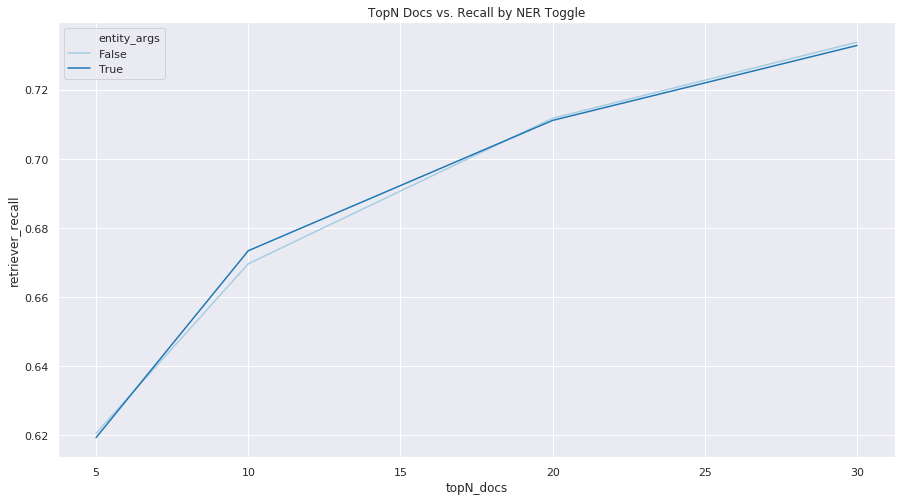

In [6]:
sns.set(palette='Paired', context='notebook')
plt.figure(figsize=(15,8))
sns.lineplot(x='topN_docs', y='retriever_recall', hue='entity_args', data=temp)
plt.title('TopN Docs vs. Recall by NER Toggle')

**Takeaway** - NER helps search Recall for lower number of docs returned, but has less impact as more docs are retrieved

#### Impact of Synonyms

In [7]:
temp2 = results_df.query('entity_args==True & topM_passages==10').loc[:, ['topN_docs','retriever_recall', 'synonym_args']]

In [8]:
temp2

,topN_docs,retriever_recall,synonym_args
4,20,0.711097,0
10,10,0.644451,1
14,30,0.721471,1
19,5,0.619302,0
22,20,0.696636,1
27,30,0.732788,0
38,10,0.673373,0
39,5,0.594467,1


Text(0.5,1,'TopN Docs vs. Recall by Synonym Toggle')

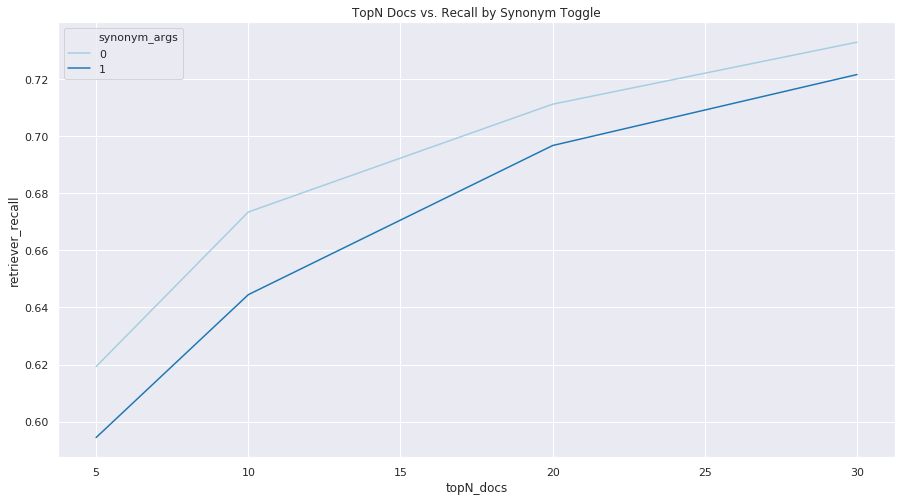

In [9]:
sns.set(palette='Paired', context='notebook')
plt.figure(figsize=(15,8))
sns.lineplot(x='topN_docs', y='retriever_recall', hue='synonym_args', data=temp2)
plt.title('TopN Docs vs. Recall by Synonym Toggle')

**Takeaway** - Synonyms degrade performance, however having multiple of them helps a little bit. This is happening because synonyms based on static word embeddings are not reliable and often over-generalize + introduce bias from the learned embeddings

In [20]:
from retriever import QueryExpander, Retriever

In [21]:
ret = Retriever()

I0706 10:46:27.541115 140509144016704 utils_any2vec.py:274] loading projection weights from /home/gpsnest/gensim-data/glove-wiki-gigaword-100/glove-wiki-gigaword-100.gz
I0706 10:46:52.704569 140509144016704 utils_any2vec.py:297] loaded (400000, 100) matrix from /home/gpsnest/gensim-data/glove-wiki-gigaword-100/glove-wiki-gigaword-100.gz


### Here's why static synonyms decrease recall

In [4]:
ret = Retriever()

I0707 14:39:13.041998 140447255344960 utils_any2vec.py:274] loading projection weights from /home/gpsnest/gensim-data/glove-wiki-gigaword-100/glove-wiki-gigaword-100.gz
I0707 14:39:43.763972 140447255344960 utils_any2vec.py:297] loaded (400000, 100) matrix from /home/gpsnest/gensim-data/glove-wiki-gigaword-100/glove-wiki-gigaword-100.gz


In [5]:
from retriever import QueryExpander

In [6]:
nq_dev[9].question_text

'where does the last name painter come from'

In [11]:
syn_args = {'gensim_model': ret.word_vectors, 'n_syns': 2}
ent_args = {'spacy_model': ret.nlp}
qe = QueryExpander(, entity_args=ent_args, synonym_args=syn_args)

In [13]:
print(qe.query)

Bool(should=[MultiMatch(fields=['title', 'text'], query='What is Andrew Reed who lives in the USAs middle name life people 1939-41 nzgsae east end', type='most_fields'), MultiMatch(fields=['title', 'text'], query='andrew reed', type='phrase')])


In [14]:
for i, ex in enumerate(nq_dev):
    
    syn_args = {'gensim_model': ret.word_vectors, 'n_syns': 2}
    ent_args = {'spacy_model': ret.nlp}
    
    qe = QueryExpander(ex.question_text, entity_args=ent_args, synonym_args=syn_args)
    print(i)
    print('Original Question:', qe.question_text)
    print('Entities Found:', qe.entities)
    print('Terms Expanded:', qe.terms_to_expand)
    print('Synonyms Used:', qe.all_syns)
    print(qe.query)
    print()
    
    if i == 50: break

0
Original Question: what do the 3 dots mean in math
Entities Found: ['3']
Terms Expanded: [dots, mean, math]
Synonyms Used: ['rectangles', 'pixels', 'means', 'if', 'mathematics', 'maths']
Bool(should=[MultiMatch(fields=['title', 'text'], query='what do the 3 dots mean in math rectangles pixels means if mathematics maths', type='most_fields'), MultiMatch(fields=['title', 'text'], query='3', type='phrase')])

1
Original Question: when was the writ watch invented by who
Entities Found: []
Terms Expanded: [writ, watch, invented]
Synonyms Used: ['habeas', 'writs', 'watching', "'ll", 'invention', 'inventor']
Bool(should=[MultiMatch(fields=['title', 'text'], query="when was the writ watch invented by who habeas writs watching 'll invention inventor", type='most_fields')])

2
Original Question: who wrote the song photograph by ringo starr
Entities Found: ['ringo starr']
Terms Expanded: [wrote, song, photograph]
Synonyms Used: ['published', 'book', 'album', 'songs', 'photographs', 'photo']
Boo

18
Original Question: where was the world economic forum held this year
Entities Found: ['this year']
Terms Expanded: [world, economic, forum, held]
Synonyms Used: ['europe', 'america', 'economy', 'financial', 'seminar', 'conference', 'hold', 'took']
Bool(should=[MultiMatch(fields=['title', 'text'], query='where was the world economic forum held this year europe america economy financial seminar conference hold took', type='most_fields'), MultiMatch(fields=['title', 'text'], query='this year', type='phrase')])

19
Original Question: where are the giant redwoods located in california
Entities Found: ['california']
Terms Expanded: [giant, redwoods, located]
Synonyms Used: ['conglomerate', 'maker', 'redwood', 'sequoias', 'situated', 'adjacent']
Bool(should=[MultiMatch(fields=['title', 'text'], query='where are the giant redwoods located in california conglomerate maker redwood sequoias situated adjacent', type='most_fields'), MultiMatch(fields=['title', 'text'], query='california', type='

36
Original Question: what is the maximum data rate for the 802.11a standard select one
Entities Found: ['802.11a', 'one']
Terms Expanded: [maximum, data, rate, standard, select]
Synonyms Used: ['minimum', 'limit', 'information', 'analysis', 'rates', 'inflation', 'standards', 'basic', 'selected', 'choose']
Bool(should=[MultiMatch(fields=['title', 'text'], query='what is the maximum data rate for the 802.11a standard select one minimum limit information analysis rates inflation standards basic selected choose', type='most_fields'), MultiMatch(fields=['title', 'text'], query='802.11a', type='phrase'), MultiMatch(fields=['title', 'text'], query='one', type='phrase')])

37
Original Question: use partial charges to indicate all polar bonds in the following molecules
Entities Found: []
Terms Expanded: [use, partial, charges, indicate, polar, bonds, following, molecules]
Synonyms Used: ['used', 'such', 'complete', 'immediate', 'charged', 'guilty', 'indicating', 'suggest', 'arctic', 'antarctic

**Good Examples:** 15, 45, 47, 18ish, 
**Bad Examples:** 40, 20, 38
**Example of NER Failing:** 28, 35

**Takeaway**
- Static synonym expansion needs more hand tailored rules to keep expanded queries relevant.
- Contextual MLM based synonym expansion would definitely help, but is non-trivial to implement properly
    - https://gist.github.com/avidale/c6b19687d333655da483421880441950
- Similar Question Identification might also help... rather than enhance the current query, use BERT to create sentence embedding for ALL NQ questions (train/dev) and save in a database. Then at query time embed the current question, lookup the most similar other questions, and use multiple new questions to broaden the search space
    - https://github.com/hanxiao/bert-as-service#building-a-qa-semantic-search-engine-in-3-minutes 

### Ranker Evaluation 

#### Impact of NER

In [10]:
temp3_1 = results_df.query('synonym_args==0 & topN_docs==5').loc[:, ['topM_passages','ranker_recall','entity_args']]
temp3_2 = results_df.query('synonym_args==0 & topN_docs==10').loc[:, ['topM_passages','ranker_recall','entity_args']]
temp3_3 = results_df.query('synonym_args==0 & topN_docs==20').loc[:, ['topM_passages','ranker_recall','entity_args']]
temp3_4 = results_df.query('synonym_args==0 & topN_docs==30').loc[:, ['topM_passages','ranker_recall','entity_args']]

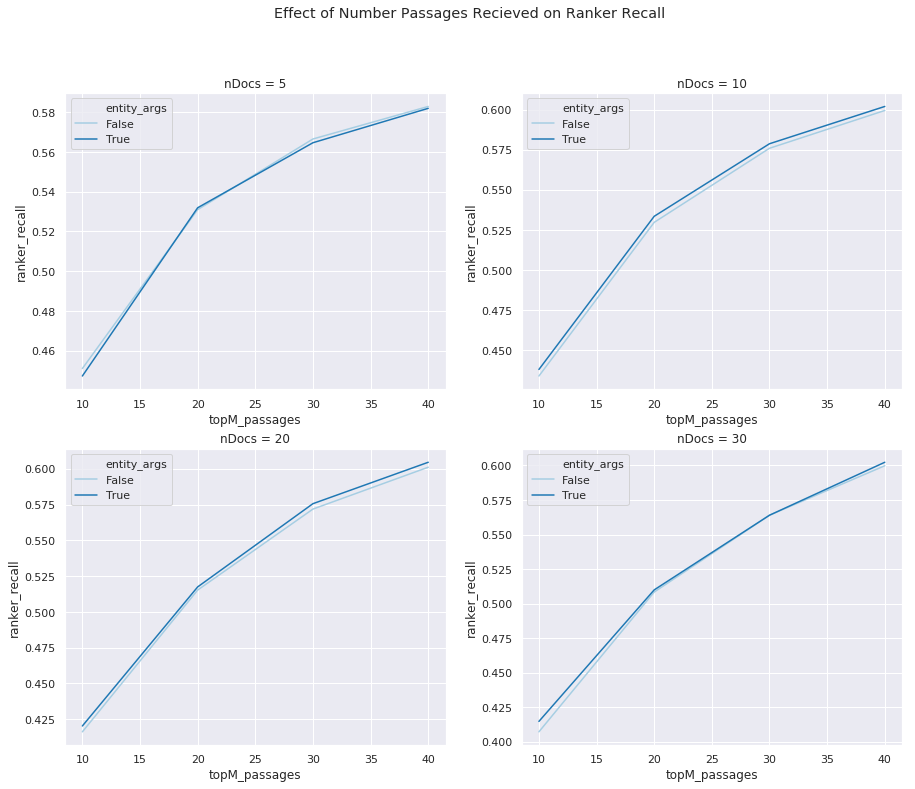

In [12]:
sns.set(palette='Paired', context='notebook')
fig, axs = plt.subplots(2,2, figsize=(15,12))
fig.suptitle('Effect of Number Passages Recieved on Ranker Recall')
axs[0,0].set_title('nDocs = 5')
axs[0,1].set_title('nDocs = 10')
axs[1,0].set_title('nDocs = 20')
axs[1,1].set_title('nDocs = 30')
sns.lineplot(x='topM_passages', y='ranker_recall', hue='entity_args', data=temp3_1, ax=axs[0,0])
sns.lineplot(x='topM_passages', y='ranker_recall', hue='entity_args', data=temp3_2, ax=axs[0,1])
sns.lineplot(x='topM_passages', y='ranker_recall', hue='entity_args', data=temp3_3, ax=axs[1,0])
sns.lineplot(x='topM_passages', y='ranker_recall', hue='entity_args', data=temp3_4, ax=axs[1,1])

#### Impact of Synonyms

In [13]:
temp4 = results_df.query('entity_args==True & topN_docs==10').loc[:, ['topM_passages','ranker_recall','synonym_args']]

Text(0.5,1,'TopM Passages vs. Ranker Recall by Synonym Toggle (topN_docs = 10)')

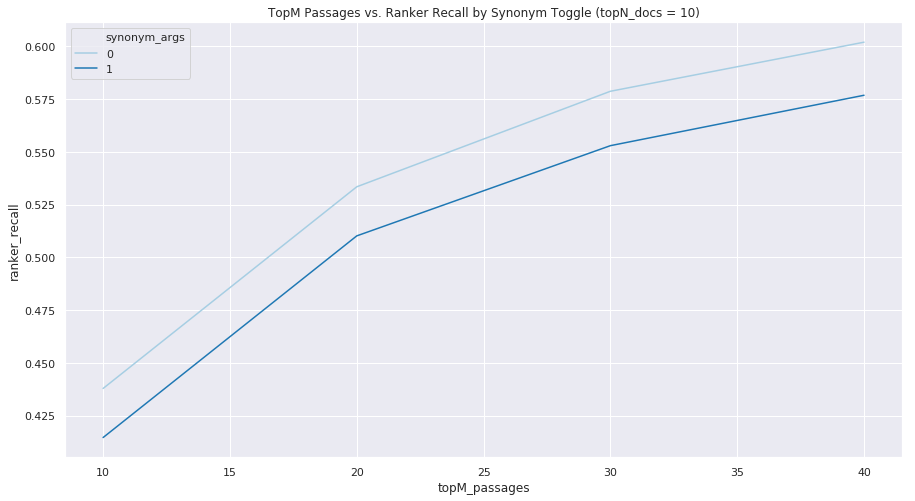

In [14]:
sns.set(palette='Paired', context='notebook')
plt.figure(figsize=(15,8))
sns.lineplot(x='topM_passages', y='ranker_recall', hue='synonym_args', data=temp4)
plt.title('TopM Passages vs. Ranker Recall by Synonym Toggle (topN_docs = 10)')

### 

In [65]:
temp4_1 = results_df.query('synonym_args==0 & topM_passages==10').loc[:, ['topN_docs','ranker_recall','entity_args']]
temp4_2 = results_df.query('synonym_args==0 & topM_passages==20').loc[:, ['topN_docs','ranker_recall','entity_args']]
temp4_3 = results_df.query('synonym_args==0 & topM_passages==30').loc[:, ['topN_docs','ranker_recall','entity_args']]
temp4_4 = results_df.query('synonym_args==0 & topM_passages==40').loc[:, ['topN_docs','ranker_recall','entity_args']]

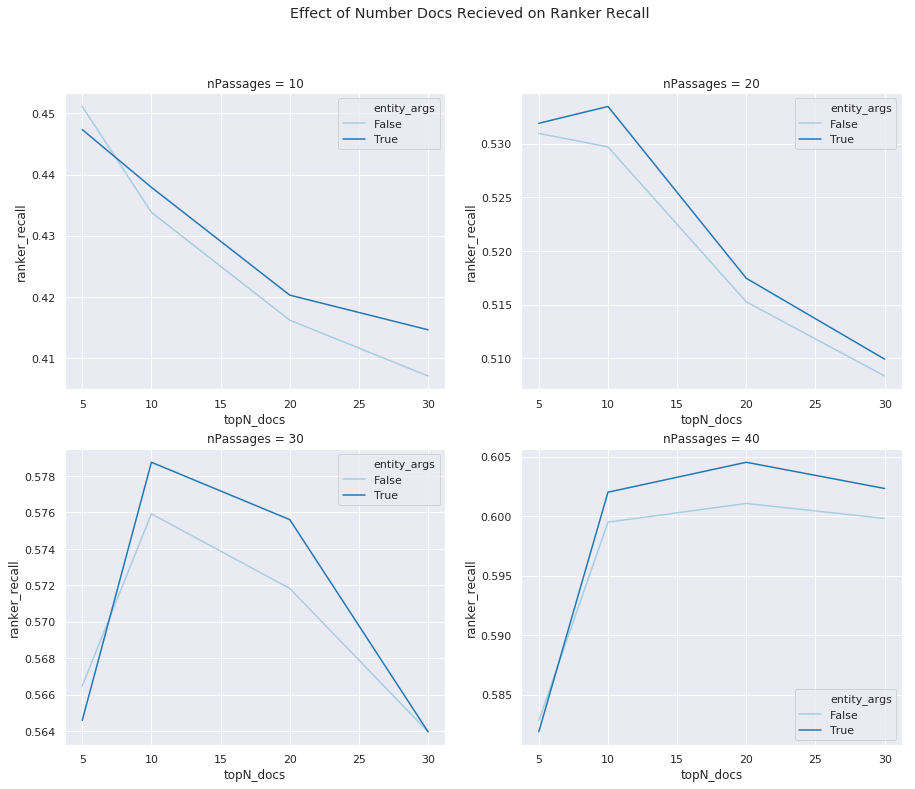

In [67]:
fig, axs = plt.subplots(2,2, figsize=(15,12))
fig.suptitle('Effect of Number Docs Recieved on Ranker Recall')
axs[0,0].set_title('nPassages = 10')
axs[0,1].set_title('nPassages = 20')
axs[1,0].set_title('nPassages = 30')
axs[1,1].set_title('nPassages = 40')
sns.lineplot(x='topN_docs', y='ranker_recall', hue='entity_args', data=temp4_1, ax=axs[0,0])
sns.lineplot(x='topN_docs', y='ranker_recall', hue='entity_args', data=temp4_2, ax=axs[0,1])
sns.lineplot(x='topN_docs', y='ranker_recall', hue='entity_args', data=temp4_3, ax=axs[1,0])
sns.lineplot(x='topN_docs', y='ranker_recall', hue='entity_args', data=temp4_4, ax=axs[1,1])

**Insights**


- Passing more Passages to the Reader will always have better Recall
- Using NER is always better
- If you can only pass a few passages to the Reader (10, 20), you're better off collecting those passages from a smaller pool of Documents. (top left)
    - The TFIDF + Cosine Similarity doesn't retrain high mAP
- If you are able to pass more passages to the Reader (30, 40), you're best off collecting those passages from a larger pool of documents. (bottom right)



### Does Retreiver alone perform worse than Ranker with the same amount of content?

- Our best scenario from testing is 40 passages coming from 20 docs
- 1 article = 5.8 paragraphs, therefore:
    - 40 paragraphs ~7 documents
    - 30 paragraphs ~5 documents
    - 20 paragraphs ~3 documents
    - 10 paragraphs ~2 documents

***Do we have higher recall with 7 documents straight from the retriever?***


In [3]:
qa_sys = QASystem()

In [82]:
topNs = [2,3,5,7]
topMs = [None]
entity_toggle = [False]
synonym_toggle = [0]

n_exps = (len(topNs)*len(topMs)*len(entity_toggle)*len(synonym_toggle)) \
            - ((len(synonym_toggle)-1)*len(topNs)*len(topMs))

with tqdm(total=n_exps) as pbar:

    for ent_opt in entity_toggle:
        for syn_opt in synonym_toggle:
            for topN in topNs:
                for topM in topMs:

                    # cant do synonyms without entities
                    if ent_opt == False and syn_opt in [1,2]:
                        pbar.update(1)
                        continue

                    exp_name = f'exp1_{topN}_{topM}_{ent_opt}_{syn_opt}'

                    experiment_args = {'examples': nq_dev,
                                       'prediction_function': 'predict_combined',
                                       'index_name': 'wiki-full-stop-stem',
                                       'full_sys': False,
                                       'exp_name': exp_name,
                                       'topN_docs': topN,
                                       'topM_passages': topM,
                                       'topk_answers': 1
                                      }

                    if ent_opt:
                        experiment_args['entity_args'] = {'ner_exp': True}
                    if syn_opt != 0:
                        experiment_args['synonym_args'] = {'exp_type':'static', 'n_syns':syn_opt}
                    
                    # run experiment
                    all_results = qa_sys.evaluate_qa_sys(**experiment_args)
            
                    pbar.update(1)

  0%|          | 0/7651 [00:00<?, ?it/s]I0707 12:38:12.872298 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:38:12.881510 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:12.902751 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:12.918462 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:38:12.927934 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:38:12.961186 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

  0%|          | 21/7651 [00:00<00:41, 183.41it/s]I0707 12:38:12.977104 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search


  2%|▏         | 157/7651 [00:01<01:14, 101.15it/s]I0707 12:38:14.291912 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:38:14.310373 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:38:14.336124 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:38:14.361116 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:38:14.386915 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:38:14.395664 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:14.407806 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

  2%|▏   

I0707 12:38:15.648232 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

  4%|▎         | 281/7651 [00:02<01:23, 88.27it/s]I0707 12:38:15.660425 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:15.682095 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:15.696420 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:15.707183 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:15.719009 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:38:15.738678 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:38

  7%|▋         | 533/7651 [00:05<01:17, 91.27it/s]I0707 12:38:18.648708 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:38:18.668454 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:38:18.677468 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:18.686174 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:18.700933 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:18.758718 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

  7%|▋         | 550/7651 [00:05<01:12, 98.07it/s]I0707 12:38:18.811617 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-st

I0707 12:38:20.041041 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:38:20.056479 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

  9%|▉         | 675/7651 [00:07<01:22, 84.79it/s]I0707 12:38:20.082362 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:38:20.098038 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:38:20.113373 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:38:20.132326 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:20.171291 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

  9%|▉    


 10%|█         | 803/7651 [00:08<01:33, 73.37it/s]I0707 12:38:21.555678 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:38:21.679990 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.122s]
I0707 12:38:21.708173 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 11%|█         | 812/7651 [00:08<01:44, 65.36it/s]I0707 12:38:21.730931 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:38:21.745211 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:21.753943 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:21.778010 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:38:23.253379 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0707 12:38:23.266983 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:23.284978 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:38:23.299967 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 13%|█▎        | 969/7651 [00:10<01:25, 78.10it/s]I0707 12:38:23.309805 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:23.329361 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:38:23.343289 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38

I0707 12:38:24.556688 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:24.569580 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:38:24.620255 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:38:24.630169 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:24.652071 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 14%|█▍        | 1106/7651 [00:11<01:16, 85.35it/s]I0707 12:38:24.660838 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:24.672640 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:3

I0707 12:38:25.861016 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:38:25.893487 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:38:25.906719 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:25.915920 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:25.932220 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 16%|█▌        | 1241/7651 [00:13<00:58, 109.92it/s]I0707 12:38:25.948283 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:25.963572 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:

I0707 12:38:27.107950 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 18%|█▊        | 1392/7651 [00:14<00:49, 126.80it/s]I0707 12:38:27.138279 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:38:27.150912 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:38:27.175559 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:38:27.198982 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:38:27.221005 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:38:27.234032 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 18%|█▊ 

I0707 12:38:28.356491 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:38:28.368056 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:28.379089 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:28.394547 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:28.410062 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 20%|██        | 1549/7651 [00:15<00:47, 128.84it/s]I0707 12:38:28.433167 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:38:28.443396 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:


 22%|██▏       | 1676/7651 [00:16<01:04, 92.56it/s]I0707 12:38:29.760964 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:29.781997 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:38:29.808928 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:38:29.821397 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:29.854808 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 22%|██▏       | 1689/7651 [00:17<01:00, 98.58it/s]I0707 12:38:29.884024 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:38:29.913131 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:38:31.153960 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 24%|██▎       | 1809/7651 [00:18<01:03, 91.82it/s]I0707 12:38:31.178878 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:38:31.238832 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0707 12:38:31.249533 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:31.271775 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 24%|██▍       | 1822/7651 [00:18<01:00, 96.57it/s]I0707 12:38:31.312551 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:38:31.330790 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 25%|██▌       | 1939/7651 [00:19<01:13, 77.62it/s]I0707 12:38:32.612900 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:32.626457 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:38:32.648865 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:38:32.657784 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:32.669765 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:38:32.704846 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 26%|██▌       | 1957/7651 [00:19<01:01, 92.57it/s]I0707 12:38:32.734232 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:38:34.057022 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 27%|██▋       | 2077/7651 [00:21<01:04, 86.20it/s]I0707 12:38:34.067146 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:34.088375 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:34.102897 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:34.110154 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:34.149507 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:38:34.180715 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 27%|██▋ 


 29%|██▉       | 2204/7651 [00:22<01:12, 75.09it/s]I0707 12:38:35.529560 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:38:35.558366 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:38:35.594922 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:38:35.611132 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 29%|██▉       | 2214/7651 [00:22<01:08, 79.07it/s]I0707 12:38:35.625149 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:38:35.658435 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:38:35.677555 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:38:37.184697 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.118s]

 31%|███       | 2372/7651 [00:24<01:11, 74.08it/s] I0707 12:38:37.194984 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:38:37.219408 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:38:37.236245 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:37.285093 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0707 12:38:37.309223 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 31%|███       | 2382/7651 [00:24<01:09, 75.67it/s]I0707 12:38:37.344570 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-sto

I0707 12:38:38.702489 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:38.709192 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.004s]
I0707 12:38:38.736670 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 33%|███▎      | 2513/7651 [00:25<00:53, 95.78it/s]I0707 12:38:38.750930 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:38:38.768244 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:38:38.811835 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:38:38.866068 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0707 12:3

I0707 12:38:40.100512 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 34%|███▍      | 2636/7651 [00:27<00:55, 90.61it/s]I0707 12:38:40.122241 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:40.142977 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:40.158127 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:40.175148 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:40.204466 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 35%|███▍      | 2646/7651 [00:27<00:54, 92.01it/s]I0707 12:38:40.216592 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:38:41.333123 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]

 36%|███▋      | 2783/7651 [00:28<00:51, 95.29it/s] I0707 12:38:41.352886 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:38:41.391819 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:38:41.412883 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:38:41.449993 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0707 12:38:41.475319 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:38:41.573325 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.096s]
I0707 12:

I0707 12:38:42.818799 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:38:42.835669 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:42.852918 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:42.865257 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:42.893062 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 38%|███▊      | 2938/7651 [00:30<00:42, 109.71it/s]I0707 12:38:42.906805 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:38:42.947382 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:

I0707 12:38:44.298311 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:38:44.310812 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:38:44.335100 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:38:44.344158 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:44.410062 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 40%|████      | 3092/7651 [00:31<00:47, 95.95it/s]I0707 12:38:44.426964 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:38:44.448486 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:3

I0707 12:38:47.054844 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:38:47.081372 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:38:47.097270 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:38:47.117266 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:38:47.158528 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 44%|████▍     | 3363/7651 [00:34<00:44, 96.02it/s]I0707 12:38:47.199374 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:38:47.221898 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:3


 46%|████▌     | 3491/7651 [00:35<00:41, 99.68it/s]I0707 12:38:48.437656 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:48.451840 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:48.468027 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:48.481132 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:38:48.507058 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:38:48.514962 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:48.531659 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 46%|████

I0707 12:38:49.735359 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:38:49.741124 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.004s]

 47%|████▋     | 3616/7651 [00:36<00:40, 99.36it/s]I0707 12:38:49.758410 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:49.781816 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:38:49.820597 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:38:49.840536 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:49.855849 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 47%|████

I0707 12:38:50.849493 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:50.861936 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:50.876741 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 49%|████▉     | 3781/7651 [00:38<00:32, 120.79it/s]I0707 12:38:50.895761 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:38:50.907746 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:50.924270 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:38:50.939465 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:

I0707 12:38:52.190694 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]

 51%|█████▏    | 3925/7651 [00:39<00:36, 102.10it/s]I0707 12:38:52.213374 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:52.225328 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:38:52.249605 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:38:52.261537 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:52.325068 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0707 12:38:52.345890 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:

I0707 12:38:53.533046 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:38:53.542191 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:53.604808 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 53%|█████▎    | 4047/7651 [00:40<00:47, 75.80it/s]I0707 12:38:53.665038 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:38:53.693955 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:38:53.719722 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:38:53.740559 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:3

I0707 12:38:54.849017 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:38:54.860208 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:54.874153 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:38:54.895260 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:38:54.927877 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:38:54.955183 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:38:54.974307 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 55%|█████▍    | 4202/7651 [00:42<00:31, 110.74it/s]I0707 12:


 57%|█████▋    | 4325/7651 [00:43<00:27, 123.08it/s]I0707 12:38:56.064248 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:38:56.072326 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:56.134906 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0707 12:38:56.160421 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:38:56.169919 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 57%|█████▋    | 4339/7651 [00:43<00:28, 115.84it/s]I0707 12:38:56.178577 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:56.196507 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-st

I0707 12:38:57.357889 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:38:57.393578 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:38:57.401572 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:38:57.415337 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 58%|█████▊    | 4444/7651 [00:44<00:32, 98.33it/s] I0707 12:38:57.424481 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:38:57.467185 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:38:57.478614 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:

I0707 12:38:58.796103 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:58.814476 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:38:58.823670 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:38:58.835053 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:38:58.845918 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 60%|█████▉    | 4583/7651 [00:45<00:28, 107.43it/s]I0707 12:38:58.879643 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:38:58.922438 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:

I0707 12:39:01.344583 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:39:01.373245 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:39:01.383475 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 64%|██████▎   | 4867/7651 [00:48<00:26, 104.31it/s]I0707 12:39:01.398386 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:01.407776 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:39:01.437339 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:39:01.476410 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:

I0707 12:39:02.708431 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 65%|██████▌   | 4995/7651 [00:49<00:29, 89.74it/s]I0707 12:39:02.755210 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:39:02.762077 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:39:02.784446 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:39:02.794475 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:39:02.805707 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:02.822515 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 66%|████

I0707 12:39:04.125329 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:04.199573 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]

 67%|██████▋   | 5154/7651 [00:51<00:30, 81.92it/s]I0707 12:39:04.218154 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:04.229379 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:04.255238 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:04.280950 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:04.296643 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:3

I0707 12:39:05.610615 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:39:05.646836 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:39:05.662633 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 69%|██████▉   | 5286/7651 [00:52<00:34, 68.38it/s]I0707 12:39:05.673342 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:39:05.731438 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0707 12:39:05.766129 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:39:05.802353 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:3

I0707 12:39:06.950967 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:39:07.039231 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.086s]
I0707 12:39:07.063138 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:39:07.094678 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 71%|███████   | 5446/7651 [00:54<00:21, 104.16it/s]I0707 12:39:07.113812 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:07.178643 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]
I0707 12:39:07.222705 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0707 12:


 73%|███████▎  | 5570/7651 [00:55<00:21, 96.78it/s]I0707 12:39:08.457423 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:39:08.473615 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:39:08.482371 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:39:08.494251 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:08.502439 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:39:08.558152 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 73%|███████▎  | 5581/7651 [00:55<00:23, 88.03it/s]I0707 12:39:08.572503 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:39:09.874906 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:39:09.887652 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 75%|███████▍  | 5706/7651 [00:57<00:22, 85.91it/s]I0707 12:39:09.902212 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:09.913995 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:39:09.953095 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:39:09.966708 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:09.981899 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:3

I0707 12:39:11.140301 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:39:11.163268 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 76%|███████▋  | 5841/7651 [00:58<00:14, 122.56it/s]I0707 12:39:11.192488 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:39:11.213542 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:39:11.222285 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:39:11.270197 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 77%|███████▋  | 5857/7651 [00:58<00:13, 129.94it/s]I0707 12:39:11.292277 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-st

I0707 12:39:12.846503 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:12.857048 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:39:12.869030 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:12.927022 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 78%|███████▊  | 5987/7651 [01:00<00:21, 76.48it/s]I0707 12:39:12.977190 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0707 12:39:13.001253 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:13.018912 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:3

I0707 12:39:15.646742 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 82%|████████▏ | 6289/7651 [01:02<00:13, 98.82it/s] I0707 12:39:15.666800 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:15.677873 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:39:15.700923 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:39:15.733905 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:39:15.763511 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:39:15.770592 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:

I0707 12:39:16.817903 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:39:16.828557 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:39:16.844254 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 84%|████████▍ | 6420/7651 [01:03<00:11, 107.20it/s]I0707 12:39:16.864673 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:16.875518 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:39:16.914848 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:39:16.945783 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:

I0707 12:39:19.515673 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0707 12:39:19.531134 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 87%|████████▋ | 6677/7651 [01:06<00:10, 92.71it/s]I0707 12:39:19.569116 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:39:19.584953 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:39:19.607031 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:19.624250 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:39:19.634302 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]

 87%|████

I0707 12:39:21.054928 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 89%|████████▉ | 6802/7651 [01:08<00:11, 70.84it/s]I0707 12:39:21.078570 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:39:21.163444 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]
I0707 12:39:21.215812 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]

 89%|████████▉ | 6811/7651 [01:08<00:12, 65.53it/s]I0707 12:39:21.238930 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:39:21.249527 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:39:21.260938 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:39:22.633322 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 91%|█████████ | 6956/7651 [01:09<00:07, 88.36it/s]I0707 12:39:22.659006 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:22.683593 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:39:22.703355 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:22.730849 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:39:22.740828 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 91%|█████████ | 6966/7651 [01:09<00:07, 89.67it/s]I0707 12:39:22.775111 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:39:24.037197 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 93%|█████████▎| 7083/7651 [01:11<00:05, 103.15it/s]I0707 12:39:24.071331 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:39:24.083619 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:24.202722 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.117s]
I0707 12:39:24.227498 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:24.236380 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:39:24.243600 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]

 93%|███

I0707 12:39:25.427589 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:25.437297 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:25.449461 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:25.469591 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:25.482448 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 94%|█████████▍| 7199/7651 [01:12<00:04, 92.06it/s]I0707 12:39:25.495498 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:25.541192 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0707 12:3

I0707 12:39:26.554639 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:26.573483 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:26.580858 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:39:26.592230 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:26.606975 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:39:26.618570 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:39:26.640215 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 96%|█████████▌| 7342/7651 [01:13<00:02, 104.90it/s]I0707 12:

I0707 12:39:27.789797 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0707 12:39:27.862144 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0707 12:39:27.893292 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:39:27.905915 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 98%|█████████▊| 7462/7651 [01:15<00:02, 74.60it/s]I0707 12:39:27.915239 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:39:27.936324 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:27.976430 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:3

I0707 12:39:29.430933 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:39:29.455868 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 99%|█████████▉| 7605/7651 [01:16<00:00, 75.63it/s]I0707 12:39:29.482850 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:29.490215 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:39:29.509956 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:29.554476 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0707 12:39:29.586182 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

100%|████

I0707 12:39:30.757158 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

  1%|▏         | 96/7651 [00:00<01:11, 105.22it/s]I0707 12:39:30.776132 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:30.788577 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:30.806701 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:30.841374 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:39:30.852614 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:30.870400 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

  2%|▏    

I0707 12:39:32.195519 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:39:32.207194 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:32.226458 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:39:32.286286 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

  3%|▎         | 240/7651 [00:02<01:23, 88.87it/s]I0707 12:39:32.347185 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0707 12:39:32.365350 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:32.385661 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39


  5%|▍         | 375/7651 [00:04<01:53, 64.12it/s]I0707 12:39:33.961597 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:33.969036 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:39:34.042779 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.072s]
I0707 12:39:34.052198 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]

  5%|▌         | 386/7651 [00:04<01:39, 72.84it/s]I0707 12:39:34.085905 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:39:34.095916 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:34.128914 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:39:35.550534 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:35.590159 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:39:35.618187 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

  6%|▋         | 491/7651 [00:05<01:59, 59.93it/s]I0707 12:39:35.644240 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:39:35.658410 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:35.676113 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:35.687728 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39

I0707 12:39:36.900049 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:39:36.933559 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

  8%|▊         | 628/7651 [00:06<01:11, 97.84it/s]I0707 12:39:36.968950 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:39:37.037917 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]
I0707 12:39:37.074757 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0707 12:39:37.108827 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:39:37.142893 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:39


 10%|▉         | 747/7651 [00:08<01:39, 69.21it/s]I0707 12:39:38.525348 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:38.541029 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:38.550659 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:38.573801 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:39:38.611986 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:39:38.648198 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 10%|▉         | 763/7651 [00:08<01:26, 79.24it/s]I0707 12:39:38.677767 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:39:40.347554 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:39:40.363250 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:39:40.377544 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:39:40.406084 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:39:40.430881 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 12%|█▏        | 905/7651 [00:10<01:24, 80.06it/s]I0707 12:39:40.464405 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:39:40.491266 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:39

I0707 12:39:41.996874 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]

 14%|█▎        | 1046/7651 [00:12<01:14, 88.20it/s]I0707 12:39:42.048053 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0707 12:39:42.082381 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:39:42.093762 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:42.120313 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 14%|█▍        | 1057/7651 [00:12<01:14, 88.48it/s]I0707 12:39:42.138811 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:42.191819 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 15%|█▌        | 1166/7651 [00:13<01:27, 74.08it/s]I0707 12:39:43.479758 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:43.524516 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0707 12:39:43.542780 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:39:43.556761 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:43.573971 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 15%|█▌        | 1181/7651 [00:13<01:15, 85.90it/s]I0707 12:39:43.596034 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:43.636747 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:39:44.735071 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:44.767110 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:39:44.781665 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:44.827174 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 17%|█▋        | 1318/7651 [00:14<01:00, 104.25it/s]I0707 12:39:44.842030 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:44.849153 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:39:44.873561 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:

I0707 12:39:46.169171 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:39:46.237050 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0707 12:39:46.260366 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 19%|█▉        | 1457/7651 [00:16<01:20, 77.17it/s]I0707 12:39:46.289013 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:39:46.304166 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:46.320549 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:39:46.360329 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

 19%|█▉  

I0707 12:39:47.509059 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 21%|██        | 1617/7651 [00:17<00:50, 120.40it/s]I0707 12:39:47.555471 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:39:47.621256 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0707 12:39:47.642545 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:39:47.661779 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:39:47.678934 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:47.690270 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:

I0707 12:39:50.596993 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:50.612595 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:39:50.625915 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

 25%|██▍       | 1876/7651 [00:20<01:08, 84.18it/s]I0707 12:39:50.676721 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0707 12:39:50.720536 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0707 12:39:50.767687 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:39:50.789107 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:3


 26%|██▌       | 2006/7651 [00:22<01:02, 91.04it/s]I0707 12:39:52.201539 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:39:52.216913 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:39:52.301705 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.082s]
I0707 12:39:52.316200 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:52.388047 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.069s]
I0707 12:39:52.395662 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.004s]
I0707 12:39:52.406292 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 26%|██▋ 

I0707 12:39:53.667954 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:39:53.691869 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:39:53.715342 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:39:53.741650 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 28%|██▊       | 2139/7651 [00:23<00:59, 93.36it/s]I0707 12:39:53.761407 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:39:53.790634 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:39:53.825035 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:3


 30%|██▉       | 2285/7651 [00:25<01:03, 83.92it/s]I0707 12:39:55.531076 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:39:55.586850 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0707 12:39:55.666676 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]
I0707 12:39:55.675067 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:39:55.704195 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 30%|███       | 2296/7651 [00:25<01:12, 73.93it/s]I0707 12:39:55.752301 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0707 12:39:55.785252 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 32%|███▏      | 2439/7651 [00:27<01:14, 69.99it/s]I0707 12:39:57.357302 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:39:57.410345 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0707 12:39:57.433181 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:39:57.454615 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:39:57.473757 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 32%|███▏      | 2448/7651 [00:27<01:14, 69.87it/s]I0707 12:39:57.519828 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0707 12:39:57.529991 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:39:58.964213 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:39:58.977045 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:39:58.986597 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:39:59.001594 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:39:59.020792 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:39:59.084603 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 34%|███▎      | 2565/7651 [00:29<01:16, 66.28it/s]I0707 12:39:59.111032 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:3

I0707 12:40:00.276630 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:00.306242 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 35%|███▌      | 2698/7651 [00:30<00:44, 112.49it/s]I0707 12:40:00.326321 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:40:00.338281 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:00.390738 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0707 12:40:00.403180 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:00.415766 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 36%|███

I0707 12:40:01.946128 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:01.955397 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:40:01.967497 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:02.008334 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]

 37%|███▋      | 2848/7651 [00:32<00:59, 80.25it/s]I0707 12:40:02.024403 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:02.055914 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:40:02.091348 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:4

I0707 12:40:03.544568 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]
I0707 12:40:03.566668 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:40:03.593073 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 39%|███▉      | 2994/7651 [00:33<01:03, 73.01it/s]I0707 12:40:03.606734 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:03.644020 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:40:03.663573 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:40:03.673370 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:4

I0707 12:40:06.619472 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:40:06.634449 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:06.657425 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 43%|████▎     | 3281/7651 [00:36<00:46, 93.11it/s]I0707 12:40:06.704618 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:40:06.841415 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.134s]
I0707 12:40:06.856842 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:06.874632 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:4

I0707 12:40:09.817311 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 46%|████▋     | 3539/7651 [00:39<01:02, 65.55it/s]I0707 12:40:09.827462 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:40:09.867662 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:40:09.892058 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:40:09.907842 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:09.963666 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 46%|████▋     | 3548/7651 [00:40<01:04, 63.97it/s]I0707 12:40:09.995679 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:40:11.183015 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]
I0707 12:40:11.201399 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:40:11.213185 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 48%|████▊     | 3689/7651 [00:41<00:33, 119.22it/s]I0707 12:40:11.227076 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:40:11.253288 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:11.264293 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:40:11.275742 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:

I0707 12:40:12.473154 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]

 50%|█████     | 3836/7651 [00:42<00:35, 106.59it/s]I0707 12:40:12.485428 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:12.496365 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:12.517414 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:40:12.629833 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.111s]

 50%|█████     | 3849/7651 [00:42<00:38, 98.14it/s] I0707 12:40:12.648526 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:40:12.659753 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-st


 52%|█████▏    | 3962/7651 [00:43<00:46, 79.59it/s]I0707 12:40:13.896023 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:13.919000 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:40:13.939871 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:40:13.978190 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 52%|█████▏    | 3972/7651 [00:44<00:44, 83.05it/s]I0707 12:40:13.994246 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:14.005160 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:14.046519 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:40:15.460180 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:40:15.467398 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:40:15.480364 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:40:15.508967 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:40:15.526047 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:15.577182 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 54%|█████▎    | 4109/7651 [00:45<00:41, 85.44it/s]I0707 12:40:15.590415 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:4

I0707 12:40:16.812570 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:16.843920 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:40:16.853189 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:40:16.876795 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 55%|█████▌    | 4238/7651 [00:46<00:42, 81.17it/s]I0707 12:40:16.901757 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:40:16.916410 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:16.944615 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:4

I0707 12:40:18.186916 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:40:18.220689 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 57%|█████▋    | 4367/7651 [00:48<00:47, 68.50it/s]I0707 12:40:18.297322 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0707 12:40:18.311690 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:18.334247 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:40:18.352176 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 57%|█████▋    | 4375/7651 [00:48<00:49, 66.04it/s]I0707 12:40:18.369147 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:40:19.679583 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:40:19.691755 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:40:19.708029 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 59%|█████▊    | 4487/7651 [00:49<00:43, 72.72it/s]I0707 12:40:19.775014 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0707 12:40:19.785081 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:19.805580 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:40:19.815987 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 59%|████

I0707 12:40:21.061653 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:40:21.091859 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:40:21.120928 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 60%|██████    | 4628/7651 [00:51<00:30, 99.40it/s]I0707 12:40:21.143232 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:40:21.181027 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:40:21.194232 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:21.233372 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 61%|████

I0707 12:40:22.576208 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 62%|██████▏   | 4773/7651 [00:52<00:27, 104.32it/s]I0707 12:40:22.656434 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.075s]
I0707 12:40:22.671735 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:22.697383 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:22.717122 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:40:22.723577 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:40:22.751438 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 63%|███

I0707 12:40:24.059811 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:40:24.072123 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:24.085385 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:40:24.148442 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]

 64%|██████▍   | 4920/7651 [00:54<00:29, 92.43it/s]I0707 12:40:24.181063 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:40:24.233600 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0707 12:40:24.291712 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 64%|████

I0707 12:40:27.304417 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 68%|██████▊   | 5209/7651 [00:57<00:27, 87.60it/s]I0707 12:40:27.359344 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0707 12:40:27.384441 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:27.414572 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:40:27.431351 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:40:27.449171 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:40:27.479943 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:4

I0707 12:40:28.819089 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:40:28.876077 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]

 70%|██████▉   | 5322/7651 [00:58<00:32, 71.52it/s]I0707 12:40:28.892601 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:28.942805 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:40:28.975165 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:40:29.011557 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 70%|██████▉   | 5332/7651 [00:59<00:32, 72.15it/s]I0707 12:40:29.043048 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:40:30.432170 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 72%|███████▏  | 5473/7651 [01:00<00:28, 76.84it/s]I0707 12:40:30.455545 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:40:30.468882 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:30.478674 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:40:30.493494 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:30.510329 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:40:30.533140 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 72%|████

I0707 12:40:31.922231 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 73%|███████▎  | 5605/7651 [01:01<00:25, 78.84it/s]I0707 12:40:31.934119 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:31.968436 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:40:32.008616 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:40:32.039622 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 73%|███████▎  | 5617/7651 [01:02<00:24, 84.69it/s]I0707 12:40:32.065153 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:32.104763 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:40:33.590911 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.135s]
I0707 12:40:33.620282 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:40:33.635598 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 75%|███████▍  | 5738/7651 [01:03<00:32, 59.75it/s]I0707 12:40:33.666626 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:40:33.681095 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:33.693683 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:40:33.709879 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:4

I0707 12:40:35.016560 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:40:35.047880 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:40:35.075103 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:40:35.189174 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.112s]

 77%|███████▋  | 5899/7651 [01:05<00:20, 84.19it/s]I0707 12:40:35.205493 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:35.227765 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:40:35.240141 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:4


 79%|███████▉  | 6035/7651 [01:06<00:16, 96.22it/s]I0707 12:40:36.856634 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:36.893222 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0707 12:40:36.902975 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:40:36.925742 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:40:36.948463 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:40:37.020798 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]
I0707 12:40:37.037806 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 79%|████

I0707 12:40:38.405799 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:38.426099 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:40:38.442799 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:38.457751 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:38.477442 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 81%|████████  | 6177/7651 [01:08<00:15, 94.18it/s]I0707 12:40:38.495875 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:38.512681 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:4

I0707 12:40:39.866094 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 83%|████████▎ | 6317/7651 [01:09<00:15, 85.92it/s]I0707 12:40:39.893078 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:39.911273 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:40:39.930217 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:40:39.952808 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:40:39.969154 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 83%|████████▎ | 6330/7651 [01:10<00:13, 95.30it/s]I0707 12:40:39.997973 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:40:41.143140 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:40:41.206103 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0707 12:40:41.215611 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:40:41.234751 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 84%|████████▍ | 6451/7651 [01:11<00:14, 84.69it/s]I0707 12:40:41.266670 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:40:41.276655 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:40:41.307069 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:4

I0707 12:40:42.640872 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:40:42.661779 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:40:42.669675 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:40:42.714366 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 86%|████████▌ | 6580/7651 [01:12<00:13, 78.29it/s]I0707 12:40:42.753309 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:40:42.765643 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:42.776760 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:4

I0707 12:40:44.278726 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:40:44.290548 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:44.340109 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:40:44.355245 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 88%|████████▊ | 6721/7651 [01:14<00:12, 72.51it/s]I0707 12:40:44.374768 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:40:44.403574 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:40:44.454189 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0707 12:4

I0707 12:40:45.883249 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:40:45.940933 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 90%|████████▉ | 6848/7651 [01:15<00:09, 85.74it/s]I0707 12:40:45.999147 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0707 12:40:46.040242 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 90%|████████▉ | 6860/7651 [01:16<00:08, 93.62it/s]I0707 12:40:46.066292 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:40:46.104825 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:40:46.171867 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:40:49.251221 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:40:49.261877 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]

 93%|█████████▎| 7114/7651 [01:19<00:07, 74.76it/s]I0707 12:40:49.286875 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:40:49.296785 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:40:49.324379 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:40:49.338190 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:49.362170 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:4

I0707 12:40:50.668758 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]

 95%|█████████▍| 7239/7651 [01:20<00:03, 107.34it/s]I0707 12:40:50.679272 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:40:50.697213 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:40:50.706291 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:40:50.729640 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:40:50.740343 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:40:50.750304 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:

I0707 12:40:51.957898 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:40:52.005286 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 96%|█████████▋| 7365/7651 [01:22<00:03, 84.32it/s]I0707 12:40:52.013136 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:40:52.022964 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:40:52.045037 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:40:52.059778 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:52.070701 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:4

I0707 12:40:53.416452 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:53.432230 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:40:53.524042 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.089s]

 98%|█████████▊| 7505/7651 [01:23<00:01, 80.39it/s]I0707 12:40:53.587663 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0707 12:40:53.597582 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:40:53.609983 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:53.625212 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 98%|████

I0707 12:40:55.029572 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:40:55.067873 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:40:55.081813 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

100%|█████████▉| 7632/7651 [01:25<00:00, 78.84it/s]I0707 12:40:55.106048 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:40:55.118860 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:40:55.152286 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:40:55.163326 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:4


  2%|▏         | 129/7651 [00:01<01:29, 83.72it/s]I0707 12:40:56.624741 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:40:56.655270 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:40:56.674485 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:40:56.710876 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  2%|▏         | 141/7651 [00:01<01:25, 87.79it/s]I0707 12:40:56.737090 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:40:56.773980 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0707 12:40:56.798384 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s


  3%|▎         | 257/7651 [00:03<01:58, 62.22it/s]I0707 12:40:58.298297 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:40:58.314962 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:40:58.329257 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:40:58.338793 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:40:58.384163 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

  3%|▎         | 265/7651 [00:03<01:56, 63.16it/s]I0707 12:40:58.421083 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:40:58.446163 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:41:00.203898 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

  5%|▌         | 399/7651 [00:04<01:59, 60.59it/s]I0707 12:41:00.314022 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0707 12:41:00.336318 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:00.359522 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:41:00.397974 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:41:00.428605 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

  5%|▌         | 407/7651 [00:05<02:24, 50.15it/s]I0707 12:41:00.463523 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:41:02.062423 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

  7%|▋         | 506/7651 [00:06<02:02, 58.13it/s]I0707 12:41:02.083984 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:41:02.102057 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:41:02.143586 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:41:02.163194 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:41:02.180720 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

  7%|▋         | 519/7651 [00:06<01:45, 67.57it/s]I0707 12:41:02.239355 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s


  8%|▊         | 645/7651 [00:08<01:50, 63.13it/s]I0707 12:41:03.865728 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0707 12:41:03.880325 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:41:03.894965 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:41:03.914167 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:41:03.950525 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]

  9%|▊         | 655/7651 [00:08<01:44, 66.84it/s]I0707 12:41:03.981932 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:41:04.037899 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:41:05.748539 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.148s]

 10%|█         | 771/7651 [00:10<02:14, 51.31it/s]I0707 12:41:05.773553 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:41:05.827584 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0707 12:41:05.839808 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:41:05.877068 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 10%|█         | 779/7651 [00:10<02:06, 54.14it/s]I0707 12:41:05.888349 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:41:05.909502 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:41:07.867738 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:41:07.905400 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 12%|█▏        | 926/7651 [00:12<01:32, 72.91it/s]I0707 12:41:07.947123 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:41:08.004679 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 12%|█▏        | 936/7651 [00:12<01:24, 79.21it/s]I0707 12:41:08.101169 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0707 12:41:08.181521 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]
I0707 12:41:08.206466 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:41:09.834515 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 14%|█▍        | 1065/7651 [00:14<01:35, 69.18it/s]I0707 12:41:09.881497 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:41:09.905716 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:41:09.916057 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:41:09.947553 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]

 14%|█▍        | 1075/7651 [00:14<01:28, 74.01it/s]I0707 12:41:09.961726 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:09.994807 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:11.500380 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]

 16%|█▌        | 1187/7651 [00:16<01:39, 64.99it/s]I0707 12:41:11.557701 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0707 12:41:11.572271 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:41:11.581103 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:41:11.589916 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:41:11.614995 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 16%|█▌        | 1196/7651 [00:16<01:34, 68.34it/s]I0707 12:41:11.660367 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 17%|█▋        | 1327/7651 [00:17<01:04, 97.89it/s] I0707 12:41:12.952070 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:41:12.995351 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:41:13.023921 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:41:13.138400 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.102s]
I0707 12:41:13.158408 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:41:13.183829 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 17%|█▋        | 1338/7651 [00:17<01:29, 70.75it/s]I0707 12:41:13.242408 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-sto


 19%|█▉        | 1465/7651 [00:19<01:30, 68.68it/s]I0707 12:41:14.705951 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:41:14.726663 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:14.758223 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:41:14.780636 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 19%|█▉        | 1485/7651 [00:19<01:13, 83.57it/s]I0707 12:41:14.795224 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:14.809437 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:41:14.824938 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 23%|██▎       | 1750/7651 [00:22<01:14, 79.20it/s]I0707 12:41:17.992049 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0707 12:41:18.012051 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:41:18.053221 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:41:18.071962 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]

 23%|██▎       | 1759/7651 [00:22<01:19, 74.45it/s]I0707 12:41:18.092938 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:41:18.107706 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:41:18.151655 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:19.752670 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:41:19.772440 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:41:19.810223 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 25%|██▍       | 1887/7651 [00:24<01:21, 70.39it/s]I0707 12:41:19.836016 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:41:19.856554 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:19.877419 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:19.893807 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:4

I0707 12:41:21.610863 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]

 26%|██▋       | 2015/7651 [00:26<01:42, 54.79it/s]I0707 12:41:21.625341 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:21.648136 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:21.709872 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0707 12:41:21.741455 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 26%|██▋       | 2022/7651 [00:26<01:43, 54.43it/s]I0707 12:41:21.769311 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:41:21.793423 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:23.245673 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:41:23.281673 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:41:23.303661 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 28%|██▊       | 2149/7651 [00:28<01:08, 80.64it/s]I0707 12:41:23.314983 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:41:23.336185 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:23.475993 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.138s]
I0707 12:41:23.494043 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:4


 30%|██▉       | 2295/7651 [00:30<01:20, 66.44it/s]I0707 12:41:25.390555 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:41:25.447521 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]
I0707 12:41:25.487876 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 30%|███       | 2306/7651 [00:30<01:15, 71.23it/s]I0707 12:41:25.521430 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:41:25.552654 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:41:25.567019 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:25.587543 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:27.437181 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:41:27.460681 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:27.518650 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 32%|███▏      | 2452/7651 [00:32<01:22, 63.28it/s]I0707 12:41:27.532999 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:41:27.597543 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.061s]
I0707 12:41:27.624551 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:41:27.663889 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:4

I0707 12:41:29.316069 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:41:29.336236 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 34%|███▎      | 2564/7651 [00:34<01:25, 59.18it/s]I0707 12:41:29.403529 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0707 12:41:29.428416 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:41:29.465336 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 34%|███▎      | 2571/7651 [00:34<01:28, 57.70it/s]I0707 12:41:29.474896 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:41:29.488012 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:30.873903 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:41:30.888868 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:30.948047 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]

 35%|███▌      | 2706/7651 [00:35<00:54, 91.17it/s]I0707 12:41:30.963289 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:30.978567 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:30.991640 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:41:30.999577 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:4

I0707 12:41:32.819394 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]

 37%|███▋      | 2848/7651 [00:37<01:01, 77.65it/s]I0707 12:41:32.839967 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:41:32.879251 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0707 12:41:32.922344 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:41:32.953142 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 37%|███▋      | 2861/7651 [00:37<00:57, 83.18it/s]I0707 12:41:32.971571 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:41:33.021682 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 39%|███▉      | 2991/7651 [00:39<01:29, 52.25it/s]I0707 12:41:34.890799 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:41:34.905366 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:41:34.956676 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 39%|███▉      | 2998/7651 [00:39<01:23, 55.98it/s]I0707 12:41:34.980684 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:34.992745 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:41:35.016925 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:41:35.046054 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:36.714352 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0707 12:41:36.739227 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:41:36.766376 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 41%|████      | 3147/7651 [00:41<00:51, 87.61it/s]I0707 12:41:36.778261 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:41:36.808027 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:41:36.824918 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:41:36.860721 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:4

I0707 12:41:38.485616 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 43%|████▎     | 3276/7651 [00:43<00:54, 80.69it/s]I0707 12:41:38.504265 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:41:38.528973 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:41:38.552169 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:41:38.701797 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.146s]
I0707 12:41:38.748540 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:41:38.776021 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:4

I0707 12:41:40.320687 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:41:40.340926 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:41:40.370218 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:41:40.420538 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]

 45%|████▍     | 3420/7651 [00:45<00:50, 83.13it/s]I0707 12:41:40.436458 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:41:40.486134 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:41:40.500712 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:4

I0707 12:41:42.166535 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0707 12:41:42.191927 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 46%|████▌     | 3538/7651 [00:46<01:14, 55.19it/s]I0707 12:41:42.201532 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:41:42.255552 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0707 12:41:42.286074 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 46%|████▋     | 3546/7651 [00:47<01:07, 60.63it/s]I0707 12:41:42.321093 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:41:42.385962 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:43.708798 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:41:43.722150 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:43.791603 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.067s]

 48%|████▊     | 3684/7651 [00:48<00:39, 101.51it/s]I0707 12:41:43.814165 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:41:43.827408 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:43.838825 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:41:43.869833 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:

I0707 12:41:45.252058 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 50%|████▉     | 3820/7651 [00:50<00:45, 84.68it/s]I0707 12:41:45.274782 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:45.302167 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:41:45.388239 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.084s]

 50%|█████     | 3836/7651 [00:50<00:41, 92.48it/s]I0707 12:41:45.403553 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:41:45.416955 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:41:45.443233 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:47.086776 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:41:47.121485 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 52%|█████▏    | 3961/7651 [00:51<00:56, 65.55it/s]I0707 12:41:47.144489 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:41:47.165217 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:41:47.186971 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:41:47.211452 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:41:47.263314 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 52%|████


 53%|█████▎    | 4080/7651 [00:53<00:58, 60.83it/s]I0707 12:41:48.856336 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0707 12:41:48.916685 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 53%|█████▎    | 4087/7651 [00:53<00:58, 61.27it/s]I0707 12:41:48.932650 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:41:48.944901 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:41:48.952883 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:41:48.968474 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:41:48.995952 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:50.407932 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0707 12:41:50.424600 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 55%|█████▌    | 4230/7651 [00:55<00:47, 71.84it/s]I0707 12:41:50.469120 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:41:50.485635 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:41:50.525507 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:41:50.535162 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:41:50.563013 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:4

I0707 12:41:52.006750 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:41:52.054411 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:41:52.077660 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 57%|█████▋    | 4365/7651 [00:56<00:54, 60.11it/s]I0707 12:41:52.120401 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0707 12:41:52.159228 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:41:52.255902 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.095s]
I0707 12:41:52.272116 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:4

I0707 12:41:53.804053 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:41:53.853178 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0707 12:41:53.878480 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:41:53.892680 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

 59%|█████▊    | 4484/7651 [00:58<00:53, 58.77it/s]I0707 12:41:53.910735 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:41:53.925770 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:41:54.010016 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 59%|████

I0707 12:41:55.346653 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:41:55.359062 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 60%|██████    | 4616/7651 [01:00<00:33, 89.34it/s]I0707 12:41:55.389021 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:41:55.412611 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:41:55.453331 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:41:55.492545 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]

 60%|██████    | 4628/7651 [01:00<00:33, 89.75it/s]I0707 12:41:55.516190 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:41:58.670353 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:41:58.720301 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0707 12:41:58.745215 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 64%|██████▍   | 4901/7651 [01:03<00:37, 74.02it/s]I0707 12:41:58.783735 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:41:58.805158 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:41:58.841049 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:41:58.855339 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 64%|████


 66%|██████▌   | 5026/7651 [01:05<00:33, 77.69it/s]I0707 12:42:00.436344 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.051s]
I0707 12:42:00.477565 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:42:00.587409 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.108s]
I0707 12:42:00.619570 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:42:00.648074 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 66%|██████▌   | 5035/7651 [01:05<00:46, 55.96it/s]I0707 12:42:00.673482 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:00.704578 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:02.385186 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:42:02.470354 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.083s]
I0707 12:42:02.483027 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 68%|██████▊   | 5203/7651 [01:07<00:29, 82.52it/s]I0707 12:42:02.550534 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0707 12:42:02.597898 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0707 12:42:02.636392 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:42:02.647355 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:4

I0707 12:42:04.268198 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 69%|██████▉   | 5305/7651 [01:09<00:43, 53.71it/s]I0707 12:42:04.294145 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:04.312568 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:04.331779 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:04.344746 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:42:04.382433 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 69%|██████▉   | 5316/7651 [01:09<00:37, 62.08it/s]I0707 12:42:04.402889 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:06.160752 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 71%|███████▏  | 5465/7651 [01:10<00:30, 72.32it/s]I0707 12:42:06.212431 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0707 12:42:06.220474 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:42:06.244238 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:06.262810 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:06.282512 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:06.291959 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:4

I0707 12:42:07.877971 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 73%|███████▎  | 5595/7651 [01:12<00:27, 74.48it/s]I0707 12:42:07.943162 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.060s]
I0707 12:42:07.977583 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:42:08.009181 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:42:08.036605 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:42:08.046034 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:42:08.073428 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:4


 75%|███████▍  | 5716/7651 [01:14<00:33, 58.06it/s]I0707 12:42:09.699666 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:42:09.716562 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:42:09.736207 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:09.743967 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]
I0707 12:42:09.816328 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.070s]

 75%|███████▍  | 5728/7651 [01:14<00:29, 64.53it/s]I0707 12:42:09.845454 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:42:09.859820 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:11.472916 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 77%|███████▋  | 5869/7651 [01:16<00:19, 89.21it/s] I0707 12:42:11.487068 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:42:11.506565 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:11.595054 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.087s]
I0707 12:42:11.622458 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 77%|███████▋  | 5879/7651 [01:16<00:22, 79.81it/s]I0707 12:42:11.652393 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:42:11.727741 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-sto

I0707 12:42:13.573767 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 78%|███████▊  | 5998/7651 [01:18<00:24, 66.66it/s]I0707 12:42:13.612971 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:42:13.695909 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.081s]

 78%|███████▊  | 6006/7651 [01:18<00:24, 66.23it/s]I0707 12:42:13.717019 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:13.741428 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:42:13.759310 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:42:13.789824 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:15.409048 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:15.419337 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:15.474509 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

 80%|████████  | 6145/7651 [01:20<00:22, 66.91it/s]I0707 12:42:15.493585 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:42:15.568773 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.073s]
I0707 12:42:15.588278 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:42:15.602676 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 80%|████

I0707 12:42:17.198073 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]

 82%|████████▏ | 6297/7651 [01:21<00:20, 64.63it/s]I0707 12:42:17.208060 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:42:17.224586 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:42:17.244333 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:42:17.267795 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:42:17.313783 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 82%|████████▏ | 6305/7651 [01:22<00:20, 65.92it/s]I0707 12:42:17.328275 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:18.633732 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]

 84%|████████▍ | 6429/7651 [01:23<00:14, 84.73it/s]I0707 12:42:18.677820 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:42:18.738193 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]
I0707 12:42:18.766227 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:42:18.789302 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:42:18.806087 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:42:18.829509 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 84%|████

I0707 12:42:20.380990 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:42:20.396373 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 86%|████████▌ | 6549/7651 [01:25<00:17, 61.57it/s]I0707 12:42:20.421641 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:20.442732 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:42:20.451424 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.006s]
I0707 12:42:20.468129 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:42:20.494869 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:4


 87%|████████▋ | 6685/7651 [01:26<00:13, 71.76it/s]I0707 12:42:22.237068 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:42:22.249158 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:22.267861 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:42:22.298854 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:42:22.319765 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 88%|████████▊ | 6701/7651 [01:27<00:11, 84.87it/s]I0707 12:42:22.344203 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:42:22.357298 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:26.065411 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 91%|█████████ | 6958/7651 [01:30<00:11, 61.31it/s]I0707 12:42:26.092924 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:42:26.159226 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.064s]
I0707 12:42:26.172772 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 91%|█████████ | 6965/7651 [01:30<00:10, 62.51it/s]I0707 12:42:26.215439 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:42:26.225501 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:26.304969 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:27.795183 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:42:27.816639 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:42:27.957476 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.137s]
I0707 12:42:27.973530 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:42:27.984038 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 93%|█████████▎| 7092/7651 [01:32<00:09, 61.41it/s]I0707 12:42:27.994728 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:28.045510 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0707 12:4

I0707 12:42:29.550935 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:42:29.571154 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 94%|█████████▍| 7193/7651 [01:34<00:07, 61.41it/s]I0707 12:42:29.595223 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:42:29.612936 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:42:29.629660 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:42:29.682601 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 94%|█████████▍| 7204/7651 [01:34<00:06, 69.43it/s]I0707 12:42:29.708872 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:31.053582 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:42:31.076958 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:42:31.087592 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:31.100318 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:31.117983 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:42:31.133883 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]

 96%|█████████▌| 7340/7651 [01:35<00:04, 76.20it/s]I0707 12:42:31.174406 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:4


 97%|█████████▋| 7456/7651 [01:37<00:02, 68.05it/s]I0707 12:42:32.673718 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.079s]
I0707 12:42:32.767566 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.088s]
I0707 12:42:32.812706 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0707 12:42:32.829833 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:42:32.840938 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]

 98%|█████████▊| 7464/7651 [01:37<00:03, 50.79it/s]I0707 12:42:32.868224 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:42:32.914000 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:34.744016 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:42:34.826166 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

 99%|█████████▉| 7602/7651 [01:39<00:00, 54.36it/s]I0707 12:42:34.867782 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]
I0707 12:42:34.915830 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:42:34.947557 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:42:34.954929 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.005s]

 99%|█████████▉| 7609/7651 [01:39<00:00, 54.66it/s]I0707 12:42:34.986683 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:36.542593 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.080s]

  1%|          | 87/7651 [00:01<01:35, 79.54it/s]I0707 12:42:36.568216 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:36.585847 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:42:36.603519 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:42:36.623066 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:36.650708 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

  1%|▏         | 97/7651 [00:01<01:31, 82.83it/s]I0707 12:42:36.670332 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-ste

I0707 12:42:38.404810 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:38.441039 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

  3%|▎         | 225/7651 [00:02<01:56, 63.99it/s]I0707 12:42:38.587700 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:42:38.607959 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:42:38.618022 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:38.641908 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:38.655254 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

  3%|▎    

I0707 12:42:40.455109 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0707 12:42:40.560044 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.103s]

  5%|▍         | 364/7651 [00:05<01:55, 63.05it/s]I0707 12:42:40.581748 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:42:40.746466 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.161s]
I0707 12:42:40.762881 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

  5%|▍         | 373/7651 [00:05<02:10, 55.59it/s]I0707 12:42:40.827035 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]
I0707 12:42:40.865624 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s


  6%|▌         | 472/7651 [00:07<02:07, 56.45it/s]I0707 12:42:42.597454 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:42:42.625251 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:42:42.653059 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:42:42.680207 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:42:42.692239 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:42:42.847191 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.153s]

  6%|▋         | 479/7651 [00:07<02:49, 42.22it/s]I0707 12:42:42.884820 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s


  8%|▊         | 601/7651 [00:08<01:35, 73.88it/s]I0707 12:42:44.433374 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:42:44.448841 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:42:44.479597 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:42:44.504097 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:42:44.536467 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

  8%|▊         | 612/7651 [00:09<01:28, 79.10it/s]I0707 12:42:44.560235 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:42:44.576781 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:42:46.471589 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.098s]

 10%|▉         | 732/7651 [00:10<02:06, 54.84it/s]I0707 12:42:46.496109 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:42:46.534913 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:42:46.577394 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:42:46.604135 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 10%|▉         | 739/7651 [00:11<02:07, 54.21it/s]I0707 12:42:46.627304 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:42:46.661105 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-s

I0707 12:42:48.791045 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.164s]

 11%|█▏        | 878/7651 [00:13<01:45, 64.03it/s]I0707 12:42:48.806836 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:42:48.856166 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.046s]
I0707 12:42:48.903906 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0707 12:42:48.940761 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:42:48.979937 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:42:49.088485 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.105s]
I0707 12:42

I0707 12:42:51.004897 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 13%|█▎        | 1020/7651 [00:15<01:54, 57.93it/s]I0707 12:42:51.029828 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:42:51.053059 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:42:51.104194 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0707 12:42:51.142834 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.037s]
I0707 12:42:51.187906 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]

 13%|█▎        | 1031/7651 [00:15<01:53, 58.55it/s]I0707 12:42:51.203563 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:52.800695 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0707 12:42:52.828845 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:42:52.874551 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 15%|█▌        | 1149/7651 [00:17<01:34, 69.14it/s]I0707 12:42:52.917984 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0707 12:42:52.941241 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:42:52.961377 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:42:53.016892 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]

 15%|█▌  

I0707 12:42:54.552770 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:42:54.580686 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:42:54.615420 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:42:54.637392 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 17%|█▋        | 1281/7651 [00:19<01:08, 92.48it/s]I0707 12:42:54.655536 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:42:54.699374 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0707 12:42:54.730941 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:4


 19%|█▊        | 1426/7651 [00:20<01:10, 88.79it/s]I0707 12:42:56.293023 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:56.309196 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:42:56.332504 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:42:56.379402 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:42:56.391063 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

 19%|█▉        | 1436/7651 [00:20<01:09, 89.14it/s]I0707 12:42:56.435665 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:42:56.458189 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:57.995232 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:42:58.043705 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]

 21%|██        | 1576/7651 [00:22<01:16, 79.78it/s]I0707 12:42:58.057670 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:42:58.085328 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:42:58.137472 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]
I0707 12:42:58.166324 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 21%|██        | 1587/7651 [00:22<01:13, 82.89it/s]I0707 12:42:58.211508 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:42:59.973633 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 22%|██▏       | 1705/7651 [00:24<01:33, 63.78it/s]I0707 12:43:00.000758 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:43:00.074565 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.071s]
I0707 12:43:00.126365 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0707 12:43:00.141861 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 22%|██▏       | 1713/7651 [00:24<01:42, 58.20it/s]I0707 12:43:00.168904 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:43:00.187637 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 24%|██▍       | 1832/7651 [00:26<01:51, 52.30it/s]I0707 12:43:01.968807 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:43:01.998022 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:43:02.028792 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:43:02.039367 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:43:02.054419 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]

 24%|██▍       | 1845/7651 [00:26<01:31, 63.70it/s]I0707 12:43:02.085181 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:43:02.103752 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:03.872566 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 26%|██▌       | 1968/7651 [00:28<01:15, 75.01it/s]I0707 12:43:03.887736 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:43:03.908301 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:43:03.936726 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:43:03.952563 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:43:03.979921 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 26%|██▌       | 1981/7651 [00:28<01:06, 84.69it/s]I0707 12:43:03.990846 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:05.855061 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:43:05.916803 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.058s]

 27%|██▋       | 2098/7651 [00:30<01:24, 65.86it/s]I0707 12:43:05.938544 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:43:05.948115 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:43:05.977434 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:43:06.000148 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:43:06.030229 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]

 28%|██▊ 

I0707 12:43:07.928231 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:43:08.072315 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.139s]
I0707 12:43:08.133720 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.059s]

 29%|██▉       | 2231/7651 [00:32<01:52, 48.37it/s]I0707 12:43:08.172683 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:43:08.192998 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:43:08.252578 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 29%|██▉       | 2239/7651 [00:32<01:42, 52.79it/s]I0707 12:43:08.273943 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:10.162524 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:43:10.185996 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:43:10.217490 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 31%|███▏      | 2394/7651 [00:34<01:25, 61.42it/s]I0707 12:43:10.243443 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:43:10.272084 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:43:10.299624 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:43:10.314406 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:4

I0707 12:43:12.288702 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.101s]
I0707 12:43:12.307582 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]

 33%|███▎      | 2521/7651 [00:36<01:38, 52.22it/s]I0707 12:43:12.403572 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.092s]
I0707 12:43:12.456490 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 33%|███▎      | 2528/7651 [00:36<01:41, 50.56it/s]I0707 12:43:12.484702 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:43:12.504311 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:43:12.546223 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:14.121345 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 35%|███▍      | 2641/7651 [00:38<01:18, 63.45it/s]I0707 12:43:14.162837 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:43:14.176149 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:43:14.186518 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:43:14.201691 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:43:14.210463 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:43:14.225384 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 35%|███▍

I0707 12:43:15.860823 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.057s]
I0707 12:43:15.903892 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 36%|███▋      | 2788/7651 [00:40<01:35, 50.78it/s]I0707 12:43:16.032716 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]
I0707 12:43:16.072162 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0707 12:43:16.094721 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:43:16.111913 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:43:16.128873 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 37%|███▋

I0707 12:43:17.792487 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:43:17.825125 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:43:17.844498 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:43:17.894373 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

 38%|███▊      | 2941/7651 [00:42<01:03, 74.41it/s]I0707 12:43:17.919660 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:43:17.943104 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:43:17.984720 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:4

I0707 12:43:21.948919 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:43:21.980379 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 42%|████▏     | 3225/7651 [00:46<01:13, 60.00it/s]I0707 12:43:22.013365 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:43:22.070235 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0707 12:43:22.086914 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:43:22.118629 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 42%|████▏     | 3233/7651 [00:46<01:14, 59.21it/s]I0707 12:43:22.132775 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:23.943818 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 44%|████▍     | 3352/7651 [00:48<01:07, 63.86it/s]I0707 12:43:23.986726 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:43:24.005619 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:43:24.042111 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]

 44%|████▍     | 3360/7651 [00:48<01:03, 67.67it/s]I0707 12:43:24.092972 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0707 12:43:24.110643 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:43:24.134013 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:25.881347 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:43:25.903004 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:43:25.921519 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:43:25.950028 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 46%|████▌     | 3498/7651 [00:50<00:54, 76.37it/s]I0707 12:43:25.967746 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:43:25.983572 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:43:25.993373 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:4

I0707 12:43:27.780710 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:43:27.833343 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.049s]
I0707 12:43:27.859745 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 47%|████▋     | 3613/7651 [00:52<01:05, 61.88it/s]I0707 12:43:27.867852 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.004s]
I0707 12:43:27.890455 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:43:27.920548 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:43:27.973936 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]

 47%|████

I0707 12:43:29.399946 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]

 49%|████▉     | 3772/7651 [00:53<00:46, 83.91it/s]I0707 12:43:29.433790 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:43:29.451977 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:43:29.477892 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:43:29.493923 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:43:29.517904 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]
I0707 12:43:29.542240 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 49%|████

I0707 12:43:31.199602 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:43:31.218375 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:43:31.275183 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.054s]

 51%|█████▏    | 3922/7651 [00:55<00:50, 74.32it/s]I0707 12:43:31.319413 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:43:31.332153 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:43:31.363823 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:43:31.379109 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:4

I0707 12:43:32.962465 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]

 53%|█████▎    | 4032/7651 [00:57<00:59, 60.45it/s]I0707 12:43:32.995801 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:43:33.104106 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0707 12:43:33.138359 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.032s]
I0707 12:43:33.178748 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.038s]
I0707 12:43:33.202484 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 53%|█████▎    | 4040/7651 [00:57<01:14, 48.55it/s]I0707 12:43:33.216190 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:34.802865 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:43:34.831758 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:43:34.842667 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]

 55%|█████▍    | 4181/7651 [00:59<00:36, 94.75it/s]I0707 12:43:34.875647 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:43:34.903741 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:43:34.921530 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:43:34.990950 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.065s]

 55%|████


 56%|█████▌    | 4301/7651 [01:01<00:46, 71.46it/s]I0707 12:43:36.577141 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:43:36.589167 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:43:36.603183 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:43:36.629844 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:43:36.646658 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:43:36.674318 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 57%|█████▋    | 4323/7651 [01:01<00:38, 87.39it/s]I0707 12:43:36.740736 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 58%|█████▊    | 4414/7651 [01:02<00:51, 63.47it/s]I0707 12:43:38.340595 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:43:38.356701 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:43:38.377570 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:43:38.402915 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 58%|█████▊    | 4424/7651 [01:02<00:45, 70.34it/s]I0707 12:43:38.418406 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]
I0707 12:43:38.465049 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.042s]
I0707 12:43:38.516412 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 59%|█████▉    | 4549/7651 [01:04<00:49, 62.56it/s]I0707 12:43:40.393903 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:43:40.418514 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:43:40.446893 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:43:40.468461 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:43:40.489739 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]

 60%|█████▉    | 4565/7651 [01:04<00:41, 74.36it/s]I0707 12:43:40.530640 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:43:40.627719 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 63%|██████▎   | 4835/7651 [01:08<00:39, 70.93it/s]I0707 12:43:44.248351 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:43:44.258971 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:43:44.286119 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:43:44.310900 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:43:44.344289 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 63%|██████▎   | 4846/7651 [01:08<00:36, 77.43it/s]I0707 12:43:44.357735 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:43:44.410437 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:46.078840 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:43:46.090316 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.009s]
I0707 12:43:46.116757 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]

 65%|██████▍   | 4972/7651 [01:10<00:35, 76.51it/s]I0707 12:43:46.245474 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.124s]
I0707 12:43:46.263969 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:43:46.282967 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.017s]
I0707 12:43:46.314753 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]

 65%|████

I0707 12:43:50.218325 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:43:50.241764 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:43:50.279111 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.031s]
I0707 12:43:50.293003 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.011s]

 69%|██████▊   | 5256/7651 [01:14<00:35, 66.63it/s]I0707 12:43:50.402744 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.106s]
I0707 12:43:50.418965 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:43:50.450118 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]

 69%|████


 70%|███████   | 5384/7651 [01:16<00:29, 76.37it/s]I0707 12:43:52.255257 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:43:52.285730 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:43:52.308092 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:43:52.353246 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 71%|███████   | 5396/7651 [01:16<00:27, 80.55it/s]I0707 12:43:52.366186 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:43:52.416214 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]
I0707 12:43:52.450516 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 72%|███████▏  | 5514/7651 [01:18<00:29, 71.64it/s]I0707 12:43:54.084268 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.024s]
I0707 12:43:54.104861 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:43:54.118651 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.008s]
I0707 12:43:54.153970 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:43:54.182194 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]

 72%|███████▏  | 5530/7651 [01:18<00:25, 82.25it/s]I0707 12:43:54.234720 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.047s]
I0707 12:43:54.273111 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:56.208472 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]

 74%|███████▍  | 5658/7651 [01:20<00:34, 57.54it/s]I0707 12:43:56.251764 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0707 12:43:56.272971 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:43:56.318990 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.043s]
I0707 12:43:56.353157 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.030s]
I0707 12:43:56.375901 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.020s]

 74%|███████▍  | 5666/7651 [01:20<00:36, 54.21it/s]I0707 12:43:56.389749 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:43:58.057341 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:43:58.080254 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 75%|███████▌  | 5771/7651 [01:22<00:29, 63.05it/s]I0707 12:43:58.110645 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:43:58.179212 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.066s]
I0707 12:43:58.200512 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]

 76%|███████▌  | 5779/7651 [01:22<00:29, 64.20it/s]I0707 12:43:58.213797 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:43:58.255552 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:44:02.396652 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.063s]
I0707 12:44:02.476968 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.077s]

 79%|███████▉  | 6065/7651 [01:26<00:27, 56.99it/s]I0707 12:44:02.497438 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:44:02.515043 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:44:02.531818 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:44:02.581634 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 79%|███████▉  | 6074/7651 [01:27<00:24, 63.63it/s]I0707 12:44:02.631645 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:44:04.267273 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 81%|████████  | 6206/7651 [01:28<00:15, 94.02it/s]I0707 12:44:04.296322 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]
I0707 12:44:04.343760 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.044s]
I0707 12:44:04.369404 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.022s]
I0707 12:44:04.498805 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.126s]

 81%|████████  | 6216/7651 [01:28<00:20, 69.85it/s]I0707 12:44:04.535559 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:44:04.551470 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 83%|████████▎ | 6344/7651 [01:30<00:17, 73.42it/s]I0707 12:44:06.094174 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:44:06.117539 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:44:06.154423 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.033s]
I0707 12:44:06.192483 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]

 83%|████████▎ | 6354/7651 [01:30<00:16, 76.34it/s]I0707 12:44:06.225322 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:44:06.283137 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.055s]
I0707 12:44:06.335740 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:44:07.832614 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0707 12:44:07.853434 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:44:07.912652 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 85%|████████▍ | 6467/7651 [01:32<00:24, 48.15it/s]I0707 12:44:07.968421 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.039s]
I0707 12:44:07.986430 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.016s]
I0707 12:44:08.029978 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]

 85%|████████▍ | 6473/7651 [01:32<00:23, 50.14it/s]I0707 12:44:08.065974 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop


 86%|████████▌ | 6593/7651 [01:34<00:17, 60.81it/s]I0707 12:44:09.766699 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.027s]
I0707 12:44:09.810060 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.040s]
I0707 12:44:09.832576 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:44:09.899162 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.062s]

 86%|████████▋ | 6603/7651 [01:34<00:17, 60.51it/s]I0707 12:44:09.943943 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:44:09.987031 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:44:10.003974 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:44:11.885992 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.023s]

 88%|████████▊ | 6733/7651 [01:36<00:18, 48.82it/s]I0707 12:44:11.939965 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.050s]
I0707 12:44:11.977573 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.035s]
I0707 12:44:11.994088 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 88%|████████▊ | 6740/7651 [01:36<00:17, 52.76it/s]I0707 12:44:12.065346 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.068s]
I0707 12:44:12.096426 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.028s]
I0707 12:44:12.113059 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:44:14.066611 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.012s]
I0707 12:44:14.127291 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.056s]

 90%|████████▉ | 6876/7651 [01:38<00:11, 64.77it/s]I0707 12:44:14.156922 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:44:14.170162 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:44:14.183714 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:44:14.236737 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.048s]

 90%|█████████ | 6888/7651 [01:38<00:10, 73.71it/s]I0707 12:44:14.334240 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:44:18.216454 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.036s]
I0707 12:44:18.239972 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]

 93%|█████████▎| 7120/7651 [01:42<00:09, 57.39it/s]I0707 12:44:18.272135 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.029s]
I0707 12:44:18.321174 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.041s]
I0707 12:44:18.341571 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.018s]
I0707 12:44:18.353279 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.007s]
I0707 12:44:18.389149 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.034s]

 93%|████


 95%|█████████▍| 7245/7651 [01:44<00:04, 89.49it/s]I0707 12:44:20.112842 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.010s]
I0707 12:44:20.128708 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:44:20.143804 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:44:20.160630 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:44:20.183913 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.021s]
I0707 12:44:20.201368 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]

 95%|█████████▍| 7260/7651 [01:44<00:03, 101.47it/s]I0707 12:44:20.217452 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-sto

I0707 12:44:23.630940 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:44:23.740776 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.107s]

 98%|█████████▊| 7505/7651 [01:48<00:02, 64.19it/s]I0707 12:44:23.821935 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.078s]
I0707 12:44:23.841342 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.015s]
I0707 12:44:23.859195 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]

 98%|█████████▊| 7513/7651 [01:48<00:02, 65.13it/s]I0707 12:44:23.881852 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.019s]
I0707 12:44:23.908460 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

I0707 12:44:25.718670 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.025s]
I0707 12:44:25.773714 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.053s]

100%|█████████▉| 7630/7651 [01:50<00:00, 56.51it/s]I0707 12:44:25.795359 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.013s]
I0707 12:44:25.824733 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.026s]
I0707 12:44:25.841123 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.014s]
I0707 12:44:25.889406 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop-stem/_search [status:200 request:0.045s]

100%|█████████▉| 7641/7651 [01:50<00:00, 64.82it/s]I0707 12:44:25.905215 140405930985280 base.py:228] POST http://localhost:9200/wiki-full-stop

In [83]:
results_df2 = compile_results(experiment_dir='../data/evaluation_results/exp_2/')

100%|██████████| 8/8 [00:00<00:00, 157.14it/s]


In [84]:
results_df2

,full_sys,prediction_function,topN_docs,topM_passages,topk_answers,entity_args,synonym_args,retriever_mAP,retriever_recall,retriever_time,ranker_mAP,ranker_recall,ranker_time
0,False,predict_combined,10,None,1,True,0,0.455910,0.673373,55.594467,0.455910,0.673373,0.945038
1,False,predict_combined,7,None,1,True,0,0.470182,0.644766,50.467463,0.470182,0.644766,0.843808
2,False,predict_combined,7,None,1,False,0,0.475696,0.642565,29.689720,0.475696,0.642565,0.851852
3,False,predict_combined,2,None,1,False,0,0.487425,0.533166,20.458661,0.487425,0.533166,0.689793
4,False,predict_combined,3,None,1,True,0,0.488395,0.575291,43.832443,0.488395,0.575291,0.701763
5,False,predict_combined,5,None,1,False,0,0.486687,0.620560,26.911663,0.486687,0.620560,0.807117
6,False,predict_combined,3,None,1,False,0,0.493896,0.573405,22.795976,0.493896,0.573405,0.718615
7,False,predict_combined,2,None,1,True,0,0.479409,0.526878,36.812952,0.479409,0.526878,0.652723


#### CCombine Results

In [52]:
exp2_comp = results_df2[['topN_docs', 'retriever_recall', 'retriever_mAP']]
exp2_comp = exp2_comp.query('entity_args==True')

In [61]:
exp1_comp = results_df.loc[[32, 25, 1, 33], ['topM_passages', 'ranker_recall', 'retriever_mAP']]

In [80]:
results_df.loc[[32, 25, 1, 33], ['topM_passages', 'ranker_recall', 'retriever_mAP']]

,topM_passages,ranker_recall,retriever_mAP
32,40,0.604527,0.418840
25,30,0.578749,0.455910
1,20,0.533480,0.455910
33,10,0.451116,0.486687


In [63]:
exp1_comp['method'] = 'with_PassageRanker'

In [71]:
exp1_comp.rename(columns={'ranker_recall':'recall'}, inplace=True)

In [65]:
exp2_comp['topM_passages'] = [40,30,20,10]
exp2_comp['method'] = 'without_PassageRanker'

/usr/lib/python3/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [66]:
exp2_comp.drop(columns='topN_docs', inplace=True)

/usr/lib/python3/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [73]:
exp2_comp.rename(columns={'retriever_recall':'recall'}, inplace=True)

/usr/lib/python3/dist-packages/pandas/core/frame.py:3027: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  return super(DataFrame, self).rename(**kwargs)


In [74]:
exp1_comp

,topM_passages,recall,retriever_mAP,method
32,40,0.604527,0.418840,with_PassageRanker
25,30,0.578749,0.455910,with_PassageRanker
1,20,0.533480,0.455910,with_PassageRanker
33,10,0.451116,0.486687,with_PassageRanker


In [75]:
exp2_comp

,recall,retriever_mAP,topM_passages,method
0,0.673373,0.455910,40,without_PassageRanker
1,0.644766,0.470182,30,without_PassageRanker
2,0.575291,0.488395,20,without_PassageRanker
3,0.526878,0.479409,10,without_PassageRanker


Text(0.5,1,'TopM Passages vs. Recall by Method')

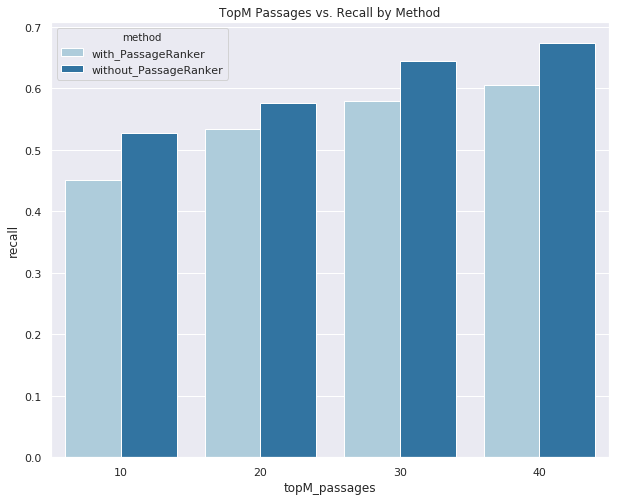

In [89]:
plt.figure(figsize=(10, 8))
sns.barplot(x='topM_passages', y='recall', data=pd.concat([exp1_comp, exp2_comp]), hue='method')
plt.title('TopM Passages vs. Recall by Method')

- These results are from basic TFIDF + cosine similarity ranking me
- with_PassageRanker uses units of paragraphs to indicate amount of content 
- without_PassageRanker uses unites of documents/articles to indicate amount of content
- 1 article = 5.8 paragraphs, therefore:
    - 40 paragraphs ~7 documents
    - 30 paragraphs ~5 documents
    - 20 paragraphs ~3 documents
    - 10 paragraphs ~2 documents

In [92]:
results_df.sort_values('ranker_recall', ascending=False)

,full_sys,prediction_function,topN_docs,topM_passages,topk_answers,entity_args,synonym_args,retriever_mAP,retriever_recall,retriever_time,ranker_mAP,ranker_recall,ranker_time
32,False,predict_combined,20,40,1,True,0,0.418840,0.711097,114.696322,0.166950,0.604527,192.168313
44,False,predict_combined,30,40,1,True,0,0.394632,0.732788,123.975794,0.162358,0.602326,323.609428
7,False,predict_combined,10,40,1,True,0,0.455910,0.673373,97.365608,0.177950,0.602012,89.044986
11,False,predict_combined,20,40,1,False,0,0.420446,0.711726,82.135806,0.162882,0.601069,198.714986
6,False,predict_combined,30,40,1,False,0,0.397321,0.733732,99.484753,0.159066,0.599811,333.942590
31,False,predict_combined,10,40,1,False,0,0.460017,0.669601,72.341402,0.173768,0.599497,96.698198
40,False,predict_combined,5,40,1,False,0,0.486687,0.620560,61.327884,0.182057,0.582836,58.179300
35,False,predict_combined,20,40,1,True,1,0.396089,0.696636,140.963219,0.156312,0.581892,190.970556
46,False,predict_combined,5,40,1,True,0,0.481507,0.619302,84.992455,0.183735,0.581892,52.028131
25,False,predict_combined,10,30,1,True,0,0.455910,0.673373,97.020119,0.184328,0.578749,89.023811


### Overall Performance

In [82]:
temp5 = results_df.query('synonym_args==0 & entity_args==True').loc[:, ['topN_docs', 'topM_passages', 'retriever_recall','ranker_recall']]

In [94]:
temp5.sort_values('retriever_recall', ascending=False)

KeyError: 'retreiver_recall'

In [95]:
temp5.sort_values('ranker_recall', ascending=False)

,topN_docs,topM_passages,retriever_recall,ranker_recall
32,20,40,0.711097,0.604527
44,30,40,0.732788,0.602326
7,10,40,0.673373,0.602012
46,5,40,0.619302,0.581892
25,10,30,0.673373,0.578749
29,20,30,0.711097,0.575605
13,5,30,0.619302,0.564602
5,30,30,0.732788,0.563974
1,10,20,0.673373,0.533480
34,5,20,0.619302,0.531908


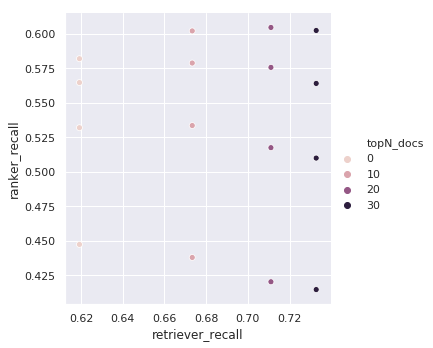

In [90]:
sns.relplot(x='retriever_recall', y='ranker_recall', data=temp5, hue='topN_docs')

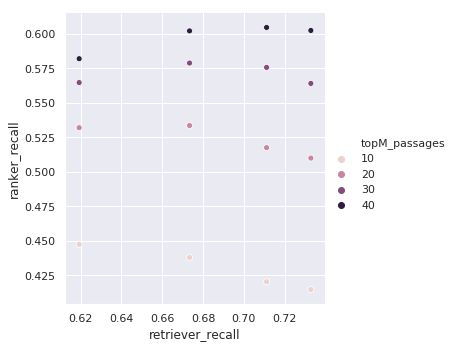

In [91]:
sns.relplot(x='retriever_recall', y='ranker_recall', data=temp5, hue='topM_passages')

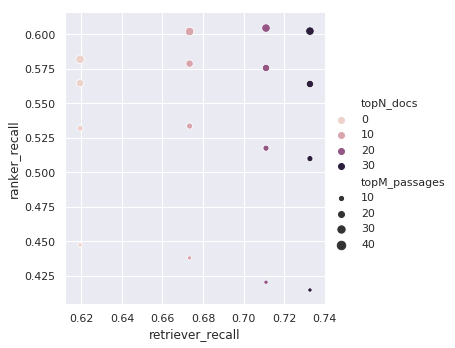

In [93]:
sns.relplot(x='retriever_recall', y='ranker_recall', data=temp5, size='topM_passages', hue='topN_docs')

Directions I can go in:
1. Contextual synonyms
2. Question Similarity Expansion
3. Effective scoring mechanisms (weighted scores to select correct answer)